In [11]:
import nltk
import math
import os,re
import codecs
# import mpld3
from nltk.stem import WordNetLemmatizer, PorterStemmer
from nltk.tokenize import word_tokenize,sent_tokenize
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.preprocessing import normalize
# from nltk.tokenize.treebank import TreebankWordDetokenizer
from nltk.corpus import wordnet
import string
import tqdm
import pandas as pd
from pandas import DataFrame
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import gensim
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer,HashingVectorizer
# from sklearn.decomposition import PCA
# import matplotlib.pyplot as plt
import seaborn as sns
nltk.download('stopwords')
nltk.download('wordnet')
from sklearn.metrics import pairwise_distances
from sklearn.datasets import load_files

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/anitha/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /Users/anitha/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [12]:
import numpy as np
from numpy.linalg import norm

class Kmeans:
    """ K Means Clustering
    
    Parameters
    -----------
        k: int , number of clusters
        
        seed: int, will be randomly set if None
        
        max_iter: int, number of iterations to run algorithm, default: 200
        
    Attributes
    -----------
       centroids: array, k, number_features
       
       cluster_labels: label for each data point
       
    """
    
    def __init__(self, k, seed = None, max_iter = 200):
        self.k = k
        self.seed = seed
        if self.seed is not None:
            np.random.seed(self.seed)
        self.max_iter = max_iter
         
    def initialise_centroids(self, data):
        """Randomly Initialise Centroids
        
        Parameters
        ----------
        data: array or matrix, number_rows, number_features
        
        Returns
        --------
        centroids: array of k centroids chosen as random data points 
        """
        
        initial_centroids = np.random.permutation(data.shape[0])[:self.k]
        print("Initial centroid",initial_centroids)
        self.centroids = data[initial_centroids]
        print("Self_Centroid",self.centroids)
        return self.centroids
    
    def assign_clusters(self, data):
        """Compute distance of data from clusters and assign data point
           to closest cluster.
        
        Parameters
        ----------
        data: array or matrix, number_rows, number_features
        
        Returns
        --------
        cluster_labels: index which minmises the distance of data to each
        cluster
            
        """ 
        if data.ndim == 1:
            data = data.reshape(-1, 1)
            print("assign cluster",data)
        
        dist_to_centroid =  pairwise_distances(data, self.centroids, metric = 'euclidean')
        self.cluster_labels = np.argmin(dist_to_centroid, axis = 1)
        
        return  self.cluster_labels
    
    
    def update_centroids(self, data):
        """Computes average of all data points in cluster and
           assigns new centroids as average of data points
        
        Parameters
        -----------
        data: array or matrix, number_rows, number_features
        
        Returns
        -----------
        centroids: array, k, number_features
        """
        
        self.centroids = np.array([data[self.cluster_labels == i].mean(axis = 0) for i in range(self.k)])
        
        return self.centroids
    def predict(self, data):
        """Predict which cluster data point belongs to
        
        Parameters
        ----------
        data: array or matrix, number_rows, number_features
        
        Returns
        --------
        cluster_labels: index which minmises the distance of data to each
        cluster
        """
        
        return self.assign_clusters(data)
    
    def fit_kmeans(self, data):
        """
        This function contains the main loop to fit the algorithm
        Implements initialise centroids and update_centroids
        according to max_iter
        -----------------------
        
        Returns
        -------
        instance of kmeans class
            
        """
        self.centroids = self.initialise_centroids(data)
        
        # Main kmeans loop
        for iter in range(self.max_iter):

            self.cluster_labels = self.assign_clusters(data)
            self.centroids = self.update_centroids(data)          
            if iter % 100 == 0:
                print("Running Model Iteration %d " %iter)
        print("Model finished running")
        return self    


In [13]:
# data = pd.read_csv('/Volumes/Projects/Artificial intelligence for data science-HT20/bbc-text.csv')
from sklearn.datasets import load_files
random_state = 0 
DATA_DIR = "/Volumes/Projects/Artificial intelligence for data science-HT20/bbc"
# data = pd.read_csv('/Volumes/Projects/Artificial intelligence for data science-HT20/bbc-text.csv')
data1 = load_files(DATA_DIR, encoding="utf-8", decode_error="replace", random_state=random_state)
data = pd.DataFrame(list(zip(data1['data'])), columns=['text'])
data.head()

,text
0,Tate & Lyle boss bags top award\n\nTate & Lyle...
1,Halo 2 sells five million copies\n\nMicrosoft ...
2,MSPs hear renewed climate warning\n\nClimate c...
3,Pavey focuses on indoor success\n\nJo Pavey wi...
4,Tories reject rethink on axed MP\n\nSacked MP ...


In [14]:
data

,text
0,Tate & Lyle boss bags top award\n\nTate & Lyle...
1,Halo 2 sells five million copies\n\nMicrosoft ...
2,MSPs hear renewed climate warning\n\nClimate c...
3,Pavey focuses on indoor success\n\nJo Pavey wi...
4,Tories reject rethink on axed MP\n\nSacked MP ...
...,...
2220,EU fraud clampdown urged\n\nEU member states a...
2221,Tindall aiming to earn Lions spot\n\nBath and ...
2222,Jamelia's return to the top\n\nR&B star Jameli...
2223,Oscars steer clear of controversy\n\nThe Oscar...


In [15]:
data["TEXT_LOWER"] = data["text"].str.lower()
data.head()

,text,TEXT_LOWER
0,Tate & Lyle boss bags top award\n\nTate & Lyle...,tate & lyle boss bags top award\n\ntate & lyle...
1,Halo 2 sells five million copies\n\nMicrosoft ...,halo 2 sells five million copies\n\nmicrosoft ...
2,MSPs hear renewed climate warning\n\nClimate c...,msps hear renewed climate warning\n\nclimate c...
3,Pavey focuses on indoor success\n\nJo Pavey wi...,pavey focuses on indoor success\n\njo pavey wi...
4,Tories reject rethink on axed MP\n\nSacked MP ...,tories reject rethink on axed mp\n\nsacked mp ...


In [16]:
PUNCT_TO_REMOVE = string.punctuation
def remove_punctuation(text):
    """custom function to remove the punctuation"""
    return text.translate(str.maketrans('', '', PUNCT_TO_REMOVE))

data["text_wo_punct"] = data["TEXT_LOWER"].apply(lambda text: remove_punctuation(text))
data.head()


,text,TEXT_LOWER,text_wo_punct
0,Tate & Lyle boss bags top award\n\nTate & Lyle...,tate & lyle boss bags top award\n\ntate & lyle...,tate lyle boss bags top award\n\ntate lyles ...
1,Halo 2 sells five million copies\n\nMicrosoft ...,halo 2 sells five million copies\n\nmicrosoft ...,halo 2 sells five million copies\n\nmicrosoft ...
2,MSPs hear renewed climate warning\n\nClimate c...,msps hear renewed climate warning\n\nclimate c...,msps hear renewed climate warning\n\nclimate c...
3,Pavey focuses on indoor success\n\nJo Pavey wi...,pavey focuses on indoor success\n\njo pavey wi...,pavey focuses on indoor success\n\njo pavey wi...
4,Tories reject rethink on axed MP\n\nSacked MP ...,tories reject rethink on axed mp\n\nsacked mp ...,tories reject rethink on axed mp\n\nsacked mp ...


In [17]:
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

data["text_wo_stop"] = data["text_wo_punct"].apply(lambda text: remove_stopwords(text))
data.head()


,text,TEXT_LOWER,text_wo_punct,text_wo_stop
0,Tate & Lyle boss bags top award\n\nTate & Lyle...,tate & lyle boss bags top award\n\ntate & lyle...,tate lyle boss bags top award\n\ntate lyles ...,tate lyle boss bags top award tate lyles chief...
1,Halo 2 sells five million copies\n\nMicrosoft ...,halo 2 sells five million copies\n\nmicrosoft ...,halo 2 sells five million copies\n\nmicrosoft ...,halo 2 sells five million copies microsoft cel...
2,MSPs hear renewed climate warning\n\nClimate c...,msps hear renewed climate warning\n\nclimate c...,msps hear renewed climate warning\n\nclimate c...,msps hear renewed climate warning climate chan...
3,Pavey focuses on indoor success\n\nJo Pavey wi...,pavey focuses on indoor success\n\njo pavey wi...,pavey focuses on indoor success\n\njo pavey wi...,pavey focuses indoor success jo pavey miss jan...
4,Tories reject rethink on axed MP\n\nSacked MP ...,tories reject rethink on axed mp\n\nsacked mp ...,tories reject rethink on axed mp\n\nsacked mp ...,tories reject rethink axed mp sacked mp howard...


In [18]:
#  perform lemmatize and stem preprocessing steps on the data set.
stemmer = SnowballStemmer(language='english',ignore_stopwords=True)
def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        print("tokens",token)
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3:
            print("tokens",token)
            result.append(lemmatize_stemming(token))
    return ' '.join(result)

In [19]:
# Preprocess the headline text, saving the results as ‘processed_docs’
processed_docs = data["text_wo_stop"].map(preprocess)
print(len(processed_docs))
processed_docs.head()

train_size = int(len(processed_docs) * .8)
print ("Train size: %d" % train_size)
print ("Test size: %d" % (len(processed_docs) - train_size))

tokens tate
tokens tate
tokens lyle
tokens lyle
tokens boss
tokens boss
tokens bags
tokens bags
tokens top
tokens award
tokens award
tokens tate
tokens tate
tokens lyles
tokens lyles
tokens chief
tokens chief
tokens executive
tokens executive
tokens named
tokens named
tokens european
tokens european
tokens businessman
tokens businessman
tokens year
tokens year
tokens leading
tokens leading
tokens business
tokens business
tokens magazine
tokens magazine
tokens iain
tokens iain
tokens ferguson
tokens ferguson
tokens awarded
tokens awarded
tokens title
tokens title
tokens us
tokens publication
tokens publication
tokens forbes
tokens forbes
tokens returning
tokens returning
tokens one
tokens uks
tokens venerable
tokens venerable
tokens manufacturers
tokens manufacturers
tokens countrys
tokens countrys
tokens top
tokens companies
tokens companies
tokens sugar
tokens sugar
tokens group
tokens group
tokens absent
tokens absent
tokens ftse
tokens ftse
tokens seven
tokens seven
tokens years
tok

tokens weather
tokens weather
tokens type
tokens type
tokens caused
tokens caused
tokens havoc
tokens havoc
tokens across
tokens country
tokens country
tokens last
tokens month
tokens month
tokens predicted
tokens predicted
tokens damaging
tokens damaging
tokens storms
tokens storms
tokens become
tokens frequent
tokens frequent
tokens researchers
tokens researchers
tokens university
tokens university
tokens highlands
tokens highlands
tokens islands
tokens islands
tokens southampton
tokens southampton
tokens looking
tokens looking
tokens wave
tokens wave
tokens heights
tokens heights
tokens atlantic
tokens atlantic
tokens last
tokens nine
tokens years
tokens years
tokens project
tokens project
tokens conducted
tokens conducted
tokens jointly
tokens jointly
tokens environmental
tokens environmental
tokens research
tokens research
tokens institute
tokens institute
tokens thurso
tokens thurso
tokens part
tokens university
tokens university
tokens highlands
tokens highlands
tokens islands
t

tokens treaty
tokens john
tokens john
tokens majors
tokens majors
tokens government
tokens government
tokens act
tokens treason
tokens treason
tokens catholic
tokens catholic
tokens herald
tokens herald
tokens also
tokens highlighted
tokens highlighted
tokens articles
tokens articles
tokens wrote
tokens wrote
tokens role
tokens role
tokens catholicism
tokens catholicism
tokens european
tokens european
tokens union
tokens union
tokens mr
tokens hilton
tokens hilton
tokens chosen
tokens chosen
tokens fight
tokens fight
tokens seat
tokens seat
tokens previous
tokens previous
tokens candidate
tokens candidate
tokens robert
tokens robert
tokens oulds
tokens oulds
tokens sacked
tokens sacked
tokens pictured
tokens pictured
tokens range
tokens range
tokens guns
tokens guns
tokens hunting
tokens hunting
tokens knife
tokens knife
tokens slough
tokens slough
tokens conservative
tokens conservative
tokens association
tokens association
tokens placed
tokens placed
tokens support
tokens support
tok

tokens nextgeneration
tokens nextgeneration
tokens dvd
tokens format
tokens format
tokens bluray
tokens bluray
tokens winning
tokens winning
tokens supporters
tokens supporters
tokens rival
tokens rival
tokens according
tokens according
tokens backers
tokens backers
tokens bluray
tokens bluray
tokens backed
tokens backed
tokens firms
tokens firms
tokens including
tokens including
tokens sony
tokens sony
tokens competing
tokens competing
tokens toshiba
tokens toshiba
tokens necbacked
tokens necbacked
tokens hddvd
tokens hddvd
tokens format
tokens format
tokens choice
tokens choice
tokens future
tokens future
tokens films
tokens films
tokens games
tokens games
tokens bluray
tokens bluray
tokens association
tokens association
tokens said
tokens said
tokens thursday
tokens thursday
tokens games
tokens games
tokens giants
tokens giants
tokens electronic
tokens electronic
tokens arts
tokens arts
tokens vivendi
tokens vivendi
tokens would
tokens support
tokens support
tokens dvd
tokens format

tokens significant
tokens factors
tokens factors
tokens choosing
tokens choosing
tokens go
tokens hddvd
tokens hddvd
tokens formats
tokens formats
tokens courting
tokens courting
tokens microsoft
tokens microsoft
tokens format
tokens format
tokens choice
tokens choice
tokens next
tokens generation
tokens generation
tokens xbox
tokens xbox
tokens discussions
tokens discussions
tokens still
tokens ongoing
tokens ongoing
tokens next
tokens generation
tokens generation
tokens dvds
tokens dvds
tokens also
tokens able
tokens able
tokens store
tokens store
tokens images
tokens images
tokens data
tokens data
tokens ces
tokens largest
tokens largest
tokens consumer
tokens consumer
tokens electronics
tokens electronics
tokens show
tokens world
tokens world
tokens runs
tokens runs
tokens january
tokens january
tokens labour
tokens labour
tokens pig
tokens poster
tokens poster
tokens antisemitic
tokens antisemitic
tokens labour
tokens labour
tokens party
tokens party
tokens accused
tokens accused


tokens sessions
tokens johnston
tokens johnston
tokens mcevoy
tokens mcevoy
tokens limerick
tokens limerick
tokens vital
tokens vital
tokens part
tokens recovery
tokens recovery
tokens johnston
tokens johnston
tokens uses
tokens uses
tokens advanced
tokens advanced
tokens type
tokens type
tokens acupuncture
tokens acupuncture
tokens effective
tokens effective
tokens needles
tokens needles
tokens get
tokens put
tokens right
tokens right
tokens close
tokens close
tokens spine
tokens spine
tokens two
tokens half
tokens half
tokens inch
tokens inch
tokens needle
tokens needle
tokens went
tokens went
tokens yesterday
tokens yesterday
tokens im
tokens fairly
tokens fairly
tokens incapacitated
tokens incapacitated
tokens today
tokens today
tokens result
tokens result
tokens jamie
tokens jamie
tokens also
tokens travelled
tokens travelled
tokens receive
tokens receive
tokens treatment
tokens treatment
tokens polish
tokens polish
tokens training
tokens training
tokens centre
tokens centre
token

tokens internet
tokens mobile
tokens mobile
tokens phones
tokens phones
tokens led
tokens cheating
tokens cheating
tokens allparty
tokens allparty
tokens group
tokens group
tokens recommended
tokens recommended
tokens ways
tokens ways
tokens protect
tokens protect
tokens punters
tokens punters
tokens improve
tokens improve
tokens integrity
tokens integrity
tokens sports
tokens sports
tokens betting
tokens betting
tokens include
tokens include
tokens proposal
tokens proposal
tokens raising
tokens raising
tokens maximum
tokens maximum
tokens jail
tokens jail
tokens sentence
tokens sentence
tokens gambling
tokens gambling
tokens cheats
tokens cheats
tokens current
tokens current
tokens two
tokens years
tokens years
tokens lord
tokens lord
tokens condon
tokens condon
tokens head
tokens head
tokens international
tokens international
tokens cricket
tokens cricket
tokens councils
tokens councils
tokens anticorruption
tokens anticorruption
tokens unit
tokens unit
tokens originally
tokens origi

tokens comes
tokens comes
tokens pakistans
tokens pakistans
tokens high
tokens high
tokens commissioner
tokens commissioner
tokens britain
tokens britain
tokens said
tokens said
tokens pakistanis
tokens pakistanis
tokens integrate
tokens integrate
tokens dr
tokens maleeha
tokens maleeha
tokens lodhi
tokens lodhi
tokens said
tokens said
tokens people
tokens people
tokens could
tokens expect
tokens expect
tokens others
tokens listen
tokens listen
tokens grievances
tokens grievances
tokens isolated
tokens isolated
tokens gen
tokens musharraf
tokens musharraf
tokens told
tokens told
tokens bbc
tokens people
tokens people
tokens think
tokens think
tokens women
tokens women
tokens confined
tokens confined
tokens houses
tokens houses
tokens put
tokens veils
tokens veils
tokens move
tokens absolutely
tokens absolutely
tokens wrong
tokens wrong
tokens pakistani
tokens pakistani
tokens president
tokens president
tokens also
tokens asked
tokens asked
tokens whether
tokens thought
tokens thought
t

tokens know
tokens nothing
tokens wada
tokens wada
tokens world
tokens world
tokens antidoping
tokens antidoping
tokens agency
tokens agency
tokens behind
tokens testing
tokens testing
tokens would
tokens also
tokens known
tokens known
tokens something
tokens otherwise
tokens looks
tokens looks
tokens pure
tokens pure
tokens fiction
tokens fiction
tokens fabrication
tokens fabrication
tokens facts
tokens facts
tokens lse
tokens doubts
tokens doubts
tokens boost
tokens boost
tokens bidders
tokens bidders
tokens shares
tokens shares
tokens shares
tokens shares
tokens deutsche
tokens deutsche
tokens boerse
tokens boerse
tokens risen
tokens risen
tokens shareholder
tokens shareholder
tokens fund
tokens fund
tokens voiced
tokens voiced
tokens opposition
tokens opposition
tokens firms
tokens firms
tokens planned
tokens planned
tokens takeover
tokens takeover
tokens london
tokens london
tokens stock
tokens stock
tokens exchange
tokens exchange
tokens tci
tokens claims
tokens claims
tokens rep

tokens umbro
tokens umbro
tokens pence
tokens pence
tokens morning
tokens morning
tokens trade
tokens trade
tokens nadal
tokens nadal
tokens marches
tokens marches
tokens mexico
tokens mexico
tokens rafael
tokens rafael
tokens nadal
tokens nadal
tokens continued
tokens continued
tokens run
tokens fine
tokens fine
tokens form
tokens form
tokens beat
tokens beat
tokens guillermo
tokens guillermo
tokens canas
tokens canas
tokens reach
tokens reach
tokens mexican
tokens mexican
tokens open
tokens open
tokens semis
tokens semis
tokens acapulco
tokens acapulco
tokens eighth
tokens eighth
tokens seed
tokens seed
tokens nadal
tokens nadal
tokens picked
tokens picked
tokens second
tokens second
tokens atp
tokens title
tokens title
tokens beat
tokens beat
tokens alberto
tokens alberto
tokens martin
tokens martin
tokens last
tokens weeks
tokens weeks
tokens brazil
tokens brazil
tokens open
tokens open
tokens saw
tokens argentine
tokens argentine
tokens third
tokens seed
tokens seed
tokens meets
t

tokens learn
tokens adapt
tokens adapt
tokens new
tokens way
tokens playing
tokens playing
tokens could
tokens prove
tokens prove
tokens accessible
tokens accessible
tokens way
tokens gaming
tokens gaming
tokens novices
tokens novices
tokens ultimately
tokens ultimately
tokens success
tokens success
tokens failure
tokens failure
tokens device
tokens device
tokens lies
tokens lies
tokens hands
tokens hands
tokens developers
tokens developers
tokens manage
tokens manage
tokens create
tokens create
tokens titles
tokens titles
tokens use
tokens nintendo
tokens nintendo
tokens dss
tokens key
tokens features
tokens features
tokens whole
tokens new
tokens market
tokens market
tokens gamers
tokens gamers
tokens could
tokens open
tokens open
tokens fear
tokens fear
tokens touch
tokens touch
tokens screen
tokens screen
tokens voice
tokens voice
tokens recognition
tokens recognition
tokens treated
tokens treated
tokens little
tokens little
tokens gimmicks
tokens gimmicks
tokens elvis
tokens elvis

tokens cbo
tokens forecasts
tokens forecasts
tokens said
tokens said
tokens would
tokens bn
tokens shortfall
tokens shortfall
tokens fiscal
tokens fiscal
tokens year
tokens year
tokens recent
tokens recent
tokens months
tokens months
tokens dollar
tokens dollar
tokens weakened
tokens weakened
tokens amid
tokens amid
tokens market
tokens market
tokens jitters
tokens jitters
tokens size
tokens size
tokens budget
tokens budget
tokens trade
tokens trade
tokens deficits
tokens deficits
tokens november
tokens november
tokens gap
tokens us
tokens exports
tokens exports
tokens imports
tokens imports
tokens widened
tokens widened
tokens bn
tokens record
tokens record
tokens figure
tokens figure
tokens cbo
tokens says
tokens says
tokens envisages
tokens envisages
tokens orderly
tokens orderly
tokens decline
tokens decline
tokens greenback
tokens greenback
tokens next
tokens two
tokens years
tokens years
tokens twin
tokens twin
tokens deficit
tokens deficit
tokens drives
tokens drives
tokens doll

tokens americans
tokens americans
tokens according
tokens according
tokens recent
tokens recent
tokens research
tokens research
tokens pew
tokens internet
tokens internet
tokens american
tokens american
tokens life
tokens life
tokens project
tokens project
tokens one
tokens us
tokens adults
tokens adults
tokens million
tokens million
tokens people
tokens people
tokens owns
tokens owns
tokens digital
tokens digital
tokens music
tokens music
tokens player
tokens player
tokens sort
tokens sort
tokens sales
tokens sales
tokens legally
tokens legally
tokens downloaded
tokens downloaded
tokens songs
tokens songs
tokens also
tokens rose
tokens rose
tokens tenfold
tokens tenfold
tokens according
tokens according
tokens record
tokens record
tokens industry
tokens industry
tokens million
tokens million
tokens tracks
tokens tracks
tokens bought
tokens bought
tokens online
tokens online
tokens us
tokens europe
tokens europe
tokens months
tokens months
tokens ifpi
tokens ifpi
tokens industry
tokens

tokens music
tokens experience
tokens experience
tokens festival
tokens festival
tokens disappoint
tokens disappoint
tokens tickets
tokens tickets
tokens festival
tokens festival
tokens go
tokens sale
tokens sale
tokens friday
tokens friday
tokens march
tokens march
tokens saab
tokens saab
tokens build
tokens build
tokens cadillacs
tokens cadillacs
tokens sweden
tokens sweden
tokens general
tokens general
tokens motors
tokens motors
tokens worlds
tokens worlds
tokens largest
tokens largest
tokens car
tokens maker
tokens maker
tokens confirmed
tokens confirmed
tokens build
tokens build
tokens new
tokens mediumsized
tokens mediumsized
tokens cadillac
tokens cadillac
tokens bls
tokens lossmaking
tokens lossmaking
tokens saab
tokens saab
tokens factory
tokens factory
tokens sweden
tokens sweden
tokens car
tokens unveiled
tokens unveiled
tokens geneva
tokens geneva
tokens motor
tokens motor
tokens show
tokens intended
tokens intended
tokens compete
tokens compete
tokens mediumsized
tokens m

tokens unemployment
tokens unemployment
tokens rose
tokens rose
tokens million
tokens million
tokens many
tokens sectors
tokens sectors
tokens construction
tokens construction
tokens laying
tokens laying
tokens workers
tokens workers
tokens amid
tokens amid
tokens bad
tokens weather
tokens weather
tokens three
tokens years
tokens years
tokens stagnation
tokens stagnation
tokens german
tokens german
tokens economy
tokens economy
tokens came
tokens came
tokens end
tokens upturn
tokens upturn
tokens still
tokens strong
tokens strong
tokens enough
tokens boost
tokens boost
tokens labour
tokens labour
tokens market
tokens market
tokens mr
tokens weise
tokens weise
tokens added
tokens added
tokens news
tokens news
tokens rise
tokens rise
tokens came
tokens came
tokens government
tokens government
tokens welfare
tokens welfare
tokens reforms
tokens reforms
tokens came
tokens came
tokens force
tokens force
tokens move
tokens expected
tokens expected
tokens see
tokens unemployment
tokens unempl

tokens communications
tokens deal
tokens deal
tokens valued
tokens valued
tokens bn
tokens roddick
tokens roddick
tokens san
tokens jose
tokens jose
tokens final
tokens final
tokens andy
tokens andy
tokens roddick
tokens roddick
tokens play
tokens play
tokens cyril
tokens cyril
tokens saulnier
tokens saulnier
tokens final
tokens final
tokens sap
tokens open
tokens open
tokens san
tokens jose
tokens jose
tokens sunday
tokens sunday
tokens american
tokens american
tokens top
tokens seed
tokens seed
tokens defending
tokens defending
tokens champion
tokens champion
tokens overcame
tokens overcame
tokens germanys
tokens germanys
tokens tommy
tokens tommy
tokens haas
tokens haas
tokens third
tokens seed
tokens seed
tokens saulnier
tokens saulnier
tokens survived
tokens survived
tokens injury
tokens injury
tokens scare
tokens scare
tokens semifinal
tokens semifinal
tokens seventhseeded
tokens seventhseeded
tokens austrian
tokens austrian
tokens jurgen
tokens jurgen
tokens melzer
tokens melzer

tokens zero
tokens zero
tokens tolerance
tokens tolerance
tokens questions
tokens questions
tokens racism
tokens racism
tokens leaders
tokens leaders
tokens meet
tokens meet
tokens turkish
tokens turkish
tokens eu
tokens bid
tokens tony
tokens tony
tokens blair
tokens blair
tokens met
tokens italian
tokens italian
tokens prime
tokens prime
tokens minister
tokens minister
tokens silvio
tokens silvio
tokens berlusconi
tokens berlusconi
tokens german
tokens german
tokens chancellor
tokens chancellor
tokens gerhard
tokens gerhard
tokens schroeder
tokens schroeder
tokens talk
tokens talk
tokens turkey
tokens turkey
tokens entering
tokens entering
tokens eu
tokens downing
tokens downing
tokens street
tokens street
tokens talks
tokens talks
tokens covered
tokens covered
tokens range
tokens range
tokens topics
tokens topics
tokens ahead
tokens ahead
tokens eu
tokens summit
tokens summit
tokens brussels
tokens brussels
tokens later
tokens later
tokens week
tokens week
tokens mr
tokens blair
tok

tokens westlife
tokens westlife
tokens star
tokens star
tokens brian
tokens brian
tokens mcfadden
tokens mcfadden
tokens delta
tokens delta
tokens goodrem
tokens goodrem
tokens fell
tokens fell
tokens number
tokens number
tokens three
tokens number
tokens number
tokens five
tokens follow
tokens follow
tokens brits
tokens brits
tokens success
tokens success
tokens franz
tokens franz
tokens ferdinand
tokens ferdinand
tokens best
tokens best
tokens rock
tokens rock
tokens act
tokens best
tokens best
tokens british
tokens british
tokens group
tokens group
tokens last
tokens week
tokens week
tokens selftitled
tokens selftitled
tokens album
tokens album
tokens moved
tokens moved
tokens number
tokens number
tokens four
tokens last
tokens weeks
tokens weeks
tokens number
tokens number
tokens one
tokens album
tokens album
tokens tourist
tokens tourist
tokens athlete
tokens athlete
tokens fell
tokens fell
tokens number
tokens number
tokens three
tokens munster
tokens munster
tokens cup
tokens ti

tokens workers
tokens skills
tokens skills
tokens message
tokens message
tokens chancellor
tokens chancellor
tokens please
tokens dont
tokens dont
tokens give
tokens away
tokens away
tokens form
tokens form
tokens electioneering
tokens electioneering
tokens sir
tokens digby
tokens digby
tokens added
tokens added
tokens dont
tokens dont
tokens think
tokens think
tokens say
tokens prudent
tokens prudent
tokens chancellor
tokens chancellor
tokens right
tokens right
tokens way
tokens stability
tokens stability
tokens key
tokens word
tokens word
tokens british
tokens british
tokens business
tokens business
tokens needs
tokens needs
tokens boring
tokens boring
tokens stability
tokens stability
tokens anything
tokens would
tokens say
tokens dont
tokens dont
tokens increase
tokens increase
tokens public
tokens public
tokens spending
tokens spending
tokens dont
tokens dont
tokens give
tokens away
tokens away
tokens going
tokens going
tokens anywhere
tokens add
tokens something
tokens competitiv

tokens warnings
tokens warnings
tokens junk
tokens junk
tokens mail
tokens mail
tokens deluge
tokens deluge
tokens amount
tokens spam
tokens spam
tokens circulating
tokens circulating
tokens online
tokens online
tokens could
tokens undergo
tokens undergo
tokens massive
tokens massive
tokens increase
tokens increase
tokens say
tokens experts
tokens experts
tokens antispam
tokens antispam
tokens group
tokens group
tokens spamhaus
tokens spamhaus
tokens warning
tokens warning
tokens novel
tokens novel
tokens virus
tokens virus
tokens hides
tokens hides
tokens origins
tokens origins
tokens junk
tokens junk
tokens mail
tokens mail
tokens program
tokens program
tokens makes
tokens makes
tokens spam
tokens spam
tokens look
tokens look
tokens like
tokens like
tokens sent
tokens sent
tokens legitimate
tokens legitimate
tokens mail
tokens mail
tokens servers
tokens servers
tokens making
tokens making
tokens hard
tokens hard
tokens spot
tokens spot
tokens filter
tokens filter
tokens spamhaus
toke

tokens patrol
tokens big
tokens winners
tokens winners
tokens irelands
tokens irelands
tokens top
tokens music
tokens music
tokens honours
tokens honours
tokens meteor
tokens meteor
tokens awards
tokens awards
tokens picking
tokens picking
tokens accolades
tokens accolades
tokens best
tokens best
tokens irish
tokens irish
tokens band
tokens band
tokens album
tokens album
tokens thursday
tokens thursday
tokens belfastborn
tokens belfastborn
tokens glasgowbased
tokens glasgowbased
tokens band
tokens band
tokens collected
tokens collected
tokens prizes
tokens prizes
tokens ceremony
tokens ceremony
tokens dublins
tokens dublins
tokens point
tokens point
tokens theatre
tokens theatre
tokens westlife
tokens westlife
tokens award
tokens award
tokens best
tokens best
tokens irish
tokens irish
tokens pop
tokens act
tokens voted
tokens voted
tokens public
tokens public
tokens beating
tokens beating
tokens former
tokens member
tokens member
tokens brian
tokens brian
tokens mcfadden
tokens mcfadde

tokens ordered
tokens british
tokens british
tokens troops
tokens troops
tokens march
tokens march
tokens streets
tokens streets
tokens belfast
tokens belfast
tokens protect
tokens protect
tokens catholic
tokens catholic
tokens civilians
tokens civilians
tokens amid
tokens amid
tokens rising
tokens rising
tokens violence
tokens violence
tokens decision
tokens decision
tokens dominated
tokens dominated
tokens british
tokens british
tokens politics
tokens politics
tokens st
tokens century
tokens century
tokens foreign
tokens foreign
tokens secretary
tokens secretary
tokens early
tokens early
tokens lord
tokens lord
tokens callaghan
tokens callaghan
tokens kept
tokens kept
tokens open
tokens open
tokens mind
tokens mind
tokens uks
tokens entry
tokens entry
tokens common
tokens common
tokens market
tokens market
tokens seeing
tokens seeing
tokens advantages
tokens advantages
tokens uks
tokens entry
tokens entry
tokens travelled
tokens travelled
tokens idi
tokens amins
tokens amins
tokens u

tokens mean
tokens mean
tokens students
tokens students
tokens feel
tokens feel
tokens like
tokens like
tokens studying
tokens studying
tokens sims
tokens sims
tokens rely
tokens rely
tokens solely
tokens solely
tokens words
tokens words
tokens get
tokens information
tokens information
tokens across
tokens players
tokens players
tokens instead
tokens instead
tokens actions
tokens actions
tokens computer
tokens controlled
tokens controlled
tokens people
tokens people
tokens interact
tokens interact
tokens world
tokens world
tokens often
tokens makes
tokens makes
tokens clear
tokens clear
tokens going
tokens going
tokens incidental
tokens incidental
tokens information
tokens information
tokens sim
tokens could
tokens reinforce
tokens reinforce
tokens player
tokens player
tokens student
tokens student
tokens supposed
tokens supposed
tokens learning
tokens learning
tokens said
tokens said
tokens mr
tokens purushotma
tokens purushotma
tokens contrast
tokens contrast
tokens many
tokens langu

tokens regions
tokens achieving
tokens achieving
tokens record
tokens record
tokens profitability
tokens profitability
tokens asia
tokens asia
tokens pacific
tokens pacific
tokens returning
tokens returning
tokens profit
tokens profit
tokens latin
tokens latin
tokens america
tokens america
tokens middle
tokens middle
tokens east
tokens east
tokens africa
tokens africa
tokens car
tokens maker
tokens maker
tokens diversified
tokens diversified
tokens financial
tokens financial
tokens services
tokens services
tokens extending
tokens extending
tokens reach
tokens reach
tokens general
tokens general
tokens motors
tokens motors
tokens acceptance
tokens acceptance
tokens corp
tokens corp
tokens gmac
tokens gmac
tokens said
tokens said
tokens may
tokens enter
tokens enter
tokens home
tokens home
tokens loans
tokens loans
tokens market
tokens market
tokens gmac
tokens gmac
tokens strong
tokens strong
tokens contributor
tokens contributor
tokens profits
tokens profits
tokens gm
tokens said
token

tokens national
tokens manufacturing
tokens manufacturing
tokens activity
tokens activity
tokens compiled
tokens compiled
tokens responses
tokens responses
tokens purchasing
tokens purchasing
tokens executives
tokens executives
tokens industrial
tokens industrial
tokens companies
tokens companies
tokens high
tokens high
tokens fuel
tokens fuel
tokens costs
tokens costs
tokens hit
tokens us
tokens airlines
tokens airlines
tokens two
tokens largest
tokens largest
tokens airlines
tokens airlines
tokens us
tokens american
tokens american
tokens southwest
tokens southwest
tokens blamed
tokens blamed
tokens record
tokens record
tokens fuel
tokens fuel
tokens prices
tokens prices
tokens disappointing
tokens disappointing
tokens quarterly
tokens quarterly
tokens results
tokens results
tokens american
tokens american
tokens airlines
tokens airlines
tokens parent
tokens parent
tokens amr
tokens reported
tokens reported
tokens loss
tokens loss
tokens fourth
tokens fourth
tokens quarter
tokens qua

tokens minute
tokens minute
tokens seconds
tokens seconds
tokens mcilroy
tokens mcilroy
tokens third
tokens european
tokens european
tokens rankings
tokens rankings
tokens eased
tokens eased
tokens across
tokens finish
tokens finish
tokens set
tokens showdown
tokens showdown
tokens sundays
tokens sundays
tokens final
tokens final
tokens sheffield
tokens sheffield
tokens watkins
tokens watkins
tokens mcilroy
tokens mcilroy
tokens already
tokens achieved
tokens achieved
tokens european
tokens european
tokens qualifying
tokens qualifying
tokens mark
tokens mark
tokens scotlands
tokens scotlands
tokens susan
tokens susan
tokens deacon
tokens deacon
tokens stole
tokens stole
tokens thunder
tokens thunder
tokens final
tokens final
tokens womens
tokens womens
tokens fraser
tokens fraser
tokens became
tokens fastest
tokens fastest
tokens british
tokens british
tokens woman
tokens woman
tokens distance
tokens distance
tokens season
tokens season
tokens qualified
tokens qualified
tokens final
to

tokens iraqi
tokens iraqi
tokens workers
tokens workers
tokens says
tokens says
tokens consequently
tokens consequently
tokens transitional
tokens transitional
tokens government
tokens government
tokens forced
tokens forced
tokens backtrack
tokens backtrack
tokens recent
tokens recent
tokens months
tokens months
tokens proposal
tokens proposal
tokens allow
tokens allow
tokens foreign
tokens foreign
tokens ownership
tokens ownership
tokens iraqi
tokens iraqi
tokens assets
tokens assets
tokens explains
tokens explains
tokens west
tokens west
tokens easy
tokens easy
tokens forget
tokens forget
tokens otherwise
tokens brutal
tokens brutal
tokens baathist
tokens baathist
tokens regime
tokens regime
tokens used
tokens look
tokens look
tokens majority
tokens majority
tokens iraqs
tokens iraqs
tokens citizens
tokens citizens
tokens rather
tokens well
tokens terms
tokens terms
tokens job
tokens creation
tokens creation
tokens social
tokens social
tokens security
tokens security
tokens healthcar

tokens sentenced
tokens next
tokens year
tokens year
tokens third
tokens defendant
tokens defendant
tokens richard
tokens richard
tokens rutkowski
tokens rutkowski
tokens acquitted
tokens acquitted
tokens prosecutors
tokens prosecutors
tokens said
tokens said
tokens jaynes
tokens jaynes
tokens snake
tokens snake
tokens oil
tokens salesman
tokens salesman
tokens new
tokens format
tokens format
tokens using
tokens internet
tokens internet
tokens peddle
tokens peddle
tokens useless
tokens useless
tokens wares
tokens wares
tokens news
tokens news
tokens agency
tokens agency
tokens associated
tokens associated
tokens press
tokens press
tokens reported
tokens reported
tokens fedex
tokens fedex
tokens refund
tokens refund
tokens processor
tokens processor
tokens supposed
tokens supposed
tokens allow
tokens allow
tokens people
tokens people
tokens earn
tokens earn
tokens hour
tokens hour
tokens working
tokens working
tokens home
tokens home
tokens another
tokens item
tokens item
tokens sale
to

tokens price
tokens price
tokens right
tokens right
tokens added
tokens added
tokens im
tokens going
tokens going
tokens say
tokens decision
tokens decision
tokens let
tokens go
tokens fans
tokens fans
tokens reaction
tokens reaction
tokens towards
tokens tough
tokens tough
tokens time
tokens time
tokens since
tokens summer
tokens summer
tokens loss
tokens loss
tokens mother
tokens mother
tokens finding
tokens finding
tokens difficult
tokens difficult
tokens adjust
tokens adjust
tokens new
tokens club
tokens club
tokens different
tokens different
tokens area
tokens area
tokens terrific
tokens terrific
tokens missed
tokens missed
tokens days
tokens days
tokens training
tokens training
tokens someone
tokens daughter
tokens daughter
tokens brought
tokens brought
tokens home
tokens home
tokens would
tokens delighted
tokens delighted
tokens hasnt
tokens quite
tokens worked
tokens worked
tokens wed
tokens like
tokens like
tokens get
tokens back
tokens spent
tokens spent
tokens sony
tokens so

tokens mobile
tokens mobile
tokens games
tokens games
tokens come
tokens come
tokens age
tokens bbc
tokens news
tokens news
tokens website
tokens website
tokens takes
tokens takes
tokens look
tokens look
tokens games
tokens games
tokens mobile
tokens mobile
tokens phones
tokens phones
tokens maturing
tokens maturing
tokens brief
tokens brief
tokens roundup
tokens roundup
tokens follows
tokens follows
tokens skip
tokens skip
tokens straight
tokens straight
tokens reviews
tokens reviews
tokens clicking
tokens clicking
tokens links
tokens links
tokens part
tokens two
tokens follow
tokens follow
tokens monday
tokens monday
tokens reviews
tokens reviews
tokens call
tokens duty
tokens duty
tokens splinter
tokens splinter
tokens cell
tokens cell
tokens pandora
tokens pandora
tokens tomorrow
tokens tomorrow
tokens lord
tokens lord
tokens rings
tokens rings
tokens pocket
tokens pocket
tokens kingdom
tokens kingdom
tokens follow
tokens follow
tokens monday
tokens monday
tokens think
tokens think

tokens interface
tokens interface
tokens bit
tokens confusing
tokens confusing
tokens especially
tokens especially
tokens using
tokens joystick
tokens joystick
tokens rather
tokens keypad
tokens keypad
tokens play
tokens play
tokens fatal
tokens fatal
tokens force
tokens force
tokens macrospace
tokens macrospace
tokens futuristic
tokens futuristic
tokens shooter
tokens shooter
tokens lets
tokens lets
tokens either
tokens play
tokens play
tokens various
tokens deathmatch
tokens deathmatch
tokens modes
tokens modes
tokens phone
tokens phone
tokens run
tokens series
tokens series
tokens scenarios
tokens scenarios
tokens involves
tokens involves
tokens killing
tokens killing
tokens aliens
tokens aliens
tokens invading
tokens invading
tokens earth
tokens earth
tokens graphics
tokens graphics
tokens bit
tokens cartoonlike
tokens cartoonlike
tokens helps
tokens helps
tokens make
tokens clear
tokens clear
tokens going
tokens going
tokens levels
tokens levels
tokens well
tokens laid
tokens laid

tokens member
tokens state
tokens state
tokens officials
tokens officials
tokens talking
tokens talking
tokens darkly
tokens darkly
tokens river
tokens river
tokens islam
tokens islam
tokens oriental
tokens oriental
tokens culture
tokens culture
tokens threat
tokens threat
tokens europes
tokens europes
tokens cultural
tokens cultural
tokens richness
tokens richness
tokens course
tokens course
tokens many
tokens opponents
tokens opponents
tokens politically
tokens politically
tokens motivated
tokens motivated
tokens views
tokens views
tokens ranging
tokens ranging
tokens xenophobic
tokens xenophobic
tokens prejudices
tokens prejudices
tokens countrys
tokens countrys
tokens muslim
tokens muslim
tokens traditions
tokens traditions
tokens welldocumented
tokens welldocumented
tokens concerns
tokens concerns
tokens governments
tokens governments
tokens human
tokens human
tokens rights
tokens rights
tokens record
tokens record
tokens yet
tokens economic
tokens economic
tokens arguments
tokens

tokens police
tokens police
tokens could
tokens refuse
tokens refuse
tokens request
tokens request
tokens complaints
tokens complaints
tokens frivolous
tokens frivolous
tokens would
tokens cause
tokens cause
tokens annoyance
tokens annoyance
tokens would
tokens pose
tokens pose
tokens heavy
tokens heavy
tokens burden
tokens burden
tokens resources
tokens resources
tokens mr
tokens blunkett
tokens blunkett
tokens said
tokens said
tokens new
tokens three
tokens digit
tokens digit
tokens number
tokens number
tokens would
tokens created
tokens created
tokens nonemergency
tokens nonemergency
tokens phone
tokens phone
tokens calls
tokens calls
tokens police
tokens police
tokens best
tokens best
tokens performing
tokens performing
tokens police
tokens police
tokens services
tokens services
tokens would
tokens get
tokens cash
tokens cash
tokens extra
tokens extra
tokens freedoms
tokens freedoms
tokens said
tokens said
tokens would
tokens shirk
tokens shirk
tokens stepping
tokens stepping
token

tokens cops
tokens played
tokens played
tokens samuel
tokens samuel
tokens jackson
tokens jackson
tokens chris
tokens chris
tokens penn
tokens penn
tokens setting
tokens setting
tokens rampant
tokens rampant
tokens criminality
tokens criminality
tokens fictional
tokens fictional
tokens us
tokens state
tokens state
tokens san
tokens andreas
tokens andreas
tokens comprising
tokens comprising
tokens three
tokens major
tokens major
tokens cities
tokens cities
tokens los
tokens santos
tokens santos
tokens thinlydisguised
tokens thinlydisguised
tokens los
tokens angeles
tokens angeles
tokens san
tokens fierro
tokens fierro
tokens aka
tokens san
tokens francisco
tokens francisco
tokens las
tokens venturas
tokens venturas
tokens carbon
tokens carbon
tokens copy
tokens copy
tokens las
tokens vegas
tokens vegas
tokens san
tokens andreas
tokens andreas
tokens sucks
tokens sucks
tokens sprawling
tokens sprawling
tokens range
tokens range
tokens cast
tokens cast
tokens characters
tokens characters


tokens fourth
tokens fourth
tokens series
tokens series
tokens show
tokens peaked
tokens peaked
tokens monday
tokens monday
tokens audience
tokens audience
tokens joe
tokens pasquale
tokens pasquale
tokens compared
tokens compared
tokens peak
tokens peak
tokens record
tokens record
tokens tv
tokens audience
tokens audience
tokens kerry
tokens kerry
tokens mcfadden
tokens mcfadden
tokens february
tokens february
tokens comic
tokens comic
tokens pasquale
tokens pasquale
tokens beat
tokens beat
tokens former
tokens royal
tokens royal
tokens butler
tokens butler
tokens paul
tokens paul
tokens burrell
tokens burrell
tokens came
tokens came
tokens second
tokens second
tokens nightclub
tokens nightclub
tokens owner
tokens owner
tokens fran
tokens fran
tokens cosgrave
tokens cosgrave
tokens third
tokens pasquale
tokens pasquale
tokens follows
tokens follows
tokens kerry
tokens kerry
tokens mcfadden
tokens mcfadden
tokens phil
tokens phil
tokens tufnell
tokens tufnell
tokens tony
tokens tony
to

tokens natural
tokens natural
tokens breakpoint
tokens breakpoint
tokens hand
tokens hand
tokens reins
tokens reins
tokens lib
tokens dem
tokens sir
tokens archy
tokens archy
tokens kirkwood
tokens kirkwood
tokens chairs
tokens chairs
tokens commons
tokens commons
tokens work
tokens work
tokens pensions
tokens pensions
tokens committee
tokens committee
tokens said
tokens said
tokens mr
tokens johnson
tokens johnson
tokens announced
tokens announced
tokens mr
tokens smith
tokens smith
tokens going
tokens going
tokens got
tokens clear
tokens clear
tokens impression
tokens impression
tokens csa
tokens chief
tokens chief
tokens retiring
tokens retiring
tokens though
tokens since
tokens emerged
tokens emerged
tokens case
tokens case
tokens may
tokens seeking
tokens seeking
tokens new
tokens employment
tokens employment
tokens opportunities
tokens opportunities
tokens added
tokens added
tokens committee
tokens committee
tokens duty
tokens duty
tokens bound
tokens bound
tokens allow
tokens al

tokens owners
tokens revised
tokens revised
tokens price
tokens price
tokens rather
tokens undertaking
tokens undertaking
tokens fresh
tokens fresh
tokens sale
tokens sale
tokens way
tokens mr
tokens yushchenko
tokens yushchenko
tokens go
tokens public
tokens public
tokens say
tokens forced
tokens forced
tokens oligarchs
tokens oligarchs
tokens play
tokens play
tokens rules
tokens rules
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens gb
tokens select
tokens select
tokens holmes
tokens holmes
tokens double
tokens double
tokens bid
tokens kelly
tokens kelly
tokens holmes
tokens holmes
tokens chosen
tokens chosen
tokens next
tokens months
tokens months
tokens european
tokens european
tokens indoor
tokens indoor
tokens championships
tokens championships
tokens despite
tokens despite
tokens yet
tokens confirming
tokens confirming
tokens availability
tokens availability
tokens doubleolympic
tokens doubleolympic
tokens champion
tokens champion
tokens still
tokens undecided
t

tokens tory
tokens leader
tokens leader
tokens urges
tokens urges
tokens harry
tokens harry
tokens apology
tokens apology
tokens prince
tokens prince
tokens harry
tokens harry
tokens personally
tokens personally
tokens make
tokens clear
tokens clear
tokens sorry
tokens sorry
tokens wearing
tokens wearing
tokens nazi
tokens nazi
tokens uniform
tokens uniform
tokens friends
tokens friends
tokens fancy
tokens fancy
tokens dress
tokens dress
tokens party
tokens party
tokens says
tokens says
tokens tory
tokens tory
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens mr
tokens howard
tokens howard
tokens whose
tokens grandmother
tokens grandmother
tokens died
tokens died
tokens auschwitz
tokens auschwitz
tokens said
tokens said
tokens many
tokens people
tokens people
tokens would
tokens offended
tokens offended
tokens princes
tokens princes
tokens actions
tokens actions
tokens clarence
tokens clarence
tokens house
tokens house
tokens issued
tokens iss

tokens dollar
tokens dollar
tokens baby
tokens baby
tokens oscars
tokens oscars
tokens take
tokens place
tokens place
tokens hollywoods
tokens hollywoods
tokens kodak
tokens kodak
tokens theatre
tokens theatre
tokens february
tokens february
tokens wolves
tokens wolves
tokens appoint
tokens appoint
tokens hoddle
tokens hoddle
tokens manager
tokens manager
tokens glenn
tokens glenn
tokens hoddle
tokens hoddle
tokens unveiled
tokens unveiled
tokens new
tokens wolves
tokens wolves
tokens manager
tokens manager
tokens exengland
tokens exengland
tokens coach
tokens coach
tokens given
tokens given
tokens sixmonth
tokens sixmonth
tokens contract
tokens contract
tokens succeed
tokens succeed
tokens dave
tokens dave
tokens jones
tokens jones
tokens sacked
tokens sacked
tokens clubs
tokens clubs
tokens poor
tokens poor
tokens start
tokens start
tokens season
tokens season
tokens wolves
tokens wolves
tokens chairman
tokens chairman
tokens rick
tokens rick
tokens hayward
tokens hayward
tokens said

tokens award
tokens online
tokens online
tokens vendor
tokens vendor
tokens year
tokens year
tokens novatech
tokens novatech
tokens top
tokens tories
tokens tories
tokens lib
tokens dem
tokens hit
tokens list
tokens list
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens aiming
tokens aiming
tokens unseat
tokens unseat
tokens string
tokens string
tokens top
tokens tories
tokens tories
tokens including
tokens including
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens next
tokens general
tokens general
tokens election
tokens election
tokens mr
tokens howards
tokens howards
tokens seat
tokens seat
tokens top
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens list
tokens list
tokens others
tokens targeted
tokens targeted
tokens include
tokens include
tokens oliver
tokens oliver
tokens letwin
tokens letwin
tokens david
tokens david
tokens davis
tokens davis
tokens theresa
tokens theresa
tokens may
tokens lib

tokens championships
tokens coleraine
tokens coleraine
tokens saturday
tokens saturday
tokens injury
tokens injury
tokens crisis
tokens crisis
tokens annadale
tokens annadale
tokens striders
tokens striders
tokens squad
tokens squad
tokens led
tokens donnelly
tokens donnelly
tokens entered
tokens entered
tokens coach
tokens coach
tokens john
tokens john
tokens mclaughlin
tokens mclaughlin
tokens athlete
tokens athlete
tokens told
tokens told
tokens bbc
tokens sport
tokens sport
tokens friday
tokens friday
tokens evening
tokens evening
tokens would
tokens running
tokens running
tokens willowfields
tokens willowfields
tokens paul
tokens paul
tokens rowan
tokens rowan
tokens go
tokens individual
tokens individual
tokens favourite
tokens favourite
tokens annadale
tokens annadale
tokens could
tokens tough
tokens tough
tokens job
tokens holding
tokens holding
tokens team
tokens team
tokens title
tokens title
tokens andrew
tokens andrew
tokens dunwoody
tokens dunwoody
tokens noel
tokens noel


tokens personally
tokens personally
tokens led
tokens number
tokens number
tokens successful
tokens successful
tokens major
tokens major
tokens change
tokens change
tokens programmes
tokens programmes
tokens mr
tokens smith
tokens smith
tokens set
tokens stay
tokens stay
tokens csa
tokens march
tokens march
tokens less
tokens controversial
tokens controversial
tokens knighthoods
tokens knighthoods
tokens derek
tokens derek
tokens wanless
tokens wanless
tokens mike
tokens mike
tokens tomlinson
tokens tomlinson
tokens undertook
tokens undertook
tokens major
tokens major
tokens government
tokens government
tokens reviews
tokens reviews
tokens health
tokens health
tokens education
tokens education
tokens respectively
tokens respectively
tokens former
tokens natwest
tokens natwest
tokens chief
tokens chief
tokens executive
tokens executive
tokens mr
tokens wanless
tokens wanless
tokens delivered
tokens delivered
tokens one
tokens two
tokens major
tokens major
tokens reports
tokens reports
t

tokens smaller
tokens smaller
tokens rival
tokens rival
tokens peoplesoft
tokens peoplesoft
tokens last
tokens week
tokens week
tokens company
tokens company
tokens said
tokens said
tokens would
tokens retain
tokens retain
tokens peoplesoft
tokens peoplesoft
tokens product
tokens product
tokens development
tokens development
tokens product
tokens product
tokens support
tokens support
tokens staff
tokens staff
tokens cuts
tokens cuts
tokens affect
tokens affect
tokens staff
tokens staff
tokens combined
tokens combined
tokens companies
tokens companies
tokens oracles
tokens oracles
tokens month
tokens month
tokens fight
tokens fight
tokens acquire
tokens acquire
tokens peoplesoft
tokens peoplesoft
tokens one
tokens drawnout
tokens drawnout
tokens hardfought
tokens hardfought
tokens us
tokens takeover
tokens takeover
tokens battles
tokens battles
tokens recent
tokens recent
tokens times
tokens times
tokens merged
tokens merged
tokens companies
tokens companies
tokens set
tokens major
toke

tokens delighted
tokens delighted
tokens felt
tokens felt
tokens performed
tokens performed
tokens well
tokens would
tokens win
tokens england
tokens england
tokens also
tokens played
tokens played
tokens well
tokens makes
tokens makes
tokens sweeter
tokens sweeter
tokens get
tokens bounce
tokens bounce
tokens ball
tokens ball
tokens days
tokens days
tokens happens
tokens happens
tokens youve
tokens youve
tokens got
tokens jump
tokens jump
tokens back
tokens ireland
tokens ireland
tokens coach
tokens coach
tokens eddie
tokens eddie
tokens osullivan
tokens osullivan
tokens surprised
tokens surprised
tokens england
tokens england
tokens coach
tokens coach
tokens andy
tokens andy
tokens robinson
tokens robinson
tokens said
tokens said
tokens certain
tokens certain
tokens mark
tokens mark
tokens cueto
tokens cueto
tokens onside
tokens onside
tokens disallowed
tokens disallowed
tokens try
tokens break
tokens break
tokens andy
tokens andy
tokens sitting
tokens sitting
tokens two
tokens yards

tokens overcome
tokens problems
tokens problems
tokens setting
tokens setting
tokens voice
tokens voice
tokens data
tokens data
tokens networks
tokens networks
tokens country
tokens country
tokens tata
tokens tata
tokens teleservices
tokens teleservices
tokens using
tokens lasers
tokens lasers
tokens make
tokens link
tokens link
tokens customers
tokens customers
tokens offices
tokens offices
tokens core
tokens core
tokens network
tokens network
tokens laser
tokens laser
tokens bridges
tokens bridges
tokens work
tokens work
tokens across
tokens distances
tokens distances
tokens km
tokens set
tokens much
tokens faster
tokens faster
tokens cable
tokens cable
tokens connections
tokens connections
tokens months
tokens months
tokens lasers
tokens lasers
tokens helped
tokens helped
tokens firm
tokens firm
tokens set
tokens networks
tokens networks
tokens locations
tokens locations
tokens particular
tokens particular
tokens geography
tokens geography
tokens getting
tokens getting
tokens permis

tokens visual
tokens visual
tokens radio
tokens radio
tokens service
tokens service
tokens mobiles
tokens mobiles
tokens would
tokens launch
tokens launch
tokens europe
tokens europe
tokens early
tokens early
tokens year
tokens year
tokens service
tokens service
tokens let
tokens people
tokens people
tokens listen
tokens listen
tokens radio
tokens radio
tokens mobiles
tokens mobiles
tokens download
tokens download
tokens relevant
tokens relevant
tokens content
tokens content
tokens like
tokens like
tokens tracks
tokens tracks
tokens ringtone
tokens ringtone
tokens simultaneously
tokens simultaneously
tokens service
tokens service
tokens designed
tokens designed
tokens make
tokens mobile
tokens mobile
tokens radio
tokens radio
tokens interactive
tokens interactive
tokens among
tokens new
tokens products
tokens products
tokens showcased
tokens showcased
tokens digital
tokens digital
tokens media
tokens media
tokens hub
tokens big
tokens upgrade
tokens upgrade
tokens hps
tokens digital
to

tokens courts
tokens courts
tokens jurisdiction
tokens jurisdiction
tokens challenged
tokens challenged
tokens deutsche
tokens deutsche
tokens bank
tokens bank
tokens gazpromneft
tokens gazpromneft
tokens former
tokens unit
tokens unit
tokens russian
tokens russian
tokens gas
tokens monopoly
tokens monopoly
tokens gazprom
tokens gazprom
tokens due
tokens merge
tokens merge
tokens rosneft
tokens rosneft
tokens deutsche
tokens deutsche
tokens bank
tokens bank
tokens maintains
tokens maintains
tokens case
tokens case
tokens place
tokens place
tokens us
tokens court
tokens court
tokens yukos
tokens yukos
tokens assets
tokens assets
tokens us
tokens apart
tokens apart
tokens two
tokens bank
tokens bank
tokens accounts
tokens accounts
tokens house
tokens house
tokens houston
tokens houston
tokens owned
tokens owned
tokens chief
tokens chief
tokens finance
tokens finance
tokens officer
tokens officer
tokens bruce
tokens bruce
tokens misamore
tokens misamore
tokens deutsche
tokens deutsche
tok

tokens business
tokens business
tokens remains
tokens remains
tokens groups
tokens groups
tokens money
tokens money
tokens whole
tokens mr
tokens khodorkovsky
tokens khodorkovsky
tokens said
tokens said
tokens see
tokens future
tokens future
tokens public
tokens public
tokens activity
tokens activity
tokens build
tokens build
tokens civil
tokens civil
tokens society
tokens society
tokens russia
tokens russia
tokens mr
tokens nevzlin
tokens nevzlin
tokens yukos
tokens yukos
tokens largest
tokens largest
tokens shareholder
tokens shareholder
tokens living
tokens living
tokens selfimposed
tokens selfimposed
tokens exile
tokens exile
tokens israel
tokens israel
tokens yuganskneftegaz
tokens yuganskneftegaz
tokens pumps
tokens pumps
tokens around
tokens million
tokens million
tokens barrels
tokens barrels
tokens oil
tokens day
tokens sold
tokens sold
tokens russian
tokens russian
tokens authorities
tokens authorities
tokens recover
tokens recover
tokens government
tokens government
tokens t

tokens protest
tokens protest
tokens big
tokens brother
tokens brother
tokens celebrities
tokens celebrities
tokens walk
tokens walk
tokens reality
tokens reality
tokens show
tokens tv
tokens include
tokens include
tokens sex
tokens pistol
tokens pistol
tokens john
tokens john
tokens lydon
tokens lydon
tokens former
tokens eastenders
tokens eastenders
tokens actress
tokens actress
tokens danniella
tokens danniella
tokens westbrook
tokens westbrook
tokens exe
tokens singer
tokens singer
tokens brian
tokens brian
tokens harvey
tokens harvey
tokens left
tokens left
tokens im
tokens celebrity
tokens celebrity
tokens get
tokens previous
tokens previous
tokens big
tokens brother
tokens brother
tokens housemates
tokens housemates
tokens leave
tokens leave
tokens time
tokens time
tokens sunita
tokens sunita
tokens sharma
tokens sharma
tokens sandy
tokens sandy
tokens cumming
tokens cumming
tokens third
tokens series
tokens series
tokens noncelebrity
tokens noncelebrity
tokens version
tokens ve

tokens thirdtype
tokens thirdtype
tokens drink
tokens drink
tokens april
tokens april
tokens french
tokens french
tokens honour
tokens honour
tokens director
tokens director
tokens parker
tokens parker
tokens british
tokens british
tokens film
tokens film
tokens director
tokens director
tokens sir
tokens alan
tokens alan
tokens parker
tokens parker
tokens made
tokens officer
tokens officer
tokens order
tokens order
tokens arts
tokens arts
tokens letters
tokens letters
tokens one
tokens frances
tokens frances
tokens highest
tokens highest
tokens cultural
tokens cultural
tokens honours
tokens honours
tokens sir
tokens alan
tokens alan
tokens received
tokens received
tokens decoration
tokens decoration
tokens paris
tokens paris
tokens wednesday
tokens wednesday
tokens french
tokens french
tokens culture
tokens culture
tokens minister
tokens minister
tokens renaud
tokens renaud
tokens donnedieu
tokens donnedieu
tokens de
tokens vabres
tokens vabres
tokens explored
tokens explored
tokens po

tokens brown
tokens brown
tokens said
tokens said
tokens set
tokens meet
tokens meet
tokens two
tokens fiscal
tokens fiscal
tokens rules
tokens rules
tokens borrow
tokens borrow
tokens invest
tokens invest
tokens keep
tokens debt
tokens debt
tokens low
tokens sustainable
tokens sustainable
tokens economic
tokens economic
tokens cycle
tokens cycle
tokens next
tokens borrowing
tokens borrowing
tokens figures
tokens figures
tokens bn
tokens bn
tokens less
tokens bn
tokens predicted
tokens predicted
tokens marchs
tokens marchs
tokens budget
tokens budget
tokens already
tokens announced
tokens announced
tokens office
tokens office
tokens national
tokens national
tokens statistics
tokens statistics
tokens borrowing
tokens borrowing
tokens tipped
tokens tipped
tokens fall
tokens fall
tokens bn
tokens still
tokens bn
tokens mr
tokens brown
tokens brown
tokens predicted
tokens predicted
tokens march
tokens march
tokens budget
tokens budget
tokens inflation
tokens inflation
tokens would
tokens n

tokens arsenal
tokens arsenal
tokens boss
tokens boss
tokens quoted
tokens quoted
tokens saying
tokens saying
tokens dont
tokens dont
tokens understand
tokens understand
tokens wants
tokens wants
tokens press
tokens press
tokens feet
tokens feet
tokens situation
tokens situation
tokens concerning
tokens concerning
tokens food
tokens food
tokens fight
tokens fight
tokens judged
tokens judged
tokens game
tokens game
tokens going
tokens going
tokens month
tokens month
tokens managers
tokens managers
tokens responsibility
tokens responsibility
tokens protect
tokens protect
tokens game
tokens game
tokens game
tokens game
tokens england
tokens england
tokens punished
tokens punished
tokens say
tokens game
tokens game
tokens whole
tokens story
tokens story
tokens starts
tokens starts
tokens dont
tokens dont
tokens go
tokens game
tokens game
tokens play
tokens play
tokens football
tokens football
tokens football
tokens football
tokens manager
tokens manager
tokens love
tokens love
tokens footb

tokens monthly
tokens monthly
tokens news
tokens news
tokens conference
tokens conference
tokens downing
tokens downing
tokens street
tokens street
tokens refused
tokens refused
tokens answer
tokens answer
tokens questions
tokens questions
tokens issue
tokens issue
tokens question
tokens question
tokens whether
tokens papers
tokens papers
tokens always
tokens kept
tokens kept
tokens confidential
tokens confidential
tokens tory
tokens tory
tokens mp
tokens michael
tokens michael
tokens mates
tokens mates
tokens member
tokens member
tokens commons
tokens commons
tokens intelligence
tokens intelligence
tokens security
tokens security
tokens committee
tokens committee
tokens part
tokens butler
tokens butler
tokens inquiry
tokens inquiry
tokens told
tokens told
tokens bbc
tokens general
tokens general
tokens rule
tokens rule
tokens right
tokens right
tokens absolute
tokens absolute
tokens rule
tokens rule
tokens said
tokens said
tokens occasions
tokens occasions
tokens advice
tokens advice


tokens racist
tokens racist
tokens chanting
tokens chanting
tokens spanish
tokens spanish
tokens fans
tokens fans
tokens englands
tokens englands
tokens black
tokens black
tokens players
tokens players
tokens game
tokens game
tokens spain
tokens spain
tokens spains
tokens spains
tokens minister
tokens minister
tokens sport
tokens sport
tokens jaime
tokens jaime
tokens lissavetzky
tokens lissavetzky
tokens quick
tokens quick
tokens give
tokens backing
tokens backing
tokens federations
tokens federations
tokens decision
tokens decision
tokens everyone
tokens public
tokens public
tokens function
tokens function
tokens consider
tokens consider
tokens declarations
tokens declarations
tokens make
tokens sure
tokens sure
tokens give
tokens negative
tokens negative
tokens image
tokens image
tokens said
tokens said
tokens going
tokens going
tokens zero
tokens zero
tokens tolerance
tokens tolerance
tokens questions
tokens questions
tokens racism
tokens racism
tokens question
tokens question
toke

tokens dems
tokens dems
tokens greens
tokens greens
tokens according
tokens according
tokens figures
tokens figures
tokens revealed
tokens revealed
tokens electoral
tokens electoral
tokens commission
tokens commission
tokens wednesday
tokens wednesday
tokens much
tokens ukip
tokens ukip
tokens funding
tokens funding
tokens came
tokens came
tokens yorkshire
tokens yorkshire
tokens millionaire
tokens millionaire
tokens sir
tokens paul
tokens paul
tokens sykes
tokens sykes
tokens helped
tokens helped
tokens bankroll
tokens bankroll
tokens partys
tokens partys
tokens billboard
tokens billboard
tokens campaign
tokens campaign
tokens critics
tokens critics
tokens accused
tokens accused
tokens party
tokens party
tokens effectively
tokens effectively
tokens buying
tokens buying
tokens votes
tokens votes
tokens ukip
tokens ukip
tokens spokesman
tokens spokesman
tokens said
tokens said
tokens labour
tokens labour
tokens conservatives
tokens conservatives
tokens spent
tokens spent
tokens last
tok

tokens opened
tokens show
tokens take
tokens mama
tokens mama
tokens best
tokens best
tokens international
tokens international
tokens act
tokens newcomer
tokens newcomer
tokens awards
tokens awards
tokens well
tokens best
tokens best
tokens international
tokens international
tokens album
tokens album
tokens franz
tokens franz
tokens ferdinand
tokens ferdinand
tokens shortlisted
tokens shortlisted
tokens five
tokens categories
tokens categories
tokens best
tokens best
tokens rock
tokens rock
tokens act
tokens best
tokens best
tokens british
tokens british
tokens group
tokens group
tokens award
tokens award
tokens dedicated
tokens dedicated
tokens late
tokens late
tokens dj
tokens john
tokens john
tokens peel
tokens peel
tokens missed
tokens missed
tokens best
tokens best
tokens british
tokens british
tokens live
tokens live
tokens act
tokens went
tokens went
tokens muse
tokens muse
tokens keane
tokens keane
tokens best
tokens best
tokens british
tokens british
tokens album
tokens album

tokens lyrically
tokens inept
tokens inept
tokens fantastically
tokens fantastically
tokens overrated
tokens overrated
tokens bit
tokens like
tokens like
tokens mr
tokens williams
tokens williams
tokens result
tokens result
tokens isnt
tokens isnt
tokens surprising
tokens surprising
tokens though
tokens brits
tokens brits
tokens long
tokens long
tokens history
tokens history
tokens celebrating
tokens celebrating
tokens rubbish
tokens rubbish
tokens music
tokens music
tokens best
tokens best
tokens last
tokens years
tokens years
tokens maybe
tokens maybe
tokens cunning
tokens cunning
tokens make
tokens timescale
tokens timescale
tokens include
tokens include
tokens stairway
tokens stairway
tokens heaven
tokens heaven
tokens bohemian
tokens bohemian
tokens rhapsody
tokens rhapsody
tokens kind
tokens kind
tokens make
tokens bit
tokens hollow
tokens hollow
tokens award
tokens award
tokens really
tokens much
tokens competition
tokens competition
tokens last
tokens years
tokens years
tokens 

tokens get
tokens applying
tokens applying
tokens uninformed
tokens uninformed
tokens filter
tokens filter
tokens casting
tokens casting
tokens ridiculous
tokens ridiculous
tokens vote
tokens vote
tokens booo
tokens booo
tokens hisss
tokens hisss
tokens angels
tokens angels
tokens best
tokens best
tokens song
tokens song
tokens kidding
tokens kidding
tokens right
tokens right
tokens last
tokens five
tokens years
tokens years
tokens might
tokens willing
tokens willing
tokens accept
tokens accept
tokens way
tokens whoever
tokens voted
tokens voted
tokens actually
tokens actually
tokens music
tokens music
tokens knowledge
tokens knowledge
tokens prior
tokens prior
tokens say
tokens really
tokens quite
tokens insulting
tokens insulting
tokens british
tokens british
tokens music
tokens music
tokens industry
tokens industry
tokens past
tokens past
tokens quarter
tokens quarter
tokens century
tokens century
tokens surprise
tokens surprise
tokens robbie
tokens robbie
tokens williams
tokens wil

tokens quite
tokens frankly
tokens frankly
tokens embarassment
tokens embarassment
tokens integrity
tokens integrity
tokens british
tokens british
tokens music
tokens music
tokens nail
tokens nail
tokens coffin
tokens coffin
tokens think
tokens think
tokens robbie
tokens robbie
tokens deserves
tokens deserves
tokens iconic
tokens iconic
tokens stars
tokens stars
tokens britain
tokens britain
tokens since
tokens john
tokens john
tokens lennon
tokens lennon
tokens idol
tokens idol
tokens millions
tokens millions
tokens worldwide
tokens worldwide
tokens anybody
tokens anybody
tokens says
tokens says
tokens doesnt
tokens doesnt
tokens deserve
tokens deserve
tokens jealous
tokens jealous
tokens success
tokens success
tokens real
tokens real
tokens challenger
tokens challenger
tokens queen
tokens queen
tokens hey
tokens another
tokens one
tokens bites
tokens bites
tokens dust
tokens dust
tokens obviously
tokens obviously
tokens karaoke
tokens karaoke
tokens singers
tokens singers
tokens uk
t

tokens however
tokens bwalya
tokens bwalya
tokens warned
tokens warned
tokens side
tokens complacent
tokens complacent
tokens dont
tokens dont
tokens want
tokens want
tokens team
tokens team
tokens comfortable
tokens comfortable
tokens sure
tokens sure
tokens victory
tokens victory
tokens going
tokens going
tokens difficult
tokens difficult
tokens game
tokens game
tokens main
tokens main
tokens aim
tokens game
tokens game
tokens enjoy
tokens enjoy
tokens win
tokens zambia
tokens zambia
tokens shown
tokens shown
tokens determination
tokens determination
tokens win
tokens final
tokens final
tokens recalling
tokens recalling
tokens nine
tokens foreignbased
tokens foreignbased
tokens players
tokens players
tokens however
tokens yearold
tokens yearold
tokens bwalya
tokens bwalya
tokens became
tokens oldest
tokens oldest
tokens player
tokens player
tokens appear
tokens appear
tokens competition
tokens competition
tokens played
tokens played
tokens scored
tokens scored
tokens mauritius
tokens

tokens reinstatement
tokens reinstatement
tokens rail
tokens rail
tokens services
tokens services
tokens borders
tokens borders
tokens eventually
tokens eventually
tokens carlisle
tokens carlisle
tokens believe
tokens believe
tokens time
tokens time
tokens scottish
tokens scottish
tokens executive
tokens executive
tokens commit
tokens commit
tokens first
tokens phase
tokens phase
tokens project
tokens project
tokens pledging
tokens pledging
tokens fund
tokens fund
tokens line
tokens line
tokens edinburgh
tokens edinburgh
tokens tweedbank
tokens tweedbank
tokens first
tokens instance
tokens instance
tokens investigate
tokens investigate
tokens extending
tokens extending
tokens line
tokens line
tokens future
tokens future
tokens ms
tokens borthwick
tokens borthwick
tokens said
tokens said
tokens reopening
tokens reopening
tokens line
tokens line
tokens would
tokens prosperous
tokens prosperous
tokens move
tokens protect
tokens protect
tokens character
tokens character
tokens scottish
tok

tokens euros
tokens euros
tokens euros
tokens stopped
tokens stopped
tokens boarding
tokens boarding
tokens however
tokens scheduled
tokens scheduled
tokens flight
tokens flight
tokens operators
tokens operators
tokens obliged
tokens obliged
tokens offer
tokens offer
tokens compensation
tokens compensation
tokens cases
tokens cases
tokens overbooking
tokens overbooking
tokens offer
tokens offer
tokens compensation
tokens compensation
tokens flight
tokens flight
tokens cancellations
tokens cancellations
tokens eu
tokens decided
tokens decided
tokens increase
tokens increase
tokens passenger
tokens passenger
tokens compensation
tokens compensation
tokens bid
tokens deter
tokens deter
tokens airlines
tokens airlines
tokens deliberately
tokens deliberately
tokens overbooking
tokens overbooking
tokens flights
tokens flights
tokens overbooking
tokens overbooking
tokens often
tokens lead
tokens lead
tokens bumping
tokens bumping
tokens passenger
tokens passenger
tokens moved
tokens moved
toke

tokens soldier
tokens soldier
tokens much
tokens good
tokens good
tokens destroy
tokens destroy
tokens scotlands
tokens scotlands
tokens regiments
tokens regiments
tokens moulding
tokens moulding
tokens single
tokens single
tokens super
tokens super
tokens regiment
tokens regiment
tokens lead
tokens lead
tokens severe
tokens severe
tokens recruitment
tokens recruitment
tokens problems
tokens problems
tokens loss
tokens loss
tokens local
tokens local
tokens connections
tokens connections
tokens regiments
tokens regiments
tokens loss
tokens loss
tokens scotland
tokens scotland
tokens important
tokens important
tokens part
tokens heritage
tokens heritage
tokens importantly
tokens importantly
tokens future
tokens future
tokens regiments
tokens regiments
tokens envy
tokens envy
tokens armies
tokens armies
tokens around
tokens world
tokens world
tokens alternative
tokens alternative
tokens blueprint
tokens blueprint
tokens put
tokens forward
tokens forward
tokens labour
tokens labour
tokens 

tokens year
tokens year
tokens competition
tokens competition
tokens specifically
tokens specifically
tokens looking
tokens looking
tokens crime
tokens crime
tokens writer
tokens writer
tokens writers
tokens writers
tokens must
tokens submit
tokens submit
tokens words
tokens words
tokens opening
tokens opening
tokens chapters
tokens chapters
tokens novels
tokens novels
tokens synopsis
tokens synopsis
tokens professional
tokens professional
tokens readers
tokens readers
tokens choose
tokens choose
tokens shortlist
tokens shortlist
tokens five
tokens following
tokens following
tokens competition
tokens competition
tokens closing
tokens closing
tokens date
tokens date
tokens january
tokens january
tokens final
tokens final
tokens five
tokens read
tokens read
tokens work
tokens work
tokens front
tokens judging
tokens judging
tokens panel
tokens panel
tokens public
tokens public
tokens vote
tokens vote
tokens also
tokens take
tokens place
tokens place
tokens account
tokens account
tokens fi

tokens party
tokens party
tokens political
tokens political
tokens impact
tokens impact
tokens encouraging
tokens encouraging
tokens particular
tokens particular
tokens areas
tokens areas
tokens turn
tokens turn
tokens mr
tokens younger
tokens younger
tokens said
tokens said
tokens using
tokens royal
tokens royal
tokens mails
tokens mails
tokens postal
tokens postal
tokens redirection
tokens redirection
tokens service
tokens service
tokens already
tokens helped
tokens helped
tokens election
tokens election
tokens officers
tokens officers
tokens retrace
tokens retrace
tokens voters
tokens voters
tokens argued
tokens argued
tokens individual
tokens individual
tokens registration
tokens registration
tokens would
tokens also
tokens increase
tokens increase
tokens security
tokens security
tokens postal
tokens postal
tokens ballots
tokens ballots
tokens new
tokens ways
tokens ways
tokens voting
tokens voting
tokens fears
tokens fears
tokens checks
tokens checks
tokens ensure
tokens ensure
to

tokens likely
tokens likely
tokens demand
tokens demand
tokens action
tokens action
tokens corruption
tokens corruption
tokens africa
tokens africa
tokens mr
tokens blair
tokens blair
tokens told
tokens told
tokens news
tokens news
tokens conference
tokens conference
tokens report
tokens report
tokens thats
tokens thats
tokens brutally
tokens brutally
tokens frank
tokens frank
tokens reality
tokens reality
tokens hope
tokens hope
tokens idealistic
tokens idealistic
tokens done
tokens ambitious
tokens ambitious
tokens project
tokens project
tokens set
tokens judge
tokens judge
tokens outcome
tokens outcome
tokens publish
tokens publish
tokens mr
tokens blair
tokens blair
tokens vowed
tokens vowed
tokens put
tokens africa
tokens africa
tokens top
tokens agenda
tokens agenda
tokens time
tokens time
tokens helm
tokens helm
tokens acknowledged
tokens acknowledged
tokens would
tokens job
tokens persuading
tokens persuading
tokens nations
tokens nations
tokens get
tokens necessary
tokens nece

tokens facing
tokens growing
tokens growing
tokens challenge
tokens challenge
tokens ies
tokens hold
tokens hold
tokens web
tokens using
tokens population
tokens population
tokens alternative
tokens alternative
tokens browsers
tokens browsers
tokens opera
tokens opera
tokens safari
tokens safari
tokens amaya
tokens amaya
tokens even
tokens netscape
tokens netscape
tokens mps
tokens demand
tokens demand
tokens budget
tokens budget
tokens leak
tokens leak
tokens answers
tokens answers
tokens ministers
tokens ministers
tokens asked
tokens asked
tokens explain
tokens explain
tokens budget
tokens budget
tokens details
tokens details
tokens printed
tokens printed
tokens london
tokens london
tokens newspaper
tokens newspaper
tokens half
tokens half
tokens hour
tokens hour
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens made
tokens speech
tokens speech
tokens tories
tokens tories
tokens said
tokens said
tokens large
tokens large
tokens chunk
tokens chunk
tokens budget
tokens budge

tokens fed
tokens current
tokens current
tokens providers
tokens providers
tokens could
tokens tip
tokens iceberg
tokens iceberg
tokens thinks
tokens thinks
tokens tim
tokens danton
tokens danton
tokens editor
tokens editor
tokens pc
tokens pro
tokens magazine
tokens magazine
tokens expect
tokens expect
tokens figures
tokens figures
tokens leap
tokens leap
tokens every
tokens month
tokens month
tokens prices
tokens prices
tokens drop
tokens drop
tokens people
tokens people
tokens trying
tokens trying
tokens switch
tokens switch
tokens said
tokens said
tokens survey
tokens survey
tokens found
tokens bt
tokens tiscali
tokens tiscali
tokens actively
tokens actively
tokens dissuading
tokens dissuading
tokens customers
tokens customers
tokens leaving
tokens leaving
tokens offering
tokens offering
tokens lower
tokens lower
tokens price
tokens price
tokens phone
tokens phone
tokens cancel
tokens cancel
tokens subscription
tokens subscription
tokens readers
tokens readers
tokens offered
tokens

tokens souter
tokens cea
tokens boss
tokens boss
tokens mr
tokens shapiro
tokens shapiro
tokens thinks
tokens thinks
tokens case
tokens case
tokens important
tokens important
tokens supreme
tokens supreme
tokens court
tokens court
tokens hear
tokens hear
tokens year
tokens year
tokens preserving
tokens preserving
tokens americas
tokens americas
tokens proud
tokens proud
tokens history
tokens history
tokens technological
tokens technological
tokens innovation
tokens innovation
tokens protecting
tokens protecting
tokens ability
tokens ability
tokens consumers
tokens consumers
tokens access
tokens access
tokens utilise
tokens utilise
tokens technology
tokens technology
tokens said
tokens said
tokens case
tokens case
tokens already
tokens heard
tokens heard
tokens two
tokens lower
tokens lower
tokens courts
tokens courts
tokens found
tokens favour
tokens favour
tokens peertopeer
tokens peertopeer
tokens networks
tokens networks
tokens ruled
tokens ruled
tokens despite
tokens despite
tokens

tokens difficult
tokens difficult
tokens managed
tokens managed
tokens get
tokens ball
tokens ball
tokens hands
tokens hands
tokens got
tokens try
tokens near
tokens near
tokens end
tokens first
tokens half
tokens half
tokens always
tokens good
tokens good
tokens score
tokens score
tokens great
tokens great
tokens work
tokens work
tokens brian
tokens brian
tokens always
tokens knew
tokens knew
tokens scored
tokens scored
tokens even
tokens though
tokens went
tokens went
tokens upstairs
tokens upstairs
tokens video
tokens video
tokens referee
tokens referee
tokens eddie
tokens eddie
tokens osullivan
tokens osullivan
tokens calm
tokens calm
tokens halftime
tokens halftime
tokens even
tokens though
tokens ahead
tokens ahead
tokens spelled
tokens spelled
tokens needed
tokens needed
tokens advocated
tokens advocated
tokens getting
tokens getting
tokens ball
tokens ball
tokens territory
tokens territory
tokens new
tokens ruck
tokens ruck
tokens law
tokens made
tokens bit
tokens difficult
tok

tokens things
tokens things
tokens suggested
tokens suggested
tokens potency
tokens potency
tokens front
tokens five
tokens theyre
tokens theyre
tokens powerful
tokens powerful
tokens unit
tokens unit
tokens customary
tokens customary
tokens thoroughness
tokens thoroughness
tokens woodward
tokens woodward
tokens revealed
tokens revealed
tokens taken
tokens taken
tokens soundings
tokens soundings
tokens australia
tokens australia
tokens coach
tokens coach
tokens eddie
tokens eddie
tokens jones
tokens jones
tokens jake
tokens jake
tokens white
tokens white
tokens south
tokens south
tokens africa
tokens africa
tokens following
tokens following
tokens tour
tokens tour
tokens matches
tokens matches
tokens britain
tokens britain
tokens ireland
tokens ireland
tokens result
tokens result
tokens woodward
tokens woodward
tokens stressed
tokens stressed
tokens lions
tokens lions
tokens group
tokens group
tokens might
tokens dominated
tokens dominated
tokens players
tokens players
tokens england
t

tokens resultant
tokens resultant
tokens cross
tokens cross
tokens wanderers
tokens wanderers
tokens hit
tokens back
tokens stelios
tokens stelios
tokens giannakopoulos
tokens giannakopoulos
tokens ended
tokens ended
tokens fluid
tokens fluid
tokens passing
tokens passing
tokens move
tokens wellstruck
tokens wellstruck
tokens volley
tokens volley
tokens dyer
tokens dyer
tokens last
tokens word
tokens word
tokens game
tokens game
tokens chances
tokens chances
tokens pouncing
tokens pouncing
tokens loose
tokens loose
tokens ball
tokens ball
tokens alan
tokens alan
tokens shearers
tokens shearers
tokens shot
tokens shot
tokens blocked
tokens blocked
tokens firing
tokens firing
tokens top
tokens corner
tokens corner
tokens neither
tokens side
tokens lacked
tokens lacked
tokens urgency
tokens urgency
tokens early
tokens early
tokens stages
tokens stages
tokens game
tokens game
tokens plenty
tokens plenty
tokens tackles
tokens tackles
tokens flying
tokens flying
tokens opportunities
tokens o

tokens last
tokens year
tokens year
tokens year
tokens year
tokens hes
tokens always
tokens put
tokens liverpool
tokens liverpool
tokens first
tokens thompson
tokens thompson
tokens savoured
tokens savoured
tokens seven
tokens seven
tokens titlewinning
tokens titlewinning
tokens seasons
tokens seasons
tokens two
tokens european
tokens european
tokens cup
tokens triumphs
tokens triumphs
tokens anfield
tokens anfield
tokens playing
tokens playing
tokens career
tokens career
tokens confident
tokens confident
tokens lure
tokens lure
tokens champions
tokens champions
tokens league
tokens league
tokens football
tokens football
tokens keep
tokens gerrard
tokens gerrard
tokens anfield
tokens anfield
tokens hope
tokens hope
tokens champions
tokens champions
tokens league
tokens league
tokens football
tokens football
tokens beckon
tokens beckon
tokens liverpool
tokens liverpool
tokens either
tokens winners
tokens winners
tokens finishing
tokens finishing
tokens fourth
tokens fourth
tokens premie

tokens police
tokens police
tokens policy
tokens policy
tokens aim
tokens powers
tokens powers
tokens particular
tokens particular
tokens community
tokens community
tokens added
tokens added
tokens statistics
tokens statistics
tokens showed
tokens showed
tokens people
tokens people
tokens found
tokens guilty
tokens guilty
tokens terrorist
tokens terrorist
tokens acts
tokens acts
tokens uk
tokens since
tokens september
tokens september
tokens attacks
tokens attacks
tokens four
tokens whose
tokens ethnic
tokens ethnic
tokens backgrounds
tokens backgrounds
tokens known
tokens known
tokens muslim
tokens muslim
tokens added
tokens added
tokens figures
tokens figures
tokens published
tokens published
tokens last
tokens week
tokens week
tokens showed
tokens showed
tokens people
tokens people
tokens ethnic
tokens ethnic
tokens minorities
tokens minorities
tokens increasingly
tokens increasingly
tokens likely
tokens likely
tokens targeted
tokens targeted
tokens police
tokens police
tokens stop


tokens model
tokens used
tokens cooper
tokens cooper
tokens likely
tokens likely
tokens priced
tokens priced
tokens according
tokens according
tokens thecar
tokens thecar
tokens buying
tokens buying
tokens website
tokens website
tokens parkers
tokens parkers
tokens consumers
tokens consumers
tokens association
tokens association
tokens operates
tokens operates
tokens slightly
tokens slightly
tokens different
tokens different
tokens numbers
tokens numbers
tokens yet
tokens confirms
tokens confirms
tokens mini
tokens mini
tokens cooper
tokens cooper
tokens depreciates
tokens depreciates
tokens slower
tokens slower
tokens car
tokens mercedes
tokens mercedes
tokens benz
tokens benz
tokens se
tokens bmw
tokens series
tokens series
tokens se
tokens cowley
tokens cowley
tokens factory
tokens factory
tokens initially
tokens initially
tokens seemed
tokens far
tokens large
tokens large
tokens production
tokens production
tokens plant
tokens plant
tokens minis
tokens minis
tokens increasingly
tok

tokens series
tokens series
tokens playboyz
tokens playboyz
tokens car
tokens show
tokens motor
tokens motor
tokens maniacs
tokens maniacs
tokens cable
tokens cable
tokens tv
tokens channel
tokens channel
tokens granada
tokens granada
tokens men
tokens motors
tokens motors
tokens pure
tokens pure
tokens soap
tokens soap
tokens bbc
tokens three
tokens revamped
tokens revamped
tokens chart
tokens chart
tokens show
tokens cheeky
tokens cheeky
tokens laddish
tokens laddish
tokens banter
tokens banter
tokens punctuate
tokens punctuate
tokens star
tokens star
tokens interviews
tokens interviews
tokens competitions
tokens competitions
tokens film
tokens film
tokens dvd
tokens charts
tokens charts
tokens plus
tokens plus
tokens look
tokens look
tokens future
tokens future
tokens single
tokens single
tokens releases
tokens releases
tokens addition
tokens addition
tokens singles
tokens singles
tokens chart
tokens chart
tokens chart
tokens chart
tokens rundown
tokens rundown
tokens longer
tokens 

tokens laws
tokens laws
tokens affecting
tokens affecting
tokens people
tokens people
tokens dementia
tokens dementia
tokens needed
tokens needed
tokens updating
tokens updating
tokens mr
tokens lammy
tokens lammy
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens labour
tokens labour
tokens mps
tokens would
tokens get
tokens free
tokens free
tokens vote
tokens vote
tokens law
tokens strengthened
tokens strengthened
tokens changed
tokens changed
tokens euthanasia
tokens euthanasia
tokens assisted
tokens assisted
tokens suicide
tokens suicide
tokens situation
tokens situation
tokens people
tokens people
tokens make
tokens living
tokens living
tokens wills
tokens wills
tokens force
tokens force
tokens common
tokens common
tokens law
tokens said
tokens said
tokens doctors
tokens doctors
tokens saying
tokens saying
tokens want
tokens want
tokens clarity
tokens clarity
tokens patients
tokens patients
tokens saying
tokens saying
tokens want
tokens want
tokens clarity
tokens cl

tokens andy
tokens hazell
tokens hazell
tokens leicester
tokens leicester
tokens star
tokens star
tokens lewis
tokens lewis
tokens moody
tokens moody
tokens also
tokens received
tokens received
tokens knocks
tokens knocks
tokens respective
tokens respective
tokens league
tokens league
tokens matches
tokens matches
tokens fit
tokens wales
tokens wales
tokens next
tokens week
tokens week
tokens dawson
tokens dawson
tokens fit
tokens face
tokens face
tokens wales
tokens wales
tokens robinson
tokens robinson
tokens choose
tokens choose
tokens gloucesters
tokens gloucesters
tokens andy
tokens andy
tokens gomarsall
tokens gomarsall
tokens leicester
tokens leicester
tokens youngster
tokens youngster
tokens harry
tokens harry
tokens ellis
tokens ellis
tokens jamie
tokens jamie
tokens noon
tokens noon
tokens another
tokens player
tokens player
tokens sidelines
tokens sidelines
tokens limped
tokens limped
tokens first
tokens half
tokens half
tokens saracens
tokens saracens
tokens friday
tokens f

tokens places
tokens places
tokens scottish
tokens scottish
tokens universities
tokens universities
tokens seen
tokens seen
tokens cheap
tokens cheap
tokens option
tokens option
tokens often
tokens quality
tokens quality
tokens university
tokens university
tokens experience
tokens experience
tokens enhanced
tokens enhanced
tokens fact
tokens fact
tokens students
tokens students
tokens coming
tokens coming
tokens wide
tokens wide
tokens range
tokens range
tokens backgrounds
tokens backgrounds
tokens would
tokens wrong
tokens wrong
tokens go
tokens way
tokens start
tokens start
tokens excluding
tokens excluding
tokens students
tokens students
tokens ebbers
tokens ebbers
tokens aware
tokens aware
tokens worldcom
tokens worldcom
tokens fraud
tokens fraud
tokens former
tokens worldcom
tokens worldcom
tokens boss
tokens boss
tokens bernie
tokens bernie
tokens ebbers
tokens ebbers
tokens directly
tokens directly
tokens involved
tokens involved
tokens bn
tokens financial
tokens financial
token

tokens quangos
tokens british
tokens british
tokens potato
tokens potato
tokens council
tokens council
tokens milk
tokens milk
tokens development
tokens development
tokens council
tokens council
tokens energy
tokens energy
tokens savings
tokens savings
tokens trust
tokens trust
tokens agricultural
tokens agricultural
tokens wages
tokens wages
tokens committees
tokens committees
tokens wine
tokens wine
tokens standards
tokens standards
tokens board
tokens board
tokens westminster
tokens westminster
tokens foundation
tokens foundation
tokens democracy
tokens democracy
tokens football
tokens football
tokens licensing
tokens licensing
tokens authority
tokens authority
tokens investors
tokens investors
tokens people
tokens people
tokens uk
tokens economic
tokens economic
tokens social
tokens social
tokens research
tokens research
tokens council
tokens council
tokens mr
tokens lewis
tokens lewis
tokens branded
tokens branded
tokens existence
tokens existence
tokens employee
tokens employee
t

tokens africa
tokens cape
tokens cape
tokens town
tokens town
tokens chancellor
tokens chancellor
tokens already
tokens unveiled
tokens unveiled
tokens proposals
tokens proposals
tokens aid
tokens package
tokens package
tokens likened
tokens likened
tokens marshall
tokens marshall
tokens plan
tokens plan
tokens used
tokens united
tokens united
tokens states
tokens states
tokens rebuild
tokens rebuild
tokens europe
tokens europe
tokens world
tokens world
tokens war
tokens two
tokens navratilova
tokens navratilova
tokens hits
tokens hits
tokens critics
tokens critics
tokens martina
tokens martina
tokens navratilova
tokens navratilova
tokens defended
tokens defended
tokens decision
tokens decision
tokens prolong
tokens prolong
tokens tennis
tokens tennis
tokens career
tokens career
tokens age
tokens navratilova
tokens navratilova
tokens made
tokens comeback
tokens comeback
tokens retiring
tokens retiring
tokens play
tokens play
tokens doubles
tokens doubles
tokens mixed
tokens mixed
token

tokens advance
tokens forthcoming
tokens forthcoming
tokens referendum
tokens referendum
tokens general
tokens general
tokens election
tokens election
tokens asked
tokens asked
tokens tory
tokens tory
tokens spokesman
tokens spokesman
tokens also
tokens criticised
tokens criticised
tokens government
tokens government
tokens claiming
tokens claiming
tokens eu
tokens constitution
tokens constitution
tokens would
tokens make
tokens europe
tokens europe
tokens easier
tokens easier
tokens understand
tokens understand
tokens government
tokens government
tokens last
tokens week
tokens week
tokens publish
tokens publish
tokens commentary
tokens commentary
tokens pages
tokens pages
tokens try
tokens explain
tokens explain
tokens easy
tokens easy
tokens simple
tokens simple
tokens constitution
tokens constitution
tokens british
tokens british
tokens people
tokens people
tokens said
tokens said
tokens trying
tokens trying
tokens kid
tokens proposed
tokens proposed
tokens question
tokens question


tokens available
tokens companies
tokens companies
tokens expected
tokens expected
tokens follow
tokens follow
tokens suit
tokens suit
tokens registered
tokens registered
tokens software
tokens software
tokens patents
tokens patents
tokens us
tokens open
tokens open
tokens source
tokens source
tokens developers
tokens developers
tokens argue
tokens argue
tokens many
tokens never
tokens granted
tokens granted
tokens view
tokens view
tokens corroborated
tokens corroborated
tokens uk
tokens patent
tokens patent
tokens office
tokens office
tokens patents
tokens patents
tokens dubious
tokens dubious
tokens validity
tokens validity
tokens wielded
tokens wielded
tokens big
tokens companies
tokens companies
tokens force
tokens force
tokens smaller
tokens smaller
tokens companies
tokens companies
tokens buy
tokens licenses
tokens licenses
tokens knowledge
tokens knowledge
tokens cant
tokens afford
tokens afford
tokens take
tokens court
tokens court
tokens said
tokens said
tokens dr
tokens jerem

tokens brushed
tokens brushed
tokens carpet
tokens carpet
tokens senior
tokens senior
tokens labour
tokens labour
tokens backbencher
tokens backbencher
tokens martin
tokens martin
tokens oneill
tokens oneill
tokens chairs
tokens chairs
tokens commons
tokens commons
tokens trade
tokens trade
tokens committee
tokens committee
tokens said
tokens said
tokens believed
tokens believed
tokens prime
tokens prime
tokens minister
tokens minister
tokens would
tokens want
tokens want
tokens one
tokens praetorian
tokens praetorian
tokens guard
tokens guard
tokens reference
tokens reference
tokens elite
tokens elite
tokens body
tokens body
tokens guard
tokens guard
tokens roman
tokens roman
tokens emperors
tokens emperors
tokens back
tokens alongside
tokens alongside
tokens colleague
tokens colleague
tokens ian
tokens gibson
tokens gibson
tokens chairs
tokens chairs
tokens science
tokens science
tokens technology
tokens technology
tokens committee
tokens committee
tokens said
tokens said
tokens ques

tokens speed
tokens speed
tokens new
tokens devices
tokens devices
tokens bought
tokens bought
tokens pioneers
tokens pioneers
tokens materialists
tokens materialists
tokens people
tokens people
tokens handsets
tokens handsets
tokens new
tokens innovations
tokens innovations
tokens cameras
tokens cameras
tokens consumers
tokens consumers
tokens stop
tokens stop
tokens worrying
tokens worrying
tokens send
tokens send
tokens picture
tokens picture
tokens message
tokens message
tokens person
tokens person
tokens end
tokens able
tokens able
tokens see
tokens significant
tokens significant
tokens number
tokens number
tokens users
tokens users
tokens passed
tokens passed
tokens use
tokens new
tokens innovations
tokens innovations
tokens tends
tokens tends
tokens take
tokens dr
tokens bjorn
tokens bjorn
tokens said
tokens said
tokens early
tokens early
tokens reports
tokens reports
tokens camera
tokens camera
tokens phone
tokens phone
tokens usage
tokens usage
tokens japan
tokens japan
tokens

tokens although
tokens figures
tokens figures
tokens still
tokens good
tokens good
tokens enough
tokens report
tokens report
tokens reflected
tokens reflected
tokens unrealistic
tokens unrealistic
tokens expectations
tokens expectations
tokens early
tokens early
tokens project
tokens project
tokens cycle
tokens cycle
tokens years
tokens years
tokens overspend
tokens overspend
tokens significantly
tokens significantly
tokens less
tokens last
tokens years
tokens years
tokens bn
tokens total
tokens total
tokens defence
tokens defence
tokens procurement
tokens procurement
tokens agency
tokens agency
tokens responsible
tokens responsible
tokens buying
tokens buying
tokens defence
tokens defence
tokens equipment
tokens equipment
tokens improving
tokens improving
tokens lord
tokens lord
tokens bach
tokens bach
tokens minister
tokens minister
tokens defence
tokens defence
tokens procurement
tokens procurement
tokens said
tokens said
tokens obviously
tokens obviously
tokens still
tokens disappo

tokens essentially
tokens essentially
tokens government
tokens government
tokens waiting
tokens waiting
tokens international
tokens international
tokens community
tokens community
tokens pay
tokens reconstruction
tokens reconstruction
tokens thats
tokens thats
tokens persistently
tokens persistently
tokens calling
tokens calling
tokens donors
tokens donors
tokens conference
tokens conference
tokens way
tokens detaching
tokens detaching
tokens political
tokens political
tokens year
tokens year
tokens search
tokens search
tokens became
tokens personal
tokens personal
tokens odds
tokens odds
tokens fire
tokens browser
tokens browser
tokens go
tokens straight
tokens straight
tokens favourite
tokens favourite
tokens search
tokens search
tokens engine
tokens engine
tokens rather
tokens type
tokens type
tokens web
tokens address
tokens address
tokens may
tokens see
tokens height
tokens height
tokens laziness
tokens laziness
tokens era
tokens information
tokens information
tokens overload
toke

tokens thats
tokens grand
tokens grand
tokens slams
tokens slams
tokens melbournes
tokens melbournes
tokens big
tokens four
tokens even
tokens dont
tokens dont
tokens win
tokens sydney
tokens sydney
tokens next
tokens week
tokens week
tokens big
tokens deal
tokens deal
tokens diageo
tokens diageo
tokens buy
tokens us
tokens wine
tokens wine
tokens firm
tokens firm
tokens diageo
tokens diageo
tokens worlds
tokens worlds
tokens biggest
tokens biggest
tokens spirits
tokens spirits
tokens company
tokens company
tokens agreed
tokens agreed
tokens buy
tokens californian
tokens californian
tokens wine
tokens wine
tokens company
tokens company
tokens chalone
tokens chalone
tokens allcash
tokens allcash
tokens deal
tokens deal
tokens although
tokens diageos
tokens diageos
tokens bestknown
tokens bestknown
tokens brands
tokens brands
tokens include
tokens include
tokens smirnoff
tokens smirnoff
tokens vodka
tokens vodka
tokens guinness
tokens guinness
tokens stout
tokens stout
tokens already
tok

tokens mcletchie
tokens mcletchie
tokens said
tokens said
tokens earlier
tokens earlier
tokens almost
tokens beyond
tokens belief
tokens belief
tokens allowed
tokens allowed
tokens happen
tokens happen
tokens executive
tokens executive
tokens spokeswoman
tokens spokeswoman
tokens said
tokens said
tokens recommendation
tokens recommendation
tokens leave
tokens leave
tokens agreed
tokens agreed
tokens psychiatric
tokens psychiatric
tokens advisor
tokens advisor
tokens conjunction
tokens conjunction
tokens officials
tokens officials
tokens behalf
tokens behalf
tokens ministers
tokens ministers
tokens said
tokens said
tokens ministers
tokens ministers
tokens told
tokens told
tokens notified
tokens notified
tokens would
tokens common
tokens common
tokens practice
tokens practice
tokens sign
tokens sign
tokens statutory
tokens statutory
tokens responsibility
tokens responsibility
tokens common
tokens common
tokens practice
tokens practice
tokens people
tokens people
tokens work
tokens work
t

tokens convicted
tokens spying
tokens spying
tokens egyptian
tokens egyptian
tokens president
tokens president
tokens hosni
tokens hosni
tokens mubarak
tokens mubarak
tokens described
tokens described
tokens israeli
tokens israeli
tokens prime
tokens prime
tokens minister
tokens minister
tokens ariel
tokens ariel
tokens sharon
tokens sharon
tokens best
tokens best
tokens chance
tokens chance
tokens palestinians
tokens palestinians
tokens achieve
tokens achieve
tokens peace
tokens peace
tokens government
tokens government
tokens cairo
tokens cairo
tokens believes
tokens believes
tokens mr
tokens sharon
tokens sharon
tokens moving
tokens moving
tokens towards
tokens centre
tokens centre
tokens away
tokens away
tokens positions
tokens positions
tokens right
tokens right
tokens wing
tokens wing
tokens groups
tokens groups
tokens also
tokens believes
tokens believes
tokens us
tokens pressed
tokens pressed
tokens europe
tokens europe
tokens willing
tokens willing
tokens engage
tokens engage


tokens iea
tokens warned
tokens warned
tokens demand
tokens demand
tokens opecs
tokens opecs
tokens crude
tokens crude
tokens first
tokens quarter
tokens quarter
tokens would
tokens outstrip
tokens outstrip
tokens supply
tokens supply
tokens iea
tokens raised
tokens raised
tokens estimate
tokens estimate
tokens oil
tokens demand
tokens demand
tokens growth
tokens growth
tokens barrels
tokens barrels
tokens day
tokens million
tokens million
tokens barrels
tokens barrels
tokens day
tokens us
tokens light
tokens light
tokens crude
tokens crude
tokens rose
tokens rose
tokens brent
tokens brent
tokens crude
tokens crude
tokens london
tokens london
tokens gained
tokens gained
tokens parisbased
tokens parisbased
tokens iea
tokens watchdog
tokens watchdog
tokens advises
tokens advises
tokens industrialized
tokens industrialized
tokens nations
tokens nations
tokens energy
tokens energy
tokens policy
tokens policy
tokens said
tokens said
tokens upward
tokens upward
tokens revision
tokens revisio

tokens appeared
tokens appeared
tokens uk
tokens june
tokens june
tokens issued
tokens issued
tokens barclaycard
tokens barclaycard
tokens handful
tokens handful
tokens retailers
tokens retailers
tokens accepted
tokens accepted
tokens customers
tokens customers
tokens held
tokens held
tokens less
tokens years
tokens years
tokens plastic
tokens plastic
tokens become
tokens popular
tokens popular
tokens way
tokens pay
tokens due
tokens added
tokens added
tokens security
tokens security
tokens flexibility
tokens flexibility
tokens offers
tokens offers
tokens said
tokens said
tokens apacs
tokens apacs
tokens spokeswoman
tokens spokeswoman
tokens jemma
tokens jemma
tokens smith
tokens smith
tokens key
tokens driver
tokens driver
tokens introduction
tokens introduction
tokens debit
tokens debit
tokens cards
tokens cards
tokens account
tokens account
tokens twothirds
tokens twothirds
tokens plastic
tokens plastic
tokens card
tokens card
tokens transactions
tokens transactions
tokens used
toke

tokens insisted
tokens insisted
tokens comeback
tokens comeback
tokens unlikely
tokens unlikely
tokens speaking
tokens speaking
tokens thaliand
tokens thaliand
tokens hingis
tokens hingis
tokens admitted
tokens admitted
tokens said
tokens said
tokens didnt
tokens didnt
tokens know
tokens know
tokens would
tokens happen
tokens happen
tokens body
tokens body
tokens appearance
tokens appearance
tokens also
tokens benefit
tokens benefit
tokens charities
tokens charities
tokens region
tokens region
tokens swiss
tokens swiss
tokens star
tokens star
tokens donate
tokens donate
tokens prize
tokens prize
tokens money
tokens money
tokens singer
tokens singer
tokens knight
tokens knight
tokens backs
tokens backs
tokens antigun
tokens antigun
tokens song
tokens song
tokens rb
tokens star
tokens star
tokens beverley
tokens beverley
tokens knight
tokens knight
tokens said
tokens said
tokens sang
tokens sang
tokens antigun
tokens antigun
tokens single
tokens single
tokens haunted
tokens haunted
token

tokens interpretations
tokens interpretations
tokens chief
tokens chief
tokens executive
tokens executive
tokens simon
tokens simon
tokens hart
tokens hart
tokens said
tokens said
tokens hunting
tokens hunting
tokens england
tokens england
tokens years
tokens years
tokens ban
tokens may
tokens take
tokens two
tokens three
tokens years
tokens years
tokens perhaps
tokens two
tokens three
tokens months
tokens months
tokens unpick
tokens unpick
tokens nothing
tokens temporary
tokens temporary
tokens break
tokens break
tokens normal
tokens normal
tokens service
tokens service
tokens broadcasters
tokens broadcasters
tokens say
tokens conservative
tokens conservative
tokens family
tokens family
tokens spokeswoman
tokens spokeswoman
tokens theresa
tokens theresa
tokens may
tokens said
tokens said
tokens party
tokens party
tokens government
tokens government
tokens would
tokens make
tokens sure
tokens sure
tokens law
tokens repealed
tokens repealed
tokens suffolk
tokens suffolk
tokens chief
tok

tokens moroccan
tokens hicham
tokens hicham
tokens el
tokens guerrouj
tokens guerrouj
tokens former
tokens world
tokens world
tokens record
tokens record
tokens holder
tokens holder
tokens eamonn
tokens eamonn
tokens coghlan
tokens coghlan
tokens irelands
tokens irelands
tokens lagat
tokens lagat
tokens course
tokens course
tokens break
tokens break
tokens el
tokens guerroujs
tokens guerroujs
tokens record
tokens record
tokens could
tokens maintain
tokens maintain
tokens pace
tokens pace
tokens final
tokens final
tokens irelands
tokens irelands
tokens continued
tokens continued
tokens excellent
tokens excellent
tokens form
tokens form
tokens winning
tokens winning
tokens tight
tokens tight
tokens cragg
tokens cragg
tokens recently
tokens recently
tokens defeated
tokens defeated
tokens olympic
tokens olympic
tokens champion
tokens champion
tokens kenenisa
tokens kenenisa
tokens bekele
tokens bekele
tokens boston
tokens boston
tokens held
tokens held
tokens bekeles
tokens bekeles
tokens 

tokens official
tokens official
tokens two
tokens years
tokens years
tokens ago
tokens bid
tokens avoid
tokens avoid
tokens environmental
tokens environmental
tokens impact
tokens impact
tokens studies
tokens studies
tokens conducted
tokens conducted
tokens cotton
tokens cotton
tokens addition
tokens addition
tokens penalty
tokens penalty
tokens monsanto
tokens monsanto
tokens also
tokens agreed
tokens agreed
tokens three
tokens years
tokens years
tokens close
tokens close
tokens monitoring
tokens monitoring
tokens business
tokens business
tokens practices
tokens practices
tokens american
tokens american
tokens authorities
tokens authorities
tokens said
tokens said
tokens accepted
tokens accepted
tokens full
tokens responsibility
tokens responsibility
tokens called
tokens called
tokens improper
tokens improper
tokens activities
tokens activities
tokens former
tokens senior
tokens senior
tokens manager
tokens manager
tokens monsanto
tokens monsanto
tokens directed
tokens directed
tokens

tokens rhymes
tokens rhymes
tokens pioneers
tokens pioneers
tokens run
tokens dmc
tokens hiphop
tokens hiphop
tokens producer
tokens producer
tokens id
tokens encouraged
tokens encouraged
tokens west
tokens west
tokens sample
tokens sample
tokens old
tokens soul
tokens soul
tokens rb
tokens hits
tokens hits
tokens revive
tokens revive
tokens updated
tokens updated
tokens sound
tokens sound
tokens approach
tokens approach
tokens would
tokens become
tokens trademark
tokens trademark
tokens feel
tokens feel
tokens like
tokens like
tokens lot
tokens soul
tokens soul
tokens thats
tokens thats
tokens old
tokens records
tokens records
tokens sample
tokens sample
tokens said
tokens said
tokens hear
tokens hear
tokens put
tokens drums
tokens drums
tokens bring
tokens bring
tokens new
tokens millennium
tokens millennium
tokens like
tokens like
tokens gods
tokens gods
tokens im
tokens one
tokens records
tokens records
tokens right
tokens right
tokens blessing
tokens blessing
tokens leaving
tokens

tokens world
tokens summit
tokens summit
tokens information
tokens information
tokens society
tokens society
tokens said
tokens said
tokens digital
tokens digital
tokens divide
tokens divide
tokens remained
tokens remained
tokens real
tokens real
tokens digital
tokens digital
tokens divide
tokens divide
tokens rapidly
tokens rapidly
tokens closing
tokens closing
tokens world
tokens world
tokens bank
tokens bank
tokens report
tokens report
tokens said
tokens said
tokens half
tokens half
tokens worlds
tokens worlds
tokens population
tokens population
tokens access
tokens access
tokens fixedline
tokens fixedline
tokens telephone
tokens telephone
tokens report
tokens report
tokens said
tokens said
tokens mobile
tokens mobile
tokens network
tokens network
tokens reports
tokens reports
tokens figures
tokens figures
tokens surpass
tokens surpass
tokens wsis
tokens wsis
tokens campaign
tokens campaign
tokens goal
tokens goal
tokens calls
tokens calls
tokens access
tokens access
tokens telephon

tokens try
tokens ahead
tokens ahead
tokens made
tokens game
tokens game
tokens safe
tokens safe
tokens hickie
tokens hickie
tokens latched
tokens latched
tokens onto
tokens inside
tokens inside
tokens pass
tokens pass
tokens murphy
tokens murphy
tokens crossed
tokens crossed
tokens converted
tokens converted
tokens try
tokens odriscoll
tokens odriscoll
tokens limped
tokens limped
tokens late
tokens late
tokens joining
tokens joining
tokens centre
tokens centre
tokens partner
tokens partner
tokens gordon
tokens gordon
tokens darcy
tokens darcy
tokens sidelines
tokens sidelines
tokens final
tokens final
tokens word
tokens word
tokens went
tokens went
tokens italy
tokens italy
tokens prop
tokens prop
tokens martin
tokens martin
tokens castrogiovanni
tokens castrogiovanni
tokens powered
tokens powered
tokens try
tokens fitting
tokens fitting
tokens reward
tokens reward
tokens italian
tokens italian
tokens pack
tokens pack
tokens kept
tokens kept
tokens irish
tokens irish
tokens pressure
t

tokens year
tokens year
tokens said
tokens said
tokens nadal
tokens nadal
tokens afterwards
tokens us
tokens coach
tokens coach
tokens patrick
tokens patrick
tokens mcenroe
tokens mcenroe
tokens wants
tokens wants
tokens roddick
tokens roddick
tokens rest
tokens rest
tokens team
tokens team
tokens play
tokens play
tokens tennis
tokens tennis
tokens clay
tokens clay
tokens hone
tokens hone
tokens skills
tokens skills
tokens surface
tokens surface
tokens think
tokens think
tokens help
tokens help
tokens guys
tokens guys
tokens even
tokens slow
tokens slow
tokens hard
tokens hard
tokens courts
tokens courts
tokens learn
tokens learn
tokens mix
tokens things
tokens things
tokens little
tokens little
tokens bit
tokens play
tokens play
tokens little
tokens little
tokens bit
tokens smarter
tokens smarter
tokens tactically
tokens tactically
tokens better
tokens better
tokens obviously
tokens obviously
tokens unrealistic
tokens unrealistic
tokens say
tokens going
tokens going
tokens start
token

tokens bittorrent
tokens site
tokens site
tokens based
tokens based
tokens country
tokens country
tokens according
tokens according
tokens reports
tokens reports
tokens let
tokens users
tokens users
tokens shared
tokens shared
tokens pirated
tokens pirated
tokens films
tokens films
tokens software
tokens software
tokens music
tokens music
tokens games
tokens games
tokens us
tokens box
tokens office
tokens office
tokens set
tokens record
tokens record
tokens high
tokens high
tokens ticket
tokens ticket
tokens sales
tokens sales
tokens us
tokens box
tokens office
tokens office
tokens predicted
tokens predicted
tokens break
tokens break
tokens records
tokens records
tokens year
tokens year
tokens figures
tokens figures
tokens expected
tokens expected
tokens reach
tokens reach
tokens billion
tokens billion
tokens beating
tokens beating
tokens alltime
tokens alltime
tokens high
tokens high
tokens overall
tokens overall
tokens figures
tokens figures
tokens could
tokens dampened
tokens dampen

tokens steve
tokens cram
tokens cram
tokens steve
tokens steve
tokens ovett
tokens ovett
tokens younger
tokens younger
tokens days
tokens days
tokens competing
tokens competing
tokens without
tokens benefit
tokens benefit
tokens national
tokens national
tokens lottery
tokens lottery
tokens funding
tokens funding
tokens situation
tokens situation
tokens could
tokens change
tokens change
tokens maintains
tokens maintains
tokens current
tokens current
tokens form
tokens form
tokens repeats
tokens repeats
tokens worldclass
tokens worldclass
tokens times
tokens times
tokens produced
tokens produced
tokens major
tokens major
tokens races
tokens races
tokens erfurt
tokens erfurt
tokens stuttgart
tokens stuttgart
tokens earlier
tokens earlier
tokens season
tokens season
tokens russian
tokens russian
tokens dmitriy
tokens dmitriy
tokens bogdanov
tokens bogdanov
tokens madrid
tokens madrid
tokens venue
tokens venue
tokens last
tokens week
tokens week
tokens claimed
tokens claimed
tokens european

tokens international
tokens international
tokens holmes
tokens holmes
tokens hit
tokens front
tokens bell
tokens bell
tokens front
tokens sellout
tokens sellout
tokens crowd
tokens crowd
tokens glasgow
tokens glasgow
tokens cruised
tokens cruised
tokens victory
tokens victory
tokens time
tokens time
tokens four
tokens minutes
tokens minutes
tokens seconds
tokens seconds
tokens nice
tokens nice
tokens get
tokens way
tokens nervous
tokens nervous
tokens whether
tokens would
tokens actually
tokens actually
tokens able
tokens able
tokens get
tokens round
tokens round
tokens felt
tokens felt
tokens good
tokens good
tokens relax
tokens relax
tokens use
tokens racing
tokens racing
tokens knowledge
tokens knowledge
tokens said
tokens said
tokens holmes
tokens holmes
tokens winning
tokens winning
tokens front
tokens home
tokens home
tokens crowd
tokens crowd
tokens time
tokens time
tokens irrelevant
tokens irrelevant
tokens got
tokens round
tokens round
tokens one
tokens piece
tokens piece
toke

tokens directors
tokens bert
tokens bert
tokens roberts
tokens roberts
tokens francesco
tokens francesco
tokens galesi
tokens galesi
tokens remain
tokens remain
tokens defendants
tokens defendants
tokens lawsuit
tokens lawsuit
tokens said
tokens said
tokens newspaper
tokens newspaper
tokens according
tokens according
tokens wsj
tokens cites
tokens cites
tokens people
tokens people
tokens familiar
tokens familiar
tokens case
tokens case
tokens settling
tokens settling
tokens directors
tokens directors
tokens expected
tokens expected
tokens deny
tokens deny
tokens wrongdoing
tokens wrongdoing
tokens state
tokens state
tokens settling
tokens settling
tokens case
tokens case
tokens eliminate
tokens eliminate
tokens uncertainties
tokens uncertainties
tokens expense
tokens expense
tokens litigations
tokens litigations
tokens secondlargest
tokens secondlargest
tokens us
tokens longdistance
tokens longdistance
tokens telecoms
tokens telecoms
tokens operator
tokens operator
tokens filed
tokens 

tokens estate
tokens estate
tokens court
tokens court
tokens heard
tokens heard
tokens documents
tokens documents
tokens taken
tokens taken
tokens police
tokens police
tokens elections
tokens elections
tokens office
tokens office
tokens next
tokens morning
tokens morning
tokens mixed
tokens mixed
tokens ballots
tokens ballots
tokens case
tokens case
tokens men
tokens follows
tokens follows
tokens hearing
tokens hearing
tokens postal
tokens postal
tokens fraud
tokens fraud
tokens allegations
tokens allegations
tokens made
tokens three
tokens birmingham
tokens birmingham
tokens councillors
tokens councillors
tokens bordesley
tokens bordesley
tokens green
tokens green
tokens ward
tokens ward
tokens claims
tokens claims
tokens denied
tokens denied
tokens mr
tokens mawrey
tokens mawrey
tokens due
tokens deliver
tokens deliver
tokens judgment
tokens judgment
tokens case
tokens case
tokens aston
tokens aston
tokens petition
tokens petition
tokens heard
tokens heard
tokens mr
tokens afzal
toke

tokens secretary
tokens david
tokens david
tokens davis
tokens davis
tokens said
tokens said
tokens possible
tokens possible
tokens overstate
tokens overstate
tokens importance
tokens importance
tokens judgment
tokens judgment
tokens urged
tokens urged
tokens government
tokens government
tokens move
tokens fast
tokens fast
tokens competently
tokens competently
tokens possible
tokens possible
tokens sort
tokens sort
tokens problem
tokens problem
tokens interests
tokens interests
tokens natural
tokens natural
tokens justice
tokens justice
tokens give
tokens every
tokens support
tokens support
tokens law
tokens lords
tokens lords
tokens ruling
tokens ruling
tokens came
tokens came
tokens charles
tokens charles
tokens clarkes
tokens clarkes
tokens first
tokens day
tokens home
tokens home
tokens secretary
tokens secretary
tokens last
tokens thursday
tokens thursday
tokens following
tokens following
tokens david
tokens david
tokens blunketts
tokens blunketts
tokens resignation
tokens resigna

tokens government
tokens government
tokens public
tokens public
tokens spending
tokens spending
tokens mr
tokens cable
tokens cable
tokens told
tokens told
tokens mps
tokens labour
tokens labour
tokens battle
tokens battle
tokens plan
tokens plan
tokens hides
tokens hides
tokens blair
tokens blair
tokens tories
tokens tories
tokens accused
tokens accused
tokens tony
tokens tony
tokens blair
tokens blair
tokens terrified
tokens terrified
tokens scrutiny
tokens scrutiny
tokens labour
tokens labour
tokens unveiled
tokens unveiled
tokens details
tokens details
tokens fight
tokens fight
tokens next
tokens general
tokens general
tokens election
tokens election
tokens break
tokens break
tokens tradition
tokens tradition
tokens party
tokens party
tokens ditch
tokens ditch
tokens leaders
tokens leaders
tokens battle
tokens battle
tokens bus
tokens daily
tokens daily
tokens press
tokens press
tokens briefings
tokens briefings
tokens westminster
tokens westminster
tokens instead
tokens instead
to

tokens issue
tokens bonds
tokens bonds
tokens men
tokens bought
tokens bought
tokens bonds
tokens bonds
tokens associated
tokens associated
tokens press
tokens press
tokens news
tokens news
tokens agency
tokens agency
tokens reported
tokens reported
tokens amf
tokens investigating
tokens investigating
tokens claims
tokens claims
tokens duo
tokens aware
tokens aware
tokens interest
tokens vivendis
tokens vivendis
tokens us
tokens assets
tokens assets
tokens investor
tokens investor
tokens marvin
tokens marvin
tokens davis
tokens davis
tokens time
tokens time
tokens bond
tokens bond
tokens sale
tokens sale
tokens vivendi
tokens vivendi
tokens however
tokens said
tokens said
tokens information
tokens information
tokens public
tokens public
tokens knowledge
tokens knowledge
tokens mr
tokens davis
tokens davis
tokens offer
tokens offer
tokens us
tokens assets
tokens assets
tokens already
tokens rejected
tokens rejected
tokens vivendis
tokens vivendis
tokens board
tokens board
tokens amf
tok

tokens core
tokens gamers
tokens gamers
tokens like
tokens like
tokens play
tokens play
tokens every
tokens moment
tokens moment
tokens life
tokens life
tokens types
tokens types
tokens player
tokens player
tokens got
tokens immeasurably
tokens immeasurably
tokens better
tokens better
tokens last
tokens year
tokens year
tokens numbers
tokens numbers
tokens titles
tokens titles
tokens download
tokens download
tokens phone
tokens phone
tokens snowballed
tokens snowballed
tokens sites
tokens sites
tokens wireless
tokens wireless
tokens gaming
tokens gaming
tokens review
tokens review
tokens list
tokens list
tokens different
tokens different
tokens titles
tokens titles
tokens uk
tokens networks
tokens networks
tokens ranges
tokens ranges
tokens suit
tokens suit
tokens every
tokens possible
tokens possible
tokens taste
tokens taste
tokens ports
tokens ports
tokens pc
tokens arcade
tokens arcade
tokens classics
tokens classics
tokens space
tokens space
tokens invaders
tokens invaders
tokens 

tokens tennis
tokens former
tokens world
tokens world
tokens number
tokens number
tokens one
tokens jimmy
tokens jimmy
tokens connors
tokens connors
tokens planning
tokens planning
tokens longterm
tokens longterm
tokens relationship
tokens relationship
tokens lawn
tokens lawn
tokens tennis
tokens tennis
tokens association
tokens association
tokens help
tokens help
tokens unearth
tokens unearth
tokens next
tokens tim
tokens henman
tokens henman
tokens american
tokens american
tokens spent
tokens spent
tokens three
tokens days
tokens days
tokens ltas
tokens ltas
tokens annual
tokens annual
tokens elite
tokens elite
tokens performance
tokens performance
tokens winter
tokens winter
tokens camp
tokens camp
tokens la
tokens manga
tokens manga
tokens earlier
tokens earlier
tokens week
tokens week
tokens britain
tokens britain
tokens right
tokens right
tokens attitude
tokens attitude
tokens said
tokens said
tokens connors
tokens connors
tokens involved
tokens involved
tokens lta
tokens better


tokens qualitatively
tokens improve
tokens improve
tokens peoples
tokens peoples
tokens lives
tokens lives
tokens mr
tokens gref
tokens gref
tokens told
tokens told
tokens kommersant
tokens kommersant
tokens dont
tokens dont
tokens need
tokens need
tokens simply
tokens simply
tokens increase
tokens increase
tokens gdp
tokens improve
tokens improve
tokens structure
tokens structure
tokens instead
tokens instead
tokens focusing
tokens focusing
tokens headline
tokens headline
tokens growth
tokens growth
tokens figures
tokens figures
tokens russia
tokens russia
tokens needed
tokens needed
tokens focus
tokens focus
tokens better
tokens better
tokens institutions
tokens institutions
tokens efficient
tokens efficient
tokens less
tokens corrupt
tokens corrupt
tokens court
tokens court
tokens system
tokens lib
tokens dems
tokens dems
tokens target
tokens target
tokens stamp
tokens stamp
tokens duty
tokens duty
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens promising
toke

tokens plusnet
tokens plusnet
tokens also
tokens backed
tokens backed
tokens proposals
tokens proposals
tokens saying
tokens saying
tokens entirely
tokens entirely
tokens happy
tokens happy
tokens ofcom
tokens ofcom
tokens accepts
tokens accepts
tokens bt
tokens challenged
tokens challenged
tokens play
tokens play
tokens fair
tokens fair
tokens plans
tokens plans
tokens introduce
tokens introduce
tokens level
tokens level
tokens playing
tokens playing
tokens field
tokens field
tokens scenario
tokens scenario
tokens well
tokens people
tokens people
tokens execute
tokens execute
tokens business
tokens business
tokens plans
tokens plans
tokens service
tokens service
tokens provider
tokens provider
tokens chief
tokens chief
tokens executive
tokens executive
tokens lee
tokens strafford
tokens strafford
tokens said
tokens said
tokens chris
tokens chris
tokens panayis
tokens panayis
tokens managing
tokens managing
tokens director
tokens director
tokens isp
tokens freedom
tokens freedom
tokens

tokens websites
tokens websites
tokens significant
tokens significant
tokens private
tokens private
tokens investors
tokens investors
tokens direct
tokens direct
tokens accountability
tokens accountability
tokens government
tokens government
tokens minister
tokens minister
tokens euniversity
tokens euniversity
tokens much
tokens freedom
tokens freedom
tokens spend
tokens spend
tokens public
tokens public
tokens money
tokens money
tokens wished
tokens wished
tokens report
tokens report
tokens found
tokens committee
tokens committee
tokens chairman
tokens chairman
tokens barry
tokens barry
tokens sheerman
tokens sheerman
tokens said
tokens said
tokens uk
tokens euniversity
tokens euniversity
tokens terrible
tokens terrible
tokens waste
tokens waste
tokens public
tokens public
tokens money
tokens money
tokens senior
tokens senior
tokens executives
tokens executives
tokens failed
tokens failed
tokens interest
tokens private
tokens private
tokens investors
tokens investors
tokens showed
tok

tokens owned
tokens owned
tokens sun
tokens initially
tokens initially
tokens house
tokens house
tokens grid
tokens grid
tokens existing
tokens existing
tokens premises
tokens premises
tokens use
tokens idle
tokens idle
tokens servers
tokens servers
tokens test
tokens test
tokens software
tokens software
tokens shipping
tokens shipping
tokens customers
tokens customers
tokens said
tokens said
tokens much
tokens system
tokens cost
tokens cost
tokens develop
tokens develop
tokens already
tokens rival
tokens rival
tokens ibm
tokens argues
tokens argues
tokens capacity
tokens capacity
tokens ondemand
tokens ondemand
tokens service
tokens service
tokens cheaper
tokens cheaper
tokens offered
tokens offered
tokens sun
tokens india
tokens india
tokens widens
tokens widens
tokens access
tokens access
tokens telecoms
tokens telecoms
tokens india
tokens india
tokens raised
tokens raised
tokens limit
tokens limit
tokens foreign
tokens foreign
tokens direct
tokens direct
tokens investment
tokens in

tokens drops
tokens bench
tokens bench
tokens instead
tokens instead
tokens ian
tokens gough
tokens gough
tokens cardiff
tokens cardiff
tokens back
tokens rhys
tokens rhys
tokens williams
tokens williams
tokens steps
tokens steps
tokens place
tokens place
tokens morgan
tokens morgan
tokens luscombe
tokens luscombe
tokens sidelined
tokens sidelined
tokens hamstring
tokens hamstring
tokens problem
tokens problem
tokens sustained
tokens sustained
tokens six
tokens nations
tokens nations
tokens game
tokens game
tokens italy
tokens italy
tokens last
tokens weekend
tokens weekend
tokens however
tokens experienced
tokens experienced
tokens inform
tokens inform
tokens morgan
tokens morgan
tokens already
tokens pushing
tokens pushing
tokens hard
tokens hard
tokens start
tokens start
tokens stade
tokens stade
tokens de
tokens france
tokens france
tokens due
tokens impressive
tokens impressive
tokens performances
tokens performances
tokens bench
tokens bench
tokens kevin
tokens kevin
tokens much


tokens racist
tokens racist
tokens refused
tokens refused
tokens apologise
tokens apologise
tokens said
tokens said
tokens media
tokens media
tokens representatives
tokens representatives
tokens think
tokens think
tokens racist
tokens racist
tokens think
tokens think
tokens wrong
tokens wrong
tokens mayor
tokens mayor
tokens said
tokens said
tokens comments
tokens comments
tokens would
tokens affect
tokens affect
tokens olympic
tokens olympic
tokens bid
tokens added
tokens added
tokens determination
tokens determination
tokens stand
tokens stand
tokens believed
tokens believed
tokens may
tokens impress
tokens impress
tokens bid
tokens chiefs
tokens chiefs
tokens arrived
tokens arrived
tokens london
tokens london
tokens tuesday
tokens tuesday
tokens think
tokens think
tokens important
tokens important
tokens ioc
tokens international
tokens international
tokens olympic
tokens olympic
tokens committee
tokens committee
tokens members
tokens members
tokens realise
tokens realise
tokens get


tokens deutsche
tokens boerse
tokens boerse
tokens takeover
tokens takeover
tokens would
tokens force
tokens force
tokens use
tokens clearstream
tokens clearstream
tokens making
tokens making
tokens difficult
tokens difficult
tokens negotiate
tokens negotiate
tokens lower
tokens lower
tokens transaction
tokens transaction
tokens fees
tokens fees
tokens jamieson
tokens jamieson
tokens issues
tokens issues
tokens warning
tokens warning
tokens bigots
tokens bigots
tokens scotlands
tokens scotlands
tokens justice
tokens justice
tokens minister
tokens minister
tokens warned
tokens warned
tokens bigoted
tokens bigoted
tokens soccer
tokens soccer
tokens fans
tokens fans
tokens wants
tokens wants
tokens hit
tokens hurts
tokens hurts
tokens banning
tokens banning
tokens matches
tokens matches
tokens cathy
tokens cathy
tokens jamieson
tokens jamieson
tokens said
tokens said
tokens exclusion
tokens exclusion
tokens orders
tokens orders
tokens one
tokens series
tokens series
tokens measures
tokens

tokens unfair
tokens treated
tokens treated
tokens like
tokens like
tokens islero
tokens islero
tokens bull
tokens bull
tokens killed
tokens killed
tokens famous
tokens famous
tokens bullfighter
tokens bullfighter
tokens manolete
tokens manolete
tokens said
tokens said
tokens aragones
tokens aragones
tokens hearing
tokens hearing
tokens fined
tokens fined
tokens actions
tokens actions
tokens liked
tokens liked
tokens one
tokens thing
tokens thing
tokens whole
tokens affair
tokens affair
tokens agree
tokens agree
tokens sanction
tokens sanction
tokens looked
tokens looked
tokens scapegoat
tokens scapegoat
tokens spains
tokens spains
tokens antiviolence
tokens antiviolence
tokens commission
tokens commission
tokens must
tokens ratify
tokens ratify
tokens spanish
tokens spanish
tokens fas
tokens decision
tokens decision
tokens next
tokens week
tokens week
tokens announce
tokens announce
tokens verdict
tokens verdict
tokens aragones
tokens aragones
tokens days
tokens days
tokens appeal
tok

tokens positions
tokens history
tokens history
tokens debt
tokens debt
tokens find
tokens point
tokens point
tokens solution
tokens solution
tokens parmalat
tokens parmalat
tokens groups
tokens groups
tokens quotation
tokens quotation
tokens market
tokens market
tokens july
tokens july
tokens italian
tokens italian
tokens news
tokens news
tokens agency
tokens agency
tokens apcom
tokens apcom
tokens quoted
tokens quoted
tokens several
tokens lawmakers
tokens lawmakers
tokens saying
tokens saying
tokens statement
tokens statement
tokens losing
tokens losing
tokens online
tokens online
tokens gaming
tokens gaming
tokens online
tokens online
tokens role
tokens role
tokens playing
tokens playing
tokens games
tokens games
tokens timeconsuming
tokens timeconsuming
tokens enthralling
tokens enthralling
tokens flights
tokens flights
tokens reality
tokens reality
tokens people
tokens people
tokens taking
tokens taking
tokens fantasy
tokens fantasy
tokens lives
tokens lives
tokens seriously
token

tokens today
tokens son
tokens five
tokens days
tokens days
tokens old
tokens sad
tokens truth
tokens truth
tokens husband
tokens husband
tokens spent
tokens spent
tokens hours
tokens hours
tokens today
tokens today
tokens playing
tokens playing
tokens warcraft
tokens warcraft
tokens game
tokens game
tokens interact
tokens interact
tokens sweet
tokens sweet
tokens tiny
tokens tiny
tokens baby
tokens baby
tokens important
tokens important
tokens quests
tokens quests
tokens waiting
tokens waiting
tokens online
tokens online
tokens video
tokens video
tokens game
tokens game
tokens fans
tokens fans
tokens often
tokens complain
tokens complain
tokens hobby
tokens hobby
tokens misunderstood
tokens misunderstood
tokens marginalised
tokens marginalised
tokens gaming
tokens gaming
tokens becomes
tokens ever
tokens mainstream
tokens mainstream
tokens games
tokens games
tokens ever
tokens immersive
tokens immersive
tokens hiding
tokens hiding
tokens place
tokens place
tokens social
tokens social


tokens rarely
tokens allowed
tokens allowed
tokens become
tokens immersed
tokens immersed
tokens game
tokens game
tokens would
tokens expect
tokens expect
tokens perspective
tokens perspective
tokens change
tokens change
tokens used
tokens everquest
tokens everquest
tokens addict
tokens addict
tokens college
tokens college
tokens came
tokens came
tokens point
tokens point
tokens gaming
tokens gaming
tokens world
tokens world
tokens felt
tokens felt
tokens real
tokens real
tokens real
tokens real
tokens one
tokens failed
tokens failed
tokens alot
tokens alot
tokens courses
tokens courses
tokens able
tokens able
tokens barely
tokens barely
tokens graduate
tokens graduate
tokens lucky
tokens lucky
tokens came
tokens came
tokens senses
tokens senses
tokens others
tokens less
tokens fortunate
tokens fortunate
tokens dropped
tokens dropped
tokens college
tokens college
tokens holding
tokens holding
tokens job
tokens avoid
tokens avoid
tokens online
tokens online
tokens rpgs
tokens rpgs
token

tokens hours
tokens hours
tokens per
tokens day
tokens online
tokens online
tokens playing
tokens playing
tokens rarely
tokens rarely
tokens get
tokens four
tokens five
tokens hours
tokens hours
tokens sleep
tokens sleep
tokens getting
tokens getting
tokens work
tokens work
tokens next
tokens morning
tokens morning
tokens many
tokens players
tokens players
tokens spend
tokens spend
tokens time
tokens time
tokens mmorpgs
tokens mmorpgs
tokens rather
tokens front
tokens tv
tokens fail
tokens fail
tokens see
tokens affect
tokens affect
tokens players
tokens players
tokens social
tokens social
tokens lives
tokens lives
tokens negatively
tokens negatively
tokens furthermore
tokens furthermore
tokens types
tokens types
tokens games
tokens games
tokens contain
tokens contain
tokens huge
tokens huge
tokens social
tokens social
tokens aspect
tokens aspect
tokens whereas
tokens games
tokens games
tokens pursuits
tokens pursuits
tokens couch
tokens couch
tokens potato
tokens potato
tokens players

tokens frederic
tokens sawicki
tokens sawicki
tokens politics
tokens politics
tokens lecturer
tokens lecturer
tokens university
tokens university
tokens lille
tokens lille
tokens region
tokens region
tokens today
tokens today
tokens unemployment
tokens unemployment
tokens rate
tokens rate
tokens areas
tokens areas
tokens dont
tokens dont
tokens see
tokens europe
tokens europe
tokens kind
tokens kind
tokens euro
tokens euro
tokens scepticism
tokens scepticism
tokens especially
tokens especially
tokens working
tokens working
tokens classes
tokens classes
tokens says
tokens says
tokens strange
tokens strange
tokens lille
tokens lille
tokens crossroads
tokens crossroads
tokens europe
tokens europe
tokens anywhere
tokens benefiting
tokens benefiting
tokens euro
tokens euro
tokens euro
tokens euro
tokens designed
tokens designed
tokens increase
tokens increase
tokens trade
tokens trade
tokens within
tokens eurozone
tokens eurozone
tokens biggest
tokens biggest
tokens increase
tokens increase

tokens tough
tokens tough
tokens game
tokens game
tokens said
tokens said
tokens osullivan
tokens osullivan
tokens struggled
tokens struggled
tokens first
tokens half
tokens half
tokens hadnt
tokens hadnt
tokens football
tokens football
tokens italy
tokens italy
tokens played
tokens played
tokens really
tokens well
tokens handled
tokens handled
tokens ball
tokens ball
tokens well
tokens terms
tokens terms
tokens kicking
tokens kicking
tokens thats
tokens thats
tokens oxymoron
tokens oxymoron
tokens said
tokens said
tokens game
tokens game
tokens might
tokens take
tokens minutes
tokens minutes
tokens end
tokens game
tokens game
tokens thats
tokens thats
tokens turned
tokens turned
tokens ireland
tokens ireland
tokens struggled
tokens struggled
tokens cope
tokens cope
tokens italys
tokens italys
tokens fierce
tokens fierce
tokens start
tokens start
tokens indebted
tokens indebted
tokens skipper
tokens skipper
tokens brian
tokens brian
tokens odriscoll
tokens odriscoll
tokens set
tokens t

tokens spending
tokens plans
tokens plans
tokens set
tokens fully
tokens fully
tokens affordable
tokens affordable
tokens warning
tokens warning
tokens possible
tokens possible
tokens tax
tokens hikes
tokens hikes
tokens niesr
tokens niesr
tokens report
tokens report
tokens optimistic
tokens optimistic
tokens state
tokens state
tokens uk
tokens global
tokens global
tokens economy
tokens economy
tokens said
tokens said
tokens recent
tokens recent
tokens recordbusting
tokens recordbusting
tokens surge
tokens surge
tokens oil
tokens prices
tokens prices
tokens would
tokens limited
tokens limited
tokens effect
tokens effect
tokens worldwide
tokens worldwide
tokens expansion
tokens expansion
tokens saying
tokens saying
tokens anything
tokens world
tokens world
tokens economy
tokens economy
tokens continue
tokens continue
tokens grow
tokens grow
tokens strongly
tokens strongly
tokens global
tokens global
tokens gross
tokens gross
tokens domestic
tokens domestic
tokens product
tokens product


tokens term
tokens outrageous
tokens outrageous
tokens said
tokens said
tokens client
tokens client
tokens believed
tokens believed
tokens innocent
tokens innocent
tokens pointed
tokens pointed
tokens three
tokens accused
tokens accused
tokens lived
tokens lived
tokens north
tokens north
tokens carolina
tokens carolina
tokens unaware
tokens unaware
tokens virginia
tokens virginia
tokens state
tokens state
tokens law
tokens spam
tokens spam
tokens messages
tokens messages
tokens estimated
tokens estimated
tokens account
tokens account
tokens least
tokens emails
tokens emails
tokens sent
tokens sent
tokens arnold
tokens arnold
tokens congratulated
tokens congratulated
tokens oscar
tokens oscar
tokens win
tokens oscarwinner
tokens oscarwinner
tokens andrea
tokens andrea
tokens arnold
tokens arnold
tokens congratulated
tokens congratulated
tokens uk
tokens film
tokens film
tokens council
tokens council
tokens organisation
tokens organisation
tokens partly
tokens partly
tokens funded
tokens

tokens aviator
tokens aviator
tokens starring
tokens starring
tokens dicaprio
tokens dicaprio
tokens leads
tokens leads
tokens field
tokens field
tokens nominations
tokens nominations
tokens including
tokens including
tokens best
tokens best
tokens film
tokens film
tokens eternal
tokens eternal
tokens sunshine
tokens sunshine
tokens spotless
tokens spotless
tokens mind
tokens mind
tokens finding
tokens finding
tokens neverland
tokens neverland
tokens motorcycle
tokens motorcycle
tokens diaries
tokens diaries
tokens british
tokens british
tokens film
tokens film
tokens vera
tokens vera
tokens drake
tokens drake
tokens nominations
tokens nominations
tokens british
tokens british
tokens hope
tokens hope
tokens imelda
tokens imelda
tokens staunton
tokens staunton
tokens one
tokens favourites
tokens favourites
tokens land
tokens land
tokens best
tokens best
tokens actress
tokens actress
tokens award
tokens award
tokens gritty
tokens gritty
tokens role
tokens role
tokens backstreet
tokens ba

tokens investigation
tokens investigation
tokens marsh
tokens marsh
tokens also
tokens focus
tokens focus
tokens inquiry
tokens inquiry
tokens new
tokens york
tokens york
tokens attorneygeneral
tokens attorneygeneral
tokens whether
tokens insurers
tokens insurers
tokens rigged
tokens rigged
tokens market
tokens market
tokens since
tokens inquiry
tokens inquiry
tokens launched
tokens launched
tokens october
tokens october
tokens marsh
tokens marsh
tokens replaced
tokens replaced
tokens chief
tokens chief
tokens executive
tokens executive
tokens held
tokens held
tokens boardroom
tokens boardroom
tokens shakeout
tokens shakeout
tokens meet
tokens meet
tokens criticism
tokens criticism
tokens lessening
tokens lessening
tokens number
tokens number
tokens company
tokens company
tokens executives
tokens executives
tokens board
tokens board
tokens prosecutors
tokens prosecutors
tokens allege
tokens allege
tokens marsh
tokens marsh
tokens worlds
tokens worlds
tokens biggest
tokens biggest
token

tokens nations
tokens nations
tokens recognised
tokens recognised
tokens see
tokens disappear
tokens disappear
tokens days
tokens days
tokens minutes
tokens minutes
tokens shaheed
tokens shaheed
tokens noted
tokens noted
tokens investment
tokens investment
tokens single
tokens single
tokens tourist
tokens tourist
tokens resort
tokens resort
tokens economic
tokens economic
tokens mainstay
tokens mainstay
tokens could
tokens run
tokens odd
tokens resorts
tokens resorts
tokens severely
tokens severely
tokens damaged
tokens damaged
tokens similar
tokens similar
tokens number
tokens number
tokens suffered
tokens suffered
tokens significant
tokens significant
tokens damage
tokens damage
tokens however
tokens many
tokens experts
tokens experts
tokens including
tokens including
tokens world
tokens world
tokens bank
tokens bank
tokens pointed
tokens pointed
tokens still
tokens difficult
tokens difficult
tokens assess
tokens assess
tokens magnitude
tokens magnitude
tokens disaster
tokens disaste

tokens free
tokens peer
tokens peer
tokens peer
tokens peer
tokens services
tokens services
tokens costly
tokens costly
tokens business
tokens business
tokens cost
tokens cost
tokens paying
tokens paying
tokens even
tokens little
tokens little
tokens per
tokens track
tokens track
tokens add
tokens particularly
tokens particularly
tokens people
tokens people
tokens one
tokens new
tokens generation
tokens generation
tokens players
tokens players
tokens store
tokens store
tokens thousands
tokens thousands
tokens songs
tokens songs
tokens paying
tokens paying
tokens per
tokens track
tokens track
tokens music
tokens music
tokens becoming
tokens outmoded
tokens outmoded
tokens paying
tokens paying
tokens per
tokens minute
tokens minute
tokens internet
tokens internet
tokens access
tokens access
tokens alternative
tokens alternative
tokens monthly
tokens monthly
tokens yearly
tokens yearly
tokens subscription
tokens subscription
tokens models
tokens models
tokens springing
tokens springing
to

tokens summit
tokens summit
tokens european
tokens european
tokens union
tokens union
tokens leaders
tokens leaders
tokens meant
tokens meant
tokens help
tokens help
tokens europe
tokens europe
tokens leapfrog
tokens leapfrog
tokens way
tokens past
tokens past
tokens united
tokens united
tokens states
tokens states
tokens become
tokens worlds
tokens worlds
tokens leading
tokens leading
tokens economy
tokens economy
tokens lisbon
tokens lisbon
tokens targets
tokens targets
tokens much
tokens economic
tokens economic
tokens prestige
tokens prestige
tokens many
tokens economists
tokens economists
tokens analysts
tokens analysts
tokens ensuring
tokens ensuring
tokens europe
tokens europe
tokens doesnt
tokens doesnt
tokens become
tokens global
tokens global
tokens economic
tokens economic
tokens laggard
tokens laggard
tokens also
tokens ensuring
tokens ensuring
tokens europe
tokens europe
tokens continue
tokens continue
tokens compete
tokens compete
tokens equal
tokens equal
tokens growing


tokens say
tokens companies
tokens companies
tokens convinced
tokens convinced
tokens incoming
tokens incoming
tokens president
tokens president
tokens european
tokens european
tokens commission
tokens commission
tokens jose
tokens jose
tokens manuel
tokens manuel
tokens barroso
tokens barroso
tokens adopt
tokens adopt
tokens mr
tokens koks
tokens koks
tokens recommendations
tokens recommendations
tokens press
tokens press
tokens eu
tokens governments
tokens governments
tokens mr
tokens barroso
tokens barroso
tokens said
tokens said
tokens eus
tokens competitiveness
tokens competitiveness
tokens top
tokens priority
tokens priority
tokens expects
tokens expects
tokens fiveyear
tokens fiveyear
tokens term
tokens term
tokens office
tokens office
tokens judged
tokens judged
tokens europes
tokens europes
tokens success
tokens success
tokens meeting
tokens meeting
tokens lisbon
tokens lisbon
tokens agenda
tokens agenda
tokens antispam
tokens antispam
tokens laws
tokens laws
tokens bite
token

tokens monitor
tokens monitor
tokens hunts
tokens hunts
tokens assist
tokens assist
tokens police
tokens police
tokens bringing
tokens bringing
tokens prosecutions
tokens prosecutions
tokens association
tokens association
tokens chief
tokens chief
tokens police
tokens police
tokens officers
tokens officers
tokens issued
tokens issued
tokens guidance
tokens guidance
tokens forces
tokens forces
tokens deal
tokens deal
tokens new
tokens rules
tokens rules
tokens spokesman
tokens spokesman
tokens said
tokens said
tokens basically
tokens basically
tokens going
tokens going
tokens police
tokens police
tokens officers
tokens officers
tokens chasing
tokens chasing
tokens cars
tokens cars
tokens across
tokens fields
tokens fields
tokens based
tokens based
tokens intelligence
tokens intelligence
tokens information
tokens information
tokens received
tokens received
tokens well
tokens decision
tokens decision
tokens police
tokens police
tokens individual
tokens individual
tokens hunts
tokens hunts

tokens open
tokens open
tokens biggest
tokens biggest
tokens gadget
tokens gadget
tokens fair
tokens fair
tokens thousands
tokens thousands
tokens technology
tokens technology
tokens lovers
tokens lovers
tokens industry
tokens industry
tokens experts
tokens experts
tokens gathered
tokens gathered
tokens las
tokens vegas
tokens vegas
tokens annual
tokens annual
tokens consumer
tokens consumer
tokens electronics
tokens electronics
tokens show
tokens ces
tokens fair
tokens fair
tokens showcases
tokens showcases
tokens latest
tokens latest
tokens technologies
tokens technologies
tokens gadgets
tokens gadgets
tokens hit
tokens shops
tokens shops
tokens next
tokens year
tokens year
tokens new
tokens products
tokens products
tokens unveiled
tokens unveiled
tokens show
tokens unfolds
tokens unfolds
tokens microsoft
tokens microsoft
tokens chief
tokens chief
tokens bill
tokens gates
tokens gates
tokens make
tokens preshow
tokens preshow
tokens keynote
tokens keynote
tokens speech
tokens speech


tokens record
tokens stands
tokens stands
tokens eight
tokens minutes
tokens minutes
tokens seconds
tokens seconds
tokens bekele
tokens bekele
tokens stranger
tokens stranger
tokens overhauling
tokens overhauling
tokens world
tokens world
tokens marks
tokens marks
tokens national
tokens national
tokens indoor
tokens indoor
tokens arena
tokens arena
tokens ethiopian
tokens ethiopian
tokens broke
tokens broke
tokens world
tokens world
tokens indoor
tokens indoor
tokens record
tokens record
tokens debut
tokens debut
tokens meeting
tokens meeting
tokens last
tokens year
tokens year
tokens compatriots
tokens compatriots
tokens mulugeta
tokens mulugeta
tokens wondimu
tokens wondimu
tokens abiyote
tokens abiyote
tokens abate
tokens abate
tokens markos
tokens markos
tokens geneti
tokens geneti
tokens world
tokens world
tokens indoor
tokens indoor
tokens bronze
tokens bronze
tokens medallist
tokens medallist
tokens race
tokens race
tokens bekele
tokens bekele
tokens february
tokens february
tok

tokens stradey
tokens stradey
tokens tore
tokens tore
tokens pectoral
tokens pectoral
tokens muscle
tokens muscle
tokens ospreys
tokens ospreys
tokens boxing
tokens boxing
tokens day
tokens injury
tokens injury
tokens would
tokens kept
tokens kept
tokens season
tokens season
tokens realising
tokens realising
tokens would
tokens unable
tokens unable
tokens play
tokens play
tokens season
tokens season
tokens club
tokens club
tokens agreed
tokens agreed
tokens end
tokens contract
tokens contract
tokens early
tokens early
tokens said
tokens said
tokens hodges
tokens hodges
tokens allows
tokens allows
tokens move
tokens back
tokens us
tokens pursue
tokens pursue
tokens opportunities
tokens opportunities
tokens allows
tokens allows
tokens scarlets
tokens scarlets
tokens look
tokens look
tokens next
tokens generation
tokens generation
tokens scarlets
tokens scarlets
tokens begun
tokens begun
tokens rebuild
tokens rebuild
tokens squad
tokens squad
tokens next
tokens season
tokens season
tokens

tokens attempt
tokens make
tokens sure
tokens sure
tokens inflation
tokens inflation
tokens get
tokens control
tokens control
tokens mr
tokens greenspan
tokens greenspan
tokens told
tokens told
tokens congress
tokens congress
tokens week
tokens week
tokens central
tokens central
tokens bank
tokens bank
tokens guard
tokens guard
tokens possibility
tokens possibility
tokens rebounding
tokens rebounding
tokens economy
tokens economy
tokens could
tokens trigger
tokens trigger
tokens stronger
tokens stronger
tokens inflation
tokens inflation
tokens pressures
tokens pressures
tokens ppi
tokens would
tokens argue
tokens argue
tokens greenspan
tokens greenspan
tokens continue
tokens continue
tokens raise
tokens raise
tokens rates
tokens rates
tokens measured
tokens measured
tokens pace
tokens pace
tokens said
tokens said
tokens joe
tokens quinlan
tokens quinlan
tokens chief
tokens chief
tokens market
tokens market
tokens stategist
tokens stategist
tokens bank
tokens bank
tokens america
tokens 

tokens ray
tokens charles
tokens charles
tokens bob
tokens dylan
tokens dylan
tokens michael
tokens michael
tokens jackson
tokens jackson
tokens bruce
tokens bruce
tokens springsteen
tokens springsteen
tokens topped
tokens topped
tokens charts
tokens charts
tokens us
tokens uk
tokens raising
tokens raising
tokens millions
tokens millions
tokens dollars
tokens dollars
tokens african
tokens african
tokens famine
tokens famine
tokens relief
tokens relief
tokens rerelease
tokens rerelease
tokens also
tokens marks
tokens marks
tokens th
tokens anniversary
tokens anniversary
tokens original
tokens original
tokens recording
tokens recording
tokens reissued
tokens reissued
tokens part
tokens twodisc
tokens twodisc
tokens dvd
tokens set
tokens also
tokens feature
tokens feature
tokens footage
tokens footage
tokens recording
tokens recording
tokens session
tokens session
tokens track
tokens track
tokens january
tokens january
tokens single
tokens single
tokens originally
tokens originally
tokens

tokens bortolami
tokens bortolami
tokens capt
tokens capt
tokens persico
tokens persico
tokens dal
tokens maso
tokens maso
tokens parisse
tokens parisse
tokens intoppa
tokens intoppa
tokens perugini
tokens perugini
tokens ca
tokens del
tokens fava
tokens fava
tokens orlando
tokens orlando
tokens griffen
tokens griffen
tokens pedrazzi
tokens pedrazzi
tokens kp
tokens robertson
tokens robertson
tokens play
tokens play
tokens grammy
tokens grammy
tokens awards
tokens awards
tokens show
tokens irish
tokens irish
tokens rock
tokens rock
tokens band
tokens band
tokens play
tokens play
tokens live
tokens live
tokens grammy
tokens grammy
tokens awards
tokens awards
tokens presentation
tokens presentation
tokens us
tokens next
tokens month
tokens month
tokens organisers
tokens organisers
tokens said
tokens said
tokens acts
tokens acts
tokens play
tokens play
tokens include
tokens include
tokens soul
tokens soul
tokens singer
tokens singer
tokens alicia
tokens alicia
tokens keys
tokens keys
toke

tokens bbc
tokens news
tokens news
tokens political
tokens political
tokens correspondent
tokens correspondent
tokens added
tokens added
tokens real
tokens real
tokens concern
tokens concern
tokens could
tokens undermine
tokens undermine
tokens general
tokens general
tokens election
tokens election
tokens campaign
tokens campaign
tokens clearly
tokens clearly
tokens bad
tokens news
tokens news
tokens government
tokens government
tokens time
tokens time
tokens trying
tokens trying
tokens explain
tokens explain
tokens respond
tokens respond
tokens terrible
tokens terrible
tokens problems
tokens problems
tokens thrown
tokens thrown
tokens tsunami
tokens tsunami
tokens disaster
tokens disaster
tokens europe
tokens europe
tokens backs
tokens backs
tokens digital
tokens digital
tokens tv
tokens lifestyle
tokens lifestyle
tokens people
tokens people
tokens receive
tokens receive
tokens digital
tokens digital
tokens entertainment
tokens entertainment
tokens future
tokens future
tokens could
to

tokens worstaffected
tokens areas
tokens areas
tokens underdeveloped
tokens underdeveloped
tokens tragedy
tokens tragedy
tokens would
tokens little
tokens little
tokens impact
tokens impact
tokens asias
tokens asias
tokens listed
tokens listed
tokens firms
tokens firms
tokens obviously
tokens obviously
tokens lot
tokens loss
tokens loss
tokens life
tokens life
tokens lot
tokens time
tokens time
tokens needed
tokens needed
tokens clean
tokens clean
tokens mess
tokens mess
tokens bury
tokens bury
tokens people
tokens people
tokens find
tokens missing
tokens missing
tokens said
tokens said
tokens abn
tokens amros
tokens amros
tokens eddie
tokens eddie
tokens wong
tokens wong
tokens necessarily
tokens necessarily
tokens really
tokens big
tokens thing
tokens thing
tokens economic
tokens economic
tokens sense
tokens sense
tokens indias
tokens indias
tokens bombay
tokens bombay
tokens stock
tokens stock
tokens exchange
tokens exchange
tokens inched
tokens inched
tokens slightly
tokens slightl

tokens head
tokens head
tokens equity
tokens equity
tokens research
tokens research
tokens ncb
tokens stockbrokers
tokens stockbrokers
tokens said
tokens said
tokens equities
tokens equities
tokens represented
tokens represented
tokens good
tokens good
tokens value
tokens value
tokens compared
tokens compared
tokens investments
tokens investments
tokens still
tokens looking
tokens looking
tokens good
tokens good
tokens told
tokens told
tokens reuters
tokens reuters
tokens seen
tokens seen
tokens good
tokens good
tokens economic
tokens economic
tokens data
tokens data
tokens ireland
tokens ireland
tokens benefits
tokens benefits
tokens financial
tokens financial
tokens stocks
tokens stocks
tokens irelands
tokens irelands
tokens economic
tokens economic
tokens miracle
tokens miracle
tokens enjoying
tokens enjoying
tokens second
tokens second
tokens wind
tokens wind
tokens growth
tokens growth
tokens forecast
tokens forecast
tokens economy
tokens economy
tokens cooled
tokens cooled
tokens

tokens died
tokens died
tokens suffering
tokens suffering
tokens cancer
tokens cancer
tokens many
tokens months
tokens months
tokens died
tokens died
tokens london
tokens london
tokens home
tokens home
tokens failed
tokens failed
tokens stalking
tokens stalking
tokens horse
tokens horse
tokens leadership
tokens leadership
tokens challenge
tokens challenge
tokens made
tokens easier
tokens easier
tokens michael
tokens michael
tokens heseltine
tokens heseltine
tokens mount
tokens mount
tokens bid
tokens turn
tokens turn
tokens paved
tokens paved
tokens way
tokens john
tokens john
tokens major
tokens major
tokens move
tokens downing
tokens downing
tokens street
tokens street
tokens second
tokens second
tokens ballot
tokens ballot
tokens meyers
tokens meyers
tokens constituency
tokens constituency
tokens party
tokens party
tokens clwyd
tokens clwyd
tokens north
tokens north
tokens west
tokens west
tokens represented
tokens represented
tokens mp
tokens years
tokens years
tokens deselected
to

tokens lions
tokens coach
tokens coach
tokens sir
tokens clive
tokens clive
tokens woodward
tokens woodward
tokens takes
tokens takes
tokens charge
tokens charge
tokens north
tokens north
tokens side
tokens think
tokens think
tokens fantastic
tokens fantastic
tokens ollie
tokens ollie
tokens tigers
tokens tigers
tokens coach
tokens coach
tokens john
tokens john
tokens wells
tokens wells
tokens told
tokens told
tokens bbc
tokens radio
tokens radio
tokens leicester
tokens leicester
tokens probably
tokens probably
tokens going
tokens going
tokens weekend
tokens weekend
tokens week
tokens week
tokens hope
tokens hope
tokens clive
tokens clive
tokens gets
tokens gets
tokens chance
tokens chance
tokens see
tokens qualities
tokens qualities
tokens leicester
tokens leicester
tokens england
tokens england
tokens seeing
tokens seeing
tokens year
tokens year
tokens woodward
tokens woodward
tokens also
tokens assess
tokens assess
tokens potential
tokens potential
tokens lions
tokens lions
tokens c

tokens network
tokens network
tokens uses
tokens uses
tokens peertopeer
tokens peertopeer
tokens system
tokens called
tokens called
tokens bittorrent
tokens bittorrent
tokens hit
tokens mpaa
tokens mpaa
tokens mpaa
tokens mpaa
tokens began
tokens began
tokens legal
tokens legal
tokens campaign
tokens campaign
tokens operators
tokens operators
tokens similar
tokens similar
tokens networks
tokens networks
tokens across
tokens four
tokens continents
tokens continents
tokens december
tokens december
tokens dallas
tokens dallas
tokens court
tokens court
tokens agreed
tokens agreed
tokens hollywood
tokens hollywood
tokens lawyers
tokens lawyers
tokens would
tokens allowed
tokens allowed
tokens access
tokens access
tokens lokitorrents
tokens lokitorrents
tokens server
tokens server
tokens records
tokens records
tokens could
tokens let
tokens single
tokens single
tokens sharing
tokens sharing
tokens files
tokens files
tokens illegally
tokens illegally
tokens october
tokens october
tokens site


tokens guitar
tokens banjo
tokens banjo
tokens us
tokens firm
tokens firm
tokens pulls
tokens pulls
tokens iraq
tokens iraq
tokens us
tokens company
tokens company
tokens pulled
tokens pulled
tokens major
tokens major
tokens contract
tokens contract
tokens rebuild
tokens rebuild
tokens iraqs
tokens iraqs
tokens transport
tokens transport
tokens system
tokens attacks
tokens attacks
tokens reconstruction
tokens reconstruction
tokens efforts
tokens efforts
tokens pentagon
tokens pentagon
tokens officials
tokens officials
tokens said
tokens said
tokens contrack
tokens contrack
tokens international
tokens international
tokens arlington
tokens arlington
tokens virginia
tokens virginia
tokens heads
tokens heads
tokens coalition
tokens coalition
tokens firms
tokens firms
tokens working
tokens working
tokens series
tokens series
tokens schemes
tokens schemes
tokens withdrawal
tokens withdrawal
tokens contract
tokens contract
tokens november
tokens november
tokens thought
tokens thought
tokens l

tokens worse
tokens worse
tokens year
tokens year
tokens chancellor
tokens chancellor
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens said
tokens said
tokens lib
tokens dem
tokens figures
tokens figures
tokens add
tokens accused
tokens accused
tokens party
tokens party
tokens claiming
tokens claiming
tokens would
tokens spend
tokens spend
tokens less
tokens across
tokens country
tokens country
tokens committing
tokens committing
tokens spend
tokens spend
tokens gamers
tokens gamers
tokens snap
tokens snap
tokens new
tokens sony
tokens sony
tokens psp
tokens gamers
tokens gamers
tokens bought
tokens bought
tokens almost
tokens first
tokens batch
tokens batch
tokens sonys
tokens sonys
tokens new
tokens playstation
tokens playstation
tokens portable
tokens portable
tokens psp
tokens games
tokens games
tokens console
tokens console
tokens went
tokens went
tokens sale
tokens sale
tokens japan
tokens japan
tokens sunday
tokens sunday
tokens thousands
tokens thousands
tokens peop

tokens london
tokens london
tokens assembly
tokens assembly
tokens conservatives
tokens conservatives
tokens said
tokens said
tokens behaved
tokens behaved
tokens manner
tokens manner
tokens unbecoming
tokens unbecoming
tokens office
tokens office
tokens shown
tokens shown
tokens extraordinarily
tokens extraordinarily
tokens poor
tokens poor
tokens civic
tokens civic
tokens leadership
tokens leadership
tokens administration
tokens administration
tokens crisis
tokens crisis
tokens sunday
tokens sunday
tokens deputy
tokens deputy
tokens mayor
tokens mayor
tokens nicky
tokens nicky
tokens gavron
tokens gavron
tokens told
tokens told
tokens bbcs
tokens bbcs
tokens politics
tokens politics
tokens show
tokens believed
tokens believed
tokens mayor
tokens mayor
tokens london
tokens london
tokens would
tokens say
tokens sorry
tokens sorry
tokens tuesday
tokens tuesday
tokens offending
tokens offending
tokens wider
tokens wider
tokens jewish
tokens jewish
tokens community
tokens community
tokens

tokens democrats
tokens also
tokens claimed
tokens claimed
tokens infighting
tokens infighting
tokens obstructing
tokens obstructing
tokens good
tokens good
tokens government
tokens government
tokens latest
tokens latest
tokens speculation
tokens speculation
tokens relations
tokens relations
tokens new
tokens labours
tokens labours
tokens two
tokens powerful
tokens powerful
tokens figures
tokens figures
tokens came
tokens came
tokens publication
tokens publication
tokens new
tokens book
tokens book
tokens browns
tokens browns
tokens britain
tokens britain
tokens robert
tokens robert
tokens preston
tokens preston
tokens alleges
tokens alleges
tokens mr
tokens blair
tokens blair
tokens told
tokens told
tokens mr
tokens brown
tokens brown
tokens would
tokens step
tokens step
tokens prime
tokens prime
tokens minister
tokens minister
tokens coming
tokens coming
tokens general
tokens general
tokens election
tokens election
tokens book
tokens book
tokens claims
tokens claims
tokens premier
to

tokens grow
tokens grow
tokens year
tokens year
tokens president
tokens president
tokens luiz
tokens luiz
tokens inacio
tokens inacio
tokens lula
tokens lula
tokens da
tokens silva
tokens silva
tokens promised
tokens promised
tokens reduce
tokens reduce
tokens unemployment
tokens unemployment
tokens elected
tokens elected
tokens two
tokens years
tokens years
tokens ago
tokens nevertheless
tokens analysts
tokens analysts
tokens say
tokens unemployment
tokens unemployment
tokens could
tokens increase
tokens increase
tokens next
tokens months
tokens months
tokens data
tokens data
tokens favourable
tokens favourable
tokens lot
tokens jobs
tokens jobs
tokens temporary
tokens temporary
tokens christmas
tokens christmas
tokens holiday
tokens holiday
tokens season
tokens season
tokens may
tokens see
tokens slightly
tokens slightly
tokens higher
tokens higher
tokens joblessness
tokens joblessness
tokens january
tokens january
tokens february
tokens february
tokens julio
tokens julio
tokens hege

tokens party
tokens almost
tokens could
tokens identify
tokens identify
tokens tony
tokens tony
tokens blair
tokens blair
tokens one
tokens six
tokens knew
tokens knew
tokens michael
tokens michael
tokens howard
tokens howard
tokens one
tokens recognised
tokens recognised
tokens charles
tokens charles
tokens kennedy
tokens kennedy
tokens icm
tokens survey
tokens survey
tokens interviewed
tokens interviewed
tokens pupils
tokens pupils
tokens education
tokens education
tokens watchdog
tokens watchdog
tokens ofsted
tokens ofsted
tokens nearly
tokens nearly
tokens half
tokens half
tokens pupils
tokens pupils
tokens polled
tokens polled
tokens said
tokens said
tokens important
tokens important
tokens know
tokens know
tokens political
tokens political
tokens parties
tokens parties
tokens stand
tokens stand
tokens questioned
tokens questioned
tokens thought
tokens thought
tokens conservatives
tokens conservatives
tokens power
tokens power
tokens believed
tokens believed
tokens lib
tokens dems

tokens told
tokens told
tokens bbc
tokens ones
tokens ones
tokens breakfast
tokens breakfast
tokens frost
tokens frost
tokens im
tokens organising
tokens organising
tokens specific
tokens specific
tokens investigation
tokens investigation
tokens mr
tokens mubanga
tokens mubanga
tokens first
tokens four
tokens detainees
tokens detainees
tokens freed
tokens freed
tokens last
tokens month
tokens month
tokens give
tokens media
tokens media
tokens interview
tokens interview
tokens told
tokens told
tokens observer
tokens observer
tokens worst
tokens worst
tokens moment
tokens moment
tokens told
tokens told
tokens would
tokens released
tokens released
tokens last
tokens march
tokens march
tokens confined
tokens confined
tokens told
tokens told
tokens would
tokens many
tokens years
tokens years
tokens claimed
tokens claimed
tokens stripped
tokens stripped
tokens clothes
tokens clothes
tokens mattress
tokens mattress
tokens forced
tokens forced
tokens remain
tokens remain
tokens empty
tokens me

tokens lava
tokens going
tokens going
tokens watch
tokens watch
tokens make
tokens pact
tokens pact
tokens devil
tokens devil
tokens lucas
tokens lucas
tokens said
tokens said
tokens film
tokens film
tokens much
tokens dark
tokens dark
tokens emotional
tokens emotional
tokens much
tokens tragedy
tokens tragedy
tokens howard
tokens howard
tokens attacks
tokens attacks
tokens cost
tokens cost
tokens asylum
tokens asylum
tokens michael
tokens michael
tokens howard
tokens howard
tokens launched
tokens launched
tokens attack
tokens attack
tokens cost
tokens cost
tokens britains
tokens britains
tokens chaotic
tokens chaotic
tokens asylum
tokens asylum
tokens system
tokens tony
tokens tony
tokens blair
tokens blair
tokens tory
tokens tory
tokens leader
tokens leader
tokens said
tokens said
tokens english
tokens english
tokens local
tokens local
tokens authorities
tokens authorities
tokens spent
tokens spent
tokens bn
tokens per
tokens household
tokens household
tokens asylum
tokens asylum
tok

tokens virgin
tokens virgin
tokens megastores
tokens megastores
tokens travelodge
tokens travelodge
tokens chain
tokens chain
tokens hotels
tokens hotels
tokens londons
tokens londons
tokens major
tokens major
tokens rail
tokens rail
tokens terminals
tokens terminals
tokens company
tokens company
tokens due
tokens launch
tokens launch
tokens wifi
tokens wifi
tokens virgin
tokens virgin
tokens trains
tokens trains
tokens later
tokens later
tokens year
tokens year
tokens skypes
tokens skypes
tokens success
tokens success
tokens spreading
tokens spreading
tokens world
tokens world
tokens internet
tokens internet
tokens telephony
tokens telephony
tokens wellknown
tokens wellknown
tokens delighted
tokens delighted
tokens offering
tokens offering
tokens free
tokens free
tokens access
tokens access
tokens skype
tokens skype
tokens users
tokens users
tokens hotspots
tokens hotspots
tokens commented
tokens commented
tokens broadreach
tokens broadreach
tokens chief
tokens chief
tokens executive


tokens year
tokens two
tokens ronnies
tokens ronnies
tokens sketchbook
tokens sketchbook
tokens combine
tokens combine
tokens classic
tokens classic
tokens sketches
tokens sketches
tokens newly
tokens newly
tokens recorded
tokens recorded
tokens material
tokens material
tokens corbett
tokens corbett
tokens claims
tokens claims
tokens barker
tokens barker
tokens differ
tokens differ
tokens todays
tokens todays
tokens celebrities
tokens celebrities
tokens allow
tokens allow
tokens success
tokens success
tokens go
tokens heads
tokens heads
tokens never
tokens temperamental
tokens temperamental
tokens fractious
tokens fractious
tokens walked
tokens walked
tokens slamming
tokens slamming
tokens doors
tokens doors
tokens said
tokens said
tokens fussy
tokens fussy
tokens though
tokens added
tokens added
tokens wanted
tokens wanted
tokens everything
tokens done
tokens properly
tokens properly
tokens libya
tokens libya
tokens takes
tokens takes
tokens bn
tokens unfrozen
tokens unfrozen
tokens f

tokens said
tokens said
tokens ms
tokens finger
tokens finger
tokens wanadoo
tokens wanadoo
tokens set
tokens trial
tokens trial
tokens mbps
tokens mbps
tokens service
tokens service
tokens summer
tokens summer
tokens also
tokens plans
tokens plans
tokens roll
tokens roll
tokens unbundled
tokens unbundled
tokens services
tokens services
tokens means
tokens means
tokens takes
tokens takes
tokens network
tokens network
tokens bt
tokens provide
tokens provide
tokens speeds
tokens speeds
tokens mbps
tokens mbps
tokens timetable
tokens timetable
tokens moment
tokens moment
tokens cable
tokens cable
tokens firms
tokens firms
tokens ntl
tokens telewest
tokens telewest
tokens also
tokens bound
tokens bound
tokens increase
tokens increase
tokens bandwidth
tokens bandwidth
tokens time
tokens time
tokens future
tokens future
tokens according
tokens according
tokens ntl
tokens spokesman
tokens spokesman
tokens better
tokens better
tokens position
tokens position
tokens bt
tokens long
tokens long
t

tokens terrorism
tokens terrorism
tokens begin
tokens begin
tokens bombs
tokens bombs
tokens try
tokens foreign
tokens foreign
tokens policy
tokens policy
tokens compassion
tokens compassion
tokens enhance
tokens enhance
tokens democracy
tokens democracy
tokens share
tokens share
tokens freedom
tokens freedom
tokens agree
tokens agree
tokens frederick
tokens frederick
tokens forsyth
tokens forsyth
tokens really
tokens cant
tokens deal
tokens deal
tokens terrorism
tokens terrorism
tokens turning
tokens turning
tokens britain
tokens britain
tokens fascist
tokens fascist
tokens state
tokens state
tokens really
tokens need
tokens need
tokens honesty
tokens honesty
tokens security
tokens security
tokens services
tokens services
tokens politicians
tokens politicians
tokens evidence
tokens evidence
tokens bring
tokens bring
tokens people
tokens people
tokens trial
tokens trial
tokens probably
tokens probably
tokens isnt
tokens isnt
tokens security
tokens security
tokens services
tokens servic

tokens pattern
tokens includes
tokens includes
tokens introduction
tokens introduction
tokens surveillance
tokens surveillance
tokens via
tokens compulsory
tokens compulsory
tokens id
tokens cards
tokens cards
tokens linking
tokens linking
tokens data
tokens data
tokens bases
tokens bases
tokens together
tokens unbritish
tokens unbritish
tokens idea
tokens idea
tokens swear
tokens swear
tokens allegiance
tokens allegiance
tokens state
tokens state
tokens age
tokens years
tokens years
tokens sleepwalking
tokens sleepwalking
tokens wake
tokens wake
tokens interesting
tokens interesting
tokens view
tokens view
tokens missing
tokens missing
tokens two
tokens crucial
tokens crucial
tokens facts
tokens facts
tokens new
tokens threat
tokens threat
tokens terrorists
tokens terrorists
tokens acquire
tokens acquire
tokens weapons
tokens weapons
tokens mass
tokens mass
tokens destruction
tokens destruction
tokens use
tokens without
tokens fear
tokens fear
tokens mutually
tokens mutually
tokens as

tokens may
tokens provoked
tokens provoked
tokens acts
tokens acts
tokens terrorism
tokens terrorism
tokens true
tokens true
tokens extremely
tokens extremely
tokens worrying
tokens worrying
tokens parallels
tokens parallels
tokens britain
tokens britain
tokens germany
tokens germany
tokens never
tokens thought
tokens thought
tokens would
tokens easy
tokens easy
tokens take
tokens country
tokens country
tokens within
tokens mr
tokens forsyth
tokens forsyth
tokens forgotten
tokens forgotten
tokens one
tokens key
tokens point
tokens point
tokens terrorists
tokens terrorists
tokens threaten
tokens threaten
tokens britain
tokens britain
tokens today
tokens today
tokens well
tokens aware
tokens aware
tokens hitler
tokens hitler
tokens stalin
tokens stalin
tokens ira
tokens failed
tokens failed
tokens result
tokens result
tokens modern
tokens modern
tokens day
tokens terrorists
tokens terrorists
tokens willing
tokens willing
tokens things
tokens things
tokens predecessors
tokens predecessors

tokens loyalist
tokens death
tokens death
tokens squads
tokens squads
tokens etc
tokens background
tokens background
tokens somewhat
tokens somewhat
tokens similar
tokens similar
tokens freddies
tokens freddies
tokens persuaded
tokens persuaded
tokens agree
tokens agree
tokens many
tokens sentiments
tokens sentiments
tokens moral
tokens moral
tokens justification
tokens justification
tokens imposing
tokens imposing
tokens system
tokens government
tokens government
tokens anyone
tokens systematically
tokens systematically
tokens depriving
tokens depriving
tokens citizens
tokens citizens
tokens basic
tokens basic
tokens individual
tokens individual
tokens collective
tokens collective
tokens freedoms
tokens freedoms
tokens whilst
tokens whilst
tokens principle
tokens principle
tokens keeping
tokens keeping
tokens potential
tokens potential
tokens terrorists
tokens terrorists
tokens house
tokens house
tokens arrest
tokens arrest
tokens might
tokens seem
tokens superficially
tokens superfic

tokens canary
tokens wharf
tokens wharf
tokens right
tokens right
tokens write
tokens write
tokens also
tokens left
tokens left
tokens city
tokens city
tokens london
tokens london
tokens notwithstanding
tokens notwithstanding
tokens attempted
tokens attempted
tokens nearly
tokens nearly
tokens successful
tokens successful
tokens assassination
tokens assassination
tokens attempts
tokens attempts
tokens prime
tokens prime
tokens minister
tokens minister
tokens thatcher
tokens thatcher
tokens brighton
tokens brighton
tokens later
tokens later
tokens occupants
tokens occupants
tokens downing
tokens downing
tokens street
tokens street
tokens retaliatory
tokens retaliatory
tokens blitz
tokens blitz
tokens belfast
tokens belfast
tokens dublin
tokens dublin
tokens afghanistan
tokens afghanistan
tokens iraq
tokens iraq
tokens even
tokens england
tokens england
tokens true
tokens true
tokens peril
tokens peril
tokens apart
tokens apart
tokens detentions
tokens detentions
tokens wholesale
tokens 

tokens according
tokens present
tokens present
tokens embarrassing
tokens embarrassing
tokens see
tokens little
tokens little
tokens minister
tokens minister
tokens officials
tokens officials
tokens actually
tokens actually
tokens understood
tokens understood
tokens issues
tokens issues
tokens concerned
tokens concerned
tokens draft
tokens draft
tokens directive
tokens directive
tokens put
tokens council
tokens council
tokens called
tokens called
tokens item
tokens item
tokens approved
tokens approved
tokens rejected
tokens rejected
tokens discussion
tokens discussion
tokens amendment
tokens amendment
tokens allowed
tokens allowed
tokens worried
tokens worried
tokens first
tokens abuse
tokens abuse
tokens democratic
tokens democratic
tokens process
tokens process
tokens involved
tokens involved
tokens disregarding
tokens disregarding
tokens views
tokens views
tokens parliament
tokens parliament
tokens abandoning
tokens abandoning
tokens carefully
tokens carefully
tokens argued
tokens a

tokens trailblazer
tokens trailblazer
tokens att
tokens bn
tokens buying
tokens buying
tokens mci
tokens would
tokens give
tokens either
tokens qwest
tokens qwest
tokens verizon
tokens verizon
tokens access
tokens access
tokens mcis
tokens mcis
tokens global
tokens global
tokens network
tokens network
tokens businessbased
tokens businessbased
tokens subscribers
tokens subscribers
tokens rationale
tokens rationale
tokens similar
tokens similar
tokens one
tokens underpinning
tokens underpinning
tokens sbcs
tokens sbcs
tokens att
tokens deal
tokens deal
tokens verizon
tokens verizon
tokens far
tokens bigger
tokens bigger
tokens company
tokens company
tokens successful
tokens successful
tokens mobile
tokens mobile
tokens arm
tokens factors
tokens factors
tokens may
tokens swung
tokens swung
tokens board
tokens board
tokens favour
tokens favour
tokens since
tokens suitors
tokens suitors
tokens offering
tokens offering
tokens mixture
tokens mixture
tokens cash
tokens cash
tokens shares
token

tokens ronan
tokens ogara
tokens ogara
tokens kept
tokens kept
tokens ireland
tokens ireland
tokens track
tokens track
tokens first
tokens grand
tokens grand
tokens slam
tokens slam
tokens since
tokens england
tokens england
tokens scored
tokens scored
tokens first
tokens martin
tokens martin
tokens corry
tokens corry
tokens tries
tokens tries
tokens mark
tokens mark
tokens cueto
tokens cueto
tokens josh
tokens josh
tokens lewsey
tokens lewsey
tokens disallowed
tokens disallowed
tokens andy
tokens andy
tokens robinsons
tokens robinsons
tokens men
tokens lost
tokens lost
tokens nine
tokens last
tokens matches
tokens matches
tokens since
tokens world
tokens world
tokens cup
tokens final
tokens final
tokens defeat
tokens defeat
tokens also
tokens heralded
tokens heralded
tokens englands
tokens englands
tokens worst
tokens worst
tokens run
tokens championship
tokens championship
tokens since
tokens ireland
tokens ireland
tokens last
tokens title
tokens title
tokens five
tokens nations
toke

tokens postponed
tokens postponed
tokens following
tokens following
tokens protests
tokens protests
tokens trial
tokens trial
tokens bombings
tokens bombings
tokens investigating
tokens investigating
tokens blasts
tokens blasts
tokens killed
tokens killed
tokens people
tokens people
tokens wounded
tokens wounded
tokens film
tokens film
tokens black
tokens black
tokens friday
tokens friday
tokens due
tokens open
tokens open
tokens across
tokens india
tokens india
tokens friday
tokens friday
tokens people
tokens people
tokens accused
tokens accused
tokens connection
tokens connection
tokens blasts
tokens blasts
tokens said
tokens said
tokens screened
tokens screened
tokens trial
tokens trial
tokens mumbai
tokens mumbai
tokens high
tokens high
tokens court
tokens court
tokens postponed
tokens postponed
tokens films
tokens films
tokens launch
tokens launch
tokens february
tokens february
tokens black
tokens black
tokens friday
tokens friday
tokens based
tokens based
tokens upon
tokens nove

tokens breakthrough
tokens breakthrough
tokens make
tokens easier
tokens easier
tokens interconnect
tokens interconnect
tokens data
tokens data
tokens networks
tokens networks
tokens chips
tokens chips
tokens process
tokens process
tokens information
tokens information
tokens intel
tokens intel
tokens researchers
tokens researchers
tokens said
tokens said
tokens products
tokens products
tokens exploiting
tokens exploiting
tokens breakthrough
tokens breakthrough
tokens appear
tokens appear
tokens end
tokens decade
tokens decade
tokens weve
tokens weve
tokens overcome
tokens overcome
tokens fundamental
tokens fundamental
tokens limit
tokens limit
tokens said
tokens said
tokens dr
tokens mario
tokens mario
tokens paniccia
tokens paniccia
tokens director
tokens director
tokens intels
tokens intels
tokens photonics
tokens photonics
tokens technology
tokens technology
tokens lab
tokens writing
tokens writing
tokens journal
tokens journal
tokens nature
tokens nature
tokens dr
tokens paniccia


tokens partys
tokens partys
tokens general
tokens general
tokens election
tokens election
tokens campaign
tokens campaign
tokens around
tokens birth
tokens birth
tokens first
tokens child
tokens child
tokens expected
tokens expected
tokens april
tokens april
tokens baby
tokens baby
tokens wife
tokens wife
tokens sarah
tokens sarah
tokens would
tokens priority
tokens priority
tokens number
tokens number
tokens one
tokens even
tokens arrived
tokens arrived
tokens middle
tokens middle
tokens election
tokens election
tokens campaign
tokens campaign
tokens said
tokens said
tokens party
tokens party
tokens strategists
tokens strategists
tokens believe
tokens believe
tokens winning
tokens winning
tokens significant
tokens significant
tokens proportion
tokens proportion
tokens women
tokens women
tokens voters
tokens voters
tokens key
tokens electoral
tokens electoral
tokens success
tokens success
tokens party
tokens party
tokens spokesman
tokens spokesman
tokens said
tokens said
tokens courtin

tokens withdrew
tokens withdrew
tokens contracting
tokens contracting
tokens cold
tokens cold
tokens three
tokens successive
tokens successive
tokens wins
tokens wins
tokens past
tokens past
tokens fortnight
tokens fortnight
tokens mcilroy
tokens mcilroy
tokens brimming
tokens brimming
tokens confidence
tokens confidence
tokens ive
tokens waiting
tokens waiting
tokens six
tokens years
tokens years
tokens happen
tokens happen
tokens im
tokens certain
tokens certain
tokens career
tokens career
tokens turned
tokens turned
tokens corner
tokens corner
tokens friday
tokens friday
tokens mcilroy
tokens mcilroy
tokens delivered
tokens delivered
tokens impressive
tokens impressive
tokens run
tokens despite
tokens despite
tokens suffering
tokens suffering
tokens bad
tokens cold
tokens cold
tokens aaa
tokens indoor
tokens indoor
tokens outdoor
tokens outdoor
tokens champion
tokens champion
tokens accelerated
tokens accelerated
tokens away
tokens away
tokens field
tokens field
tokens final
tokens 

tokens franchise
tokens franchise
tokens restaurants
tokens restaurants
tokens added
tokens added
tokens would
tokens reviewing
tokens reviewing
tokens accounts
tokens accounts
tokens leases
tokens leases
tokens blow
tokens blow
tokens firm
tokens firm
tokens said
tokens said
tokens advised
tokens advised
tokens franchise
tokens franchise
tokens owners
tokens owners
tokens compliance
tokens compliance
tokens loan
tokens loan
tokens agreements
tokens agreements
tokens warned
tokens warned
tokens might
tokens need
tokens need
tokens borrow
tokens borrow
tokens extra
tokens extra
tokens money
tokens money
tokens required
tokens required
tokens honour
tokens honour
tokens agreements
tokens agreements
tokens franchisee
tokens franchisee
tokens debts
tokens debts
tokens operating
tokens operating
tokens leases
tokens leases
tokens krispy
tokens krispy
tokens kreme
tokens kreme
tokens added
tokens added
tokens enough
tokens cash
tokens cash
tokens fund
tokens fund
tokens current
tokens curren

tokens offences
tokens offences
tokens possession
tokens possession
tokens false
tokens false
tokens identity
tokens identity
tokens documents
tokens documents
tokens daylewis
tokens daylewis
tokens set
tokens berlin
tokens berlin
tokens honour
tokens honour
tokens actor
tokens actor
tokens daniel
tokens daniel
tokens daylewis
tokens daylewis
tokens presented
tokens presented
tokens award
tokens award
tokens career
tokens career
tokens film
tokens film
tokens berlin
tokens berlin
tokens film
tokens film
tokens festival
tokens festival
tokens yearold
tokens yearold
tokens whose
tokens credits
tokens credits
tokens include
tokens include
tokens oscarwinning
tokens oscarwinning
tokens performance
tokens performance
tokens left
tokens left
tokens foot
tokens foot
tokens presented
tokens presented
tokens berlinale
tokens berlinale
tokens camera
tokens camera
tokens award
tokens award
tokens february
tokens february
tokens honour
tokens honour
tokens awarded
tokens awarded
tokens since
token

tokens group
tokens group
tokens acquired
tokens acquired
tokens governments
tokens governments
tokens stake
tokens stake
tokens ipcl
tokens ipcl
tokens indias
tokens indias
tokens secondlargest
tokens secondlargest
tokens petrochemicals
tokens petrochemicals
tokens company
tokens company
tokens part
tokens privatisation
tokens privatisation
tokens drive
tokens drive
tokens meanwhile
tokens groups
tokens groups
tokens flagship
tokens flagship
tokens company
tokens company
tokens reliance
tokens reliance
tokens industries
tokens industries
tokens board
tokens board
tokens meeting
tokens meeting
tokens friday
tokens friday
tokens consider
tokens consider
tokens financial
tokens financial
tokens results
tokens results
tokens mukesh
tokens mukesh
tokens companys
tokens companys
tokens chairman
tokens chairman
tokens anil
tokens anil
tokens deputy
tokens deputy
tokens expected
tokens expected
tokens brothers
tokens brothers
tokens come
tokens come
tokens face
tokens face
tokens face
tokens 

tokens play
tokens key
tokens part
tokens kind
tokens kind
tokens pervasive
tokens pervasive
tokens environment
tokens environment
tokens sorts
tokens sorts
tokens ways
tokens ways
tokens new
tokens superconducting
tokens superconducting
tokens materials
tokens materials
tokens coatings
tokens coatings
tokens power
tokens power
tokens memory
tokens memory
tokens storage
tokens storage
tokens big
tokens believer
tokens believer
tokens evolution
tokens evolution
tokens industry
tokens industry
tokens pervasive
tokens pervasive
tokens environment
tokens environment
tokens incredible
tokens incredible
tokens network
tokens network
tokens infrastructure
tokens infrastructure
tokens says
tokens says
tokens mr
tokens donofrio
tokens donofrio
tokens pervasive
tokens pervasive
tokens computing
tokens computing
tokens wireless
tokens wireless
tokens computing
tokens computing
tokens rules
tokens rules
tokens jewellery
tokens jewellery
tokens clothes
tokens clothes
tokens everyday
tokens everyday

tokens ages
tokens ages
tokens dramatically
tokens dramatically
tokens falling
tokens falling
tokens witchs
tokens witchs
tokens spell
tokens spell
tokens heads
tokens heads
tokens moving
tokens moving
tokens castle
tokens castle
tokens kept
tokens kept
tokens howl
tokens howl
tokens wizard
tokens wizard
tokens searches
tokens searches
tokens way
tokens become
tokens normal
tokens normal
tokens spokesman
tokens spokesman
tokens distributor
tokens distributor
tokens toho
tokens toho
tokens said
tokens said
tokens film
tokens film
tokens received
tokens received
tokens strong
tokens strong
tokens interest
tokens domestic
tokens domestic
tokens audiences
tokens audiences
tokens foreign
tokens foreign
tokens media
tokens media
tokens viewers
tokens viewers
tokens alike
tokens alike
tokens good
tokens good
tokens feeling
tokens feeling
tokens film
tokens film
tokens saw
tokens good
tokens good
tokens viewer
tokens viewer
tokens response
tokens response
tokens added
tokens added
tokens films

tokens oconnell
tokens oconnell
tokens munster
tokens munster
tokens oconnor
tokens oconnor
tokens wasps
tokens wasps
tokens okelly
tokens okelly
tokens leinster
tokens leinster
tokens sheahan
tokens sheahan
tokens munster
tokens munster
tokens wilson
tokens wilson
tokens ulster
tokens ulster
tokens quinlan
tokens quinlan
tokens munster
tokens munster
tokens bowe
tokens bowe
tokens ulster
tokens ulster
tokens campbell
tokens campbell
tokens ulster
tokens ulster
tokens darcy
tokens darcy
tokens ulster
tokens ulster
tokens dempsey
tokens dempsey
tokens leinster
tokens leinster
tokens duffy
tokens duffy
tokens harlequins
tokens harlequins
tokens easterby
tokens easterby
tokens leinster
tokens leinster
tokens hickie
tokens hickie
tokens leinster
tokens leinster
tokens horgan
tokens horgan
tokens munster
tokens munster
tokens horgan
tokens horgan
tokens leinster
tokens leinster
tokens humphreys
tokens humphreys
tokens ulster
tokens ulster
tokens maggs
tokens maggs
tokens ulster
tokens ulste

tokens taking
tokens three
tokens years
tokens years
tokens live
tokens live
tokens oscar
tokens oscar
tokens coverage
tokens coverage
tokens bbc
tokens sky
tokens said
tokens said
tokens honoured
tokens honoured
tokens exclusive
tokens exclusive
tokens broadcasting
tokens broadcasting
tokens rights
tokens rights
tokens promised
tokens promised
tokens cover
tokens cover
tokens event
tokens event
tokens way
tokens broadcaster
tokens broadcaster
tokens could
tokens bbc
tokens denied
tokens denied
tokens lost
tokens lost
tokens bidding
tokens bidding
tokens war
tokens saying
tokens saying
tokens decided
tokens decided
tokens pass
tokens pass
tokens mantle
tokens mantle
tokens another
tokens broadcaster
tokens broadcaster
tokens ceremony
tokens ceremony
tokens hosted
tokens hosted
tokens newcomer
tokens newcomer
tokens chris
tokens chris
tokens rock
tokens rock
tokens takes
tokens takes
tokens place
tokens place
tokens february
tokens february
tokens skys
tokens skys
tokens coverage
tokens

tokens stand
tokens ground
tokens ground
tokens beat
tokens beat
tokens away
tokens away
tokens powerful
tokens powerful
tokens shot
tokens shot
tokens berger
tokens berger
tokens arsenal
tokens arsenal
tokens struggling
tokens struggling
tokens find
tokens rhythm
tokens rhythm
tokens took
tokens took
tokens lead
tokens lead
tokens unlikely
tokens unlikely
tokens source
tokens source
tokens campbell
tokens campbell
tokens england
tokens england
tokens defender
tokens defender
tokens needed
tokens needed
tokens little
tokens little
tokens invitation
tokens invitation
tokens pompey
tokens pompey
tokens backed
tokens backed
tokens stride
tokens stride
tokens forward
tokens forward
tokens lash
tokens lash
tokens ferocious
tokens ferocious
tokens shot
tokens shot
tokens past
tokens past
tokens ashdown
tokens ashdown
tokens arsenal
tokens arsenal
tokens might
tokens stretched
tokens stretched
tokens lead
tokens lead
tokens two
tokens minutes
tokens minutes
tokens later
tokens later
tokens ma

tokens helped
tokens nissan
tokens nissan
tokens turn
tokens turn
tokens bn
tokens yen
tokens bn
tokens loss
tokens loss
tokens bn
tokens yen
tokens bn
tokens profit
tokens profit
tokens following
tokens following
tokens year
tokens year
tokens tenure
tokens tenure
tokens nissan
tokens nissan
tokens increased
tokens increased
tokens market
tokens market
tokens share
tokens share
tokens made
tokens significant
tokens significant
tokens strides
tokens strides
tokens key
tokens export
tokens export
tokens markets
tokens markets
tokens nissan
tokens nissan
tokens aims
tokens aims
tokens increase
tokens increase
tokens vehicle
tokens vehicle
tokens sales
tokens sales
tokens four
tokens million
tokens million
tokens launching
tokens launching
tokens new
tokens models
tokens models
tokens process
tokens process
tokens new
tokens job
tokens renault
tokens renault
tokens chief
tokens chief
tokens executive
tokens executive
tokens mr
tokens ghosn
tokens ghosn
tokens devote
tokens devote
tokens t

tokens musical
tokens musical
tokens genre
tokens genre
tokens must
tokens uk
tokens top
tokens single
tokens single
tokens contestant
tokens contestant
tokens tv
tokens talent
tokens talent
tokens show
tokens already
tokens famous
tokens famous
tokens something
tokens else
tokens soap
tokens soap
tokens actor
tokens actor
tokens tips
tokens tips
tokens counted
tokens counted
tokens compiled
tokens compiled
tokens make
tokens top
tokens howard
tokens howard
tokens denies
tokens denies
tokens split
tokens split
tokens id
tokens cards
tokens cards
tokens michael
tokens michael
tokens howard
tokens howard
tokens denied
tokens denied
tokens shadow
tokens shadow
tokens cabinet
tokens cabinet
tokens split
tokens split
tokens decision
tokens decision
tokens back
tokens controversial
tokens controversial
tokens labour
tokens labour
tokens plans
tokens plans
tokens introduce
tokens introduce
tokens id
tokens cards
tokens cards
tokens tory
tokens tory
tokens leader
tokens leader
tokens said
toke

tokens getting
tokens getting
tokens upset
tokens upset
tokens riled
tokens riled
tokens debate
tokens debate
tokens one
tokens better
tokens better
tokens claimed
tokens claimed
tokens athletes
tokens athletes
tokens compete
tokens compete
tokens outside
tokens outside
tokens uk
tokens focus
tokens focus
tokens best
tokens best
tokens world
tokens world
tokens top
tokens british
tokens british
tokens sprinter
tokens sprinter
tokens speaking
tokens speaking
tokens elite
tokens elite
tokens coaches
tokens coaches
tokens conference
tokens conference
tokens birmingham
tokens birmingham
tokens johnson
tokens johnson
tokens also
tokens argued
tokens argued
tokens although
tokens investment
tokens investment
tokens sport
tokens sport
tokens britain
tokens britain
tokens necessarily
tokens necessarily
tokens reaped
tokens reaped
tokens rewards
tokens rewards
tokens cant
tokens fix
tokens everything
tokens money
tokens money
tokens admitted
tokens admitted
tokens contrast
tokens contrast
token

tokens show
tokens always
tokens think
tokens think
tokens bit
tokens orchestra
tokens orchestra
tokens strikes
tokens strikes
tokens times
tokens times
tokens average
tokens average
tokens oscars
tokens oscars
tokens show
tokens well
tokens playing
tokens playing
tokens presenters
tokens presenters
tokens winners
tokens winners
tokens stage
tokens stage
tokens also
tokens performs
tokens performs
tokens commercial
tokens commercial
tokens breaks
tokens breaks
tokens entertain
tokens entertain
tokens live
tokens live
tokens audience
tokens audience
tokens house
tokens house
tokens busy
tokens busy
tokens evening
tokens evening
tokens takes
tokens takes
tokens certain
tokens certain
tokens amount
tokens preparation
tokens preparation
tokens music
tokens music
tokens orchestrating
tokens orchestrating
tokens sketching
tokens sketching
tokens rehearsing
tokens rehearsing
tokens show
tokens dont
tokens dont
tokens know
tokens know
tokens unexpected
tokens unexpected
tokens musical
tokens m

tokens affairs
tokens affairs
tokens correspondent
tokens correspondent
tokens stephen
tokens stephen
tokens cape
tokens cape
tokens four
tokens days
tokens days
tokens britains
tokens britains
tokens biggest
tokens biggest
tokens union
tokens union
tokens unison
tokens unison
tokens start
tokens start
tokens balloting
tokens balloting
tokens local
tokens local
tokens government
tokens government
tokens workers
tokens workers
tokens strikes
tokens strikes
tokens public
tokens public
tokens sector
tokens sector
tokens unions
tokens unions
tokens pledged
tokens pledged
tokens follow
tokens follow
tokens weeks
tokens weeks
tokens new
tokens regulations
tokens regulations
tokens introduced
tokens introduced
tokens raise
tokens raise
tokens pension
tokens pension
tokens age
tokens local
tokens local
tokens government
tokens government
tokens workers
tokens workers
tokens five
tokens unions
tokens unions
tokens meeting
tokens meeting
tokens mr
tokens prescott
tokens prescott
tokens want
toke

tokens rely
tokens ogaras
tokens ogaras
tokens boot
tokens boot
tokens keep
tokens touch
tokens touch
tokens rather
tokens contrived
tokens contrived
tokens running
tokens running
tokens plays
tokens plays
tokens munsterman
tokens munsterman
tokens landed
tokens landed
tokens two
tokens penalties
tokens penalties
tokens one
tokens metres
tokens metres
tokens bring
tokens bring
tokens team
tokens team
tokens within
tokens four
tokens points
tokens points
tokens minutes
tokens minutes
tokens clock
tokens clock
tokens remaining
tokens remaining
tokens irelands
tokens irelands
tokens chance
tokens chance
tokens came
tokens came
tokens argentinas
tokens argentinas
tokens number
tokens number
tokens eight
tokens gonzalo
tokens gonzalo
tokens longo
tokens longo
tokens yellow
tokens yellow
tokens carded
tokens carded
tokens six
tokens minutes
tokens minutes
tokens go
tokens offence
tokens offence
tokens lineout
tokens lineout
tokens ogara
tokens ogara
tokens made
tokens mistake
tokens mistake


tokens cross
tokens cross
tokens actor
tokens actor
tokens leonardo
tokens leonardo
tokens dicaprio
tokens dicaprio
tokens pledged
tokens pledged
tokens sizable
tokens sizable
tokens aid
tokens contribution
tokens contribution
tokens unicef
tokens unicef
tokens meanwhile
tokens hong
tokens hong
tokens kong
tokens kong
tokens music
tokens music
tokens movie
tokens movie
tokens stars
tokens stars
tokens rerecorded
tokens rerecorded
tokens world
tokens world
tokens mandarin
tokens mandarin
tokens cantonese
tokens cantonese
tokens raise
tokens raise
tokens funds
tokens funds
tokens song
tokens song
tokens released
tokens released
tokens single
tokens single
tokens played
tokens played
tokens regularly
tokens regularly
tokens chinese
tokens chinese
tokens telethon
tokens telethon
tokens friday
tokens friday
tokens aid
tokens victims
tokens victims
tokens boxing
tokens boxing
tokens day
tokens disaster
tokens disaster
tokens around
tokens people
tokens people
tokens killed
tokens killed
toke

tokens japans
tokens technologically
tokens technologically
tokens demanding
tokens demanding
tokens mobile
tokens mobile
tokens users
tokens users
tokens suffered
tokens suffered
tokens net
tokens loss
tokens loss
tokens customers
tokens customers
tokens january
tokens january
tokens second
tokens second
tokens monthly
tokens monthly
tokens reverse
tokens reverse
tokens last
tokens year
tokens year
tokens vodafone
tokens vodafone
tokens going
tokens going
tokens need
tokens need
tokens put
tokens lot
tokens money
tokens money
tokens japan
tokens japan
tokens wants
tokens wants
tokens rebuild
tokens rebuild
tokens business
tokens business
tokens tetsuro
tokens tetsuro
tokens tsusaka
tokens tsusaka
tokens telecoms
tokens telecoms
tokens analyst
tokens analyst
tokens deutsche
tokens deutsche
tokens bank
tokens bank
tokens told
tokens told
tokens reuters
tokens reuters
tokens know
tokens know
tokens worth
tokens worth
tokens spend
tokens spend
tokens kind
tokens kind
tokens money
tokens m

tokens years
tokens total
tokens total
tokens commitment
tokens commitment
tokens davis
tokens davis
tokens cup
tokens team
tokens team
tokens taken
tokens taken
tokens difficult
tokens difficult
tokens decision
tokens decision
tokens concentrate
tokens concentrate
tokens regular
tokens regular
tokens circuit
tokens circuit
tokens said
tokens said
tokens moya
tokens moya
tokens know
tokens know
tokens season
tokens season
tokens count
tokens count
tokens wish
tokens wish
tokens french
tokens french
tokens open
tokens open
tokens champion
tokens champion
tokens determined
tokens determined
tokens make
tokens impact
tokens impact
tokens major
tokens major
tokens events
tokens events
tokens spending
tokens spending
tokens much
tokens last
tokens eight
tokens years
tokens years
tokens top
tokens age
tokens set
tokens tough
tokens tough
tokens goals
tokens goals
tokens professional
tokens professional
tokens career
tokens career
tokens season
tokens season
tokens need
tokens need
tokens fix

tokens kicked
tokens ball
tokens ball
tokens away
tokens away
tokens wouldnt
tokens wouldnt
tokens want
tokens want
tokens lions
tokens lions
tokens scrumhalf
tokens scrumhalf
tokens china
tokens china
tokens bans
tokens bans
tokens new
tokens tobacco
tokens tobacco
tokens factories
tokens factories
tokens worlds
tokens worlds
tokens biggest
tokens biggest
tokens tobacco
tokens tobacco
tokens consumer
tokens consumer
tokens china
tokens china
tokens said
tokens said
tokens allow
tokens allow
tokens new
tokens tobacco
tokens tobacco
tokens factories
tokens factories
tokens built
tokens built
tokens china
tokens china
tokens already
tokens enough
tokens cigarettemaking
tokens cigarettemaking
tokens capacity
tokens capacity
tokens according
tokens according
tokens spokesman
tokens spokesman
tokens tobacco
tokens tobacco
tokens industry
tokens industry
tokens regulator
tokens regulator
tokens quoted
tokens quoted
tokens china
tokens china
tokens daily
tokens daily
tokens ban
tokens threate

tokens europes
tokens europes
tokens gamers
tokens gamers
tokens may
tokens early
tokens early
tokens adopters
tokens adopters
tokens drive
tokens drive
tokens demand
tokens demand
tokens europeans
tokens europeans
tokens wait
tokens wait
tokens least
tokens see
tokens mainstream
tokens mainstream
tokens hdtv
tokens hdtv
tokens view
tokens view
tokens needs
tokens needs
tokens transmitted
tokens transmitted
tokens hd
tokens format
tokens format
tokens people
tokens people
tokens need
tokens need
tokens special
tokens special
tokens receivers
tokens receivers
tokens displays
tokens displays
tokens handle
tokens handle
tokens highquality
tokens highquality
tokens resolution
tokens resolution
tokens next
tokens generation
tokens generation
tokens consoles
tokens consoles
tokens however
tokens expected
tokens expected
tokens start
tokens start
tokens appearing
tokens appearing
tokens end
tokens start
tokens start
tokens new
tokens computer
tokens displays
tokens displays
tokens plasma
toke

tokens claim
tokens claim
tokens one
tokens side
tokens refereed
tokens refereed
tokens reviewing
tokens reviewing
tokens tapes
tokens tapes
tokens match
tokens match
tokens rfu
tokens decided
tokens decided
tokens formally
tokens formally
tokens complain
tokens complain
tokens irb
tokens standard
tokens standard
tokens kaplans
tokens kaplans
tokens refereeing
tokens refereeing
tokens instead
tokens instead
tokens rfu
tokens said
tokens said
tokens statement
tokens statement
tokens would
tokens set
tokens concerns
tokens concerns
tokens england
tokens england
tokens team
tokens team
tokens management
tokens management
tokens may
tokens confidential
tokens confidential
tokens manner
tokens manner
tokens irb
tokens spokesman
tokens spokesman
tokens said
tokens said
tokens matter
tokens matter
tokens take
tokens breaches
tokens breaches
tokens code
tokens code
tokens seriously
tokens seriously
tokens rfu
tokens resolve
tokens resolve
tokens issue
tokens issue
tokens satisfaction
tokens sa

tokens pension
tokens pension
tokens system
tokens branded
tokens branded
tokens inadequate
tokens inadequate
tokens complex
tokens complex
tokens leading
tokens leading
tokens retirement
tokens retirement
tokens thinktank
tokens thinktank
tokens pensions
tokens pensions
tokens policy
tokens policy
tokens institute
tokens institute
tokens ppi
tokens said
tokens said
tokens replacing
tokens replacing
tokens state
tokens state
tokens pension
tokens pension
tokens citizens
tokens citizens
tokens pension
tokens pension
tokens would
tokens help
tokens help
tokens tackle
tokens tackle
tokens inequality
tokens inequality
tokens complexity
tokens complexity
tokens change
tokens change
tokens would
tokens see
tokens pensions
tokens pensions
tokens calculated
tokens calculated
tokens length
tokens length
tokens residency
tokens residency
tokens uk
tokens rather
tokens national
tokens national
tokens insurance
tokens insurance
tokens ni
tokens contributions
tokens contributions
tokens reform
toke

tokens film
tokens controversially
tokens controversially
tokens made
tokens bollywood
tokens bollywood
tokens style
tokens style
tokens including
tokens including
tokens two
tokens songanddance
tokens songanddance
tokens routines
tokens routines
tokens films
tokens films
tokens second
tokens second
tokens half
tokens half
tokens serendipity
tokens serendipity
tokens really
tokens offered
tokens offered
tokens vanity
tokens vanity
tokens fair
tokens fair
tokens studio
tokens studio
tokens focus
tokens focus
tokens features
tokens features
tokens distributed
tokens distributed
tokens monsoon
tokens monsoon
tokens wedding
tokens wedding
tokens nair
tokens nair
tokens told
tokens told
tokens bbc
tokens world
tokens world
tokens services
tokens services
tokens masterpiece
tokens masterpiece
tokens programme
tokens programme
tokens offered
tokens offered
tokens nextbest
tokens nextbest
tokens thing
tokens thing
tokens realising
tokens realising
tokens vanity
tokens vanity
tokens fair
tokens

tokens version
tokens version
tokens commentaries
tokens commentaries
tokens making
tokens making
tokens twodisc
tokens twodisc
tokens adds
tokens adds
tokens unusually
tokens unusually
tokens kind
tokens kind
tokens film
tokens film
tokens extras
tokens extras
tokens dont
tokens dont
tokens solely
tokens solely
tokens concentrate
tokens concentrate
tokens special
tokens special
tokens effects
tokens effects
tokens theyre
tokens theyre
tokens covered
tokens covered
tokens theres
tokens theres
tokens also
tokens general
tokens general
tokens production
tokens production
tokens diary
tokens diary
tokens postproduction
tokens postproduction
tokens feature
tokens feature
tokens remember
tokens remember
tokens national
tokens national
tokens lotterys
tokens lotterys
tokens draw
tokens draw
tokens machines
tokens machines
tokens arthur
tokens arthur
tokens guinevere
tokens guinevere
tokens accurate
tokens accurate
tokens glossy
tokens glossy
tokens hollywood
tokens hollywood
tokens version
t

tokens canadian
tokens canadian
tokens dollars
tokens dollars
tokens brown
tokens brown
tokens proud
tokens proud
tokens economy
tokens economy
tokens record
tokens record
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens delivered
tokens delivered
tokens rousing
tokens rousing
tokens speech
tokens speech
tokens labours
tokens labours
tokens spring
tokens spring
tokens conference
tokens conference
tokens setting
tokens setting
tokens governments
tokens governments
tokens agenda
tokens agenda
tokens next
tokens general
tokens general
tokens election
tokens election
tokens chancellor
tokens chancellor
tokens said
tokens said
tokens proud
tokens proud
tokens partys
tokens partys
tokens record
tokens record
tokens economy
tokens economy
tokens would
tokens strive
tokens strive
tokens continuing
tokens continuing
tokens stability
tokens stability
tokens elected
tokens elected
tokens gateshead
tokens gateshead
tokens conference
tokens conference
tokens told
tokens told
tokens woul

tokens bath
tokens bath
tokens limped
tokens limped
tokens kingsholm
tokens kingsholm
tokens ankle
tokens ankle
tokens problem
tokens problem
tokens despite
tokens despite
tokens barkleys
tokens barkleys
tokens three
tokens missed
tokens missed
tokens penalties
tokens penalties
tokens defeat
tokens defeat
tokens france
tokens france
tokens expected
tokens expected
tokens retain
tokens retain
tokens place
tokens place
tokens inside
tokens inside
tokens centre
tokens centre
tokens although
tokens leicesters
tokens leicesters
tokens inform
tokens inform
tokens prospect
tokens prospect
tokens ollie
tokens ollie
tokens smith
tokens smith
tokens would
tokens obvious
tokens obvious
tokens replacement
tokens replacement
tokens bath
tokens bath
tokens coach
tokens coach
tokens john
tokens john
tokens connolly
tokens connolly
tokens rates
tokens rates
tokens barkley
tokens barkley
tokens better
tokens better
tokens chance
tokens chance
tokens make
tokens dublin
tokens dublin
tokens trip
tokens t

tokens least
tokens chance
tokens chance
tokens said
tokens said
tokens like
tokens like
tokens go
tokens lose
tokens lose
tokens first
tokens set
tokens start
tokens start
tokens think
tokens think
tokens day
tokens way
tokens im
tokens playing
tokens playing
tokens ridiculous
tokens ridiculous
tokens start
tokens start
tokens really
tokens little
tokens little
tokens bit
tokens selfish
tokens selfish
tokens try
tokens find
tokens way
tokens found
tokens like
tokens like
tokens really
tokens much
tokens much
tokens happier
tokens happier
tokens thats
tokens thats
tokens sure
tokens sure
tokens get
tokens pupils
tokens pupils
tokens get
tokens antipiracy
tokens antipiracy
tokens lessons
tokens lessons
tokens lessons
tokens lessons
tokens music
tokens music
tokens piracy
tokens piracy
tokens copyright
tokens copyright
tokens issues
tokens issues
tokens taught
tokens taught
tokens secondary
tokens secondary
tokens school
tokens school
tokens pupils
tokens pupils
tokens uk
tokens lessons


tokens competitor
tokens womens
tokens womens
tokens representative
tokens representative
tokens tautou
tokens tautou
tokens star
tokens star
tokens da
tokens vinci
tokens vinci
tokens film
tokens film
tokens french
tokens french
tokens actress
tokens actress
tokens audrey
tokens audrey
tokens tautou
tokens tautou
tokens star
tokens star
tokens hit
tokens film
tokens film
tokens amelie
tokens amelie
tokens play
tokens play
tokens female
tokens female
tokens lead
tokens lead
tokens film
tokens film
tokens adaptation
tokens adaptation
tokens da
tokens vinci
tokens vinci
tokens code
tokens code
tokens reported
tokens reported
tokens movie
tokens movie
tokens version
tokens version
tokens dan
tokens browns
tokens browns
tokens bestselling
tokens bestselling
tokens novel
tokens novel
tokens directed
tokens directed
tokens ron
tokens howard
tokens howard
tokens also
tokens stars
tokens stars
tokens tom
tokens hanks
tokens hanks
tokens tautou
tokens tautou
tokens play
tokens play
tokens hanks

tokens people
tokens shortened
tokens shortened
tokens versions
tokens versions
tokens news
tokens news
tokens entertainment
tokens entertainment
tokens video
tokens video
tokens subscription
tokens subscription
tokens basis
tokens basis
tokens download
tokens download
tokens via
tokens pc
tokens onto
tokens portable
tokens portable
tokens devices
tokens devices
tokens ability
tokens ability
tokens record
tokens record
tokens directly
tokens directly
tokens tv
tokens vcr
tokens digital
tokens digital
tokens cable
tokens cable
tokens satellite
tokens satellite
tokens boxes
tokens boxes
tokens windowsbased
tokens windowsbased
tokens devices
tokens devices
tokens offer
tokens offer
tokens certainly
tokens certainly
tokens gives
tokens gives
tokens people
tokens people
tokens content
tokens content
tokens watch
tokens watch
tokens go
tokens increased
tokens increased
tokens capability
tokens capability
tokens devices
tokens devices
tokens content
tokens content
tokens deals
tokens deals
to

tokens david
tokens david
tokens nalbandian
tokens nalbandian
tokens third
tokens seed
tokens seed
tokens joachim
tokens joachim
tokens johansson
tokens johansson
tokens made
tokens beating
tokens beating
tokens frenchman
tokens frenchman
tokens gilles
tokens gilles
tokens simon
tokens simon
tokens first
tokens match
tokens match
tokens day
tokens sixth
tokens sixth
tokens seed
tokens seed
tokens feliciano
tokens feliciano
tokens lopez
tokens lopez
tokens defeated
tokens defeated
tokens ivo
tokens karlovic
tokens karlovic
tokens also
tokens wins
tokens wins
tokens slovakias
tokens slovakias
tokens karol
tokens karol
tokens beck
tokens beck
tokens croatian
tokens croatian
tokens duo
tokens ivan
tokens ivan
tokens ljubicic
tokens ljubicic
tokens mario
tokens mario
tokens ancic
tokens ancic
tokens aviator
tokens aviator
tokens vera
tokens vera
tokens take
tokens bafta
tokens bafta
tokens glory
tokens glory
tokens hollywood
tokens hollywood
tokens blockbuster
tokens blockbuster
tokens avia

tokens pods
tokens pods
tokens take
tokens car
tokens design
tokens design
tokens new
tokens breed
tokens breed
tokens wearable
tokens wearable
tokens robotic
tokens robotic
tokens vehicles
tokens vehicles
tokens envelop
tokens envelop
tokens drivers
tokens drivers
tokens developed
tokens developed
tokens japanese
tokens japanese
tokens car
tokens giant
tokens giant
tokens toyota
tokens toyota
tokens companys
tokens companys
tokens vision
tokens vision
tokens single
tokens single
tokens passenger
tokens passenger
tokens st
tokens century
tokens century
tokens involves
tokens involves
tokens driver
tokens driver
tokens cruising
tokens cruising
tokens fourwheeled
tokens fourwheeled
tokens leaflike
tokens leaflike
tokens device
tokens device
tokens strolling
tokens strolling
tokens along
tokens encased
tokens encased
tokens eggshaped
tokens eggshaped
tokens cocoon
tokens cocoon
tokens walks
tokens walks
tokens upright
tokens upright
tokens two
tokens feet
tokens feet
tokens prototypes
tok

tokens humanfactors
tokens related
tokens related
tokens issues
tokens issues
tokens design
tokens design
tokens devices
tokens devices
tokens issues
tokens issues
tokens considered
tokens considered
tokens said
tokens said
tokens dr
tokens avineri
tokens avineri
tokens general
tokens general
tokens introducing
tokens introducing
tokens new
tokens technology
tokens technology
tokens requires
tokens requires
tokens passenger
tokens passenger
tokens change
tokens change
tokens behaviour
tokens behaviour
tokens patterns
tokens patterns
tokens served
tokens served
tokens older
tokens older
tokens passenger
tokens passenger
tokens decades
tokens decades
tokens elderly
tokens elderly
tokens users
tokens users
tokens might
tokens necessarily
tokens necessarily
tokens accept
tokens accept
tokens innovation
tokens innovation
tokens may
tokens another
tokens barrier
tokens barrier
tokens commercial
tokens commercial
tokens success
tokens success
tokens vehicle
tokens vehicle
tokens singleperson


tokens hadnt
tokens played
tokens played
tokens wind
tokens wind
tokens shots
tokens shots
tokens going
tokens going
tokens hantuchova
tokens hantuchova
tokens upbeat
tokens upbeat
tokens mood
tokens mood
tokens ahead
tokens ahead
tokens clash
tokens clash
tokens younger
tokens younger
tokens williams
tokens williams
tokens sister
tokens sister
tokens handed
tokens handed
tokens firstround
tokens firstround
tokens bye
tokens feel
tokens feel
tokens advantage
tokens advantage
tokens serena
tokens serena
tokens already
tokens played
tokens played
tokens two
tokens matches
tokens matches
tokens courts
tokens courts
tokens said
tokens said
tokens difficult
tokens difficult
tokens court
tokens court
tokens play
tokens play
tokens fast
tokens fast
tokens sometimes
tokens feel
tokens feel
tokens control
tokens control
tokens ball
tokens ball
tokens whats
tokens whats
tokens next
tokens nextgen
tokens nextgen
tokens consoles
tokens consoles
tokens next
tokens generation
tokens generation
token

tokens distribution
tokens distribution
tokens method
tokens method
tokens games
tokens games
tokens would
tokens also
tokens change
tokens change
tokens radically
tokens radically
tokens next
tokens round
tokens round
tokens consoles
tokens consoles
tokens gamer
tokens gamer
tokens could
tokens buy
tokens starter
tokens starter
tokens disc
tokens disc
tokens euros
tokens euros
tokens goes
tokens goes
tokens home
tokens home
tokens goes
tokens goes
tokens online
tokens online
tokens could
tokens buy
tokens ai
tokens levels
tokens levels
tokens go
tokens much
tokens smarter
tokens smarter
tokens get
tokens levels
tokens levels
tokens go
tokens mr
tokens armes
tokens armes
tokens warned
tokens warned
tokens developers
tokens developers
tokens still
tokens learn
tokens learn
tokens tell
tokens tell
tokens stories
tokens stories
tokens effectively
tokens effectively
tokens medium
tokens medium
tokens ways
tokens ways
tokens trying
tokens trying
tokens forget
tokens forget
tokens hardware
t

tokens peruvian
tokens peruvian
tokens centre
tokens centre
tokens social
tokens social
tokens studies
tokens studies
tokens led
tokens project
tokens project
tokens also
tokens backed
tokens backed
tokens local
tokens local
tokens institutions
tokens institutions
tokens education
tokens education
tokens agriculture
tokens agriculture
tokens ministries
tokens ministries
tokens european
tokens european
tokens development
tokens development
tokens organisations
tokens organisations
tokens plan
tokens plan
tokens includes
tokens includes
tokens training
tokens training
tokens computers
tokens computers
tokens internet
tokens internet
tokens skills
tokens skills
tokens operators
tokens operators
tokens users
tokens users
tokens system
tokens said
tokens said
tokens carlos
tokens carlos
tokens saldarriaga
tokens saldarriaga
tokens technical
tokens technical
tokens coordinator
tokens coordinator
tokens cepes
tokens cepes
tokens farmers
tokens farmers
tokens also
tokens taking
tokens taking
t

tokens safin
tokens suffered
tokens suffered
tokens shock
tokens shock
tokens loss
tokens loss
tokens unseeded
tokens unseeded
tokens nicolas
tokens nicolas
tokens kiefer
tokens kiefer
tokens round
tokens round
tokens one
tokens dubai
tokens dubai
tokens tennis
tokens tennis
tokens championships
tokens championships
tokens playing
tokens playing
tokens first
tokens match
tokens match
tokens since
tokens winning
tokens winning
tokens australian
tokens australian
tokens open
tokens open
tokens safin
tokens safin
tokens showed
tokens showed
tokens good
tokens good
tokens touches
tokens touches
tokens beaten
tokens beaten
tokens inform
tokens inform
tokens kiefer
tokens kiefer
tokens german
tokens german
tokens got
tokens top
tokens firstset
tokens firstset
tokens tiebreak
tokens tiebreak
tokens striking
tokens striking
tokens sweet
tokens sweet
tokens forehand
tokens forehand
tokens win
tokens first
tokens point
tokens point
tokens serve
tokens serve
tokens maintained
tokens maintained
to

tokens accepted
tokens accepted
tokens responsibility
tokens responsibility
tokens items
tokens items
tokens found
tokens coaches
tokens coaches
tokens including
tokens including
tokens body
tokens body
tokens armour
tokens armour
tokens smoke
tokens smoke
tokens bomb
tokens bomb
tokens five
tokens shields
tokens shields
tokens given
tokens given
tokens circumstances
tokens circumstances
tokens fact
tokens fact
tokens raf
tokens fairford
tokens fairford
tokens military
tokens military
tokens installations
tokens installations
tokens uk
tokens scene
tokens scene
tokens increasingly
tokens increasingly
tokens destructive
tokens destructive
tokens disorder
tokens disorder
tokens weeks
tokens weeks
tokens preceding
tokens preceding
tokens incident
tokens incident
tokens police
tokens police
tokens commander
tokens commander
tokens ground
tokens ground
tokens made
tokens decision
tokens decision
tokens turn
tokens turn
tokens back
tokens coaches
tokens coaches
tokens day
tokens one
tokens v

tokens knocks
tokens knocks
tokens plus
tokens plus
tokens carlo
tokens carlo
tokens cudicinis
tokens cudicinis
tokens red
tokens card
tokens card
tokens meant
tokens meant
tokens chelsea
tokens chelsea
tokens finished
tokens finished
tokens game
tokens game
tokens seven
tokens seven
tokens ablebodied
tokens ablebodied
tokens players
tokens players
tokens cudicini
tokens cudicini
tokens would
tokens played
tokens played
tokens barcelona
tokens barcelona
tokens promised
tokens promised
tokens game
tokens game
tokens carling
tokens carling
tokens cup
tokens final
tokens final
tokens although
tokens miss
tokens miss
tokens cardiff
tokens cardiff
tokens showpiece
tokens showpiece
tokens suspension
tokens suspension
tokens manager
tokens manager
tokens planning
tokens planning
tokens add
tokens new
tokens names
tokens names
tokens squad
tokens squad
tokens ahead
tokens ahead
tokens trip
tokens trip
tokens barcelona
tokens barcelona
tokens even
tokens though
tokens options
tokens options
tok

tokens told
tokens bbc
tokens sport
tokens sport
tokens weve
tokens weve
tokens got
tokens go
tokens back
tokens technology
tokens technology
tokens dont
tokens dont
tokens know
tokens know
tokens didnt
tokens didnt
tokens south
tokens south
tokens african
tokens african
tokens referee
tokens referee
tokens jonathan
tokens jonathan
tokens kaplan
tokens kaplan
tokens ruled
tokens ruled
tokens cueto
tokens cueto
tokens ahead
tokens ahead
tokens charlie
tokens charlie
tokens hodgson
tokens hodgson
tokens flyhalf
tokens flyhalf
tokens hoisted
tokens hoisted
tokens crossfield
tokens crossfield
tokens kick
tokens kick
tokens sale
tokens sale
tokens wing
tokens wing
tokens gather
tokens gather
tokens kaplan
tokens kaplan
tokens declined
tokens declined
tokens chance
tokens chance
tokens consult
tokens consult
tokens fourth
tokens fourth
tokens official
tokens official
tokens josh
tokens josh
tokens lewsey
tokens lewsey
tokens took
tokens took
tokens ball
tokens ball
tokens irish
tokens irish


tokens country
tokens required
tokens required
tokens use
tokens software
tokens software
tokens controls
tokens controls
tokens websites
tokens websites
tokens users
tokens users
tokens see
tokens logs
tokens logs
tokens sites
tokens sites
tokens people
tokens people
tokens visit
tokens visit
tokens also
tokens kept
tokens kept
tokens laws
tokens laws
tokens net
tokens cafe
tokens cafe
tokens opening
tokens opening
tokens hours
tokens hours
tokens use
tokens introduced
tokens introduced
tokens following
tokens following
tokens fire
tokens one
tokens cafe
tokens cafe
tokens killed
tokens killed
tokens people
tokens people
tokens crackdown
tokens crackdown
tokens following
tokens following
tokens blaze
tokens blaze
tokens authorities
tokens authorities
tokens moved
tokens moved
tokens clean
tokens clean
tokens net
tokens cafes
tokens cafes
tokens demanded
tokens demanded
tokens get
tokens permits
tokens permits
tokens operate
tokens operate
tokens august
tokens august
tokens chinese
tok

tokens grady
tokens made
tokens two
tokens close
tokens close
tokens range
tokens range
tokens minutes
tokens minutes
tokens later
tokens later
tokens richie
tokens richie
tokens byrnes
tokens byrnes
tokens header
tokens header
tokens gave
tokens gave
tokens aberdeen
tokens aberdeen
tokens way
tokens back
tokens game
tokens game
tokens stevie
tokens stevie
tokens crawford
tokens crawford
tokens restored
tokens restored
tokens uniteds
tokens uniteds
tokens lead
tokens lead
tokens yards
tokens yards
tokens half
tokens half
tokens time
tokens time
tokens scoring
tokens scoring
tokens completed
tokens completed
tokens grady
tokens grady
tokens break
tokens break
tokens superb
tokens superb
tokens shot
tokens shot
tokens turn
tokens turn
tokens making
tokens making
tokens tony
tokens tony
tokens bullock
tokens bullock
tokens united
tokens united
tokens goal
tokens goal
tokens called
tokens called
tokens action
tokens action
tokens first
tokens time
tokens time
tokens quarterofanhour
tokens 

tokens rumoured
tokens rumoured
tokens among
tokens frontrunners
tokens frontrunners
tokens job
tokens says
tokens says
tokens totally
tokens totally
tokens focused
tokens focused
tokens sundays
tokens sundays
tokens six
tokens nations
tokens nations
tokens crunch
tokens crunch
tokens clash
tokens clash
tokens england
tokens england
tokens honestly
tokens honestly
tokens dont
tokens dont
tokens think
tokens think
tokens reports
tokens reports
tokens told
tokens told
tokens bbc
tokens sport
tokens sport
tokens lions
tokens lions
tokens thing
tokens thing
tokens speculation
tokens speculation
tokens newspaper
tokens newspaper
tokens talk
tokens talk
tokens nothing
tokens ignore
tokens ignore
tokens get
tokens job
tokens added
tokens added
tokens thing
tokens thing
tokens annoys
tokens annoys
tokens reading
tokens reading
tokens reports
tokens reports
tokens opposition
tokens opposition
tokens locks
tokens locks
tokens think
tokens think
tokens imagine
tokens imagine
tokens saying
tokens 

tokens company
tokens company
tokens reported
tokens reported
tokens higher
tokens higher
tokens fourth
tokens fourth
tokens quarter
tokens quarter
tokens fullyear
tokens fullyear
tokens profits
tokens profits
tokens thursday
tokens thursday
tokens boosted
tokens boosted
tokens buoyant
tokens buoyant
tokens period
tokens period
tokens car
tokens loans
tokens loans
tokens unit
tokens unit
tokens net
tokens income
tokens income
tokens bn
tokens bn
tokens nearly
tokens nearly
tokens bn
tokens turnover
tokens turnover
tokens rose
tokens rose
tokens bn
tokens bn
tokens fourth
tokens fourth
tokens quarter
tokens quarter
tokens alone
tokens ford
tokens ford
tokens reported
tokens reported
tokens net
tokens income
tokens income
tokens compared
tokens compared
tokens loss
tokens loss
tokens year
tokens year
tokens ago
tokens auto
tokens auto
tokens unit
tokens unit
tokens made
tokens loss
tokens loss
tokens fourth
tokens fourth
tokens quarter
tokens quarter
tokens turnover
tokens turnover
token

tokens conference
tokens countryside
tokens countryside
tokens alliance
tokens alliance
tokens says
tokens says
tokens expects
tokens expects
tokens supporters
tokens supporters
tokens demonstrate
tokens demonstrate
tokens hunting
tokens hunting
tokens ban
tokens agreed
tokens agreed
tokens keep
tokens demonstration
tokens demonstration
tokens site
tokens site
tokens side
tokens river
tokens river
tokens tyne
tokens tyne
tokens conference
tokens conference
tokens venue
tokens venue
tokens gateshead
tokens gateshead
tokens bid
tokens overturn
tokens overturn
tokens law
tokens banning
tokens banning
tokens hunting
tokens hunting
tokens dogs
tokens dogs
tokens england
tokens england
tokens wales
tokens wales
tokens begun
tokens begun
tokens court
tokens court
tokens appeal
tokens appeal
tokens ban
tokens comes
tokens comes
tokens force
tokens force
tokens february
tokens february
tokens court
tokens court
tokens appeal
tokens appeal
tokens expected
tokens expected
tokens rule
tokens rule


tokens today
tokens today
tokens fourtime
tokens fourtime
tokens champion
tokens champion
tokens andre
tokens andre
tokens agassi
tokens agassi
tokens began
tokens began
tokens could
tokens last
tokens australian
tokens australian
tokens open
tokens open
tokens convincing
tokens convincing
tokens win
tokens german
tokens german
tokens qualifier
tokens qualifier
tokens dieter
tokens dieter
tokens kindlmann
tokens kindlmann
tokens yearold
tokens yearold
tokens american
tokens american
tokens struggling
tokens struggling
tokens hip
tokens injury
tokens injury
tokens earlier
tokens earlier
tokens week
tokens week
tokens stormed
tokens stormed
tokens win
tokens agassi
tokens agassi
tokens play
tokens play
tokens frances
tokens frances
tokens olivier
tokens olivier
tokens patience
tokens patience
tokens germanys
tokens germanys
tokens rainer
tokens rainer
tokens schuettler
tokens schuettler
tokens man
tokens beat
tokens beat
tokens final
tokens final
tokens next
tokens round
tokens round
tok

tokens year
tokens publicise
tokens publicise
tokens scheme
tokens scheme
tokens cancel
tokens cancel
tokens debt
tokens debt
tokens poor
tokens poor
tokens nations
tokens nations
tokens also
tokens gave
tokens gave
tokens chancellor
tokens chancellor
tokens opportunity
tokens opportunity
tokens show
tokens human
tokens human
tokens side
tokens ideological
tokens ideological
tokens differences
tokens differences
tokens mr
tokens brown
tokens brown
tokens mr
tokens blair
tokens blair
tokens remain
tokens remain
tokens relatively
tokens relatively
tokens modest
tokens modest
tokens chancellor
tokens chancellor
tokens opposes
tokens opposes
tokens encroachment
tokens encroachment
tokens market
tokens market
tokens nhs
tokens seen
tokens seen
tokens old
tokens labour
tokens labour
tokens mr
tokens blair
tokens blair
tokens approach
tokens approach
tokens wealth
tokens wealth
tokens redistribution
tokens redistribution
tokens shared
tokens shared
tokens belief
tokens belief
tokens market
to

tokens forward
tokens broadband
tokens broadband
tokens said
tokens said
tokens chris
tokens chris
tokens stening
tokens stening
tokens uk
tokens online
tokens online
tokens general
tokens general
tokens manager
tokens manager
tokens service
tokens service
tokens comes
tokens comes
tokens hefty
tokens hefty
tokens monthly
tokens monthly
tokens price
tokens price
tokens tag
tokens mean
tokens mean
tokens users
tokens users
tokens download
tokens download
tokens mp
tokens seconds
tokens seconds
tokens offers
tokens offers
tokens tvquality
tokens tvquality
tokens video
tokens video
tokens streaming
tokens streaming
tokens service
tokens service
tokens includes
tokens includes
tokens wifi
tokens wifi
tokens standard
tokens standard
tokens meaning
tokens meaning
tokens users
tokens users
tokens connect
tokens connect
tokens multiple
tokens multiple
tokens pcs
tokens laptops
tokens laptops
tokens game
tokens game
tokens consoles
tokens consoles
tokens room
tokens room
tokens house
tokens hou

tokens dancing
tokens gave
tokens gave
tokens illusion
tokens illusion
tokens moving
tokens moving
tokens weight
tokens weight
tokens get
tokens ground
tokens ground
tokens mourinho
tokens mourinho
tokens expects
tokens expects
tokens fight
tokens fight
tokens finish
tokens finish
tokens chelsea
tokens chelsea
tokens manager
tokens manager
tokens jose
tokens jose
tokens mourinho
tokens mourinho
tokens expects
tokens expects
tokens champions
tokens champions
tokens league
tokens league
tokens clash
tokens clash
tokens barcelona
tokens barcelona
tokens fight
tokens fight
tokens finish
tokens finish
tokens mourinho
tokens mourinho
tokens relishing
tokens relishing
tokens first
tokens leg
tokens tie
tokens former
tokens club
tokens club
tokens last
tokens nou
tokens camp
tokens camp
tokens said
tokens said
tokens wouldnt
tokens wouldnt
tokens surprised
tokens surprised
tokens nothing
tokens decided
tokens decided
tokens last
tokens minute
tokens minute
tokens return
tokens return
tokens le

tokens reason
tokens change
tokens change
tokens confidence
tokens confidence
tokens structure
tokens structure
tokens confident
tokens confident
tokens started
tokens started
tokens something
tokens july
tokens july
tokens still
tokens lot
tokens confidence
tokens confidence
tokens tottenham
tokens tottenham
tokens said
tokens said
tokens however
tokens former
tokens spurs
tokens spurs
tokens england
tokens england
tokens defender
tokens defender
tokens gary
tokens gary
tokens stevens
tokens stevens
tokens said
tokens said
tokens would
tokens surprised
tokens surprised
tokens system
tokens caused
tokens caused
tokens rift
tokens rift
tokens think
tokens think
tokens problems
tokens problems
tokens go
tokens lot
tokens deeper
tokens deeper
tokens director
tokens director
tokens football
tokens football
tokens white
tokens white
tokens hart
tokens hart
tokens lane
tokens lane
tokens santini
tokens santini
tokens stevens
tokens stevens
tokens told
tokens told
tokens five
tokens live
toke

tokens campaign
tokens campaign
tokens posters
tokens posters
tokens amid
tokens amid
tokens tory
tokens tory
tokens claims
tokens claims
tokens ads
tokens nothing
tokens short
tokens short
tokens sly
tokens antisemitism
tokens antisemitism
tokens mr
tokens milburn
tokens milburn
tokens said
tokens said
tokens appreciated
tokens appreciated
tokens peoples
tokens peoples
tokens concerns
tokens concerns
tokens insisted
tokens insisted
tokens antitory
tokens antitory
tokens way
tokens shape
tokens shape
tokens form
tokens form
tokens antisemitic
tokens antisemitic
tokens responding
tokens responding
tokens tory
tokens tory
tokens spokesman
tokens spokesman
tokens julian
tokens julian
tokens lewis
tokens lewis
tokens said
tokens said
tokens ads
tokens part
tokens wider
tokens wider
tokens trend
tokens trend
tokens smearing
tokens smearing
tokens party
tokens party
tokens labour
tokens labour
tokens withdrawn
tokens withdrawn
tokens two
tokens controversial
tokens controversial
tokens poste

tokens costs
tokens costs
tokens less
tokens traditional
tokens traditional
tokens mm
tokens print
tokens print
tokens giving
tokens giving
tokens distributors
tokens distributors
tokens flexibility
tokens flexibility
tokens screen
tokens screen
tokens films
tokens films
tokens said
tokens said
tokens ms
tokens deans
tokens deans
tokens cost
tokens cost
tokens make
tokens copy
tokens copy
tokens print
tokens print
tokens specialist
tokens specialist
tokens films
tokens films
tokens digital
tokens digital
tokens world
tokens world
tokens make
tokens prints
tokens prints
tokens considerably
tokens considerably
tokens less
tokens distributors
tokens distributors
tokens send
tokens send
tokens prints
tokens prints
tokens cinemas
tokens cinemas
tokens prints
tokens prints
tokens stay
tokens stay
tokens cinemas
tokens cinemas
tokens much
tokens longer
tokens longer
tokens uk
tokens digital
tokens digital
tokens network
tokens network
tokens first
tokens employ
tokens employ
tokens projectors

tokens artificial
tokens pitches
tokens pitches
tokens peers
tokens peers
tokens debate
tokens debate
tokens crown
tokens crown
tokens succession
tokens succession
tokens law
tokens peers
tokens peers
tokens debating
tokens debating
tokens proposals
tokens proposals
tokens change
tokens change
tokens rules
tokens rules
tokens governing
tokens governing
tokens succession
tokens succession
tokens throne
tokens throne
tokens labour
tokens labour
tokens peer
tokens peer
tokens lord
tokens lord
tokens dubs
tokens dubs
tokens succession
tokens succession
tokens crown
tokens crown
tokens bill
tokens aims
tokens aims
tokens end
tokens right
tokens right
tokens male
tokens male
tokens heirs
tokens heirs
tokens succeed
tokens succeed
tokens crown
tokens crown
tokens even
tokens older
tokens older
tokens sister
tokens sister
tokens private
tokens private
tokens members
tokens members
tokens bill
tokens would
tokens also
tokens abolish
tokens abolish
tokens ban
tokens heirs
tokens heirs
tokens thr

tokens state
tokens state
tokens leaders
tokens leaders
tokens attending
tokens attending
tokens meeting
tokens meeting
tokens unlike
tokens unlike
tokens previous
tokens previous
tokens years
tokens years
tokens protests
tokens protests
tokens wef
tokens expected
tokens expected
tokens muted
tokens muted
tokens campaigners
tokens campaigners
tokens called
tokens called
tokens demonstration
tokens demonstration
tokens planned
tokens planned
tokens weekend
tokens weekend
tokens brazilian
tokens brazilian
tokens city
tokens city
tokens porto
tokens porto
tokens alegre
tokens alegre
tokens host
tokens host
tokens rival
tokens rival
tokens world
tokens world
tokens social
tokens social
tokens forum
tokens forum
tokens timed
tokens timed
tokens run
tokens parallel
tokens parallel
tokens wefs
tokens wefs
tokens ritzier
tokens ritzier
tokens event
tokens event
tokens davos
tokens davos
tokens organisers
tokens organisers
tokens brazilian
tokens brazilian
tokens gathering
tokens gathering
toke

tokens include
tokens include
tokens photograph
tokens photograph
tokens ticketholder
tokens ticketholder
tokens plus
tokens plus
tokens electronic
tokens electronic
tokens chip
tokens chip
tokens details
tokens details
tokens prevent
tokens prevent
tokens tickets
tokens tickets
tokens sold
tokens sold
tokens forged
tokens forged
tokens tickets
tokens tickets
tokens june
tokens june
tokens event
tokens event
tokens expected
tokens expected
tokens go
tokens sale
tokens sale
tokens april
tokens april
tokens one
tokens place
tokens place
tokens world
tokens world
tokens able
tokens able
tokens get
tokens tickets
tokens tickets
tokens festival
tokens festival
tokens organiser
tokens organiser
tokens michael
tokens michael
tokens eavis
tokens eavis
tokens said
tokens said
tokens official
tokens official
tokens source
tokens source
tokens get
tokens anywhere
tokens else
tokens wont
tokens wont
tokens get
tokens fans
tokens fans
tokens wanting
tokens wanting
tokens carry
tokens carry
tokens e

tokens preschool
tokens live
tokens live
tokens action
tokens action
tokens balamory
tokens balamory
tokens animation
tokens animation
tokens brush
tokens brush
tokens head
tokens head
tokens drama
tokens drama
tokens featherboy
tokens featherboy
tokens factual
tokens factual
tokens serious
tokens desert
tokens desert
tokens interactive
tokens interactive
tokens bafta
tokens bafta
tokens king
tokens king
tokens arthur
tokens arthur
tokens international
tokens international
tokens category
tokens category
tokens simple
tokens simple
tokens rules
tokens rules
tokens dating
tokens dating
tokens teenage
tokens teenage
tokens daughter
tokens daughter
tokens court
tokens court
tokens rejects
tokens rejects
tokens bn
tokens tobacco
tokens tobacco
tokens case
tokens case
tokens us
tokens government
tokens government
tokens claim
tokens claim
tokens accusing
tokens accusing
tokens countrys
tokens countrys
tokens biggest
tokens biggest
tokens tobacco
tokens tobacco
tokens companies
tokens compan

tokens collapse
tokens still
tokens unlikely
tokens unlikely
tokens baa
tokens support
tokens support
tokens ahead
tokens ahead
tokens court
tokens court
tokens battle
tokens battle
tokens uk
tokens airport
tokens airport
tokens operator
tokens operator
tokens baa
tokens reiterated
tokens reiterated
tokens support
tokens support
tokens governments
tokens governments
tokens aviation
tokens aviation
tokens expansion
tokens expansion
tokens plans
tokens plans
tokens airports
tokens airports
tokens throughout
tokens country
tokens country
tokens comments
tokens comments
tokens come
tokens come
tokens day
tokens ahead
tokens ahead
tokens high
tokens high
tokens court
tokens court
tokens challenge
tokens challenge
tokens residents
tokens residents
tokens groups
tokens groups
tokens local
tokens local
tokens councils
tokens councils
tokens governments
tokens governments
tokens white
tokens white
tokens paper
tokens paper
tokens judicial
tokens judicial
tokens review
tokens review
tokens centr

tokens summit
tokens summit
tokens iraqi
tokens iraqi
tokens interim
tokens interim
tokens leader
tokens leader
tokens iyad
tokens iyad
tokens allawi
tokens allawi
tokens week
tokens week
tokens criticised
tokens criticised
tokens nations
tokens nations
tokens took
tokens took
tokens spectator
tokens spectator
tokens role
tokens role
tokens iraqs
tokens iraqs
tokens reconstruction
tokens reconstruction
tokens mr
tokens chirac
tokens chirac
tokens denied
tokens denied
tokens snub
tokens snub
tokens going
tokens going
tokens memorial
tokens memorial
tokens service
tokens service
tokens united
tokens united
tokens arab
tokens arab
tokens emirates
tokens emirates
tokens late
tokens late
tokens leader
tokens leader
tokens says
tokens says
tokens would
tokens happy
tokens happy
tokens meet
tokens meet
tokens mr
tokens allawi
tokens allawi
tokens also
tokens signed
tokens signed
tokens communiqu
tokens communiqu
tokens stressing
tokens stressing
tokens eus
tokens commitment
tokens commitment


tokens court
tokens moments
tokens moments
tokens trials
tokens trials
tokens made
tokens raymond
tokens raymond
tokens depardon
tokens depardon
tokens event
tokens event
tokens sees
tokens sees
tokens films
tokens films
tokens competing
tokens competing
tokens win
tokens three
tokens top
tokens tiger
tokens tiger
tokens awards
tokens awards
tokens aim
tokens introduce
tokens introduce
tokens promising
tokens promising
tokens new
tokens talent
tokens talent
tokens new
tokens sections
tokens sections
tokens added
tokens added
tokens years
tokens years
tokens festival
tokens festival
tokens include
tokens include
tokens cinema
tokens cinema
tokens future
tokens future
tokens cinema
tokens cinema
tokens world
tokens world
tokens special
tokens special
tokens focus
tokens focus
tokens russian
tokens russian
tokens southeast
tokens southeast
tokens asian
tokens asian
tokens productions
tokens productions
tokens also
tokens iraqigerman
tokens iraqigerman
tokens offering
tokens offering
token

tokens commons
tokens commons
tokens charged
tokens charged
tokens ensuring
tokens ensuring
tokens order
tokens order
tokens chamber
tokens chamber
tokens enforcing
tokens enforcing
tokens rules
tokens rules
tokens conventions
tokens conventions
tokens house
tokens house
tokens always
tokens mp
tokens chosen
tokens chosen
tokens colleagues
tokens colleagues
tokens nominated
tokens nominated
tokens gives
tokens gives
tokens party
tokens party
tokens political
tokens political
tokens allegiances
tokens allegiances
tokens saudi
tokens saudi
tokens nccis
tokens nccis
tokens shares
tokens shares
tokens soar
tokens soar
tokens shares
tokens shares
tokens saudi
tokens saudi
tokens arabias
tokens arabias
tokens national
tokens national
tokens company
tokens company
tokens cooperative
tokens cooperative
tokens insurance
tokens insurance
tokens ncci
tokens ncci
tokens soared
tokens soared
tokens first
tokens day
tokens trading
tokens trading
tokens riyadh
tokens riyadh
tokens trading
tokens trad

tokens going
tokens going
tokens keep
tokens promises
tokens promises
tokens tackle
tokens tackle
tokens obscene
tokens obscene
tokens poverty
tokens poverty
tokens need
tokens need
tokens deliver
tokens deliver
tokens deliver
tokens deliver
tokens quickly
tokens quickly
tokens talks
tokens talks
tokens continuing
tokens continuing
tokens finance
tokens finance
tokens increased
tokens increased
tokens overseas
tokens overseas
tokens development
tokens development
tokens assistance
tokens assistance
tokens international
tokens international
tokens monetary
tokens monetary
tokens fund
tokens fund
tokens imf
tokens look
tokens look
tokens proposal
tokens proposal
tokens use
tokens gold
tokens gold
tokens supplies
tokens supplies
tokens help
tokens help
tokens debt
tokens debt
tokens relief
tokens relief
tokens effort
tokens effort
tokens meets
tokens meets
tokens april
tokens april
tokens mr
tokens brown
tokens brown
tokens said
tokens said
tokens ministers
tokens ministers
tokens agreed


tokens committee
tokens committee
tokens found
tokens every
tokens officer
tokens officer
tokens annual
tokens annual
tokens target
tokens target
tokens applications
tokens applications
tokens equivalent
tokens equivalent
tokens day
tokens one
tokens every
tokens minutes
tokens minutes
tokens mps
tokens want
tokens want
tokens research
tokens research
tokens whether
tokens uk
tokens visa
tokens visa
tokens holders
tokens holders
tokens leave
tokens leave
tokens end
tokens stays
tokens stays
tokens vanish
tokens vanish
tokens black
tokens black
tokens market
tokens market
tokens committee
tokens committee
tokens chairman
tokens chairman
tokens edward
tokens edward
tokens leigh
tokens leigh
tokens said
tokens said
tokens worrying
tokens worrying
tokens tension
tokens tension
tokens quick
tokens quick
tokens processing
tokens processing
tokens proper
tokens proper
tokens control
tokens control
tokens visas
tokens visas
tokens issued
tokens issued
tokens entry
tokens entry
tokens clearance

tokens ya
tokens took
tokens took
tokens another
tokens track
tokens track
tokens exponents
tokens exponents
tokens southern
tokens southern
tokens hiphop
tokens hiphop
tokens way
tokens move
tokens displace
tokens displace
tokens top
tokens spot
tokens spot
tokens georgia
tokens georgia
tokens pairs
tokens pairs
tokens year
tokens year
tokens critical
tokens critical
tokens commercial
tokens commercial
tokens triumph
tokens triumph
tokens leaves
tokens leaves
tokens tough
tokens tough
tokens act
tokens follow
tokens follow
tokens next
tokens musical
tokens musical
tokens act
tokens done
tokens money
tokens money
tokens presenter
tokens presenter
tokens bbcs
tokens bbcs
tokens urban
tokens urban
tokens music
tokens music
tokens station
tokens station
tokens xtra
tokens xtra
tokens thinks
tokens thinks
tokens hiatus
tokens hiatus
tokens inevitable
tokens inevitable
tokens sustained
tokens sustained
tokens period
tokens period
tokens exposure
tokens exposure
tokens giving
tokens giving
t

tokens years
tokens years
tokens since
tokens formation
tokens formation
tokens dundee
tokens dundee
tokens university
tokens university
tokens lightbody
tokens lightbody
tokens said
tokens said
tokens last
tokens months
tokens months
tokens touring
tokens touring
tokens taken
tokens taken
tokens toll
tokens toll
tokens rest
tokens rest
tokens bands
tokens bands
tokens relationship
tokens relationship
tokens said
tokens said
tokens hardest
tokens hardest
tokens decision
tokens decision
tokens ever
tokens make
tokens believe
tokens believe
tokens us
tokens say
tokens didnt
tokens didnt
tokens make
tokens lightly
tokens lightly
tokens group
tokens group
tokens originally
tokens originally
tokens northern
tokens northern
tokens ireland
tokens ireland
tokens achieved
tokens achieved
tokens mainstream
tokens mainstream
tokens success
tokens success
tokens last
tokens year
tokens year
tokens single
tokens single
tokens run
tokens awardwinning
tokens awardwinning
tokens album
tokens album
tok

tokens says
tokens internet
tokens internet
tokens giant
tokens giant
tokens emerges
tokens emerges
tokens first
tokens decade
tokens decade
tokens survivor
tokens survivor
tokens fare
tokens fare
tokens enters
tokens enters
tokens teenage
tokens teenage
tokens years
tokens years
tokens game
tokens game
tokens lose
tokens lose
tokens msn
tokens one
tokens stands
tokens stands
tokens way
tokens yahoos
tokens yahoos
tokens domination
tokens domination
tokens predicted
tokens predicted
tokens mr
tokens weiner
tokens weiner
tokens nick
tokens nick
tokens hazel
tokens hazel
tokens yahoos
tokens yahoos
tokens head
tokens head
tokens consumer
tokens consumer
tokens services
tokens services
tokens uk
tokens thinks
tokens thinks
tokens fact
tokens fact
tokens yahoo
tokens yahoo
tokens grown
tokens grown
tokens first
tokens wave
tokens wave
tokens internet
tokens internet
tokens generation
tokens generation
tokens stand
tokens stand
tokens good
tokens good
tokens stead
tokens stead
tokens search

tokens shares
tokens ge
tokens ge
tokens said
tokens said
tokens orders
tokens orders
tokens fourth
tokens fourth
tokens quarter
tokens quarter
tokens higher
tokens higher
tokens period
tokens period
tokens growth
tokens growth
tokens across
tokens board
tokens board
tokens fourth
tokens fourth
tokens quarter
tokens quarter
tokens nine
tokens businesses
tokens businesses
tokens delivered
tokens delivered
tokens least
tokens doubledigit
tokens doubledigit
tokens earnings
tokens earnings
tokens growth
tokens growth
tokens said
tokens said
tokens mr
tokens immelt
tokens immelt
tokens full
tokens year
tokens year
tokens gains
tokens gains
tokens less
tokens spectacular
tokens spectacular
tokens still
tokens respectable
tokens respectable
tokens net
tokens profit
tokens profit
tokens bn
tokens last
tokens year
tokens year
tokens ge
tokens bought
tokens bought
tokens vivendi
tokens vivendi
tokens universal
tokens universal
tokens merging
tokens merging
tokens nbc
tokens form
tokens form
toke

tokens get
tokens straight
tokens straight
tokens robson
tokens robson
tokens speaking
tokens speaking
tokens formally
tokens formally
tokens granted
tokens granted
tokens freedom
tokens freedom
tokens city
tokens city
tokens newcastle
tokens newcastle
tokens jose
tokens jose
tokens well
tokens moment
tokens moment
tokens robson
tokens robson
tokens added
tokens added
tokens man
tokens worked
tokens worked
tokens six
tokens years
tokens years
tokens got
tokens one
tokens pot
tokens possibly
tokens possibly
tokens two
tokens follow
tokens follow
tokens big
tokens game
tokens game
tokens barcelona
tokens barcelona
tokens come
tokens come
tokens cannot
tokens see
tokens losing
tokens losing
tokens lead
tokens lead
tokens premiership
tokens premiership
tokens good
tokens good
tokens position
tokens position
tokens would
tokens expect
tokens expect
tokens go
tokens win
tokens wonderful
tokens wonderful
tokens achievement
tokens achievement
tokens occurred
tokens occurred
tokens last
tokens 

tokens today
tokens today
tokens programme
tokens programme
tokens hoped
tokens hoped
tokens voluntary
tokens voluntary
tokens mediation
tokens mediation
tokens could
tokens help
tokens help
tokens solve
tokens solve
tokens disputes
tokens disputes
tokens reached
tokens reached
tokens court
tokens court
tokens opposed
tokens opposed
tokens compulsory
tokens compulsory
tokens mediation
tokens mediation
tokens saying
tokens saying
tokens would
tokens lead
tokens lead
tokens many
tokens people
tokens people
tokens taking
tokens taking
tokens part
tokens wrong
tokens wrong
tokens attitude
tokens attitude
tokens plans
tokens plans
tokens include
tokens include
tokens parenting
tokens parenting
tokens plans
tokens plans
tokens give
tokens advice
tokens advice
tokens access
tokens access
tokens arrangements
tokens arrangements
tokens based
tokens based
tokens reallife
tokens reallife
tokens examples
tokens examples
tokens worked
tokens worked
tokens past
tokens past
tokens extending
tokens ex

tokens handsets
tokens handsets
tokens research
tokens research
tokens suggests
tokens suggests
tokens instead
tokens instead
tokens phone
tokens phone
tokens firms
tokens firms
tokens keen
tokens keen
tokens get
tokens customers
tokens customers
tokens pushing
tokens pushing
tokens technology
tokens technology
tokens sake
tokens sake
tokens consumers
tokens consumers
tokens far
tokens interested
tokens interested
tokens handsets
tokens handsets
tokens fit
tokens lifestyle
tokens lifestyle
tokens screen
tokens screen
tokens size
tokens size
tokens onboard
tokens onboard
tokens memory
tokens memory
tokens chip
tokens chip
tokens inside
tokens inside
tokens shows
tokens shows
tokens indepth
tokens indepth
tokens study
tokens study
tokens handset
tokens handset
tokens maker
tokens maker
tokens ericsson
tokens ericsson
tokens historically
tokens historically
tokens industry
tokens industry
tokens much
tokens focus
tokens focus
tokens using
tokens technology
tokens technology
tokens said
to

tokens murphys
tokens voice
tokens voice
tokens work
tokens work
tokens tom
tokens kenny
tokens kenny
tokens provides
tokens provides
tokens voice
tokens voice
tokens spongebob
tokens spongebob
tokens squarepants
tokens squarepants
tokens hosted
tokens hosted
tokens sundays
tokens sundays
tokens ceremony
tokens ceremony
tokens alex
tokens alex
tokens theater
tokens theater
tokens los
tokens angeles
tokens angeles
tokens awards
tokens awards
tokens handed
tokens handed
tokens international
tokens international
tokens animated
tokens animated
tokens film
tokens film
tokens society
tokens society
tokens finding
tokens finding
tokens nemo
tokens nemo
tokens nine
tokens annies
tokens annies
tokens last
tokens year
tokens year
tokens hantuchova
tokens hantuchova
tokens dubai
tokens dubai
tokens last
tokens eight
tokens daniela
tokens daniela
tokens hantuchova
tokens hantuchova
tokens moved
tokens moved
tokens quarterfinals
tokens quarterfinals
tokens dubai
tokens dubai
tokens open
tokens ope

tokens hub
tokens big
tokens upgrade
tokens upgrade
tokens hps
tokens digital
tokens digital
tokens entertainment
tokens entertainment
tokens centre
tokens centre
tokens coming
tokens coming
tokens autumn
tokens autumn
tokens us
tokens box
tokens networked
tokens networked
tokens highdefinition
tokens highdefinition
tokens tv
tokens cable
tokens cable
tokens settop
tokens settop
tokens box
tokens digital
tokens digital
tokens video
tokens video
tokens recorder
tokens recorder
tokens dvd
tokens recorder
tokens recorder
tokens removable
tokens removable
tokens hard
tokens hard
tokens drive
tokens drive
tokens cartridge
tokens cartridge
tokens memory
tokens memory
tokens card
tokens card
tokens slots
tokens slots
tokens light
tokens light
tokens scribe
tokens scribe
tokens labelling
tokens labelling
tokens software
tokens software
tokens lets
tokens lets
tokens people
tokens people
tokens design
tokens design
tokens print
tokens print
tokens customised
tokens customised
tokens dvd
tokens 

tokens passions
tokens passions
tokens human
tokens human
tokens rights
tokens rights
tokens movement
tokens movement
tokens could
tokens overcome
tokens overcome
tokens new
tokens challenges
tokens challenges
tokens sa
tokens return
tokens return
tokens mauritius
tokens mauritius
tokens top
tokens seeds
tokens seeds
tokens south
tokens south
tokens africa
tokens africa
tokens return
tokens return
tokens scene
tokens scene
tokens one
tokens embarrassing
tokens embarrassing
tokens failures
tokens failures
tokens face
tokens face
tokens seychelles
tokens seychelles
tokens cosafa
tokens cosafa
tokens cup
tokens next
tokens month
tokens month
tokens last
tokens year
tokens year
tokens bafana
tokens bafana
tokens bafana
tokens bafana
tokens humbled
tokens humbled
tokens first
tokens minnows
tokens minnows
tokens mauritius
tokens mauritius
tokens beat
tokens beat
tokens curepipe
tokens curepipe
tokens coach
tokens coach
tokens stuart
tokens stuart
tokens baxter
tokens baxter
tokens squad
tok

tokens saying
tokens saying
tokens would
tokens destroy
tokens destroy
tokens shareholder
tokens shareholder
tokens value
tokens value
tokens would
tokens better
tokens better
tokens spent
tokens spent
tokens share
tokens share
tokens buyback
tokens buyback
tokens deutsche
tokens deutsche
tokens competition
tokens competition
tokens paneuropean
tokens paneuropean
tokens bourse
tokens bourse
tokens euronext
tokens euronext
tokens take
tokens london
tokens london
tokens exchange
tokens exchange
tokens many
tokens commentators
tokens commentators
tokens suggested
tokens suggested
tokens bidding
tokens bidding
tokens war
tokens two
tokens could
tokens break
tokens break
tokens however
tokens move
tokens would
tokens wait
tokens wait
tokens march
tokens march
tokens office
tokens office
tokens fair
tokens fair
tokens trading
tokens trading
tokens completes
tokens completes
tokens investigation
tokens investigation
tokens competition
tokens competition
tokens aspects
tokens aspects
tokens pa

tokens earlier
tokens earlier
tokens year
tokens year
tokens ward
tokens ward
tokens risk
tokens risk
tokens rapid
tokens rapid
tokens expansion
tokens expansion
tokens might
tokens lead
tokens lead
tokens soaring
tokens soaring
tokens prices
tokens prices
tokens also
tokens fears
tokens fears
tokens much
tokens stress
tokens stress
tokens might
tokens placed
tokens placed
tokens fragile
tokens fragile
tokens banking
tokens banking
tokens system
tokens growth
tokens growth
tokens china
tokens china
tokens remains
tokens remains
tokens breakneck
tokens breakneck
tokens corporate
tokens corporate
tokens investment
tokens investment
tokens growing
tokens growing
tokens year
tokens year
tokens breakneck
tokens breakneck
tokens pace
tokens pace
tokens economic
tokens economic
tokens expansion
tokens expansion
tokens kept
tokens kept
tokens growth
tokens growth
tokens year
tokens year
tokens rapid
tokens rapid
tokens toolingup
tokens toolingup
tokens chinas
tokens chinas
tokens manufacturing

tokens nudging
tokens nudging
tokens inflation
tokens inflation
tokens higher
tokens higher
tokens blunkett
tokens blunkett
tokens hints
tokens hints
tokens election
tokens election
tokens call
tokens exhome
tokens exhome
tokens secretary
tokens secretary
tokens david
tokens david
tokens blunkett
tokens blunkett
tokens given
tokens given
tokens fresh
tokens fresh
tokens clues
tokens clues
tokens general
tokens general
tokens election
tokens election
tokens announced
tokens announced
tokens monday
tokens monday
tokens told
tokens told
tokens bbc
tokens radio
tokens radio
tokens five
tokens live
tokens live
tokens im
tokens constituency
tokens constituency
tokens getting
tokens getting
tokens ready
tokens ready
tokens presume
tokens presume
tokens announcement
tokens announcement
tokens shortly
tokens shortly
tokens weekend
tokens weekend
tokens clarified
tokens clarified
tokens meant
tokens meant
tokens would
tokens sheffield
tokens sheffield
tokens seat
tokens seat
tokens weekend
token

tokens speech
tokens dollar
tokens dollar
tokens hit
tokens highest
tokens highest
tokens level
tokens level
tokens euro
tokens euro
tokens almost
tokens three
tokens months
tokens months
tokens federal
tokens federal
tokens reserve
tokens reserve
tokens head
tokens head
tokens said
tokens said
tokens us
tokens trade
tokens trade
tokens deficit
tokens deficit
tokens set
tokens stabilise
tokens stabilise
tokens alan
tokens alan
tokens greenspan
tokens greenspan
tokens highlighted
tokens highlighted
tokens us
tokens governments
tokens governments
tokens willingness
tokens willingness
tokens curb
tokens curb
tokens spending
tokens spending
tokens rising
tokens rising
tokens household
tokens household
tokens savings
tokens savings
tokens factors
tokens factors
tokens may
tokens help
tokens help
tokens reduce
tokens reduce
tokens late
tokens late
tokens trading
tokens trading
tokens new
tokens york
tokens york
tokens dollar
tokens dollar
tokens reached
tokens reached
tokens euro
tokens euro

tokens verge
tokens verge
tokens signing
tokens signing
tokens new
tokens deal
tokens deal
tokens club
tokens club
tokens yearold
tokens yearold
tokens whose
tokens current
tokens current
tokens contract
tokens contract
tokens runs
tokens runs
tokens summer
tokens summer
tokens made
tokens clear
tokens clear
tokens determined
tokens determined
tokens achieve
tokens achieve
tokens champions
tokens champions
tokens league
tokens league
tokens success
tokens success
tokens arsenal
tokens arsenal
tokens campbell
tokens campbell
tokens said
tokens said
tokens means
tokens means
tokens lot
tokens go
tokens everything
tokens want
tokens want
tokens carry
tokens carry
tokens competition
tokens competition
tokens thats
tokens thats
tokens best
tokens best
tokens teams
tokens teams
tokens europe
tokens europe
tokens playing
tokens playing
tokens guys
tokens guys
tokens trying
tokens trying
tokens win
tokens trophy
tokens trophy
tokens first
tokens thing
tokens thing
tokens mind
tokens mind
token

tokens getting
tokens stronger
tokens stronger
tokens every
tokens day
tokens longterm
tokens longterm
tokens target
tokens target
tokens play
tokens play
tokens new
tokens zealand
tokens zealand
tokens person
tokens person
tokens saw
tokens worst
tokens worst
tokens wife
tokens wife
tokens added
tokens added
tokens used
tokens take
tokens two
tokens steps
tokens steps
tokens fall
tokens fall
tokens run
tokens coming
tokens coming
tokens back
tokens lot
tokens quickly
tokens quickly
tokens ever
tokens thought
tokens thought
tokens would
tokens play
tokens play
tokens blacks
tokens blacks
tokens would
tokens highest
tokens highest
tokens honour
tokens honour
tokens could
tokens get
tokens longterm
tokens longterm
tokens goal
tokens goal
tokens start
tokens start
tokens somewhere
tokens snicket
tokens snicket
tokens tops
tokens tops
tokens us
tokens box
tokens office
tokens office
tokens chart
tokens chart
tokens film
tokens film
tokens adaptation
tokens adaptation
tokens lemony
tokens l

tokens welfare
tokens welfare
tokens reform
tokens reform
tokens another
tokens immigration
tokens immigration
tokens possibly
tokens possibly
tokens philippines
tokens philippines
tokens indonesia
tokens indonesia
tokens far
tokens emerging
tokens emerging
tokens policy
tokens policy
tokens appears
tokens appears
tokens restricted
tokens restricted
tokens limited
tokens limited
tokens number
tokens number
tokens nursing
tokens nursing
tokens staff
tokens staff
tokens standing
tokens standing
tokens next
tokens tokyo
tokens tokyo
tokens harbour
tokens harbour
tokens version
tokens version
tokens new
tokens yorks
tokens yorks
tokens statue
tokens statue
tokens liberty
tokens liberty
tokens yet
tokens japan
tokens japan
tokens ready
tokens ready
tokens ellis
tokens ellis
tokens island
tokens island
tokens japan
tokens japan
tokens never
tokens really
tokens liked
tokens liked
tokens option
tokens option
tokens history
tokens history
tokens think
tokens think
tokens option
tokens option
t

tokens adult
tokens content
tokens content
tokens sports
tokens sports
tokens results
tokens results
tokens music
tokens music
tokens downloads
tokens downloads
tokens charging
tokens charging
tokens premium
tokens premium
tokens rate
tokens rate
tokens rather
tokens credit
tokens credit
tokens card
tokens card
tokens bt
tokens said
tokens said
tokens ploughed
tokens ploughed
tokens enormous
tokens enormous
tokens amount
tokens effort
tokens effort
tokens protecting
tokens protecting
tokens people
tokens people
tokens problem
tokens problem
tokens already
tokens barred
tokens barred
tokens premium
tokens premium
tokens rate
tokens rate
tokens numbers
tokens numbers
tokens tried
tokens tried
tokens raise
tokens raise
tokens public
tokens public
tokens awareness
tokens awareness
tokens scams
tokens scams
tokens want
tokens want
tokens ensure
tokens ensure
tokens even
tokens stronger
tokens stronger
tokens safeguards
tokens safeguards
tokens customers
tokens customers
tokens would
tokens 

tokens drop
tokens drop
tokens goal
tokens goal
tokens opportunity
tokens opportunity
tokens wide
tokens wide
tokens dismal
tokens dismal
tokens defeat
tokens defeat
tokens england
tokens england
tokens coming
tokens coming
tokens hard
tokens hard
tokens heels
tokens heels
tokens opening
tokens opening
tokens six
tokens nations
tokens nations
tokens loss
tokens loss
tokens wales
tokens wales
tokens put
tokens game
tokens game
tokens well
tokens beyond
tokens frances
tokens frances
tokens reach
tokens reach
tokens remarkably
tokens remarkably
tokens remained
tokens remained
tokens scoreless
tokens scoreless
tokens entire
tokens entire
tokens second
tokens second
tokens half
tokens half
tokens scrappy
tokens scrappy
tokens opening
tokens opening
tokens quarter
tokens quarter
tokens saw
tokens sides
tokens sides
tokens betray
tokens betray
tokens lack
tokens lack
tokens confidence
tokens confidence
tokens engendered
tokens engendered
tokens poor
tokens poor
tokens opening
tokens opening
t

tokens chelsea
tokens chelsea
tokens summer
tokens summer
tokens speculation
tokens speculation
tokens switch
tokens switch
tokens stamford
tokens stamford
tokens bridge
tokens bridge
tokens arisen
tokens arisen
tokens january
tokens january
tokens transfer
tokens transfer
tokens window
tokens window
tokens approaching
tokens approaching
tokens raised
tokens raised
tokens doubts
tokens doubts
tokens reds
tokens reds
tokens future
tokens future
tokens said
tokens said
tokens wanted
tokens wanted
tokens club
tokens club
tokens prove
tokens prove
tokens title
tokens title
tokens challengers
tokens challengers
tokens near
tokens near
tokens future
tokens future
tokens might
tokens leave
tokens leave
tokens liverpool
tokens liverpool
tokens boss
tokens boss
tokens rafael
tokens rafael
tokens benitez
tokens benitez
tokens insisted
tokens insisted
tokens gerrard
tokens gerrard
tokens promised
tokens promised
tokens wants
tokens wants
tokens stay
tokens stay
tokens anfield
tokens anfield
token

tokens programme
tokens programme
tokens audience
tokens audience
tokens different
tokens different
tokens times
tokens times
tokens said
tokens said
tokens mr
tokens chakkara
tokens chakkara
tokens tell
tokens tell
tokens audience
tokens audience
tokens programme
tokens programme
tokens paid
tokens paid
tokens via
tokens licence
tokens licence
tokens fee
tokens access
tokens access
tokens time
tokens time
tokens want
tokens want
tokens helps
tokens helps
tokens said
tokens said
tokens mr
tokens burke
tokens burke
tokens people
tokens people
tokens au
tokens fait
tokens fait
tokens terms
tokens terms
tokens like
tokens like
tokens digital
tokens digital
tokens interactive
tokens interactive
tokens digital
tokens digital
tokens tv
tokens reaches
tokens reaches
tokens uk
tokens homes
tokens homes
tokens according
tokens according
tokens benoit
tokens benoit
tokens joly
tokens joly
tokens broadband
tokens broadband
tokens telecoms
tokens telecoms
tokens firm
tokens firm
tokens thales
toke

tokens month
tokens channels
tokens channels
tokens video
tokens video
tokens channels
tokens channels
tokens audio
tokens audio
tokens able
tokens able
tokens offer
tokens offer
tokens additional
tokens additional
tokens two
tokens pay
tokens tv
tokens channels
tokens channels
tokens using
tokens conditional
tokens conditional
tokens access
tokens access
tokens technology
tokens technology
tokens mr
tokens shinbae
tokens shinbae
tokens kim
tokens chief
tokens chief
tokens executive
tokens executive
tokens sk
tokens telecom
tokens telecom
tokens also
tokens gsm
tokens said
tokens said
tokens plans
tokens plans
tokens integrate
tokens integrate
tokens tv
tokens mobile
tokens mobile
tokens internet
tokens internet
tokens services
tokens services
tokens enable
tokens enable
tokens viewers
tokens viewers
tokens access
tokens access
tokens mobile
tokens mobile
tokens internet
tokens internet
tokens get
tokens information
tokens information
tokens adverts
tokens adverts
tokens see
tokens tv


tokens apple
tokens unlawfully
tokens unlawfully
tokens bundled
tokens bundled
tokens tied
tokens tied
tokens andor
tokens andor
tokens leveraged
tokens leveraged
tokens monopoly
tokens monopoly
tokens market
tokens market
tokens sale
tokens sale
tokens legal
tokens legal
tokens online
tokens online
tokens digital
tokens digital
tokens music
tokens music
tokens recordings
tokens recordings
tokens thwart
tokens thwart
tokens competition
tokens competition
tokens separate
tokens separate
tokens market
tokens market
tokens portable
tokens portable
tokens hard
tokens hard
tokens drive
tokens drive
tokens digital
tokens digital
tokens music
tokens music
tokens players
tokens players
tokens viceversa
tokens viceversa
tokens lawsuit
tokens lawsuit
tokens said
tokens said
tokens mr
tokens slattery
tokens slattery
tokens called
tokens called
tokens itunes
tokens itunes
tokens customer
tokens customer
tokens also
tokens forced
tokens forced
tokens purchase
tokens purchase
tokens apple
tokens app

tokens adverts
tokens invariably
tokens invariably
tokens hoping
tokens hoping
tokens one
tokens thing
tokens thing
tokens leads
tokens leads
tokens another
tokens aside
tokens aside
tokens fact
tokens fact
tokens mails
tokens mails
tokens bogus
tokens bogus
tokens clicking
tokens clicking
tokens link
tokens link
tokens within
tokens spam
tokens spam
tokens mail
tokens mail
tokens lead
tokens lead
tokens whole
tokens host
tokens host
tokens unwanted
tokens unwanted
tokens problems
tokens problems
tokens said
tokens said
tokens alyn
tokens alyn
tokens hockey
tokens hockey
tokens clearswifts
tokens clearswifts
tokens director
tokens director
tokens research
tokens research
tokens sexually
tokens sexually
tokens explicit
tokens explicit
tokens terms
tokens terms
tokens make
tokens security
tokens security
tokens firm
tokens firm
tokens sophos
tokens sophos
tokens top
tokens word
tokens word
tokens spammers
tokens spammers
tokens commonly
tokens commonly
tokens try
tokens disguise
tokens d

tokens defection
tokens defection
tokens one
tokens mps
tokens robert
tokens robert
tokens jackson
tokens jackson
tokens former
tokens minister
tokens minister
tokens labour
tokens labour
tokens mr
tokens howard
tokens howard
tokens said
tokens said
tokens things
tokens things
tokens happened
tokens happened
tokens politics
tokens politics
tokens would
tokens affect
tokens affect
tokens outcome
tokens outcome
tokens election
tokens election
tokens lets
tokens lets
tokens realistic
tokens realistic
tokens election
tokens election
tokens going
tokens going
tokens decided
tokens decided
tokens basis
tokens basis
tokens mr
tokens jackson
tokens jackson
tokens told
tokens told
tokens bbc
tokens breakfast
tokens breakfast
tokens frost
tokens frost
tokens programme
tokens programme
tokens however
tokens defection
tokens defection
tokens saturday
tokens saturday
tokens cast
tokens cast
tokens shadow
tokens shadow
tokens launch
tokens launch
tokens conservatives
tokens conservatives
tokens spen

tokens example
tokens example
tokens visitor
tokens visitor
tokens would
tokens see
tokens frescos
tokens frescos
tokens taverns
tokens taverns
tokens villas
tokens villas
tokens excavated
tokens excavated
tokens also
tokens people
tokens people
tokens going
tokens going
tokens daily
tokens daily
tokens life
tokens life
tokens augmented
tokens augmented
tokens reality
tokens reality
tokens used
tokens create
tokens create
tokens special
tokens special
tokens effects
tokens effects
tokens films
tokens films
tokens troy
tokens troy
tokens lord
tokens lord
tokens rings
tokens rings
tokens computer
tokens gaming
tokens gaming
tokens technology
tokens technology
tokens used
tokens much
tokens computer
tokens games
tokens games
tokens said
tokens said
tokens professor
tokens professor
tokens nadia
tokens nadia
tokens magnenatthalman
tokens magnenatthalman
tokens swiss
tokens swiss
tokens research
tokens research
tokens group
tokens group
tokens miralab
tokens miralab
tokens first
tokens time

tokens losses
tokens losses
tokens excellent
tokens excellent
tokens move
tokens american
tokens american
tokens express
tokens express
tokens focus
tokens focus
tokens core
tokens core
tokens businesses
tokens businesses
tokens sell
tokens sell
tokens laggard
tokens laggard
tokens division
tokens division
tokens problem
tokens problem
tokens quite
tokens time
tokens time
tokens said
tokens said
tokens marquis
tokens marquis
tokens investment
tokens investment
tokens research
tokens research
tokens analyst
tokens analyst
tokens phil
tokens phil
tokens kain
tokens kain
tokens analysts
tokens analysts
tokens estimate
tokens estimate
tokens standalone
tokens standalone
tokens aefa
tokens aefa
tokens could
tokens market
tokens market
tokens value
tokens value
tokens bn
tokens bn
tokens unit
tokens unit
tokens acquired
tokens acquired
tokens american
tokens american
tokens express
tokens express
tokens years
tokens years
tokens ago
tokens investors
tokens investors
tokens diversified
tokens

tokens channel
tokens speaking
tokens speaking
tokens london
tokens london
tokens saturday
tokens saturday
tokens first
tokens annual
tokens annual
tokens delegate
tokens delegate
tokens conference
tokens conference
tokens newlyfounded
tokens newlyfounded
tokens party
tokens party
tokens respect
tokens respect
tokens coalition
tokens coalition
tokens said
tokens said
tokens deliberately
tokens deliberately
tokens involved
tokens involved
tokens situations
tokens situations
tokens woman
tokens woman
tokens prominent
tokens prominent
tokens opponent
tokens opponent
tokens war
tokens preceding
tokens preceding
tokens years
tokens years
tokens sanctions
tokens sanctions
tokens prepared
tokens prepared
tokens anything
tokens help
tokens help
tokens save
tokens save
tokens life
tokens life
tokens spokesman
tokens spokesman
tokens later
tokens later
tokens said
tokens said
tokens mr
tokens galloway
tokens galloway
tokens friends
tokens friends
tokens common
tokens common
tokens ms
tokens hass

tokens japan
tokens japan
tokens suffered
tokens suffered
tokens highest
tokens highest
tokens concentration
tokens concentration
tokens typhoons
tokens typhoons
tokens decades
tokens decades
tokens plus
tokens plus
tokens major
tokens major
tokens earthquake
tokens earthquake
tokens europe
tokens europe
tokens suffered
tokens suffered
tokens fewer
tokens fewer
tokens natural
tokens natural
tokens disasters
tokens disasters
tokens people
tokens people
tokens killed
tokens killed
tokens injured
tokens injured
tokens march
tokens march
tokens terrorist
tokens terrorist
tokens attack
tokens attack
tokens train
tokens train
tokens stations
tokens stations
tokens madrid
tokens madrid
tokens damages
tokens damages
tokens claimed
tokens claimed
tokens eclipsed
tokens eclipsed
tokens previous
tokens previous
tokens years
tokens years
tokens including
tokens including
tokens september
tokens september
tokens attacks
tokens attacks
tokens pushed
tokens pushed
tokens claims
tokens claims
tokens b

tokens qwest
tokens may
tokens spark
tokens spark
tokens mci
tokens bidding
tokens bidding
tokens war
tokens us
tokens phone
tokens phone
tokens company
tokens company
tokens qwest
tokens qwest
tokens said
tokens said
tokens table
tokens table
tokens new
tokens offer
tokens offer
tokens mci
tokens losing
tokens losing
tokens larger
tokens larger
tokens rival
tokens rival
tokens verizon
tokens verizon
tokens setting
tokens setting
tokens scene
tokens scene
tokens possible
tokens possible
tokens bidding
tokens bidding
tokens war
tokens mci
tokens accepted
tokens accepted
tokens bn
tokens bn
tokens buyout
tokens buyout
tokens telecoms
tokens telecoms
tokens giant
tokens giant
tokens verizon
tokens verizon
tokens monday
tokens monday
tokens rejecting
tokens rejecting
tokens higher
tokens higher
tokens offer
tokens offer
tokens qwest
tokens qwest
tokens qwest
tokens qwest
tokens chairman
tokens chairman
tokens richard
tokens richard
tokens notebaert
tokens notebaert
tokens sent
tokens sent


tokens processor
tokens computer
tokens workstations
tokens workstations
tokens servers
tokens servers
tokens working
tokens working
tokens version
tokens version
tokens ps
tokens due
tokens shown
tokens shown
tokens may
tokens full
tokens launch
tokens launch
tokens next
tokens generation
tokens generation
tokens console
tokens console
tokens expected
tokens expected
tokens start
tokens start
tokens well
tokens inside
tokens inside
tokens playstation
tokens playstation
tokens chip
tokens chip
tokens also
tokens used
tokens inside
tokens inside
tokens highdefinition
tokens highdefinition
tokens tvs
tokens powerful
tokens powerful
tokens computers
tokens computers
tokens future
tokens future
tokens forms
tokens forms
tokens digital
tokens digital
tokens content
tokens content
tokens converged
tokens converged
tokens fused
tokens fused
tokens onto
tokens broadband
tokens broadband
tokens network
tokens network
tokens said
tokens said
tokens ken
tokens kutaragi
tokens kutaragi
tokens chie

tokens led
tokens team
tokens team
tokens opening
tokens opening
tokens three
tokens defeats
tokens defeats
tokens six
tokens nations
tokens nations
tokens tournament
tokens tournament
tokens absence
tokens absence
tokens flyhalf
tokens flyhalf
tokens jonny
tokens jonny
tokens wilkinson
tokens wilkinson
tokens world
tokens world
tokens champions
tokens champions
tokens struggled
tokens struggled
tokens since
tokens retirement
tokens retirement
tokens former
tokens captain
tokens captain
tokens martin
tokens martin
tokens johnson
tokens johnson
tokens lock
tokens lock
tokens forward
tokens forward
tokens former
tokens england
tokens england
tokens captain
tokens captain
tokens moore
tokens moore
tokens told
tokens told
tokens bbc
tokens fullbacks
tokens fullbacks
tokens far
tokens away
tokens away
tokens action
tokens action
tokens thats
tokens thats
tokens reflection
tokens reflection
tokens robinson
tokens robinson
tokens personally
tokens personally
tokens added
tokens added
tokens t

tokens forms
tokens forms
tokens digital
tokens digital
tokens media
tokens media
tokens areas
tokens areas
tokens nem
tokens encompasses
tokens encompasses
tokens nem
tokens approach
tokens approach
tokens take
tokens serious
tokens look
tokens look
tokens available
tokens available
tokens pipeline
tokens pipeline
tokens pick
tokens pick
tokens best
tokens best
tokens bring
tokens bring
tokens together
tokens identify
tokens identify
tokens gaps
tokens gaps
tokens finds
tokens finds
tokens holes
tokens holes
tokens develop
tokens develop
tokens standards
tokens standards
tokens fill
tokens significant
tokens significant
tokens large
tokens large
tokens powerful
tokens powerful
tokens organisation
tokens organisation
tokens stated
tokens stated
tokens desire
tokens desire
tokens digital
tokens digital
tokens formats
tokens formats
tokens open
tokens open
tokens work
tokens work
tokens gadget
tokens gadget
tokens bound
tokens bound
tokens please
tokens surprise
tokens surprise
tokens ma

tokens pay
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens feel
tokens feel
tokens money
tokens money
tokens misdirected
tokens misdirected
tokens said
tokens said
tokens party
tokens party
tokens would
tokens boost
tokens boost
tokens maternity
tokens maternity
tokens pay
tokens first
tokens six
tokens months
tokens months
tokens allow
tokens allow
tokens women
tokens women
tokens stay
tokens stay
tokens home
tokens home
tokens time
tokens time
tokens ms
tokens hewitt
tokens hewitt
tokens also
tokens stressed
tokens stressed
tokens plans
tokens plans
tokens would
tokens paid
tokens paid
tokens taxpayers
tokens taxpayers
tokens employers
tokens employers
tokens david
tokens david
tokens frost
tokens frost
tokens director
tokens director
tokens general
tokens general
tokens british
tokens british
tokens chambers
tokens chambers
tokens commerce
tokens commerce
tokens warned
tokens warned
tokens many
tokens small
tokens small
tokens firms
tokens firms
tokens could
t

tokens desertion
tokens desertion
tokens high
tokens high
tokens street
tokens street
tokens expected
tokens expected
tokens online
tokens online
tokens stores
tokens stores
tokens according
tokens according
tokens survey
tokens survey
tokens goldman
tokens goldman
tokens sachs
tokens sachs
tokens co
tokens harris
tokens harris
tokens interactive
tokens interactive
tokens neilsennet
tokens neilsennet
tokens ratings
tokens ratings
tokens sales
tokens sales
tokens surged
tokens surged
tokens holiday
tokens holiday
tokens season
tokens season
tokens bn
tokens progress
tokens progress
tokens new
tokens internet
tokens internet
tokens domains
tokens domains
tokens early
tokens early
tokens net
tokens could
tokens two
tokens new
tokens domain
tokens domain
tokens names
tokens names
tokens post
tokens post
tokens travel
tokens travel
tokens net
tokens domains
tokens domains
tokens given
tokens given
tokens preliminary
tokens preliminary
tokens approval
tokens approval
tokens nets
tokens nets


tokens line
tokens manchester
tokens manchester
tokens united
tokens united
tokens wednesday
tokens wednesday
tokens paolo
tokens paolo
tokens maldini
tokens maldini
tokens alessandro
tokens alessandro
tokens costacurta
tokens costacurta
tokens im
tokens happy
tokens happy
tokens managed
tokens managed
tokens play
tokens play
tokens long
tokens long
tokens high
tokens high
tokens level
tokens level
tokens said
tokens said
tokens made
tokens vow
tokens costacurta
tokens costacurta
tokens long
tokens long
tokens plays
tokens plays
tokens continue
tokens continue
tokens play
tokens play
tokens amazing
tokens amazing
tokens paolo
tokens paolo
tokens managed
tokens managed
tokens play
tokens play
tokens high
tokens high
tokens level
tokens level
tokens long
tokens long
tokens time
tokens time
tokens manics
tokens manics
tokens charge
tokens charge
tokens bbc
tokens music
tokens music
tokens manic
tokens manic
tokens street
tokens street
tokens preachers
tokens preachers
tokens take
tokens h

tokens japan
tokens said
tokens said
tokens however
tokens septembers
tokens septembers
tokens reading
tokens reading
tokens strongest
tokens strongest
tokens years
tokens years
tokens economy
tokens economy
tokens pause
tokens pause
tokens unlikely
tokens unlikely
tokens fall
tokens fall
tokens economy
tokens economy
tokens minister
tokens minister
tokens said
tokens said
tokens feel
tokens feel
tokens bit
tokens slower
tokens slower
tokens next
tokens year
tokens year
tokens year
tokens year
tokens growth
tokens growth
tokens may
tokens bit
tokens gentle
tokens gentle
tokens situation
tokens situation
tokens recovery
tokens recovery
tokens continue
tokens continue
tokens said
tokens said
tokens economy
tokens economy
tokens minister
tokens minister
tokens heizo
tokens heizo
tokens takenaka
tokens takenaka
tokens bank
tokens bank
tokens japans
tokens japans
tokens december
tokens december
tokens survey
tokens survey
tokens balance
tokens balance
tokens big
tokens manufacturers
tokens 

tokens certainly
tokens believe
tokens believe
tokens genre
tokens genre
tokens people
tokens people
tokens going
tokens going
tokens moved
tokens moved
tokens marketing
tokens marketing
tokens materials
tokens materials
tokens movie
tokens movie
tokens critics
tokens critics
tokens say
tokens said
tokens said
tokens rory
tokens rory
tokens bruer
tokens bruer
tokens head
tokens head
tokens distribution
tokens distribution
tokens sony
tokens sony
tokens pictures
tokens pictures
tokens released
tokens released
tokens film
tokens film
tokens us
tokens overall
tokens overall
tokens weekend
tokens weekend
tokens box
tokens office
tokens office
tokens strong
tokens strong
tokens despite
tokens despite
tokens fact
tokens fact
tokens american
tokens american
tokens footballs
tokens footballs
tokens super
tokens super
tokens bowl
tokens bowl
tokens weekend
tokens weekend
tokens time
tokens time
tokens cinema
tokens cinema
tokens admissions
tokens admissions
tokens generally
tokens generally
tok

tokens industries
tokens said
tokens said
tokens often
tokens smaller
tokens smaller
tokens companies
tokens companies
tokens lack
tokens lack
tokens resources
tokens resources
tokens often
tokens squeezed
tokens squeezed
tokens market
tokens market
tokens bigger
tokens bigger
tokens firms
tokens firms
tokens research
tokens research
tokens recommended
tokens recommended
tokens minority
tokens minority
tokens ethnic
tokens ethnic
tokens led
tokens companies
tokens companies
tokens could
tokens benefit
tokens benefit
tokens positive
tokens positive
tokens actions
tokens actions
tokens career
tokens career
tokens training
tokens training
tokens business
tokens business
tokens advice
tokens advice
tokens plus
tokens plus
tokens improved
tokens improved
tokens communication
tokens communication
tokens within
tokens film
tokens film
tokens tv
tokens sectors
tokens sectors
tokens uk
tokens rich
tokens rich
tokens diverse
tokens diverse
tokens culture
tokens culture
tokens essential
tokens es

tokens use
tokens one
tokens standard
tokens standard
tokens last
tokens month
tokens month
tokens paramount
tokens paramount
tokens universal
tokens universal
tokens warner
tokens warner
tokens brothers
tokens brothers
tokens said
tokens said
tokens opting
tokens opting
tokens toshiba
tokens toshiba
tokens necbacked
tokens necbacked
tokens format
tokens format
tokens hddvd
tokens hddvd
tokens highdefinition
tokens highdefinition
tokens discs
tokens discs
tokens studios
tokens studios
tokens currently
tokens currently
tokens produce
tokens produce
tokens dvd
tokens content
tokens content
tokens sony
tokens sony
tokens pictures
tokens pictures
tokens entertainment
tokens entertainment
tokens mgm
tokens studios
tokens studios
tokens already
tokens staked
tokens staked
tokens allegiance
tokens allegiance
tokens bluray
tokens bluray
tokens disc
tokens disc
tokens association
tokens association
tokens whose
tokens members
tokens members
tokens also
tokens include
tokens include
tokens techn

tokens strike
tokens strike
tokens action
tokens action
tokens pcs
tokens biggest
tokens biggest
tokens civil
tokens civil
tokens service
tokens service
tokens since
tokens hitting
tokens hitting
tokens jobcentres
tokens jobcentres
tokens benefit
tokens benefit
tokens agencies
tokens agencies
tokens pensions
tokens pensions
tokens offices
tokens offices
tokens customs
tokens customs
tokens driving
tokens driving
tokens tests
tokens tests
tokens union
tokens union
tokens says
tokens says
tokens concerned
tokens concerned
tokens pensions
tokens pensions
tokens sick
tokens sick
tokens pay
tokens forced
tokens forced
tokens relocation
tokens relocation
tokens well
tokens cut
tokens jobs
tokens jobs
tokens last
tokens month
tokens month
tokens announced
tokens announced
tokens total
tokens total
tokens social
tokens social
tokens security
tokens security
tokens offices
tokens offices
tokens jobcentres
tokens jobcentres
tokens across
tokens uk
tokens would
tokens close
tokens close
tokens fi

tokens stock
tokens stock
tokens markets
tokens markets
tokens heavily
tokens heavily
tokens inclined
tokens inclined
tokens towards
tokens property
tokens property
tokens construction
tokens construction
tokens companies
tokens companies
tokens many
tokens rubbing
tokens rubbing
tokens hands
tokens hands
tokens reconstruction
tokens reconstruction
tokens opportunities
tokens opportunities
tokens indonesia
tokens indonesia
tokens shares
tokens shares
tokens state
tokens state
tokens construction
tokens construction
tokens companies
tokens companies
tokens adhi
tokens adhi
tokens karya
tokens karya
tokens semen
tokens semen
tokens gresik
tokens gresik
tokens jumped
tokens jumped
tokens sharply
tokens sharply
tokens week
tokens week
tokens broadly
tokens broadly
tokens academic
tokens academic
tokens consensus
tokens consensus
tokens major
tokens major
tokens disasters
tokens disasters
tokens largely
tokens largely
tokens neutral
tokens neutral
tokens longerterm
tokens longerterm
tokens 

tokens minutes
tokens left
tokens left
tokens diving
tokens diving
tokens low
tokens clutch
tokens clutch
tokens another
tokens closerange
tokens closerange
tokens effort
tokens effort
tokens fabregas
tokens fabregas
tokens neil
tokens neil
tokens warnocks
tokens warnocks
tokens side
tokens almost
tokens snatched
tokens snatched
tokens victory
tokens victory
tokens dying
tokens dying
tokens seconds
tokens seconds
tokens derek
tokens derek
tokens gearys
tokens gearys
tokens cross
tokens cross
tokens found
tokens harley
tokens harley
tokens far
tokens post
tokens post
tokens diving
tokens diving
tokens header
tokens header
tokens brilliantly
tokens brilliantly
tokens turned
tokens turned
tokens almunia
tokens almunia
tokens owusuabeyies
tokens owusuabeyies
tokens pace
tokens pace
tokens causing
tokens causing
tokens sorts
tokens sorts
tokens problems
tokens problems
tokens blades
tokens blades
tokens extratime
tokens extratime
tokens began
tokens began
tokens another
tokens surging
token

tokens england
tokens wales
tokens wales
tokens enforceable
tokens enforceable
tokens clear
tokens clear
tokens alun
tokens alun
tokens michael
tokens michael
tokens said
tokens said
tokens rural
tokens rural
tokens affairs
tokens affairs
tokens minister
tokens minister
tokens said
tokens said
tokens would
tokens become
tokens obvious
tokens obvious
tokens people
tokens people
tokens flouted
tokens flouted
tokens law
tokens came
tokens came
tokens force
tokens force
tokens friday
tokens friday
tokens pretended
tokens pretended
tokens hunts
tokens hunts
tokens met
tokens legally
tokens legally
tokens saturday
tokens saturday
tokens killing
tokens killing
tokens total
tokens total
tokens foxes
tokens foxes
tokens four
tokens accidentally
tokens accidentally
tokens killed
tokens killed
tokens hounds
tokens hounds
tokens antihunt
tokens antihunt
tokens campaigners
tokens campaigners
tokens said
tokens said
tokens widespread
tokens widespread
tokens intimidation
tokens intimidation
tokens a

tokens album
tokens album
tokens charts
tokens charts
tokens scissor
tokens scissor
tokens sisters
tokens sisters
tokens went
tokens went
tokens number
tokens number
tokens one
tokens selftitled
tokens selftitled
tokens release
tokens release
tokens knocking
tokens knocking
tokens green
tokens green
tokens days
tokens days
tokens american
tokens american
tokens idiot
tokens idiot
tokens third
tokens place
tokens place
tokens killers
tokens killers
tokens album
tokens album
tokens hot
tokens fuss
tokens fuss
tokens moved
tokens moved
tokens three
tokens number
tokens number
tokens two
tokens tories
tokens tories
tokens opposing
tokens opposing
tokens hour
tokens hour
tokens drinking
tokens drinking
tokens tories
tokens tories
tokens say
tokens plans
tokens plans
tokens extend
tokens extend
tokens pub
tokens opening
tokens opening
tokens times
tokens times
tokens put
tokens hold
tokens hold
tokens binge
tokens binge
tokens drinking
tokens drinking
tokens control
tokens control
tokens des

tokens weekend
tokens weekend
tokens ticket
tokens ticket
tokens sales
tokens sales
tokens according
tokens according
tokens studio
tokens studio
tokens estimates
tokens estimates
tokens sequel
tokens sequel
tokens follows
tokens follows
tokens master
tokens master
tokens criminals
tokens criminals
tokens try
tokens pull
tokens pull
tokens three
tokens major
tokens major
tokens heists
tokens heists
tokens across
tokens europe
tokens europe
tokens knocked
tokens knocked
tokens last
tokens weeks
tokens weeks
tokens number
tokens number
tokens one
tokens national
tokens national
tokens treasure
tokens treasure
tokens third
tokens place
tokens place
tokens wesley
tokens wesley
tokens snipes
tokens snipes
tokens blade
tokens blade
tokens trinity
tokens trinity
tokens second
tokens second
tokens taking
tokens taking
tokens rounding
tokens rounding
tokens top
tokens five
tokens animated
tokens animated
tokens fable
tokens fable
tokens polar
tokens polar
tokens express
tokens express
tokens st

tokens said
tokens said
tokens mr
tokens blair
tokens blair
tokens liberal
tokens liberal
tokens democrat
tokens democrat
tokens chairman
tokens chairman
tokens matthew
tokens matthew
tokens taylor
tokens taylor
tokens said
tokens said
tokens needed
tokens needed
tokens quick
tokens quick
tokens fair
tokens fair
tokens firm
tokens firm
tokens asylum
tokens asylum
tokens system
tokens said
tokens said
tokens absolutely
tokens absolutely
tokens disgusting
tokens disgusting
tokens propose
tokens propose
tokens system
tokens could
tokens turn
tokens turn
tokens away
tokens away
tokens genuine
tokens genuine
tokens refugees
tokens refugees
tokens conservatives
tokens conservatives
tokens say
tokens little
tokens little
tokens risk
tokens risk
tokens happening
tokens happening
tokens demand
tokens demand
tokens asylum
tokens asylum
tokens considered
tokens considered
tokens quotas
tokens quotas
tokens set
tokens speech
tokens speech
tokens london
tokens london
tokens monday
tokens monday
tok

tokens absence
tokens meaning
tokens meaning
tokens wayne
tokens wayne
tokens rooney
tokens rooney
tokens sometimes
tokens play
tokens play
tokens lone
tokens lone
tokens role
tokens role
tokens front
tokens teenager
tokens teenager
tokens responded
tokens responded
tokens six
tokens goals
tokens goals
tokens nine
tokens games
tokens games
tokens including
tokens including
tokens first
tokens goal
tokens goal
tokens city
tokens city
tokens sunday
tokens sunday
tokens famed
tokens famed
tokens music
tokens music
tokens director
tokens director
tokens viotti
tokens viotti
tokens dies
tokens dies
tokens conductor
tokens conductor
tokens marcello
tokens marcello
tokens viotti
tokens viotti
tokens director
tokens director
tokens venices
tokens venices
tokens famous
tokens famous
tokens la
tokens fenice
tokens fenice
tokens theatre
tokens theatre
tokens died
tokens died
tokens germany
tokens germany
tokens viotti
tokens viotti
tokens director
tokens director
tokens la
tokens fenice
tokens fe

tokens whitehall
tokens cuts
tokens cuts
tokens ahead
tokens ahead
tokens target
tokens target
tokens thousands
tokens thousands
tokens civil
tokens civil
tokens service
tokens service
tokens jobs
tokens jobs
tokens already
tokens cut
tokens moved
tokens moved
tokens london
tokens london
tokens part
tokens major
tokens major
tokens costcutting
tokens costcutting
tokens drive
tokens drive
tokens chancellor
tokens chancellor
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens said
tokens said
tokens jobs
tokens jobs
tokens gone
tokens gone
tokens moved
tokens moved
tokens south
tokens south
tokens east
tokens east
tokens plans
tokens plans
tokens axe
tokens jobs
tokens jobs
tokens free
tokens free
tokens money
tokens money
tokens education
tokens education
tokens health
tokens health
tokens defence
tokens defence
tokens housing
tokens housing
tokens overseas
tokens overseas
tokens aid
tokens unions
tokens unions
tokens oppose
tokens oppose
tokens plans
tokens plans
tokens mr
tok

tokens profits
tokens profits
tokens demand
tokens demand
tokens steel
tokens steel
tokens risen
tokens risen
tokens driven
tokens driven
tokens booming
tokens booming
tokens economies
tokens economies
tokens countries
tokens countries
tokens china
tokens china
tokens india
tokens india
tokens steel
tokens steel
tokens prices
tokens prices
tokens rose
tokens rose
tokens globally
tokens globally
tokens january
tokens january
tokens alone
tokens china
tokens china
tokens boom
tokens boom
tokens times
tokens times
tokens far
tokens analysts
tokens analysts
tokens say
tokens earnings
tokens earnings
tokens growth
tokens growth
tokens may
tokens slow
tokens slow
tokens share
tokens share
tokens price
tokens price
tokens fall
tokens fall
tokens initially
tokens initially
tokens triggered
tokens triggered
tokens news
tokens news
tokens two
tokens worlds
tokens worlds
tokens biggest
tokens biggest
tokens iron
tokens iron
tokens ore
tokens suppliers
tokens suppliers
tokens negotiated
tokens neg

tokens unit
tokens unit
tokens analysts
tokens analysts
tokens say
tokens unit
tokens unit
tokens sell
tokens sell
tokens could
tokens sell
tokens sell
tokens wpp
tokens recent
tokens recent
tokens years
tokens years
tokens also
tokens bought
tokens bought
tokens firms
tokens firms
tokens ogilvy
tokens ogilvy
tokens mather
tokens mather
tokens cordiant
tokens cordiant
tokens communications
tokens communications
tokens also
tokens includes
tokens includes
tokens firms
tokens firms
tokens young
tokens young
tokens rubicam
tokens rubicam
tokens walter
tokens walter
tokens thompson
tokens thompson
tokens events
tokens events
tokens olympics
tokens olympics
tokens helped
tokens helped
tokens boost
tokens boost
tokens wpps
tokens wpps
tokens profits
tokens profits
tokens company
tokens company
tokens said
tokens said
tokens us
tokens congressional
tokens congressional
tokens elections
tokens elections
tokens fifa
tokens fifa
tokens world
tokens world
tokens cup
tokens likely
tokens likely
to

tokens accident
tokens accident
tokens happened
tokens happened
tokens went
tokens went
tokens crazy
tokens crazy
tokens found
tokens supposedly
tokens supposedly
tokens missed
tokens missed
tokens test
tokens test
tokens wanted
tokens wanted
tokens rush
tokens rush
tokens olympic
tokens olympic
tokens village
tokens village
tokens kenteris
tokens kenteris
tokens speaking
tokens speaking
tokens greeces
tokens greeces
tokens alter
tokens alter
tokens television
tokens television
tokens station
tokens station
tokens also
tokens claimed
tokens claimed
tokens asked
tokens asked
tokens tested
tokens tested
tokens banned
tokens banned
tokens substances
tokens substances
tokens hospital
tokens hospital
tokens crash
tokens crash
tokens told
tokens told
tokens hospital
tokens hospital
tokens hospital
tokens hospital
tokens call
tokens ioc
tokens tested
tokens tested
tokens spot
tokens spot
tokens noone
tokens came
tokens came
tokens drama
tokens drama
tokens dominated
tokens dominated
tokens ne

tokens title
tokens title
tokens ico
tokens remains
tokens remains
tokens benchmark
tokens benchmark
tokens ps
tokens gaming
tokens gaming
tokens title
tokens title
tokens took
tokens took
tokens players
tokens players
tokens uniquely
tokens uniquely
tokens atmospheric
tokens atmospheric
tokens artistic
tokens artistic
tokens world
tokens world
tokens adventure
tokens adventure
tokens spiritual
tokens spiritual
tokens sequel
tokens sequel
tokens visuals
tokens visuals
tokens echo
tokens echo
tokens original
tokens original
tokens promises
tokens promises
tokens expand
tokens expand
tokens ico
tokens world
tokens world
tokens hero
tokens hero
tokens wanda
tokens wanda
tokens taking
tokens taking
tokens series
tokens series
tokens giants
tokens giants
tokens known
tokens known
tokens working
tokens working
tokens title
tokens title
tokens wanda
tokens wanda
tokens colossus
tokens colossus
tokens release
tokens release
tokens date
tokens date
tokens confirmed
tokens confirmed
tokens ps
to

tokens company
tokens company
tokens cars
tokens cars
tokens electronic
tokens electronic
tokens throttles
tokens throttles
tokens electronic
tokens electronic
tokens brakes
tokens brakes
tokens electronic
tokens electronic
tokens clutches
tokens clutches
tokens weve
tokens weve
tokens yet
tokens turn
tokens turn
tokens anybody
tokens anybody
tokens away
tokens away
tokens mr
tokens hawkins
tokens hawkins
tokens paraplegic
tokens paraplegic
tokens says
tokens says
tokens customers
tokens customers
tokens included
tokens included
tokens right
tokens right
tokens left
tokens left
tokens arm
tokens amputees
tokens amputees
tokens quadriplegics
tokens quadriplegics
tokens people
tokens people
tokens strokes
tokens strokes
tokens woman
tokens woman
tokens four
tokens limbs
tokens limbs
tokens amputated
tokens amputated
tokens pararallying
tokens pararallying
tokens uses
tokens uses
tokens vauxhall
tokens vauxhall
tokens astra
tokens astra
tokens gsi
tokens automatic
tokens automatic
tokens 

tokens foundation
tokens foundation
tokens said
tokens said
tokens tb
tokens simply
tokens simply
tokens imported
tokens imported
tokens seeing
tokens seeing
tokens rise
tokens rise
tokens many
tokens sections
tokens sections
tokens ukborn
tokens ukborn
tokens population
tokens population
tokens well
tokens government
tokens government
tokens says
tokens says
tokens tories
tokens tories
tokens bit
tokens late
tokens late
tokens issue
tokens issue
tokens immigration
tokens immigration
tokens minister
tokens minister
tokens des
tokens browne
tokens browne
tokens quoted
tokens quoted
tokens fiveyear
tokens fiveyear
tokens plan
tokens plan
tokens immigration
tokens immigration
tokens asylum
tokens asylum
tokens saying
tokens saying
tokens implementing
tokens implementing
tokens existing
tokens existing
tokens powers
tokens powers
tokens targeted
tokens targeted
tokens health
tokens health
tokens screening
tokens screening
tokens tb
tokens highrisk
tokens highrisk
tokens areas
tokens areas


tokens second
tokens second
tokens quarterly
tokens quarterly
tokens fall
tokens fall
tokens row
tokens state
tokens state
tokens affairs
tokens affairs
tokens economists
tokens economists
tokens classify
tokens classify
tokens recession
tokens recession
tokens however
tokens ons
tokens would
tokens comment
tokens comment
tokens definition
tokens definition
tokens recession
tokens recession
tokens whether
tokens manufacturing
tokens manufacturing
tokens recovery
tokens recovery
tokens steve
tokens steve
tokens radley
tokens radley
tokens chief
tokens chief
tokens economist
tokens economist
tokens manufacturers
tokens manufacturers
tokens organisation
tokens organisation
tokens eef
tokens said
tokens said
tokens figures
tokens figures
tokens remain
tokens remain
tokens odds
tokens odds
tokens actually
tokens actually
tokens happening
tokens happening
tokens ground
tokens ground
tokens whilst
tokens whilst
tokens companies
tokens companies
tokens may
tokens experiencing
tokens experienci

tokens apple
tokens apple
tokens design
tokens design
tokens said
tokens said
tokens computers
tokens computers
tokens size
tokens size
tokens design
tokens design
tokens worth
tokens worth
tokens highlighting
tokens highlighting
tokens mac
tokens mini
tokens mini
tokens computer
tokens inside
tokens inside
tokens small
tokens small
tokens box
tokens processor
tokens processor
tokens cddvd
tokens cddvd
tokens player
tokens player
tokens hard
tokens hard
tokens drive
tokens drive
tokens technical
tokens technical
tokens bits
tokens bits
tokens bobs
tokens bobs
tokens operating
tokens operating
tokens system
tokens dvd
tokens burner
tokens burner
tokens wireless
tokens wireless
tokens bluetooth
tokens bluetooth
tokens technologies
tokens technologies
tokens bought
tokens bought
tokens extra
tokens extra
tokens cost
tokens cost
tokens monitor
tokens monitor
tokens keyboard
tokens keyboard
tokens mouse
tokens mouse
tokens need
tokens need
tokens purchase
tokens purchase
tokens also
tokens 

tokens blog
tokens blog
tokens web
tokens site
tokens site
tokens contains
tokens contains
tokens online
tokens online
tokens personal
tokens personal
tokens journal
tokens journal
tokens reflections
tokens reflections
tokens comments
tokens comments
tokens often
tokens hyperlinks
tokens hyperlinks
tokens list
tokens list
tokens lookedup
tokens lookedup
tokens words
tokens words
tokens drawn
tokens drawn
tokens every
tokens year
tokens year
tokens discounts
tokens discounts
tokens terms
tokens terms
tokens swear
tokens swear
tokens words
tokens words
tokens everyone
tokens likes
tokens likes
tokens look
tokens look
tokens always
tokens cause
tokens cause
tokens problems
tokens problems
tokens affect
tokens affect
tokens effect
tokens effect
tokens merriamwebster
tokens merriamwebster
tokens said
tokens said
tokens blog
tokens blog
tokens word
tokens word
tokens people
tokens people
tokens asked
tokens asked
tokens defined
tokens defined
tokens explained
tokens explained
tokens often
to

tokens firm
tokens firm
tokens says
tokens says
tokens users
tokens users
tokens avoid
tokens avoid
tokens clicking
tokens clicking
tokens accessing
tokens accessing
tokens playlist
tokens playlist
tokens files
tokens files
tokens file
tokens file
tokens extension
tokens extension
tokens pls
tokens come
tokens come
tokens unknown
tokens unknown
tokens sources
tokens sources
tokens itunes
tokens itunes
tokens worlds
tokens worlds
tokens popular
tokens popular
tokens online
tokens online
tokens music
tokens music
tokens store
tokens store
tokens million
tokens million
tokens songs
tokens songs
tokens downloaded
tokens downloaded
tokens since
tokens launched
tokens launched
tokens wembley
tokens wembley
tokens firm
tokens firm
tokens wont
tokens wont
tokens make
tokens profit
tokens profit
tokens shares
tokens shares
tokens multiplex
tokens multiplex
tokens group
tokens group
tokens building
tokens building
tokens new
tokens wembley
tokens wembley
tokens stadium
tokens stadium
tokens fell

tokens lycos
tokens europes
tokens europes
tokens make
tokens love
tokens love
tokens spam
tokens spam
tokens campaign
tokens campaign
tokens began
tokens began
tokens late
tokens late
tokens november
tokens november
tokens tactics
tokens tactics
tokens proved
tokens proved
tokens controversial
tokens controversial
tokens lycos
tokens lycos
tokens shut
tokens shut
tokens campaign
tokens campaign
tokens saying
tokens saying
tokens started
tokens started
tokens stimulate
tokens stimulate
tokens debate
tokens debate
tokens antispam
tokens antispam
tokens measures
tokens measures
tokens achieved
tokens achieved
tokens aim
tokens antispammer
tokens antispammer
tokens screensaver
tokens screensaver
tokens came
tokens came
tokens fire
tokens encouraging
tokens encouraging
tokens vigilante
tokens vigilante
tokens activity
tokens activity
tokens skirting
tokens skirting
tokens edge
tokens edge
tokens law
tokens make
tokens love
tokens love
tokens spam
tokens spam
tokens website
tokens website
t

tokens worlds
tokens poor
tokens poor
tokens nations
tokens nations
tokens spokeswoman
tokens spokeswoman
tokens department
tokens department
tokens international
tokens international
tokens development
tokens development
tokens said
tokens said
tokens government
tokens government
tokens made
tokens clear
tokens clear
tokens commitment
tokens commitment
tokens reaching
tokens reaching
tokens gross
tokens gross
tokens national
tokens national
tokens income
tokens income
tokens overseas
tokens overseas
tokens development
tokens development
tokens aid
tokens britains
tokens britains
tokens proposal
tokens proposal
tokens international
tokens international
tokens finance
tokens finance
tokens facility
tokens facility
tokens adopted
tokens adopted
tokens objective
tokens objective
tokens could
tokens achieved
tokens achieved
tokens earlier
tokens earlier
tokens additional
tokens additional
tokens resources
tokens resources
tokens used
tokens increase
tokens increase
tokens uk
tokens bilater

tokens rumours
tokens rumours
tokens rift
tokens rift
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens new
tokens book
tokens book
tokens says
tokens says
tokens prime
tokens prime
tokens minister
tokens minister
tokens went
tokens went
tokens back
tokens pledge
tokens pledge
tokens mr
tokens brown
tokens brown
tokens stand
tokens stand
tokens next
tokens general
tokens general
tokens election
tokens election
tokens chancellor
tokens chancellor
tokens said
tokens said
tokens focused
tokens focused
tokens winning
tokens winning
tokens poll
tokens poll
tokens due
tokens join
tokens join
tokens election
tokens election
tokens supremo
tokens supremo
tokens alan
tokens alan
tokens milburn
tokens milburn
tokens labour
tokens labour
tokens poster
tokens poster
tokens launch
tokens launch
tokens week
tokens week
tokens mr
tokens blair
tokens blair
tokens told
tokens told
tokens parliamentary
tokens parliamentary
tokens labour
tokens labour
tokens party
tokens party
tokens plp
token

tokens lessing
tokens ian
tokens mcewan
tokens mcewan
tokens also
tokens nominated
tokens nominated
tokens mcewan
tokens mcewan
tokens margaret
tokens margaret
tokens atwood
tokens atwood
tokens nominees
tokens nominees
tokens previously
tokens previously
tokens main
tokens main
tokens booker
tokens booker
tokens prize
tokens prize
tokens new
tokens award
tokens award
tokens open
tokens open
tokens writers
tokens writers
tokens nationalities
tokens nationalities
tokens write
tokens write
tokens english
tokens english
tokens widely
tokens widely
tokens translated
tokens translated
tokens prize
tokens prize
tokens commends
tokens commends
tokens author
tokens author
tokens body
tokens body
tokens work
tokens work
tokens instead
tokens instead
tokens one
tokens book
tokens book
tokens gabriel
tokens gabriel
tokens garcia
tokens garcia
tokens marquez
tokens marquez
tokens saul
tokens saul
tokens bellow
tokens bellow
tokens milan
tokens milan
tokens kundera
tokens kundera
tokens john
tokens

tokens people
tokens people
tokens amount
tokens bandwidth
tokens bandwidth
tokens use
tokens explosion
tokens explosion
tokens xbox
tokens xbox
tokens live
tokens live
tokens traffic
tokens traffic
tokens attributed
tokens attributed
tokens halo
tokens halo
tokens seen
tokens seen
tokens clarion
tokens clarion
tokens call
tokens said
tokens said
tokens isps
tokens isps
tokens need
tokens need
tokens enhance
tokens enhance
tokens broadband
tokens broadband
tokens experience
tokens experience
tokens highend
tokens highend
tokens users
tokens users
tokens prioritising
tokens prioritising
tokens reserving
tokens reserving
tokens bandwidth
tokens bandwidth
tokens games
tokens games
tokens added
tokens added
tokens one
tokens main
tokens main
tokens factors
tokens factors
tokens spoils
tokens spoils
tokens online
tokens online
tokens gaming
tokens gaming
tokens lag
tokens noticeable
tokens noticeable
tokens delay
tokens delay
tokens gamer
tokens gamer
tokens clicking
tokens clicking
tokens 

tokens story
tokens story
tokens young
tokens young
tokens mum
tokens unable
tokens unable
tokens find
tokens babysitter
tokens babysitter
tokens leaves
tokens leaves
tokens four
tokens young
tokens young
tokens daughters
tokens daughters
tokens outside
tokens outside
tokens pub
tokens shes
tokens shes
tokens date
tokens date
tokens image
tokens image
tokens sparked
tokens sparked
tokens film
tokens film
tokens wasp
tokens wasp
tokens crawling
tokens crawling
tokens babys
tokens babys
tokens mouth
tokens mouth
tokens nominees
tokens nominees
tokens said
tokens said
tokens made
tokens films
tokens films
tokens reason
tokens reason
tokens something
tokens say
tokens start
tokens start
tokens image
tokens image
tokens cant
tokens shake
tokens shake
tokens work
tokens work
tokens outwards
tokens outwards
tokens see
tokens comes
tokens comes
tokens explains
tokens explains
tokens since
tokens presented
tokens presented
tokens childrens
tokens childrens
tokens tv
tokens shows
tokens shows
to

tokens votes
tokens votes
tokens swing
tokens swing
tokens election
tokens election
tokens bristol
tokens bristol
tokens west
tokens west
tokens cardiff
tokens cardiff
tokens central
tokens central
tokens leeds
tokens leeds
tokens north
tokens north
tokens west
tokens west
tokens cambridge
tokens cambridge
tokens manchester
tokens manchester
tokens gorton
tokens gorton
tokens sheffield
tokens sheffield
tokens central
tokens central
tokens oxford
tokens oxford
tokens east
tokens east
tokens central
tokens central
tokens liverpool
tokens liverpool
tokens riverside
tokens riverside
tokens holborn
tokens holborn
tokens st
tokens pancras
tokens pancras
tokens oldham
tokens oldham
tokens east
tokens east
tokens saddleworth
tokens saddleworth
tokens manchester
tokens manchester
tokens withington
tokens withington
tokens islington
tokens islington
tokens south
tokens south
tokens finsbury
tokens finsbury
tokens birmingham
tokens birmingham
tokens yardley
tokens yardley
tokens surrey
tokens sur

tokens honours
tokens lining
tokens lining
tokens replace
tokens replace
tokens henman
tokens henman
tokens yearold
tokens yearold
tokens murray
tokens murray
tokens four
tokens futures
tokens futures
tokens titles
tokens titles
tokens belt
tokens belt
tokens last
tokens year
tokens year
tokens looks
tokens looks
tokens best
tokens best
tokens longterm
tokens longterm
tokens bet
tokens murray
tokens murray
tokens one
tokens looks
tokens looks
tokens likeliest
tokens likeliest
tokens take
tokens tims
tokens tims
tokens mantle
tokens mantle
tokens said
tokens said
tokens bailey
tokens bailey
tokens enormous
tokens enormous
tokens amount
tokens selfconfidence
tokens selfconfidence
tokens judging
tokens judging
tokens hes
tokens said
tokens said
tokens past
tokens past
tokens bogdanovic
tokens bogdanovic
tokens three
tokens years
tokens years
tokens murrays
tokens murrays
tokens senior
tokens senior
tokens troubled
tokens troubled
tokens time
tokens time
tokens britains
tokens britains
tok

tokens correctly
tokens could
tokens help
tokens help
tokens eat
tokens skys
tokens skys
tokens lead
tokens lead
tokens said
tokens said
tokens britons
tokens britons
tokens growing
tokens growing
tokens digitally
tokens digitally
tokens obese
tokens obese
tokens gadget
tokens gadget
tokens lovers
tokens lovers
tokens hungry
tokens hungry
tokens digital
tokens digital
tokens data
tokens data
tokens many
tokens carrying
tokens carrying
tokens equivalent
tokens equivalent
tokens trucks
tokens trucks
tokens full
tokens paper
tokens paper
tokens weight
tokens weight
tokens music
tokens music
tokens images
tokens images
tokens emails
tokens emails
tokens texts
tokens texts
tokens hoarded
tokens hoarded
tokens mobiles
tokens mobiles
tokens cameras
tokens cameras
tokens laptops
tokens laptops
tokens pdas
tokens pdas
tokens personal
tokens personal
tokens digital
tokens digital
tokens assistants
tokens assistants
tokens toshiba
tokens toshiba
tokens study
tokens study
tokens found
tokens found

tokens said
tokens occasions
tokens occasions
tokens advice
tokens advice
tokens published
tokens published
tokens recently
tokens recently
tokens regarding
tokens prince
tokens prince
tokens charless
tokens charless
tokens marriage
tokens marriage
tokens plans
tokens plans
tokens government
tokens government
tokens could
tokens pick
tokens pick
tokens choose
tokens choose
tokens use
tokens convention
tokens convention
tokens said
tokens said
tokens mr
tokens mates
tokens mates
tokens added
tokens added
tokens discovered
tokens discovered
tokens two
tokens three
tokens occasions
tokens occasions
tokens past
tokens past
tokens law
tokens officers
tokens officers
tokens advice
tokens advice
tokens government
tokens government
tokens published
tokens published
tokens may
tokens one
tokens special
tokens special
tokens occasions
tokens occasions
tokens would
tokens public
tokens public
tokens interest
tokens see
tokens advice
tokens advice
tokens attorney
tokens attorney
tokens general
tok

tokens dan
tokens ashcroft
tokens ashcroft
tokens style
tokens style
tokens magazine
tokens magazine
tokens columnist
tokens columnist
tokens sister
tokens sister
tokens claire
tokens claire
tokens filmmaker
tokens filmmaker
tokens hates
tokens hates
tokens cool
tokens cool
tokens scene
tokens scene
tokens well
tokens brass
tokens brass
tokens eye
tokens morris
tokens morris
tokens behind
tokens another
tokens news
tokens news
tokens show
tokens satire
tokens satire
tokens day
tokens today
tokens today
tokens dark
tokens dark
tokens sketch
tokens sketch
tokens comedy
tokens comedy
tokens jam
tokens new
tokens show
tokens expected
tokens expected
tokens begin
tokens begin
tokens february
tokens february
tokens looks
tokens looks
tokens music
tokens music
tokens drive
tokens drive
tokens mobiles
tokens mobiles
tokens mobile
tokens mobile
tokens phones
tokens phones
tokens still
tokens enjoying
tokens enjoying
tokens boom
tokens boom
tokens time
tokens time
tokens sales
tokens sales
token

tokens sensitive
tokens role
tokens role
tokens next
tokens major
tokens major
tokens film
tokens film
tokens donnie
tokens donnie
tokens brasco
tokens brasco
tokens portrayed
tokens portrayed
tokens undercover
tokens undercover
tokens cop
tokens infiltrating
tokens infiltrating
tokens mafia
tokens mafia
tokens ring
tokens ring
tokens directed
tokens directed
tokens film
tokens film
tokens date
tokens date
tokens brave
tokens brave
tokens story
tokens story
tokens indian
tokens indian
tokens man
tokens offered
tokens offered
tokens money
tokens money
tokens appear
tokens appear
tokens snuff
tokens snuff
tokens film
tokens film
tokens two
tokens years
tokens years
tokens later
tokens later
tokens played
tokens played
tokens hunter
tokens hunter
tokens thompson
tokens thompson
tokens terry
tokens terry
tokens gilliams
tokens gilliams
tokens ambitious
tokens ambitious
tokens poorlyreceived
tokens poorlyreceived
tokens big
tokens screen
tokens screen
tokens adaptation
tokens adaptation
tok

tokens introduced
tokens crowd
tokens crowd
tokens mick
tokens mick
tokens jones
tokens jones
tokens former
tokens clash
tokens clash
tokens guitarist
tokens guitarist
tokens produced
tokens produced
tokens libertines
tokens libertines
tokens second
tokens second
tokens album
tokens album
tokens babyshambles
tokens babyshambles
tokens took
tokens took
tokens stage
tokens stage
tokens frenzied
tokens frenzied
tokens reception
tokens reception
tokens gmt
tokens launching
tokens launching
tokens last
tokens single
tokens single
tokens killamangiro
tokens killamangiro
tokens reached
tokens reached
tokens number
tokens number
tokens eight
tokens december
tokens december
tokens group
tokens group
tokens stop
tokens stop
tokens next
tokens song
tokens song
tokens persuade
tokens persuade
tokens fans
tokens fans
tokens push
tokens push
tokens forward
tokens forward
tokens allow
tokens allow
tokens security
tokens security
tokens guards
tokens guards
tokens pull
tokens pull
tokens people
tokens

tokens accounts
tokens accounts
tokens ignored
tokens ignored
tokens longer
tokens longer
tokens term
tokens term
tokens stock
tokens stock
tokens market
tokens market
tokens funds
tokens funds
tokens outperformed
tokens outperformed
tokens types
tokens types
tokens investment
tokens investment
tokens although
tokens shorter
tokens shorter
tokens term
tokens term
tokens volatile
tokens volatile
tokens one
tokens benefits
tokens benefits
tokens investing
tokens investing
tokens children
tokens children
tokens investment
tokens investment
tokens generally
tokens generally
tokens longer
tokens longer
tokens term
tokens term
tokens ten
tokens years
tokens years
tokens helps
tokens helps
tokens reduce
tokens reduce
tokens risks
tokens risks
tokens associated
tokens associated
tokens investing
tokens investing
tokens shares
tokens shares
tokens one
tokens way
tokens spread
tokens spread
tokens risk
tokens risk
tokens invest
tokens invest
tokens stock
tokens stock
tokens market
tokens market


tokens aggressive
tokens aggressive
tokens plan
tokens plan
tokens damaging
tokens damaging
tokens many
tokens manchester
tokens manchester
tokens uniteds
tokens uniteds
tokens supporters
tokens supporters
tokens shares
tokens shares
tokens club
tokens club
tokens fanbased
tokens fanbased
tokens group
tokens group
tokens shareholders
tokens shareholders
tokens united
tokens united
tokens strongly
tokens strongly
tokens opposed
tokens opposed
tokens takeover
tokens takeover
tokens mr
tokens glazer
tokens glazer
tokens fans
tokens fans
tokens protested
tokens protested
tokens outside
tokens outside
tokens old
tokens trafford
tokens trafford
tokens ground
tokens ground
tokens two
tokens days
tokens days
tokens ago
tokens rival
tokens rival
tokens local
tokens local
tokens club
tokens club
tokens manchester
tokens manchester
tokens city
tokens city
tokens pleaded
tokens pleaded
tokens visiting
tokens visiting
tokens fans
tokens fans
tokens protest
tokens protest
tokens inside
tokens inside

tokens orchestra
tokens project
tokens project
tokens concert
tokens concert
tokens lot
tokens noise
tokens noise
tokens example
tokens example
tokens make
tokens music
tokens music
tokens hard
tokens hard
tokens beats
tokens beats
tokens noises
tokens noises
tokens said
tokens said
tokens us
tokens makes
tokens makes
tokens another
tokens music
tokens music
tokens different
tokens different
tokens sound
tokens sound
tokens concert
tokens concert
tokens improvise
tokens improvise
tokens think
tokens think
tokens fun
tokens us
tokens gameboyzz
tokens gameboyzz
tokens orchestra
tokens orchestra
tokens project
tokens project
tokens admits
tokens admits
tokens get
tokens mixed
tokens mixed
tokens reactions
tokens reactions
tokens audiences
tokens audiences
tokens love
tokens love
tokens groups
tokens groups
tokens music
tokens music
tokens others
tokens quite
tokens sure
tokens sure
tokens make
tokens world
tokens world
tokens electronic
tokens electronic
tokens music
tokens music
tokens p

tokens underwood
tokens said
tokens said
tokens internet
tokens internet
tokens hunting
tokens hunting
tokens could
tokens popular
tokens popular
tokens disabled
tokens disabled
tokens hunters
tokens hunters
tokens unable
tokens unable
tokens get
tokens woods
tokens woods
tokens distant
tokens distant
tokens hunters
tokens hunters
tokens cannot
tokens afford
tokens afford
tokens trip
tokens trip
tokens texas
tokens texas
tokens statement
tokens statement
tokens rspca
tokens rspca
tokens said
tokens said
tokens grave
tokens grave
tokens concerns
tokens concerns
tokens people
tokens people
tokens allowed
tokens allowed
tokens go
tokens online
tokens online
tokens remotely
tokens remotely
tokens control
tokens control
tokens rifle
tokens rifle
tokens assume
tokens assume
tokens would
tokens extremely
tokens extremely
tokens difficult
tokens difficult
tokens accurately
tokens accurately
tokens control
tokens control
tokens gun
tokens way
tokens therefore
tokens would
tokens difficult
token

tokens guantanamo
tokens guantanamo
tokens bay
tokens shut
tokens shut
tokens didnt
tokens didnt
tokens colluded
tokens colluded
tokens moazzam
tokens moazzam
tokens beggs
tokens beggs
tokens labour
tokens labour
tokens mp
tokens roger
tokens roger
tokens godsiff
tokens godsiff
tokens welcomed
tokens welcomed
tokens release
tokens release
tokens said
tokens said
tokens questions
tokens questions
tokens remained
tokens remained
tokens unanswered
tokens unanswered
tokens particularly
tokens particularly
tokens charges
tokens charges
tokens asked
tokens asked
tokens possible
tokens possible
tokens damages
tokens damages
tokens mr
tokens begg
tokens begg
tokens detainees
tokens detainees
tokens could
tokens bring
tokens bring
tokens us
tokens mr
tokens godsiff
tokens godsiff
tokens said
tokens said
tokens people
tokens people
tokens get
tokens released
tokens released
tokens prison
tokens prison
tokens found
tokens prosecution
tokens prosecution
tokens unsustainable
tokens unsustainable
to

tokens australian
tokens open
tokens open
tokens henman
tokens henman
tokens told
tokens told
tokens website
tokens website
tokens thats
tokens thats
tokens ive
tokens changed
tokens changed
tokens schedule
tokens schedule
tokens slightly
tokens slightly
tokens committing
tokens committing
tokens play
tokens play
tokens kooyong
tokens kooyong
tokens classic
tokens classic
tokens ill
tokens able
tokens able
tokens acclimatise
tokens acclimatise
tokens practising
tokens practising
tokens event
tokens event
tokens guaranteed
tokens guaranteed
tokens matches
tokens matches
tokens best
tokens best
tokens players
tokens players
tokens world
tokens world
tokens think
tokens think
tokens give
tokens best
tokens best
tokens possible
tokens possible
tokens chance
tokens chance
tokens well
tokens australian
tokens australian
tokens open
tokens open
tokens honour
tokens honour
tokens uk
tokens games
tokens games
tokens maker
tokens maker
tokens leading
tokens leading
tokens british
tokens british


tokens argonaut
tokens argonaut
tokens games
tokens games
tokens put
tokens sale
tokens sale
tokens londonbased
tokens londonbased
tokens company
tokens company
tokens behind
tokens harry
tokens harry
tokens potter
tokens potter
tokens games
tokens games
tokens sacked
tokens sacked
tokens employees
tokens employees
tokens due
tokens severe
tokens severe
tokens cash
tokens cash
tokens crisis
tokens crisis
tokens administrators
tokens administrators
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens online
tokens online
tokens selling
tokens selling
tokens argonaut
tokens argonaut
tokens way
tokens save
tokens save
tokens run
tokens cash
tokens cash
tokens argonaut
tokens argonaut
tokens warned
tokens warned
tokens low
tokens cash
tokens cash
tokens days
tokens days
tokens ago
tokens shares
tokens shares
tokens suspended
tokens suspended
tokens trading
tokens trading
tokens london
tokens london
tokens stock
tokens stock
tokens exchange
tokens exchange
tokens argonaut
token

tokens slowdown
tokens slowdown
tokens housing
tokens housing
tokens market
tokens market
tokens emerged
tokens emerged
tokens bank
tokens bank
tokens england
tokens england
tokens lending
tokens lending
tokens figures
tokens figures
tokens released
tokens released
tokens tuesday
tokens tuesday
tokens new
tokens mortgage
tokens mortgage
tokens loans
tokens loans
tokens january
tokens january
tokens fell
tokens fell
tokens december
tokens december
tokens bank
tokens bank
tokens said
tokens said
tokens past
tokens past
tokens months
tokens months
tokens seen
tokens seen
tokens approvals
tokens approvals
tokens fall
tokens fall
tokens levels
tokens levels
tokens last
tokens seen
tokens seen
tokens bank
tokens bank
tokens revealed
tokens revealed
tokens fewer
tokens fewer
tokens mortgages
tokens mortgages
tokens approved
tokens approved
tokens january
tokens january
tokens month
tokens month
tokens overall
tokens overall
tokens mortgage
tokens mortgage
tokens lending
tokens lending
tokens 

tokens people
tokens people
tokens publish
tokens publish
tokens thoughts
tokens thoughts
tokens opinions
tokens opinions
tokens iranian
tokens iranian
tokens authorities
tokens authorities
tokens clamping
tokens clamping
tokens prominent
tokens prominent
tokens sites
tokens sites
tokens time
tokens time
tokens hope
tokens hope
tokens day
tokens focus
tokens focus
tokens people
tokens people
tokens curt
tokens curt
tokens hopkins
tokens hopkins
tokens director
tokens director
tokens committee
tokens committee
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens website
tokens website
tokens group
tokens group
tokens list
tokens list
tokens actions
tokens actions
tokens says
tokens says
tokens bloggers
tokens bloggers
tokens take
tokens including
tokens including
tokens writing
tokens writing
tokens local
tokens local
tokens iranian
tokens iranian
tokens embassies
tokens embassies
tokens committee
tokens committee
tokens deemed
tokens deemed
tokens tuesday
tokens tuesday
to

tokens standard
tokens protect
tokens protect
tokens attack
tokens attack
tokens survey
tokens survey
tokens found
tokens significant
tokens significant
tokens proportion
tokens proportion
tokens taking
tokens taking
tokens unnecessary
tokens unnecessary
tokens risks
tokens risks
tokens average
tokens average
tokens wireless
tokens wireless
tokens networks
tokens networks
tokens found
tokens rsa
tokens netsurity
tokens netsurity
tokens researchers
tokens researchers
tokens london
tokens london
tokens frankfurt
tokens frankfurt
tokens new
tokens york
tokens york
tokens san
tokens francisco
tokens francisco
tokens used
tokens basic
tokens basic
tokens security
tokens security
tokens systems
tokens systems
tokens many
tokens firms
tokens firms
tokens simply
tokens simply
tokens turning
tokens turning
tokens wireless
tokens wireless
tokens net
tokens access
tokens access
tokens points
tokens points
tokens use
tokens default
tokens default
tokens settings
tokens settings
tokens anyone
token

tokens exceed
tokens limits
tokens limits
tokens wide
tokens wide
tokens margin
tokens margin
tokens caught
tokens caught
tokens going
tokens going
tokens criticised
tokens criticised
tokens road
tokens road
tokens safety
tokens safety
tokens campaigners
tokens campaigners
tokens including
tokens including
tokens labour
tokens labour
tokens backbencher
tokens backbencher
tokens gwyneth
tokens gwyneth
tokens dunwoody
tokens dunwoody
tokens says
tokens says
tokens reduce
tokens reduce
tokens incentive
tokens incentive
tokens drivers
tokens drivers
tokens stay
tokens stay
tokens within
tokens limits
tokens limits
tokens residential
tokens residential
tokens areas
tokens areas
tokens leading
tokens leading
tokens road
tokens road
tokens casualties
tokens casualties
tokens article
tokens article
tokens times
tokens times
tokens newspaper
tokens newspaper
tokens ms
tokens dunwoody
tokens dunwoody
tokens chairs
tokens chairs
tokens transport
tokens transport
tokens select
tokens select
tokens

tokens sold
tokens sold
tokens nearly
tokens nearly
tokens cars
tokens cars
tokens asia
tokens asia
tokens last
tokens year
tokens year
tokens bmwbrand
tokens bmwbrand
tokens sales
tokens sales
tokens rose
tokens rose
tokens sales
tokens sales
tokens mini
tokens mini
tokens models
tokens models
tokens rose
tokens rose
tokens also
tokens significant
tokens significant
tokens increase
tokens increase
tokens sales
tokens sales
tokens rollsroyces
tokens rollsroyces
tokens continent
tokens continent
tokens bmw
tokens sold
tokens sold
tokens iconic
tokens iconic
tokens models
tokens models
tokens compared
tokens compared
tokens ten
tokens previous
tokens previous
tokens year
tokens year
tokens german
tokens german
tokens carmaker
tokens carmaker
tokens aiming
tokens aiming
tokens boost
tokens boost
tokens annual
tokens annual
tokens sales
tokens sales
tokens asia
tokens asia
tokens asia
tokens asia
tokens consider
tokens consider
tokens doubledigit
tokens doubledigit
tokens increase
tokens i

tokens home
tokens networks
tokens networks
tokens cea
tokens suggested
tokens suggested
tokens hard
tokens hard
tokens drive
tokens drive
tokens boxes
tokens boxes
tokens media
tokens media
tokens servers
tokens servers
tokens capable
tokens capable
tokens storing
tokens storing
tokens thousands
tokens thousands
tokens images
tokens images
tokens video
tokens video
tokens audio
tokens audio
tokens files
tokens files
tokens accessed
tokens accessed
tokens devices
tokens devices
tokens around
tokens home
tokens home
tokens commonplace
tokens commonplace
tokens portable
tokens portable
tokens devices
tokens devices
tokens combine
tokens combine
tokens mobile
tokens mobile
tokens telephony
tokens telephony
tokens digital
tokens digital
tokens music
tokens music
tokens video
tokens video
tokens players
tokens players
tokens also
tokens popular
tokens popular
tokens popularity
tokens popularity
tokens driven
tokens driven
tokens multimedia
tokens multimedia
tokens content
tokens content
tok

tokens tipped
tokens musthave
tokens musthave
tokens sonys
tokens sonys
tokens playstation
tokens playstation
tokens portable
tokens portable
tokens top
tokens gadget
tokens gadget
tokens according
tokens according
tokens roundup
tokens roundup
tokens ultimate
tokens ultimate
tokens gizmos
tokens gizmos
tokens compiled
tokens compiled
tokens stuff
tokens stuff
tokens magazine
tokens magazine
tokens beats
tokens beats
tokens ipod
tokens ipod
tokens second
tokens second
tokens place
tokens place
tokens top
tokens ten
tokens essentials
tokens essentials
tokens list
tokens list
tokens predicts
tokens predicts
tokens gadgetlovers
tokens gadgetlovers
tokens likely
tokens likely
tokens covet
tokens covet
tokens year
tokens year
tokens owning
tokens owning
tokens gadgets
tokens gadgets
tokens set
tokens gadget
tokens gadget
tokens lover
tokens lover
tokens back
tokens cheaper
tokens cheaper
tokens last
tokens years
tokens years
tokens list
tokens list
tokens due
tokens falling
tokens falling
t

tokens makes
tokens documentary
tokens documentary
tokens films
tokens films
tokens childrens
tokens childrens
tokens winner
tokens winner
tokens mccaughrean
tokens mccaughrean
tokens went
tokens went
tokens magazine
tokens magazine
tokens publishing
tokens publishing
tokens studying
tokens studying
tokens teaching
tokens teaching
tokens previously
tokens previously
tokens whitbread
tokens whitbread
tokens prize
tokens prize
tokens little
tokens little
tokens lower
tokens lower
tokens angels
tokens angels
tokens gold
tokens gold
tokens dust
tokens dust
tokens previously
tokens previously
tokens winner
tokens winner
tokens blue
tokens blue
tokens peter
tokens peter
tokens book
tokens book
tokens year
tokens year
tokens parmalat
tokens parmalat
tokens sues
tokens sues
tokens banks
tokens banks
tokens crash
tokens crash
tokens parmalat
tokens parmalat
tokens sued
tokens sued
tokens banks
tokens banks
tokens tries
tokens tries
tokens reclaim
tokens reclaim
tokens money
tokens money
tokens 

tokens series
tokens passwords
tokens passwords
tokens questions
tokens questions
tokens biometric
tokens biometric
tokens measurement
tokens measurement
tokens like
tokens like
tokens fingerprint
tokens fingerprint
tokens iris
tokens iris
tokens scan
tokens scan
tokens token
tokens token
tokens like
tokens like
tokens smartcard
tokens smartcard
tokens activcard
tokens activcard
tokens one
tokens many
tokens companies
tokens companies
tokens like
tokens like
tokens rsa
tokens security
tokens security
tokens trying
tokens trying
tokens come
tokens come
tokens rsa
tokens deal
tokens deal
tokens internet
tokens internet
tokens provider
tokens provider
tokens aol
tokens lets
tokens lets
tokens people
tokens people
tokens pay
tokens monthly
tokens monthly
tokens onetime
tokens onetime
tokens passcode
tokens passcode
tokens generation
tokens generation
tokens service
tokens service
tokens users
tokens users
tokens get
tokens physical
tokens physical
tokens token
tokens token
tokens automatic

tokens frank
tokens frank
tokens sinatras
tokens sinatras
tokens way
tokens second
tokens second
tokens uk
tokens vote
tokens vote
tokens monty
tokens monty
tokens pythons
tokens pythons
tokens always
tokens look
tokens look
tokens bright
tokens bright
tokens side
tokens life
tokens life
tokens third
tokens place
tokens place
tokens people
tokens people
tokens surveyed
tokens surveyed
tokens digital
tokens digital
tokens tv
tokens station
tokens station
tokens music
tokens music
tokens choice
tokens choice
tokens european
tokens european
tokens chart
tokens chart
tokens included
tokens included
tokens denmark
tokens denmark
tokens france
tokens france
tokens germany
tokens germany
tokens put
tokens led
tokens zeppelins
tokens zeppelins
tokens stairway
tokens stairway
tokens heaven
tokens heaven
tokens second
tokens second
tokens acdcs
tokens acdcs
tokens highway
tokens highway
tokens hell
tokens hell
tokens third
tokens queens
tokens queens
tokens wants
tokens wants
tokens live
tokens 

tokens rasheed
tokens rasheed
tokens made
tokens film
tokens film
tokens discarded
tokens discarded
tokens kodak
tokens kodak
tokens film
tokens film
tokens taken
tokens taken
tokens remains
tokens remains
tokens former
tokens ministry
tokens ministry
tokens culture
tokens culture
tokens building
tokens building
tokens centres
tokens centres
tokens lives
tokens lives
tokens families
tokens families
tokens strangers
tokens strangers
tokens going
tokens going
tokens everyday
tokens everyday
tokens business
tokens business
tokens baghdad
tokens baghdad
tokens siege
tokens siege
tokens rasheed
tokens rasheed
tokens said
tokens said
tokens title
tokens title
tokens refers
tokens refers
tokens isolation
tokens isolation
tokens felt
tokens felt
tokens iraqis
tokens iraqis
tokens saddams
tokens saddams
tokens regime
tokens regime
tokens difficult
tokens difficult
tokens time
tokens time
tokens country
tokens country
tokens experiencing
tokens experiencing
tokens saddams
tokens saddams
tokens r

tokens clocked
tokens clocked
tokens seconds
tokens seconds
tokens equal
tokens equal
tokens meeting
tokens meeting
tokens record
tokens record
tokens finished
tokens finished
tokens well
tokens ahead
tokens ahead
tokens germanys
tokens germanys
tokens marc
tokens marc
tokens blume
tokens blume
tokens crossed
tokens crossed
tokens line
tokens line
tokens secs
tokens secs
tokens world
tokens world
tokens indoor
tokens indoor
tokens champion
tokens champion
tokens said
tokens said
tokens got
tokens airport
tokens airport
tokens stomach
tokens stomach
tokens upset
tokens upset
tokens vomiting
tokens vomiting
tokens almost
tokens went
tokens went
tokens home
tokens home
tokens felt
tokens felt
tokens little
tokens little
tokens better
tokens better
tokens sunday
tokens sunday
tokens morning
tokens morning
tokens decided
tokens decided
tokens id
tokens run
tokens main
tokens main
tokens race
tokens race
tokens everything
tokens went
tokens went
tokens perfectly
tokens perfectly
tokens garde

tokens office
tokens hits
tokens hits
tokens vera
tokens vera
tokens drake
tokens drake
tokens calendar
tokens calendar
tokens girls
tokens girls
tokens enduring
tokens enduring
tokens love
tokens love
tokens expected
tokens expected
tokens worst
tokens worst
tokens hit
tokens tax
tokens clampdown
tokens clampdown
tokens strength
tokens strength
tokens pound
tokens pound
tokens dollar
tokens dollar
tokens expected
tokens expected
tokens resulted
tokens resulted
tokens fall
tokens fall
tokens number
tokens number
tokens us
tokens films
tokens films
tokens shot
tokens shot
tokens uk
tokens screen
tokens screen
tokens international
tokens international
tokens added
tokens added
tokens big
tokens budget
tokens budget
tokens coproductions
tokens coproductions
tokens harry
tokens harry
tokens potter
tokens potter
tokens series
tokens series
tokens continued
tokens continued
tokens shot
tokens shot
tokens uk
tokens however
tokens uk
tokens film
tokens film
tokens council
tokens council
tokens

tokens top
tokens prize
tokens prize
tokens golden
tokens golden
tokens bear
tokens bear
tokens british
tokens british
tokens director
tokens director
tokens mark
tokens mark
tokens dornfordmays
tokens dornfordmays
tokens first
tokens feature
tokens feature
tokens film
tokens film
tokens first
tokens time
tokens time
tokens opera
tokens opera
tokens translated
tokens translated
tokens black
tokens black
tokens south
tokens south
tokens african
tokens african
tokens language
tokens language
tokens xhosa
tokens xhosa
tokens works
tokens works
tokens brilliantly
tokens brilliantly
tokens musical
tokens musical
tokens language
tokens language
tokens said
tokens said
tokens music
tokens music
tokens director
tokens director
tokens charles
tokens charles
tokens hazlewood
tokens hazlewood
tokens eu
tokens rules
tokens rules
tokens wont
tokens wont
tokens stop
tokens stop
tokens uk
tokens spending
tokens spending
tokens shape
tokens shape
tokens uks
tokens economy
tokens economy
tokens graphic

tokens political
tokens political
tokens parties
tokens parties
tokens nearly
tokens nearly
tokens individual
tokens individual
tokens gifts
tokens gifts
tokens worth
tokens worth
tokens rules
tokens rules
tokens already
tokens changed
tokens changed
tokens public
tokens public
tokens see
tokens gives
tokens gives
tokens much
tokens parties
tokens parties
tokens report
tokens report
tokens says
tokens says
tokens still
tokens public
tokens public
tokens suspicions
tokens suspicions
tokens commission
tokens commission
tokens says
tokens says
tokens capping
tokens capping
tokens donations
tokens donations
tokens would
tokens mean
tokens mean
tokens taxpayers
tokens taxpayers
tokens giving
tokens giving
tokens parties
tokens parties
tokens cash
tokens cash
tokens something
tokens would
tokens first
tokens acceptable
tokens acceptable
tokens public
tokens public
tokens shown
tokens shown
tokens work
tokens work
tokens principle
tokens principle
tokens opposed
tokens opposed
tokens introduc

tokens needs
tokens individual
tokens individual
tokens communities
tokens communities
tokens essential
tokens essential
tokens problem
tokens problem
tokens digital
tokens digital
tokens divide
tokens divide
tokens overcome
tokens overcome
tokens said
tokens said
tokens dont
tokens dont
tokens address
tokens address
tokens problem
tokens problem
tokens get
tokens lot
tokens worse
tokens worse
tokens people
tokens people
tokens find
tokens difficult
tokens difficult
tokens find
tokens jobs
tokens jobs
tokens education
tokens education
tokens opportunities
tokens opportunities
tokens limited
tokens limited
tokens theyll
tokens theyll
tokens simply
tokens simply
tokens able
tokens able
tokens keep
tokens society
tokens society
tokens said
tokens said
tokens alliance
tokens alliance
tokens digital
tokens digital
tokens inclusion
tokens inclusion
tokens independent
tokens independent
tokens body
tokens body
tokens members
tokens members
tokens drawn
tokens drawn
tokens government
tokens go

tokens headmaster
tokens headmaster
tokens dr
tokens arnold
tokens arnold
tokens dominates
tokens dominates
tokens muted
tokens muted
tokens christmas
tokens christmas
tokens schedule
tokens schedule
tokens itv
tokens sees
tokens sees
tokens channel
tokens channel
tokens retreat
tokens retreat
tokens broadcasting
tokens broadcasting
tokens blockbuster
tokens blockbuster
tokens movies
tokens movies
tokens favour
tokens favour
tokens extended
tokens extended
tokens soap
tokens soap
tokens episodes
tokens episodes
tokens popular
tokens popular
tokens quiz
tokens quiz
tokens shows
tokens shows
tokens sir
tokens paul
tokens paul
tokens mccartney
tokens mccartney
tokens wife
tokens wife
tokens heather
tokens heather
tokens mills
tokens mills
tokens manchester
tokens manchester
tokens united
tokens united
tokens manager
tokens manager
tokens sir
tokens alex
tokens alex
tokens ferguson
tokens ferguson
tokens join
tokens join
tokens celebrity
tokens celebrity
tokens edition
tokens edition
token

tokens taken
tokens taken
tokens new
tokens model
tokens model
tokens hits
tokens hits
tokens streets
tokens streets
tokens mr
tokens panke
tokens panke
tokens said
tokens said
tokens implying
tokens implying
tokens bmw
tokens crossover
tokens crossover
tokens could
tokens market
tokens market
tokens coming
tokens coming
tokens switch
tokens switch
tokens driven
tokens driven
tokens part
tokens need
tokens need
tokens successful
tokens successful
tokens carmakers
tokens carmakers
tokens stay
tokens stay
tokens aware
tokens aware
tokens transatlantic
tokens transatlantic
tokens differences
tokens differences
tokens car
tokens market
tokens market
tokens mr
tokens panke
tokens panke
tokens insisted
tokens insisted
tokens us
tokens drivers
tokens drivers
tokens tend
tokens tend
tokens prefer
tokens prefer
tokens sports
tokens sports
tokens utility
tokens utility
tokens vehicles
tokens vehicles
tokens suvs
tokens suvs
tokens bmw
tokens sibling
tokens sibling
tokens europe
tokens europe
tok

tokens recovery
tokens recovery
tokens previously
tokens previously
tokens thought
tokens thought
tokens common
tokens common
tokens technical
tokens technical
tokens definition
tokens definition
tokens recession
tokens recession
tokens two
tokens successive
tokens successive
tokens quarters
tokens quarters
tokens negative
tokens negative
tokens growth
tokens growth
tokens government
tokens government
tokens keen
tokens keen
tokens play
tokens play
tokens worrying
tokens worrying
tokens implications
tokens implications
tokens data
tokens data
tokens maintain
tokens maintain
tokens view
tokens view
tokens japans
tokens japans
tokens economy
tokens economy
tokens remains
tokens remains
tokens minor
tokens minor
tokens adjustment
tokens adjustment
tokens phase
tokens phase
tokens upward
tokens upward
tokens climb
tokens climb
tokens monitor
tokens monitor
tokens developments
tokens developments
tokens carefully
tokens carefully
tokens said
tokens said
tokens economy
tokens economy
tokens 

tokens per
tokens second
tokens second
tokens works
tokens works
tokens distances
tokens distances
tokens miles
tokens miles
tokens kent
tokens kent
tokens likely
tokens likely
tokens site
tokens site
tokens uks
tokens first
tokens wimax
tokens wimax
tokens network
tokens network
tokens due
tokens go
tokens live
tokens live
tokens could
tokens way
tokens rural
tokens rural
tokens areas
tokens areas
tokens get
tokens highspeed
tokens highspeed
tokens net
tokens access
tokens access
tokens analyst
tokens analyst
tokens firm
tokens firm
tokens telecom
tokens telecom
tokens view
tokens view
tokens predicts
tokens predicts
tokens wimax
tokens wimax
tokens steal
tokens steal
tokens lot
tokens market
tokens market
tokens share
tokens share
tokens clear
tokens clear
tokens winner
tokens winner
tokens bob
tokens larribeau
tokens larribeau
tokens principal
tokens principal
tokens analyst
tokens analyst
tokens telecom
tokens telecom
tokens view
tokens view
tokens said
tokens said
tokens better
to

tokens cast
tokens cast
tokens fun
tokens good
tokens good
tokens holiday
tokens holiday
tokens movie
tokens movie
tokens said
tokens said
tokens dan
tokens fellman
tokens fellman
tokens president
tokens president
tokens distribution
tokens distribution
tokens warner
tokens warner
tokens bros
tokens bros
tokens however
tokens us
tokens critics
tokens critics
tokens less
tokens complimentary
tokens complimentary
tokens project
tokens project
tokens los
tokens angeles
tokens angeles
tokens times
tokens times
tokens labelling
tokens labelling
tokens dispiriting
tokens dispiriting
tokens vanity
tokens vanity
tokens project
tokens project
tokens milder
tokens milder
tokens review
tokens review
tokens new
tokens york
tokens york
tokens times
tokens times
tokens dubbed
tokens dubbed
tokens sequel
tokens sequel
tokens unabashedly
tokens unabashedly
tokens trivial
tokens trivial
tokens gadgets
tokens gadgets
tokens galore
tokens galore
tokens show
tokens fair
tokens fair
tokens consumer
tokens 

tokens fashionable
tokens colours
tokens colours
tokens taking
tokens taking
tokens leaf
tokens leaf
tokens apple
tokens apple
tokens ipod
tokens ipod
tokens mini
tokens mini
tokens book
tokens book
tokens design
tokens design
tokens reflecting
tokens reflecting
tokens desire
tokens desire
tokens gadgets
tokens gadgets
tokens look
tokens look
tokens good
tokens good
tokens slung
tokens slung
tokens cord
tokens cord
tokens player
tokens player
tokens would
tokens look
tokens look
tokens geeky
tokens geeky
tokens dangling
tokens dangling
tokens discreetly
tokens discreetly
tokens neck
tokens neck
tokens although
tokens pendant
tokens pendant
tokens design
tokens design
tokens launched
tokens launched
tokens three
tokens months
tokens months
tokens ago
tokens device
tokens device
tokens emphasises
tokens emphasises
tokens large
tokens large
tokens storage
tokens storage
tokens well
tokens good
tokens good
tokens looks
tokens looks
tokens gadget
tokens gadget
tokens fiends
tokens fiends
to

tokens anything
tokens else
tokens want
tokens want
tokens see
tokens progress
tokens progress
tokens next
tokens season
tokens season
tokens hes
tokens alone
tokens lot
tokens players
tokens players
tokens feel
tokens feel
tokens common
tokens common
tokens aim
tokens expected
tokens expected
tokens chelsea
tokens chelsea
tokens test
tokens test
tokens liverpool
tokens liverpool
tokens mplus
tokens mplus
tokens bid
tokens summer
tokens summer
tokens parry
tokens parry
tokens claims
tokens claims
tokens mood
tokens mood
tokens listen
tokens listen
tokens lot
tokens open
tokens open
tokens secrets
tokens secrets
tokens steven
tokens steven
tokens complete
tokens complete
tokens myths
tokens myths
tokens suggested
tokens suggested
tokens deal
tokens deal
tokens tied
tokens tied
tokens last
tokens summer
tokens summer
tokens didnt
tokens didnt
tokens offer
tokens offer
tokens last
tokens summer
tokens summer
tokens parry
tokens parry
tokens explained
tokens explained
tokens told
tokens to

tokens chief
tokens backs
tokens backs
tokens drinking
tokens drinking
tokens move
tokens chief
tokens chief
tokens constable
tokens constable
tokens backed
tokens backed
tokens introduction
tokens introduction
tokens drinking
tokens drinking
tokens saying
tokens saying
tokens police
tokens police
tokens responsibility
tokens responsibility
tokens ensure
tokens ensure
tokens people
tokens people
tokens could
tokens benefit
tokens benefit
tokens law
tokens change
tokens change
tokens however
tokens norfolk
tokens norfolk
tokens police
tokens police
tokens chief
tokens chief
tokens andy
tokens andy
tokens hayman
tokens hayman
tokens also
tokens warned
tokens warned
tokens great
tokens great
tokens deal
tokens deal
tokens preparatory
tokens preparatory
tokens work
tokens work
tokens still
tokens needed
tokens needed
tokens dont
tokens dont
tokens subscribe
tokens subscribe
tokens views
tokens views
tokens colleagues
tokens colleagues
tokens coming
tokens coming
tokens objecting
tokens obj

tokens could
tokens support
tokens support
tokens clinically
tokens clinically
tokens useful
tokens useful
tokens operation
tokens operation
tokens robotic
tokens robotic
tokens arm
tokens motorised
tokens motorised
tokens wheelchair
tokens wheelchair
tokens neuroprosthesis
tokens neuroprosthesis
tokens said
tokens said
tokens researchers
tokens researchers
tokens four
tokens volunteers
tokens volunteers
tokens also
tokens showed
tokens showed
tokens could
tokens get
tokens better
tokens better
tokens controlling
tokens controlling
tokens cursor
tokens cursor
tokens times
tokens times
tokens tried
tokens tried
tokens although
tokens two
tokens people
tokens people
tokens performed
tokens performed
tokens better
tokens better
tokens overall
tokens overall
tokens researchers
tokens researchers
tokens said
tokens said
tokens could
tokens brains
tokens brains
tokens used
tokens adapting
tokens adapting
tokens simply
tokens simply
tokens motivated
tokens motivated
tokens first
tokens time
t

tokens region
tokens region
tokens left
tokens left
tokens davies
tokens davies
tokens cold
tokens cold
tokens forced
tokens forced
tokens take
tokens contract
tokens contract
tokens neath
tokens neath
tokens rfc
tokens although
tokens got
tokens match
tokens match
tokens time
tokens time
tokens ospreys
tokens ospreys
tokens request
tokens request
tokens wales
tokens wales
tokens management
tokens management
tokens admitted
tokens admitted
tokens move
tokens gloucester
tokens gloucester
tokens angry
tokens angry
tokens way
tokens treated
tokens treated
tokens wru
tokens didnt
tokens didnt
tokens give
tokens help
tokens help
tokens field
tokens field
tokens disappointing
tokens disappointing
tokens davies
tokens davies
tokens said
tokens said
tokens time
tokens time
tokens hard
tokens hard
tokens time
tokens time
tokens throughout
tokens summer
tokens summer
tokens deciding
tokens deciding
tokens whether
tokens accept
tokens accept
tokens offer
tokens offer
tokens stade
tokens stade
tok

tokens authority
tokens authority
tokens social
tokens social
tokens work
tokens work
tokens criminal
tokens criminal
tokens justice
tokens justice
tokens departments
tokens departments
tokens national
tokens national
tokens correctional
tokens correctional
tokens agency
tokens agency
tokens would
tokens provided
tokens provided
tokens onestop
tokens onestop
tokens justice
tokens justice
tokens system
tokens abandoned
tokens abandoned
tokens wake
tokens wake
tokens stiff
tokens stiff
tokens opposition
tokens opposition
tokens instead
tokens instead
tokens scottish
tokens scottish
tokens councils
tokens councils
tokens prison
tokens prison
tokens service
tokens service
tokens compelled
tokens compelled
tokens work
tokens work
tokens closely
tokens closely
tokens cut
tokens reoffending
tokens reoffending
tokens plan
tokens plan
tokens ensure
tokens ensure
tokens offenders
tokens offenders
tokens monitored
tokens monitored
tokens body
tokens body
tokens prison
tokens prison
tokens prevent

tokens players
tokens compared
tokens compared
tokens dialup
tokens dialup
tokens access
tokens access
tokens mp
tokens players
tokens players
tokens still
tokens gadget
tokens gadget
tokens choice
tokens choice
tokens younger
tokens younger
tokens adults
tokens adults
tokens almost
tokens one
tokens five
tokens us
tokens citizens
tokens citizens
tokens aged
tokens aged
tokens one
tokens compares
tokens compares
tokens aged
tokens aged
tokens aged
tokens aged
tokens influence
tokens influence
tokens children
tokens children
tokens also
tokens plays
tokens plays
tokens part
tokens sixteen
tokens sixteen
tokens percent
tokens percent
tokens parents
tokens parents
tokens living
tokens living
tokens children
tokens children
tokens digital
tokens digital
tokens players
tokens players
tokens compared
tokens compared
tokens dont
tokens dont
tokens ease
tokens ease
tokens use
tokens growth
tokens growth
tokens music
tokens music
tokens available
tokens available
tokens net
tokens main
tokens m

tokens remote
tokens controls
tokens controls
tokens show
tokens dysfunctional
tokens dysfunctional
tokens people
tokens people
tokens defy
tokens defy
tokens anyone
tokens watch
tokens watch
tokens show
tokens suggest
tokens suggest
tokens people
tokens people
tokens arent
tokens arent
tokens degree
tokens degree
tokens dysfunctional
tokens dysfunctional
tokens show
tokens war
tokens iraq
tokens iraq
tokens wouldnt
tokens wouldnt
tokens make
tokens warmonger
tokens warmonger
tokens would
tokens job
tokens report
tokens report
tokens war
tokens case
tokens case
tokens show
tokens job
tokens report
tokens report
tokens dysfunctions
tokens dysfunctions
tokens take
tokens place
tokens place
tokens society
tokens society
tokens britishborn
tokens britishborn
tokens presenter
tokens presenter
tokens london
tokens london
tokens speak
tokens speak
tokens fundraising
tokens fundraising
tokens dinner
tokens dinner
tokens united
tokens united
tokens jewish
tokens jewish
tokens israel
tokens isra

tokens conchita
tokens conchita
tokens martinez
tokens martinez
tokens first
tokens title
tokens title
tokens almost
tokens five
tokens years
tokens years
tokens victory
tokens victory
tokens annalena
tokens annalena
tokens groenefeld
tokens groenefeld
tokens volvo
tokens volvo
tokens womens
tokens womens
tokens open
tokens open
tokens pattaya
tokens pattaya
tokens thailand
tokens thailand
tokens yearold
tokens yearold
tokens spaniard
tokens spaniard
tokens came
tokens came
tokens first
tokens title
tokens title
tokens since
tokens berlin
tokens berlin
tokens feels
tokens feels
tokens really
tokens good
tokens good
tokens said
tokens said
tokens martinez
tokens martinez
tokens playing
tokens playing
tokens last
tokens season
tokens season
tokens tour
tokens tour
tokens come
tokens come
tokens like
tokens like
tokens important
tokens important
tokens match
tokens match
tokens feels
tokens feels
tokens good
tokens good
tokens nearly
tokens nearly
tokens five
tokens years
tokens years
tok

tokens outclassed
tokens outclassed
tokens sundays
tokens sundays
tokens reverse
tokens reverse
tokens singles
tokens singles
tokens carlos
tokens carlos
tokens moya
tokens moya
tokens takes
tokens takes
tokens andy
tokens andy
tokens roddick
tokens roddick
tokens rafael
tokens rafael
tokens nadal
tokens nadal
tokens faces
tokens faces
tokens mardy
tokens mardy
tokens fish
tokens fish
tokens feels
tokens feels
tokens good
tokens good
tokens going
tokens going
tokens good
tokens good
tokens dont
tokens dont
tokens win
tokens two
tokens tomorrow
tokens tomorrow
tokens said
tokens said
tokens mike
tokens mike
tokens bryan
tokens bryan
tokens feels
tokens feels
tokens good
tokens good
tokens give
tokens guys
tokens guys
tokens another
tokens shot
tokens shot
tokens spain
tokens spain
tokens go
tokens sleep
tokens sleep
tokens bob
tokens bryan
tokens bryan
tokens added
tokens added
tokens im
tokens really
tokens confident
tokens confident
tokens andy
tokens andy
tokens winning
tokens winnin

tokens chairman
tokens chairman
tokens spains
tokens spains
tokens powerful
tokens powerful
tokens bank
tokens bank
tokens santander
tokens santander
tokens central
tokens central
tokens hispano
tokens hispano
tokens started
tokens started
tokens madrid
tokens madrid
tokens mr
tokens botin
tokens botin
tokens accused
tokens accused
tokens misusing
tokens misusing
tokens banks
tokens banks
tokens funds
tokens funds
tokens approved
tokens approved
tokens payment
tokens payment
tokens euros
tokens euros
tokens bonus
tokens bonus
tokens pension
tokens pension
tokens payouts
tokens payouts
tokens two
tokens former
tokens executives
tokens executives
tokens however
tokens trial
tokens trial
tokens suspended
tokens suspended
tokens mr
tokens botins
tokens botins
tokens lawyer
tokens lawyer
tokens introduced
tokens introduced
tokens new
tokens set
tokens documents
tokens documents
tokens day
tokens testimony
tokens testimony
tokens set
tokens begin
tokens begin
tokens threejudge
tokens threeju

tokens calling
tokens calling
tokens done
tokens meeting
tokens meeting
tokens london
tokens london
tokens finance
tokens finance
tokens ministers
tokens ministers
tokens backed
tokens backed
tokens plans
tokens plans
tokens write
tokens write
tokens debts
tokens debts
tokens worlds
tokens worlds
tokens poorest
tokens poorest
tokens countries
tokens countries
tokens barcelona
tokens barcelona
tokens title
tokens title
tokens hopes
tokens hopes
tokens hit
tokens loss
tokens loss
tokens barcelonas
tokens barcelonas
tokens pursuit
tokens pursuit
tokens spanish
tokens spanish
tokens title
tokens title
tokens took
tokens took
tokens blow
tokens blow
tokens sunday
tokens sunday
tokens fell
tokens fell
tokens defeat
tokens defeat
tokens home
tokens home
tokens atletico
tokens atletico
tokens madrid
tokens madrid
tokens fernando
tokens fernando
tokens torres
tokens torres
tokens gave
tokens gave
tokens athletico
tokens athletico
tokens ideal
tokens ideal
tokens start
tokens start
tokens goal
t

tokens admitted
tokens admitted
tokens misled
tokens misled
tokens mps
tokens denied
tokens denied
tokens department
tokens department
tokens involved
tokens involved
tokens wrecking
tokens wrecking
tokens tactics
tokens tactics
tokens designed
tokens designed
tokens kill
tokens kill
tokens disability
tokens disability
tokens bill
tokens victoria
tokens victoria
tokens lobbyist
tokens lobbyist
tokens disabled
tokens disabled
tokens rights
tokens rights
tokens denounced
tokens denounced
tokens fathers
tokens fathers
tokens actions
tokens actions
tokens heaped
tokens heaped
tokens insult
tokens insult
tokens injury
tokens injury
tokens joined
tokens joined
tokens calls
tokens calls
tokens resign
tokens resign
tokens joined
tokens joined
tokens backbenches
tokens backbenches
tokens two
tokens months
tokens months
tokens later
tokens later
tokens melzer
tokens melzer
tokens shocks
tokens shocks
tokens agassi
tokens agassi
tokens san
tokens jose
tokens jose
tokens second
tokens second
token

tokens reid
tokens weingarten
tokens weingarten
tokens asked
tokens asked
tokens mr
tokens sullivan
tokens sullivan
tokens believe
tokens believe
tokens something
tokens interest
tokens willing
tokens willing
tokens able
tokens able
tokens lie
tokens accomplish
tokens accomplish
tokens isnt
tokens isnt
tokens right
tokens right
tokens date
tokens date
tokens yes
tokens lying
tokens lying
tokens replied
tokens replied
tokens mr
tokens sullivan
tokens sullivan
tokens mr
tokens weingarten
tokens weingarten
tokens suggested
tokens suggested
tokens mr
tokens sullivan
tokens sullivan
tokens implicating
tokens implicating
tokens mr
tokens ebbers
tokens ebbers
tokens win
tokens lighter
tokens lighter
tokens sentence
tokens sentence
tokens something
tokens mr
tokens sullivan
tokens sullivan
tokens denies
tokens denies
tokens mr
tokens sullivan
tokens sullivan
tokens also
tokens rejects
tokens rejects
tokens suggestion
tokens suggestion
tokens told
tokens told
tokens fellow
tokens fellow
tokens 

tokens including
tokens including
tokens abroad
tokens abroad
tokens trophy
tokens trophy
tokens hunting
tokens hunting
tokens another
tokens sort
tokens sort
tokens form
tokens form
tokens shooting
tokens shooting
tokens sport
tokens sport
tokens principle
tokens principle
tokens whether
tokens tiger
tokens tiger
tokens pheasant
tokens pheasant
tokens widely
tokens widely
tokens publicise
tokens publicise
tokens whats
tokens whats
tokens happening
tokens happening
tokens relation
tokens relation
tokens trophy
tokens trophy
tokens hunting
tokens hunting
tokens publicise
tokens publicise
tokens darker
tokens darker
tokens aspects
tokens aspects
tokens target
tokens target
tokens animal
tokens animal
tokens industry
tokens industry
tokens uk
tokens seek
tokens seek
tokens get
tokens pledges
tokens pledges
tokens individual
tokens individual
tokens mps
tokens wouldbe
tokens wouldbe
tokens mps
tokens saying
tokens saying
tokens use
tokens animals
tokens animals
tokens targets
tokens target

tokens star
tokens trek
tokens trek
tokens spinoff
tokens spinoff
tokens series
tokens series
tokens next
tokens generation
tokens generation
tokens deep
tokens deep
tokens space
tokens space
tokens nine
tokens voyager
tokens voyager
tokens martinez
tokens martinez
tokens sees
tokens sees
tokens vinci
tokens vinci
tokens challenge
tokens challenge
tokens veteran
tokens veteran
tokens spaniard
tokens spaniard
tokens conchita
tokens conchita
tokens martinez
tokens martinez
tokens came
tokens came
tokens set
tokens beat
tokens beat
tokens italian
tokens italian
tokens roberta
tokens roberta
tokens vinci
tokens vinci
tokens qatar
tokens qatar
tokens open
tokens open
tokens doha
tokens doha
tokens wimbledon
tokens wimbledon
tokens champion
tokens champion
tokens earn
tokens earn
tokens second
tokens second
tokens round
tokens round
tokens meeting
tokens meeting
tokens french
tokens french
tokens open
tokens open
tokens champion
tokens champion
tokens anastasia
tokens anastasia
tokens myskin

tokens boss
tokens boss
tokens kevin
tokens kevin
tokens campbell
tokens campbell
tokens gained
tokens gained
tokens court
tokens court
tokens injunction
tokens injunction
tokens stopping
tokens stopping
tokens rb
tokens singer
tokens singer
tokens mark
tokens mark
tokens morrison
tokens morrison
tokens releasing
tokens releasing
tokens album
tokens album
tokens everton
tokens everton
tokens striker
tokens striker
tokens signed
tokens signed
tokens morrison
tokens morrison
tokens fledging
tokens fledging
tokens wikid
tokens wikid
tokens records
tokens records
tokens label
tokens label
tokens claims
tokens claims
tokens spent
tokens spent
tokens thousands
tokens thousands
tokens pounds
tokens pounds
tokens producing
tokens producing
tokens album
tokens album
tokens innocent
tokens innocent
tokens man
tokens attempting
tokens attempting
tokens prevent
tokens prevent
tokens morrison
tokens morrison
tokens releasing
tokens releasing
tokens album
tokens album
tokens monday
tokens monday
tok

tokens henson
tokens shane
tokens shane
tokens williams
tokens williams
tokens ireland
tokens ireland
tokens coach
tokens coach
tokens eddie
tokens eddie
tokens osullivan
tokens osullivan
tokens captain
tokens captain
tokens brian
tokens brian
tokens odriscoll
tokens odriscoll
tokens got
tokens side
tokens buzzing
tokens buzzing
tokens close
tokens close
tokens shedding
tokens shedding
tokens nearlymen
tokens nearlymen
tokens tag
tokens dogged
tokens dogged
tokens past
tokens past
tokens years
tokens years
tokens men
tokens emerald
tokens emerald
tokens isle
tokens isle
tokens six
tokens nations
tokens nations
tokens runnersup
tokens runnersup
tokens past
tokens past
tokens two
tokens years
tokens years
tokens france
tokens france
tokens england
tokens england
tokens title
tokens title
tokens since
tokens last
tokens clinched
tokens clinched
tokens grand
tokens grand
tokens slam
tokens slam
tokens scotland
tokens scotland
tokens struggled
tokens struggled
tokens decade
tokens decade
to

tokens knockon
tokens knockon
tokens wales
tokens wales
tokens put
tokens outcome
tokens outcome
tokens beyond
tokens doubt
tokens doubt
tokens two
tokens superb
tokens superb
tokens tries
tokens tries
tokens four
tokens minutes
tokens minutes
tokens hour
tokens hour
tokens fourth
tokens fourth
tokens minutes
tokens minutes
tokens sparked
tokens sparked
tokens another
tokens mazy
tokens mazy
tokens run
tokens shane
tokens shane
tokens williams
tokens williams
tokens beat
tokens beat
tokens several
tokens players
tokens players
tokens ease
tokens ease
tokens finished
tokens finished
tokens powerful
tokens powerful
tokens angled
tokens angled
tokens run
tokens lock
tokens lock
tokens cockbain
tokens cockbain
tokens italy
tokens italy
tokens could
tokens recover
tokens recover
tokens blow
tokens blow
tokens strong
tokens strong
tokens surge
tokens surge
tokens gareth
tokens gareth
tokens thomas
tokens thomas
tokens great
tokens great
tokens offloads
tokens offloads
tokens martyn
tokens ma

tokens early
tokens delighted
tokens delighted
tokens receive
tokens receive
tokens qualifying
tokens qualifying
tokens notice
tokens notice
tokens health
tokens health
tokens canada
tokens canada
tokens look
tokens look
tokens forward
tokens forward
tokens receiving
tokens receiving
tokens regulatory
tokens regulatory
tokens approval
tokens approval
tokens sativex
tokens sativex
tokens canada
tokens canada
tokens early
tokens early
tokens part
tokens said
tokens said
tokens gw
tokens pharma
tokens pharma
tokens executive
tokens executive
tokens chairman
tokens chairman
tokens dr
tokens geoffrey
tokens geoffrey
tokens guy
tokens uk
tokens government
tokens government
tokens granted
tokens granted
tokens gw
tokens pharma
tokens pharma
tokens licence
tokens licence
tokens grow
tokens grow
tokens cannabis
tokens cannabis
tokens plant
tokens plant
tokens medical
tokens medical
tokens research
tokens research
tokens purposes
tokens purposes
tokens satifex
tokens satifex
tokens consists
toke

tokens phones
tokens also
tokens led
tokens creation
tokens creation
tokens mobile
tokens mobile
tokens equipment
tokens equipment
tokens national
tokens national
tokens database
tokens database
tokens lets
tokens lets
tokens register
tokens register
tokens unique
tokens unique
tokens id
tokens number
tokens number
tokens phone
tokens phone
tokens returned
tokens returned
tokens event
tokens event
tokens lost
tokens lost
tokens stolen
tokens stolen
tokens according
tokens according
tokens statistics
tokens statistics
tokens muggings
tokens muggings
tokens snatch
tokens snatch
tokens theft
tokens theft
tokens offences
tokens offences
tokens involve
tokens involve
tokens mobiles
tokens mobiles
tokens millions
tokens millions
tokens gadgets
tokens gadgets
tokens logged
tokens logged
tokens database
tokens database
tokens organisations
tokens organisations
tokens transport
tokens transport
tokens london
tokens london
tokens regularly
tokens regularly
tokens consult
tokens consult
tokens tr

tokens powell
tokens windo
tokens windo
tokens van
tokens niekerk
tokens niekerk
tokens horsman
tokens horsman
tokens collier
tokens collier
tokens gillies
tokens gillies
tokens hickey
tokens hickey
tokens sanderson
tokens sanderson
tokens macleod
tokens macleod
tokens henderson
tokens henderson
tokens replacements
tokens replacements
tokens fortey
tokens fortey
tokens murphy
tokens murphy
tokens daly
tokens daly
tokens vaili
tokens vaili
tokens cole
tokens cole
tokens hayes
tokens hayes
tokens trueman
tokens trueman
tokens hanley
tokens hanley
tokens mayor
tokens mayor
tokens payne
tokens payne
tokens rhys
tokens rhys
tokens jones
tokens jones
tokens wigglesworth
tokens wigglesworth
tokens hercus
tokens hercus
tokens redpath
tokens redpath
tokens capt
tokens capt
tokens turner
tokens turner
tokens roddam
tokens roddam
tokens stewart
tokens stewart
tokens day
tokens schofield
tokens schofield
tokens caillet
tokens caillet
tokens carter
tokens carter
tokens chabal
tokens chabal
tokens r

tokens injury
tokens sustained
tokens sustained
tokens warmup
tokens warmup
tokens garcia
tokens garcia
tokens crowned
tokens crowned
tokens return
tokens return
tokens goal
tokens goal
tokens inside
tokens inside
tokens opening
tokens opening
tokens minute
tokens minute
tokens took
tokens took
tokens pass
tokens pass
tokens baros
tokens baros
tokens shot
tokens shot
tokens wildly
tokens wildly
tokens top
tokens eight
tokens yards
tokens yards
tokens olivier
tokens olivier
tokens bernard
tokens bernard
tokens inches
tokens inches
tokens away
tokens away
tokens giving
tokens giving
tokens newcastle
tokens newcastle
tokens lead
tokens lead
tokens minutes
tokens minutes
tokens fired
tokens fired
tokens wide
tokens wide
tokens freekick
tokens freekick
tokens yards
tokens yards
tokens sounesss
tokens sounesss
tokens side
tokens go
tokens ahead
tokens ahead
tokens minutes
tokens minutes
tokens later
tokens later
tokens highly
tokens highly
tokens controversial
tokens controversial
tokens cir

tokens alans
tokens announcement
tokens announcement
tokens mr
tokens blair
tokens blair
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens yet
tokens read
tokens read
tokens report
tokens report
tokens detail
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens far
tokens im
tokens concerned
tokens concerned
tokens drawn
tokens drawn
tokens line
tokens line
tokens asked
tokens asked
tokens mr
tokens blunkett
tokens blunkett
tokens could
tokens return
tokens return
tokens frontline
tokens frontline
tokens politics
tokens politics
tokens point
tokens point
tokens replied
tokens replied
tokens made
tokens admiration
tokens admiration
tokens david
tokens david
tokens clear
tokens clear
tokens remains
tokens remains
tokens hes
tokens tremendous
tokens tremendous
tokens colleague
tokens colleague
tokens hes
tokens done
tokens great
tokens great
tokens job
tokens us
tokens first
tokens home
tokens home
tokens secretary
tokens secretary
tokens education
tokens educ

tokens dollar
tokens dollar
tokens baby
tokens baby
tokens sideways
tokens sideways
tokens figure
tokens figure
tokens bafta
tokens bafta
tokens nominations
tokens nominations
tokens giving
tokens giving
tokens vera
tokens vera
tokens drake
tokens drake
tokens greater
tokens greater
tokens potential
tokens potential
tokens walk
tokens walk
tokens away
tokens away
tokens big
tokens prizes
tokens prizes
tokens sense
tokens sense
tokens film
tokens film
tokens slap
tokens slap
tokens guys
tokens guys
tokens back
tokens films
tokens films
tokens running
tokens running
tokens baftas
tokens baftas
tokens vera
tokens vera
tokens drake
tokens drake
tokens true
tokens true
tokens blue
tokens blue
tokens british
tokens british
tokens one
tokens mike
tokens mike
tokens leigh
tokens leigh
tokens going
tokens going
tokens win
tokens awards
tokens awards
tokens anything
tokens vera
tokens vera
tokens drake
tokens drake
tokens years
tokens years
tokens baftas
tokens baftas
tokens said
tokens said
tok

tokens firms
tokens firms
tokens wary
tokens wary
tokens us
tokens listings
tokens listings
tokens air
tokens china
tokens china
tokens picked
tokens picked
tokens london
tokens london
tokens stock
tokens stock
tokens exchange
tokens exchange
tokens secondary
tokens secondary
tokens listing
tokens listing
tokens bn
tokens stock
tokens stock
tokens market
tokens market
tokens debut
tokens debut
tokens last
tokens month
tokens month
tokens also
tokens rumours
tokens rumours
tokens two
tokens chinese
tokens chinese
tokens staterun
tokens staterun
tokens banks
tokens banks
tokens china
tokens china
tokens construction
tokens construction
tokens bank
tokens bank
tokens bank
tokens bank
tokens china
tokens china
tokens abandoned
tokens abandoned
tokens plans
tokens plans
tokens multibillion
tokens multibillion
tokens dollar
tokens dollar
tokens listings
tokens listings
tokens new
tokens york
tokens york
tokens later
tokens later
tokens year
tokens year
tokens instead
tokens instead
tokens co

tokens world
tokens world
tokens cup
tokens finals
tokens finals
tokens however
tokens republics
tokens republics
tokens victory
tokens victory
tokens eight
tokens attempts
tokens attempts
tokens italians
tokens italians
tokens seven
tokens seven
tokens games
tokens games
tokens march
tokens march
tokens game
tokens game
tokens second
tokens second
tokens time
tokens time
tokens republic
tokens republic
tokens played
tokens played
tokens china
tokens china
tokens previous
tokens previous
tokens encounter
tokens encounter
tokens back
tokens june
tokens june
tokens irish
tokens irish
tokens winning
tokens winning
tokens sapporo
tokens sapporo
tokens japan
tokens japan
tokens brian
tokens brian
tokens kerr
tokens kerr
tokens said
tokens said
tokens china
tokens china
tokens made
tokens great
tokens great
tokens progress
tokens progress
tokens last
tokens years
tokens years
tokens provide
tokens provide
tokens difficult
tokens difficult
tokens opposition
tokens opposition
tokens witnessed


tokens system
tokens firms
tokens firms
tokens said
tokens said
tokens hope
tokens hope
tokens end
tokens current
tokens current
tokens fragmentation
tokens fragmentation
tokens file
tokens file
tokens formats
tokens formats
tokens joint
tokens joint
tokens statement
tokens statement
tokens firms
tokens firms
tokens said
tokens said
tokens wanted
tokens wanted
tokens let
tokens consumers
tokens consumers
tokens enjoy
tokens enjoy
tokens appropriately
tokens appropriately
tokens licensed
tokens licensed
tokens video
tokens video
tokens music
tokens music
tokens device
tokens device
tokens independent
tokens independent
tokens originally
tokens originally
tokens obtained
tokens obtained
tokens content
tokens content
tokens firms
tokens firms
tokens hope
tokens hope
tokens also
tokens make
tokens harder
tokens harder
tokens consumers
tokens consumers
tokens make
tokens illegal
tokens illegal
tokens copies
tokens copies
tokens music
tokens music
tokens movies
tokens movies
tokens digital
t

tokens politicians
tokens avoid
tokens avoid
tokens negative
tokens negative
tokens campaigning
tokens campaigning
tokens speak
tokens speak
tokens heart
tokens heart
tokens afraid
tokens afraid
tokens say
tokens stand
tokens stand
tokens also
tokens criticised
tokens criticised
tokens cult
tokens cult
tokens personality
tokens personality
tokens politics
tokens politics
tokens theres
tokens theres
tokens far
tokens much
tokens interest
tokens celebrities
tokens celebrities
tokens politics
tokens politics
tokens danger
tokens danger
tokens becoming
tokens another
tokens branch
tokens branch
tokens celebrity
tokens celebrity
tokens industry
tokens industry
tokens government
tokens government
tokens tried
tokens tried
tokens number
tokens number
tokens things
tokens things
tokens attempt
tokens attempt
tokens boost
tokens boost
tokens voter
tokens voter
tokens turnout
tokens turnout
tokens fell
tokens fell
tokens last
tokens general
tokens general
tokens election
tokens election
tokens i

tokens yuganskneftegas
tokens yuganskneftegas
tokens help
tokens help
tokens pay
tokens bn
tokens bn
tokens back
tokens tax
tokens bill
tokens claim
tokens claim
tokens owed
tokens owed
tokens yukos
tokens yukos
tokens filing
tokens filing
tokens bankruptcy
tokens bankruptcy
tokens protection
tokens protection
tokens us
tokens last
tokens resort
tokens resort
tokens preserve
tokens preserve
tokens rights
tokens rights
tokens shareholders
tokens shareholders
tokens employees
tokens employees
tokens customers
tokens customers
tokens said
tokens said
tokens yukos
tokens yukos
tokens chief
tokens chief
tokens executive
tokens executive
tokens steven
tokens steven
tokens theede
tokens theede
tokens company
tokens company
tokens added
tokens added
tokens opted
tokens opted
tokens take
tokens action
tokens action
tokens american
tokens american
tokens courts
tokens courts
tokens us
tokens bankruptcy
tokens bankruptcy
tokens law
tokens gives
tokens gives
tokens worldwide
tokens worldwide
token

tokens budget
tokens budget
tokens aim
tokens package
tokens package
tokens keep
tokens disillusioned
tokens disillusioned
tokens core
tokens core
tokens labour
tokens labour
tokens voters
tokens voters
tokens fold
tokens fold
tokens ensuring
tokens ensuring
tokens middle
tokens middle
tokens england
tokens england
tokens voters
tokens voters
tokens gave
tokens gave
tokens tony
tokens tony
tokens blair
tokens blair
tokens two
tokens election
tokens election
tokens victories
tokens victories
tokens dont
tokens dont
tokens desert
tokens desert
tokens third
tokens poll
tokens poll
tokens needless
tokens needless
tokens say
tokens plenty
tokens plenty
tokens analysis
tokens analysis
tokens impact
tokens impact
tokens budget
tokens budget
tokens mr
tokens browns
tokens browns
tokens ambitions
tokens ambitions
tokens replace
tokens replace
tokens mr
tokens blair
tokens blair
tokens prime
tokens prime
tokens minister
tokens minister
tokens point
tokens point
tokens third
tokens win
tokens sha

tokens statement
tokens statement
tokens discount
tokens discount
tokens phone
tokens phone
tokens firm
tokens firm
tokens requested
tokens requested
tokens advert
tokens advert
tokens removed
tokens removed
tokens immediately
tokens immediately
tokens said
tokens said
tokens spokeswoman
tokens spokeswoman
tokens similarly
tokens similarly
tokens firm
tokens firm
tokens ntl
tokens blames
tokens blames
tokens media
tokens media
tokens buying
tokens buying
tokens agency
tokens agency
tokens places
tokens places
tokens adverts
tokens adverts
tokens third
tokens party
tokens party
tokens networks
tokens networks
tokens featuring
tokens featuring
tokens thousands
tokens thousands
tokens sites
tokens sites
tokens since
tokens matter
tokens matter
tokens brought
tokens brought
tokens attention
tokens attention
tokens last
tokens month
tokens month
tokens agency
tokens agency
tokens strict
tokens strict
tokens instructions
tokens instructions
tokens make
tokens sure
tokens sure
tokens ads
toke

tokens abbot
tokens abbot
tokens backs
tokens backs
tokens mr
tokens phillips
tokens phillips
tokens proposal
tokens proposal
tokens shortlists
tokens shortlists
tokens said
tokens said
tokens elected
tokens elected
tokens along
tokens three
tokens ethnic
tokens ethnic
tokens minority
tokens minority
tokens mps
tokens keith
tokens keith
tokens vaz
tokens paul
tokens paul
tokens boateng
tokens boateng
tokens bernie
tokens bernie
tokens grant
tokens grant
tokens took
tokens took
tokens another
tokens years
tokens years
tokens another
tokens black
tokens black
tokens woman
tokens woman
tokens able
tokens able
tokens win
tokens seat
tokens seat
tokens rate
tokens rate
tokens progress
tokens progress
tokens ms
tokens abbott
tokens abbott
tokens described
tokens described
tokens painful
tokens painful
tokens little
tokens little
tokens older
tokens older
tokens shahid
tokens shahid
tokens served
tokens served
tokens national
tokens national
tokens executive
tokens executive
tokens committee


tokens watch
tokens watch
tokens chain
tokens chain
tokens critics
tokens critics
tokens said
tokens said
tokens echoed
tokens echoed
tokens jewish
tokens jewish
tokens money
tokens money
tokens lender
tokens lender
tokens shylock
tokens shylock
tokens shakespeares
tokens shakespeares
tokens merchant
tokens merchant
tokens venice
tokens venice
tokens others
tokens compared
tokens compared
tokens image
tokens image
tokens character
tokens character
tokens fagin
tokens fagin
tokens charles
tokens charles
tokens dickens
tokens dickens
tokens oliver
tokens oliver
tokens twist
tokens twist
tokens labour
tokens labour
tokens since
tokens taken
tokens taken
tokens designs
tokens designs
tokens website
tokens website
tokens saying
tokens saying
tokens members
tokens members
tokens preferred
tokens preferred
tokens designs
tokens designs
tokens interview
tokens interview
tokens jewish
tokens jewish
tokens chronicle
tokens chronicle
tokens mr
tokens blair
tokens blair
tokens said
tokens said
tok

tokens challenge
tokens challenge
tokens changes
tokens changes
tokens unveiled
tokens unveiled
tokens last
tokens year
tokens year
tokens immigration
tokens immigration
tokens minister
tokens minister
tokens des
tokens browne
tokens browne
tokens said
tokens said
tokens aim
tokens avoid
tokens avoid
tokens unnecessary
tokens unnecessary
tokens disruption
tokens disruption
tokens genuine
tokens genuine
tokens marriages
tokens marriages
tokens providing
tokens providing
tokens firm
tokens firm
tokens controls
tokens controls
tokens prevent
tokens prevent
tokens abuse
tokens abuse
tokens previous
tokens previous
tokens regulations
tokens regulations
tokens anybody
tokens anybody
tokens wishing
tokens wishing
tokens get
tokens married
tokens married
tokens uk
tokens produce
tokens produce
tokens evidence
tokens evidence
tokens resident
tokens resident
tokens country
tokens country
tokens week
tokens week
tokens give
tokens days
tokens days
tokens notice
tokens notice
tokens wedding
tokens

tokens offer
tokens deutsche
tokens deutsche
tokens boerse
tokens boerse
tokens claiming
tokens claiming
tokens undervalued
tokens undervalued
tokens business
tokens business
tokens lse
tokens saw
tokens shares
tokens shares
tokens surge
tokens surge
tokens new
tokens high
tokens high
tokens early
tokens early
tokens trade
tokens trade
tokens following
tokens following
tokens announcement
tokens announcement
tokens monday
tokens monday
tokens offer
tokens offer
tokens follows
tokens follows
tokens widespread
tokens widespread
tokens media
tokens media
tokens speculation
tokens speculation
tokens euronext
tokens euronext
tokens would
tokens make
tokens offer
tokens offer
tokens lse
tokens experts
tokens experts
tokens widely
tokens widely
tokens expect
tokens expect
tokens bidding
tokens bidding
tokens war
tokens europes
tokens europes
tokens biggest
tokens biggest
tokens stock
tokens stock
tokens market
tokens market
tokens lists
tokens lists
tokens stocks
tokens stocks
tokens total
to

tokens also
tokens awarded
tokens awarded
tokens gloucester
tokens gloucester
tokens flanker
tokens flanker
tokens andy
tokens andy
tokens hazell
tokens hazell
tokens first
tokens six
tokens nations
tokens nations
tokens start
tokens start
tokens another
tokens change
tokens change
tokens side
tokens lost
tokens lost
tokens australia
tokens australia
tokens november
tokens november
tokens leicester
tokens leicester
tokens lock
tokens lock
tokens ben
tokens kay
tokens replaces
tokens replaces
tokens bath
tokens bath
tokens second
tokens second
tokens row
tokens steve
tokens steve
tokens borthwick
tokens borthwick
tokens robinson
tokens robinson
tokens already
tokens without
tokens jonny
tokens jonny
tokens wilkinson
tokens wilkinson
tokens mike
tokens mike
tokens tindall
tokens tindall
tokens stuart
tokens stuart
tokens abbott
tokens abbott
tokens richard
tokens richard
tokens hill
tokens hill
tokens greenwood
tokens greenwood
tokens mike
tokens mike
tokens catt
tokens catt
tokens left


tokens head
tokens head
tokens research
tokens research
tokens peter
tokens peter
tokens kim
tokens said
tokens said
tokens withdrew
tokens withdrew
tokens vioxx
tokens vioxx
tokens based
tokens based
tokens information
tokens information
tokens available
tokens available
tokens us
tokens time
tokens time
tokens knowing
tokens knowing
tokens alternative
tokens alternative
tokens therapies
tokens therapies
tokens went
tokens went
tokens say
tokens things
tokens things
tokens since
tokens changed
tokens changed
tokens light
tokens light
tokens new
tokens reports
tokens reports
tokens given
tokens given
tokens new
tokens information
tokens information
tokens clear
tokens clear
tokens cardiovascular
tokens cardiovascular
tokens risk
tokens risk
tokens observed
tokens observed
tokens approve
tokens approve
tokens makes
tokens makes
tokens vioxx
tokens vioxx
tokens unique
tokens unique
tokens class
tokens class
tokens similar
tokens similar
tokens drugs
tokens drugs
tokens marketed
tokens ma

tokens locked
tokens seven
tokens seven
tokens days
tokens days
tokens programme
tokens programme
tokens aired
tokens aired
tokens making
tokens making
tokens rights
tokens rights
tokens management
tokens management
tokens easier
tokens easier
tokens control
tokens control
tokens technology
tokens technology
tokens still
tokens demonised
tokens demonised
tokens misunderstood
tokens misunderstood
tokens many
tokens global
tokens global
tokens entertainment
tokens entertainment
tokens industry
tokens industry
tokens says
tokens says
tokens billion
tokens billion
tokens copyrighted
tokens copyrighted
tokens music
tokens music
tokens files
tokens files
tokens downloaded
tokens downloaded
tokens every
tokens month
tokens month
tokens half
tokens half
tokens million
tokens million
tokens films
tokens films
tokens downloaded
tokens downloaded
tokens day
tokens legal
tokens legal
tokens music
tokens music
tokens download
tokens download
tokens services
tokens services
tokens like
tokens like
t

tokens government
tokens government
tokens guidance
tokens guidance
tokens said
tokens said
tokens emails
tokens emails
tokens deleted
tokens deleted
tokens served
tokens served
tokens current
tokens current
tokens purpose
tokens purpose
tokens mr
tokens thomas
tokens thomas
tokens said
tokens said
tokens cabinet
tokens cabinet
tokens office
tokens office
tokens spokeswoman
tokens spokeswoman
tokens said
tokens said
tokens move
tokens new
tokens laws
tokens laws
tokens destruction
tokens destruction
tokens important
tokens important
tokens records
tokens records
tokens freedom
tokens freedom
tokens information
tokens information
tokens act
tokens cover
tokens cover
tokens england
tokens england
tokens wales
tokens wales
tokens northern
tokens northern
tokens ireland
tokens ireland
tokens next
tokens year
tokens year
tokens similar
tokens similar
tokens measures
tokens measures
tokens brought
tokens brought
tokens time
tokens time
tokens scotland
tokens scotland
tokens provides
tokens p

tokens french
tokens inconsistency
tokens inconsistency
tokens manner
tokens manner
tokens new
tokens zealands
tokens zealands
tokens demolition
tokens demolition
tokens job
tokens paris
tokens paris
tokens coach
tokens coach
tokens bernard
tokens bernard
tokens laporte
tokens laporte
tokens bemoaning
tokens bemoaning
tokens lack
tokens lack
tokens young
tokens young
tokens talent
tokens talent
tokens coming
tokens coming
tokens replace
tokens replace
tokens old
tokens guard
tokens guard
tokens fortunately
tokens fortunately
tokens french
tokens french
tokens opening
tokens opening
tokens match
tokens match
tokens six
tokens nations
tokens nations
tokens sees
tokens sees
tokens entertaining
tokens entertaining
tokens paris
tokens paris
tokens two
tokens reasonable
tokens reasonable
tokens performances
tokens performances
tokens australia
tokens australia
tokens scots
tokens scots
tokens humbling
tokens humbling
tokens springboks
tokens springboks
tokens forced
tokens forced
tokens coac

tokens kennedy
tokens kennedy
tokens offered
tokens offered
tokens chances
tokens chances
tokens appear
tokens appear
tokens similar
tokens similar
tokens slots
tokens slots
tokens channel
tokens channel
tokens next
tokens month
tokens month
tokens labour
tokens labour
tokens strategists
tokens strategists
tokens believe
tokens believe
tokens sessions
tokens sessions
tokens mean
tokens mean
tokens hecklers
tokens hecklers
tokens longer
tokens longer
tokens become
tokens story
tokens story
tokens real
tokens real
tokens issues
tokens issues
tokens take
tokens prominence
tokens prominence
tokens james
tokens james
tokens humphreys
tokens humphreys
tokens exhead
tokens exhead
tokens corporate
tokens corporate
tokens communications
tokens communications
tokens number
tokens number
tokens says
tokens says
tokens strategy
tokens strategy
tokens shows
tokens shows
tokens frustration
tokens frustration
tokens media
tokens media
tokens feel
tokens feel
tokens dont
tokens dont
tokens get
tokens 

tokens market
tokens market
tokens share
tokens share
tokens said
tokens said
tokens doug
tokens doug
tokens rasor
tokens rasor
tokens marketing
tokens marketing
tokens vice
tokens vice
tokens president
tokens president
tokens texas
tokens texas
tokens chip
tokens chip
tokens also
tokens uses
tokens uses
tokens much
tokens less
tokens power
tokens power
tokens conventional
tokens conventional
tokens chips
tokens chips
tokens said
tokens said
tokens texas
tokens texas
tokens means
tokens means
tokens less
tokens strain
tokens strain
tokens mobile
tokens mobile
tokens battery
tokens battery
tokens life
tokens life
tokens million
tokens million
tokens people
tokens people
tokens mobile
tokens mobile
tokens uk
tokens mobile
tokens mobile
tokens operators
tokens operators
tokens keen
tokens keen
tokens encourage
tokens encourage
tokens people
tokens people
tokens move
tokens onto
tokens sophisticated
tokens sophisticated
tokens handsets
tokens handsets
tokens texas
tokens texas
tokens keen


tokens patent
tokens patent
tokens law
tokens european
tokens european
tokens parliament
tokens parliament
tokens committee
tokens committee
tokens ordered
tokens ordered
tokens rewrite
tokens rewrite
tokens proposals
tokens proposals
tokens controversial
tokens controversial
tokens new
tokens european
tokens european
tokens union
tokens union
tokens rules
tokens rules
tokens govern
tokens govern
tokens computerbased
tokens computerbased
tokens inventions
tokens inventions
tokens legal
tokens legal
tokens affairs
tokens affairs
tokens committee
tokens committee
tokens juri
tokens juri
tokens said
tokens said
tokens commission
tokens commission
tokens resubmit
tokens resubmit
tokens computer
tokens implemented
tokens implemented
tokens inventions
tokens inventions
tokens directive
tokens directive
tokens meps
tokens meps
tokens failed
tokens failed
tokens back
tokens vocal
tokens vocal
tokens critics
tokens critics
tokens say
tokens could
tokens favour
tokens favour
tokens large
tokens 

tokens taxes
tokens taxes
tokens well
tokens finance
tokens finance
tokens spending
tokens spending
tokens proposals
tokens proposals
tokens launched
tokens launched
tokens earlier
tokens earlier
tokens day
tokens mr
tokens howard
tokens howard
tokens hopes
tokens hopes
tokens message
tokens message
tokens start
tokens start
tokens hit
tokens home
tokens home
tokens unofficial
tokens unofficial
tokens election
tokens election
tokens campaign
tokens campaign
tokens poll
tokens poll
tokens ratings
tokens ratings
tokens might
tokens finally
tokens finally
tokens lift
tokens lift
tokens floor
tokens floor
tokens issues
tokens issues
tokens like
tokens like
tokens iraq
tokens iraq
tokens war
tokens trust
tokens trust
tokens play
tokens play
tokens major
tokens major
tokens part
tokens campaign
tokens campaign
tokens likely
tokens likely
tokens prime
tokens prime
tokens minister
tokens minister
tokens probably
tokens probably
tokens hopes
tokens hopes
tokens economy
tokens economy
tokens dec

tokens calls
tokens calls
tokens people
tokens people
tokens using
tokens wireless
tokens wireless
tokens net
tokens hotspots
tokens hotspots
tokens soon
tokens soon
tokens able
tokens able
tokens make
tokens free
tokens free
tokens phone
tokens phone
tokens calls
tokens calls
tokens well
tokens surf
tokens surf
tokens net
tokens wireless
tokens wireless
tokens provider
tokens provider
tokens broadreach
tokens broadreach
tokens net
tokens telephony
tokens telephony
tokens firm
tokens firm
tokens skype
tokens skype
tokens rolling
tokens rolling
tokens service
tokens service
tokens hotspots
tokens hotspots
tokens around
tokens uk
tokens week
tokens week
tokens users
tokens users
tokens need
tokens need
tokens skype
tokens skype
tokens account
tokens account
tokens downloadable
tokens downloadable
tokens free
tokens free
tokens able
tokens able
tokens make
tokens net
tokens calls
tokens calls
tokens via
tokens wifi
tokens wifi
tokens without
tokens paying
tokens paying
tokens net
tokens a

tokens election
tokens election
tokens manifesto
tokens manifesto
tokens trade
tokens trade
tokens industry
tokens industry
tokens secretary
tokens secretary
tokens said
tokens said
tokens patricia
tokens patricia
tokens hewitt
tokens hewitt
tokens said
tokens said
tokens cost
tokens cost
tokens proposals
tokens proposals
tokens evaluated
tokens evaluated
tokens increasingly
tokens increasingly
tokens high
tokens high
tokens priority
tokens priority
tokens shared
tokens shared
tokens goal
tokens goal
tokens across
tokens government
tokens government
tokens ms
tokens hewitt
tokens hewitt
tokens speaking
tokens speaking
tokens gender
tokens gender
tokens productivity
tokens productivity
tokens seminar
tokens seminar
tokens organised
tokens organised
tokens equal
tokens equal
tokens opportunities
tokens opportunities
tokens commission
tokens commission
tokens eoc
tokens mothers
tokens mothers
tokens currently
tokens currently
tokens take
tokens six
tokens months
tokens months
tokens paid


tokens former
tokens olympic
tokens olympic
tokens champion
tokens champion
tokens maurice
tokens maurice
tokens greene
tokens greene
tokens could
tokens finish
tokens finish
tokens second
tokens second
tokens leonard
tokens leonard
tokens scott
tokens scott
tokens greenes
tokens greenes
tokens second
tokens second
tokens consecutive
tokens consecutive
tokens defeat
tokens defeat
tokens hands
tokens hands
tokens fellow
tokens fellow
tokens american
tokens american
tokens also
tokens birmingham
tokens birmingham
tokens last
tokens week
tokens week
tokens ran
tokens race
tokens race
tokens perfectly
tokens perfectly
tokens said
tokens said
tokens scott
tokens scott
tokens secs
tokens secs
tokens best
tokens best
tokens time
tokens time
tokens indoors
tokens indoors
tokens happy
tokens happy
tokens even
tokens know
tokens know
tokens maurice
tokens maurice
tokens long
tokens long
tokens way
tokens peak
tokens peak
tokens start
tokens start
tokens season
tokens season
tokens ministers
toke

tokens booming
tokens booming
tokens particularly
tokens particularly
tokens agricultural
tokens agricultural
tokens products
tokens products
tokens first
tokens time
tokens time
tokens decades
tokens decades
tokens three
tokens economic
tokens economic
tokens policy
tokens policy
tokens pillars
tokens pillars
tokens line
tokens line
tokens recovery
tokens recovery
tokens finance
tokens finance
tokens minister
tokens minister
tokens antonio
tokens antonio
tokens palocci
tokens palocci
tokens told
tokens told
tokens associated
tokens associated
tokens press
tokens press
tokens news
tokens news
tokens agency
tokens agency
tokens government
tokens government
tokens accounts
tokens accounts
tokens surplus
tokens surplus
tokens current
tokens current
tokens account
tokens account
tokens surplus
tokens surplus
tokens inflation
tokens inflation
tokens control
tokens control
tokens investors
tokens investors
tokens deeply
tokens deeply
tokens suspicious
tokens suspicious
tokens president
token

tokens intended
tokens work
tokens work
tokens health
tokens health
tokens care
tokens care
tokens childcare
tokens childcare
tokens teaching
tokens teaching
tokens children
tokens children
tokens pregnant
tokens pregnant
tokens women
tokens women
tokens wanting
tokens wanting
tokens live
tokens live
tokens britain
tokens britain
tokens permanently
tokens permanently
tokens would
tokens chest
tokens chest
tokens xray
tokens xray
tokens tb
tokens would
tokens face
tokens face
tokens tests
tokens tests
tokens hepatitis
tokens hepatitis
tokens hiv
tokens tories
tokens tories
tokens say
tokens people
tokens people
tokens fleeing
tokens fleeing
tokens persecution
tokens persecution
tokens denied
tokens denied
tokens sanctuary
tokens sanctuary
tokens britain
tokens britain
tokens poor
tokens poor
tokens health
tokens health
tokens however
tokens undergo
tokens undergo
tokens health
tokens health
tokens checks
tokens checks
tokens ensure
tokens ensure
tokens receive
tokens receive
tokens righ

tokens swaziland
tokens among
tokens areas
tokens areas
tokens affected
tokens affected
tokens biggest
tokens biggest
tokens shakeup
tokens shakeup
tokens diplomatic
tokens diplomatic
tokens service
tokens service
tokens years
tokens years
tokens diplomatic
tokens diplomatic
tokens posts
tokens posts
tokens turned
tokens turned
tokens local
tokens local
tokens staff
tokens staff
tokens mr
tokens straw
tokens straw
tokens said
tokens said
tokens move
tokens would
tokens save
tokens save
tokens year
tokens year
tokens free
tokens free
tokens cash
tokens cash
tokens priorities
tokens priorities
tokens fighting
tokens fighting
tokens terrorism
tokens terrorism
tokens honorary
tokens honorary
tokens consuls
tokens consuls
tokens appointed
tokens appointed
tokens areas
tokens areas
tokens affected
tokens affected
tokens embassy
tokens embassy
tokens closures
tokens closures
tokens nine
tokens consulates
tokens consulates
tokens consulates
tokens consulates
tokens general
tokens general
token

tokens measure
tokens measure
tokens comes
tokens comes
tokens renewal
tokens renewal
tokens march
tokens march
tokens bbcs
tokens bbcs
tokens home
tokens home
tokens affairs
tokens affairs
tokens correspondent
tokens correspondent
tokens daniel
tokens daniel
tokens sandford
tokens sandford
tokens said
tokens said
tokens appeared
tokens appeared
tokens mr
tokens clarke
tokens clarke
tokens putting
tokens putting
tokens emphasis
tokens emphasis
tokens possibility
tokens possibility
tokens deportation
tokens deportation
tokens predecessor
tokens predecessor
tokens david
tokens david
tokens blunkett
tokens blunkett
tokens said
tokens said
tokens reaching
tokens reaching
tokens understanding
tokens understanding
tokens detainees
tokens detainees
tokens home
tokens home
tokens countries
tokens countries
tokens could
tokens difficult
tokens difficult
tokens people
tokens people
tokens accused
tokens accused
tokens serious
tokens crimes
tokens crimes
tokens home
tokens home
tokens countries
t

tokens benefits
tokens benefits
tokens retirees
tokens retirees
tokens promised
tokens promised
tokens benefits
tokens benefits
tokens soontoretire
tokens soontoretire
tokens baby
tokens baby
tokens boom
tokens boom
tokens generation
tokens generation
tokens much
tokens larger
tokens larger
tokens government
tokens government
tokens could
tokens afford
tokens afford
tokens meanwhile
tokens move
tokens narrow
tokens narrow
tokens deficit
tokens deficit
tokens gap
tokens raising
tokens raising
tokens taxes
tokens taxes
tokens could
tokens pose
tokens pose
tokens significant
tokens significant
tokens risk
tokens risk
tokens economy
tokens economy
tokens dampening
tokens dampening
tokens growth
tokens growth
tokens spending
tokens spending
tokens added
tokens added
tokens also
tokens urged
tokens urged
tokens congress
tokens congress
tokens reinstate
tokens reinstate
tokens lapsed
tokens lapsed
tokens rules
tokens rules
tokens require
tokens require
tokens tax
tokens cuts
tokens cuts
token

tokens bn
tokens euros
tokens euros
tokens bn
tokens smaller
tokens smaller
tokens allied
tokens allied
tokens domecq
tokens domecq
tokens capitalisation
tokens capitalisation
tokens bn
tokens bn
tokens bn
tokens euros
tokens euros
tokens last
tokens year
tokens year
tokens pernod
tokens pernod
tokens tried
tokens tried
tokens buy
tokens glenmorangie
tokens glenmorangie
tokens one
tokens scotlands
tokens scotlands
tokens premier
tokens premier
tokens whisky
tokens whisky
tokens firms
tokens firms
tokens lost
tokens lost
tokens luxury
tokens luxury
tokens goods
tokens goods
tokens firm
tokens firm
tokens lvmh
tokens lvmh
tokens pernod
tokens pernod
tokens home
tokens home
tokens brands
tokens brands
tokens including
tokens including
tokens chivas
tokens chivas
tokens regal
tokens regal
tokens scotch
tokens scotch
tokens whisky
tokens whisky
tokens havana
tokens havana
tokens club
tokens club
tokens rum
tokens jacobs
tokens jacobs
tokens creek
tokens creek
tokens wine
tokens wine
tokens 

tokens market
tokens market
tokens london
tokens london
tokens standard
tokens standard
tokens chartereds
tokens chartereds
tokens sale
tokens sale
tokens million
tokens million
tokens new
tokens shares
tokens shares
tokens institutional
tokens institutional
tokens investors
tokens investors
tokens pushed
tokens pushed
tokens share
tokens share
tokens price
tokens price
tokens contributing
tokens contributing
tokens ftse
tokens ftse
tokens decline
tokens decline
tokens standard
tokens standard
tokens chartereds
tokens chartereds
tokens shares
tokens shares
tokens pence
tokens pence
tokens lower
tokens lower
tokens midday
tokens midday
tokens analysts
tokens analysts
tokens also
tokens queried
tokens queried
tokens whether
tokens standard
tokens standard
tokens chartered
tokens chartered
tokens overpaid
tokens overpaid
tokens kfb
tokens deal
tokens deal
tokens requires
tokens requires
tokens regulatory
tokens regulatory
tokens approval
tokens approval
tokens expected
tokens expected
tok

tokens biggest
tokens biggest
tokens winemaker
tokens winemaker
tokens seized
tokens seized
tokens top
tokens spot
tokens spot
tokens bought
tokens bought
tokens australian
tokens australian
tokens firm
tokens firm
tokens brl
tokens hardy
tokens hardy
tokens bn
tokens since
tokens paid
tokens paid
tokens bn
tokens us
tokens wine
tokens wine
tokens maker
tokens maker
tokens robert
tokens robert
tokens mondavi
tokens mondavi
tokens bought
tokens bought
tokens last
tokens month
tokens month
tokens fosters
tokens fosters
tokens main
tokens main
tokens wine
tokens wine
tokens business
tokens business
tokens beringer
tokens beringer
tokens blass
tokens blass
tokens wine
tokens wine
tokens estate
tokens estate
tokens best
tokens best
tokens known
tokens known
tokens brand
tokens brand
tokens fosters
tokens fosters
tokens lager
tokens lager
tokens though
tokens makes
tokens makes
tokens clutch
tokens clutch
tokens beer
tokens beer
tokens brands
tokens brands
tokens spirits
tokens spirits
token

tokens signs
tokens opposition
tokens opposition
tokens investors
tokens investors
tokens onus
tokens onus
tokens deutsche
tokens deutsche
tokens boerses
tokens boerses
tokens management
tokens management
tokens demonstrate
tokens demonstrate
tokens purchase
tokens purchase
tokens lse
tokens creates
tokens creates
tokens value
tokens value
tokens shareholders
tokens shareholders
tokens strategies
tokens strategies
tokens buyback
tokens buyback
tokens said
tokens said
tokens richard
tokens richard
tokens moffat
tokens moffat
tokens investment
tokens investment
tokens director
tokens director
tokens uk
tokens equities
tokens equities
tokens standard
tokens standard
tokens life
tokens life
tokens investments
tokens investments
tokens atticus
tokens atticus
tokens capital
tokens capital
tokens holding
tokens holding
tokens deutsche
tokens deutsche
tokens boerse
tokens boerse
tokens wants
tokens wants
tokens buy
tokens back
tokens shares
tokens shares
tokens rather
tokens buy
tokens lse
tok

tokens host
tokens east
tokens east
tokens midlands
tokens midlands
tokens mep
tokens robert
tokens robert
tokens kilroysilk
tokens kilroysilk
tokens said
tokens said
tokens wanted
tokens wanted
tokens change
tokens change
tokens face
tokens face
tokens british
tokens british
tokens politics
tokens politics
tokens launched
tokens launched
tokens new
tokens party
tokens party
tokens mr
tokens kilroysilk
tokens kilroysilk
tokens recently
tokens recently
tokens quit
tokens quit
tokens uk
tokens independence
tokens independence
tokens party
tokens party
tokens said
tokens said
tokens country
tokens country
tokens stolen
tokens stolen
tokens us
tokens mass
tokens mass
tokens immigration
tokens immigration
tokens told
tokens told
tokens london
tokens london
tokens news
tokens news
tokens conference
tokens conference
tokens veritas
tokens veritas
tokens latin
tokens latin
tokens truth
tokens truth
tokens would
tokens avoid
tokens avoid
tokens old
tokens parties
tokens parties
tokens lies
toke

tokens address
tokens address
tokens one
tokens issue
tokens issue
tokens england
tokens england
tokens needs
tokens needs
tokens europe
tokens europe
tokens survive
tokens survive
tokens soon
tokens soon
tokens people
tokens people
tokens realise
tokens realise
tokens better
tokens better
tokens cant
tokens rely
tokens rely
tokens usa
tokens forever
tokens forever
tokens last
tokens impetus
tokens impetus
tokens increasing
tokens increasing
tokens likely
tokens likely
tokens turn
tokens turn
tokens election
tokens election
tokens electorate
tokens electorate
tokens disillusioned
tokens disillusioned
tokens british
tokens british
tokens politics
tokens politics
tokens kilroy
tokens kilroy
tokens one
tokens agenda
tokens agenda
tokens uk
tokens ill
tokens voting
tokens voting
tokens ukip
tokens ukip
tokens rks
tokens representatives
tokens representatives
tokens smallmindedness
tokens smallmindedness
tokens lack
tokens lack
tokens vision
tokens vision
tokens whole
tokens humankind
token

tokens part
tokens winning
tokens winning
tokens country
tokens country
tokens round
tokens round
tokens idea
tokens idea
tokens reformed
tokens reformed
tokens democratic
tokens democratic
tokens dynamic
tokens dynamic
tokens europe
tokens europe
tokens union
tokens union
tokens future
tokens future
tokens generations
tokens generations
tokens thank
tokens thank
tokens ridiculousness
tokens ridiculousness
tokens refreshing
tokens refreshing
tokens thing
tokens thing
tokens robert
tokens robert
tokens open
tokens open
tokens honest
tokens honest
tokens straight
tokens straight
tokens politician
tokens politician
tokens claim
tokens claim
tokens suspicion
tokens suspicion
tokens talks
tokens talks
tokens larger
tokens larger
tokens part
tokens electorate
tokens electorate
tokens critics
tokens critics
tokens would
tokens like
tokens like
tokens shall
tokens shall
tokens voting
tokens voting
tokens electorate
tokens electorate
tokens east
tokens east
tokens midlands
tokens midlands
token

tokens veritas
tokens veritas
tokens symbolises
tokens symbolises
tokens markets
tokens markets
tokens fall
tokens fall
tokens weak
tokens weak
tokens dollar
tokens dollar
tokens fears
tokens fears
tokens rising
tokens rising
tokens oil
tokens prices
tokens prices
tokens sinking
tokens sinking
tokens dollar
tokens dollar
tokens hit
tokens shares
tokens shares
tokens monday
tokens monday
tokens finance
tokens finance
tokens ministers
tokens ministers
tokens meeting
tokens meeting
tokens stern
tokens stern
tokens words
tokens words
tokens fed
tokens chief
tokens chief
tokens alan
tokens alan
tokens greenspan
tokens greenspan
tokens london
tokens london
tokens ftse
tokens ftse
tokens fell
tokens fell
tokens tokyos
tokens tokyos
tokens nikkei
tokens nikkei
tokens dropped
tokens dropped
tokens steepest
tokens steepest
tokens fall
tokens fall
tokens three
tokens months
tokens months
tokens finance
tokens finance
tokens ministers
tokens ministers
tokens said
tokens said
tokens nothing
tokens 

tokens city
tokens vin
tokens diesels
tokens diesels
tokens family
tokens family
tokens comedy
tokens comedy
tokens pacifier
tokens pacifier
tokens fell
tokens fell
tokens number
tokens number
tokens two
tokens spot
tokens spot
tokens taking
tokens taking
tokens new
tokens bruce
tokens bruce
tokens willis
tokens willis
tokens movie
tokens movie
tokens hostage
tokens hostage
tokens opened
tokens opened
tokens number
tokens number
tokens four
tokens however
tokens recut
tokens recut
tokens version
tokens version
tokens mel
tokens gibsons
tokens gibsons
tokens passion
tokens passion
tokens christ
tokens christ
tokens featured
tokens featured
tokens less
tokens violence
tokens violence
tokens last
tokens years
tokens years
tokens original
tokens original
tokens movie
tokens movie
tokens took
tokens took
tokens despite
tokens despite
tokens opening
tokens opening
tokens cinemas
tokens cinemas
tokens new
tokens version
tokens version
tokens film
tokens film
tokens received
tokens received
to

tokens identities
tokens used
tokens computers
tokens computers
tokens websites
tokens websites
tokens defraud
tokens defraud
tokens credit
tokens credit
tokens card
tokens card
tokens companies
tokens companies
tokens authorities
tokens authorities
tokens us
tokens indicted
tokens indicted
tokens people
tokens people
tokens newark
tokens newark
tokens new
tokens jersey
tokens jersey
tokens estimate
tokens estimate
tokens fraud
tokens fraud
tokens caused
tokens caused
tokens losses
tokens losses
tokens assistant
tokens assistant
tokens us
tokens attorney
tokens attorney
tokens scott
tokens scott
tokens christie
tokens christie
tokens said
tokens said
tokens several
tokens people
tokens people
tokens arrested
tokens arrested
tokens argentina
tokens argentina
tokens bulgaria
tokens bulgaria
tokens canada
tokens canada
tokens estonia
tokens estonia
tokens poland
tokens poland
tokens sweden
tokens sweden
tokens mr
tokens christie
tokens christie
tokens said
tokens said
tokens one
tokens ri

tokens industry
tokens attempt
tokens attempt
tokens regulate
tokens regulate
tokens industry
tokens industry
tokens ensure
tokens ensure
tokens arent
tokens arent
tokens violently
tokens violently
tokens homophobic
tokens homophobic
tokens gaybashing
tokens gaybashing
tokens lyrics
tokens lyrics
tokens future
tokens future
tokens gesture
tokens gesture
tokens good
tokens good
tokens faith
tokens faith
tokens stop
tokens stop
tokens murder
tokens murder
tokens music
tokens music
tokens coalition
tokens coalition
tokens agreed
tokens agreed
tokens suspend
tokens suspend
tokens aggressive
tokens aggressive
tokens campaigning
tokens campaigning
tokens murder
tokens murder
tokens music
tokens music
tokens shall
tokens shall
tokens picketing
tokens picketing
tokens concerts
tokens concerts
tokens calling
tokens calling
tokens prosecutions
tokens prosecutions
tokens give
tokens industry
tokens industry
tokens space
tokens space
tokens regulate
tokens regulate
tokens reform
tokens reform
toke

tokens grammy
tokens awards
tokens awards
tokens us
tokens well
tokens us
tokens music
tokens music
tokens industrys
tokens industrys
tokens shortlist
tokens shortlist
tokens award
tokens award
tokens lost
tokens lost
tokens shortlist
tokens shortlist
tokens prize
tokens prize
tokens us
tokens band
tokens band
tokens tv
tokens radio
tokens radio
tokens nevertheless
tokens franz
tokens franz
tokens ferdinand
tokens ferdinand
tokens uk
tokens band
tokens band
tokens win
tokens mtv
tokens video
tokens video
tokens music
tokens music
tokens award
tokens award
tokens year
tokens year
tokens taking
tokens taking
tokens breakthrough
tokens breakthrough
tokens video
tokens video
tokens crown
tokens crown
tokens take
tokens fourpiece
tokens fourpiece
tokens met
tokens two
tokens years
tokens years
tokens ago
tokens drummer
tokens drummer
tokens paul
tokens paul
tokens thomson
tokens thomson
tokens working
tokens working
tokens glasgow
tokens glasgow
tokens art
tokens school
tokens school
tokens

tokens worldwide
tokens report
tokens report
tokens adds
tokens adds
tokens important
tokens important
tokens building
tokens building
tokens block
tokens block
tokens understanding
tokens understanding
tokens business
tokens business
tokens community
tokens community
tokens experiencing
tokens experiencing
tokens hivaids
tokens hivaids
tokens epidemic
tokens epidemic
tokens whether
tokens reacting
tokens reacting
tokens said
tokens said
tokens david
tokens david
tokens bloom
tokens bloom
tokens professor
tokens professor
tokens economics
tokens economics
tokens demography
tokens demography
tokens harvard
tokens harvard
tokens school
tokens school
tokens public
tokens public
tokens health
tokens health
tokens wef
tokens report
tokens report
tokens concludes
tokens concludes
tokens businesses
tokens businesses
tokens need
tokens need
tokens understand
tokens understand
tokens exposure
tokens exposure
tokens hivaids
tokens hivaids
tokens risks
tokens risks
tokens come
tokens come
tokens 

tokens cardiff
tokens people
tokens people
tokens world
tokens world
tokens want
tokens want
tokens see
tokens wales
tokens wales
tokens back
tokens top
tokens table
tokens table
tokens world
tokens world
tokens rugby
tokens rugby
tokens said
tokens said
tokens proud
tokens proud
tokens coach
tokens coach
tokens mike
tokens mike
tokens ruddock
tokens ruddock
tokens yet
tokens next
tokens step
tokens step
tokens finding
tokens finding
tokens consistency
tokens consistency
tokens get
tokens wins
tokens wins
tokens travel
tokens travel
tokens week
tokens week
tokens cant
tokens afford
tokens afford
tokens get
tokens giddy
tokens giddy
tokens result
tokens result
tokens got
tokens professional
tokens professional
tokens keep
tokens focused
tokens focused
tokens facing
tokens facing
tokens italy
tokens italy
tokens none
tokens henson
tokens henson
tokens expect
tokens expect
tokens sort
tokens sort
tokens spotlight
tokens spotlight
tokens thrust
tokens thrust
tokens upon
tokens likes
tokens

tokens government
tokens government
tokens despite
tokens despite
tokens fact
tokens fact
tokens would
tokens say
tokens want
tokens want
tokens go
tokens forward
tokens forward
tokens back
tokens seem
tokens intent
tokens intent
tokens talking
tokens talking
tokens history
tokens history
tokens rather
tokens record
tokens record
tokens even
tokens importantly
tokens importantly
tokens future
tokens future
tokens said
tokens said
tokens sunday
tokens sunday
tokens labour
tokens labour
tokens peer
tokens peer
tokens baroness
tokens baroness
tokens kennedy
tokens kennedy
tokens chairing
tokens chairing
tokens power
tokens power
tokens inquiry
tokens inquiry
tokens political
tokens political
tokens disengagement
tokens disengagement
tokens said
tokens said
tokens people
tokens people
tokens already
tokens thought
tokens thought
tokens politicians
tokens politicians
tokens engaged
tokens engaged
tokens dirty
tokens dirty
tokens tricks
tokens tricks
tokens feeling
tokens feeling
tokens dist

tokens news
tokens news
tokens website
tokens website
tokens interview
tokens interview
tokens ea
tokens beginning
tokens beginning
tokens get
tokens sense
tokens sense
tokens capabilities
tokens capabilities
tokens new
tokens machines
tokens machines
tokens microsoft
tokens microsoft
tokens delivered
tokens delivered
tokens development
tokens development
tokens kits
tokens kits
tokens ea
tokens said
tokens said
tokens company
tokens company
tokens still
tokens waiting
tokens waiting
tokens sony
tokens sony
tokens nintendos
tokens nintendos
tokens kits
tokens kits
tokens added
tokens added
tokens playstation
tokens playstation
tokens rumoured
tokens rumoured
tokens little
tokens little
tokens hood
tokens hood
tokens xbox
tokens xbox
tokens campbell
tokens campbell
tokens lions
tokens lions
tokens consultant
tokens consultant
tokens former
tokens government
tokens government
tokens communications
tokens communications
tokens chief
tokens chief
tokens alastair
tokens alastair
tokens camp

tokens lot
tokens unknowns
tokens unknowns
tokens andy
tokens andy
tokens farrell
tokens farrell
tokens least
tokens medical
tokens medical
tokens situation
tokens situation
tokens whoever
tokens take
tokens going
tokens going
tokens take
tokens big
tokens big
tokens gamble
tokens gamble
tokens farrell
tokens farrell
tokens persistent
tokens persistent
tokens knee
tokens knee
tokens problems
tokens problems
tokens operation
tokens operation
tokens knee
tokens knee
tokens five
tokens weeks
tokens weeks
tokens ago
tokens expected
tokens expected
tokens another
tokens three
tokens months
tokens months
tokens leicester
tokens leicester
tokens saracens
tokens saracens
tokens believed
tokens believed
tokens head
tokens head
tokens list
tokens list
tokens rugby
tokens rugby
tokens union
tokens union
tokens clubs
tokens clubs
tokens interested
tokens interested
tokens signing
tokens signing
tokens farrell
tokens farrell
tokens decides
tokens decides
tokens move
tokens man
tokens game
tokens ga

tokens boyd
tokens industry
tokens industry
tokens consultant
tokens consultant
tokens disruptions
tokens disruptions
tokens flight
tokens flight
tokens schedules
tokens schedules
tokens could
tokens discourage
tokens discourage
tokens customers
tokens customers
tokens flying
tokens flying
tokens us
tokens airways
tokens airways
tokens reducing
tokens reducing
tokens revenues
tokens revenues
tokens us
tokens airways
tokens airways
tokens cancel
tokens cancel
tokens approximately
tokens approximately
tokens flights
tokens flights
tokens thursday
tokens thursday
tokens friday
tokens friday
tokens saturday
tokens saturday
tokens sunday
tokens sunday
tokens monday
tokens monday
tokens said
tokens said
tokens industry
tokens industry
tokens officials
tokens officials
tokens airline
tokens airline
tokens said
tokens said
tokens embarrassed
tokens embarrassed
tokens situation
tokens situation
tokens deeply
tokens deeply
tokens regrets
tokens regrets
tokens inconvenience
tokens inconvenience
t

tokens office
tokens office
tokens told
tokens told
tokens bbc
tokens immediate
tokens immediate
tokens comment
tokens comment
tokens mens
tokens mens
tokens lawyers
tokens lawyers
tokens secs
tokens secs
tokens settlement
tokens settlement
tokens cam
tokens cfd
tokens included
tokens included
tokens agreements
tokens agreements
tokens three
tokens exmanagers
tokens exmanagers
tokens peter
tokens peter
tokens martin
tokens martin
tokens erik
tokens erik
tokens gustafson
tokens gustafson
tokens joseph
tokens joseph
tokens palombo
tokens palombo
tokens paid
tokens paid
tokens personal
tokens personal
tokens financial
tokens financial
tokens penalties
tokens penalties
tokens spector
tokens spector
tokens facing
tokens facing
tokens legal
tokens legal
tokens action
tokens action
tokens music
tokens music
tokens producer
tokens producer
tokens phil
tokens phil
tokens spector
tokens spector
tokens facing
tokens facing
tokens legal
tokens legal
tokens action
tokens action
tokens mother
tokens

tokens paltrow
tokens dustin
tokens dustin
tokens hoffman
tokens hoffman
tokens halle
tokens halle
tokens berry
tokens berry
tokens also
tokens present
tokens present
tokens prizes
tokens prizes
tokens event
tokens event
tokens kodak
tokens kodak
tokens theatre
tokens theatre
tokens attended
tokens attended
tokens people
tokens people
tokens including
tokens including
tokens bestknown
tokens bestknown
tokens names
tokens names
tokens film
tokens film
tokens organisers
tokens organisers
tokens say
tokens expect
tokens expect
tokens watched
tokens watched
tokens television
tokens television
tokens one
tokens billion
tokens billion
tokens people
tokens people
tokens around
tokens world
tokens world
tokens one
tokens current
tokens current
tokens concern
tokens concern
tokens torrential
tokens torrential
tokens rain
tokens rain
tokens lashed
tokens lashed
tokens los
tokens angeles
tokens angeles
tokens past
tokens past
tokens week
tokens week
tokens flooding
tokens flooding
tokens suburbs


tokens since
tokens last
tokens years
tokens years
tokens tournament
tokens tournament
tokens following
tokens following
tokens complaints
tokens complaints
tokens several
tokens australian
tokens australian
tokens players
tokens players
tokens refused
tokens refused
tokens accept
tokens accept
tokens melbourne
tokens melbourne
tokens surface
tokens surface
tokens may
tokens bearing
tokens bearing
tokens hewitts
tokens hewitts
tokens performances
tokens performances
tokens years
tokens years
tokens lleytons
tokens lleytons
tokens proving
tokens proving
tokens versatile
tokens versatile
tokens surfaces
tokens surfaces
tokens said
tokens said
tokens faster
tokens faster
tokens last
tokens year
tokens year
tokens thatll
tokens thatll
tokens faster
tokens faster
tokens one
tokens lleyton
tokens lleyton
tokens beat
tokens beat
tokens roger
tokens roger
tokens federer
tokens federer
tokens davis
tokens davis
tokens cup
tokens watchdog
tokens watchdog
tokens probes
tokens probes
tokens email


tokens sidoli
tokens sidoli
tokens jones
tokens jones
tokens williams
tokens williams
tokens owen
tokens owen
tokens mcbryde
tokens mcbryde
tokens yapp
tokens yapp
tokens thomas
tokens thomas
tokens sowdentaylor
tokens sowdentaylor
tokens cooper
tokens cooper
tokens sweeney
tokens sweeney
tokens williams
tokens williams
tokens microsoft
tokens microsoft
tokens debuts
tokens debuts
tokens security
tokens security
tokens tools
tokens tools
tokens microsoft
tokens microsoft
tokens releasing
tokens releasing
tokens tools
tokens tools
tokens clean
tokens clean
tokens pcs
tokens harbouring
tokens harbouring
tokens viruses
tokens viruses
tokens spyware
tokens spyware
tokens virusfighting
tokens virusfighting
tokens program
tokens program
tokens updated
tokens updated
tokens monthly
tokens monthly
tokens precursor
tokens precursor
tokens microsoft
tokens microsoft
tokens releasing
tokens releasing
tokens dedicated
tokens dedicated
tokens antivirus
tokens antivirus
tokens software
tokens softwa

tokens around
tokens french
tokens french
tokens viticulture
tokens viticulture
tokens mr
tokens bussereau
tokens bussereau
tokens said
tokens said
tokens however
tokens wine
tokens wine
tokens makers
tokens makers
tokens farmers
tokens farmers
tokens said
tokens said
tokens support
tokens support
tokens much
tokens less
tokens hoping
tokens hoping
tokens afraid
tokens afraid
tokens resources
tokens resources
tokens ambitions
tokens ambitions
tokens jeanmichel
tokens jeanmichel
tokens lemetayer
tokens lemetayer
tokens fnsea
tokens fnsea
tokens agricultural
tokens agricultural
tokens union
tokens union
tokens told
tokens told
tokens associated
tokens associated
tokens press
tokens press
tokens news
tokens news
tokens agency
tokens agency
tokens effort
tokens effort
tokens tackle
tokens tackle
tokens overcapacity
tokens overcapacity
tokens government
tokens government
tokens agree
tokens agree
tokens vines
tokens vines
tokens destroyed
tokens destroyed
tokens areas
tokens areas
tokens gr

tokens band
tokens win
tokens something
tokens like
tokens like
tokens really
tokens feels
tokens feels
tokens great
tokens great
tokens trio
tokens trio
tokens met
tokens aged
tokens aged
tokens formed
tokens formed
tokens band
tokens band
tokens gothic
tokens gothic
tokens plague
tokens plague
tokens changing
tokens changing
tokens name
tokens fixed
tokens fixed
tokens penalty
tokens penalty
tokens rocket
tokens rocket
tokens baby
tokens baby
tokens dolls
tokens dolls
tokens finally
tokens finally
tokens muse
tokens muse
tokens band
tokens band
tokens released
tokens released
tokens first
tokens selftitled
tokens selftitled
tokens ep
tokens third
tokens studio
tokens studio
tokens album
tokens album
tokens absolution
tokens absolution
tokens released
tokens released
tokens providing
tokens providing
tokens hit
tokens singles
tokens singles
tokens time
tokens time
tokens running
tokens running
tokens hysteria
tokens hysteria
tokens butterflies
tokens butterflies
tokens hurricanes
toke

tokens impression
tokens impression
tokens progressive
tokens progressive
tokens supports
tokens supports
tokens womens
tokens womens
tokens rights
tokens rights
tokens notions
tokens notions
tokens free
tokens free
tokens speech
tokens speech
tokens yet
tokens women
tokens women
tokens want
tokens want
tokens share
tokens share
tokens stories
tokens stories
tokens government
tokens government
tokens uses
tokens uses
tokens apparatus
tokens apparatus
tokens state
tokens state
tokens shut
tokens shut
tokens us
tokens nuclear
tokens nuclear
tokens body
tokens body
tokens seeks
tokens seeks
tokens new
tokens tech
tokens tech
tokens computer
tokens systems
tokens systems
tokens used
tokens monitor
tokens monitor
tokens worlds
tokens worlds
tokens nuclear
tokens nuclear
tokens power
tokens power
tokens installations
tokens installations
tokens outdated
tokens outdated
tokens hampering
tokens hampering
tokens work
tokens work
tokens inspectors
tokens inspectors
tokens spokesman
tokens spokes

tokens country
tokens world
tokens world
tokens although
tokens next
tokens breath
tokens breath
tokens declared
tokens declared
tokens get
tokens increasingly
tokens increasingly
tokens alarmed
tokens alarmed
tokens read
tokens read
tokens newspapers
tokens newspapers
tokens catching
tokens catching
tokens quickly
tokens quickly
tokens adding
tokens adding
tokens far
tokens read
tokens read
tokens course
tokens course
tokens probably
tokens probably
tokens good
tokens good
tokens reason
tokens reason
tokens alarmed
tokens alarmed
tokens newspapers
tokens newspapers
tokens full
tokens stories
tokens stories
tokens claimed
tokens claimed
tokens open
tokens open
tokens warfare
tokens warfare
tokens two
tokens men
tokens far
tokens timing
tokens timing
tokens prime
tokens prime
tokens ministers
tokens ministers
tokens press
tokens press
tokens conference
tokens conference
tokens concerned
tokens concerned
tokens two
tokens options
tokens options
tokens first
tokens calculated
tokens calcu

tokens month
tokens month
tokens inspired
tokens inspired
tokens aru
tokens still
tokens need
tokens need
tokens discuss
tokens discuss
tokens options
tokens options
tokens irb
tokens international
tokens international
tokens rugby
tokens rugby
tokens board
tokens board
tokens lions
tokens lions
tokens sanzar
tokens sanzar
tokens south
tokens south
tokens africa
tokens africa
tokens new
tokens zealand
tokens zealand
tokens australia
tokens australia
tokens rugby
tokens rugby
tokens partners
tokens partners
tokens june
tokens june
tokens july
tokens july
tokens seen
tokens seen
tokens better
tokens better
tokens option
tokens option
tokens march
tokens march
tokens ensure
tokens ensure
tokens cream
tokens cream
tokens southern
tokens southern
tokens hemisphere
tokens hemisphere
tokens rugby
tokens rugby
tokens available
tokens available
tokens said
tokens said
tokens wallabies
tokens wallabies
tokens captain
tokens captain
tokens george
tokens george
tokens gregan
tokens gregan
tokens s

tokens gavin
tokens gavin
tokens thompson
tokens thompson
tokens first
tokens briton
tokens briton
tokens th
tokens place
tokens place
tokens nick
tokens nick
tokens mccormick
tokens mccormick
tokens held
tokens held
tokens british
tokens british
tokens rivals
tokens rivals
tokens win
tokens km
tokens race
tokens race
tokens morpeth
tokens morpeth
tokens harrier
tokens harrier
tokens led
tokens end
tokens first
tokens lap
tokens ended
tokens ended
tokens mike
tokens mike
tokens skinner
tokens skinner
tokens andrew
tokens andrew
tokens baddeleys
tokens baddeleys
tokens hopes
tokens hopes
tokens surge
tokens surge
tokens lasp
tokens lasp
tokens lap
tokens training
tokens training
tokens gone
tokens gone
tokens well
tokens wasnt
tokens wasnt
tokens really
tokens worried
tokens worried
tokens opposition
tokens opposition
tokens asi
tokens knew
tokens knew
tokens great
tokens great
tokens shape
tokens shape
tokens said
tokens said
tokens mccormick
tokens mccormick
tokens hopes
tokens hopes


tokens reckoned
tokens reckoned
tokens told
tokens told
tokens bbc
tokens sport
tokens sport
tokens made
tokens lot
tokens changes
tokens changes
tokens better
tokens better
tokens last
tokens years
tokens years
tokens white
tokens white
tokens also
tokens impressed
tokens impressed
tokens welsh
tokens welsh
tokens packs
tokens packs
tokens strength
tokens strength
tokens depth
tokens depth
tokens gethin
tokens gethin
tokens jenkins
tokens jenkins
tokens starting
tokens starting
tokens loosehead
tokens loosehead
tokens played
tokens played
tokens bit
tokens tighthead
tokens tighthead
tokens think
tokens think
tokens favoured
tokens favoured
tokens position
tokens position
tokens loosehead
tokens loosehead
tokens good
tokens good
tokens added
tokens added
tokens yearold
tokens yearold
tokens made
tokens massive
tokens massive
tokens contribution
tokens contribution
tokens england
tokens england
tokens leicester
tokens leicester
tokens cause
tokens cause
tokens late
tokens late
tokens ar

tokens venues
tokens venues
tokens included
tokens included
tokens dorothy
tokens dorothy
tokens chandler
tokens chandler
tokens pavilion
tokens pavilion
tokens shrine
tokens shrine
tokens auditorium
tokens auditorium
tokens held
tokens held
tokens kodak
tokens kodak
tokens theatre
tokens theatre
tokens opened
tokens opened
tokens across
tokens road
tokens road
tokens original
tokens original
tokens home
tokens home
tokens holds
tokens holds
tokens people
tokens people
tokens held
tokens held
tokens thursday
tokens thursday
tokens swapped
tokens swapped
tokens around
tokens monday
tokens monday
tokens wednesday
tokens wednesday
tokens sunday
tokens sunday
tokens night
tokens night
tokens settled
tokens settled
tokens although
tokens month
tokens month
tokens swapped
tokens swapped
tokens may
tokens april
tokens april
tokens march
tokens march
tokens current
tokens current
tokens month
tokens month
tokens february
tokens february
tokens first
tokens televised
tokens televised
tokens cer

tokens thanou
tokens thanou
tokens could
tokens suspended
tokens suspended
tokens two
tokens years
tokens years
tokens duo
tokens withdrew
tokens withdrew
tokens olympics
tokens olympics
tokens missing
tokens missing
tokens test
tokens test
tokens claimed
tokens claimed
tokens suffered
tokens suffered
tokens motorcycle
tokens motorcycle
tokens crash
tokens crash
tokens greek
tokens greek
tokens authorities
tokens authorities
tokens also
tokens brought
tokens brought
tokens criminal
tokens criminal
tokens charges
tokens charges
tokens sprinters
tokens sprinters
tokens avoiding
tokens avoiding
tokens drugs
tokens drugs
tokens test
tokens test
tokens faking
tokens faking
tokens accident
tokens accident
tokens former
tokens coach
tokens coach
tokens christos
tokens christos
tokens tzekos
tokens tzekos
tokens also
tokens facing
tokens facing
tokens charges
tokens charges
tokens three
tokens awaiting
tokens awaiting
tokens trial
tokens trial
tokens date
tokens date
tokens however
tokens iaaf

tokens decisive
tokens decisive
tokens eight
tokens one
tokens majority
tokens majority
tokens law
tokens lords
tokens lords
tokens acknowledge
tokens acknowledge
tokens role
tokens role
tokens government
tokens government
tokens say
tokens use
tokens amounted
tokens amounted
tokens executive
tokens executive
tokens detention
tokens detention
tokens discriminatory
tokens discriminatory
tokens didnt
tokens didnt
tokens apply
tokens apply
tokens british
tokens british
tokens citizens
tokens citizens
tokens said
tokens said
tokens mrs
tokens robinson
tokens robinson
tokens warned
tokens warned
tokens lack
tokens lack
tokens action
tokens action
tokens british
tokens british
tokens government
tokens government
tokens could
tokens lead
tokens lead
tokens action
tokens action
tokens legal
tokens legal
tokens arenas
tokens arenas
tokens european
tokens european
tokens court
tokens court
tokens human
tokens human
tokens rights
tokens rights
tokens strasbourg
tokens strasbourg
tokens government

tokens reversal
tokens reversal
tokens deficit
tokens deficit
tokens major
tokens major
tokens challenge
tokens challenge
tokens policy
tokens policy
tokens makers
tokens makers
tokens united
tokens united
tokens states
tokens states
tokens economies
tokens economies
tokens noted
tokens noted
tokens ec
tokens calls
tokens calls
tokens truce
tokens truce
tokens deficit
tokens deficit
tokens battle
tokens battle
tokens european
tokens european
tokens commission
tokens commission
tokens ec
tokens called
tokens called
tokens truce
tokens truce
tokens battle
tokens battle
tokens france
tokens france
tokens germany
tokens germany
tokens breaching
tokens breaching
tokens deficit
tokens deficit
tokens limits
tokens limits
tokens move
tokens came
tokens came
tokens france
tokens france
tokens germany
tokens germany
tokens vowed
tokens vowed
tokens run
tokens budget
tokens budget
tokens deficits
tokens deficits
tokens eu
tokens cap
tokens first
tokens time
tokens time
tokens four
tokens years
to

tokens price
tokens price
tokens new
tokens handset
tokens handset
tokens georgeta
tokens georgeta
tokens minciu
tokens minciu
tokens romanian
tokens romanian
tokens parttime
tokens parttime
tokens cleaner
tokens cleaner
tokens said
tokens said
tokens normally
tokens normally
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens would
tokens possible
tokens possible
tokens wages
tokens wages
tokens single
tokens single
tokens parent
tokens parent
tokens keeping
tokens keeping
tokens touch
tokens touch
tokens daughter
tokens daughter
tokens important
tokens important
tokens way
tokens afford
tokens afford
tokens phone
tokens phone
tokens said
tokens said
tokens mr
tokens goodman
tokens goodman
tokens said
tokens said
tokens phone
tokens phone
tokens operators
tokens operators
tokens consumers
tokens consumers
tokens needed
tokens needed
tokens ensure
tokens ensure
tokens britains
tokens britains
tokens mobile
tokens mobile
tokens mountain
tokens mountain
tokens made
tokens overse

tokens tour
tokens tour
tokens given
tokens given
tokens winner
tokens winner
tokens grand
tokens grand
tokens final
tokens final
tokens due
tokens held
tokens held
tokens december
tokens december
tokens mr
tokens wride
tokens wride
tokens said
tokens said
tokens gamer
tokens gamer
tokens wins
tokens wins
tokens tour
tokens tour
tokens stop
tokens stop
tokens tournaments
tokens tournaments
tokens grand
tokens grand
tokens final
tokens final
tokens good
tokens good
tokens year
tokens year
tokens first
tokens stop
tokens stop
tokens world
tokens world
tokens tour
tokens tour
tokens istanbul
tokens istanbul
tokens turkey
tokens turkey
tokens february
tokens february
tokens total
tokens total
tokens cash
tokens cash
tokens prizes
tokens prizes
tokens offer
tokens offer
tokens cpl
tokens said
tokens said
tokens picked
tokens picked
tokens oneonone
tokens oneonone
tokens game
tokens game
tokens painkiller
tokens painkiller
tokens make
tokens easier
tokens easier
tokens spectators
tokens spec

tokens year
tokens revenues
tokens revenues
tokens bn
tokens barclays
tokens barclays
tokens focus
tokens focus
tokens takeover
tokens takeover
tokens speculation
tokens speculation
tokens august
tokens august
tokens linked
tokens linked
tokens citigroup
tokens citigroup
tokens though
tokens bid
tokens ever
tokens materialised
tokens materialised
tokens stock
tokens stock
tokens market
tokens market
tokens traders
tokens traders
tokens sceptical
tokens sceptical
tokens latest
tokens latest
tokens reports
tokens reports
tokens heralded
tokens heralded
tokens deal
tokens deal
tokens chief
tokens chief
tokens executive
tokens executive
tokens would
tokens abandoning
tokens abandoning
tokens duty
tokens duty
tokens didnt
tokens didnt
tokens talk
tokens talk
tokens rivals
tokens rivals
tokens deal
tokens deal
tokens doesnt
tokens doesnt
tokens seem
tokens likely
tokens likely
tokens reuters
tokens reuters
tokens quoted
tokens quoted
tokens one
tokens trader
tokens trader
tokens saying
token

tokens expected
tokens last
tokens million
tokens million
tokens connections
tokens connections
tokens made
tokens past
tokens past
tokens four
tokens months
tokens months
tokens thousands
tokens thousands
tokens people
tokens people
tokens added
tokens added
tokens total
tokens total
tokens every
tokens day
tokens week
tokens week
tokens signing
tokens signing
tokens broadband
tokens broadband
tokens include
tokens include
tokens get
tokens service
tokens service
tokens direct
tokens direct
tokens bt
tokens via
tokens many
tokens companies
tokens companies
tokens resell
tokens resell
tokens bt
tokens lines
tokens lines
tokens name
tokens part
tokens surge
tokens surge
tokens people
tokens people
tokens signing
tokens signing
tokens due
tokens bt
tokens stretching
tokens stretching
tokens reach
tokens reach
tokens adsl
tokens adsl
tokens uks
tokens widely
tokens widely
tokens used
tokens way
tokens getting
tokens getting
tokens broadband
tokens broadband
tokens beyond
tokens six
tokens

tokens phone
tokens essential
tokens essential
tokens recent
tokens recent
tokens new
tokens years
tokens years
tokens festivities
tokens festivities
tokens party
tokens party
tokens mood
tokens mood
tokens auld
tokens auld
tokens lang
tokens lang
tokens syne
tokens syne
tokens number
tokens number
tokens text
tokens text
tokens messages
tokens messages
tokens sent
tokens sent
tokens anything
tokens go
tokens midnight
tokens midnight
tokens december
tokens december
tokens midnight
tokens midnight
tokens january
tokens january
tokens text
tokens text
tokens messages
tokens messages
tokens sent
tokens sent
tokens uk
tokens highest
tokens highest
tokens ever
tokens daily
tokens daily
tokens total
tokens total
tokens recorded
tokens recorded
tokens mobile
tokens mobile
tokens data
tokens data
tokens association
tokens association
tokens mda
tokens represents
tokens represents
tokens increase
tokens increase
tokens last
tokens years
tokens years
tokens figures
tokens figures
tokens wishing


tokens transfer
tokens transfer
tokens request
tokens request
tokens dont
tokens dont
tokens want
tokens want
tokens fans
tokens fans
tokens think
tokens think
tokens one
tokens minute
tokens minute
tokens wouldnt
tokens wouldnt
tokens play
tokens play
tokens club
tokens club
tokens said
tokens said
tokens id
tokens play
tokens play
tokens anywhere
tokens club
tokens club
tokens even
tokens goal
tokens goal
tokens difficult
tokens difficult
tokens situation
tokens situation
tokens moment
tokens moment
tokens id
tokens never
tokens ask
tokens leave
tokens leave
tokens club
tokens club
tokens club
tokens club
tokens means
tokens means
tokens much
tokens couldnt
tokens know
tokens know
tokens couldnt
tokens come
tokens come
tokens back
tokens play
tokens play
tokens newcastle
tokens newcastle
tokens would
tokens hurt
tokens hurt
tokens much
tokens harinordoquy
tokens harinordoquy
tokens suffers
tokens suffers
tokens france
tokens france
tokens axe
tokens number
tokens number
tokens eight


tokens radio
tokens widely
tokens widely
tokens accepted
tokens accepted
tokens john
tokens john
tokens peel
tokens peel
tokens never
tokens replaced
tokens replaced
tokens said
tokens said
tokens radio
tokens radio
tokens station
tokens station
tokens added
tokens added
tokens one
tokens music
tokens music
tokens would
tokens support
tokens support
tokens signed
tokens signed
tokens unsigned
tokens unsigned
tokens talent
tokens talent
tokens said
tokens said
tokens seek
tokens seek
tokens making
tokens making
tokens music
tokens music
tokens musics
tokens musics
tokens sake
tokens sake
tokens rather
tokens commercial
tokens commercial
tokens success
tokens success
tokens provide
tokens provide
tokens support
tokens support
tokens emerging
tokens emerging
tokens genres
tokens genres
tokens music
tokens music
tokens styles
tokens styles
tokens yet
tokens may
tokens never
tokens reach
tokens reach
tokens mainstream
tokens mainstream
tokens one
tokens music
tokens music
tokens new
tokens 

tokens average
tokens average
tokens time
tokens time
tokens heal
tokens heal
tokens injury
tokens injury
tokens need
tokens need
tokens weeks
tokens weeks
tokens completely
tokens completely
tokens fit
tokens told
tokens told
tokens dutch
tokens dutch
tokens newspaper
tokens newspaper
tokens algemeen
tokens algemeen
tokens dagblad
tokens dagblad
tokens feeling
tokens feeling
tokens serious
tokens swelling
tokens swelling
tokens impossible
tokens impossible
tokens make
tokens final
tokens final
tokens diagnosis
tokens diagnosis
tokens yearold
tokens yearold
tokens missed
tokens missed
tokens first
tokens three
tokens months
tokens months
tokens season
tokens season
tokens similar
tokens similar
tokens injury
tokens injury
tokens challenge
tokens challenge
tokens romas
tokens romas
tokens olivier
tokens olivier
tokens dacourt
tokens dacourt
tokens added
tokens added
tokens felt
tokens felt
tokens different
tokens different
tokens last
tokens summer
tokens summer
tokens injury
tokens inj

tokens criminal
tokens justice
tokens justice
tokens act
tokens parliament
tokens parliament
tokens sent
tokens sent
tokens clear
tokens clear
tokens signal
tokens signal
tokens expects
tokens expects
tokens murder
tokens murder
tokens treated
tokens treated
tokens differently
tokens differently
tokens offences
tokens offences
tokens stand
tokens stand
tokens provisions
tokens provisions
tokens act
tokens cover
tokens cover
tokens guilty
tokens guilty
tokens plea
tokens plea
tokens discounts
tokens discounts
tokens potential
tokens potential
tokens benefits
tokens benefits
tokens victims
tokens victims
tokens witnesses
tokens witnesses
tokens avoiding
tokens avoiding
tokens trauma
tokens trauma
tokens trial
tokens trial
tokens shadow
tokens shadow
tokens home
tokens home
tokens secretary
tokens secretary
tokens david
tokens david
tokens davis
tokens davis
tokens echoed
tokens echoed
tokens criticisms
tokens criticisms
tokens way
tokens mr
tokens blunkett
tokens blunkett
tokens introduc

tokens spin
tokens verge
tokens verge
tokens deception
tokens deception
tokens added
tokens added
tokens around
tokens third
tokens welsh
tokens welsh
tokens households
tokens households
tokens revalued
tokens revalued
tokens upwards
tokens upwards
tokens least
tokens one
tokens band
tokens band
tokens inevitably
tokens inevitably
tokens face
tokens face
tokens increases
tokens increases
tokens double
tokens double
tokens figures
tokens figures
tokens irish
tokens irish
tokens company
tokens company
tokens hit
tokens iraqi
tokens iraqi
tokens report
tokens report
tokens shares
tokens shares
tokens irish
tokens irish
tokens oil
tokens company
tokens company
tokens petrel
tokens petrel
tokens resources
tokens resources
tokens lost
tokens lost
tokens value
tokens value
tokens report
tokens report
tokens firm
tokens firm
tokens failed
tokens failed
tokens win
tokens contract
tokens contract
tokens iraq
tokens iraq
tokens reuters
tokens reuters
tokens news
tokens news
tokens agency
tokens a

tokens director
tokens director
tokens vicechairman
tokens vicechairman
tokens indian
tokens indian
tokens petrochemicals
tokens petrochemicals
tokens corporation
tokens corporation
tokens ipc
tokens company
tokens company
tokens available
tokens available
tokens comment
tokens comment
tokens ipc
tokens owned
tokens owned
tokens reliance
tokens reliance
tokens industries
tokens industries
tokens turn
tokens turn
tokens run
tokens mukesh
tokens mukesh
tokens mukesh
tokens mukesh
tokens spoken
tokens spoken
tokens ownership
tokens ownership
tokens issues
tokens issues
tokens two
tokens brothers
tokens brothers
tokens took
tokens took
tokens control
tokens control
tokens reliance
tokens reliance
tokens empire
tokens empire
tokens following
tokens following
tokens death
tokens death
tokens father
tokens father
tokens july
tokens july
tokens reliances
tokens reliances
tokens operations
tokens operations
tokens massive
tokens massive
tokens reach
tokens reach
tokens covering
tokens covering


tokens website
tokens curt
tokens curt
tokens hopkins
tokens hopkins
tokens said
tokens said
tokens mr
tokens sigarchis
tokens sigarchis
tokens sentence
tokens sentence
tokens would
tokens dent
tokens dent
tokens resolve
tokens resolve
tokens bloggers
tokens bloggers
tokens joining
tokens joining
tokens campaign
tokens campaign
tokens help
tokens help
tokens highlight
tokens highlight
tokens case
tokens case
tokens eyes
tokens eyes
tokens million
tokens million
tokens bloggers
tokens bloggers
tokens going
tokens going
tokens focused
tokens focused
tokens iran
tokens iran
tokens since
tokens sigarchis
tokens sigarchis
tokens sentence
tokens sentence
tokens less
tokens mullahs
tokens mullahs
tokens wont
tokens wont
tokens able
tokens able
tokens make
tokens move
tokens without
tokens spread
tokens spread
tokens across
tokens blogosphere
tokens blogosphere
tokens macys
tokens macys
tokens owner
tokens owner
tokens buys
tokens buys
tokens rival
tokens rival
tokens bn
tokens us
tokens retai

tokens low
tokens price
tokens price
tokens increased
tokens increased
tokens access
tokens access
tokens broadband
tokens broadband
tokens helped
tokens helped
tokens drive
tokens drive
tokens phenomenal
tokens phenomenal
tokens growth
tokens growth
tokens mp
tokens players
tokens players
tokens fulllength
tokens fulllength
tokens music
tokens music
tokens downloads
tokens downloads
tokens mobile
tokens mobile
tokens phones
tokens phones
tokens taken
tokens taken
tokens quickly
tokens quickly
tokens held
tokens held
tokens back
tokens technical
tokens technical
tokens challenges
tokens challenges
tokens well
tokens issues
tokens issues
tokens music
tokens music
tokens availability
tokens availability
tokens mobile
tokens mobile
tokens music
tokens music
tokens industry
tokens industry
tokens confident
tokens confident
tokens days
tokens days
tokens dedicated
tokens dedicated
tokens mp
tokens players
tokens players
tokens numbered
tokens numbered
tokens gilles
tokens gilles
tokens babi

tokens us
tokens television
tokens television
tokens programme
tokens programme
tokens three
tokens others
tokens indicted
tokens indicted
tokens february
tokens february
tokens federal
tokens federal
tokens grand
tokens grand
tokens jury
tokens jury
tokens variety
tokens variety
tokens alleged
tokens alleged
tokens offences
tokens offences
tokens email
tokens email
tokens associated
tokens associated
tokens press
tokens press
tokens wednesday
tokens wednesday
tokens conte
tokens conte
tokens said
tokens said
tokens stand
tokens stand
tokens everything
tokens said
tokens said
tokens jones
tokens jones
tokens three
tokens gold
tokens gold
tokens medals
tokens medals
tokens two
tokens bronzes
tokens bronzes
tokens sydney
tokens sydney
tokens lawsuit
tokens lawsuit
tokens filed
tokens filed
tokens us
tokens district
tokens district
tokens court
tokens court
tokens san
tokens francisco
tokens francisco
tokens said
tokens said
tokens sprinter
tokens sprinter
tokens passed
tokens passed
toke

tokens entry
tokens list
tokens list
tokens tournament
tokens tournament
tokens begins
tokens begins
tokens january
tokens january
tokens clijsters
tokens clijsters
tokens would
tokens certain
tokens certain
tokens get
tokens wild
tokens wild
tokens card
tokens card
tokens requested
tokens requested
tokens one
tokens clijsters
tokens clijsters
tokens still
tokens ranked
tokens ranked
tokens nd
tokens world
tokens world
tokens despite
tokens despite
tokens playing
tokens playing
tokens handful
tokens handful
tokens matches
tokens matches
tokens last
tokens season
tokens season
tokens belgian
tokens belgian
tokens operation
tokens operation
tokens left
tokens left
tokens wrist
tokens wrist
tokens early
tokens early
tokens season
tokens season
tokens injured
tokens injured
tokens return
tokens return
tokens tour
tokens tour
tokens meanwhile
tokens jelena
tokens jelena
tokens dokic
tokens dokic
tokens used
tokens compete
tokens compete
tokens australia
tokens australia
tokens opted
tokens 

tokens net
tokens migration
tokens migration
tokens prime
tokens prime
tokens minister
tokens minister
tokens told
tokens told
tokens mps
tokens abusers
tokens abusers
tokens weeded
tokens weeded
tokens result
tokens result
tokens end
tokens chain
tokens chain
tokens migration
tokens migration
tokens families
tokens families
tokens automatic
tokens automatic
tokens right
tokens right
tokens settle
tokens settle
tokens numbers
tokens numbers
tokens probably
tokens probably
tokens fall
tokens fall
tokens monday
tokens monday
tokens dr
tokens fox
tokens told
tokens told
tokens reporters
tokens reporters
tokens prime
tokens prime
tokens minister
tokens minister
tokens broken
tokens broken
tokens word
tokens word
tokens many
tokens times
tokens times
tokens past
tokens past
tokens promises
tokens promises
tokens even
tokens last
tokens week
tokens week
tokens labour
tokens labour
tokens party
tokens party
tokens election
tokens election
tokens pledges
tokens pledges
tokens even
tokens incre

tokens could
tokens avoided
tokens avoided
tokens increased
tokens increased
tokens resources
tokens resources
tokens reduction
tokens reduction
tokens use
tokens imprisonment
tokens imprisonment
tokens needed
tokens needed
tokens address
tokens address
tokens issue
tokens issue
tokens longer
tokens longer
tokens term
tokens term
tokens report
tokens report
tokens said
tokens said
tokens committee
tokens committee
tokens chairman
tokens chairman
tokens labour
tokens labour
tokens mp
tokens jean
tokens jean
tokens corston
tokens corston
tokens said
tokens said
tokens every
tokens death
tokens death
tokens custody
tokens custody
tokens death
tokens death
tokens many
tokens regardless
tokens regardless
tokens circumstances
tokens circumstances
tokens yet
tokens throughout
tokens inquiry
tokens inquiry
tokens seen
tokens seen
tokens time
tokens time
tokens time
tokens time
tokens extremely
tokens extremely
tokens vulnerable
tokens vulnerable
tokens people
tokens people
tokens entering
toke

tokens old
tokens trafford
tokens trafford
tokens still
tokens air
tokens yet
tokens reach
tokens reach
tokens agreement
tokens agreement
tokens new
tokens contract
tokens contract
tokens manchester
tokens manchester
tokens united
tokens united
tokens offering
tokens offering
tokens one
tokens extra
tokens extra
tokens year
tokens year
tokens giggs
tokens giggs
tokens seeking
tokens seeking
tokens two
tokens put
tokens contract
tokens contract
tokens thing
tokens thing
tokens back
tokens mind
tokens mind
tokens moment
tokens moment
tokens said
tokens said
tokens giggs
tokens giggs
tokens important
tokens important
tokens period
tokens period
tokens club
tokens club
tokens concentrated
tokens concentrated
tokens ive
tokens heard
tokens heard
tokens suggestions
tokens suggestions
tokens hopefully
tokens hopefully
tokens twoyear
tokens twoyear
tokens deal
tokens deal
tokens offered
tokens offered
tokens looking
tokens looking
tokens get
tokens sorted
tokens sorted
tokens im
tokens enjoyin

tokens georgia
tokens chinese
tokens chinese
tokens taipei
tokens taipei
tokens fiji
tokens fiji
tokens australia
tokens australia
tokens canada
tokens canada
tokens portugal
tokens portugal
tokens japan
tokens japan
tokens hong
tokens hong
tokens kong
tokens kong
tokens argentina
tokens argentina
tokens south
tokens south
tokens africa
tokens africa
tokens kenya
tokens kenya
tokens tunisia
tokens tunisia
tokens russia
tokens russia
tokens uruguay
tokens uruguay
tokens ban
tokens forced
tokens forced
tokens retirement
tokens retirement
tokens employers
tokens employers
tokens longer
tokens longer
tokens able
tokens able
tokens force
tokens force
tokens workers
tokens workers
tokens retire
tokens retire
tokens unless
tokens justify
tokens justify
tokens government
tokens government
tokens announced
tokens announced
tokens firms
tokens firms
tokens barred
tokens barred
tokens imposing
tokens imposing
tokens arbitrary
tokens arbitrary
tokens retirement
tokens retirement
tokens ages
tokens

tokens campaigning
tokens make
tokens history
tokens history
tokens poverty
tokens poverty
tokens added
tokens added
tokens governments
tokens governments
tokens rich
tokens rich
tokens countries
tokens countries
tokens ready
tokens ready
tokens devote
tokens devote
tokens peace
tokens peace
tokens resources
tokens resources
tokens willing
tokens willing
tokens commit
tokens commit
tokens war
tokens would
tokens see
tokens new
tokens eyes
tokens eyes
tokens speak
tokens speak
tokens new
tokens voice
tokens voice
tokens perhaps
tokens others
tokens would
tokens listen
tokens listen
tokens us
tokens new
tokens ears
tokens ears
tokens cardinal
tokens cardinal
tokens touch
tokens touch
tokens theme
tokens theme
tokens friday
tokens friday
tokens night
tokens night
tokens tell
tokens tell
tokens congregation
tokens congregation
tokens westminster
tokens westminster
tokens cathedral
tokens cathedral
tokens peace
tokens peace
tokens worth
tokens worth
tokens always
tokens striving
tokens stri

tokens mortgage
tokens lending
tokens lending
tokens mortgage
tokens mortgage
tokens approvals
tokens approvals
tokens data
tokens data
tokens said
tokens said
tokens mark
tokens mark
tokens miller
tokens miller
tokens hbos
tokens hbos
tokens treasury
tokens treasury
tokens services
tokens services
tokens odpm
tokens odpm
tokens data
tokens data
tokens fairly
tokens fairly
tokens lagging
tokens lagging
tokens indicator
tokens indicator
tokens figures
tokens figures
tokens come
tokens come
tokens bank
tokens bank
tokens england
tokens england
tokens said
tokens said
tokens number
tokens number
tokens mortgages
tokens mortgages
tokens approved
tokens approved
tokens uk
tokens fallen
tokens fallen
tokens lowest
tokens lowest
tokens level
tokens level
tokens nearly
tokens nearly
tokens decade
tokens decade
tokens halifax
tokens halifax
tokens meanwhile
tokens said
tokens said
tokens last
tokens week
tokens week
tokens house
tokens house
tokens prices
tokens prices
tokens increased
tokens i

tokens offer
tokens also
tokens convinced
tokens convinced
tokens interest
tokens used
tokens lure
tokens lure
tokens others
tokens new
tokens approach
tokens approach
tokens would
tokens come
tokens come
tokens liverpool
tokens liverpool
tokens morgan
tokens morgan
tokens certainly
tokens certainly
tokens making
tokens making
tokens another
tokens call
tokens speculation
tokens speculation
tokens continues
tokens continues
tokens new
tokens benefactor
tokens benefactor
tokens trails
tokens trails
tokens leading
tokens leading
tokens middle
tokens middle
tokens east
tokens east
tokens america
tokens america
tokens met
tokens understandable
tokens understandable
tokens veil
tokens veil
tokens secrecy
tokens secrecy
tokens anfield
tokens anfield
tokens parry
tokens parry
tokens meanwhile
tokens sees
tokens sees
tokens new
tokens ground
tokens ground
tokens crucial
tokens crucial
tokens liverpools
tokens liverpools
tokens future
tokens future
tokens refusing
tokens refusing
tokens become


tokens adams
tokens said
tokens said
tokens closing
tokens closing
tokens list
tokens list
tokens gave
tokens gave
tokens scott
tokens scott
tokens odds
tokens odds
tokens followed
tokens followed
tokens oscar
tokens oscar
tokens nominee
tokens nominee
tokens clive
tokens clive
tokens owen
tokens owen
tokens scott
tokens scott
tokens first
tokens found
tokens fame
tokens fame
tokens tv
tokens series
tokens series
tokens soldier
tokens soldier
tokens soldier
tokens soldier
tokens since
tokens starred
tokens starred
tokens films
tokens films
tokens mission
tokens mission
tokens impossible
tokens impossible
tokens ii
tokens wartime
tokens wartime
tokens drama
tokens drama
tokens enigma
tokens enigma
tokens mr
tokens adams
tokens adams
tokens said
tokens said
tokens one
tokens punter
tokens punter
tokens placed
tokens placed
tokens bet
tokens yearold
tokens yearold
tokens actor
tokens actor
tokens odds
tokens odds
tokens told
tokens told
tokens us
tokens inside
tokens inside
tokens informa

tokens boss
tokens replaces
tokens replaces
tokens steve
tokens steve
tokens wigley
tokens wigley
tokens relieved
tokens relieved
tokens firstteam
tokens firstteam
tokens duties
tokens duties
tokens one
tokens win
tokens league
tokens league
tokens games
tokens games
tokens charge
tokens charge
tokens redknapp
tokens redknapp
tokens quit
tokens quit
tokens fratton
tokens fratton
tokens park
tokens park
tokens position
tokens position
tokens november
tokens november
tokens vowed
tokens vowed
tokens go
tokens road
tokens road
tokens chance
tokens chance
tokens pompey
tokens pompey
tokens coach
tokens coach
tokens kevin
tokens kevin
tokens bond
tokens bond
tokens poised
tokens poised
tokens join
tokens join
tokens redknapp
tokens redknapp
tokens saints
tokens saints
tokens third
tokens boss
tokens boss
tokens season
tokens season
tokens redknapps
tokens redknapps
tokens first
tokens game
tokens game
tokens charge
tokens charge
tokens home
tokens home
tokens middlesbrough
tokens middlesbro

tokens around
tokens world
tokens world
tokens age
tokens people
tokens people
tokens research
tokens research
tokens using
tokens internet
tokens internet
tokens students
tokens students
tokens still
tokens using
tokens textbooks
tokens textbooks
tokens fact
tokens fact
tokens rural
tokens rural
tokens developing
tokens developing
tokens country
tokens country
tokens exciting
tokens exciting
tokens need
tokens need
tokens henman
tokens henman
tokens face
tokens face
tokens saulnier
tokens saulnier
tokens test
tokens test
tokens british
tokens british
tokens number
tokens number
tokens one
tokens tim
tokens henman
tokens henman
tokens face
tokens face
tokens frances
tokens frances
tokens cyril
tokens cyril
tokens saulnier
tokens saulnier
tokens first
tokens round
tokens round
tokens next
tokens weeks
tokens weeks
tokens australian
tokens australian
tokens open
tokens open
tokens greg
tokens greg
tokens rusedski
tokens rusedski
tokens british
tokens british
tokens number
tokens number
t

tokens haas
tokens haas
tokens germany
tokens germany
tokens andrei
tokens andrei
tokens pavel
tokens pavel
tokens romania
tokens romania
tokens nicolas
tokens nicolas
tokens massu
tokens massu
tokens chile
tokens chile
tokens vincent
tokens vincent
tokens spadea
tokens spadea
tokens us
tokens dominik
tokens dominik
tokens hrbaty
tokens hrbaty
tokens slovakia
tokens slovakia
tokens nicolas
tokens nicolas
tokens kiefer
tokens kiefer
tokens germany
tokens germany
tokens ivan
tokens ivan
tokens ljubicic
tokens ljubicic
tokens croatia
tokens croatia
tokens fernando
tokens fernando
tokens gonzalez
tokens gonzalez
tokens chile
tokens chile
tokens feliciano
tokens feliciano
tokens lopez
tokens lopez
tokens spain
tokens spain
tokens juan
tokens juan
tokens ignacio
tokens ignacio
tokens chela
tokens chela
tokens argentina
tokens argentina
tokens nikolay
tokens nikolay
tokens davydenko
tokens davydenko
tokens russia
tokens russia
tokens paradorn
tokens paradorn
tokens srichaphan
tokens srichapha

tokens computers
tokens computers
tokens also
tokens plans
tokens plans
tokens develop
tokens develop
tokens worldwide
tokens worldwide
tokens entertainment
tokens entertainment
tokens concept
tokens concept
tokens brand
tokens brand
tokens although
tokens details
tokens details
tokens yet
tokens known
tokens known
tokens groundbreaking
tokens groundbreaking
tokens commodore
tokens commodore
tokens computer
tokens elicits
tokens elicits
tokens fond
tokens fond
tokens memories
tokens memories
tokens owned
tokens owned
tokens one
tokens back
tokens chronology
tokens chronology
tokens home
tokens home
tokens computing
tokens computing
tokens commodore
tokens commodore
tokens one
tokens pioneers
tokens pioneers
tokens commodore
tokens commodore
tokens launched
tokens launched
tokens one
tokens first
tokens affordable
tokens affordable
tokens home
tokens home
tokens pcs
tokens followed
tokens followed
tokens years
tokens years
tokens later
tokens later
tokens amiga
tokens amiga
tokens commo

tokens money
tokens drugs
tokens drugs
tokens trafficking
tokens trafficking
tokens international
tokens international
tokens money
tokens money
tokens laundering
tokens laundering
tokens criminal
tokens criminal
tokens investigations
tokens investigations
tokens cases
tokens cases
tokens thought
tokens thought
tokens involve
tokens involve
tokens georgian
tokens georgian
tokens businesses
tokens businesses
tokens continue
tokens continue
tokens mr
tokens saakashvili
tokens saakashvili
tokens accused
tokens accused
tokens shevardnadze
tokens shevardnadze
tokens regime
tokens regime
tokens toppled
tokens toppled
tokens popular
tokens popular
tokens uprising
tokens uprising
tokens november
tokens november
tokens allowing
tokens allowing
tokens bribery
tokens bribery
tokens flourish
tokens flourish
tokens georgias
tokens georgias
tokens economy
tokens economy
tokens desperate
tokens desperate
tokens condition
tokens condition
tokens half
tokens half
tokens population
tokens population
tok

tokens place
tokens finals
tokens finals
tokens portugal
tokens portugal
tokens group
tokens group
tokens four
tokens fixtures
tokens fixtures
tokens hammered
tokens hammered
tokens meeting
tokens meeting
tokens dublin
tokens dublin
tokens tuesday
tokens tuesday
tokens irish
tokens irish
tokens open
tokens open
tokens campaign
tokens campaign
tokens september
tokens september
tokens home
tokens home
tokens cyprus
tokens cyprus
tokens wrap
tokens wrap
tokens match
tokens match
tokens series
tokens series
tokens october
tokens october
tokens visit
tokens visit
tokens switzerland
tokens switzerland
tokens manager
tokens manager
tokens brian
tokens brian
tokens kerr
tokens kerr
tokens fai
tokens officials
tokens officials
tokens met
tokens representatives
tokens representatives
tokens switzerland
tokens switzerland
tokens france
tokens france
tokens cyprus
tokens cyprus
tokens israel
tokens israel
tokens faroe
tokens faroe
tokens islands
tokens islands
tokens arrange
tokens arrange
tokens 

tokens sunday
tokens sunday
tokens following
tokens following
tokens bomb
tokens bomb
tokens scare
tokens scare
tokens game
tokens game
tokens hosts
tokens hosts
tokens real
tokens real
tokens sociedad
tokens sociedad
tokens people
tokens people
tokens abandoned
tokens abandoned
tokens ground
tokens ground
tokens score
tokens score
tokens three
tokens minutes
tokens minutes
tokens left
tokens left
tokens play
tokens play
tokens basque
tokens basque
tokens newspaper
tokens newspaper
tokens gara
tokens gara
tokens apparently
tokens apparently
tokens received
tokens received
tokens telephone
tokens telephone
tokens call
tokens saying
tokens saying
tokens bomb
tokens bomb
tokens due
tokens explode
tokens explode
tokens local
tokens local
tokens time
tokens time
tokens searching
tokens searching
tokens stadium
tokens stadium
tokens sniffer
tokens sniffer
tokens dogs
tokens dogs
tokens police
tokens police
tokens said
tokens said
tokens explosive
tokens explosive
tokens device
tokens device


tokens administration
tokens administration
tokens wednesday
tokens wednesday
tokens prime
tokens prime
tokens minister
tokens minister
tokens yulia
tokens yulia
tokens tymoshenko
tokens tymoshenko
tokens said
tokens said
tokens many
tokens firms
tokens firms
tokens could
tokens included
tokens included
tokens list
tokens list
tokens firms
tokens firms
tokens whose
tokens sale
tokens sale
tokens reviewed
tokens reviewed
tokens mr
tokens yushchenko
tokens yushchenko
tokens previously
tokens previously
tokens said
tokens said
tokens list
tokens list
tokens would
tokens limited
tokens limited
tokens enterprises
tokens enterprises
tokens businesses
tokens businesses
tokens massive
tokens massive
tokens corporations
tokens corporations
tokens tiny
tokens tiny
tokens shopfronts
tokens shopfronts
tokens sold
tokens sold
tokens since
tokens command
tokens command
tokens economy
tokens economy
tokens built
tokens built
tokens ukraine
tokens ukraine
tokens part
tokens soviet
tokens soviet
tokens

tokens possible
tokens offer
tokens offer
tokens lse
tokens europes
tokens europes
tokens biggest
tokens biggest
tokens stock
tokens stock
tokens market
tokens market
tokens key
tokens prize
tokens prize
tokens listing
tokens listing
tokens stocks
tokens stocks
tokens total
tokens total
tokens capitalisation
tokens capitalisation
tokens trillion
tokens trillion
tokens euronext
tokens euronext
tokens already
tokens presence
tokens presence
tokens london
tokens london
tokens due
tokens acquisition
tokens acquisition
tokens londonbased
tokens londonbased
tokens options
tokens options
tokens futures
tokens futures
tokens exchange
tokens exchange
tokens liffe
tokens liffe
tokens trades
tokens trades
tokens lse
tokens cleared
tokens cleared
tokens via
tokens clearnet
tokens clearnet
tokens euronext
tokens euronext
tokens quarter
tokens quarter
tokens stake
tokens stake
tokens euronext
tokens euronext
tokens also
tokens operates
tokens operates
tokens exchange
tokens exchange
tokens lisbon
to

tokens took
tokens fourth
tokens fourth
tokens place
tokens place
tokens almost
tokens performances
tokens performances
tokens including
tokens including
tokens debut
tokens debut
tokens las
tokens vegas
tokens vegas
tokens strip
tokens strip
tokens seasoned
tokens seasoned
tokens performers
tokens performers
tokens list
tokens list
tokens included
tokens included
tokens rod
tokens stewart
tokens stewart
tokens whose
tokens soldout
tokens soldout
tokens shows
tokens shows
tokens third
tokens volume
tokens volume
tokens great
tokens great
tokens american
tokens american
tokens songbook
tokens songbook
tokens covers
tokens covers
tokens album
tokens album
tokens helped
tokens helped
tokens net
tokens highestranking
tokens highestranking
tokens rap
tokens act
tokens list
tokens list
tokens cent
tokens cent
tokens number
tokens number
tokens took
tokens took
tokens bank
tokens bank
tokens deutsche
tokens deutsche
tokens boerse
tokens boerse
tokens boosts
tokens boosts
tokens dividend
token

tokens french
tokens prodigy
tokens prodigy
tokens gael
tokens gael
tokens monfils
tokens monfils
tokens underlined
tokens underlined
tokens huge
tokens huge
tokens promise
tokens promise
tokens beating
tokens beating
tokens french
tokens french
tokens open
tokens open
tokens champion
tokens champion
tokens gaston
tokens gaston
tokens gaudio
tokens gaudio
tokens first
tokens round
tokens round
tokens qatar
tokens qatar
tokens open
tokens open
tokens yearold
tokens yearold
tokens wild
tokens wild
tokens card
tokens card
tokens three
tokens four
tokens junior
tokens junior
tokens grand
tokens grand
tokens slam
tokens slam
tokens events
tokens events
tokens last
tokens year
tokens year
tokens including
tokens including
tokens wimbledon
tokens wimbledon
tokens fabrice
tokens fabrice
tokens santoro
tokens santoro
tokens champion
tokens champion
tokens beat
tokens beat
tokens swedens
tokens swedens
tokens thomas
tokens thomas
tokens johansson
tokens johansson
tokens fourth
tokens fourth
toke

tokens performed
tokens new
tokens york
tokens york
tokens philharmonic
tokens philharmonic
tokens three
tokens classical
tokens classical
tokens prizes
tokens prizes
tokens former
tokens us
tokens president
tokens president
tokens bill
tokens clinton
tokens clinton
tokens picked
tokens picked
tokens second
tokens second
tokens grammy
tokens grammy
tokens career
tokens career
tokens winning
tokens winning
tokens spoken
tokens spoken
tokens word
tokens word
tokens award
tokens award
tokens audio
tokens audio
tokens version
tokens version
tokens autobiography
tokens autobiography
tokens life
tokens life
tokens holmes
tokens holmes
tokens urged
tokens urged
tokens compete
tokens compete
tokens worlds
tokens worlds
tokens jolanda
tokens jolanda
tokens ceplak
tokens ceplak
tokens urged
tokens urged
tokens britains
tokens britains
tokens kelly
tokens kelly
tokens holmes
tokens holmes
tokens continue
tokens continue
tokens competing
tokens competing
tokens major
tokens major
tokens championsh

tokens according
tokens according
tokens trade
tokens trade
tokens publication
tokens publication
tokens screen
tokens screen
tokens daily
tokens daily
tokens film
tokens film
tokens yearold
tokens yearold
tokens girl
tokens girl
tokens trapped
tokens trapped
tokens old
tokens womans
tokens womans
tokens body
tokens body
tokens put
tokens spell
tokens spell
tokens witch
tokens witch
tokens twoday
tokens twoday
tokens takings
tokens takings
tokens represented
tokens represented
tokens million
tokens million
tokens cinema
tokens cinema
tokens admissions
tokens admissions
tokens screen
tokens screen
tokens daily
tokens daily
tokens said
tokens said
tokens films
tokens films
tokens distributor
tokens distributor
tokens toho
tokens toho
tokens expects
tokens expects
tokens million
tokens million
tokens people
tokens people
tokens see
tokens total
tokens total
tokens almost
tokens one
tokens third
tokens countrys
tokens countrys
tokens population
tokens population
tokens added
tokens added
t

tokens suspicion
tokens suspicion
tokens chancellor
tokens chancellor
tokens deliberately
tokens deliberately
tokens manoeuvring
tokens manoeuvring
tokens according
tokens according
tokens book
tokens book
tokens andrew
tokens andrew
tokens marr
tokens marr
tokens said
tokens said
tokens enormously
tokens enormously
tokens damaging
tokens damaging
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens knows
tokens knows
tokens well
tokens tony
tokens tony
tokens blair
tokens blair
tokens think
tokens think
tokens relationship
tokens relationship
tokens genuinely
tokens genuinely
tokens privately
tokens privately
tokens poor
tokens poor
tokens indeed
tokens things
tokens things
tokens difficult
tokens difficult
tokens added
tokens added
tokens lots
tokens lots
tokens ministers
tokens ministers
tokens believe
tokens believe
tokens tony
tokens tony
tokens blair
tokens blair
tokens attempt
tokens attempt
tokens move
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens treasur

tokens madden
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens website
tokens website
tokens always
tokens hear
tokens hear
tokens views
tokens views
tokens successful
tokens successful
tokens artists
tokens artists
tokens like
tokens like
tokens britneys
tokens britneys
tokens world
tokens world
tokens less
tokens successful
tokens successful
tokens artists
tokens artists
tokens rarely
tokens rarely
tokens get
tokens represented
tokens represented
tokens survey
tokens survey
tokens found
tokens musicians
tokens musicians
tokens overwhelming
tokens overwhelming
tokens positive
tokens positive
tokens internet
tokens internet
tokens rather
tokens seeing
tokens seeing
tokens threat
tokens threat
tokens livelihood
tokens livelihood
tokens almost
tokens used
tokens net
tokens ideas
tokens ideas
tokens inspiration
tokens inspiration
tokens nine
tokens going
tokens going
tokens online
tokens online
tokens promote
tokens promote
tokens advertise
tokens advertise
tokens post
to

tokens said
tokens said
tokens people
tokens people
tokens already
tokens thought
tokens thought
tokens politicians
tokens politicians
tokens engaged
tokens engaged
tokens dirty
tokens dirty
tokens tricks
tokens tricks
tokens feeling
tokens feeling
tokens distrust
tokens distrust
tokens going
tokens going
tokens enlarged
tokens enlarged
tokens campaigning
tokens campaigning
tokens sides
tokens sides
tokens conducted
tokens conducted
tokens way
tokens looks
tokens looks
tokens might
tokens said
tokens said
tokens ref
tokens stands
tokens stands
tokens scotland
tokens scotland
tokens decisions
tokens decisions
tokens referee
tokens referee
tokens saturdays
tokens saturdays
tokens france
tokens france
tokens scotland
tokens scotland
tokens six
tokens nations
tokens nations
tokens match
tokens match
tokens defended
tokens defended
tokens officials
tokens officials
tokens handling
tokens handling
tokens game
tokens game
tokens criticism
tokens criticism
tokens matt
tokens matt
tokens willia

tokens early
tokens early
tokens days
tokens days
tokens dab
tokens digital
tokens digital
tokens radio
tokens radio
tokens similar
tokens similar
tokens intentions
tokens intentions
tokens never
tokens really
tokens saw
tokens light
tokens light
tokens day
tokens one
tokens problem
tokens problem
tokens name
tokens visual
tokens visual
tokens radio
tokens radio
tokens leads
tokens leads
tokens people
tokens people
tokens think
tokens think
tokens television
tokens television
tokens reidar
tokens reidar
tokens wasenius
tokens wasenius
tokens senior
tokens senior
tokens project
tokens project
tokens manager
tokens manager
tokens nokia
tokens nokia
tokens adamant
tokens adamant
tokens visual
tokens visual
tokens radio
tokens radio
tokens confused
tokens confused
tokens traditional
tokens traditional
tokens medium
tokens medium
tokens said
tokens said
tokens im
tokens happy
tokens happy
tokens say
tokens television
tokens television
tokens talking
tokens talking
tokens enhancement
tokens 

tokens trading
tokens countries
tokens countries
tokens change
tokens change
tokens domestic
tokens domestic
tokens laws
tokens laws
tokens bring
tokens bring
tokens line
tokens line
tokens wto
tokens regulations
tokens regulations
tokens process
tokens process
tokens gets
tokens gets
tokens way
tokens wto
tokens members
tokens members
tokens must
tokens give
tokens backing
tokens backing
tokens applicant
tokens applicant
tokens countries
tokens countries
tokens us
tokens said
tokens said
tokens could
tokens approve
tokens approve
tokens irans
tokens irans
tokens application
tokens application
tokens currently
tokens currently
tokens reviewing
tokens reviewing
tokens relations
tokens relations
tokens several
tokens nations
tokens nations
tokens criticised
tokens criticised
tokens approach
tokens approach
tokens european
tokens european
tokens union
tokens union
tokens ambassador
tokens ambassador
tokens wto
tokens carlo
tokens carlo
tokens trojan
tokens trojan
tokens said
tokens said
t

tokens local
tokens local
tokens authorities
tokens authorities
tokens become
tokens efficient
tokens efficient
tokens save
tokens save
tokens money
tokens money
tokens coming
tokens coming
tokens years
tokens years
tokens told
tokens told
tokens bbc
tokens radio
tokens radio
tokens scotlands
tokens scotlands
tokens sunday
tokens sunday
tokens live
tokens live
tokens programme
tokens programme
tokens scotland
tokens scotland
tokens councils
tokens councils
tokens individual
tokens individual
tokens collection
tokens collection
tokens systems
tokens systems
tokens council
tokens council
tokens tax
tokens payroll
tokens payroll
tokens systems
tokens systems
tokens human
tokens human
tokens resource
tokens resource
tokens systems
tokens systems
tokens think
tokens think
tokens opportunities
tokens opportunities
tokens rationalisation
tokens rationalisation
tokens using
tokens money
tokens money
tokens saved
tokens saved
tokens reinvest
tokens reinvest
tokens frontline
tokens frontline
tok

tokens substitute
tokens substitute
tokens joe
tokens pattison
tokens pattison
tokens come
tokens come
tokens injured
tokens injured
tokens gareth
tokens gareth
tokens morton
tokens morton
tokens wrongly
tokens wrongly
tokens thought
tokens thought
tokens ball
tokens ball
tokens trickling
tokens trickling
tokens play
tokens play
tokens eased
tokens eased
tokens chase
tokens chase
tokens speedy
tokens speedy
tokens steinmetz
tokens steinmetz
tokens ideas
tokens ideas
tokens raced
tokens raced
tokens get
tokens vital
tokens vital
tokens touch
tokens touch
tokens nick
tokens nick
tokens time
tokens time
tokens giving
tokens giving
tokens adam
tokens adam
tokens larkin
tokens larkin
tokens easy
tokens easy
tokens conversion
tokens conversion
tokens ally
tokens ally
tokens warnock
tokens warnock
tokens clawed
tokens clawed
tokens back
tokens three
tokens points
tokens points
tokens borders
tokens borders
tokens soon
tokens soon
tokens hit
tokens another
tokens doubleblow
tokens doubleblow
t

tokens yearold
tokens actor
tokens actor
tokens said
tokens said
tokens hoped
tokens hoped
tokens start
tokens start
tokens shooting
tokens shooting
tokens racing
tokens racing
tokens monsoon
tokens monsoon
tokens next
tokens year
tokens year
tokens douglas
tokens douglas
tokens added
tokens added
tokens inspired
tokens inspired
tokens wall
tokens wall
tokens street
tokens street
tokens journal
tokens journal
tokens article
tokens article
tokens indias
tokens indias
tokens angadias
tokens angadias
tokens courier
tokens courier
tokens money
tokens money
tokens diamonds
tokens diamonds
tokens around
tokens india
tokens india
tokens actors
tokens actors
tokens production
tokens production
tokens company
tokens company
tokens films
tokens films
tokens working
tokens working
tokens partnership
tokens partnership
tokens two
tokens indian
tokens indian
tokens filmmaking
tokens filmmaking
tokens concerns
tokens concerns
tokens bring
tokens bring
tokens picture
tokens picture
tokens screen
toke

tokens universal
tokens said
tokens said
tokens frontman
tokens frontman
tokens charlie
tokens charlie
tokens simpson
tokens simpson
tokens planned
tokens planned
tokens spend
tokens spend
tokens time
tokens time
tokens working
tokens working
tokens band
tokens band
tokens fightstar
tokens fightstar
tokens however
tokens said
tokens said
tokens busted
tokens busted
tokens would
tokens reconvene
tokens reconvene
tokens due
tokens course
tokens course
tokens band
tokens band
tokens eight
tokens top
tokens three
tokens hits
tokens hits
tokens including
tokens including
tokens four
tokens number
tokens number
tokens ones
tokens ones
tokens since
tokens first
tokens hit
tokens charts
tokens charts
tokens singles
tokens singles
tokens include
tokens include
tokens go
tokens school
tokens school
tokens year
tokens year
tokens crashed
tokens crashed
tokens wedding
tokens wedding
tokens said
tokens said
tokens whos
tokens whos
tokens david
tokens david
tokens band
tokens band
tokens also
tokens

tokens festive
tokens festive
tokens charttopper
tokens charttopper
tokens minogues
tokens minogues
tokens latest
tokens latest
tokens release
tokens release
tokens believe
tokens believe
tokens went
tokens went
tokens number
tokens number
tokens two
tokens pushing
tokens pushing
tokens ice
tokens cubes
tokens cubes
tokens three
tokens destinys
tokens destinys
tokens child
tokens child
tokens also
tokens slipped
tokens slipped
tokens one
tokens place
tokens place
tokens four
tokens lose
tokens lose
tokens breath
tokens breath
tokens followed
tokens followed
tokens girls
tokens girls
tokens aloud
tokens aloud
tokens five
tokens children
tokens children
tokens need
tokens need
tokens record
tokens record
tokens ill
tokens stand
tokens stand
tokens new
tokens entry
tokens entry
tokens top
tokens came
tokens came
tokens robbie
tokens robbie
tokens williams
tokens williams
tokens track
tokens track
tokens misunderstood
tokens misunderstood
tokens new
tokens track
tokens track
tokens written

tokens nations
tokens nations
tokens character
tokens character
tokens generous
tokens generous
tokens response
tokens response
tokens asian
tokens asian
tokens quake
tokens quake
tokens disaster
tokens disaster
tokens catastrophe
tokens catastrophe
tokens overshadowing
tokens overshadowing
tokens hopes
tokens hopes
tokens future
tokens future
tokens usually
tokens usually
tokens positive
tokens positive
tokens time
tokens time
tokens year
tokens year
tokens mr
tokens howard
tokens howard
tokens said
tokens said
tokens watched
tokens watched
tokens scenes
tokens scenes
tokens destruction
tokens destruction
tokens sense
tokens sense
tokens disbelief
tokens disbelief
tokens scale
tokens scale
tokens speed
tokens speed
tokens ferocity
tokens ferocity
tokens happened
tokens happened
tokens boxing
tokens boxing
tokens day
tokens difficult
tokens difficult
tokens grasp
tokens grasp
tokens yet
tokens britains
tokens britains
tokens response
tokens response
tokens shone
tokens shone
tokens lig

tokens troops
tokens challenge
tokens challenge
tokens governments
tokens governments
tokens refusal
tokens refusal
tokens order
tokens order
tokens full
tokens inquiry
tokens inquiry
tokens high
tokens high
tokens court
tokens court
tokens ruled
tokens ruled
tokens tuesday
tokens tuesday
tokens baha
tokens baha
tokens mousas
tokens mousas
tokens death
tokens death
tokens british
tokens british
tokens custody
tokens custody
tokens iraq
tokens iraq
tokens fell
tokens fell
tokens within
tokens european
tokens european
tokens convention
tokens convention
tokens human
tokens human
tokens rights
tokens rights
tokens judges
tokens judges
tokens paved
tokens paved
tokens way
tokens independent
tokens independent
tokens inquiry
tokens inquiry
tokens saying
tokens saying
tokens previous
tokens previous
tokens investigations
tokens investigations
tokens inadequate
tokens inadequate
tokens judicial
tokens judicial
tokens reviews
tokens reviews
tokens five
tokens deaths
tokens deaths
tokens southe

tokens per
tokens day
tokens bpd
tokens little
tokens little
tokens changed
tokens changed
tokens since
tokens start
tokens start
tokens according
tokens according
tokens oil
tokens industry
tokens industry
tokens analysts
tokens analysts
tokens douglaswestwood
tokens douglaswestwood
tokens consumption
tokens consumption
tokens meanwhile
tokens jumped
tokens jumped
tokens million
tokens million
tokens bpd
tokens compared
tokens compared
tokens bpd
tokens countries
tokens countries
tokens develop
tokens develop
tokens access
tokens access
tokens energy
tokens energy
tokens said
tokens said
tokens john
tokens john
tokens westwood
tokens westwood
tokens managing
tokens managing
tokens director
tokens director
tokens oil
tokens industry
tokens industry
tokens analysts
tokens analysts
tokens douglaswestwood
tokens douglaswestwood
tokens india
tokens india
tokens dramatically
tokens dramatically
tokens growing
tokens growing
tokens economy
tokens economy
tokens must
tokens access
tokens acce

tokens follow
tokens something
tokens im
tokens confident
tokens confident
tokens said
tokens said
tokens gb
tokens team
tokens team
tokens isnt
tokens isnt
tokens oneman
tokens oneman
tokens team
tokens team
tokens lot
tokens good
tokens good
tokens young
tokens young
tokens players
tokens players
tokens pushing
tokens pushing
tokens places
tokens places
tokens anyway
tokens sculthorpe
tokens sculthorpe
tokens said
tokens said
tokens rugby
tokens rugby
tokens league
tokens league
tokens world
tokens world
tokens would
tokens understand
tokens understand
tokens farrell
tokens farrell
tokens decide
tokens decide
tokens move
tokens rugby
tokens rugby
tokens union
tokens union
tokens short
tokens short
tokens career
tokens career
tokens make
tokens said
tokens said
tokens sculthorpe
tokens sculthorpe
tokens nobody
tokens blame
tokens blame
tokens go
tokens hes
tokens done
tokens everything
tokens game
tokens game
tokens rugby
tokens rugby
tokens league
tokens league
tokens financially
tok

tokens could
tokens watch
tokens watch
tokens control
tokens control
tokens content
tokens content
tokens portable
tokens portable
tokens devices
tokens devices
tokens mobile
tokens mobile
tokens phones
tokens phones
tokens ces
tokens features
tokens features
tokens several
tokens key
tokens speeches
tokens speeches
tokens major
tokens major
tokens technology
tokens technology
tokens players
tokens players
tokens intel
tokens intel
tokens hewlett
tokens hewlett
tokens packard
tokens packard
tokens well
tokens parallel
tokens parallel
tokens conference
tokens conference
tokens sessions
tokens sessions
tokens gaming
tokens gaming
tokens storage
tokens storage
tokens broadband
tokens broadband
tokens future
tokens future
tokens digital
tokens digital
tokens music
tokens music
tokens new
tokens products
tokens products
tokens unleashed
tokens unleashed
tokens techfest
tokens techfest
tokens largest
tokens largest
tokens yet
tokens consumer
tokens consumer
tokens electronics
tokens electron

tokens stopped
tokens stopped
tokens sign
tokens sign
tokens autographs
tokens autographs
tokens joked
tokens joked
tokens tight
tokens tight
tokens love
tokens love
tokens glamour
tokens glamour
tokens also
tokens brought
tokens brought
tokens evening
tokens evening
tokens actress
tokens actress
tokens sienna
tokens sienna
tokens miller
tokens miller
tokens supermodel
tokens supermodel
tokens claudia
tokens claudia
tokens schiffer
tokens schiffer
tokens supporting
tokens supporting
tokens director
tokens director
tokens husband
tokens husband
tokens matthew
tokens matthew
tokens vaughn
tokens vaughn
tokens troy
tokens troy
tokens actress
tokens actress
tokens diane
tokens diane
tokens kruger
tokens kruger
tokens star
tokens star
tokens tv
tokens programme
tokens programme
tokens oc
tokens micha
tokens micha
tokens barton
tokens barton
tokens wearing
tokens wearing
tokens caramelcoloured
tokens caramelcoloured
tokens floaty
tokens floaty
tokens frock
tokens frock
tokens designer
tokens

tokens matched
tokens power
tokens power
tokens opponents
tokens opponents
tokens twohanded
tokens twohanded
tokens backhand
tokens backhand
tokens said
tokens said
tokens melzer
tokens melzer
tokens example
tokens example
tokens several
tokens players
tokens players
tokens tour
tokens tour
tokens willing
tokens willing
tokens take
tokens chances
tokens chances
tokens lot
tokens guys
tokens guys
tokens capable
tokens capable
tokens said
tokens said
tokens american
tokens american
tokens played
tokens played
tokens much
tokens better
tokens better
tokens thats
tokens thats
tokens times
tokens times
tokens opportunities
tokens opportunities
tokens loosen
tokens loosen
tokens agassi
tokens agassi
tokens added
tokens added
tokens didnt
tokens didnt
tokens convert
tokens convert
tokens big
tokens points
tokens points
tokens labour
tokens labour
tokens mp
tokens praises
tokens praises
tokens tory
tokens tory
tokens campaign
tokens campaign
tokens conservatives
tokens conservatives
tokens lot

tokens conrad
tokens conrad
tokens said
tokens said
tokens proposals
tokens proposals
tokens exposed
tokens exposed
tokens country
tokens country
tokens huge
tokens huge
tokens financial
tokens financial
tokens commitments
tokens commitments
tokens beyond
tokens cost
tokens cost
tokens everything
tokens president
tokens president
tokens bush
tokens bush
tokens advocates
tokens advocates
tokens explodes
tokens explodes
tokens said
tokens said
tokens lufthansa
tokens lufthansa
tokens flies
tokens flies
tokens back
tokens profit
tokens profit
tokens german
tokens german
tokens airline
tokens airline
tokens lufthansa
tokens lufthansa
tokens returned
tokens returned
tokens profit
tokens profit
tokens posting
tokens posting
tokens huge
tokens huge
tokens losses
tokens losses
tokens preliminary
tokens preliminary
tokens report
tokens report
tokens airline
tokens airline
tokens announced
tokens announced
tokens net
tokens profits
tokens profits
tokens euros
tokens euros
tokens compared
tokens 

tokens european
tokens european
tokens title
tokens title
tokens without
tokens fight
tokens fight
tokens lose
tokens lose
tokens next
tokens week
tokens week
tokens struggling
tokens struggling
tokens said
tokens said
tokens gatland
tokens gatland
tokens dont
tokens dont
tokens want
tokens want
tokens give
tokens trophy
tokens trophy
tokens away
tokens away
tokens worked
tokens worked
tokens hard
tokens hard
tokens win
tokens last
tokens season
tokens season
tokens go
tokens fighting
tokens fighting
tokens got
tokens get
tokens scrum
tokens scrum
tokens right
tokens right
tokens next
tokens week
tokens week
tokens biggest
tokens biggest
tokens cause
tokens cause
tokens concern
tokens concern
tokens leicester
tokens leicester
tokens coach
tokens coach
tokens john
tokens john
tokens wells
tokens wells
tokens saluted
tokens saluted
tokens outstanding
tokens outstanding
tokens work
tokens work
tokens graham
tokens graham
tokens rowntree
tokens rowntree
tokens julian
tokens julian
tokens w

tokens piracy
tokens group
tokens group
tokens raids
tokens raids
tokens organised
tokens organised
tokens umbrella
tokens umbrella
tokens operation
tokens operation
tokens digital
tokens digital
tokens gridlock
tokens gridlock
tokens aimed
tokens aimed
tokens fighting
tokens fighting
tokens criminal
tokens criminal
tokens copyright
tokens copyright
tokens theft
tokens theft
tokens peertopeer
tokens peertopeer
tokens networks
tokens networks
tokens total
tokens total
tokens six
tokens raids
tokens raids
tokens carried
tokens carried
tokens august
tokens august
tokens five
tokens homes
tokens homes
tokens suspected
tokens suspected
tokens copyright
tokens copyright
tokens thieves
tokens thieves
tokens one
tokens net
tokens service
tokens service
tokens firm
tokens firm
tokens department
tokens department
tokens justice
tokens justice
tokens said
tokens said
tokens men
tokens pleaded
tokens pleaded
tokens guilty
tokens guilty
tokens one
tokens count
tokens count
tokens conspiracy
tokens 

tokens eu
tokens code
tokens code
tokens conduct
tokens conduct
tokens robust
tokens robust
tokens enough
tokens prevent
tokens prevent
tokens abuses
tokens abuses
tokens us
tokens undersecretary
tokens undersecretary
tokens state
tokens state
tokens john
tokens john
tokens bolton
tokens bolton
tokens meeting
tokens meeting
tokens british
tokens british
tokens officials
tokens officials
tokens week
tokens week
tokens press
tokens press
tokens case
tokens case
tokens keeping
tokens keeping
tokens embargo
tokens embargo
tokens bollywood
tokens bollywood
tokens dvd
tokens fraudster
tokens fraudster
tokens jailed
tokens jailed
tokens major
tokens major
tokens distributor
tokens distributor
tokens pirated
tokens pirated
tokens dvds
tokens dvds
tokens bollywood
tokens bollywood
tokens films
tokens films
tokens sent
tokens sent
tokens prison
tokens prison
tokens three
tokens years
tokens years
tokens jayanti
tokens jayanti
tokens amarishi
tokens amarishi
tokens buhecha
tokens buhecha
tokens c

tokens speeded
tokens speeded
tokens said
tokens said
tokens strong
tokens strong
tokens case
tokens case
tokens judgeled
tokens judgeled
tokens judicial
tokens judicial
tokens review
tokens review
tokens course
tokens course
tokens next
tokens time
tokens time
tokens happens
tokens happens
tokens may
tokens nanny
tokens nanny
tokens visa
tokens visa
tokens may
tokens something
tokens even
tokens important
tokens important
tokens need
tokens need
tokens understand
tokens understand
tokens took
tokens took
tokens place
tokens place
tokens involved
tokens involved
tokens tories
tokens tories
tokens criticised
tokens criticised
tokens lib
tokens dem
tokens stance
tokens stance
tokens saying
tokens saying
tokens mr
tokens oaten
tokens oaten
tokens initially
tokens initially
tokens said
tokens said
tokens accepted
tokens accepted
tokens mr
tokens blunketts
tokens blunketts
tokens word
tokens word
tokens unless
tokens evidence
tokens evidence
tokens emerged
tokens emerged
tokens lib
tokens d

tokens mean
tokens mean
tokens rovers
tokens rovers
tokens future
tokens future
tokens result
tokens result
tokens hopes
tokens hopes
tokens approval
tokens approval
tokens deal
tokens deal
tokens may
tokens fasttracked
tokens fasttracked
tokens disappeared
tokens disappeared
tokens paper
tokens paper
tokens said
tokens said
tokens continued
tokens continued
tokens speculation
tokens speculation
tokens viability
tokens viability
tokens rovers
tokens rovers
tokens longbridge
tokens longbridge
tokens plant
tokens plant
tokens falling
tokens falling
tokens sales
tokens sales
tokens unfashionable
tokens unfashionable
tokens models
tokens models
tokens according
tokens according
tokens observer
tokens observer
tokens jobs
tokens jobs
tokens total
tokens total
tokens workforce
tokens workforce
tokens could
tokens lost
tokens lost
tokens deal
tokens deal
tokens goes
tokens goes
tokens ahead
tokens ahead
tokens paper
tokens paper
tokens said
tokens said
tokens chinese
tokens chinese
tokens off

tokens service
tokens service
tokens halls
tokens halls
tokens companies
tokens companies
tokens showing
tokens showing
tokens latest
tokens latest
tokens products
tokens products
tokens list
tokens list
tokens given
tokens given
tokens came
tokens came
tokens size
tokens size
tokens weight
tokens weight
tokens phone
tokens phone
tokens book
tokens book
tokens one
tokens mains
tokens mains
tokens themes
tokens themes
tokens year
tokens year
tokens digital
tokens digital
tokens home
tokens home
tokens one
tokens key
tokens buzzwords
tokens buzzwords
tokens convergence
tokens convergence
tokens entertainment
tokens entertainment
tokens pc
tokens billed
tokens billed
tokens replacement
tokens replacement
tokens dvd
tokens players
tokens players
tokens stereos
tokens stereos
tokens telephones
tokens telephones
tokens computers
tokens computers
tokens offering
tokens offering
tokens onebox
tokens onebox
tokens solution
tokens solution
tokens wirelessly
tokens wirelessly
tokens connected
tok

tokens years
tokens years
tokens ppis
tokens ppis
tokens estimate
tokens estimate
tokens higher
tokens higher
tokens excludes
tokens excludes
tokens people
tokens people
tokens died
tokens died
tokens reach
tokens reach
tokens years
tokens years
tokens age
tokens also
tokens takes
tokens takes
tokens account
tokens account
tokens ongoing
tokens ongoing
tokens improvements
tokens improvements
tokens life
tokens life
tokens expectancy
tokens expectancy
tokens government
tokens government
tokens ruled
tokens ruled
tokens raising
tokens raising
tokens state
tokens state
tokens pension
tokens pension
tokens age
tokens says
tokens says
tokens would
tokens penalise
tokens penalise
tokens lowerskilled
tokens lowerskilled
tokens workers
tokens workers
tokens generally
tokens generally
tokens lower
tokens lower
tokens life
tokens life
tokens expectancies
tokens expectancies
tokens chris
tokens chris
tokens curry
tokens curry
tokens ppi
tokens research
tokens research
tokens director
tokens direc

tokens stick
tokens stick
tokens beige
tokens beige
tokens box
tokens extremely
tokens extremely
tokens small
tokens small
tokens computer
tokens designed
tokens designed
tokens bring
tokens bring
tokens macintosh
tokens macintosh
tokens masses
tokens masses
tokens apple
tokens apple
tokens offer
tokens offer
tokens less
tokens powerful
tokens powerful
tokens mac
tokens mini
tokens mini
tokens models
tokens models
tokens ghz
tokens power
tokens power
tokens pc
tokens chip
tokens chip
tokens gigabyte
tokens gigabyte
tokens hard
tokens hard
tokens drive
tokens drive
tokens combined
tokens combined
tokens cd
tokens burnerdvd
tokens burnerdvd
tokens player
tokens player
tokens comes
tokens comes
tokens equipped
tokens equipped
tokens usb
tokens firewire
tokens firewire
tokens ports
tokens ports
tokens peripheral
tokens peripheral
tokens connections
tokens connections
tokens ethernet
tokens ethernet
tokens port
tokens port
tokens broadband
tokens broadband
tokens port
tokens port
tokens sta

tokens plus
tokens tv
tokens gb
tokens hard
tokens hard
tokens drive
tokens drive
tokens cdwriter
tokens cdwriter
tokens dvd
tokens player
tokens player
tokens windows
tokens windows
tokens xp
tokens home
tokens home
tokens anything
tokens else
tokens youre
tokens youre
tokens building
tokens building
tokens buy
tokens software
tokens software
tokens want
tokens want
tokens install
tokens install
tokens troubleshooting
tokens troubleshooting
tokens tech
tokens tech
tokens support
tokens support
tokens building
tokens building
tokens machine
tokens machine
tokens easier
tokens easier
tokens used
tokens need
tokens need
tokens read
tokens read
tokens specifications
tokens specifications
tokens carefully
tokens carefully
tokens make
tokens sure
tokens sure
tokens parts
tokens parts
tokens work
tokens work
tokens together
tokens experienced
tokens experienced
tokens keen
tokens keen
tokens pc
tokens users
tokens users
tokens building
tokens building
tokens pc
tokens upgrading
tokens upgrad

tokens split
tokens parents
tokens parents
tokens access
tokens access
tokens made
tokens law
tokens theresa
tokens theresa
tokens may
tokens shadow
tokens shadow
tokens secretary
tokens secretary
tokens family
tokens family
tokens told
tokens told
tokens bbc
tokens radio
tokens radio
tokens today
tokens today
tokens programme
tokens programme
tokens governments
tokens governments
tokens plans
tokens plans
tokens inadequate
tokens inadequate
tokens papering
tokens papering
tokens cracks
tokens cracks
tokens current
tokens current
tokens system
tokens said
tokens said
tokens conservative
tokens conservative
tokens government
tokens government
tokens would
tokens bring
tokens bring
tokens radical
tokens radical
tokens reform
tokens reform
tokens family
tokens family
tokens courts
tokens courts
tokens well
tokens enforcing
tokens enforcing
tokens legal
tokens legal
tokens presumption
tokens presumption
tokens coparenting
tokens coparenting
tokens compulsory
tokens compulsory
tokens mediat

tokens positive
tokens positive
tokens comments
tokens comments
tokens apart
tokens apart
tokens president
tokens president
tokens george
tokens george
tokens bushs
tokens bushs
tokens administration
tokens administration
tokens done
tokens little
tokens little
tokens stop
tokens stop
tokens dollars
tokens dollars
tokens slide
tokens slide
tokens weak
tokens weak
tokens dollar
tokens dollar
tokens helps
tokens helps
tokens boost
tokens boost
tokens exports
tokens exports
tokens narrow
tokens narrow
tokens current
tokens current
tokens account
tokens account
tokens deficit
tokens deficit
tokens dollar
tokens dollar
tokens trading
tokens trading
tokens euro
tokens euro
tokens gmt
tokens still
tokens close
tokens close
tokens record
tokens record
tokens level
tokens level
tokens set
tokens november
tokens november
tokens japanese
tokens japanese
tokens yen
tokens trading
tokens trading
tokens yen
tokens hitting
tokens hitting
tokens sevenmonth
tokens sevenmonth
tokens low
tokens earlier
t

tokens labour
tokens peer
tokens peer
tokens human
tokens human
tokens rights
tokens rights
tokens lawyer
tokens lawyer
tokens said
tokens said
tokens special
tokens special
tokens advocates
tokens advocates
tokens main
tokens main
tokens concern
tokens concern
tokens seen
tokens seen
tokens special
tokens special
tokens intelligence
tokens intelligence
tokens allowed
tokens allowed
tokens speak
tokens speak
tokens detainees
tokens detainees
tokens whole
tokens procedure
tokens procedure
tokens considered
tokens considered
tokens immediately
tokens immediately
tokens september
tokens september
tokens great
tokens great
tokens deal
tokens deal
tokens argument
tokens argument
tokens particularly
tokens particularly
tokens house
tokens house
tokens lords
tokens lords
tokens whether
tokens really
tokens process
tokens process
tokens could
tokens considered
tokens considered
tokens judicial
tokens judicial
tokens review
tokens review
tokens said
tokens said
tokens without
tokens detention
t

tokens professional
tokens professional
tokens league
tokens league
tokens part
tokens prize
tokens prize
tokens pair
tokens pair
tokens travel
tokens travel
tokens costs
tokens costs
tokens paid
tokens paid
tokens ensure
tokens ensure
tokens get
tokens different
tokens different
tokens bouts
tokens bouts
tokens cpl
tokens world
tokens world
tokens tour
tokens tour
tokens kicks
tokens kicks
tokens midfebruary
tokens midfebruary
tokens first
tokens leg
tokens istanbul
tokens istanbul
tokens ten
tokens bouts
tokens bouts
tokens tournament
tokens tournament
tokens played
tokens played
tokens throughout
tokens one
tokens different
tokens different
tokens country
tokens country
tokens stop
tokens stop
tokens prize
tokens prize
tokens money
tokens money
tokens grabs
tokens grabs
tokens tournament
tokens tournament
tokens champion
tokens champion
tokens leg
tokens cpl
tokens world
tokens world
tokens tour
tokens tour
tokens walk
tokens walk
tokens away
tokens away
tokens prize
tokens prize
to

tokens criminals
tokens criminals
tokens makers
tokens makers
tokens nuisance
tokens nuisance
tokens programs
tokens programs
tokens spyware
tokens spyware
tokens earlier
tokens earlier
tokens month
tokens month
tokens released
tokens released
tokens security
tokens security
tokens bulletin
tokens bulletin
tokens patched
tokens patched
tokens eight
tokens critical
tokens critical
tokens security
tokens security
tokens holes
tokens holes
tokens found
tokens ie
tokens browser
tokens browser
tokens microsoft
tokens microsoft
tokens also
tokens made
tokens series
tokens series
tokens acquisitions
tokens acquisitions
tokens small
tokens small
tokens firms
tokens firms
tokens specialise
tokens specialise
tokens computer
tokens security
tokens security
tokens one
tokens first
tokens fruits
tokens fruits
tokens acquisitions
tokens acquisitions
tokens appeared
tokens appeared
tokens last
tokens month
tokens month
tokens release
tokens release
tokens microsoft
tokens microsoft
tokens antispyware

tokens richard
tokens richard
tokens judy
tokens judy
tokens choose
tokens choose
tokens top
tokens books
tokens books
tokens authors
tokens authors
tokens shortlisted
tokens shortlisted
tokens richard
tokens richard
tokens judy
tokens judy
tokens book
tokens book
tokens award
tokens award
tokens hoping
tokens hoping
tokens boost
tokens boost
tokens sales
tokens sales
tokens following
tokens following
tokens success
tokens success
tokens years
tokens years
tokens winner
tokens winner
tokens tv
tokens couples
tokens couples
tokens interest
tokens book
tokens book
tokens world
tokens world
tokens coined
tokens coined
tokens term
tokens term
tokens richard
tokens richard
tokens judy
tokens judy
tokens effect
tokens effect
tokens created
tokens created
tokens top
tokens two
tokens bestselling
tokens bestselling
tokens paperbacks
tokens paperbacks
tokens far
tokens finalists
tokens finalists
tokens include
tokens include
tokens andrew
tokens andrew
tokens taylors
tokens taylors
tokens ameri

tokens scotland
tokens scotland
tokens coach
tokens coach
tokens matt
tokens matt
tokens williams
tokens williams
tokens due
tokens name
tokens matchday
tokens matchday
tokens thursday
tokens thursday
tokens scotland
tokens scotland
tokens italy
tokens italy
tokens lost
tokens lost
tokens opening
tokens opening
tokens two
tokens six
tokens nations
tokens nations
tokens games
tokens games
tokens like
tokens like
tokens last
tokens seasons
tokens seasons
tokens encounter
tokens encounter
tokens italy
tokens italy
tokens weekends
tokens weekends
tokens game
tokens game
tokens could
tokens turn
tokens turn
tokens battle
tokens battle
tokens avoid
tokens avoid
tokens wooden
tokens wooden
tokens spoon
tokens spoon
tokens blair
tokens blair
tokens edinburgh
tokens edinburgh
tokens craig
tokens craig
tokens glasgow
tokens glasgow
tokens cusiter
tokens cusiter
tokens borders
tokens borders
tokens danielli
tokens danielli
tokens borders
tokens borders
tokens di
tokens rollo
tokens rollo
tokens e

tokens ensure
tokens ensure
tokens computer
tokens users
tokens users
tokens aware
tokens aware
tokens risks
tokens risks
tokens involved
tokens involved
tokens deal
tokens deal
tokens easily
tokens easily
tokens effectively
tokens effectively
tokens without
tokens causing
tokens causing
tokens alarm
tokens alarm
tokens signing
tokens signing
tokens told
tokens told
tokens serious
tokens security
tokens security
tokens threats
tokens threats
tokens potential
tokens potential
tokens affect
tokens affect
tokens millions
tokens millions
tokens people
tokens people
tokens fulltime
tokens fulltime
tokens staff
tokens staff
tokens employed
tokens employed
tokens comb
tokens comb
tokens many
tokens hundreds
tokens hundreds
tokens alerts
tokens alerts
tokens issued
tokens issued
tokens year
tokens year
tokens computer
tokens security
tokens security
tokens firms
tokens firms
tokens spot
tokens spot
tokens ones
tokens ones
tokens potential
tokens potential
tokens catch
tokens catch
tokens large

tokens tirunesh
tokens dibaba
tokens dibaba
tokens set
tokens new
tokens world
tokens world
tokens record
tokens record
tokens winning
tokens winning
tokens womens
tokens womens
tokens boston
tokens boston
tokens indoor
tokens indoor
tokens games
tokens games
tokens dibaba
tokens dibaba
tokens minutes
tokens minutes
tokens seconds
tokens seconds
tokens erase
tokens erase
tokens previous
tokens previous
tokens world
tokens world
tokens indoor
tokens indoor
tokens mark
tokens mark
tokens set
tokens another
tokens ethiopian
tokens ethiopian
tokens berhane
tokens berhane
tokens adera
tokens adera
tokens stuttgart
tokens stuttgart
tokens last
tokens year
tokens year
tokens compatriot
tokens compatriot
tokens kenenisa
tokens kenenisa
tokens bekeles
tokens bekeles
tokens record
tokens record
tokens hopes
tokens hopes
tokens dashed
tokens dashed
tokens miscounted
tokens miscounted
tokens laps
tokens laps
tokens mens
tokens mens
tokens staged
tokens staged
tokens sprint
tokens sprint
tokens fin

tokens milburn
tokens milburn
tokens said
tokens said
tokens michael
tokens michael
tokens howard
tokens howard
tokens perfectly
tokens perfectly
tokens entitled
tokens entitled
tokens pose
tokens pose
tokens family
tokens family
tokens today
tokens today
tokens hard
tokens hard
tokens working
tokens working
tokens families
tokens families
tokens across
tokens britain
tokens britain
tokens damaged
tokens damaged
tokens plan
tokens plan
tokens cut
tokens bn
tokens public
tokens public
tokens spending
tokens spending
tokens straw
tokens straw
tokens backs
tokens backs
tokens ending
tokens ending
tokens china
tokens china
tokens embargo
tokens embargo
tokens uk
tokens foreign
tokens foreign
tokens secretary
tokens secretary
tokens jack
tokens jack
tokens straw
tokens straw
tokens defended
tokens defended
tokens plans
tokens plans
tokens end
tokens european
tokens european
tokens unions
tokens unions
tokens arms
tokens arms
tokens embargo
tokens embargo
tokens china
tokens china
tokens des

tokens guitarist
tokens keyboard
tokens keyboard
tokens player
tokens player
tokens christopher
tokens christopher
tokens karloff
tokens karloff
tokens spotting
tokens spotting
tokens pub
tokens saw
tokens long
tokens long
tokens sideburns
tokens sideburns
tokens thought
tokens thought
tokens hey
tokens looks
tokens looks
tokens part
tokens well
tokens ask
tokens said
tokens said
tokens meighan
tokens meighan
tokens inspired
tokens inspired
tokens britpop
tokens britpop
tokens mutual
tokens mutual
tokens love
tokens love
tokens hardcore
tokens hardcore
tokens early
tokens early
tokens genre
tokens genre
tokens fused
tokens fused
tokens house
tokens house
tokens music
tokens music
tokens hip
tokens hop
tokens beats
tokens beats
tokens dark
tokens dark
tokens sensibility
tokens sensibility
tokens added
tokens added
tokens electronic
tokens electronic
tokens element
tokens element
tokens traditional
tokens traditional
tokens guitar
tokens guitar
tokens sound
tokens sound
tokens got
tokens

tokens government
tokens play
tokens play
tokens larger
tokens larger
tokens role
tokens role
tokens shaping
tokens shaping
tokens reforms
tokens reforms
tokens pact
tokens pact
tokens number
tokens number
tokens eu
tokens finance
tokens finance
tokens ministers
tokens ministers
tokens believed
tokens believed
tokens favour
tokens favour
tokens limited
tokens limited
tokens changes
tokens changes
tokens eurozones
tokens eurozones
tokens rules
tokens rules
tokens housewives
tokens housewives
tokens lift
tokens lift
tokens channel
tokens channel
tokens ratings
tokens ratings
tokens debut
tokens debut
tokens us
tokens television
tokens television
tokens hit
tokens desperate
tokens desperate
tokens housewives
tokens housewives
tokens helped
tokens helped
tokens lift
tokens lift
tokens channel
tokens channel
tokens january
tokens january
tokens audience
tokens audience
tokens share
tokens share
tokens compared
tokens compared
tokens last
tokens year
tokens year
tokens successes
tokens succe

tokens bn
tokens period
tokens period
tokens german
tokens german
tokens business
tokens business
tokens confidence
tokens confidence
tokens slides
tokens slides
tokens german
tokens german
tokens business
tokens business
tokens confidence
tokens confidence
tokens fell
tokens fell
tokens february
tokens february
tokens knocking
tokens knocking
tokens hopes
tokens hopes
tokens speedy
tokens speedy
tokens recovery
tokens recovery
tokens europes
tokens europes
tokens largest
tokens largest
tokens economy
tokens economy
tokens munichbased
tokens munichbased
tokens research
tokens research
tokens institute
tokens institute
tokens ifo
tokens said
tokens said
tokens confidence
tokens confidence
tokens index
tokens index
tokens fell
tokens fell
tokens february
tokens february
tokens january
tokens january
tokens first
tokens decline
tokens decline
tokens three
tokens months
tokens months
tokens study
tokens study
tokens found
tokens outlook
tokens outlook
tokens manufacturing
tokens manufactur

tokens mike
tokens mike
tokens mills
tokens mills
tokens contracted
tokens contracted
tokens flu
tokens fans
tokens fans
tokens bought
tokens bought
tokens tickets
tokens tickets
tokens original
tokens original
tokens february
tokens february
tokens show
tokens attend
tokens attend
tokens rescheduled
tokens rescheduled
tokens concert
tokens concert
tokens june
tokens june
tokens gig
tokens act
tokens warmup
tokens warmup
tokens rems
tokens rems
tokens open
tokens open
tokens air
tokens concert
tokens concert
tokens balloch
tokens balloch
tokens castle
tokens castle
tokens country
tokens country
tokens park
tokens park
tokens banks
tokens banks
tokens loch
tokens loch
tokens lomond
tokens lomond
tokens four
tokens days
tokens days
tokens later
tokens later
tokens promoters
tokens promoters
tokens regular
tokens regular
tokens music
tokens music
tokens booked
tokens booked
tokens glasgow
tokens glasgow
tokens green
tokens green
tokens secc
tokens secc
tokens available
tokens available
to

tokens taking
tokens taking
tokens chance
tokens chance
tokens thank
tokens thank
tokens waiting
tokens waiting
tokens years
tokens years
tokens get
tokens broke
tokens broke
tokens tears
tokens tears
tokens speaking
tokens speaking
tokens whipped
tokens whipped
tokens grandmother
tokens grandmother
tokens described
tokens described
tokens first
tokens acting
tokens acting
tokens teacher
tokens teacher
tokens young
tokens young
tokens awards
tokens awards
tokens cartoon
tokens cartoon
tokens hit
tokens incredibles
tokens incredibles
tokens best
tokens best
tokens animated
tokens animated
tokens feature
tokens feature
tokens best
tokens best
tokens sound
tokens sound
tokens editing
tokens editing
tokens bittersweet
tokens bittersweet
tokens comedy
tokens comedy
tokens sideways
tokens sideways
tokens best
tokens best
tokens adapted
tokens adapted
tokens screenplay
tokens screenplay
tokens original
tokens original
tokens screenplay
tokens screenplay
tokens prize
tokens prize
tokens went
t

tokens commissions
tokens customers
tokens customers
tokens request
tokens request
tokens fsa
tokens said
tokens said
tokens us
tokens lack
tokens lack
tokens transparency
tokens transparency
tokens brokers
tokens brokers
tokens commissions
tokens commissions
tokens led
tokens problems
tokens problems
tokens worlds
tokens worlds
tokens biggest
tokens biggest
tokens insurance
tokens insurance
tokens broker
tokens broker
tokens marsh
tokens marsh
tokens mclennan
tokens mclennan
tokens said
tokens said
tokens last
tokens week
tokens week
tokens would
tokens pay
tokens settle
tokens settle
tokens charges
tokens charges
tokens raised
tokens raised
tokens new
tokens york
tokens york
tokens attorney
tokens attorney
tokens general
tokens general
tokens eliot
tokens eliot
tokens spitzer
tokens spitzer
tokens october
tokens october
tokens sought
tokens sought
tokens rig
tokens bids
tokens bids
tokens conjunction
tokens conjunction
tokens insurers
tokens insurers
tokens probe
tokens probe
tokens 

tokens stopmotion
tokens roundabout
tokens roundabout
tokens cult
tokens cult
tokens hit
tokens writes
tokens writes
tokens stella
tokens stella
tokens papamichael
tokens papamichael
tokens bbc
tokens movies
tokens movies
tokens site
tokens site
tokens recent
tokens recent
tokens puppet
tokens puppet
tokens comedy
tokens comedy
tokens team
tokens team
tokens america
tokens america
tokens world
tokens world
tokens police
tokens police
tokens part
tokens provoked
tokens provoked
tokens directors
tokens directors
tokens outrage
tokens outrage
tokens gerry
tokens gerry
tokens andersons
tokens andersons
tokens thunderbirds
tokens thunderbirds
tokens remade
tokens remade
tokens without
tokens signature
tokens signature
tokens mannequins
tokens mannequins
tokens dan
tokens jolin
tokens jolin
tokens reviews
tokens reviews
tokens editor
tokens editor
tokens empire
tokens empire
tokens magazine
tokens magazine
tokens says
tokens says
tokens classic
tokens classic
tokens childrens
tokens children

tokens improving
tokens maybe
tokens maybe
tokens audience
tokens audience
tokens never
tokens seen
tokens seen
tokens originals
tokens originals
tokens watch
tokens watch
tokens without
tokens prejudice
tokens prejudice
tokens people
tokens people
tokens grown
tokens grown
tokens shows
tokens shows
tokens thunderbirds
tokens thunderbirds
tokens magic
tokens magic
tokens roundabout
tokens roundabout
tokens part
tokens childhood
tokens childhood
tokens never
tokens going
tokens going
tokens live
tokens live
tokens expectation
tokens expectation
tokens pose
tokens pose
tokens question
tokens question
tokens though
tokens long
tokens long
tokens line
tokens line
tokens remakes
tokens remakes
tokens made
tokens filmmakers
tokens filmmakers
tokens running
tokens running
tokens original
tokens original
tokens ideas
tokens ideas
tokens say
tokens bring
tokens bring
tokens back
tokens danger
tokens danger
tokens mouse
tokens mouse
tokens probably
tokens probably
tokens greatest
tokens greatest

tokens door
tokens door
tokens voiced
tokens voiced
tokens late
tokens late
tokens willie
tokens willie
tokens rushden
tokens rushden
tokens superb
tokens superb
tokens childrens
tokens childrens
tokens programme
tokens programme
tokens could
tokens morph
tokens morph
tokens hold
tokens hold
tokens big
tokens screen
tokens screen
tokens movie
tokens movie
tokens even
tokens jamie
tokens jamie
tokens magic
tokens magic
tokens torchhmmmmm
tokens torchhmmmmm
tokens could
tokens go
tokens danger
tokens danger
tokens mouse
tokens mouse
tokens im
tokens showing
tokens showing
tokens age
tokens noggin
tokens noggin
tokens nog
tokens one
tokens best
tokens best
tokens childrens
tokens childrens
tokens programs
tokens programs
tokens problem
tokens problem
tokens bringing
tokens bringing
tokens big
tokens screen
tokens screen
tokens noone
tokens could
tokens approach
tokens approach
tokens oliver
tokens oliver
tokens postgates
tokens postgates
tokens wonderful
tokens wonderful
tokens voices
tok

tokens uncut
tokens uncut
tokens us
tokens cable
tokens cable
tokens channel
tokens channel
tokens hbo
tokens january
tokens january
tokens pbs
tokens said
tokens said
tokens use
tokens extra
tokens extra
tokens footage
tokens footage
tokens broadcast
tokens broadcast
tokens showing
tokens showing
tokens woman
tokens woman
tokens discreet
tokens discreet
tokens angle
tokens angle
tokens instead
tokens instead
tokens us
tokens federal
tokens federal
tokens communications
tokens communications
tokens commission
tokens commission
tokens fined
tokens fined
tokens cbs
tokens last
tokens autumn
tokens autumn
tokens singer
tokens singer
tokens janet
tokens janet
tokens jacksons
tokens jacksons
tokens wardrobe
tokens wardrobe
tokens malfunction
tokens malfunction
tokens breast
tokens breast
tokens exposed
tokens exposed
tokens dance
tokens dance
tokens routine
tokens routine
tokens justin
tokens justin
tokens timberlake
tokens timberlake
tokens many
tokens us
tokens networks
tokens networks
to

tokens broadcasting
tokens broadcasting
tokens satellite
tokens satellite
tokens cidatel
tokens cidatel
tokens broadcasting
tokens broadcasting
tokens said
tokens said
tokens stern
tokens stern
tokens transformed
tokens transformed
tokens show
tokens continuous
tokens continuous
tokens infomercial
tokens infomercial
tokens promoting
tokens promoting
tokens sirius
tokens sirius
tokens new
tokens satellite
tokens satellite
tokens radio
tokens radio
tokens employer
tokens employer
tokens stern
tokens stern
tokens join
tokens join
tokens sirius
tokens sirius
tokens subscription
tokens subscription
tokens service
tokens service
tokens governed
tokens governed
tokens us
tokens regulators
tokens regulators
tokens next
tokens year
tokens year
tokens citadel
tokens citadel
tokens pulled
tokens pulled
tokens sterns
tokens sterns
tokens show
tokens stations
tokens stations
tokens new
tokens york
tokens york
tokens pennsylvania
tokens pennsylvania
tokens stern
tokens stern
tokens holiday
tokens ho

tokens away
tokens away
tokens anyone
tokens else
tokens according
tokens according
tokens opposition
tokens opposition
tokens parties
tokens parties
tokens however
tokens one
tokens big
tokens con
tokens trick
tokens trick
tokens always
tokens accused
tokens accused
tokens glossing
tokens glossing
tokens facts
tokens facts
tokens black
tokens black
tokens hole
tokens hole
tokens centre
tokens centre
tokens finances
tokens finances
tokens claim
tokens claim
tokens would
tokens ensure
tokens ensure
tokens tax
tokens increases
tokens increases
tokens election
tokens election
tokens obviously
tokens obviously
tokens increase
tokens increase
tokens national
tokens national
tokens insurance
tokens insurance
tokens contributions
tokens contributions
tokens election
tokens election
tokens campaign
tokens campaign
tokens pledged
tokens pledged
tokens increase
tokens increase
tokens income
tokens income
tokens tax
tokens liberal
tokens liberal
tokens democrat
tokens democrat
tokens leader
token

tokens hospitals
tokens hospitals
tokens postal
tokens postal
tokens services
tokens services
tokens transport
tokens transport
tokens facilities
tokens facilities
tokens growth
tokens growth
tokens slow
tokens slow
tokens second
tokens second
tokens half
tokens half
tokens slightly
tokens slightly
tokens exports
tokens exports
tokens year
tokens year
tokens rose
tokens rose
tokens tourist
tokens tourist
tokens revenues
tokens revenues
tokens imports
tokens imports
tokens gained
tokens gained
tokens signalling
tokens signalling
tokens domestic
tokens domestic
tokens demand
tokens demand
tokens picked
tokens picked
tokens imports
tokens imports
tokens declined
tokens declined
tokens economy
tokens economy
tokens expanded
tokens expanded
tokens berlin
tokens berlin
tokens hails
tokens hails
tokens european
tokens european
tokens cinema
tokens cinema
tokens organisers
tokens organisers
tokens say
tokens years
tokens years
tokens berlin
tokens berlin
tokens film
tokens film
tokens festival

tokens posts
tokens posts
tokens said
tokens said
tokens blair
tokens blair
tokens labours
tokens labours
tokens longestserving
tokens longestserving
tokens pm
tokens tony
tokens tony
tokens blair
tokens blair
tokens become
tokens labour
tokens labour
tokens partys
tokens partys
tokens longestserving
tokens longestserving
tokens prime
tokens prime
tokens minister
tokens minister
tokens yearold
tokens yearold
tokens premier
tokens premier
tokens marked
tokens marked
tokens th
tokens day
tokens post
tokens post
tokens overtaking
tokens overtaking
tokens combined
tokens combined
tokens length
tokens length
tokens harold
tokens harold
tokens wilsons
tokens wilsons
tokens two
tokens terms
tokens terms
tokens mr
tokens blair
tokens blair
tokens wins
tokens wins
tokens next
tokens election
tokens election
tokens fulfils
tokens fulfils
tokens promise
tokens promise
tokens serve
tokens serve
tokens full
tokens third
tokens term
tokens term
tokens surpass
tokens surpass
tokens margaret
tokens ma

tokens preston
tokens celebration
tokens celebration
tokens southern
tokens southern
tokens rock
tokens rock
tokens tim
tokens mcgraw
tokens mcgraw
tokens gretchen
tokens gretchen
tokens wilson
tokens wilson
tokens lynyrd
tokens lynyrd
tokens skynyrd
tokens skynyrd
tokens dickie
tokens dickie
tokens betts
tokens betts
tokens elvis
tokens elvis
tokens bishop
tokens bishop
tokens ray
tokens charles
tokens charles
tokens died
tokens died
tokens june
tokens june
tokens seven
tokens seven
tokens posthumous
tokens posthumous
tokens nominations
tokens nominations
tokens alicia
tokens alicia
tokens keys
tokens keys
tokens usher
tokens usher
tokens share
tokens share
tokens eight
tokens nominations
tokens nominations
tokens rap
tokens feud
tokens feud
tokens cents
tokens cents
tokens gunit
tokens gunit
tokens crew
tokens crew
tokens us
tokens rap
tokens star
tokens star
tokens cent
tokens cent
tokens said
tokens said
tokens thrown
tokens thrown
tokens protege
tokens protege
tokens game
tokens g

tokens cricketers
tokens cricketers
tokens turned
tokens turned
tokens professional
tokens professional
tokens two
tokens years
tokens years
tokens ago
tokens says
tokens says
tokens considered
tokens considered
tokens small
tokens small
tokens went
tokens went
tokens first
tokens tennis
tokens tennis
tokens classes
tokens classes
tokens sixyearold
tokens sixyearold
tokens girl
tokens girl
tokens finally
tokens finally
tokens coach
tokens coach
tokens called
tokens called
tokens parents
tokens parents
tokens said
tokens said
tokens way
tokens hits
tokens hits
tokens ball
tokens ball
tokens ive
tokens never
tokens seen
tokens seen
tokens sixyearold
tokens sixyearold
tokens hit
tokens ball
tokens ball
tokens like
tokens like
tokens mirza
tokens mirza
tokens told
tokens told
tokens associated
tokens associated
tokens press
tokens press
tokens williams
tokens williams
tokens stays
tokens stays
tokens despite
tokens despite
tokens dispute
tokens dispute
tokens matt
tokens matt
tokens willia

tokens put
tokens real
tokens real
tokens name
tokens byline
tokens byline
tokens assumed
tokens assumed
tokens dumb
tokens dumb
tokens name
tokens stan
tokens stan
tokens lee
tokens legally
tokens legally
tokens adopted
tokens adopted
tokens time
tokens time
tokens lee
tokens decided
tokens decided
tokens old
tokens comic
tokens comic
tokens game
tokens game
tokens britishborn
tokens britishborn
tokens wife
tokens wife
tokens joan
tokens joan
tokens suggested
tokens suggested
tokens nothing
tokens lose
tokens lose
tokens swansong
tokens swansong
tokens write
tokens write
tokens kind
tokens kind
tokens characters
tokens characters
tokens really
tokens wanted
tokens wanted
tokens create
tokens create
tokens rival
tokens rival
tokens comic
tokens comic
tokens come
tokens come
tokens superteam
tokens superteam
tokens consisting
tokens consisting
tokens batman
tokens batman
tokens superman
tokens superman
tokens wonder
tokens wonder
tokens woman
tokens woman
tokens timely
tokens timely
tok

tokens twice
tokens went
tokens went
tokens close
tokens close
tokens half
tokens half
tokens time
tokens time
tokens low
tokens drive
tokens drive
tokens comfortably
tokens comfortably
tokens gathered
tokens gathered
tokens meldrum
tokens meldrum
tokens curled
tokens curled
tokens leftfooted
tokens leftfooted
tokens shot
tokens shot
tokens past
tokens past
tokens keepers
tokens keepers
tokens righthand
tokens righthand
tokens post
tokens post
tokens livi
tokens livi
tokens manager
tokens manager
tokens richard
tokens richard
tokens gough
tokens gough
tokens made
tokens three
tokens changes
tokens changes
tokens interval
tokens interval
tokens bringing
tokens bringing
tokens defender
tokens defender
tokens goran
tokens goran
tokens stanic
tokens stanic
tokens midfielder
tokens midfielder
tokens gabor
tokens gabor
tokens vincze
tokens vincze
tokens striker
tokens striker
tokens ferenc
tokens ferenc
tokens horvath
tokens horvath
tokens bahoken
tokens bahoken
tokens derek
tokens derek
tok

tokens mr
tokens makarovs
tokens makarovs
tokens case
tokens case
tokens said
tokens said
tokens british
tokens british
tokens state
tokens state
tokens fat
tokens cow
tokens impossible
tokens impossible
tokens come
tokens come
tokens demand
tokens demand
tokens give
tokens money
tokens money
tokens every
tokens week
tokens week
tokens mr
tokens makarovs
tokens makarovs
tokens case
tokens case
tokens backed
tokens backed
tokens david
tokens david
tokens kahn
tokens kahn
tokens former
tokens yale
tokens yale
tokens historian
tokens historian
tokens leading
tokens leading
tokens expert
tokens expert
tokens codebreaking
tokens codebreaking
tokens confirmed
tokens confirmed
tokens information
tokens information
tokens valuable
tokens valuable
tokens western
tokens western
tokens allies
tokens allies
tokens believe
tokens believe
tokens government
tokens government
tokens united
tokens united
tokens kingdom
tokens kingdom
tokens respect
tokens respect
tokens probably
tokens probably
tokens 

tokens pros
tokens pros
tokens cons
tokens cons
tokens project
tokens project
tokens simple
tokens simple
tokens set
tokens satellite
tokens satellite
tokens antenna
tokens antenna
tokens roof
tokens roof
tokens school
tokens school
tokens also
tokens oneway
tokens oneway
tokens connection
tokens connection
tokens getting
tokens getting
tokens feedback
tokens feedback
tokens specific
tokens specific
tokens requests
tokens requests
tokens end
tokens users
tokens users
tokens difficult
tokens difficult
tokens project
tokens project
tokens still
tokens pilot
tokens pilot
tokens stage
tokens stage
tokens eduvision
tokens eduvision
tokens staff
tokens staff
tokens ground
tokens ground
tokens attend
tokens attend
tokens teething
tokens teething
tokens problems
tokens problems
tokens linuxbased
tokens linuxbased
tokens system
tokens content
tokens content
tokens divided
tokens divided
tokens visual
tokens visual
tokens information
tokens information
tokens textual
tokens textual
tokens inform

tokens saga
tokens brought
tokens brought
tokens end
tokens chepkemei
tokens chepkemei
tokens said
tokens said
tokens ready
tokens ready
tokens prepared
tokens prepared
tokens represent
tokens represent
tokens country
tokens country
tokens disappointed
tokens disappointed
tokens given
tokens given
tokens chance
tokens chance
tokens compete
tokens compete
tokens world
tokens world
tokens cross
tokens cross
tokens country
tokens country
tokens championships
tokens championships
tokens ak
tokens insisted
tokens insisted
tokens making
tokens making
tokens example
tokens example
tokens chepkemei
tokens chepkemei
tokens banning
tokens banning
tokens competition
tokens competition
tokens end
tokens organisation
tokens organisation
tokens came
tokens came
tokens intense
tokens intense
tokens international
tokens international
tokens domestic
tokens domestic
tokens pressure
tokens pressure
tokens reverse
tokens reverse
tokens decision
tokens decision
tokens yearold
tokens yearold
tokens took
to

tokens crisis
tokens manage
tokens manage
tokens fallout
tokens fallout
tokens programme
tokens programme
tokens aired
tokens aired
tokens jurors
tokens jurors
tokens saw
tokens film
tokens film
tokens pop
tokens star
tokens star
tokens held
tokens held
tokens hands
tokens hands
tokens alleged
tokens alleged
tokens victim
tokens victim
tokens tuesday
tokens tuesday
tokens mr
tokens jackson
tokens jackson
tokens denies
tokens denies
tokens charges
tokens charges
tokens child
tokens child
tokens abuse
tokens abuse
tokens false
tokens false
tokens imprisonment
tokens imprisonment
tokens convicted
tokens convicted
tokens could
tokens face
tokens face
tokens years
tokens years
tokens prison
tokens prison
tokens ms
tokens kite
tokens kite
tokens suggested
tokens suggested
tokens jacksons
tokens jacksons
tokens associates
tokens associates
tokens intent
tokens intent
tokens launching
tokens launching
tokens smear
tokens smear
tokens campaign
tokens campaign
tokens accusers
tokens accusers
tok

tokens people
tokens people
tokens mfa
tokens pact
tokens pact
tokens helped
tokens helped
tokens developing
tokens developing
tokens countries
tokens countries
tokens get
tokens bigger
tokens bigger
tokens share
tokens share
tokens world
tokens world
tokens market
tokens market
tokens losers
tokens losers
tokens new
tokens trade
tokens trade
tokens landscape
tokens landscape
tokens vulnerable
tokens vulnerable
tokens workers
tokens workers
tokens countries
tokens countries
tokens bangladesh
tokens bangladesh
tokens cambodia
tokens cambodia
tokens sri
tokens lanka
tokens lanka
tokens nepal
tokens nepal
tokens andrew
tokens andrew
tokens pendleton
tokens pendleton
tokens christian
tokens christian
tokens aids
tokens aids
tokens head
tokens head
tokens trade
tokens trade
tokens policy
tokens policy
tokens said
tokens said
tokens hardpressed
tokens hardpressed
tokens cope
tokens cope
tokens garment
tokens garment
tokens industries
tokens industries
tokens lose
tokens lose
tokens protectio

tokens sales
tokens sales
tokens sales
tokens figures
tokens figures
tokens also
tokens suggest
tokens suggest
tokens may
tokens largely
tokens largely
tokens adult
tokens adult
tokens audience
tokens audience
tokens driving
tokens driving
tokens demand
tokens demand
tokens since
tokens gta
tokens san
tokens andreas
tokens andreas
tokens certificate
tokens certificate
tokens sony
tokens sony
tokens microsoft
tokens microsoft
tokens reduced
tokens reduced
tokens console
tokens console
tokens prices
tokens prices
tokens recently
tokens recently
tokens preparing
tokens preparing
tokens way
tokens launches
tokens launches
tokens next
tokens generation
tokens generation
tokens consoles
tokens consoles
tokens hit
tokens crucial
tokens crucial
tokens price
tokens price
tokens points
tokens points
tokens around
tokens really
tokens open
tokens open
tokens new
tokens consoles
tokens consoles
tokens new
tokens audience
tokens audience
tokens plus
tokens plus
tokens release
tokens release
tokens 

tokens loco
tokens en
tokens el
tokens bernab
tokens bernab
tokens wayne
tokens wayne
tokens rooney
tokens rooney
tokens became
tokens crazy
tokens crazy
tokens bernabeu
tokens bernabeu
tokens rooneys
tokens rooneys
tokens display
tokens display
tokens alarms
tokens alarms
tokens writer
tokens writer
tokens particular
tokens particular
tokens three
tokens chilling
tokens chilling
tokens fouls
tokens fouls
tokens joaquin
tokens joaquin
tokens casillas
tokens casillas
tokens marchena
tokens marchena
tokens could
tokens well
tokens left
tokens left
tokens infirmary
tokens infirmary
tokens like
tokens like
tokens marca
tokens marca
tokens criticises
tokens criticises
tokens gary
tokens gary
tokens neville
tokens neville
tokens leaving
tokens leaving
tokens message
tokens message
tokens reyes
tokens reyes
tokens ankle
tokens ankle
tokens remind
tokens remind
tokens manchester
tokens manchester
tokens unitedarsenal
tokens unitedarsenal
tokens clash
tokens clash
tokens month
tokens month
toke

tokens get
tokens drunk
tokens drunk
tokens pilloried
tokens pilloried
tokens however
tokens added
tokens added
tokens perhaps
tokens mr
tokens mcconnell
tokens mcconnell
tokens could
tokens feel
tokens feel
tokens rightly
tokens rightly
tokens aggrieved
tokens aggrieved
tokens coverage
tokens coverage
tokens mr
tokens macdonell
tokens macdonell
tokens said
tokens said
tokens think
tokens think
tokens problem
tokens problem
tokens say
tokens lot
tokens things
tokens things
tokens binge
tokens binge
tokens drinking
tokens drinking
tokens age
tokens drinking
tokens drinking
tokens whole
tokens side
tokens things
tokens things
tokens lost
tokens lost
tokens furore
tokens furore
tokens one
tokens sentence
tokens sentence
tokens understand
tokens understand
tokens think
tokens think
tokens much
tokens bigger
tokens bigger
tokens message
tokens message
tokens obscured
tokens obscured
tokens mr
tokens law
tokens voluntary
tokens voluntary
tokens body
tokens body
tokens alcohol
tokens alcohol


tokens away
tokens away
tokens waterreus
tokens waterreus
tokens rangers
tokens rangers
tokens beginning
tokens beginning
tokens dominate
tokens dominate
tokens midfield
tokens midfield
tokens vignal
tokens vignal
tokens collecting
tokens collecting
tokens knock
tokens knock
tokens back
tokens fernando
tokens fernando
tokens ricksen
tokens ricksen
tokens broke
tokens broke
tokens deadlock
tokens deadlock
tokens douglas
tokens douglas
tokens somehow
tokens letting
tokens letting
tokens frenchmans
tokens frenchmans
tokens dipping
tokens dipping
tokens drive
tokens drive
tokens slip
tokens slip
tokens grasp
tokens grasp
tokens novo
tokens novo
tokens pounced
tokens pounced
tokens moments
tokens moments
tokens hesitation
tokens hesitation
tokens celtic
tokens celtic
tokens defence
tokens defence
tokens latch
tokens latch
tokens long
tokens long
tokens ball
tokens ball
tokens ricksen
tokens ricksen
tokens lob
tokens ball
tokens ball
tokens advancing
tokens advancing
tokens douglas
tokens do

tokens sign
tokens sign
tokens operators
tokens operators
tokens coming
tokens coming
tokens view
tokens view
tokens german
tokens german
tokens tech
tokens tech
tokens fair
tokens fair
tokens one
tokens interesting
tokens interesting
tokens things
tokens things
tokens cebit
tokens cebit
tokens clearly
tokens clearly
tokens show
tokens decline
tokens decline
tokens said
tokens said
tokens mr
tokens wood
tokens wood
tokens lot
tokens big
tokens players
tokens players
tokens nokia
tokens nokia
tokens pulling
tokens pulling
tokens back
tokens saying
tokens saying
tokens hard
tokens hard
tokens justify
tokens justify
tokens big
tokens presence
tokens presence
tokens shows
tokens shows
tokens could
tokens last
tokens big
tokens year
tokens year
tokens cebit
tokens cebit
tokens said
tokens said
tokens themes
tokens themes
tokens include
tokens include
tokens tvenabled
tokens tvenabled
tokens mobiles
tokens mobiles
tokens bound
tokens bound
tokens create
tokens create
tokens buzz
tokens buzz


tokens unions
tokens unions
tokens first
tokens global
tokens global
tokens superstar
tokens superstar
tokens exploits
tokens exploits
tokens world
tokens world
tokens cup
tokens said
tokens said
tokens proud
tokens proud
tokens part
tokens johnsons
tokens johnsons
tokens farewell
tokens farewell
tokens hold
tokens hold
tokens high
tokens high
tokens esteem
tokens esteem
tokens said
tokens said
tokens lomu
tokens lomu
tokens great
tokens great
tokens leader
tokens leader
tokens honoured
tokens honoured
tokens pitch
tokens pitch
tokens new
tokens delay
tokens delay
tokens hits
tokens hits
tokens eu
tokens software
tokens software
tokens laws
tokens laws
tokens fresh
tokens fresh
tokens delay
tokens delay
tokens hit
tokens controversial
tokens controversial
tokens new
tokens european
tokens european
tokens union
tokens union
tokens rules
tokens rules
tokens govern
tokens govern
tokens computerbased
tokens computerbased
tokens inventions
tokens inventions
tokens draft
tokens draft
tokens 

tokens opportunity
tokens said
tokens said
tokens burnley
tokens burnley
tokens yet
tokens concede
tokens concede
tokens goal
tokens goal
tokens cup
tokens run
tokens steve
tokens steve
tokens cotterills
tokens cotterills
tokens clarets
tokens clarets
tokens knocked
tokens knocked
tokens fifth
tokens fifth
tokens round
tokens round
tokens four
tokens times
tokens times
tokens last
tokens seven
tokens seven
tokens years
tokens years
tokens made
tokens one
tokens appearance
tokens appearance
tokens sixth
tokens sixth
tokens round
tokens round
tokens years
tokens years
tokens season
tokens season
tokens last
tokens disposed
tokens disposed
tokens premiership
tokens premiership
tokens fulham
tokens fulham
tokens fifth
tokens fifth
tokens round
tokens round
tokens stage
tokens stage
tokens blackburn
tokens blackburn
tokens played
tokens played
tokens since
tokens fifth
tokens fifth
tokens round
tokens round
tokens tie
tokens burnley
tokens burnley
tokens two
tokens league
tokens league
toke

tokens answer
tokens wanted
tokens wanted
tokens enquiry
tokens enquiry
tokens since
tokens stands
tokens stands
tokens accused
tokens accused
tokens breaching
tokens breaching
tokens section
tokens section
tokens section
tokens section
tokens paid
tokens paid
tokens advocacy
tokens advocacy
tokens said
tokens said
tokens section
tokens section
tokens members
tokens members
tokens interest
tokens order
tokens order
tokens legally
tokens legally
tokens obliges
tokens obliges
tokens msps
tokens msps
tokens declare
tokens declare
tokens registrable
tokens registrable
tokens interests
tokens interests
tokens taking
tokens taking
tokens part
tokens related
tokens related
tokens parliamentary
tokens parliamentary
tokens proceedings
tokens proceedings
tokens interest
tokens would
tokens prejudice
tokens prejudice
tokens give
tokens appearance
tokens appearance
tokens prejudicing
tokens prejudicing
tokens ability
tokens ability
tokens participate
tokens participate
tokens disinterested
tokens 

tokens big
tokens moments
tokens moments
tokens swap
tokens swap
tokens offer
tokens offer
tokens pirated
tokens pirated
tokens windows
tokens windows
tokens xp
tokens computer
tokens giant
tokens giant
tokens microsoft
tokens microsoft
tokens launched
tokens launched
tokens pilot
tokens pilot
tokens scheme
tokens scheme
tokens replace
tokens replace
tokens counterfeit
tokens counterfeit
tokens versions
tokens versions
tokens windows
tokens windows
tokens xp
tokens legal
tokens legal
tokens ones
tokens ones
tokens firsttime
tokens firsttime
tokens initiative
tokens initiative
tokens restricted
tokens restricted
tokens uk
tokens users
tokens users
tokens preinstalled
tokens preinstalled
tokens copies
tokens copies
tokens operating
tokens operating
tokens system
tokens pcs
tokens bought
tokens bought
tokens november
tokens november
tokens december
tokens december
tokens microsoft
tokens microsoft
tokens said
tokens said
tokens software
tokens software
tokens sent
tokens sent
tokens analy

tokens transport
tokens regional
tokens regional
tokens atr
tokens value
tokens value
tokens deal
tokens deal
tokens revealed
tokens revealed
tokens confidentiality
tokens confidentiality
tokens clause
tokens clause
tokens agreement
tokens agreement
tokens air
tokens deccans
tokens deccans
tokens managing
tokens managing
tokens director
tokens director
tokens gorur
tokens gorur
tokens gopinath
tokens gopinath
tokens said
tokens said
tokens price
tokens price
tokens agreed
tokens agreed
tokens less
tokens catalogue
tokens catalogue
tokens price
tokens price
tokens per
tokens plane
tokens plane
tokens recently
tokens recently
tokens indias
tokens indias
tokens first
tokens lowcost
tokens lowcost
tokens airline
tokens airline
tokens ordered
tokens ordered
tokens airbus
tokens airbus
tokens planes
tokens planes
tokens bn
tokens agreement
tokens agreement
tokens air
tokens deccan
tokens deccan
tokens buy
tokens new
tokens atr
tokens lease
tokens lease
tokens another
tokens atr
tokens also
t

tokens man
tokens stabbed
tokens stabbed
tokens jimmy
tokens jimmy
tokens james
tokens james
tokens johnson
tokens johnson
tokens suffered
tokens suffered
tokens collapsed
tokens collapsed
tokens lung
tokens lung
tokens stable
tokens stable
tokens condition
tokens condition
tokens los
tokens angeles
tokens angeles
tokens hospital
tokens hospital
tokens mr
tokens johnson
tokens johnson
tokens allegedly
tokens allegedly
tokens approached
tokens approached
tokens dr
tokens dre
tokens seated
tokens seated
tokens table
tokens table
tokens front
tokens stage
tokens stage
tokens appeared
tokens appeared
tokens ask
tokens autograph
tokens autograph
tokens punching
tokens punching
tokens ensuing
tokens ensuing
tokens scuffle
tokens scuffle
tokens involved
tokens involved
tokens many
tokens strong
tokens strong
tokens crowd
tokens crowd
tokens mr
tokens johnson
tokens johnson
tokens stabbed
tokens stabbed
tokens dragged
tokens dragged
tokens away
tokens away
tokens security
tokens security
token

tokens decision
tokens decision
tokens could
tokens make
tokens clear
tokens clear
tokens stance
tokens stance
tokens chelsea
tokens chelsea
tokens given
tokens given
tokens strong
tokens strong
tokens boost
tokens boost
tokens reputation
tokens reputation
tokens club
tokens club
tokens emerged
tokens emerged
tokens mutu
tokens mutu
tokens failed
tokens failed
tokens drugs
tokens drugs
tokens test
tokens test
tokens october
tokens october
tokens although
tokens initially
tokens initially
tokens reported
tokens reported
tokens banned
tokens banned
tokens substance
tokens substance
tokens question
tokens question
tokens cocaine
tokens cocaine
tokens romanian
tokens romanian
tokens international
tokens international
tokens later
tokens later
tokens suggested
tokens suggested
tokens substance
tokens substance
tokens designed
tokens designed
tokens enhance
tokens enhance
tokens sexual
tokens sexual
tokens performance
tokens performance
tokens football
tokens football
tokens association
toke

tokens minister
tokens minister
tokens says
tokens says
tokens time
tokens time
tokens mr
tokens livingstone
tokens livingstone
tokens say
tokens sorry
tokens sorry
tokens labours
tokens labours
tokens mr
tokens livingstone
tokens livingstone
tokens said
tokens said
tokens comments
tokens comments
tokens may
tokens offensive
tokens offensive
tokens racist
tokens racist
tokens said
tokens said
tokens earlier
tokens earlier
tokens week
tokens week
tokens would
tokens apologise
tokens apologise
tokens even
tokens mr
tokens blair
tokens blair
tokens asked
tokens asked
tokens later
tokens later
tokens prime
tokens prime
tokens minister
tokens minister
tokens said
tokens said
tokens lot
tokens us
tokens politics
tokens politics
tokens get
tokens angry
tokens angry
tokens journalists
tokens journalists
tokens time
tokens time
tokens time
tokens time
tokens circumstances
tokens circumstances
tokens journalist
tokens journalist
tokens jewish
tokens jewish
tokens journalist
tokens journalist
tok

tokens conflict
tokens interest
tokens edinburgh
tokens edinburgh
tokens msp
tokens earns
tokens earns
tokens year
tokens year
tokens law
tokens firm
tokens firm
tokens tods
tokens tods
tokens murray
tokens murray
tokens partner
tokens partner
tokens mr
tokens mcletchie
tokens mcletchie
tokens said
tokens said
tokens taken
tokens taken
tokens advice
tokens advice
tokens holyrood
tokens holyrood
tokens officials
tokens officials
tokens details
tokens details
tokens needs
tokens needs
tokens declare
tokens declare
tokens advised
tokens advised
tokens exercise
tokens exercise
tokens judgement
tokens judgement
tokens avoid
tokens avoid
tokens perception
tokens perception
tokens conflict
tokens conflict
tokens said
tokens said
tokens done
tokens nothing
tokens wrong
tokens wrong
tokens msp
tokens mr
tokens mcletchie
tokens mcletchie
tokens signed
tokens signed
tokens parliamentary
tokens parliamentary
tokens motion
tokens motion
tokens questioning
tokens questioning
tokens expansion
tokens 

tokens spokesman
tokens vincent
tokens vincent
tokens cable
tokens cable
tokens said
tokens said
tokens supported
tokens supported
tokens move
tokens raise
tokens raise
tokens minimum
tokens minimum
tokens wage
tokens wage
tokens good
tokens good
tokens workers
tokens workers
tokens lifts
tokens lifts
tokens benefits
tokens benefits
tokens therefore
tokens good
tokens good
tokens exchequer
tokens exchequer
tokens said
tokens said
tokens conservative
tokens conservative
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens said
tokens said
tokens accepted
tokens accepted
tokens principle
tokens principle
tokens minimum
tokens minimum
tokens wage
tokens wage
tokens would
tokens seek
tokens seek
tokens disturb
tokens disturb
tokens increase
tokens increase
tokens speaking
tokens speaking
tokens bbc
tokens radio
tokens radio
tokens womans
tokens womans
tokens hour
tokens hour
tokens mr
tokens howard
tokens howard
tokens hinted
tokens hinted
tokens tor

tokens low
tokens wages
tokens wages
tokens employers
tokens employers
tokens got
tokens away
tokens away
tokens last
tokens make
tokens difference
tokens difference
tokens people
tokens people
tokens reward
tokens reward
tokens working
tokens working
tokens cant
tokens afford
tokens afford
tokens pay
tokens decent
tokens decent
tokens wage
tokens wage
tokens jobs
tokens jobs
tokens price
tokens price
tokens economy
tokens economy
tokens goodbye
tokens goodbye
tokens sweatshops
tokens sweatshops
tokens hello
tokens hello
tokens decency
tokens decency
tokens increase
tokens increase
tokens minimum
tokens minimum
tokens wage
tokens wage
tokens good
tokens good
tokens thing
tokens thing
tokens living
tokens living
tokens southwest
tokens southwest
tokens house
tokens house
tokens prices
tokens prices
tokens rent
tokens rent
tokens increased
tokens increased
tokens hugely
tokens hugely
tokens like
tokens like
tokens rest
tokens rest
tokens country
tokens country
tokens past
tokens past
tok

tokens step
tokens right
tokens right
tokens direction
tokens direction
tokens tuc
tokens get
tokens way
tokens large
tokens large
tokens number
tokens number
tokens smes
tokens smes
tokens close
tokens close
tokens put
tokens people
tokens people
tokens work
tokens work
tokens government
tokens government
tokens fudge
tokens fudge
tokens unemployment
tokens unemployment
tokens figures
tokens figures
tokens government
tokens government
tokens know
tokens know
tokens big
tokens business
tokens business
tokens keeps
tokens keeps
tokens economy
tokens economy
tokens going
tokens going
tokens smes
tokens smes
tokens always
tokens get
tokens overlooked
tokens overlooked
tokens take
tokens notice
tokens notice
tokens large
tokens large
tokens corporations
tokens corporations
tokens close
tokens close
tokens move
tokens countries
tokens countries
tokens predominantly
tokens predominantly
tokens owned
tokens owned
tokens foreign
tokens foreign
tokens companies
tokens companies
tokens specialis

tokens cost
tokens cost
tokens company
tokens company
tokens additional
tokens additional
tokens per
tokens year
tokens year
tokens next
tokens rises
tokens rises
tokens cost
tokens cost
tokens get
tokens money
tokens money
tokens somewhere
tokens pass
tokens pass
tokens customers
tokens customers
tokens one
tokens really
tokens wins
tokens wins
tokens end
tokens answer
tokens answer
tokens emma
tokens emma
tokens sleaford
tokens sleaford
tokens regarding
tokens one
tokens really
tokens wins
tokens wins
tokens end
tokens contrary
tokens contrary
tokens mr
tokens blair
tokens blair
tokens wins
tokens wins
tokens wins
tokens wins
tokens obviously
tokens obviously
tokens announced
tokens announced
tokens vote
tokens vote
tokens winner
tokens winner
tokens treasury
tokens treasury
tokens wins
tokens wins
tokens employer
tokens employer
tokens know
tokens know
tokens amount
tokens tax
tokens national
tokens national
tokens insurance
tokens insurance
tokens government
tokens government
token

tokens said
tokens make
tokens another
tokens video
tokens video
tokens jail
tokens jail
tokens footage
tokens footage
tokens video
tokens video
tokens filmed
tokens filmed
tokens two
tokens crews
tokens crews
tokens permission
tokens permission
tokens interview
tokens interview
tokens cmurder
tokens cmurder
tokens one
tokens court
tokens court
tokens tv
tokens one
tokens local
tokens local
tokens cable
tokens cable
tokens show
tokens mr
tokens lee
tokens said
tokens said
tokens know
tokens know
tokens rapper
tokens rapper
tokens filmed
tokens filmed
tokens video
tokens video
tokens made
tokens album
tokens album
tokens behind
tokens bars
tokens bars
tokens said
tokens said
tokens fooled
tokens fooled
tokens letting
tokens letting
tokens cameras
tokens cameras
tokens rappers
tokens rappers
tokens lawyer
tokens lawyer
tokens ron
tokens rakosky
tokens rakosky
tokens said
tokens said
tokens bottom
tokens line
tokens line
tokens didnt
tokens didnt
tokens anything
tokens wrong
tokens wrong


tokens involved
tokens ramdhan
tokens ramdhan
tokens yadav
tokens yadav
tokens kotamaraja
tokens kotamaraja
tokens originally
tokens originally
tokens india
tokens india
tokens lives
tokens lives
tokens dallas
tokens dallas
tokens mr
tokens kotamaraja
tokens kotamaraja
tokens wanted
tokens wanted
tokens help
tokens help
tokens affected
tokens affected
tokens tsunami
tokens tsunami
tokens pooling
tokens pooling
tokens money
tokens money
tokens concerned
tokens concerned
tokens friends
tokens friends
tokens set
tokens online
tokens online
tokens payment
tokens payment
tokens system
tokens website
tokens website
tokens says
tokens says
tokens mr
tokens kotamaraja
tokens kotamaraja
tokens blogging
tokens blogging
tokens world
tokens world
tokens found
tokens blogger
tokens blogger
tokens friends
tokens friends
tokens started
tokens started
tokens linking
tokens linking
tokens site
tokens site
tokens saw
tokens lot
tokens people
tokens people
tokens friends
tokens friends
tokens id
tokens s

tokens goal
tokens fantastic
tokens fantastic
tokens skill
tokens skill
tokens damien
tokens damien
tokens duff
tokens duff
tokens robbie
tokens robbie
tokens might
tokens scuffed
tokens scuffed
tokens little
tokens little
tokens good
tokens good
tokens goal
tokens goal
tokens matchwinner
tokens matchwinner
tokens keane
tokens keane
tokens another
tokens full
tokens praise
tokens praise
tokens duffs
tokens duffs
tokens role
tokens role
tokens goal
tokens goal
tokens great
tokens great
tokens play
tokens play
tokens damien
tokens damien
tokens said
tokens said
tokens tottenham
tokens tottenham
tokens striker
tokens striker
tokens always
tokens try
tokens sniffing
tokens sniffing
tokens around
tokens know
tokens know
tokens nine
tokens times
tokens times
tokens duffer
tokens duffer
tokens going
tokens going
tokens get
tokens box
tokens playing
tokens playing
tokens three
tokens something
tokens different
tokens different
tokens brian
tokens brian
tokens kerr
tokens kerr
tokens wanted
tok

tokens jump
tokens jump
tokens visitor
tokens visitor
tokens numbers
tokens numbers
tokens five
tokens million
tokens million
tokens visitors
tokens visitors
tokens made
tokens london
tokens london
tokens gallery
tokens gallery
tokens houses
tokens houses
tokens treasures
tokens treasures
tokens like
tokens like
tokens raphaels
tokens raphaels
tokens madonna
tokens madonna
tokens pinks
tokens pinks
tokens uks
tokens visited
tokens visited
tokens museum
tokens museum
tokens recorded
tokens recorded
tokens rise
tokens rise
tokens numbers
tokens numbers
tokens countrys
tokens countrys
tokens second
tokens second
tokens visited
tokens visited
tokens tourist
tokens tourist
tokens attraction
tokens attraction
tokens behind
tokens blackpool
tokens blackpool
tokens pleasure
tokens pleasure
tokens beach
tokens beach
tokens charles
tokens charles
tokens saumarez
tokens saumarez
tokens smith
tokens smith
tokens gallerys
tokens gallerys
tokens director
tokens director
tokens said
tokens said
token

tokens games
tokens games
tokens sound
tokens sound
tokens recordings
tokens recordings
tokens five
tokens hubs
tokens hubs
tokens made
tokens larger
tokens larger
tokens piracy
tokens piracy
tokens group
tokens group
tokens raids
tokens raids
tokens organised
tokens organised
tokens umbrella
tokens umbrella
tokens operation
tokens operation
tokens digital
tokens digital
tokens gridlock
tokens gridlock
tokens aimed
tokens aimed
tokens fighting
tokens fighting
tokens criminal
tokens criminal
tokens copyright
tokens copyright
tokens theft
tokens theft
tokens peertopeer
tokens peertopeer
tokens networks
tokens networks
tokens total
tokens total
tokens six
tokens raids
tokens raids
tokens carried
tokens carried
tokens august
tokens august
tokens five
tokens homes
tokens homes
tokens suspected
tokens suspected
tokens copyright
tokens copyright
tokens thieves
tokens thieves
tokens one
tokens net
tokens service
tokens service
tokens firm
tokens firm
tokens department
tokens department
tokens 

tokens ebu
tokens testing
tokens testing
tokens different
tokens different
tokens flavours
tokens flavours
tokens hd
tokens formats
tokens formats
tokens prepare
tokens prepare
tokens even
tokens better
tokens better
tokens hdtv
tokens hdtv
tokens line
tokens line
tokens similarly
tokens similarly
tokens concerned
tokens concerned
tokens people
tokens people
tokens get
tokens right
tokens right
tokens information
tokens information
tokens hdtv
tokens hdtv
tokens formats
tokens formats
tokens well
tokens devices
tokens devices
tokens support
tokens support
tokens formats
tokens formats
tokens believe
tokens believe
tokens consumers
tokens consumers
tokens buying
tokens buying
tokens expensive
tokens expensive
tokens displays
tokens displays
tokens need
tokens need
tokens ensure
tokens ensure
tokens investment
tokens investment
tokens worthwhile
tokens worthwhile
tokens said
tokens said
tokens phil
tokens phil
tokens laven
tokens laven
tokens technical
tokens technical
tokens director
to

tokens lawabiding
tokens public
tokens public
tokens national
tokens national
tokens association
tokens association
tokens probation
tokens probation
tokens officers
tokens officers
tokens said
tokens said
tokens move
tokens would
tokens political
tokens political
tokens suicide
tokens suicide
tokens revised
tokens revised
tokens proposals
tokens proposals
tokens sentencing
tokens sentencing
tokens guidelines
tokens guidelines
tokens council
tokens council
tokens sgc
tokens section
tokens section
tokens murder
tokens murder
tokens said
tokens said
tokens possible
tokens possible
tokens reductions
tokens reductions
tokens would
tokens weighed
tokens weighed
tokens carefully
tokens carefully
tokens judge
tokens judge
tokens lead
tokens lead
tokens inappropriately
tokens inappropriately
tokens short
tokens short
tokens sentence
tokens sentence
tokens appropriate
tokens appropriate
tokens reduce
tokens reduce
tokens minimum
tokens minimum
tokens term
tokens term
tokens regard
tokens regard

tokens sir
tokens paul
tokens paul
tokens mccartney
tokens mccartney
tokens wowed
tokens wowed
tokens fans
tokens fans
tokens live
tokens live
tokens miniconcert
tokens miniconcert
tokens american
tokens american
tokens footballs
tokens footballs
tokens super
tokens super
tokens bowl
tokens bowl
tokens avoided
tokens avoided
tokens janet
tokens janet
tokens jacksonstyle
tokens jacksonstyle
tokens controversies
tokens controversies
tokens yearold
tokens yearold
tokens sang
tokens sang
tokens hey
tokens jude
tokens jude
tokens beatles
tokens beatles
tokens songs
tokens songs
tokens minute
tokens minute
tokens set
tokens halftime
tokens halftime
tokens game
tokens game
tokens florida
tokens florida
tokens last
tokens year
tokens year
tokens jackson
tokens jackson
tokens exposed
tokens exposed
tokens breast
tokens breast
tokens dance
tokens dance
tokens routine
tokens routine
tokens causing
tokens causing
tokens outrage
tokens outrage
tokens among
tokens millions
tokens millions
tokens tv


tokens real
tokens real
tokens concern
tokens concern
tokens three
tokens year
tokens year
tokens trial
tokens trial
tokens period
tokens period
tokens think
tokens think
tokens last
tokens least
tokens five
tokens years
tokens years
tokens enable
tokens enable
tokens research
tokens research
tokens potentially
tokens potentially
tokens severe
tokens severe
tokens social
tokens social
tokens consequences
tokens consequences
tokens increase
tokens increase
tokens hard
tokens hard
tokens addictive
tokens addictive
tokens forms
tokens forms
tokens gambling
tokens gambling
tokens british
tokens british
tokens british
tokens british
tokens casino
tokens casino
tokens association
tokens association
tokens chairman
tokens chairman
tokens penny
tokens penny
tokens cobham
tokens cobham
tokens said
tokens said
tokens members
tokens members
tokens outraged
tokens outraged
tokens decision
tokens decision
tokens followed
tokens followed
tokens campaign
tokens campaign
tokens daily
tokens daily
toke

tokens friends
tokens family
tokens family
tokens also
tokens access
tokens access
tokens pictures
tokens pictures
tokens want
tokens want
tokens see
tokens print
tokens print
tokens rather
tokens place
tokens place
tokens dump
tokens dump
tokens pictures
tokens pictures
tokens sharing
tokens sharing
tokens vast
tokens vast
tokens majority
tokens majority
tokens pictures
tokens pictures
tokens remain
tokens remain
tokens pcs
tokens hard
tokens hard
tokens drive
tokens drive
tokens search
tokens search
tokens tools
tokens tools
tokens offered
tokens offered
tokens google
tokens google
tokens become
tokens increasingly
tokens increasingly
tokens important
tokens important
tokens historians
tokens historians
tokens archivists
tokens archivists
tokens concerned
tokens concerned
tokens need
tokens need
tokens perfect
tokens perfect
tokens pictures
tokens pictures
tokens mean
tokens mean
tokens poor
tokens poor
tokens quality
tokens quality
tokens prints
tokens prints
tokens offered
tokens o

tokens owen
tokens players
tokens players
tokens understand
tokens understand
tokens car
tokens works
tokens works
tokens order
tokens order
tokens win
tokens races
tokens races
tokens knowledge
tokens knowledge
tokens physics
tokens physics
tokens engineering
tokens engineering
tokens gather
tokens gather
tokens along
tokens way
tokens done
tokens way
tokens text
tokens text
tokens book
tokens book
tokens teach
tokens teach
tokens game
tokens game
tokens requires
tokens requires
tokens users
tokens users
tokens build
tokens build
tokens maintain
tokens maintain
tokens vehicles
tokens vehicles
tokens monitor
tokens monitor
tokens analyse
tokens analyse
tokens performance
tokens performance
tokens using
tokens data
tokens data
tokens variety
tokens variety
tokens outputs
tokens outputs
tokens racing
tokens racing
tokens teamwork
tokens teamwork
tokens essential
tokens essential
tokens chat
tokens chat
tokens area
tokens area
tokens allows
tokens allows
tokens students
tokens students
to

tokens deutsche
tokens deutsche
tokens boerse
tokens boerse
tokens rival
tokens rival
tokens euronext
tokens euronext
tokens held
tokens held
tokens talks
tokens talks
tokens london
tokens london
tokens market
tokens market
tokens last
tokens week
tokens week
tokens possible
tokens possible
tokens offer
tokens offer
tokens bn
tokens offer
tokens offer
tokens deutsche
tokens deutsche
tokens boerse
tokens boerse
tokens already
tokens rejected
tokens rejected
tokens euronext
tokens euronext
tokens said
tokens said
tokens make
tokens cash
tokens cash
tokens bid
tokens speculation
tokens speculation
tokens suggests
tokens suggests
tokens parisbased
tokens parisbased
tokens euronext
tokens euronext
tokens facilities
tokens facilities
tokens place
tokens place
tokens make
tokens bid
tokens bn
tokens german
tokens german
tokens rival
tokens rival
tokens may
tokens bid
tokens bn
tokens mark
tokens mark
tokens neither
tokens yet
tokens tabled
tokens tabled
tokens formal
tokens formal
tokens bid


tokens fortunes
tokens said
tokens said
tokens pointed
tokens pointed
tokens see
tokens international
tokens international
tokens team
tokens team
tokens going
tokens going
tokens forward
tokens forward
tokens main
tokens main
tokens topic
tokens topic
tokens relaxed
tokens relaxed
tokens gathering
tokens gathering
tokens dont
tokens dont
tokens think
tokens think
tokens lot
tokens doom
tokens doom
tokens gloom
tokens gloom
tokens squad
tokens squad
tokens lot
tokens people
tokens people
tokens think
tokens think
tokens exists
tokens exists
tokens man
tokens squad
tokens squad
tokens spend
tokens spend
tokens next
tokens three
tokens days
tokens days
tokens based
tokens based
tokens mottram
tokens mottram
tokens hall
tokens hall
tokens hotel
tokens hotel
tokens cheshire
tokens cheshire
tokens train
tokens train
tokens manchester
tokens manchester
tokens uniteds
tokens uniteds
tokens nearby
tokens nearby
tokens carrington
tokens carrington
tokens complex
tokens complex
tokens smith
toke

tokens fears
tokens fears
tokens privacy
tokens privacy
tokens misuse
tokens misuse
tokens italys
tokens italys
tokens information
tokens information
tokens commissioner
tokens commissioner
tokens also
tokens voiced
tokens voiced
tokens concern
tokens concern
tokens issued
tokens issued
tokens guidelines
tokens guidelines
tokens phones
tokens phones
tokens used
tokens camera
tokens camera
tokens phone
tokens phone
tokens fears
tokens fears
tokens dampened
tokens dampened
tokens manufacturers
tokens manufacturers
tokens profits
tokens profits
tokens according
tokens according
tokens recent
tokens recent
tokens figures
tokens figures
tokens sony
tokens sony
tokens ericssons
tokens ericssons
tokens profits
tokens profits
tokens tripled
tokens tripled
tokens thirdquarter
tokens thirdquarter
tokens new
tokens camera
tokens camera
tokens phones
tokens phones
tokens mobiles
tokens mobiles
tokens sold
tokens sold
tokens three
tokens months
tokens months
tokens september
tokens september
tokens

tokens time
tokens time
tokens everyone
tokens every
tokens match
tokens match
tokens first
tokens round
tokens round
tokens final
tokens final
tokens followed
tokens followed
tokens series
tokens series
tokens press
tokens press
tokens interviews
tokens interviews
tokens three
tokens languages
tokens languages
tokens english
tokens english
tokens french
tokens french
tokens swissgerman
tokens swissgerman
tokens major
tokens major
tokens win
tokens extra
tokens extra
tokens requests
tokens requests
tokens obligations
tokens obligations
tokens interviews
tokens interviews
tokens seen
tokens seen
tokens end
tokens courtesy
tokens courtesy
tokens importantly
tokens importantly
tokens good
tokens good
tokens humour
tokens humour
tokens guys
tokens guys
tokens funny
tokens funny
tokens good
tokens good
tokens time
tokens time
tokens guys
tokens guys
tokens said
tokens said
tokens genuinely
tokens genuinely
tokens happy
tokens happy
tokens talk
tokens talk
tokens yet
tokens another
tokens ta

tokens priced
tokens priced
tokens handheld
tokens handheld
tokens device
tokens device
tokens debuting
tokens debuting
tokens uk
tokens goes
tokens goes
tokens sale
tokens sale
tokens us
tokens mainland
tokens mainland
tokens europe
tokens europe
tokens next
tokens weeks
tokens weeks
tokens catalogue
tokens catalogue
tokens games
tokens games
tokens prepared
tokens prepared
tokens gadget
tokens gadget
tokens including
tokens including
tokens great
tokens great
tokens escape
tokens escape
tokens conflict
tokens conflict
tokens vietnam
tokens vietnam
tokens britishbacked
tokens britishbacked
tokens gadget
tokens gadget
tokens faces
tokens faces
tokens stiff
tokens stiff
tokens competition
tokens competition
tokens handheld
tokens handheld
tokens gaming
tokens gaming
tokens devices
tokens devices
tokens made
tokens nintendo
tokens nintendo
tokens sony
tokens sony
tokens gizmondo
tokens gizmondo
tokens device
tokens device
tokens packs
tokens packs
tokens lot
tokens functions
tokens funct

tokens evidence
tokens british
tokens british
tokens detainee
tokens detainee
tokens tortured
tokens tortured
tokens abused
tokens abused
tokens mr
tokens abbasi
tokens abbasi
tokens croydon
tokens croydon
tokens south
tokens south
tokens london
tokens london
tokens taken
tokens taken
tokens guantanamo
tokens guantanamo
tokens bay
tokens captured
tokens captured
tokens afghanistan
tokens afghanistan
tokens mr
tokens mubanga
tokens mubanga
tokens north
tokens north
tokens london
tokens london
tokens originally
tokens originally
tokens detained
tokens detained
tokens zambia
tokens zambia
tokens edu
tokens blasts
tokens blasts
tokens arsenal
tokens arsenal
tokens arsenals
tokens arsenals
tokens brazilian
tokens brazilian
tokens midfielder
tokens midfielder
tokens edu
tokens hit
tokens club
tokens club
tokens stalling
tokens stalling
tokens offering
tokens offering
tokens new
tokens contract
tokens contract
tokens edus
tokens edus
tokens deal
tokens deal
tokens expires
tokens expires
token

tokens later
tokens reduced
tokens reduced
tokens panel
tokens panel
tokens fits
tokens fits
tokens giggles
tokens giggles
tokens outlined
tokens outlined
tokens plan
tokens plan
tokens make
tokens people
tokens people
tokens community
tokens community
tokens service
tokens service
tokens instead
tokens instead
tokens paying
tokens paying
tokens taxes
tokens taxes
tokens prime
tokens prime
tokens minister
tokens minister
tokens turns
tokens turns
tokens chancellor
tokens chancellor
tokens says
tokens says
tokens much
tokens got
tokens coffers
tokens coffers
tokens mr
tokens brown
tokens brown
tokens says
tokens says
tokens well
tokens prime
tokens prime
tokens minister
tokens minister
tokens bad
tokens news
tokens news
tokens houses
tokens houses
tokens britain
tokens britain
tokens painted
tokens painted
tokens actually
tokens actually
tokens nobody
tokens paid
tokens paid
tokens tax
tokens observed
tokens observed
tokens mr
tokens mackenzie
tokens mackenzie
tokens total
tokens total


tokens government
tokens government
tokens signed
tokens signed
tokens agreement
tokens agreement
tokens renegotiate
tokens renegotiate
tokens buenos
tokens buenos
tokens aires
tokens aires
tokens waterconcession
tokens waterconcession
tokens contract
tokens contract
tokens firm
tokens firm
tokens agreed
tokens agreed
tokens invest
tokens invest
tokens pesos
tokens pesos
tokens issue
tokens issue
tokens attracted
tokens attracted
tokens european
tokens european
tokens interest
tokens last
tokens week
tokens week
tokens paris
tokens paris
tokens president
tokens president
tokens kirchner
tokens kirchner
tokens discussed
tokens discussed
tokens problem
tokens problem
tokens issues
tokens issues
tokens french
tokens french
tokens president
tokens president
tokens jacques
tokens jacques
tokens chirac
tokens chirac
tokens argentine
tokens argentine
tokens government
tokens government
tokens also
tokens pressure
tokens pressure
tokens european
tokens european
tokens union
tokens union
tokens

tokens free
tokens trade
tokens trade
tokens agreements
tokens agreements
tokens us
tokens contributed
tokens contributed
tokens regions
tokens regions
tokens strong
tokens strong
tokens performance
tokens performance
tokens iadb
tokens iadb
tokens said
tokens said
tokens singer
tokens singer
tokens christina
tokens christina
tokens aguilera
tokens aguilera
tokens wed
tokens pop
tokens star
tokens star
tokens christina
tokens christina
tokens aguilera
tokens aguilera
tokens marry
tokens marry
tokens music
tokens music
tokens executive
tokens executive
tokens jordan
tokens jordan
tokens bratman
tokens bratman
tokens singers
tokens singers
tokens agent
tokens agent
tokens confirmed
tokens confirmed
tokens bratman
tokens bratman
tokens proposed
tokens proposed
tokens grammywinning
tokens grammywinning
tokens singer
tokens singer
tokens aguilera
tokens aguilera
tokens holiday
tokens holiday
tokens undisclosed
tokens undisclosed
tokens location
tokens location
tokens pair
tokens pair
tokens

tokens likely
tokens make
tokens changes
tokens changes
tokens back
tokens row
tokens centre
tokens centre
tokens loss
tokens loss
tokens contemplates
tokens contemplates
tokens sundays
tokens sundays
tokens setto
tokens setto
tokens france
tokens france
tokens twickenham
tokens twickenham
tokens lewis
tokens lewis
tokens moody
tokens moody
tokens martin
tokens martin
tokens corry
tokens corry
tokens could
tokens return
tokens return
tokens missing
tokens missing
tokens game
tokens game
tokens hamstring
tokens hamstring
tokens shoulder
tokens shoulder
tokens problems
tokens problems
tokens midfield
tokens midfield
tokens pairing
tokens pairing
tokens mathew
tokens mathew
tokens tait
tokens tait
tokens jamie
tokens jamie
tokens noon
tokens noon
tokens also
tokens threat
tokens threat
tokens olly
tokens olly
tokens barkley
tokens barkley
tokens immediately
tokens immediately
tokens allowed
tokens allowed
tokens england
tokens england
tokens generate
tokens generate
tokens better
tokens b

tokens drug
tokens drug
tokens chief
tokens chief
tokens executive
tokens executive
tokens jeanpierre
tokens jeanpierre
tokens garnier
tokens garnier
tokens said
tokens said
tokens difficult
tokens difficult
tokens year
tokens year
tokens early
tokens early
tokens afternoon
tokens afternoon
tokens trade
tokens trade
tokens london
tokens london
tokens company
tokens company
tokens share
tokens share
tokens price
tokens price
tokens pence
tokens pence
tokens mr
tokens garnier
tokens garnier
tokens said
tokens said
tokens company
tokens company
tokens absorbed
tokens absorbed
tokens bn
tokens lost
tokens lost
tokens sales
tokens sales
tokens generics
tokens generics
tokens still
tokens managing
tokens managing
tokens grow
tokens grow
tokens business
tokens business
tokens continuing
tokens continuing
tokens success
tokens success
tokens key
tokens products
tokens products
tokens means
tokens means
tokens look
tokens look
tokens forward
tokens forward
tokens good
tokens good
tokens perform

tokens innocent
tokens innocent
tokens logged
tokens logged
tokens everything
tokens hackers
tokens hackers
tokens detailed
tokens detailed
tokens look
tokens look
tokens zombie
tokens zombie
tokens bot
tokens nets
tokens nets
tokens hijacked
tokens hijacked
tokens computers
tokens computers
tokens done
tokens honeynet
tokens honeynet
tokens project
tokens project
tokens group
tokens group
tokens security
tokens security
tokens researchers
tokens researchers
tokens gather
tokens gather
tokens information
tokens information
tokens using
tokens networks
tokens networks
tokens computers
tokens computers
tokens act
tokens honey
tokens honey
tokens pots
tokens pots
tokens attract
tokens attract
tokens hackers
tokens hackers
tokens gather
tokens gather
tokens information
tokens information
tokens work
tokens work
tokens bot
tokens nets
tokens nets
tokens known
tokens known
tokens time
tokens time
tokens estimates
tokens estimates
tokens widespread
tokens widespread
tokens security
tokens sec

tokens want
tokens want
tokens clubs
tokens clubs
tokens interest
tokens people
tokens people
tokens grown
tokens grown
tokens club
tokens club
tokens got
tokens interests
tokens interests
tokens heart
tokens heart
tokens rio
tokens ferdinand
tokens ferdinand
tokens told
tokens told
tokens bbc
tokens radio
tokens radio
tokens five
tokens live
tokens live
tokens noone
tokens knows
tokens knows
tokens guy
tokens bringing
tokens bringing
tokens table
tokens table
tokens key
tokens successful
tokens successful
tokens bid
tokens attracting
tokens attracting
tokens support
tokens support
tokens uniteds
tokens uniteds
tokens largest
tokens largest
tokens shareholders
tokens shareholders
tokens irish
tokens irish
tokens horse
tokens horse
tokens racing
tokens racing
tokens tycoons
tokens tycoons
tokens john
tokens john
tokens magnier
tokens magnier
tokens jp
tokens mcmanus
tokens mcmanus
tokens cubic
tokens cubic
tokens expression
tokens expression
tokens vehicle
tokens vehicle
tokens club
tok

tokens battle
tokens battle
tokens recently
tokens recently
tokens losing
tokens losing
tokens rival
tokens rival
tokens itv
tokens soap
tokens soap
tokens emmer
tokens emmer
tokens dale
tokens dale
tokens primetime
tokens primetime
tokens soaps
tokens soaps
tokens us
tokens television
tokens television
tokens made
tokens recent
tokens recent
tokens comeback
tokens comeback
tokens following
tokens following
tokens success
tokens success
tokens abc
tokens serial
tokens serial
tokens desperate
tokens desperate
tokens housewives
tokens housewives
tokens series
tokens series
tokens takes
tokens takes
tokens darkly
tokens darkly
tokens comedic
tokens comedic
tokens look
tokens look
tokens goingson
tokens goingson
tokens group
tokens group
tokens characters
tokens characters
tokens living
tokens living
tokens suburbs
tokens suburbs
tokens new
tokens consoles
tokens consoles
tokens promise
tokens promise
tokens big
tokens problems
tokens problems
tokens making
tokens making
tokens games
token

tokens ages
tokens ages
tokens ethnicities
tokens ethnicities
tokens software
tokens software
tokens create
tokens create
tokens new
tokens heads
tokens heads
tokens hour
tokens hour
tokens one
tokens area
tokens area
tokens yet
tokens dominated
tokens dominated
tokens graphical
tokens graphical
tokens blockbusters
tokens blockbusters
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens games
tokens games
tokens even
tokens latest
tokens latest
tokens phones
tokens phones
tokens powerful
tokens powerful
tokens consoles
tokens consoles
tokens decade
tokens decade
tokens ago
tokens smaller
tokens smaller
tokens teams
tokens teams
tokens half
tokens half
tokens dozen
tokens dozen
tokens people
tokens people
tokens still
tokens create
tokens create
tokens complete
tokens complete
tokens games
tokens games
tokens devices
tokens devices
tokens game
tokens game
tokens developers
tokens developers
tokens conference
tokens conference
tokens included
tokens included
tokens special
tokens

tokens growth
tokens growth
tokens fears
tokens fears
tokens european
tokens european
tokens central
tokens central
tokens bank
tokens bank
tokens left
tokens left
tokens key
tokens interest
tokens rate
tokens rate
tokens unchanged
tokens unchanged
tokens th
tokens month
tokens month
tokens succession
tokens succession
tokens borrowing
tokens borrowing
tokens costs
tokens costs
tokens remained
tokens remained
tokens hold
tokens hold
tokens amid
tokens amid
tokens concerns
tokens concerns
tokens strength
tokens strength
tokens economic
tokens economic
tokens growth
tokens growth
tokens nations
tokens nations
tokens sharing
tokens sharing
tokens euro
tokens euro
tokens analysts
tokens analysts
tokens said
tokens said
tokens despite
tokens despite
tokens signs
tokens signs
tokens pickup
tokens pickup
tokens labour
tokens labour
tokens markets
tokens markets
tokens consumer
tokens consumer
tokens demand
tokens demand
tokens remain
tokens remain
tokens sluggish
tokens sluggish
tokens firms


tokens helped
tokens trigger
tokens trigger
tokens contraction
tokens contraction
tokens final
tokens final
tokens three
tokens months
tokens months
tokens last
tokens year
tokens year
tokens two
tokens previous
tokens previous
tokens quarters
tokens quarters
tokens shrinking
tokens shrinking
tokens gdp
tokens exceptionally
tokens exceptionally
tokens strong
tokens strong
tokens performance
tokens performance
tokens early
tokens early
tokens months
tokens months
tokens kept
tokens kept
tokens year
tokens year
tokens whole
tokens showing
tokens showing
tokens decline
tokens decline
tokens output
tokens output
tokens figures
tokens figures
tokens brought
tokens brought
tokens cautiously
tokens cautiously
tokens optimistic
tokens optimistic
tokens response
tokens response
tokens economic
tokens economic
tokens officials
tokens officials
tokens overall
tokens overall
tokens see
tokens low
tokens risk
tokens risk
tokens economy
tokens economy
tokens falling
tokens falling
tokens serious
tok

tokens revenue
tokens dvd
tokens sales
tokens sales
tokens film
tokens film
tokens industry
tokens industry
tokens stepped
tokens stepped
tokens efforts
tokens efforts
tokens fight
tokens fight
tokens dvd
tokens piracy
tokens piracy
tokens last
tokens months
tokens months
tokens taking
tokens taking
tokens legal
tokens legal
tokens action
tokens action
tokens websites
tokens websites
tokens offer
tokens offer
tokens pirated
tokens pirated
tokens copies
tokens copies
tokens dvd
tokens movies
tokens movies
tokens download
tokens download
tokens ultimately
tokens ultimately
tokens see
tokens ripguard
tokens ripguard
tokens dvd
tokens evolving
tokens evolving
tokens beyond
tokens antipiracy
tokens antipiracy
tokens towards
tokens enablement
tokens enablement
tokens legitimate
tokens legitimate
tokens online
tokens online
tokens transactions
tokens transactions
tokens tomorrows
tokens tomorrows
tokens digital
tokens digital
tokens home
tokens home
tokens upcoming
tokens upcoming
tokens high

tokens japan
tokens japan
tokens albeit
tokens albeit
tokens one
tokens faltered
tokens faltered
tokens recent
tokens recent
tokens months
tokens months
tokens would
tokens help
tokens help
tokens world
tokens world
tokens economic
tokens economic
tokens recovery
tokens recovery
tokens oecd
tokens oecd
tokens said
tokens said
tokens supported
tokens supported
tokens strong
tokens strong
tokens balance
tokens balance
tokens sheets
tokens sheets
tokens high
tokens high
tokens profits
tokens profits
tokens recovery
tokens recovery
tokens business
tokens business
tokens investment
tokens investment
tokens continue
tokens continue
tokens north
tokens north
tokens america
tokens america
tokens start
tokens start
tokens earnest
tokens earnest
tokens europe
tokens europe
tokens added
tokens added
tokens however
tokens report
tokens report
tokens warned
tokens warned
tokens remains
tokens remains
tokens seen
tokens seen
tokens whether
tokens continental
tokens continental
tokens europe
tokens e

tokens control
tokens time
tokens time
tokens solve
tokens solve
tokens pigs
tokens pigs
tokens create
tokens create
tokens things
tokens things
tokens warps
tokens warps
tokens space
tokens space
tokens bubbles
tokens bubbles
tokens void
tokens void
tokens traps
tokens traps
tokens order
tokens order
tokens progress
tokens progress
tokens control
tokens control
tokens space
tokens space
tokens time
tokens time
tokens achieved
tokens achieved
tokens number
tokens number
tokens vcrstyle
tokens vcrstyle
tokens icons
tokens icons
tokens quite
tokens intuitive
tokens intuitive
tokens annoyingly
tokens annoyingly
tokens puzzles
tokens puzzles
tokens little
tokens little
tokens obviously
tokens obviously
tokens flagged
tokens flagged
tokens gamers
tokens gamers
tokens find
tokens chore
tokens chore
tokens challenge
tokens challenge
tokens solve
tokens solve
tokens game
tokens game
tokens also
tokens tried
tokens tried
tokens emulate
tokens emulate
tokens franchises
tokens franchises
tokens j

tokens return
tokens return
tokens dropping
tokens dropping
tokens claim
tokens claim
tokens companies
tokens companies
tokens want
tokens want
tokens cut
tokens costs
tokens costs
tokens car
tokens industry
tokens industry
tokens adjusts
tokens adjusts
tokens waning
tokens waning
tokens demand
tokens demand
tokens meeting
tokens meeting
tokens fiat
tokens fiat
tokens boss
tokens boss
tokens sergio
tokens sergio
tokens marchionne
tokens marchionne
tokens gms
tokens rick
tokens rick
tokens wagoner
tokens wagoner
tokens due
tokens take
tokens place
tokens place
tokens gmt
tokens zurich
tokens zurich
tokens according
tokens according
tokens reuters
tokens reuters
tokens news
tokens news
tokens agency
tokens agency
tokens mr
tokens marchionne
tokens marchionne
tokens confident
tokens confident
tokens firms
tokens firms
tokens legal
tokens legal
tokens position
tokens position
tokens saying
tokens saying
tokens interview
tokens interview
tokens financial
tokens financial
tokens times
tokens

tokens literary
tokens editor
tokens editor
tokens subject
tokens subject
tokens matter
tokens matter
tokens mutants
tokens mutants
tokens unsettled
tokens unsettled
tokens involved
tokens involved
tokens judging
tokens judging
tokens process
tokens process
tokens overwhelming
tokens overwhelming
tokens majority
tokens majority
tokens found
tokens fascinating
tokens fascinating
tokens added
tokens added
tokens words
tokens words
tokens echoed
tokens echoed
tokens iris
tokens iris
tokens director
tokens director
tokens sir
tokens richard
tokens richard
tokens eyre
tokens eyre
tokens called
tokens called
tokens marie
tokens marie
tokens lerois
tokens lerois
tokens work
tokens work
tokens extraordinarily
tokens extraordinarily
tokens thought
tokens thought
tokens provoking
tokens provoking
tokens award
tokens award
tokens first
tokens time
tokens time
tokens authors
tokens authors
tokens open
tokens open
tokens books
tokens books
tokens genres
tokens genres
tokens including
tokens includi

tokens corporate
tokens corporate
tokens governance
tokens governance
tokens particular
tokens particular
tokens propensity
tokens propensity
tokens management
tokens management
tokens steal
tokens steal
tokens company
tokens company
tokens calculations
tokens calculations
tokens demonstrated
tokens demonstrated
tokens many
tokens russian
tokens russian
tokens analysts
tokens analysts
tokens already
tokens knew
tokens knew
tokens increasing
tokens increasing
tokens tax
tokens rate
tokens rate
tokens increases
tokens increases
tokens amount
tokens managers
tokens managers
tokens steal
tokens steal
tokens since
tokens undeclared
tokens undeclared
tokens income
tokens income
tokens becomes
tokens relatively
tokens relatively
tokens valuable
tokens valuable
tokens west
tokens west
tokens meanwhile
tokens higher
tokens higher
tokens tax
tokens rates
tokens rates
tokens translate
tokens translate
tokens far
tokens smoothly
tokens smoothly
tokens higher
tokens higher
tokens government
tokens 

tokens played
tokens fears
tokens fears
tokens could
tokens derail
tokens derail
tokens clubs
tokens clubs
tokens hopes
tokens hopes
tokens cup
tokens silverware
tokens silverware
tokens eight
tokens players
tokens players
tokens including
tokens including
tokens captain
tokens captain
tokens jason
tokens jason
tokens robinson
tokens robinson
tokens flyhalf
tokens flyhalf
tokens charlie
tokens charlie
tokens hodgson
tokens hodgson
tokens away
tokens away
tokens countries
tokens countries
tokens quarterfinals
tokens quarterfinals
tokens always
tokens better
tokens better
tokens play
tokens play
tokens home
tokens home
tokens away
tokens away
tokens great
tokens great
tokens opportunity
tokens opportunity
tokens added
tokens added
tokens careful
tokens careful
tokens bath
tokens bath
tokens knocked
tokens knocked
tokens europe
tokens europe
tokens make
tokens tough
tokens tough
tokens game
tokens game
tokens also
tokens comes
tokens comes
tokens end
tokens difficult
tokens difficult
toke

tokens zone
tokens retention
tokens retention
tokens ever
tokens present
tokens present
tokens premier
tokens premier
tokens league
tokens league
tokens status
tokens status
tokens must
tokens number
tokens number
tokens one
tokens priority
tokens priority
tokens irrespective
tokens irrespective
tokens rewards
tokens rewards
tokens success
tokens success
tokens brentford
tokens brentford
tokens would
tokens bring
tokens bring
tokens victory
tokens victory
tokens would
tokens set
tokens repeat
tokens repeat
tokens final
tokens final
tokens saints
tokens saints
tokens astounded
tokens astounded
tokens football
tokens football
tokens world
tokens world
tokens defeating
tokens defeating
tokens tommy
tokens tommy
tokens dochertys
tokens dochertys
tokens manchester
tokens manchester
tokens united
tokens united
tokens courtesy
tokens courtesy
tokens bobby
tokens bobby
tokens stokes
tokens stokes
tokens famous
tokens famous
tokens winner
tokens winner
tokens also
tokens knocked
tokens knocked


tokens feud
tokens feud
tokens tony
tokens tony
tokens blair
tokens blair
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens prompted
tokens prompted
tokens labour
tokens labour
tokens donor
tokens donor
tokens say
tokens almost
tokens certainly
tokens certainly
tokens refuse
tokens refuse
tokens give
tokens funds
tokens funds
tokens duncan
tokens duncan
tokens bannatyne
tokens bannatyne
tokens also
tokens attacked
tokens attacked
tokens government
tokens government
tokens iraq
tokens iraq
tokens poor
tokens poor
tokens response
tokens response
tokens asian
tokens asian
tokens tsunami
tokens tsunami
tokens crisis
tokens crisis
tokens broadside
tokens broadside
tokens came
tokens came
tokens exforeign
tokens exforeign
tokens secretary
tokens secretary
tokens robin
tokens robin
tokens cook
tokens cook
tokens said
tokens said
tokens hoped
tokens hoped
tokens mr
tokens brown
tokens brown
tokens would
tokens premier
tokens premier
tokens point
tokens point
tokens mr
tokens bannaty

tokens communication
tokens consumers
tokens consumers
tokens industry
tokens industry
tokens reach
tokens reach
tokens point
tokens point
tokens said
tokens said
tokens survey
tokens survey
tokens also
tokens showed
tokens showed
tokens people
tokens people
tokens would
tokens accept
tokens accept
tokens rfid
tokens rfid
tokens felt
tokens felt
tokens technology
tokens technology
tokens could
tokens mean
tokens mean
tokens reduction
tokens reduction
tokens car
tokens theft
tokens theft
tokens faster
tokens faster
tokens recovery
tokens recovery
tokens stolen
tokens stolen
tokens items
tokens items
tokens tags
tokens tags
tokens currently
tokens currently
tokens used
tokens one
tokens tesco
tokens tesco
tokens distribution
tokens distribution
tokens centre
tokens centre
tokens uk
tokens tags
tokens tags
tokens allow
tokens allow
tokens rapid
tokens rapid
tokens inventory
tokens inventory
tokens bulk
tokens bulk
tokens items
tokens items
tokens also
tokens use
tokens passcard
tokens pas

tokens known
tokens known
tokens work
tokens work
tokens horror
tokens horror
tokens classic
tokens classic
tokens halloween
tokens halloween
tokens died
tokens died
tokens los
tokens angeles
tokens angeles
tokens aged
tokens aged
tokens hill
tokens hill
tokens suffering
tokens suffering
tokens cancer
tokens cancer
tokens cowrote
tokens cowrote
tokens film
tokens film
tokens starred
tokens starred
tokens jamie
tokens jamie
tokens lee
tokens curtis
tokens curtis
tokens babysitter
tokens babysitter
tokens terrorised
tokens terrorised
tokens psychopath
tokens psychopath
tokens directed
tokens directed
tokens john
tokens john
tokens carpenter
tokens carpenter
tokens made
tokens worldwide
tokens worldwide
tokens record
tokens record
tokens independent
tokens independent
tokens film
tokens film
tokens time
tokens time
tokens hill
tokens hill
tokens also
tokens worked
tokens worked
tokens carpenter
tokens carpenter
tokens escape
tokens escape
tokens new
tokens york
tokens york
tokens fog
toke

tokens similarly
tokens similarly
tokens pessimistic
tokens pessimistic
tokens national
tokens national
tokens economy
tokens economy
tokens optimistic
tokens optimistic
tokens saw
tokens familys
tokens familys
tokens economic
tokens economic
tokens conditions
tokens conditions
tokens improving
tokens improving
tokens said
tokens said
tokens getting
tokens getting
tokens worse
tokens worse
tokens poll
tokens poll
tokens people
tokens people
tokens conducted
tokens conducted
tokens international
tokens international
tokens polling
tokens polling
tokens firm
tokens firm
tokens globescan
tokens globescan
tokens together
tokens program
tokens program
tokens international
tokens international
tokens policy
tokens policy
tokens attitudes
tokens attitudes
tokens pipa
tokens pipa
tokens university
tokens university
tokens maryland
tokens maryland
tokens world
tokens world
tokens economy
tokens economy
tokens picked
tokens picked
tokens difficult
tokens difficult
tokens times
tokens times
token

tokens controlled
tokens player
tokens player
tokens save
tokens save
tokens crew
tokens crew
tokens alien
tokens alien
tokens horde
tokens horde
tokens crash
tokens crash
tokens landing
tokens landing
tokens strange
tokens strange
tokens exotic
tokens exotic
tokens world
tokens world
tokens contained
tokens contained
tokens interior
tokens interior
tokens surface
tokens surface
tokens giant
tokens giant
tokens ring
tokens ring
tokens space
tokens space
tokens remembrance
tokens remembrance
tokens things
tokens things
tokens past
tokens past
tokens slice
tokens slice
tokens schlock
tokens schlock
tokens science
tokens science
tokens fiction
tokens fiction
tokens inspired
tokens inspired
tokens works
tokens works
tokens larry
tokens larry
tokens nivens
tokens nivens
tokens ringworld
tokens ringworld
tokens film
tokens film
tokens starship
tokens starship
tokens troopers
tokens troopers
tokens fit
tokens bill
tokens perfectly
tokens perfectly
tokens halo
tokens halo
tokens stood
tokens s

tokens place
tokens place
tokens hickey
tokens hickey
tokens finished
tokens finished
tokens th
tokens place
tokens place
tokens junior
tokens junior
tokens debut
tokens debut
tokens winning
tokens winning
tokens european
tokens european
tokens cross
tokens cross
tokens country
tokens country
tokens title
tokens title
tokens meant
tokens meant
tokens much
tokens said
tokens said
tokens yelling
tokens yelling
tokens preselected
tokens preselected
tokens worlds
tokens worlds
tokens means
tokens means
tokens focus
tokens focus
tokens preparing
tokens preparing
tokens best
tokens best
tokens way
tokens possible
tokens possible
tokens yearold
tokens yearold
tokens race
tokens race
tokens alongside
tokens alongside
tokens olympic
tokens olympic
tokens finalist
tokens finalist
tokens pavey
tokens pavey
tokens womens
tokens womens
tokens km
tokens race
tokens race
tokens march
tokens march
tokens keska
tokens keska
tokens made
tokens successful
tokens successful
tokens return
tokens return
tok

tokens pass
tokens pass
tokens sent
tokens sent
tokens hickie
tokens hickie
tokens left
tokens left
tokens corner
tokens corner
tokens ogara
tokens ogara
tokens converted
tokens converted
tokens thumped
tokens thumped
tokens penalty
tokens penalty
tokens give
tokens visitors
tokens visitors
tokens commanding
tokens commanding
tokens advantage
tokens advantage
tokens scotland
tokens scotland
tokens looked
tokens looked
tokens bereft
tokens bereft
tokens ideas
tokens ideas
tokens halfbreak
tokens halfbreak
tokens paterson
tokens paterson
tokens sparked
tokens sparked
tokens back
tokens life
tokens life
tokens hour
tokens hour
tokens stuart
tokens stuart
tokens grimes
tokens grimes
tokens lineout
tokens lineout
tokens wellworked
tokens wellworked
tokens move
tokens saw
tokens petrie
tokens petrie
tokens scuttle
tokens scuttle
tokens round
tokens round
tokens side
tokens ruck
tokens ruck
tokens dive
tokens dive
tokens left
tokens left
tokens corner
tokens corner
tokens proved
tokens proved

tokens interview
tokens interview
tokens since
tokens athens
tokens athens
tokens olympics
tokens olympics
tokens given
tokens given
tokens green
tokens green
tokens light
tokens light
tokens run
tokens thats
tokens thats
tokens thing
tokens thing
tokens want
tokens want
tokens thanou
tokens thanou
tokens compatriot
tokens compatriot
tokens kostas
tokens kostas
tokens kenteris
tokens kenteris
tokens provisionally
tokens provisionally
tokens suspended
tokens suspended
tokens iaaf
tokens iaaf
tokens december
tokens december
tokens missing
tokens missing
tokens three
tokens drugs
tokens drugs
tokens tests
tokens tests
tokens third
tokens alleged
tokens alleged
tokens eve
tokens opening
tokens opening
tokens ceremony
tokens ceremony
tokens athens
tokens athens
tokens olympics
tokens olympics
tokens independent
tokens independent
tokens tribunal
tokens tribunal
tokens greek
tokens greek
tokens athletics
tokens athletics
tokens federation
tokens federation
tokens overturned
tokens overturned

tokens violence
tokens violence
tokens report
tokens report
tokens said
tokens said
tokens according
tokens according
tokens report
tokens report
tokens intifada
tokens intifada
tokens closures
tokens closures
tokens palestinian
tokens palestinian
tokens economic
tokens economic
tokens crisis
tokens crisis
tokens assessment
tokens assessment
tokens close
tokens close
tokens link
tokens link
tokens number
tokens number
tokens closures
tokens closures
tokens border
tokens border
tokens closures
tokens closures
tokens internal
tokens internal
tokens closures
tokens closures
tokens cities
tokens cities
tokens palestinian
tokens palestinian
tokens economic
tokens economic
tokens problems
tokens problems
tokens closures
tokens closures
tokens arranged
tokens arranged
tokens israel
tokens israel
tokens restrict
tokens restrict
tokens movement
tokens movement
tokens palestinian
tokens palestinian
tokens people
tokens people
tokens goods
tokens goods
tokens slowing
tokens slowing
tokens trade
t

tokens message
tokens message
tokens automatically
tokens automatically
tokens upload
tokens upload
tokens webpage
tokens webpage
tokens distribute
tokens distribute
tokens email
tokens email
tokens list
tokens list
tokens near
tokens near
tokens future
tokens future
tokens group
tokens group
tokens says
tokens says
tokens hopes
tokens hopes
tokens take
tokens messages
tokens messages
tokens people
tokens people
tokens affected
tokens affected
tokens areas
tokens areas
tokens use
tokens human
tokens human
tokens moderators
tokens moderators
tokens take
tokens actions
tokens actions
tokens based
tokens based
tokens content
tokens content
tokens messages
tokens messages
tokens theres
tokens theres
tokens still
tokens another
tokens challenge
tokens challenge
tokens get
tokens people
tokens people
tokens know
tokens know
tokens system
tokens use
tokens amazing
tokens amazing
tokens difficult
tokens difficult
tokens find
tokens someone
tokens pass
tokens pass
tokens along
tokens say
tokens

tokens lifted
tokens gives
tokens gives
tokens wrong
tokens wrong
tokens signals
tokens signals
tokens china
tokens china
tokens simply
tokens simply
tokens prepared
tokens prepared
tokens accept
tokens accept
tokens happened
tokens happened
tokens tiananmen
tokens tiananmen
tokens square
tokens square
tokens wrong
tokens wrong
tokens mr
tokens straws
tokens straws
tokens china
tokens china
tokens trip
tokens trip
tokens part
tokens regular
tokens regular
tokens highlevel
tokens highlevel
tokens meetings
tokens meetings
tokens beijing
tokens beijing
tokens ministers
tokens ministers
tokens meet
tokens meet
tokens chinese
tokens chinese
tokens counterpart
tokens counterpart
tokens minister
tokens minister
tokens li
tokens zhaoxing
tokens zhaoxing
tokens discuss
tokens discuss
tokens developing
tokens developing
tokens relations
tokens relations
tokens two
tokens countries
tokens countries
tokens hong
tokens hong
tokens kong
tokens kong
tokens chinas
tokens chinas
tokens part
tokens talk

tokens fourth
tokens quarter
tokens quarter
tokens house
tokens house
tokens prices
tokens prices
tokens rose
tokens rose
tokens slowest
tokens slowest
tokens greater
tokens greater
tokens london
tokens london
tokens capital
tokens capital
tokens volume
tokens volume
tokens sales
tokens sales
tokens fell
tokens fell
tokens period
tokens period
tokens also
tokens decline
tokens decline
tokens number
tokens number
tokens millionpound
tokens millionpound
tokens properties
tokens properties
tokens sold
tokens sold
tokens capital
tokens capital
tokens properties
tokens properties
tokens sold
tokens sold
tokens compared
tokens compared
tokens period
tokens period
tokens although
tokens figures
tokens figures
tokens point
tokens point
tokens slowdown
tokens slowdown
tokens market
tokens market
tokens recent
tokens recent
tokens surveys
tokens surveys
tokens nationwide
tokens nationwide
tokens halifax
tokens halifax
tokens indicated
tokens indicated
tokens market
tokens market
tokens may
token

tokens bank
tokens spanish
tokens spanish
tokens judge
tokens judge
tokens baltasar
tokens baltasar
tokens garzon
tokens garzon
tokens alleging
tokens alleging
tokens illegally
tokens illegally
tokens concealed
tokens concealed
tokens assets
tokens assets
tokens bank
tokens bank
tokens agreed
tokens agreed
tokens create
tokens create
tokens fund
tokens fund
tokens victims
tokens victims
tokens charges
tokens charges
tokens dropped
tokens dropped
tokens band
tokens band
tokens aid
tokens single
tokens single
tokens storms
tokens storms
tokens new
tokens version
tokens version
tokens band
tokens band
tokens aid
tokens song
tokens song
tokens know
tokens know
tokens christmas
tokens christmas
tokens gone
tokens gone
tokens straight
tokens straight
tokens number
tokens number
tokens one
tokens uk
tokens singles
tokens singles
tokens chart
tokens chart
tokens charity
tokens charity
tokens record
tokens record
tokens also
tokens tipped
tokens tipped
tokens years
tokens years
tokens christmas

tokens british
tokens british
tokens suspects
tokens suspects
tokens lord
tokens lord
tokens hoffmann
tokens hoffmann
tokens said
tokens said
tokens real
tokens real
tokens threat
tokens threat
tokens life
tokens life
tokens nation
tokens nation
tokens sense
tokens sense
tokens people
tokens people
tokens living
tokens living
tokens accordance
tokens accordance
tokens traditional
tokens traditional
tokens laws
tokens laws
tokens political
tokens political
tokens values
tokens values
tokens comes
tokens comes
tokens terrorism
tokens terrorism
tokens laws
tokens laws
tokens lord
tokens lord
tokens walker
tokens walker
tokens gestingthorpe
tokens gestingthorpe
tokens one
tokens law
tokens lord
tokens lord
tokens oppose
tokens oppose
tokens appeal
tokens appeal
tokens said
tokens said
tokens antiterror
tokens antiterror
tokens laws
tokens laws
tokens contained
tokens contained
tokens important
tokens important
tokens safeguards
tokens safeguards
tokens oppression
tokens oppression
tokens s

tokens portable
tokens portable
tokens players
tokens players
tokens mobile
tokens mobile
tokens devices
tokens devices
tokens well
tokens interactive
tokens interactive
tokens tv
tokens casual
tokens casual
tokens gaming
tokens gaming
tokens shaping
tokens shaping
tokens big
tokens business
tokens business
tokens according
tokens according
tokens panel
tokens panel
tokens focus
tokens focus
tokens coming
tokens coming
tokens year
tokens year
tokens attracting
tokens attracting
tokens thirdparty
tokens thirdparty
tokens developers
tokens developers
tokens field
tokens field
tokens offer
tokens offer
tokens innovative
tokens innovative
tokens multiplayer
tokens multiplayer
tokens titles
tokens titles
tokens agreed
tokens agreed
tokens time
tokens time
tokens verge
tokens verge
tokens something
tokens much
tokens bigger
tokens bigger
tokens said
tokens said
tokens mr
tokens graber
tokens graber
tokens casual
tokens casual
tokens games
tokens games
tokens get
tokens stride
tokens stride
t

tokens said
tokens said
tokens niche
tokens niche
tokens market
tokens market
tokens laptop
tokens laptop
tokens outside
tokens outside
tokens modern
tokens modern
tokens age
tokens marine
tokens marine
tokens chronometer
tokens chronometer
tokens single
tokens single
tokens important
tokens important
tokens gadget
tokens gadget
tokens without
tokens modern
tokens modern
tokens transportation
tokens transportation
tokens systems
tokens systems
tokens would
tokens evolved
tokens evolved
tokens quickly
tokens quickly
tokens everyone
tokens forgot
tokens forgot
tokens breville
tokens breville
tokens pie
tokens maker
tokens maker
tokens interesting
tokens interesting
tokens list
tokens list
tokens electronic
tokens electronic
tokens gadgets
tokens gadgets
tokens thousands
tokens thousands
tokens journalists
tokens journalists
tokens early
tokens early
tokens blessed
tokens blessed
tokens original
tokens original
tokens noteboook
tokens noteboook
tokens pc
tokens tandy
tokens tandy
tokens s

tokens research
tokens study
tokens study
tokens space
tokens space
tokens weather
tokens weather
tokens mr
tokens wong
tokens wong
tokens needed
tokens needed
tokens explore
tokens explore
tokens minute
tokens minute
tokens fluctuations
tokens fluctuations
tokens order
tokens order
tokens create
tokens create
tokens mathematical
tokens mathematical
tokens models
tokens models
tokens number
tokens number
tokens solutions
tokens solutions
tokens tried
tokens tried
tokens including
tokens including
tokens colleague
tokens colleague
tokens describe
tokens maps
tokens maps
tokens attempting
tokens attempting
tokens print
tokens print
tokens braille
tokens braille
tokens mr
tokens wong
tokens wong
tokens eventually
tokens eventually
tokens hit
tokens upon
tokens idea
tokens idea
tokens translating
tokens translating
tokens individual
tokens individual
tokens colours
tokens colours
tokens music
tokens music
tokens enlisted
tokens enlisted
tokens help
tokens help
tokens computer
tokens graphi

tokens work
tokens within
tokens public
tokens public
tokens sector
tokens sector
tokens diverted
tokens diverted
tokens necessary
tokens necessary
tokens changes
tokens changes
tokens make
tokens essential
tokens essential
tokens investment
tokens investment
tokens ukwide
tokens ukwide
tokens action
tokens action
tokens hit
tokens jobcentres
tokens jobcentres
tokens benefit
tokens benefit
tokens agencies
tokens agencies
tokens pensions
tokens pensions
tokens offices
tokens offices
tokens driving
tokens driving
tokens test
tokens test
tokens centres
tokens centres
tokens strike
tokens strike
tokens also
tokens affected
tokens affected
tokens welsh
tokens welsh
tokens assembly
tokens assembly
tokens building
tokens building
tokens cardiff
tokens cardiff
tokens bay
tokens passholders
tokens passholders
tokens allowed
tokens allowed
tokens pickets
tokens pickets
tokens place
tokens place
tokens across
tokens wales
tokens wales
tokens protests
tokens protests
tokens around
tokens country
t

tokens lead
tokens woken
tokens woken
tokens many
tokens nights
tokens nights
tokens dreaming
tokens dreaming
tokens day
tokens said
tokens said
tokens moya
tokens moya
tokens energy
tokens energy
tokens focused
tokens focused
tokens today
tokens today
tokens lived
tokens lived
tokens today
tokens today
tokens think
tokens think
tokens live
tokens live
tokens spains
tokens spains
tokens davis
tokens davis
tokens cup
tokens title
tokens title
tokens came
tokens came
tokens two
tokens years
tokens years
tokens ago
tokens valencia
tokens valencia
tokens beat
tokens beat
tokens australia
tokens australia
tokens moya
tokens moya
tokens nicknamed
tokens nicknamed
tokens charly
tokens charly
tokens admitted
tokens admitted
tokens davis
tokens davis
tokens cup
tokens dream
tokens dream
tokens bit
tokens nervous
tokens nervous
tokens outset
tokens outset
tokens people
tokens people
tokens said
tokens said
tokens obsessed
tokens obsessed
tokens think
tokens think
tokens better
tokens better
toke

tokens reading
tokens reading
tokens got
tokens would
tokens lot
tokens qualities
tokens qualities
tokens hes
tokens looking
tokens looking
tokens coach
tokens coach
tokens speaking
tokens speaking
tokens told
tokens told
tokens south
tokens south
tokens floridas
tokens floridas
tokens sunsentinel
tokens sunsentinel
tokens newspaper
tokens newspaper
tokens goldfine
tokens goldfine
tokens added
tokens added
tokens said
tokens said
tokens standpoint
tokens standpoint
tokens smart
tokens smart
tokens wants
tokens wants
tokens cover
tokens cover
tokens bases
tokens bases
tokens think
tokens think
tokens andy
tokens andy
tokens wants
tokens wants
tokens longterm
tokens longterm
tokens relationship
tokens relationship
tokens wants
tokens wants
tokens make
tokens sure
tokens sure
tokens right
tokens right
tokens fit
tokens best
tokens best
tokens fit
tokens goldfine
tokens goldfine
tokens worked
tokens worked
tokens todd
tokens todd
tokens martin
tokens martin
tokens roddicks
tokens roddicks


tokens apparatus
tokens apparatus
tokens used
tokens subset
tokens subset
tokens another
tokens device
tokens device
tokens general
tokens general
tokens included
tokens included
tokens items
tokens items
tokens potentially
tokens potentially
tokens mobile
tokens mobile
tokens said
tokens said
tokens magazine
tokens magazine
tokens end
tokens tried
tokens tried
tokens get
tokens heart
tokens heart
tokens really
tokens makes
tokens makes
tokens gadget
tokens gadget
tokens gadget
tokens gadget
tokens concluded
tokens concluded
tokens oldest
tokens oldest
tokens gadget
tokens gadget
tokens top
tokens abacus
tokens abacus
tokens magazine
tokens magazine
tokens dates
tokens dates
tokens ad
tokens put
tokens th
tokens place
tokens place
tokens preelectronic
tokens preelectronic
tokens gadgets
tokens gadgets
tokens top
tokens include
tokens include
tokens sextant
tokens sextant
tokens th
tokens position
tokens position
tokens marine
tokens marine
tokens chronometer
tokens chronometer
tokens n

tokens army
tokens army
tokens knife
tokens knife
tokens safety
tokens safety
tokens razor
tokens razor
tokens blade
tokens blade
tokens wristwatch
tokens wristwatch
tokens thing
tokens thing
tokens taking
tokens taking
tokens stones
tokens stones
tokens horses
tokens horses
tokens hooves
tokens hooves
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens single
tokens single
tokens device
tokens device
tokens effect
tokens effect
tokens way
tokens living
tokens living
tokens short
tokens short
tokens space
tokens space
tokens time
tokens time
tokens ball
tokens ball
tokens point
tokens point
tokens pen
tokens got
tokens one
tokens used
tokens common
tokens common
tokens gadgets
tokens gadgets
tokens ever
tokens also
tokens many
tokens might
tokens grateful
tokens grateful
tokens pocket
tokens pocket
tokens calculator
tokens calculator
tokens great
tokens great
tokens improvement
tokens improvement
tokens slide
tokens slide
tokens rule
tokens rule
tokens casio
tokens casio
token

tokens abdication
tokens thursday
tokens thursday
tokens night
tokens night
tokens prince
tokens prince
tokens charles
tokens charles
tokens mrs
tokens parker
tokens parker
tokens bowles
tokens bowles
tokens hosted
tokens hosted
tokens dinner
tokens dinner
tokens windsor
tokens windsor
tokens castle
tokens castle
tokens first
tokens public
tokens public
tokens appearance
tokens appearance
tokens since
tokens announcing
tokens announcing
tokens engagement
tokens engagement
tokens mrs
tokens parker
tokens parker
tokens bowles
tokens bowles
tokens said
tokens said
tokens prince
tokens prince
tokens went
tokens went
tokens one
tokens knee
tokens knee
tokens propose
tokens propose
tokens added
tokens added
tokens im
tokens coming
tokens coming
tokens earth
tokens earth
tokens displayed
tokens displayed
tokens diamond
tokens diamond
tokens engagement
tokens engagement
tokens ring
tokens ring
tokens royal
tokens royal
tokens family
tokens family
tokens heirloom
tokens heirloom
tokens reporter

tokens hijacked
tokens computers
tokens computers
tokens known
tokens known
tokens zombies
tokens zombies
tokens bots
tokens bots
tokens collections
tokens collections
tokens called
tokens called
tokens bot
tokens nets
tokens nets
tokens many
tokens spammers
tokens spammers
tokens rent
tokens rent
tokens bot
tokens nets
tokens nets
tokens help
tokens help
tokens anonymously
tokens anonymously
tokens send
tokens send
tokens junk
tokens junk
tokens mail
tokens mail
tokens zombies
tokens zombies
tokens based
tokens based
tokens outside
tokens outside
tokens country
tokens country
tokens hosts
tokens hosts
tokens target
tokens target
tokens site
tokens site
tokens getting
tokens getting
tokens attacking
tokens attacking
tokens pcs
tokens shut
tokens shut
tokens difficult
tokens difficult
tokens often
tokens pipex
tokens pipex
tokens net
tokens suppliers
tokens suppliers
tokens get
tokens advance
tokens advance
tokens notice
tokens notice
tokens attack
tokens attack
tokens happen
tokens hap

tokens honoured
tokens honoured
tokens frances
tokens frances
tokens biggest
tokens biggest
tokens music
tokens music
tokens awards
tokens awards
tokens beaten
tokens beaten
tokens prize
tokens prize
tokens boy
tokens band
tokens band
tokens blue
tokens blue
tokens received
tokens received
tokens special
tokens special
tokens achievement
tokens achievement
tokens prize
tokens prize
tokens nrj
tokens music
tokens music
tokens awards
tokens awards
tokens blue
tokens blue
tokens beat
tokens beat
tokens international
tokens international
tokens group
tokens group
tokens award
tokens award
tokens us
tokens band
tokens band
tokens maroon
tokens maroon
tokens named
tokens named
tokens best
tokens best
tokens new
tokens international
tokens international
tokens artist
tokens artist
tokens took
tokens took
tokens best
tokens best
tokens international
tokens international
tokens song
tokens song
tokens title
tokens title
tokens love
tokens love
tokens five
tokens million
tokens million
tokens ra

tokens health
tokens health
tokens scares
tokens scares
tokens technical
tokens technical
tokens trouble
tokens trouble
tokens owner
tokens owner
tokens po
tokens cruises
tokens cruises
tokens part
tokens huge
tokens huge
tokens us
tokens carnival
tokens carnival
tokens corporation
tokens corporation
tokens looking
tokens looking
tokens significant
tokens significant
tokens slice
tokens slice
tokens chopped
tokens chopped
tokens years
tokens years
tokens profits
tokens profits
tokens potential
tokens potential
tokens pr
tokens fiasco
tokens fiasco
tokens noone
tokens however
tokens seems
tokens told
tokens told
tokens stock
tokens stock
tokens markets
tokens markets
tokens warning
tokens warning
tokens fivecent
tokens fivecent
tokens hit
tokens earnings
tokens earnings
tokens came
tokens came
tokens hours
tokens hours
tokens one
tokens worlds
tokens worlds
tokens biggest
tokens biggest
tokens investment
tokens investment
tokens banks
tokens banks
tokens upped
tokens upped
tokens target

tokens outfit
tokens either
tokens right
tokens right
tokens ranks
tokens ranks
tokens irish
tokens irish
tokens rugby
tokens rugby
tokens creating
tokens creating
tokens waves
tokens waves
tokens upsetting
tokens upsetting
tokens established
tokens established
tokens teams
tokens teams
tokens game
tokens game
tokens kudos
tokens kudos
tokens go
tokens osullivan
tokens osullivan
tokens merry
tokens merry
tokens band
tokens band
tokens warriors
tokens warriors
tokens collected
tokens collected
tokens first
tokens triple
tokens triple
tokens crown
tokens crown
tokens years
tokens years
tokens also
tokens finished
tokens finished
tokens autumn
tokens autumn
tokens campaign
tokens campaign
tokens record
tokens record
tokens second
tokens second
tokens year
tokens year
tokens succession
tokens succession
tokens also
tokens finished
tokens finished
tokens runnersup
tokens runnersup
tokens spot
tokens spot
tokens rbs
tokens six
tokens nations
tokens nations
tokens three
tokens games
tokens ga

tokens together
tokens news
tokens news
tokens coverage
tokens coverage
tokens bush
tokens bush
tokens budget
tokens budget
tokens dominated
tokens dominated
tokens debates
tokens debates
tokens spending
tokens spending
tokens cuts
tokens cuts
tokens fact
tokens fact
tokens large
tokens large
tokens cuts
tokens cuts
tokens small
tokens small
tokens programs
tokens programs
tokens standpoint
tokens standpoint
tokens big
tokens fiscal
tokens fiscal
tokens trends
tokens trends
tokens cuts
tokens cuts
tokens gratuitous
tokens gratuitous
tokens big
tokens budget
tokens budget
tokens train
tokens train
tokens wreck
tokens wreck
tokens yet
tokens come
tokens come
tokens direct
tokens direct
tokens threat
tokens threat
tokens federal
tokens federal
tokens governments
tokens governments
tokens ability
tokens ability
tokens make
tokens good
tokens good
tokens debts
tokens debts
tokens social
tokens social
tokens security
tokens security
tokens trust
tokens trust
tokens fund
tokens fund
tokens so

tokens savvy
tokens savvy
tokens criminals
tokens criminals
tokens turn
tokens turn
tokens technology
tokens technology
tokens help
tokens help
tokens con
tokens people
tokens people
tokens cash
tokens cash
tokens steal
tokens steal
tokens valuable
tokens valuable
tokens data
tokens data
tokens take
tokens home
tokens home
tokens pcs
tokens viruses
tokens viruses
tokens written
tokens written
tokens make
tokens headlines
tokens headlines
tokens infecting
tokens infecting
tokens millions
tokens millions
tokens getting
tokens getting
tokens rarer
tokens rarer
tokens instead
tokens instead
tokens programs
tokens programs
tokens crafted
tokens crafted
tokens directly
tokens directly
tokens criminal
tokens criminal
tokens ends
tokens ends
tokens firms
tokens firms
tokens tightening
tokens tightening
tokens networks
tokens networks
tokens defences
tokens defences
tokens combat
tokens combat
tokens new
tokens wave
tokens wave
tokens malicious
tokens malicious
tokens code
tokens code
tokens gr

tokens take
tokens megapixel
tokens megapixel
tokens images
tokens images
tokens japan
tokens japan
tokens still
tokens dominates
tokens dominates
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens technology
tokens technology
tokens uptake
tokens uptake
tokens huge
tokens huge
tokens according
tokens according
tokens gartner
tokens gartner
tokens mobiles
tokens mobiles
tokens sold
tokens sold
tokens cameras
tokens cameras
tokens camera
tokens camera
tokens phones
tokens phones
tokens teething
tokens teething
tokens problems
tokens problems
tokens first
tokens launched
tokens launched
tokens people
tokens people
tokens struggled
tokens struggled
tokens poor
tokens poor
tokens quality
tokens quality
tokens images
tokens images
tokens uses
tokens uses
tokens well
tokens complexity
tokens complexity
tokens expense
tokens expense
tokens sending
tokens sending
tokens via
tokens mms
tokens multimedia
tokens multimedia
tokens messaging
tokens messaging
tokens services
tokens service

tokens accommodate
tokens accommodate
tokens yearolds
tokens yearolds
tokens demands
tokens demands
tokens alli
tokens alli
tokens insists
tokens insists
tokens player
tokens player
tokens worth
tokens worth
tokens bath
tokens bath
tokens put
tokens table
tokens table
tokens mike
tokens mike
tokens bath
tokens bath
tokens eight
tokens years
tokens years
tokens wants
tokens wants
tokens remain
tokens remain
tokens club
tokens club
tokens demands
tokens demands
tokens anything
tokens excessive
tokens excessive
tokens agent
tokens agent
tokens added
tokens added
tokens brownsword
tokens brownsword
tokens recognise
tokens recognise
tokens mikes
tokens mikes
tokens value
tokens value
tokens want
tokens want
tokens resolve
tokens resolve
tokens things
tokens things
tokens end
tokens next
tokens week
tokens week
tokens china
tokens china
tokens continues
tokens continues
tokens breakneck
tokens breakneck
tokens growth
tokens growth
tokens chinas
tokens chinas
tokens economy
tokens economy
tok

tokens existing
tokens ones
tokens ones
tokens stoppages
tokens stoppages
tokens would
tokens appear
tokens appear
tokens another
tokens step
tokens step
tokens central
tokens central
tokens governments
tokens governments
tokens battle
tokens battle
tokens control
tokens control
tokens projects
tokens projects
tokens licensed
tokens licensed
tokens local
tokens local
tokens officials
tokens officials
tokens however
tokens previous
tokens previous
tokens crackdowns
tokens crackdowns
tokens tended
tokens tended
tokens focus
tokens focus
tokens projects
tokens projects
tokens government
tokens government
tokens argued
tokens argued
tokens overcapacity
tokens overcapacity
tokens steel
tokens steel
tokens cement
tokens cement
tokens government
tokens government
tokens encouraged
tokens encouraged
tokens construction
tokens construction
tokens new
tokens electricity
tokens electricity
tokens generating
tokens generating
tokens capacity
tokens capacity
tokens solve
tokens solve
tokens chronic

tokens passengers
tokens passengers
tokens travelling
tokens travelling
tokens prague
tokens prague
tokens subsequently
tokens subsequently
tokens found
tokens ineligible
tokens ineligible
tokens entry
tokens entry
tokens uk
tokens welcoming
tokens welcoming
tokens ruling
tokens ruling
tokens maeve
tokens maeve
tokens sherlock
tokens sherlock
tokens chief
tokens chief
tokens executive
tokens executive
tokens refugee
tokens refugee
tokens council
tokens council
tokens said
tokens said
tokens human
tokens human
tokens rights
tokens rights
tokens abuses
tokens abuses
tokens roma
tokens roma
tokens eastern
tokens eastern
tokens europe
tokens europe
tokens well
tokens documented
tokens documented
tokens hugely
tokens hugely
tokens troubling
tokens troubling
tokens government
tokens government
tokens sought
tokens sought
tokens deny
tokens deny
tokens entry
tokens entry
tokens vulnerable
tokens vulnerable
tokens group
tokens group
tokens amnesty
tokens amnesty
tokens internationals
tokens in

tokens seen
tokens seen
tokens public
tokens public
tokens reports
tokens reports
tokens released
tokens released
tokens either
tokens cinemas
tokens cinemas
tokens dvd
tokens yet
tokens confirmed
tokens confirmed
tokens films
tokens films
tokens festival
tokens festival
tokens belgium
tokens belgium
tokens capital
tokens capital
tokens runs
tokens runs
tokens march
tokens march
tokens include
tokens include
tokens us
tokens horror
tokens horror
tokens hit
tokens boogeyman
tokens boogeyman
tokens forthcoming
tokens forthcoming
tokens sequel
tokens sequel
tokens ring
tokens ring
tokens well
tokens selection
tokens selection
tokens films
tokens films
tokens adapted
tokens adapted
tokens works
tokens works
tokens jules
tokens jules
tokens verne
tokens verne
tokens cup
tokens holders
tokens holders
tokens man
tokens utd
tokens visit
tokens visit
tokens everton
tokens everton
tokens holders
tokens holders
tokens manchester
tokens manchester
tokens united
tokens united
tokens premiership
tok

tokens deficit
tokens united
tokens united
tokens states
tokens states
tokens soar
tokens soar
tokens even
tokens made
tokens trade
tokens trade
tokens china
tokens china
tokens sensitive
tokens sensitive
tokens political
tokens political
tokens issue
tokens issue
tokens washington
tokens washington
tokens peg
tokens keeping
tokens keeping
tokens yuan
tokens yuan
tokens around
tokens dollar
tokens dollar
tokens often
tokens blamed
tokens blamed
tokens us
tokens lawmakers
tokens lawmakers
tokens job
tokens losses
tokens losses
tokens home
tokens home
tokens us
tokens report
tokens report
tokens issued
tokens issued
tokens tuesday
tokens tuesday
tokens behalf
tokens behalf
tokens panel
tokens panel
tokens said
tokens said
tokens almost
tokens million
tokens million
tokens posts
tokens posts
tokens disappeared
tokens disappeared
tokens pace
tokens pace
tokens accelerated
tokens accelerated
tokens final
tokens final
tokens three
tokens years
tokens years
tokens period
tokens period
tokens 

tokens remarkable
tokens remarkable
tokens insight
tokens insight
tokens human
tokens human
tokens nature
tokens nature
tokens exceptional
tokens exceptional
tokens sensitivity
tokens sensitivity
tokens needs
tokens needs
tokens healthy
tokens healthy
tokens society
tokens society
tokens said
tokens said
tokens personally
tokens personally
tokens totally
tokens totally
tokens charming
tokens charming
tokens remembered
tokens remembered
tokens great
tokens great
tokens affection
tokens affection
tokens admiration
tokens admiration
tokens came
tokens came
tokens contact
tokens contact
tokens dame
tokens dame
tokens elizabeth
tokens elizabeth
tokens butlersloss
tokens butlersloss
tokens president
tokens president
tokens family
tokens family
tokens justice
tokens justice
tokens division
tokens division
tokens said
tokens said
tokens lord
tokens lord
tokens scarman
tokens scarman
tokens good
tokens good
tokens humane
tokens humane
tokens judge
tokens judge
tokens one
tokens greatest
tokens 

tokens africa
tokens africa
tokens speculation
tokens speculation
tokens pair
tokens pair
tokens trying
tokens trying
tokens outdo
tokens outdo
tokens others
tokens response
tokens response
tokens disaster
tokens disaster
tokens prime
tokens prime
tokens minister
tokens minister
tokens said
tokens said
tokens discussed
tokens discussed
tokens claims
tokens claims
tokens chancellor
tokens chancellor
tokens dismissed
tokens dismissed
tokens load
tokens load
tokens nonsense
tokens nonsense
tokens former
tokens welfare
tokens welfare
tokens minister
tokens minister
tokens frank
tokens frank
tokens field
tokens field
tokens mp
tokens said
tokens said
tokens prime
tokens prime
tokens minister
tokens minister
tokens sack
tokens sack
tokens mr
tokens brown
tokens brown
tokens believe
tokens believe
tokens mr
tokens blair
tokens blair
tokens strong
tokens strong
tokens enough
tokens tory
tokens tory
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens acc

tokens commission
tokens commission
tokens transport
tokens transport
tokens four
tokens years
tokens years
tokens later
tokens later
tokens became
tokens vicepresident
tokens vicepresident
tokens european
tokens european
tokens commission
tokens commission
tokens responsibility
tokens responsibility
tokens internal
tokens internal
tokens reform
tokens reform
tokens assumes
tokens assumes
tokens title
tokens title
tokens lord
tokens lord
tokens kinnock
tokens kinnock
tokens also
tokens become
tokens chairman
tokens chairman
tokens british
tokens british
tokens council
tokens council
tokens promotes
tokens promotes
tokens uks
tokens reputation
tokens reputation
tokens arts
tokens arts
tokens science
tokens science
tokens education
tokens education
tokens prutton
tokens prutton
tokens poised
tokens poised
tokens lengthy
tokens lengthy
tokens fa
tokens ban
tokens southamptons
tokens southamptons
tokens david
tokens david
tokens prutton
tokens prutton
tokens faces
tokens faces
tokens possi

tokens tv
tokens overcome
tokens overcome
tokens several
tokens barriers
tokens barriers
tokens widely
tokens widely
tokens taken
tokens taken
tokens though
tokens said
tokens said
tokens report
tokens report
tokens various
tokens standards
tokens standards
tokens ways
tokens ways
tokens getting
tokens getting
tokens tv
tokens signals
tokens signals
tokens mobiles
tokens mobiles
tokens worked
tokens worked
tokens globally
tokens globally
tokens europe
tokens europe
tokens trials
tokens trials
tokens berlin
tokens berlin
tokens helsinki
tokens helsinki
tokens making
tokens making
tokens use
tokens terrestrial
tokens terrestrial
tokens tv
tokens masts
tokens masts
tokens broadcast
tokens broadcast
tokens compressed
tokens compressed
tokens signals
tokens signals
tokens handsets
tokens handsets
tokens extra
tokens extra
tokens receivers
tokens receivers
tokens service
tokens service
tokens norwegian
tokens norwegian
tokens broadcasting
tokens broadcasting
tokens corporation
tokens corpora

tokens measure
tokens measure
tokens shore
tokens shore
tokens leadership
tokens leadership
tokens mahmoud
tokens mahmoud
tokens abbas
tokens abbas
tokens also
tokens known
tokens known
tokens abu
tokens mazen
tokens mazen
tokens expected
tokens expected
tokens win
tokens palestinian
tokens palestinian
tokens presidential
tokens presidential
tokens election
tokens election
tokens january
tokens january
tokens news
tokens news
tokens conference
tokens conference
tokens following
tokens following
tokens talks
tokens talks
tokens mr
tokens blair
tokens blair
tokens mr
tokens abbas
tokens abbas
tokens said
tokens said
tokens british
tokens british
tokens prime
tokens prime
tokens minister
tokens minister
tokens unique
tokens unique
tokens position
tokens position
tokens help
tokens help
tokens us
tokens progress
tokens progress
tokens peaceful
tokens peaceful
tokens pursuit
tokens pursuit
tokens added
tokens added
tokens endeavour
tokens endeavour
tokens hold
tokens hold
tokens conference


tokens potential
tokens potential
tokens overhyped
tokens overhyped
tokens business
tokens business
tokens promise
tokens promise
tokens sources
tokens sources
tokens people
tokens people
tokens stuff
tokens stuff
tokens podcasting
tokens podcasting
tokens way
tokens tell
tokens tell
tokens people
tokens people
tokens care
tokens care
tokens matter
tokens matter
tokens look
tokens look
tokens commercialising
tokens commercialising
tokens medium
tokens medium
tokens isnt
tokens isnt
tokens going
tokens going
tokens make
tokens much
tokens money
tokens money
tokens says
tokens says
tokens podcasting
tokens podcasting
tokens going
tokens going
tokens medium
tokens medium
tokens niches
tokens niches
tokens audiences
tokens audiences
tokens measured
tokens measured
tokens single
tokens single
tokens digits
tokens digits
tokens like
tokens like
tokens email
tokens email
tokens blogs
tokens blogs
tokens maybe
tokens maybe
tokens years
tokens years
tokens maybe
tokens maybe
tokens six
tokens s

tokens pursuing
tokens pursuing
tokens activity
tokens activity
tokens committee
tokens committee
tokens added
tokens added
tokens committee
tokens committee
tokens also
tokens said
tokens said
tokens legal
tokens legal
tokens protections
tokens protections
tokens animals
tokens animals
tokens downgraded
tokens downgraded
tokens bill
tokens law
tokens abandonment
tokens abandonment
tokens animals
tokens animals
tokens would
tokens significantly
tokens significantly
tokens weakened
tokens weakened
tokens mps
tokens urged
tokens urged
tokens government
tokens government
tokens redraft
tokens redraft
tokens clauses
tokens clauses
tokens relating
tokens relating
tokens prosecution
tokens prosecution
tokens cruelty
tokens cruelty
tokens offences
tokens offences
tokens stood
tokens stood
tokens draft
tokens draft
tokens bill
tokens would
tokens allow
tokens allow
tokens certain
tokens certain
tokens acts
tokens acts
tokens prosecuted
tokens prosecuted
tokens unnecessary
tokens unnecessary
to

tokens orquera
tokens orquera
tokens reply
tokens reply
tokens one
tokens italy
tokens italy
tokens secondhalf
tokens secondhalf
tokens efforts
tokens efforts
tokens brent
tokens brent
tokens cockbain
tokens cockbain
tokens shane
tokens shane
tokens williams
tokens williams
tokens robert
tokens robert
tokens sidoli
tokens sidoli
tokens sealed
tokens sealed
tokens victory
tokens victory
tokens flyhalf
tokens flyhalf
tokens stephen
tokens stephen
tokens jones
tokens jones
tokens added
tokens added
tokens four
tokens conversions
tokens conversions
tokens wales
tokens wales
tokens maintained
tokens maintained
tokens superb
tokens superb
tokens start
tokens start
tokens years
tokens years
tokens tournament
tokens tournament
tokens starting
tokens starting
tokens full
tokens confidence
tokens confidence
tokens victory
tokens victory
tokens england
tokens england
tokens visitors
tokens visitors
tokens scored
tokens scored
tokens opening
tokens opening
tokens try
tokens four
tokens minutes
tok

tokens cooper
tokens sweeney
tokens sweeney
tokens morgan
tokens morgan
tokens andrew
tokens andrew
tokens cole
tokens cole
tokens australia
tokens australia
tokens terror
tokens terror
tokens suspects
tokens suspects
tokens face
tokens face
tokens house
tokens house
tokens arrest
tokens arrest
tokens uk
tokens citizens
tokens citizens
tokens suspected
tokens suspected
tokens involvement
tokens involvement
tokens terrorism
tokens terrorism
tokens could
tokens face
tokens face
tokens house
tokens house
tokens arrest
tokens arrest
tokens part
tokens series
tokens series
tokens new
tokens measures
tokens measures
tokens outlined
tokens outlined
tokens home
tokens home
tokens secretary
tokens secretary
tokens comes
tokens comes
tokens law
tokens lords
tokens lords
tokens ruled
tokens ruled
tokens detention
tokens detention
tokens foreign
tokens foreign
tokens terror
tokens terror
tokens suspects
tokens suspects
tokens without
tokens trial
tokens trial
tokens breached
tokens breached
tokens

tokens businesses
tokens businesses
tokens challenging
tokens challenging
tokens trading
tokens trading
tokens conditions
tokens conditions
tokens europe
tokens europe
tokens dented
tokens dented
tokens sales
tokens sales
tokens poor
tokens poor
tokens summer
tokens summer
tokens across
tokens continent
tokens continent
tokens contrast
tokens contrast
tokens prolonged
tokens prolonged
tokens heat
tokens heat
tokens wave
tokens wave
tokens severely
tokens severely
tokens affected
tokens affected
tokens demand
tokens demand
tokens ice
tokens cream
tokens cream
tokens sales
tokens sales
tokens bottled
tokens bottled
tokens water
tokens water
tokens also
tokens fell
tokens fell
tokens although
tokens chocolate
tokens chocolate
tokens coffee
tokens coffee
tokens frozen
tokens frozen
tokens goods
tokens goods
tokens petcare
tokens petcare
tokens products
tokens products
tokens performed
tokens performed
tokens better
tokens better
tokens elsewhere
tokens nestle
tokens nestle
tokens said
toke

tokens business
tokens oil
tokens giant
tokens giant
tokens shell
tokens shell
tokens last
tokens year
tokens year
tokens dismantled
tokens dismantled
tokens dualownership
tokens dualownership
tokens structure
tokens structure
tokens series
tokens series
tokens problems
tokens problems
tokens relating
tokens relating
tokens size
tokens size
tokens oil
tokens reserves
tokens reserves
tokens hammered
tokens hammered
tokens share
tokens share
tokens price
tokens price
tokens led
tokens resignation
tokens resignation
tokens key
tokens board
tokens board
tokens members
tokens members
tokens best
tokens best
tokens part
tokens news
tokens news
tokens morning
tokens morning
tokens company
tokens company
tokens announced
tokens announced
tokens structure
tokens structure
tokens simplification
tokens simplification
tokens said
tokens said
tokens arjan
tokens arjan
tokens sweere
tokens sweere
tokens analyst
tokens analyst
tokens petercam
tokens petercam
tokens company
tokens company
tokens said


tokens dealers
tokens dealers
tokens anticipate
tokens anticipate
tokens rising
tokens rising
tokens demand
tokens demand
tokens fuel
tokens fuel
tokens ahead
tokens ahead
tokens holiday
tokens holiday
tokens season
tokens season
tokens rise
tokens rise
tokens prices
tokens prices
tokens came
tokens came
tokens despite
tokens despite
tokens us
tokens government
tokens government
tokens report
tokens report
tokens showed
tokens showed
tokens domestic
tokens domestic
tokens supplies
tokens supplies
tokens fuel
tokens fuel
tokens oil
tokens fuel
tokens fuel
tokens rising
tokens rising
tokens meanwhile
tokens oil
tokens production
tokens production
tokens cartel
tokens cartel
tokens opecs
tokens opecs
tokens recent
tokens recent
tokens announcement
tokens announcement
tokens unlikely
tokens unlikely
tokens cut
tokens production
tokens production
tokens levels
tokens levels
tokens also
tokens failed
tokens failed
tokens calm
tokens calm
tokens fears
tokens fears
tokens market
tokens market


tokens gameboy
tokens gameboy
tokens advance
tokens advance
tokens sp
tokens nintendo
tokens nintendo
tokens dominates
tokens dominates
tokens handheld
tokens handheld
tokens gaming
tokens gaming
tokens console
tokens console
tokens world
tokens world
tokens thanks
tokens thanks
tokens successive
tokens successive
tokens versions
tokens versions
tokens gameboy
tokens gameboy
tokens million
tokens million
tokens gameboy
tokens gameboy
tokens advance
tokens advance
tokens handhelds
tokens handhelds
tokens sold
tokens sold
tokens around
tokens world
tokens world
tokens dualscreen
tokens dualscreen
tokens ds
tokens also
tokens thought
tokens thought
tokens selling
tokens selling
tokens well
tokens million
tokens million
tokens expected
tokens expected
tokens sold
tokens sold
tokens end
tokens nintendo
tokens nintendo
tokens said
tokens said
tokens plans
tokens plans
tokens sell
tokens sell
tokens media
tokens media
tokens adapter
tokens adapter
tokens outside
tokens outside
tokens japan
to

tokens cold
tokens spell
tokens spell
tokens north
tokens north
tokens america
tokens america
tokens would
tokens start
tokens start
tokens deplete
tokens deplete
tokens supplies
tokens supplies
tokens could
tokens spark
tokens spark
tokens price
tokens price
tokens rises
tokens rises
tokens analysts
tokens analysts
tokens however
tokens say
tokens prices
tokens prices
tokens fall
tokens fall
tokens inventories
tokens inventories
tokens continue
tokens continue
tokens rise
tokens rise
tokens mother
tokens mother
tokens nature
tokens nature
tokens going
tokens going
tokens huge
tokens huge
tokens next
tokens several
tokens weeks
tokens weeks
tokens said
tokens said
tokens kyle
tokens kyle
tokens cooper
tokens cooper
tokens citigroup
tokens citigroup
tokens global
tokens global
tokens markets
tokens markets
tokens long
tokens long
tokens term
tokens term
tokens think
tokens think
tokens headed
tokens headed
tokens dont
tokens dont
tokens think
tokens think
tokens yet
tokens lot
tokens wi

tokens bought
tokens bought
tokens trouble
tokens trouble
tokens company
tokens company
tokens considers
tokens considers
tokens victor
tokens victor
tokens todays
tokens todays
tokens auction
tokens auction
tokens bought
tokens bought
tokens serious
tokens bn
tokens headache
tokens headache
tokens said
tokens said
tokens yukos
tokens yukos
tokens spokesman
tokens spokesman
tokens alexander
tokens alexander
tokens shadrin
tokens shadrin
tokens said
tokens said
tokens company
tokens company
tokens would
tokens continue
tokens continue
tokens make
tokens every
tokens lawful
tokens lawful
tokens move
tokens protect
tokens protect
tokens tens
tokens tens
tokens thousands
tokens thousands
tokens shareholders
tokens shareholders
tokens yukos
tokens yukos
tokens forcible
tokens forcible
tokens illegitimate
tokens illegitimate
tokens removal
tokens removal
tokens property
tokens property
tokens meanwhile
tokens tim
tokens osborne
tokens osborne
tokens head
tokens head
tokens yukos
tokens yukos

tokens delegates
tokens labour
tokens labour
tokens abused
tokens abused
tokens publics
tokens publics
tokens trust
tokens trust
tokens tories
tokens tories
tokens failed
tokens failed
tokens oppose
tokens oppose
tokens response
tokens response
tokens conservatives
tokens conservatives
tokens insisted
tokens insisted
tokens party
tokens party
tokens understood
tokens understood
tokens forgotten
tokens forgotten
tokens majority
tokens majority
tokens speaking
tokens speaking
tokens harrogate
tokens harrogate
tokens mr
tokens kennedy
tokens kennedy
tokens said
tokens said
tokens people
tokens people
tokens want
tokens want
tokens credible
tokens credible
tokens principled
tokens principled
tokens political
tokens political
tokens party
tokens party
tokens offers
tokens offers
tokens different
tokens different
tokens vision
tokens vision
tokens britain
tokens britain
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens stood
tokens stood
tokens iraq
tokens iraq
tokens wa

tokens hand
tokens cases
tokens cases
tokens customers
tokens customers
tokens reported
tokens reported
tokens smoke
tokens smoke
tokens damage
tokens damage
tokens minor
tokens minor
tokens damage
tokens damage
tokens carpet
tokens carpet
tokens entertainment
tokens entertainment
tokens centre
tokens centre
tokens preventative
tokens preventative
tokens step
tokens step
tokens choosing
tokens choosing
tokens take
tokens despite
tokens despite
tokens rarity
tokens rarity
tokens incidents
tokens incidents
tokens said
tokens said
tokens robbie
tokens robbie
tokens bach
tokens bach
tokens senior
tokens senior
tokens vice
tokens vice
tokens president
tokens president
tokens microsoft
tokens microsoft
tokens home
tokens home
tokens entertainment
tokens entertainment
tokens division
tokens division
tokens regret
tokens regret
tokens inconvenience
tokens inconvenience
tokens believe
tokens believe
tokens offering
tokens offering
tokens consumers
tokens consumers
tokens free
tokens free
tokens

tokens bafta
tokens games
tokens games
tokens awards
tokens awards
tokens said
tokens said
tokens ceremony
tokens ceremony
tokens london
tokens london
tokens tuesday
tokens tuesday
tokens last
tokens year
tokens year
tokens great
tokens great
tokens year
tokens year
tokens interactive
tokens interactive
tokens entertainment
tokens entertainment
tokens industry
tokens industry
tokens awards
tokens awards
tokens reflect
tokens reflect
tokens enormous
tokens enormous
tokens achievements
tokens achievements
tokens progress
tokens progress
tokens diversity
tokens diversity
tokens seen
tokens seen
tokens time
tokens time
tokens halo
tokens halo
tokens best
tokens best
tokens xbox
tokens xbox
tokens game
tokens game
tokens category
tokens category
tokens prince
tokens prince
tokens persia
tokens persia
tokens warrior
tokens warrior
tokens within
tokens adjudged
tokens adjudged
tokens best
tokens best
tokens gamecube
tokens gamecube
tokens title
tokens title
tokens sports
tokens sports
tokens 

tokens engines
tokens engines
tokens scottish
tokens scottish
tokens firm
tokens firm
tokens looking
tokens looking
tokens attract
tokens attract
tokens web
tokens surfers
tokens surfers
tokens search
tokens search
tokens engine
tokens engine
tokens reads
tokens reads
tokens results
tokens results
tokens called
tokens called
tokens speegle
tokens speegle
tokens look
tokens look
tokens feel
tokens feel
tokens normal
tokens normal
tokens search
tokens search
tokens engine
tokens engine
tokens added
tokens added
tokens feature
tokens feature
tokens able
tokens able
tokens read
tokens read
tokens results
tokens results
tokens scottish
tokens scottish
tokens speech
tokens speech
tokens technology
tokens technology
tokens firm
tokens firm
tokens cec
tokens systems
tokens systems
tokens launched
tokens launched
tokens site
tokens site
tokens november
tokens november
tokens experts
tokens experts
tokens questioned
tokens questioned
tokens whether
tokens talking
tokens talking
tokens search
tok

tokens see
tokens opportunities
tokens opportunities
tokens provided
tokens provided
tokens younger
tokens younger
tokens players
tokens players
tokens region
tokens region
tokens example
tokens example
tokens dragons
tokens dragons
tokens might
tokens use
tokens james
tokens james
tokens ireland
tokens ireland
tokens weekend
tokens weekend
tokens ive
tokens looking
tokens looking
tokens lad
tokens hes
tokens great
tokens great
tokens prospect
tokens prospect
tokens future
tokens future
tokens french
tokens french
tokens english
tokens english
tokens clubs
tokens clubs
tokens requested
tokens requested
tokens international
tokens international
tokens players
tokens players
tokens available
tokens available
tokens means
tokens means
tokens stephen
tokens stephen
tokens jones
tokens jones
tokens gareth
tokens gareth
tokens thomas
tokens thomas
tokens mefin
tokens mefin
tokens davies
tokens davies
tokens play
tokens play
tokens weekend
tokens weekend
tokens majority
tokens majority
tokens

tokens start
tokens start
tokens turning
tokens turning
tokens results
tokens results
tokens around
tokens lot
tokens changes
tokens changes
tokens taking
tokens taking
tokens place
tokens place
tokens england
tokens england
tokens start
tokens start
tokens something
tokens got
tokens greatest
tokens greatest
tokens starts
tokens starts
tokens need
tokens need
tokens experience
tokens experience
tokens bad
tokens fully
tokens fully
tokens appreciate
tokens appreciate
tokens good
tokens good
tokens trip
tokens trip
tokens lansdowne
tokens lansdowne
tokens road
tokens road
tokens daunting
tokens daunting
tokens time
tokens time
tokens especially
tokens especially
tokens ireland
tokens ireland
tokens side
tokens flying
tokens flying
tokens high
tokens high
tokens two
tokens impressive
tokens impressive
tokens wins
tokens wins
tokens form
tokens form
tokens team
tokens team
tokens tournament
tokens tournament
tokens tipped
tokens tipped
tokens claim
tokens claim
tokens first
tokens grand
t

tokens thirdparty
tokens thirdparty
tokens developers
tokens developers
tokens ubisofts
tokens ubisofts
tokens rayman
tokens rayman
tokens ds
tokens games
tokens games
tokens development
tokens development
tokens new
tokens console
tokens console
tokens nintendo
tokens nintendo
tokens said
tokens said
tokens ds
tokens backwards
tokens backwards
tokens compatible
tokens compatible
tokens game
tokens game
tokens boy
tokens advance
tokens advance
tokens allowing
tokens allowing
tokens earlier
tokens earlier
tokens machines
tokens machines
tokens back
tokens catalogue
tokens catalogue
tokens games
tokens games
tokens played
tokens played
tokens additionally
tokens additionally
tokens shortrange
tokens shortrange
tokens wireless
tokens wireless
tokens link
tokens link
tokens multiplayer
tokens multiplayer
tokens gaming
tokens gaming
tokens built
tokens built
tokens ds
tokens download
tokens download
tokens play
tokens play
tokens option
tokens option
tokens allows
tokens allows
tokens group

tokens liverpool
tokens leicester
tokens leicester
tokens somerset
tokens somerset
tokens basingstoke
tokens basingstoke
tokens shrewsbury
tokens shrewsbury
tokens dorset
tokens dorset
tokens torbay
tokens torbay
tokens said
tokens said
tokens threeparty
tokens threeparty
tokens politics
tokens politics
tokens northern
tokens northern
tokens cities
tokens cities
tokens contest
tokens contest
tokens labour
tokens labour
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens southern
tokens southern
tokens rural
tokens rural
tokens seats
tokens seats
tokens especially
tokens especially
tokens south
tokens south
tokens west
tokens west
tokens principal
tokens principal
tokens contenders
tokens contenders
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens conservatives
tokens conservatives
tokens running
tokens running
tokens scotland
tokens scotland
tokens wales
tokens wales
tokens lib
tokens dems
tokens dems
tokens accuse
tokens accuse
tokens mr
tokens

tokens victory
tokens sweden
tokens sweden
tokens womens
tokens womens
tokens hurdles
tokens hurdles
tokens ahead
tokens ahead
tokens russias
tokens russias
tokens irina
tokens irina
tokens shevchenko
tokens shevchenko
tokens britains
tokens britains
tokens sarah
tokens sarah
tokens claxton
tokens claxton
tokens set
tokens new
tokens personal
tokens personal
tokens best
tokens best
tokens italy
tokens italy
tokens grabbed
tokens grabbed
tokens first
tokens victory
tokens victory
tokens mens
tokens mens
tokens kicked
tokens kicked
tokens last
tokens metres
tokens metres
tokens hold
tokens hold
tokens britains
tokens britains
tokens james
tokens james
tokens thie
tokens thie
tokens frances
tokens frances
tokens alexis
tokens alexis
tokens abraham
tokens abraham
tokens botched
tokens botched
tokens changeover
tokens changeover
tokens relay
tokens relay
tokens cost
tokens cost
tokens britains
tokens britains
tokens men
tokens chance
tokens chance
tokens add
tokens points
tokens points
toke

tokens wellknown
tokens wellknown
tokens characters
tokens characters
tokens super
tokens super
tokens mario
tokens mario
tokens rayman
tokens rayman
tokens ds
tokens spearheads
tokens spearheads
tokens nintendos
tokens nintendos
tokens attempt
tokens attempt
tokens continue
tokens continue
tokens dominance
tokens dominance
tokens handheld
tokens handheld
tokens gaming
tokens gaming
tokens market
tokens market
tokens since
tokens going
tokens going
tokens sale
tokens sale
tokens japan
tokens japan
tokens us
tokens end
tokens nintendo
tokens nintendo
tokens sold
tokens sold
tokens almost
tokens ds
tokens consoles
tokens consoles
tokens part
tokens popularity
tokens popularity
tokens may
tokens due
tokens fact
tokens fact
tokens ds
tokens run
tokens catalogue
tokens catalogue
tokens games
tokens games
tokens produced
tokens produced
tokens nintendos
tokens nintendos
tokens gameboy
tokens gameboy
tokens advance
tokens advance
tokens handheld
tokens handheld
tokens games
tokens games
token

tokens says
tokens says
tokens juninho
tokens juninho
tokens wish
tokens wish
tokens remain
tokens remain
tokens scottish
tokens scottish
tokens football
tokens football
tokens anymore
tokens anymore
tokens agent
tokens agent
tokens brian
tokens brian
tokens hassell
tokens hassell
tokens insists
tokens insists
tokens yearold
tokens yearold
tokens brazilian
tokens brazilian
tokens midfielder
tokens midfielder
tokens determined
tokens determined
tokens win
tokens back
tokens place
tokens place
tokens manager
tokens manager
tokens going
tokens going
tokens pick
tokens pick
tokens thats
tokens thats
tokens different
tokens different
tokens ball
tokens ball
tokens game
tokens game
tokens told
tokens told
tokens sun
tokens thats
tokens thats
tokens something
tokens wed
tokens look
tokens look
tokens juninho
tokens juninho
tokens deserves
tokens deserves
tokens respect
tokens respect
tokens little
tokens little
tokens kid
tokens hassell
tokens hassell
tokens warns
tokens warns
tokens juninho


tokens gartner
tokens gartner
tokens previous
tokens previous
tokens year
tokens year
tokens predicted
tokens predicted
tokens would
tokens two
tokens billion
tokens billion
tokens handsets
tokens handsets
tokens use
tokens worldwide
tokens worldwide
tokens end
tokens standard
tokens standard
tokens life
tokens life
tokens cuts
tokens cuts
tokens policy
tokens policy
tokens bonuses
tokens bonuses
tokens standard
tokens standard
tokens life
tokens life
tokens europes
tokens europes
tokens largest
tokens largest
tokens mutual
tokens mutual
tokens life
tokens life
tokens insurer
tokens insurer
tokens cut
tokens bonuses
tokens bonuses
tokens withprofit
tokens withprofit
tokens policyholders
tokens policyholders
tokens annual
tokens annual
tokens bonus
tokens bonus
tokens rates
tokens rates
tokens withprofits
tokens withprofits
tokens life
tokens life
tokens policies
tokens policies
tokens cut
tokens bonuses
tokens bonuses
tokens pension
tokens pension
tokens policies
tokens policies
tokens

tokens book
tokens book
tokens accompanies
tokens accompanies
tokens storys
tokens storys
tokens hero
tokens hero
tokens arthur
tokens arthur
tokens dent
tokens dent
tokens travels
tokens travels
tokens around
tokens galaxy
tokens galaxy
tokens martin
tokens martin
tokens freeman
tokens freeman
tokens john
tokens john
tokens malkovich
tokens malkovich
tokens bill
tokens nighy
tokens nighy
tokens alan
tokens alan
tokens rickman
tokens rickman
tokens costarring
tokens costarring
tokens film
tokens film
tokens due
tokens release
tokens release
tokens may
tokens late
tokens late
tokens douglas
tokens douglas
tokens adams
tokens adams
tokens original
tokens original
tokens scripts
tokens scripts
tokens also
tokens turned
tokens turned
tokens series
tokens series
tokens successful
tokens successful
tokens books
tokens books
tokens asked
tokens asked
tokens voice
tokens voice
tokens guide
tokens guide
tokens like
tokens like
tokens birthday
tokens birthday
tokens christmas
tokens christmas
to

tokens broadband
tokens broadband
tokens necessary
tokens necessary
tokens delivery
tokens delivery
tokens services
tokens services
tokens highdefinition
tokens highdefinition
tokens tv
tokens hdtv
tokens hdtv
tokens videoondemand
tokens videoondemand
tokens already
tokens popular
tokens popular
tokens france
tokens france
tokens european
tokens european
tokens countries
tokens countries
tokens separate
tokens separate
tokens survey
tokens survey
tokens gmipoll
tokens gmipoll
tokens last
tokens week
tokens week
tokens found
tokens globally
tokens globally
tokens peoples
tokens peoples
tokens appetite
tokens appetite
tokens technology
tokens technology
tokens gadgets
tokens gadgets
tokens continues
tokens continues
tokens unabated
tokens unabated
tokens poll
tokens poll
tokens people
tokens people
tokens countries
tokens countries
tokens found
tokens wanted
tokens wanted
tokens technology
tokens technology
tokens computer
tokens musthave
tokens musthave
tokens gadget
tokens gadget
token

tokens born
tokens deaf
tokens deaf
tokens bsl
tokens first
tokens preferred
tokens preferred
tokens means
tokens means
tokens communication
tokens communication
tokens alternative
tokens alternative
tokens use
tokens textphones
tokens textphones
tokens means
tokens means
tokens type
tokens type
tokens message
tokens message
tokens relayed
tokens relayed
tokens via
tokens operator
tokens operator
tokens past
tokens past
tokens ive
tokens used
tokens textphones
tokens textphones
tokens problems
tokens problems
tokens said
tokens said
tokens robert
tokens robert
tokens currington
tokens currington
tokens taking
tokens taking
tokens part
tokens pilot
tokens pilot
tokens communicate
tokens communicate
tokens bsl
tokens written
tokens written
tokens english
tokens english
tokens good
tokens good
tokens takes
tokens takes
tokens longer
tokens longer
tokens think
tokens think
tokens english
tokens english
tokens type
tokens type
tokens message
tokens message
tokens sometimes
tokens find
token

tokens routine
tokens appointment
tokens appointment
tokens bombay
tokens bombay
tokens immigration
tokens immigration
tokens office
tokens office
tokens immigration
tokens immigration
tokens officials
tokens officials
tokens said
tokens said
tokens warned
tokens warned
tokens visa
tokens visa
tokens last
tokens year
tokens year
tokens khan
tokens khan
tokens told
tokens told
tokens indian
tokens indian
tokens news
tokens news
tokens channel
tokens channel
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens even
tokens letting
tokens letting
tokens go
tokens home
tokens home
tokens get
tokens bags
tokens bags
tokens clothes
tokens clothes
tokens money
tokens money
tokens give
tokens notice
tokens notice
tokens dont
tokens dont
tokens know
tokens know
tokens taking
tokens taking
tokens away
tokens away
tokens like
tokens like
tokens nothing
tokens wrong
tokens wrong
tokens visa
tokens visa
tokens says
tokens says
tokens work
tokens work
tokens allowing
tokens allowing
tokens ev

tokens paul
tokens giamatti
tokens giamatti
tokens thomas
tokens thomas
tokens haden
tokens haden
tokens church
tokens church
tokens virginia
tokens virginia
tokens madsen
tokens madsen
tokens sideways
tokens sideways
tokens tipped
tokens tipped
tokens well
tokens sundays
tokens sundays
tokens oscars
tokens oscars
tokens five
tokens nominations
tokens nominations
tokens awards
tokens awards
tokens th
tokens year
tokens year
tokens given
tokens given
tokens films
tokens films
tokens made
tokens outside
tokens outside
tokens traditional
tokens traditional
tokens studio
tokens studio
tokens system
tokens traditionally
tokens traditionally
tokens held
tokens held
tokens day
tokens oscars
tokens oscars
tokens winners
tokens winners
tokens included
tokens included
tokens catalina
tokens catalina
tokens sandino
tokens sandino
tokens moreno
tokens moreno
tokens took
tokens took
tokens best
tokens best
tokens actress
tokens actress
tokens role
tokens role
tokens drug
tokens drug
tokens smuggler

tokens south
tokens south
tokens american
tokens american
tokens markets
tokens markets
tokens brazilian
tokens brazilian
tokens arm
tokens popular
tokens popular
tokens means
tokens means
tokens expects
tokens expects
tokens keep
tokens boosting
tokens boosting
tokens turnover
tokens turnover
tokens brazil
tokens brazil
tokens business
tokens business
tokens thats
tokens thats
tokens said
tokens said
tokens ing
tokens analyst
tokens analyst
tokens gerard
tokens gerard
tokens rijk
tokens rijk
tokens inbevs
tokens inbevs
tokens strong
tokens strong
tokens performance
tokens performance
tokens ambev
tokens ambev
tokens boosted
tokens boosted
tokens share
tokens share
tokens brazils
tokens brazils
tokens beer
tokens beer
tokens market
tokens market
tokens end
tokens december
tokens december
tokens inbev
tokens inbev
tokens reported
tokens reported
tokens contrast
tokens contrast
tokens inbevs
tokens inbevs
tokens european
tokens european
tokens business
tokens business
tokens saw
tokens v

tokens stiller
tokens stiller
tokens dustin
tokens dustin
tokens hoffman
tokens hoffman
tokens barbra
tokens barbra
tokens streisand
tokens streisand
tokens shot
tokens shot
tokens top
tokens uk
tokens chart
tokens chart
tokens weekend
tokens weekend
tokens took
tokens took
tokens three
tokens days
tokens days
tokens eight
tokens times
tokens times
tokens number
tokens number
tokens two
tokens closer
tokens closer
tokens assault
tokens assault
tokens precinct
tokens precinct
tokens third
tokens time
tokens time
tokens us
tokens audiences
tokens audiences
tokens new
tokens thriller
tokens thriller
tokens hide
tokens hide
tokens seek
tokens seek
tokens meet
tokens meet
tokens fockers
tokens fockers
tokens picks
tokens picks
tokens role
tokens role
tokens uptight
tokens uptight
tokens father
tokens father
tokens excia
tokens excia
tokens agent
tokens agent
tokens hit
tokens comedy
tokens comedy
tokens meet
tokens meet
tokens parents
tokens parents
tokens big
tokens leap
tokens leap
tokens

tokens history
tokens companys
tokens companys
tokens history
tokens history
tokens jp
tokens morgan
tokens morgan
tokens said
tokens said
tokens setting
tokens setting
tokens scholarship
tokens scholarship
tokens programme
tokens programme
tokens students
tokens students
tokens living
tokens living
tokens louisiana
tokens louisiana
tokens state
tokens state
tokens events
tokens events
tokens took
tokens took
tokens place
tokens place
tokens bank
tokens bank
tokens said
tokens said
tokens different
tokens different
tokens company
tokens company
tokens citizens
tokens citizens
tokens canal
tokens canal
tokens banks
tokens banks
tokens campbell
tokens campbell
tokens email
tokens email
tokens row
tokens silly
tokens silly
tokens fuss
tokens fuss
tokens exno
tokens exno
tokens media
tokens media
tokens chief
tokens chief
tokens alastair
tokens alastair
tokens campbell
tokens campbell
tokens centre
tokens centre
tokens new
tokens political
tokens political
tokens row
tokens email
tokens em

tokens house
tokens house
tokens education
tokens education
tokens centre
tokens centre
tokens building
tokens building
tokens declared
tokens declared
tokens historic
tokens historic
tokens landmark
tokens landmark
tokens city
tokens city
tokens los
tokens angeles
tokens angeles
tokens charles
tokens charles
tokens death
tokens death
tokens june
tokens june
tokens age
tokens following
tokens following
tokens death
tokens death
tokens charles
tokens charles
tokens eight
tokens grammy
tokens grammy
tokens awards
tokens awards
tokens including
tokens including
tokens album
tokens album
tokens year
tokens year
tokens genius
tokens genius
tokens loves
tokens loves
tokens company
tokens company
tokens collection
tokens collection
tokens duets
tokens duets
tokens leeds
tokens leeds
tokens saracens
tokens saracens
tokens fri
tokens headingley
tokens headingley
tokens friday
tokens friday
tokens february
tokens february
tokens gmt
tokens tykes
tokens tykes
tokens brought
tokens brought
tokens 

tokens figures
tokens figures
tokens higher
tokens higher
tokens resolution
tokens resolution
tokens picture
tokens picture
tokens phones
tokens phones
tokens hit
tokens market
tokens market
tokens five
tokens megapixel
tokens megapixel
tokens models
tokens models
tokens already
tokens launched
tokens launched
tokens asia
tokens asia
tokens already
tokens us
tokens photojournal
tokens photojournal
tokens site
tokens site
tokens buzznet
tokens buzznet
tokens public
tokens public
tokens album
tokens album
tokens full
tokens snaps
tokens snaps
tokens celebrities
tokens celebrities
tokens many
tokens taken
tokens taken
tokens camera
tokens camera
tokens phones
tokens phones
tokens tabloid
tokens tabloid
tokens newspapers
tokens newspapers
tokens uk
tokens many
tokens monthly
tokens monthly
tokens magazines
tokens magazines
tokens invite
tokens invite
tokens readers
tokens readers
tokens send
tokens send
tokens images
tokens images
tokens famous
tokens famous
tokens people
tokens people
tok

tokens illegally
tokens conspired
tokens conspired
tokens promote
tokens promote
tokens smoking
tokens smoking
tokens fool
tokens fool
tokens public
tokens public
tokens also
tokens said
tokens said
tokens met
tokens many
tokens governments
tokens governments
tokens demands
tokens demands
tokens laid
tokens laid
tokens landmark
tokens landmark
tokens bn
tokens settlement
tokens settlement
tokens hammered
tokens hammered
tokens states
tokens states
tokens threejudge
tokens threejudge
tokens panel
tokens panel
tokens agreed
tokens agreed
tokens companies
tokens companies
tokens finding
tokens finding
tokens case
tokens case
tokens could
tokens brought
tokens brought
tokens federal
tokens federal
tokens laws
tokens laws
tokens central
tokens central
tokens governments
tokens governments
tokens case
tokens case
tokens meeting
tokens meeting
tokens plaza
tokens plaza
tokens hotel
tokens hotel
tokens new
tokens york
tokens york
tokens december
tokens december
tokens prosecutors
tokens prosec

tokens relations
tokens longstanding
tokens longstanding
tokens allies
tokens allies
tokens least
tokens global
tokens global
tokens efforts
tokens efforts
tokens combat
tokens combat
tokens terrorism
tokens terrorism
tokens lib
tokens dem
tokens foreign
tokens foreign
tokens affairs
tokens affairs
tokens spokesman
tokens spokesman
tokens menzies
tokens menzies
tokens campbell
tokens campbell
tokens said
tokens said
tokens win
tokens mr
tokens kerry
tokens kerry
tokens would
tokens given
tokens given
tokens mr
tokens blair
tokens blair
tokens chance
tokens chance
tokens fresh
tokens fresh
tokens start
tokens start
tokens adding
tokens adding
tokens almost
tokens umbilical
tokens umbilical
tokens cord
tokens cord
tokens mr
tokens bush
tokens bush
tokens uk
tokens premier
tokens premier
tokens europeans
tokens europeans
tokens must
tokens hope
tokens hope
tokens administration
tokens administration
tokens much
tokens multilateral
tokens multilateral
tokens character
tokens character
toke

tokens giles
tokens giles
tokens cadle
tokens cadle
tokens olivier
tokens olivier
tokens outstanding
tokens outstanding
tokens musical
tokens musical
tokens production
tokens production
tokens grand
tokens grand
tokens hotel
tokens hotel
tokens donmar
tokens donmar
tokens warehouse
tokens warehouse
tokens best
tokens best
tokens supporting
tokens supporting
tokens role
tokens role
tokens musical
tokens musical
tokens conleth
tokens conleth
tokens hill
tokens hill
tokens producers
tokens producers
tokens theatre
tokens theatre
tokens royal
tokens royal
tokens drury
tokens drury
tokens lane
tokens lane
tokens best
tokens best
tokens theatre
tokens theatre
tokens choreographer
tokens choreographer
tokens matthew
tokens matthew
tokens bourne
tokens bourne
tokens stephen
tokens stephen
tokens mear
tokens mear
tokens mary
tokens mary
tokens poppins
tokens poppins
tokens prince
tokens prince
tokens edward
tokens edward
tokens best
tokens best
tokens actor
tokens actor
tokens richard
tokens ri

tokens leader
tokens leader
tokens british
tokens british
tokens national
tokens national
tokens party
tokens party
tokens arrested
tokens arrested
tokens part
tokens police
tokens police
tokens inquiry
tokens inquiry
tokens following
tokens following
tokens screening
tokens screening
tokens bbc
tokens documentary
tokens documentary
tokens party
tokens party
tokens spokesman
tokens spokesman
tokens said
tokens said
tokens nick
tokens nick
tokens griffin
tokens griffin
tokens arrested
tokens arrested
tokens tuesday
tokens tuesday
tokens morning
tokens morning
tokens suspicion
tokens suspicion
tokens incitement
tokens incitement
tokens commit
tokens commit
tokens racial
tokens racial
tokens hatred
tokens hatred
tokens west
tokens west
tokens yorkshire
tokens yorkshire
tokens police
tokens police
tokens confirmed
tokens confirmed
tokens arrested
tokens arrested
tokens yearold
tokens yearold
tokens man
tokens outside
tokens outside
tokens area
tokens area
tokens bnp
tokens founding
tokens 

tokens know
tokens know
tokens better
tokens better
tokens coaches
tokens coaches
tokens irish
tokens irish
tokens welsh
tokens welsh
tokens english
tokens english
tokens players
tokens players
tokens well
tokens yearold
tokens yearold
tokens former
tokens dublin
tokens dublin
tokens milkman
tokens milkman
tokens moved
tokens moved
tokens leinster
tokens leinster
tokens toulouse
tokens toulouse
tokens immediately
tokens immediately
tokens picked
tokens picked
tokens heineken
tokens heineken
tokens cup
tokens winners
tokens winners
tokens medal
tokens medal
tokens allfrench
tokens allfrench
tokens final
tokens final
tokens perpignan
tokens perpignan
tokens lansdowne
tokens lansdowne
tokens road
tokens road
tokens brennan
tokens brennan
tokens highlyrated
tokens highlyrated
tokens stade
tokens stade
tokens toulousain
tokens toulousain
tokens used
tokens anywhere
tokens back
tokens five
tokens woodward
tokens woodward
tokens ensuring
tokens ensuring
tokens preparations
tokens preparations

tokens dollar
tokens dollar
tokens hits
tokens hits
tokens new
tokens low
tokens versus
tokens versus
tokens euro
tokens euro
tokens us
tokens dollar
tokens dollar
tokens continued
tokens continued
tokens recordbreaking
tokens recordbreaking
tokens slide
tokens slide
tokens tumbled
tokens tumbled
tokens new
tokens low
tokens euro
tokens euro
tokens investors
tokens investors
tokens betting
tokens betting
tokens european
tokens european
tokens central
tokens central
tokens bank
tokens bank
tokens ecb
tokens anything
tokens weaken
tokens weaken
tokens euro
tokens euro
tokens us
tokens thought
tokens thought
tokens favour
tokens favour
tokens declining
tokens declining
tokens dollar
tokens dollar
tokens us
tokens struggling
tokens struggling
tokens ballooning
tokens ballooning
tokens trade
tokens trade
tokens deficit
tokens deficit
tokens analysts
tokens analysts
tokens said
tokens said
tokens one
tokens easiest
tokens easiest
tokens ways
tokens ways
tokens fund
tokens fund
tokens allowin

tokens making
tokens making
tokens games
tokens games
tokens appeal
tokens appeal
tokens mainstream
tokens mainstream
tokens audiences
tokens audiences
tokens ea
tokens publishes
tokens publishes
tokens blockbuster
tokens blockbuster
tokens titles
tokens titles
tokens fifa
tokens fifa
tokens john
tokens john
tokens madden
tokens madden
tokens well
tokens video
tokens video
tokens game
tokens game
tokens versions
tokens versions
tokens movies
tokens movies
tokens harry
tokens harry
tokens potter
tokens potter
tokens james
tokens james
tokens bond
tokens bond
tokens films
tokens films
tokens revenues
tokens revenues
tokens bn
tokens bn
tokens ea
tokens hoped
tokens hoped
tokens double
tokens double
tokens ea
tokens biggest
tokens biggest
tokens games
tokens games
tokens publisher
tokens publisher
tokens world
tokens world
tokens titles
tokens titles
tokens sold
tokens sold
tokens excess
tokens excess
tokens one
tokens million
tokens million
tokens copies
tokens copies
tokens nine
tokens 

tokens details
tokens details
tokens already
tokens emerged
tokens emerged
tokens however
tokens put
tokens inside
tokens inside
tokens powerful
tokens powerful
tokens computer
tokens servers
tokens servers
tokens cell
tokens cell
tokens consortium
tokens consortium
tokens expects
tokens expects
tokens capable
tokens capable
tokens handling
tokens handling
tokens trillion
tokens trillion
tokens floating
tokens floating
tokens point
tokens point
tokens operations
tokens operations
tokens calculations
tokens calculations
tokens every
tokens second
tokens second
tokens chip
tokens chip
tokens also
tokens refined
tokens refined
tokens able
tokens able
tokens handle
tokens handle
tokens detailed
tokens detailed
tokens graphics
tokens graphics
tokens common
tokens common
tokens games
tokens games
tokens data
tokens data
tokens demands
tokens demands
tokens films
tokens films
tokens broadband
tokens broadband
tokens media
tokens media
tokens ibm
tokens said
tokens said
tokens would
tokens sta

tokens assets
tokens assets
tokens trillion
tokens trillion
tokens yuan
tokens yuan
tokens end
tokens china
tokens china
tokens committed
tokens committed
tokens gradually
tokens gradually
tokens opening
tokens opening
tokens banking
tokens banking
tokens sector
tokens sector
tokens joined
tokens joined
tokens world
tokens world
tokens trade
tokens trade
tokens organisation
tokens organisation
tokens legendary
tokens legendary
tokens music
tokens music
tokens studio
tokens studio
tokens close
tokens close
tokens new
tokens york
tokens york
tokens music
tokens music
tokens studio
tokens studio
tokens john
tokens john
tokens lennon
tokens lennon
tokens spent
tokens spent
tokens final
tokens final
tokens hours
tokens hours
tokens close
tokens close
tokens next
tokens month
tokens month
tokens hit
tokens factory
tokens factory
tokens opened
tokens opened
tokens years
tokens years
tokens ago
tokens played
tokens played
tokens host
tokens host
tokens biggest
tokens biggest
tokens stars
token

tokens rock
tokens star
tokens star
tokens sued
tokens sued
tokens exgirlfriend
tokens exgirlfriend
tokens motley
tokens motley
tokens crue
tokens crue
tokens guitarist
tokens guitarist
tokens mick
tokens mick
tokens mars
tokens mars
tokens sued
tokens sued
tokens exgirlfriend
tokens exgirlfriend
tokens million
tokens million
tokens million
tokens million
tokens claiming
tokens claiming
tokens broke
tokens broke
tokens promise
tokens promise
tokens take
tokens care
tokens care
tokens woman
tokens woman
tokens robin
tokens robin
tokens mantooth
tokens mantooth
tokens said
tokens said
tokens mars
tokens mars
tokens promised
tokens promised
tokens repeatedly
tokens repeatedly
tokens would
tokens provide
tokens provide
tokens financial
tokens financial
tokens support
tokens support
tokens event
tokens event
tokens couple
tokens couple
tokens breaking
tokens breaking
tokens split
tokens split
tokens december
tokens december
tokens mantooth
tokens mantooth
tokens says
tokens says
tokens mars

tokens house
tokens house
tokens processes
tokens processes
tokens securities
tokens securities
tokens transactions
tokens transactions
tokens would
tokens create
tokens create
tokens monopoly
tokens monopoly
tokens situation
tokens situation
tokens would
tokens weaken
tokens weaken
tokens position
tokens position
tokens shareholders
tokens shareholders
tokens negotiating
tokens negotiating
tokens lower
tokens lower
tokens transaction
tokens transaction
tokens fees
tokens fees
tokens share
tokens share
tokens dealings
tokens dealings
tokens lse
tokens euronext
tokens euronext
tokens control
tokens control
tokens clearing
tokens clearing
tokens settlement
tokens settlement
tokens operations
tokens operations
tokens situation
tokens situation
tokens critics
tokens critics
tokens say
tokens transparent
tokens transparent
tokens competitive
tokens competitive
tokens german
tokens german
tokens groups
tokens groups
tokens ownership
tokens ownership
tokens clearstream
tokens clearstream
toke

tokens commands
tokens commands
tokens comments
tokens comments
tokens irritatingly
tokens irritatingly
tokens meaningless
tokens meaningless
tokens teamwork
tokens teamwork
tokens element
tokens element
tokens titles
tokens titles
tokens like
tokens like
tokens superficial
tokens superficial
tokens designed
tokens designed
tokens add
tokens atmosphere
tokens atmosphere
tokens camaraderie
tokens camaraderie
tokens rather
tokens affect
tokens affect
tokens gameplay
tokens gameplay
tokens mechanics
tokens mechanics
tokens two
tokens games
tokens games
tokens pacific
tokens pacific
tokens assault
tokens assault
tokens gets
tokens gets
tokens things
tokens things
tokens right
tokens right
tokens including
tokens including
tokens little
tokens little
tokens points
tokens points
tokens like
tokens like
tokens autosaving
tokens autosaving
tokens intelligently
tokens intelligently
tokens tidier
tokens tidier
tokens presentation
tokens presentation
tokens engages
tokens engages
tokens well
toke

tokens rollout
tokens new
tokens digital
tokens digital
tokens channels
tokens channels
tokens boosted
tokens boosted
tokens demand
tokens demand
tokens quality
tokens quality
tokens content
tokens content
tokens creating
tokens creating
tokens significant
tokens significant
tokens opportunities
tokens opportunities
tokens chinese
tokens chinese
tokens foreign
tokens foreign
tokens content
tokens content
tokens providers
tokens providers
tokens according
tokens according
tokens recent
tokens recent
tokens reports
tokens reports
tokens china
tokens china
tokens authorities
tokens authorities
tokens tightened
tokens tightened
tokens controls
tokens controls
tokens foreign
tokens foreign
tokens investment
tokens investment
tokens tv
tokens production
tokens production
tokens joint
tokens joint
tokens ventures
tokens ventures
tokens limited
tokens limited
tokens foreign
tokens foreign
tokens companies
tokens companies
tokens one
tokens joint
tokens joint
tokens venture
tokens venture
token

tokens game
tokens good
tokens good
tokens enveloping
tokens enveloping
tokens noisy
tokens noisy
tokens dynamic
tokens dynamic
tokens scenes
tokens scenes
tokens violent
tokens violent
tokens chaos
tokens chaos
tokens trend
tokens trend
tokens late
tokens late
tokens made
tokens feel
tokens feel
tokens like
tokens like
tokens midst
tokens midst
tokens really
tokens messy
tokens messy
tokens fraught
tokens fraught
tokens encounter
tokens encounter
tokens sadly
tokens sadly
tokens sense
tokens sense
tokens action
tokens action
tokens outweighed
tokens outweighed
tokens difficulty
tokens difficulty
tokens navigating
tokens navigating
tokens battling
tokens battling
tokens within
tokens chaos
tokens chaos
tokens meaning
tokens meaning
tokens frustration
tokens frustration
tokens often
tokens outcome
tokens outcome
tokens irregular
tokens irregular
tokens save
tokens save
tokens points
tokens points
tokens mean
tokens mean
tokens backtrack
tokens backtrack
tokens time
tokens time
tokens ki

tokens year
tokens year
tokens fastest
tokens fastest
tokens robot
tokens robot
tokens two
tokens legs
tokens legs
tokens record
tokens record
tokens beaten
tokens beaten
tokens asimo
tokens asimo
tokens capable
tokens capable
tokens kmh
tokens makers
tokens makers
tokens claim
tokens claim
tokens almost
tokens four
tokens times
tokens times
tokens fast
tokens fast
tokens qrio
tokens qrio
tokens last
tokens year
tokens year
tokens car
tokens maker
tokens maker
tokens toyota
tokens toyota
tokens also
tokens stepped
tokens stepped
tokens ring
tokens ring
tokens unveiled
tokens unveiled
tokens trumpetplaying
tokens trumpetplaying
tokens humanoid
tokens humanoid
tokens robot
tokens robot
tokens predicted
tokens predicted
tokens almost
tokens million
tokens million
tokens entertainment
tokens entertainment
tokens leisure
tokens leisure
tokens robots
tokens robots
tokens homes
tokens homes
tokens compared
tokens compared
tokens currently
tokens currently
tokens according
tokens according
tok

tokens simple
tokens simple
tokens powerful
tokens powerful
tokens popular
tokens popular
tokens pinnacle
tokens pinnacle
tokens end
tokens decade
tokens decade
tokens marked
tokens marked
tokens crucial
tokens crucial
tokens point
tokens point
tokens band
tokens band
tokens reached
tokens reached
tokens top
tokens still
tokens yearned
tokens yearned
tokens new
tokens challenges
tokens challenges
tokens achievements
tokens achievements
tokens came
tokens came
tokens form
tokens form
tokens explorations
tokens explorations
tokens different
tokens different
tokens branches
tokens branches
tokens rock
tokens rock
tokens forays
tokens forays
tokens electronic
tokens electronic
tokens dance
tokens dance
tokens music
tokens music
tokens plus
tokens plus
tokens wildly
tokens wildly
tokens extravagant
tokens extravagant
tokens stage
tokens stage
tokens shows
tokens shows
tokens still
tokens trying
tokens trying
tokens retain
tokens retain
tokens mass
tokens mass
tokens appeal
tokens appeal
tok

tokens would
tokens accompany
tokens accompany
tokens running
tokens running
tokens larger
tokens larger
tokens firm
tokens firm
tokens time
tokens time
tokens bankruptcy
tokens bankruptcy
tokens laws
tokens laws
tokens make
tokens difficult
tokens difficult
tokens failed
tokens failed
tokens company
tokens company
tokens directors
tokens directors
tokens set
tokens new
tokens businesses
tokens businesses
tokens emerge
tokens emerge
tokens debts
tokens debts
tokens situation
tokens situation
tokens hampering
tokens hampering
tokens italys
tokens italys
tokens entrepreneurial
tokens entrepreneurial
tokens spirit
tokens spirit
tokens government
tokens government
tokens says
tokens says
tokens set
tokens tackling
tokens tackling
tokens problems
tokens problems
tokens adding
tokens adding
tokens getting
tokens getting
tokens growth
tokens growth
tokens going
tokens going
tokens responsibility
tokens responsibility
tokens italys
tokens italys
tokens million
tokens million
tokens population


tokens european
tokens national
tokens national
tokens top
tokens level
tokens level
tokens domain
tokens domain
tokens registries
tokens registries
tokens agrees
tokens agrees
tokens rush
tokens rush
tokens introduce
tokens introduce
tokens idndisabled
tokens idndisabled
tokens browsers
tokens browsers
tokens marketplace
tokens marketplace
tokens overlyzealous
tokens overlyzealous
tokens step
tokens step
tokens harm
tokens harm
tokens public
tokens public
tokens confidence
tokens confidence
tokens idns
tokens idns
tokens technology
tokens technology
tokens desperately
tokens desperately
tokens needed
tokens needed
tokens nonenglish
tokens nonenglish
tokens speaking
tokens speaking
tokens world
tokens world
tokens organisation
tokens organisation
tokens said
tokens said
tokens statement
tokens statement
tokens sec
tokens rethink
tokens rethink
tokens postenron
tokens postenron
tokens rules
tokens rules
tokens us
tokens stock
tokens stock
tokens market
tokens market
tokens watchdogs
tok

tokens giant
tokens giant
tokens chip
tokens chip
tokens maker
tokens maker
tokens texas
tokens texas
tokens instruments
tokens instruments
tokens given
tokens given
tokens backing
tokens backing
tokens growing
tokens growing
tokens sector
tokens sector
tokens voice
tokens voice
tokens internet
tokens internet
tokens telephony
tokens telephony
tokens voip
tokens voip
tokens voip
tokens voip
tokens allows
tokens allows
tokens pc
tokens users
tokens users
tokens cases
tokens cases
tokens broadband
tokens broadband
tokens connection
tokens connection
tokens make
tokens telephone
tokens telephone
tokens calls
tokens calls
tokens via
tokens net
tokens mr
tokens templeton
tokens templeton
tokens said
tokens said
tokens voip
tokens voip
tokens would
tokens next
tokens major
tokens major
tokens application
tokens application
tokens drive
tokens drive
tokens broadband
tokens broadband
tokens connections
tokens connections
tokens homes
tokens homes
tokens internet
tokens internet
tokens service


tokens regional
tokens regional
tokens bodies
tokens bodies
tokens boards
tokens boards
tokens tackling
tokens tackling
tokens industrial
tokens industrial
tokens development
tokens development
tokens housing
tokens housing
tokens powers
tokens powers
tokens would
tokens returned
tokens returned
tokens elected
tokens elected
tokens local
tokens local
tokens councils
tokens councils
tokens national
tokens national
tokens government
tokens government
tokens tories
tokens tories
tokens say
tokens strategic
tokens strategic
tokens health
tokens health
tokens authorities
tokens authorities
tokens needed
tokens needed
tokens better
tokens better
tokens local
tokens local
tokens people
tokens people
tokens rather
tokens officials
tokens officials
tokens run
tokens hospitals
tokens hospitals
tokens surgeries
tokens surgeries
tokens announcing
tokens announcing
tokens plans
tokens plans
tokens mr
tokens redwood
tokens redwood
tokens said
tokens said
tokens mr
tokens blair
tokens blair
tokens fo

tokens priority
tokens priority
tokens help
tokens help
tokens gerrard
tokens gerrard
tokens plays
tokens plays
tokens european
tokens european
tokens hopes
tokens hopes
tokens steven
tokens steven
tokens gerrard
tokens gerrard
tokens admitted
tokens admitted
tokens liverpool
tokens liverpool
tokens little
tokens little
tokens chance
tokens chance
tokens winning
tokens winning
tokens champions
tokens champions
tokens league
tokens league
tokens season
tokens season
tokens yearold
tokens yearold
tokens reds
tokens reds
tokens skipper
tokens skipper
tokens spoke
tokens spoke
tokens ahead
tokens ahead
tokens tuesdays
tokens tuesdays
tokens first
tokens leg
tokens home
tokens home
tokens bayer
tokens bayer
tokens leverkusen
tokens leverkusen
tokens last
tokens miss
tokens miss
tokens suspension
tokens suspension
tokens lets
tokens lets
tokens realistic
tokens realistic
tokens fantastic
tokens fantastic
tokens teams
tokens teams
tokens left
tokens left
tokens champions
tokens champions
toke

tokens economies
tokens europes
tokens europes
tokens economic
tokens economic
tokens difficulties
tokens difficulties
tokens highlighted
tokens highlighted
tokens organisation
tokens organisation
tokens economic
tokens economic
tokens cooperation
tokens cooperation
tokens development
tokens development
tokens argued
tokens argued
tokens report
tokens report
tokens published
tokens published
tokens tuesday
tokens tuesday
tokens continent
tokens continent
tokens could
tokens achieve
tokens achieve
tokens us
tokens living
tokens living
tokens standards
tokens standards
tokens freeing
tokens freeing
tokens labour
tokens labour
tokens markets
tokens markets
tokens eurozone
tokens eurozone
tokens look
tokens look
tokens like
tokens like
tokens selfsustaining
tokens selfsustaining
tokens recovery
tokens recovery
tokens james
tokens james
tokens carrick
tokens carrick
tokens economist
tokens economist
tokens abn
tokens amro
tokens amro
tokens told
tokens told
tokens newspaper
tokens newspaper

tokens individuals
tokens individuals
tokens mr
tokens hockney
tokens hockney
tokens said
tokens said
tokens law
tokens clear
tokens clear
tokens elected
tokens elected
tokens list
tokens list
tokens quit
tokens quit
tokens party
tokens party
tokens keep
tokens seats
tokens seats
tokens ukip
tokens ukip
tokens chairman
tokens chairman
tokens petrina
tokens petrina
tokens holdsworth
tokens holdsworth
tokens urged
tokens urged
tokens men
tokens step
tokens step
tokens gla
tokens letter
tokens letter
tokens said
tokens said
tokens party
tokens party
tokens taken
tokens taken
tokens legal
tokens legal
tokens advice
tokens advice
tokens clear
tokens clear
tokens could
tokens take
tokens legal
tokens legal
tokens proceedings
tokens proceedings
tokens could
tokens result
tokens result
tokens return
tokens return
tokens seats
tokens seats
tokens andor
tokens andor
tokens damages
tokens damages
tokens would
tokens however
tokens like
tokens like
tokens given
tokens given
tokens opportunity
toke

tokens content
tokens said
tokens said
tokens julian
tokens julian
tokens smith
tokens smith
tokens analyst
tokens analyst
tokens research
tokens research
tokens firm
tokens firm
tokens jupiter
tokens jupiter
tokens extending
tokens extending
tokens idea
tokens idea
tokens search
tokens search
tokens getting
tokens getting
tokens closer
tokens closer
tokens relationship
tokens relationship
tokens consumers
tokens consumers
tokens organising
tokens organising
tokens search
tokens search
tokens internet
tokens internet
tokens files
tokens files
tokens computer
tokens well
tokens said
tokens said
tokens search
tokens search
tokens engines
tokens engines
tokens often
tokens first
tokens port
tokens port
tokens call
tokens users
tokens users
tokens go
tokens onto
tokens web
tokens new
tokens foray
tokens foray
tokens desktop
tokens desktop
tokens search
tokens search
tokens rung
tokens rung
tokens alarm
tokens alarm
tokens bells
tokens bells
tokens human
tokens human
tokens rights
tokens ri

tokens hugely
tokens free
tokens free
tokens market
tokens market
tokens goods
tokens goods
tokens said
tokens said
tokens talking
tokens talking
tokens developing
tokens developing
tokens market
tokens market
tokens internal
tokens internal
tokens market
tokens market
tokens services
tokens services
tokens britains
tokens britains
tokens low
tokens unemployment
tokens unemployment
tokens meant
tokens meant
tokens less
tokens neurosis
tokens neurosis
tokens people
tokens people
tokens coming
tokens coming
tokens eastern
tokens eastern
tokens european
tokens european
tokens countries
tokens countries
tokens countries
tokens countries
tokens like
tokens like
tokens germany
tokens germany
tokens france
tokens france
tokens frankly
tokens frankly
tokens tighter
tokens tighter
tokens social
tokens social
tokens market
tokens market
tokens much
tokens higher
tokens higher
tokens levels
tokens levels
tokens unemployment
tokens unemployment
tokens increasing
tokens increasing
tokens anxiety
to

tokens dawson
tokens dawson
tokens wasps
tokens wasps
tokens goode
tokens goode
tokens leicester
tokens leicester
tokens smith
tokens smith
tokens leicester
tokens leicester
tokens man
tokens utd
tokens stroll
tokens stroll
tokens cup
tokens win
tokens wayne
tokens wayne
tokens rooney
tokens rooney
tokens made
tokens winning
tokens winning
tokens return
tokens return
tokens everton
tokens everton
tokens manchester
tokens manchester
tokens united
tokens united
tokens cruised
tokens cruised
tokens fa
tokens cup
tokens quarterfinals
tokens quarterfinals
tokens rooney
tokens rooney
tokens received
tokens received
tokens hostile
tokens hostile
tokens reception
tokens reception
tokens goals
tokens goals
tokens half
tokens half
tokens quinton
tokens quinton
tokens fortune
tokens fortune
tokens cristiano
tokens cristiano
tokens ronaldo
tokens ronaldo
tokens silenced
tokens silenced
tokens jeers
tokens jeers
tokens goodison
tokens goodison
tokens park
tokens park
tokens fortune
tokens fortune
t

tokens said
tokens interested
tokens interested
tokens expanding
tokens expanding
tokens logistics
tokens logistics
tokens make
tokens decent
tokens decent
tokens case
tokens case
tokens cost
tokens cost
tokens synergies
tokens synergies
tokens could
tokens justify
tokens justify
tokens premium
tokens premium
tokens thats
tokens thats
tokens make
tokens argument
tokens argument
tokens revenue
tokens revenue
tokens synergies
tokens synergies
tokens swiss
tokens swiss
tokens cement
tokens cement
tokens firm
tokens firm
tokens buying
tokens buying
tokens spree
tokens spree
tokens swiss
tokens swiss
tokens cement
tokens cement
tokens firm
tokens firm
tokens holcim
tokens holcim
tokens bid
tokens buy
tokens two
tokens indian
tokens indian
tokens cement
tokens cement
tokens firms
tokens firms
tokens holding
tokens holding
tokens company
tokens company
tokens country
tokens country
tokens plans
tokens plans
tokens buy
tokens associated
tokens associated
tokens cement
tokens cement
tokens comp

tokens way
tokens mauresmo
tokens mauresmo
tokens completed
tokens completed
tokens first
tokens match
tokens match
tokens seasonending
tokens seasonending
tokens championship
tokens championship
tokens minutes
tokens minutes
tokens russias
tokens russias
tokens zvonareva
tokens zvonareva
tokens struggled
tokens struggled
tokens return
tokens return
tokens serve
tokens serve
tokens failed
tokens failed
tokens achieve
tokens achieve
tokens single
tokens single
tokens break
tokens break
tokens point
tokens point
tokens got
tokens mad
tokens little
tokens little
tokens bit
tokens played
tokens played
tokens great
tokens great
tokens tennis
tokens tennis
tokens said
tokens said
tokens mauresmo
tokens mauresmo
tokens runnerup
tokens runnerup
tokens kim
tokens clijsters
tokens clijsters
tokens last
tokens years
tokens years
tokens final
tokens final
tokens zvonareva
tokens zvonareva
tokens lost
tokens lost
tokens games
tokens games
tokens far
tokens crashed
tokens crashed
tokens kuznetsova
t

tokens neat
tokens excellentvalue
tokens excellentvalue
tokens games
tokens games
tokens current
tokens current
tokens form
tokens form
tokens combining
tokens combining
tokens eas
tokens established
tokens established
tokens brand
tokens brand
tokens produce
tokens produce
tokens truly
tokens truly
tokens formidable
tokens formidable
tokens beast
tokens beast
tokens ireland
tokens ireland
tokens win
tokens eclipses
tokens eclipses
tokens refereeing
tokens refereeing
tokens errors
tokens errors
tokens international
tokens international
tokens rugby
tokens rugby
tokens board
tokens board
tokens may
tokens step
tokens step
tokens stop
tokens stop
tokens frustrated
tokens frustrated
tokens coaches
tokens coaches
tokens players
tokens players
tokens publicly
tokens publicly
tokens haranguing
tokens haranguing
tokens referees
tokens referees
tokens things
tokens things
tokens go
tokens bellyup
tokens bellyup
tokens may
tokens go
tokens whole
tokens way
tokens nflstyle
tokens nflstyle
tokens

tokens brand
tokens new
tokens stadium
tokens stadium
tokens team
tokens team
tokens match
tokens match
tokens surroundings
tokens surroundings
tokens great
tokens great
tokens nice
tokens nice
tokens new
tokens surroundings
tokens surroundings
tokens team
tokens team
tokens arent
tokens arent
tokens performing
tokens performing
tokens pitch
tokens pitch
tokens isnt
tokens isnt
tokens great
tokens great
tokens respect
tokens respect
tokens fabulous
tokens fabulous
tokens stadium
tokens stadium
tokens said
tokens said
tokens important
tokens important
tokens sufficient
tokens sufficient
tokens funds
tokens funds
tokens team
tokens team
tokens place
tokens place
tokens began
tokens began
tokens stadium
tokens stadium
tokens europe
tokens europe
tokens blames
tokens blames
tokens us
tokens weak
tokens weak
tokens dollar
tokens dollar
tokens european
tokens european
tokens leaders
tokens leaders
tokens openly
tokens openly
tokens blamed
tokens blamed
tokens us
tokens sharp
tokens sharp
tok

tokens marketing
tokens marketing
tokens identifies
tokens identifies
tokens voters
tokens voters
tokens party
tokens party
tokens send
tokens send
tokens promotional
tokens promotional
tokens material
tokens material
tokens future
tokens future
tokens letter
tokens letter
tokens commissioner
tokens commissioner
tokens quotes
tokens quotes
tokens labour
tokens labour
tokens party
tokens party
tokens handbook
tokens handbook
tokens identifying
tokens identifying
tokens target
tokens target
tokens voters
tokens voters
tokens quotes
tokens quotes
tokens stevenage
tokens stevenage
tokens labour
tokens labour
tokens party
tokens party
tokens members
tokens members
tokens newsletter
tokens newsletter
tokens explaining
tokens explaining
tokens voters
tokens voters
tokens telephoned
tokens telephoned
tokens voting
tokens voting
tokens intentions
tokens intentions
tokens voters
tokens voters
tokens put
tokens categories
tokens categories
tokens according
tokens according
tokens last
tokens know

tokens space
tokens space
tokens weeks
tokens weeks
tokens end
tokens websites
tokens websites
tokens grumbletextcouk
tokens grumbletextcouk
tokens started
tokens started
tokens getting
tokens getting
tokens reports
tokens reports
tokens customers
tokens customers
tokens racking
tokens racking
tokens large
tokens large
tokens bills
tokens bills
tokens phone
tokens phone
tokens content
tokens content
tokens know
tokens know
tokens signed
tokens signed
tokens made
tokens us
tokens uncomfortable
tokens uncomfortable
tokens services
tokens services
tokens marketed
tokens marketed
tokens transparently
tokens transparently
tokens said
tokens said
tokens mr
tokens flynn
tokens flynn
tokens people
tokens people
tokens know
tokens know
tokens offered
tokens offered
tokens subscription
tokens subscription
tokens service
tokens service
tokens saw
tokens potential
tokens potential
tokens substantial
tokens substantial
tokens consumer
tokens consumer
tokens harm
tokens harm
tokens added
tokens adde

tokens design
tokens make
tokens computers
tokens computers
tokens easy
tokens easy
tokens use
tokens mr
tokens raskin
tokens raskin
tokens joined
tokens joined
tokens apple
tokens apple
tokens employee
tokens employee
tokens number
tokens number
tokens initially
tokens initially
tokens lead
tokens lead
tokens companys
tokens companys
tokens publications
tokens publications
tokens department
tokens department
tokens however
tokens put
tokens charge
tokens charge
tokens small
tokens small
tokens team
tokens team
tokens design
tokens design
tokens computer
tokens lived
tokens lived
tokens idea
tokens idea
tokens machine
tokens machine
tokens cheap
tokens cheap
tokens aimed
tokens aimed
tokens consumers
tokens consumers
tokens rather
tokens computer
tokens professionals
tokens professionals
tokens easy
tokens easy
tokens use
tokens result
tokens result
tokens macintosh
tokens macintosh
tokens away
tokens away
tokens common
tokens common
tokens textbased
tokens textbased
tokens interface
t

tokens minister
tokens alun
tokens alun
tokens pugh
tokens pugh
tokens said
tokens said
tokens would
tokens crass
tokens crass
tokens ignorant
tokens ignorant
tokens liken
tokens liken
tokens quango
tokens quango
tokens review
tokens review
tokens hitlers
tokens hitlers
tokens germany
tokens germany
tokens ms
tokens james
tokens james
tokens emphasised
tokens emphasised
tokens actually
tokens actually
tokens said
tokens said
tokens artists
tokens artists
tokens needed
tokens needed
tokens freedom
tokens freedom
tokens future
tokens future
tokens arts
tokens arts
tokens council
tokens council
tokens wales
tokens wales
tokens question
tokens question
tokens since
tokens announced
tokens announced
tokens welsh
tokens welsh
tokens quangos
tokens quangos
tokens would
tokens eventually
tokens eventually
tokens abolished
tokens abolished
tokens announced
tokens announced
tokens last
tokens july
tokens july
tokens three
tokens welsh
tokens welsh
tokens quangos
tokens quangos
tokens education
t

tokens market
tokens market
tokens japans
tokens japans
tokens nikkei
tokens nikkei
tokens slight
tokens slight
tokens shares
tokens shares
tokens fell
tokens fell
tokens concerns
tokens concerns
tokens strength
tokens strength
tokens economic
tokens economic
tokens growth
tokens growth
tokens going
tokens going
tokens forward
tokens forward
tokens weighed
tokens weighed
tokens currency
tokens currency
tokens markets
tokens markets
tokens indonesian
tokens indonesian
tokens rupiah
tokens rupiah
tokens lost
tokens lost
tokens much
tokens us
tokens dollar
tokens dollar
tokens bouncing
tokens bouncing
tokens back
tokens slightly
tokens slightly
tokens trade
tokens trade
tokens thai
tokens thai
tokens baht
tokens baht
tokens lost
tokens lost
tokens us
tokens currency
tokens currency
tokens trading
tokens trading
tokens india
tokens india
tokens people
tokens people
tokens thought
tokens thought
tokens died
tokens died
tokens rupee
tokens rupee
tokens shed
tokens shed
tokens dollar
tokens d

tokens susan
tokens susan
tokens ilston
tokens ilston
tokens rejected
tokens rejected
tokens attempt
tokens attempt
tokens defence
tokens defence
tokens team
tokens team
tokens case
tokens case
tokens dismissed
tokens dismissed
tokens pretrial
tokens pretrial
tokens hearing
tokens hearing
tokens san
tokens francisco
tokens francisco
tokens set
tokens march
tokens march
tokens date
tokens date
tokens case
tokens case
tokens four
tokens men
tokens accused
tokens accused
tokens distributing
tokens distributing
tokens illegal
tokens illegal
tokens drugs
tokens drugs
tokens elite
tokens elite
tokens athletes
tokens athletes
tokens heard
tokens heard
tokens firm
tokens firm
tokens decision
tokens decision
tokens whether
tokens trial
tokens trial
tokens takes
tokens takes
tokens place
tokens place
tokens expected
tokens expected
tokens january
tokens january
tokens judge
tokens judge
tokens said
tokens said
tokens may
tokens conduct
tokens conduct
tokens hearings
tokens hearings
tokens januar

tokens rothemund
tokens rothemund
tokens said
tokens said
tokens feeling
tokens feeling
tokens responsibility
tokens responsibility
tokens keep
tokens legacy
tokens legacy
tokens scholls
tokens scholls
tokens going
tokens going
tokens must
tokens somehow
tokens keep
tokens ideas
tokens ideas
tokens alive
tokens alive
tokens added
tokens added
tokens film
tokens film
tokens drew
tokens drew
tokens transcripts
tokens transcripts
tokens gestapo
tokens gestapo
tokens interrogations
tokens interrogations
tokens scholls
tokens scholls
tokens trial
tokens trial
tokens preserved
tokens preserved
tokens archive
tokens archive
tokens communist
tokens communist
tokens east
tokens east
tokens germanys
tokens germanys
tokens secret
tokens secret
tokens police
tokens police
tokens discovery
tokens discovery
tokens inspiration
tokens inspiration
tokens behind
tokens film
tokens film
tokens rothemund
tokens rothemund
tokens worked
tokens worked
tokens closely
tokens closely
tokens surviving
tokens sur

tokens closed
tokens closed
tokens screening
tokens screening
tokens film
tokens film
tokens heart
tokens heart
tokens huckabees
tokens huckabees
tokens starring
tokens starring
tokens jude
tokens jude
tokens law
tokens dustin
tokens dustin
tokens hoffman
tokens hoffman
tokens directed
tokens directed
tokens three
tokens kings
tokens kings
tokens filmmaker
tokens filmmaker
tokens david
tokens david
tokens russell
tokens russell
tokens festival
tokens festival
tokens year
tokens year
tokens also
tokens included
tokens included
tokens first
tokens european
tokens european
tokens screening
tokens screening
tokens new
tokens pixar
tokens pixar
tokens animation
tokens animation
tokens incredibles
tokens incredibles
tokens british
tokens british
tokens film
tokens film
tokens bullet
tokens bullet
tokens boy
tokens starring
tokens starring
tokens solid
tokens solid
tokens crew
tokens crew
tokens rapper
tokens rapper
tokens asher
tokens asher
tokens attack
tokens attack
tokens prompts
tokens p

tokens hold
tokens week
tokens week
tokens could
tokens go
tokens later
tokens later
tokens year
tokens year
tokens rates
tokens rates
tokens likely
tokens likely
tokens rise
tokens rise
tokens anticipated
tokens anticipated
tokens general
tokens general
tokens election
tokens election
tokens may
tokens bdo
tokens optimism
tokens optimism
tokens index
tokens index
tokens leading
tokens leading
tokens indicator
tokens indicator
tokens gdp
tokens growth
tokens growth
tokens two
tokens quarters
tokens quarters
tokens ahead
tokens ahead
tokens edged
tokens edged
tokens january
tokens january
tokens october
tokens october
tokens rise
tokens rise
tokens due
tokens part
tokens increase
tokens increase
tokens public
tokens public
tokens spending
tokens spending
tokens increased
tokens increased
tokens merger
tokens merger
tokens acquisition
tokens acquisition
tokens activity
tokens activity
tokens thing
tokens thing
tokens blighting
tokens blighting
tokens business
tokens business
tokens optim

tokens right
tokens absolute
tokens absolute
tokens rule
tokens rule
tokens said
tokens said
tokens occasions
tokens occasions
tokens advice
tokens advice
tokens published
tokens published
tokens recently
tokens recently
tokens regarding
tokens prince
tokens prince
tokens charless
tokens charless
tokens marriage
tokens marriage
tokens plans
tokens plans
tokens government
tokens government
tokens could
tokens pick
tokens pick
tokens choose
tokens choose
tokens use
tokens convention
tokens convention
tokens said
tokens said
tokens mr
tokens mates
tokens mates
tokens added
tokens added
tokens may
tokens one
tokens special
tokens special
tokens occasions
tokens occasions
tokens would
tokens public
tokens public
tokens interest
tokens see
tokens advice
tokens advice
tokens attorney
tokens attorney
tokens general
tokens general
tokens gave
tokens gave
tokens prime
tokens prime
tokens minister
tokens minister
tokens book
tokens book
tokens published
tokens published
tokens philippe
tokens phi

tokens blacks
tokens blacks
tokens tour
tokens tour
tokens match
tokens match
tokens neath
tokens neath
tokens ft
tokens in
tokens player
tokens player
tokens looked
tokens looked
tokens back
tokens since
tokens going
tokens going
tokens break
tokens break
tokens neil
tokens neil
tokens jenkins
tokens jenkins
tokens wales
tokens wales
tokens cap
tokens record
tokens record
tokens june
tokens june
tokens loss
tokens loss
tokens argentina
tokens argentina
tokens theres
tokens theres
tokens lots
tokens lots
tokens highs
tokens highs
tokens winning
tokens winning
tokens six
tokens nations
tokens nations
tokens beating
tokens beating
tokens england
tokens england
tokens ive
tokens great
tokens great
tokens tours
tokens tours
tokens seen
tokens seen
tokens fantastic
tokens fantastic
tokens countries
tokens countries
tokens llewellyn
tokens llewellyn
tokens said
tokens said
tokens think
tokens think
tokens best
tokens best
tokens thing
tokens thing
tokens time
tokens time
tokens spent
tokens 

tokens win
tokens progress
tokens progress
tokens goal
tokens goal
tokens one
tokens important
tokens important
tokens ever
tokens scored
tokens scored
tokens hope
tokens hope
tokens turns
tokens turns
tokens one
tokens important
tokens important
tokens club
tokens club
tokens long
tokens long
tokens time
tokens time
tokens know
tokens know
tokens put
tokens lot
tokens pressure
tokens pressure
tokens said
tokens said
tokens felt
tokens felt
tokens needed
tokens needed
tokens big
tokens performance
tokens performance
tokens going
tokens going
tokens go
tokens around
tokens telling
tokens telling
tokens lies
tokens lies
tokens feel
tokens feel
tokens reds
tokens reds
tokens manager
tokens manager
tokens rafael
tokens rafael
tokens benitez
tokens benitez
tokens believes
tokens believes
tokens gerrard
tokens gerrard
tokens win
tokens everything
tokens wants
tokens wants
tokens without
tokens moving
tokens moving
tokens clubs
tokens clubs
tokens steven
tokens steven
tokens win
tokens wants


tokens operator
tokens operators
tokens operators
tokens really
tokens need
tokens need
tokens start
tokens start
tokens utilising
tokens utilising
tokens tool
tokens tool
tokens reach
tokens reach
tokens customers
tokens customers
tokens said
tokens said
tokens yaron
tokens yaron
tokens toren
tokens toren
tokens spokesman
tokens spokesman
tokens celltick
tokens celltick
tokens multimedia
tokens multimedia
tokens message
tokens message
tokens getting
tokens getting
tokens totp
tokens totp
tokens turns
tokens turns
tokens elvis
tokens elvis
tokens impersonator
tokens impersonator
tokens top
tokens pops
tokens pops
tokens turned
tokens turned
tokens star
tokens star
tokens elvis
tokens elvis
tokens presley
tokens presley
tokens musical
tokens musical
tokens jailhouse
tokens jailhouse
tokens rock
tokens rock
tokens late
tokens late
tokens rock
tokens rock
tokens legend
tokens legend
tokens scooped
tokens scooped
tokens uks
tokens th
tokens number
tokens number
tokens one
tokens single
tok

tokens exchange
tokens delist
tokens delist
tokens firm
tokens firm
tokens debt
tokens debt
tokens exceeds
tokens exceeds
tokens assets
tokens assets
tokens two
tokens years
tokens years
tokens running
tokens running
tokens cyber
tokens cyber
tokens crime
tokens crime
tokens booms
tokens booms
tokens last
tokens months
tokens months
tokens seen
tokens seen
tokens dramatic
tokens dramatic
tokens growth
tokens growth
tokens almost
tokens every
tokens security
tokens security
tokens threat
tokens threat
tokens plague
tokens plague
tokens windows
tokens windows
tokens pcs
tokens count
tokens count
tokens known
tokens known
tokens viruses
tokens viruses
tokens broke
tokens broke
tokens barrier
tokens barrier
tokens number
tokens number
tokens new
tokens viruses
tokens viruses
tokens grew
tokens grew
tokens similarly
tokens similarly
tokens phishing
tokens phishing
tokens attempts
tokens attempts
tokens conmen
tokens conmen
tokens try
tokens trick
tokens trick
tokens people
tokens people
tok

tokens arrested
tokens arrested
tokens members
tokens members
tokens socalled
tokens socalled
tokens virus
tokens virus
tokens writing
tokens writing
tokens group
tokens group
tokens sentenced
tokens sentenced
tokens one
tokens highprofile
tokens highprofile
tokens arrest
tokens arrest
tokens german
tokens german
tokens teenager
tokens teenager
tokens sven
tokens sven
tokens jaschen
tokens jaschen
tokens confessed
tokens confessed
tokens behind
tokens netsky
tokens netsky
tokens sasser
tokens sasser
tokens virus
tokens virus
tokens families
tokens families
tokens also
tokens shut
tokens shut
tokens carderplanet
tokens carderplanet
tokens shadowcrew
tokens shadowcrew
tokens websites
tokens websites
tokens used
tokens trade
tokens trade
tokens stolen
tokens stolen
tokens credit
tokens credit
tokens card
tokens card
tokens numbers
tokens numbers
tokens faith
tokens faith
tokens schools
tokens schools
tokens citizenship
tokens citizenship
tokens warning
tokens warning
tokens schools
tokens

tokens public
tokens public
tokens uncertainty
tokens uncertainty
tokens review
tokens review
tokens concluded
tokens concluded
tokens law
tokens change
tokens change
tokens necessary
tokens necessary
tokens home
tokens home
tokens secretary
tokens secretary
tokens charles
tokens charles
tokens clarke
tokens clarke
tokens said
tokens said
tokens believe
tokens believe
tokens old
tokens adage
tokens adage
tokens englishmans
tokens englishmans
tokens home
tokens home
tokens castle
tokens castle
tokens thats
tokens thats
tokens exactly
tokens exactly
tokens case
tokens case
tokens believe
tokens believe
tokens current
tokens current
tokens law
tokens provides
tokens provides
tokens informal
tokens informal
tokens trawl
tokens trawl
tokens cps
tokens records
tokens records
tokens found
tokens people
tokens people
tokens prosecuted
tokens prosecuted
tokens attacking
tokens attacking
tokens intruders
tokens intruders
tokens past
tokens past
tokens years
tokens years
tokens five
tokens convic

tokens generate
tokens generate
tokens corpus
tokens corpus
tokens data
tokens data
tokens microsoft
tokens microsoft
tokens indexed
tokens indexed
tokens billion
tokens billion
tokens webpages
tokens webpages
tokens claims
tokens claims
tokens update
tokens update
tokens document
tokens document
tokens index
tokens index
tokens every
tokens two
tokens days
tokens days
tokens often
tokens rivals
tokens rivals
tokens microsoft
tokens microsoft
tokens search
tokens search
tokens engine
tokens engine
tokens also
tokens answer
tokens answer
tokens specific
tokens specific
tokens queries
tokens queries
tokens directly
tokens directly
tokens rather
tokens send
tokens send
tokens people
tokens people
tokens page
tokens page
tokens might
tokens contain
tokens contain
tokens answer
tokens answer
tokens direct
tokens direct
tokens answer
tokens answer
tokens feature
tokens feature
tokens microsoft
tokens microsoft
tokens calling
tokens calling
tokens encarta
tokens encarta
tokens encyclopaedia
t

tokens russia
tokens russia
tokens america
tokens america
tokens would
tokens better
tokens better
tokens arms
tokens arms
tokens rather
tokens lot
tokens arms
tokens arms
tokens long
tokens long
tokens wants
tokens wants
tokens arms
tokens arms
tokens arms
tokens arms
tokens race
tokens race
tokens ensues
tokens ensues
tokens results
tokens results
tokens individually
tokens individually
tokens logical
tokens logical
tokens decision
tokens decision
tokens buy
tokens arms
tokens arms
tokens results
tokens results
tokens arms
tokens arms
tokens levels
tokens levels
tokens high
tokens high
tokens economics
tokens economics
tokens tells
tokens tells
tokens us
tokens youre
tokens youre
tokens prisoners
tokens prisoners
tokens dilemma
tokens dilemma
tokens unless
tokens repeating
tokens repeating
tokens experience
tokens experience
tokens many
tokens times
tokens times
tokens hard
tokens hard
tokens escape
tokens escape
tokens perverse
tokens perverse
tokens logic
tokens logic
tokens good
t

tokens club
tokens group
tokens group
tokens creditor
tokens creditor
tokens countries
tokens countries
tokens expected
tokens expected
tokens freeze
tokens freeze
tokens bn
tokens rupiah
tokens rupiah
tokens payments
tokens payments
tokens due
tokens hope
tokens hope
tokens resume
tokens resume
tokens repayments
tokens repayments
tokens least
tokens mr
tokens bakrie
tokens bakrie
tokens said
tokens said
tokens french
tokens french
tokens finance
tokens finance
tokens minister
tokens minister
tokens herve
tokens herve
tokens gaymard
tokens gaymard
tokens said
tokens said
tokens sunday
tokens sunday
tokens paris
tokens paris
tokens club
tokens club
tokens already
tokens agreed
tokens agreed
tokens moratorium
tokens moratorium
tokens repayments
tokens repayments
tokens tsunamihit
tokens tsunamihit
tokens countries
tokens countries
tokens ahead
tokens ahead
tokens meeting
tokens meeting
tokens january
tokens january
tokens mcclaren
tokens mcclaren
tokens eyes
tokens eyes
tokens uefa
token

tokens ministers
tokens ministers
tokens wife
tokens wife
tokens said
tokens said
tokens praised
tokens praised
tokens supreme
tokens supreme
tokens court
tokens court
tokens overruling
tokens overruling
tokens white
tokens white
tokens house
tokens house
tokens legal
tokens legal
tokens rights
tokens rights
tokens guantanamo
tokens guantanamo
tokens bay
tokens detainees
tokens detainees
tokens tories
tokens tories
tokens said
tokens said
tokens broke
tokens broke
tokens convention
tokens convention
tokens british
tokens british
tokens political
tokens political
tokens figures
tokens figures
tokens act
tokens partisan
tokens partisan
tokens way
tokens abroad
tokens abroad
tokens downing
tokens downing
tokens street
tokens street
tokens said
tokens said
tokens speaking
tokens speaking
tokens capacity
tokens capacity
tokens lawyer
tokens lawyer
tokens said
tokens said
tokens expressing
tokens expressing
tokens political
tokens political
tokens opinions
tokens opinions
tokens mrs
tokens b

tokens fahey
tokens game
tokens game
tokens makers
tokens makers
tokens may
tokens tempted
tokens tempted
tokens set
tokens copycat
tokens copycat
tokens systems
tokens systems
tokens hard
tokens hard
tokens see
tokens point
tokens point
tokens near
tokens near
tokens future
tokens future
tokens every
tokens publisher
tokens publisher
tokens wants
tokens wants
tokens run
tokens application
tokens application
tokens system
tokens purely
tokens purely
tokens allow
tokens allow
tokens play
tokens play
tokens games
tokens games
tokens said
tokens said
tokens could
tokens mean
tokens mean
tokens computers
tokens computers
tokens get
tokens cluttered
tokens cluttered
tokens poorly
tokens poorly
tokens written
tokens written
tokens steamtype
tokens steamtype
tokens systems
tokens systems
tokens used
tokens batter
tokens batter
tokens people
tokens people
tokens adverts
tokens adverts
tokens unless
tokens game
tokens game
tokens firms
tokens firms
tokens careful
tokens careful
tokens said
toke

tokens create
tokens create
tokens vital
tokens vital
tokens living
tokens living
tokens theatre
tokens theatre
tokens city
tokens city
tokens added
tokens added
tokens keith
tokens keith
tokens poulton
tokens poulton
tokens business
tokens business
tokens adviser
tokens adviser
tokens swansea
tokens swansea
tokens already
tokens committed
tokens committed
tokens undisclosed
tokens undisclosed
tokens amount
tokens money
tokens money
tokens project
tokens project
tokens need
tokens need
tokens least
tokens secure
tokens secure
tokens deposit
tokens deposit
tokens building
tokens building
tokens weve
tokens weve
tokens got
tokens two
tokens months
tokens months
tokens said
tokens said
tokens mr
tokens poulton
tokens poulton
tokens benefactors
tokens benefactors
tokens expressed
tokens expressed
tokens interest
tokens mr
tokens fox
tokens going
tokens going
tokens give
tokens awful
tokens awful
tokens lot
tokens time
tokens time
tokens added
tokens added
tokens last
tokens year
tokens yea

tokens policymakers
tokens policymakers
tokens fed
tokens worried
tokens worried
tokens accelerating
tokens accelerating
tokens inflation
tokens inflation
tokens clear
tokens clear
tokens signal
tokens signal
tokens pushed
tokens pushed
tokens dollar
tokens dollar
tokens euro
tokens euro
tokens gmt
tokens wednesday
tokens wednesday
tokens depressed
tokens depressed
tokens us
tokens shares
tokens shares
tokens markets
tokens markets
tokens starting
tokens starting
tokens fear
tokens fear
tokens aggressive
tokens aggressive
tokens fed
tokens said
tokens said
tokens richard
tokens richard
tokens yamarone
tokens yamarone
tokens argus
tokens argus
tokens research
tokens research
tokens dow
tokens jones
tokens jones
tokens index
tokens index
tokens dropped
tokens dropped
tokens almost
tokens points
tokens points
tokens tuesday
tokens tuesday
tokens nasdaq
tokens nasdaq
tokens also
tokens falling
tokens falling
tokens key
tokens tech
tokens tech
tokens stocks
tokens stocks
tokens hit
tokens b

tokens triumph
tokens wellington
tokens wellington
tokens sparking
tokens sparking
tokens great
tokens great
tokens celebrations
tokens celebrations
tokens across
tokens country
tokens country
tokens bedellsivright
tokens bedellsivright
tokens churlishly
tokens churlishly
tokens suggested
tokens suggested
tokens victors
tokens victors
tokens would
tokens chance
tokens chance
tokens visited
tokens visited
tokens uk
tokens opportunity
tokens opportunity
tokens prove
tokens prove
tokens wrong
tokens wrong
tokens came
tokens came
tokens first
tokens official
tokens official
tokens new
tokens zealand
tokens zealand
tokens tour
tokens tour
tokens europe
tokens europe
tokens tourists
tokens tourists
tokens early
tokens early
tokens games
tokens games
tokens quickthinking
tokens quickthinking
tokens inventive
tokens inventive
tokens approach
tokens approach
tokens press
tokens press
tokens criticism
tokens criticism
tokens began
tokens began
tokens grow
tokens grow
tokens scrum
tokens scrum
to

tokens defeated
tokens defeated
tokens blacks
tokens blacks
tokens cardiff
tokens cardiff
tokens game
tokens game
tokens regarded
tokens regarded
tokens many
tokens greatest
tokens greatest
tokens ever
tokens played
tokens played
tokens new
tokens zealand
tokens zealand
tokens defeated
tokens defeated
tokens wales
tokens wales
tokens xv
tokens arms
tokens arms
tokens park
tokens park
tokens noncap
tokens noncap
tokens game
tokens game
tokens game
tokens game
tokens cardiff
tokens cardiff
tokens would
tokens reignite
tokens reignite
tokens history
tokens history
tokens controversy
tokens controversy
tokens two
tokens countries
tokens countries
tokens wales
tokens wales
tokens leading
tokens leading
tokens one
tokens minute
tokens minute
tokens left
tokens left
tokens andy
tokens andy
tokens haden
tokens haden
tokens flew
tokens flew
tokens floor
tokens floor
tokens lineout
tokens lineout
tokens television
tokens television
tokens pictures
tokens pictures
tokens clearly
tokens clearly
to

tokens say
tokens gone
tokens gone
tokens mainstream
tokens mainstream
tokens hollywood
tokens hollywood
tokens actually
tokens actually
tokens hollywood
tokens hollywood
tokens came
tokens came
tokens us
tokens suddenly
tokens suddenly
tokens good
tokens good
tokens business
tokens business
tokens independent
tokens independent
tokens film
tokens film
tokens adds
tokens adds
tokens international
tokens international
tokens filmmakers
tokens filmmakers
tokens always
tokens celebrated
tokens celebrated
tokens first
tokens year
tokens year
tokens dedicated
tokens dedicated
tokens world
tokens world
tokens dramatic
tokens dramatic
tokens documentary
tokens documentary
tokens competition
tokens competition
tokens held
tokens held
tokens redford
tokens redford
tokens wants
tokens wants
tokens festival
tokens festival
tokens encompass
tokens encompass
tokens viewpoints
tokens viewpoints
tokens believes
tokens believes
tokens american
tokens american
tokens media
tokens media
tokens fails
tok

tokens intent
tokens intent
tokens take
tokens time
tokens time
tokens figure
tokens figure
tokens right
tokens right
tokens business
tokens business
tokens model
tokens model
tokens try
tokens monetise
tokens monetise
tokens right
tokens right
tokens away
tokens away
tokens said
tokens said
tokens though
tokens mr
tokens lanzone
tokens lanzone
tokens added
tokens added
tokens ask
tokens jeeves
tokens jeeves
tokens would
tokens helping
tokens helping
tokens organise
tokens organise
tokens database
tokens database
tokens blog
tokens blog
tokens entries
tokens entries
tokens bloglines
tokens bloglines
tokens holds
tokens holds
tokens net
tokens indexing
tokens indexing
tokens technology
tokens technology
tokens able
tokens able
tokens search
tokens search
tokens blogosphere
tokens blogosphere
tokens one
tokens corpus
tokens corpus
tokens information
tokens information
tokens useful
tokens useful
tokens right
tokens right
tokens said
tokens said
tokens mr
tokens lanzone
tokens lanzone
tok

tokens woman
tokens woman
tokens sues
tokens sues
tokens cartridges
tokens cartridges
tokens us
tokens woman
tokens woman
tokens suing
tokens suing
tokens hewlett
tokens hewlett
tokens packard
tokens packard
tokens hp
tokens saying
tokens saying
tokens printer
tokens printer
tokens ink
tokens cartridges
tokens cartridges
tokens secretly
tokens secretly
tokens programmed
tokens programmed
tokens expire
tokens expire
tokens certain
tokens certain
tokens date
tokens date
tokens unnamed
tokens unnamed
tokens woman
tokens woman
tokens georgia
tokens georgia
tokens says
tokens says
tokens chip
tokens chip
tokens inside
tokens inside
tokens cartridge
tokens cartridge
tokens tells
tokens tells
tokens printer
tokens printer
tokens needs
tokens needs
tokens refilling
tokens refilling
tokens even
tokens lawsuit
tokens lawsuit
tokens seeks
tokens seeks
tokens represent
tokens represent
tokens anyone
tokens us
tokens purchased
tokens purchased
tokens hp
tokens inkjet
tokens inkjet
tokens printer
to

tokens annual
tokens contest
tokens contest
tokens held
tokens held
tokens kiev
tokens kiev
tokens ukraine
tokens ukraine
tokens may
tokens ukrainian
tokens ukrainian
tokens singer
tokens singer
tokens ruslana
tokens ruslana
tokens last
tokens year
tokens year
tokens th
tokens anniversary
tokens anniversary
tokens special
tokens special
tokens held
tokens held
tokens denmark
tokens denmark
tokens later
tokens later
tokens year
tokens year
tokens danish
tokens danish
tokens broadcasting
tokens broadcasting
tokens corporation
tokens corporation
tokens came
tokens came
tokens idea
tokens idea
tokens alltime
tokens alltime
tokens contest
tokens contest
tokens plan
tokens plan
tokens hold
tokens hold
tokens london
tokens london
tokens scrapped
tokens scrapped
tokens problems
tokens problems
tokens finding
tokens finding
tokens suitable
tokens suitable
tokens venue
tokens venue
tokens ireland
tokens ireland
tokens successful
tokens successful
tokens country
tokens country
tokens shows
tokens

tokens link
tokens link
tokens website
tokens website
tokens based
tokens based
tokens information
tokens information
tokens contained
tokens contained
tokens webpage
tokens webpage
tokens even
tokens link
tokens link
tokens specified
tokens specified
tokens whether
tokens publisher
tokens publisher
tokens page
tokens page
tokens given
tokens given
tokens permission
tokens permission
tokens user
tokens user
tokens clicks
tokens clicks
tokens autolink
tokens autolink
tokens feature
tokens feature
tokens google
tokens google
tokens toolbar
tokens toolbar
tokens webpage
tokens webpage
tokens books
tokens books
tokens unique
tokens unique
tokens isbn
tokens isbn
tokens number
tokens number
tokens would
tokens link
tokens link
tokens directly
tokens directly
tokens amazons
tokens amazons
tokens website
tokens website
tokens could
tokens mean
tokens mean
tokens online
tokens online
tokens libraries
tokens libraries
tokens list
tokens list
tokens isbn
tokens isbn
tokens book
tokens book
token

tokens cunningham
tokens cunningham
tokens stand
tokens stand
tokens veteran
tokens veteran
tokens labour
tokens labour
tokens mp
tokens former
tokens cabinet
tokens cabinet
tokens minister
tokens minister
tokens jack
tokens jack
tokens cunningham
tokens cunningham
tokens said
tokens said
tokens stand
tokens stand
tokens next
tokens election
tokens election
tokens one
tokens blairera
tokens blairera
tokens ministers
tokens ministers
tokens serve
tokens serve
tokens jim
tokens callaghan
tokens callaghan
tokens given
tokens given
tokens agriculture
tokens agriculture
tokens portfolio
tokens portfolio
tokens labour
tokens labour
tokens regained
tokens regained
tokens power
tokens power
tokens mr
tokens cunningham
tokens cunningham
tokens went
tokens went
tokens become
tokens tony
tokens tony
tokens blairs
tokens blairs
tokens cabinet
tokens cabinet
tokens enforcer
tokens enforcer
tokens represented
tokens represented
tokens constituency
tokens constituency
tokens known
tokens known
tokens

tokens oscarwinning
tokens oscarwinning
tokens pulp
tokens pulp
tokens fiction
tokens fiction
tokens director
tokens director
tokens also
tokens written
tokens written
tokens original
tokens original
tokens story
tokens story
tokens season
tokens season
tokens finale
tokens finale
tokens episode
tokens episode
tokens csis
tokens csis
tokens coproducer
tokens coproducer
tokens carol
tokens carol
tokens mendelsohn
tokens mendelsohn
tokens said
tokens said
tokens episode
tokens episode
tokens would
tokens bugs
tokens bugs
tokens blood
tokens blood
tokens usual
tokens usual
tokens tarantinos
tokens tarantinos
tokens first
tokens venture
tokens venture
tokens tv
tokens directed
tokens directed
tokens episode
tokens episode
tokens medical
tokens medical
tokens drama
tokens drama
tokens er
tokens also
tokens appeared
tokens appeared
tokens alias
tokens alias
tokens ms
tokens mendelsohn
tokens mendelsohn
tokens said
tokens said
tokens production
tokens production
tokens team
tokens team
tokens

tokens darcey
tokens darcey
tokens bussell
tokens bussell
tokens jonathan
tokens jonathan
tokens cope
tokens cope
tokens british
tokens british
tokens compared
tokens compared
tokens principals
tokens principals
tokens spokesman
tokens spokesman
tokens english
tokens english
tokens national
tokens national
tokens ballet
tokens ballet
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens although
tokens two
tokens principal
tokens principal
tokens dancers
tokens dancers
tokens british
tokens british
tokens around
tokens quarter
tokens quarter
tokens companys
tokens companys
tokens dancers
tokens dancers
tokens uk
tokens said
tokens said
tokens competition
tokens competition
tokens open
tokens open
tokens auditions
tokens auditions
tokens london
tokens london
tokens fierce
tokens fierce
tokens talented
tokens talented
tokens dancers
tokens dancers
tokens world
tokens world
tokens rad
tokens launched
tokens launched
tokens new
tokens competition
tokens competition
tokens try
t

tokens policies
tokens said
tokens said
tokens asked
tokens asked
tokens tory
tokens tory
tokens support
tokens support
tokens government
tokens government
tokens iraq
tokens iraq
tokens identity
tokens identity
tokens cards
tokens cards
tokens given
tokens given
tokens lib
tokens dems
tokens dems
tokens chance
tokens chance
tokens portray
tokens portray
tokens opposition
tokens opposition
tokens labour
tokens labour
tokens mr
tokens howard
tokens howard
tokens argued
tokens argued
tokens test
tokens test
tokens policies
tokens policies
tokens whether
tokens best
tokens best
tokens britain
tokens britain
tokens nothing
tokens putting
tokens putting
tokens clear
tokens clear
tokens blue
tokens blue
tokens water
tokens water
tokens opponents
tokens opponents
tokens labours
tokens labours
tokens election
tokens election
tokens slogan
tokens slogan
tokens britains
tokens britains
tokens working
tokens working
tokens dont
tokens dont
tokens let
tokens tories
tokens tories
tokens wreck
token

tokens featuring
tokens featuring
tokens anastacia
tokens anastacia
tokens cure
tokens cure
tokens outside
tokens outside
tokens italian
tokens italian
tokens capitals
tokens capitals
tokens ancient
tokens ancient
tokens colosseum
tokens colosseum
tokens estimates
tokens estimates
tokens putting
tokens putting
tokens attendance
tokens attendance
tokens last
tokens years
tokens years
tokens big
tokens winner
tokens winner
tokens mtv
tokens europe
tokens europe
tokens awards
tokens awards
tokens held
tokens held
tokens edinburgh
tokens edinburgh
tokens scotland
tokens scotland
tokens justin
tokens justin
tokens timberlake
tokens timberlake
tokens walked
tokens walked
tokens away
tokens away
tokens three
tokens trophies
tokens trophies
tokens tmobile
tokens tmobile
tokens bets
tokens bets
tokens pocket
tokens pocket
tokens office
tokens office
tokens tmobile
tokens tmobile
tokens launched
tokens launched
tokens latest
tokens latest
tokens pocket
tokens pocket
tokens office
tokens office
t

tokens absolutely
tokens everything
tokens reviewed
tokens reviewed
tokens venezuela
tokens venezuela
tokens previously
tokens previously
tokens assured
tokens assured
tokens foreign
tokens foreign
tokens companies
tokens companies
tokens operations
tokens operations
tokens mineral
tokens mineral
tokens rich
tokens rich
tokens country
tokens country
tokens respects
tokens respects
tokens existing
tokens existing
tokens contracts
tokens contracts
tokens however
tokens government
tokens government
tokens insisted
tokens insisted
tokens needed
tokens needed
tokens develop
tokens develop
tokens industrial
tokens industrial
tokens infrastructure
tokens infrastructure
tokens order
tokens order
tokens create
tokens create
tokens new
tokens jobs
tokens jobs
tokens lessen
tokens lessen
tokens reliance
tokens reliance
tokens foreign
tokens foreign
tokens partners
tokens partners
tokens dont
tokens dont
tokens going
tokens going
tokens carry
tokens carry
tokens slaves
tokens slaves
tokens supplie

tokens cranked
tokens cranked
tokens rate
tokens rate
tokens per
tokens week
tokens week
tokens spyware
tokens spyware
tokens surreptitious
tokens surreptitious
tokens software
tokens software
tokens sneaks
tokens sneaks
tokens home
tokens home
tokens computers
tokens computers
tokens often
tokens without
tokens users
tokens users
tokens knowledge
tokens knowledge
tokens benign
tokens benign
tokens form
tokens form
tokens bombards
tokens bombards
tokens users
tokens users
tokens popup
tokens popup
tokens adverts
tokens adverts
tokens hijacks
tokens hijacks
tokens web
tokens browser
tokens browser
tokens settings
tokens settings
tokens malicious
tokens malicious
tokens forms
tokens forms
tokens steal
tokens steal
tokens confidential
tokens confidential
tokens information
tokens information
tokens log
tokens every
tokens keystroke
tokens keystroke
tokens users
tokens users
tokens make
tokens surveys
tokens surveys
tokens shown
tokens shown
tokens pcs
tokens infested
tokens infested
token

tokens almost
tokens higher
tokens higher
tokens yearago
tokens yearago
tokens levels
tokens levels
tokens prices
tokens prices
tokens rose
tokens rose
tokens last
tokens week
tokens week
tokens militant
tokens militant
tokens attacks
tokens attacks
tokens riyadh
tokens riyadh
tokens capital
tokens capital
tokens saudi
tokens saudi
tokens arabia
tokens arabia
tokens briefly
tokens briefly
tokens renewed
tokens renewed
tokens fears
tokens fears
tokens supply
tokens supply
tokens chain
tokens chain
tokens might
tokens broken
tokens broken
tokens worlds
tokens worlds
tokens leading
tokens leading
tokens crude
tokens crude
tokens exporter
tokens exporter
tokens market
tokens market
tokens panicked
tokens panicked
tokens fears
tokens fears
tokens essentially
tokens essentially
tokens evaporated
tokens evaporated
tokens since
tokens followup
tokens followup
tokens said
tokens said
tokens deborah
tokens deborah
tokens white
tokens white
tokens senior
tokens senior
tokens economist
tokens econ

tokens im
tokens fortunate
tokens fortunate
tokens given
tokens given
tokens role
tokens role
tokens costar
tokens costar
tokens natalie
tokens natalie
tokens portman
tokens portman
tokens blanchett
tokens blanchett
tokens heather
tokens heather
tokens craney
tokens craney
tokens julie
tokens julie
tokens cristie
tokens cristie
tokens meryl
tokens meryl
tokens streep
tokens streep
tokens best
tokens best
tokens supporting
tokens supporting
tokens actress
tokens actress
tokens category
tokens category
tokens mike
tokens mike
tokens leigh
tokens leigh
tokens best
tokens best
tokens director
tokens director
tokens award
tokens award
tokens vera
tokens vera
tokens drake
tokens drake
tokens alongside
tokens alongside
tokens martin
tokens martin
tokens scorsese
tokens scorsese
tokens aviator
tokens aviator
tokens michael
tokens michael
tokens mann
tokens mann
tokens collateral
tokens collateral
tokens michel
tokens michel
tokens gondry
tokens gondry
tokens eternal
tokens eternal
tokens sunsh

tokens oldest
tokens dealing
tokens dealing
tokens employment
tokens employment
tokens workers
tokens workers
tokens woollen
tokens woollen
tokens industry
tokens industry
tokens norfolk
tokens norfolk
tokens records
tokens records
tokens commons
tokens commons
tokens date
tokens date
tokens back
tokens anything
tokens earlier
tokens earlier
tokens wiped
tokens wiped
tokens fire
tokens destroyed
tokens destroyed
tokens parliament
tokens parliament
tokens buildings
tokens buildings
tokens still
tokens leaves
tokens leaves
tokens important
tokens important
tokens documents
tokens documents
tokens uk
tokens political
tokens political
tokens history
tokens history
tokens parts
tokens parts
tokens bill
tokens rights
tokens rights
tokens death
tokens death
tokens warrant
tokens warrant
tokens charles
tokens charles
tokens private
tokens private
tokens papers
tokens papers
tokens diaries
tokens diaries
tokens major
tokens major
tokens politicians
tokens politicians
tokens david
tokens david
t

tokens cbbc
tokens newsround
tokens newsround
tokens guardian
tokens guardian
tokens take
tokens home
tokens home
tokens best
tokens best
tokens news
tokens news
tokens sport
tokens sport
tokens trophy
tokens trophy
tokens coverage
tokens coverage
tokens englands
tokens englands
tokens exit
tokens exit
tokens euro
tokens euro
tokens recognised
tokens recognised
tokens groundbreaking
tokens groundbreaking
tokens use
tokens animation
tokens animation
tokens baftas
tokens baftas
tokens grant
tokens grant
tokens dean
tokens dean
tokens chair
tokens chair
tokens baftas
tokens baftas
tokens interactive
tokens interactive
tokens entertainment
tokens entertainment
tokens committee
tokens committee
tokens said
tokens said
tokens entrants
tokens entrants
tokens outstanding
tokens outstanding
tokens quality
tokens quality
tokens judging
tokens judging
tokens enormously
tokens enormously
tokens difficult
tokens difficult
tokens without
tokens doubt
tokens doubt
tokens landmark
tokens landmark
toke

tokens rate
tokens rate
tokens part
tokens getting
tokens getting
tokens immersive
tokens immersive
tokens experience
tokens experience
tokens fitting
tokens fitting
tokens models
tokens models
tokens current
tokens current
tokens dvd
tokens technologies
tokens technologies
tokens means
tokens means
tokens compressing
tokens compressing
tokens graphics
tokens graphics
tokens much
tokens much
tokens quality
tokens quality
tokens lost
tokens lost
tokens games
tokens games
tokens move
tokens photoreal
tokens photoreal
tokens capability
tokens capability
tokens current
tokens current
tokens technology
tokens technology
tokens limiting
tokens limiting
tokens thrilled
tokens thrilled
tokens advanced
tokens advanced
tokens capacity
tokens capacity
tokens start
tokens start
tokens build
tokens build
tokens immersive
tokens immersive
tokens environments
tokens environments
tokens said
tokens said
tokens mr
tokens doherty
tokens doherty
tokens currently
tokens currently
tokens pc
tokens games
to

tokens campese
tokens campese
tokens berates
tokens berates
tokens whingeing
tokens whingeing
tokens england
tokens england
tokens former
tokens australian
tokens australian
tokens wing
tokens wing
tokens david
tokens david
tokens campese
tokens campese
tokens told
tokens told
tokens england
tokens england
tokens stop
tokens stop
tokens whingeing
tokens whingeing
tokens wake
tokens wake
tokens defeat
tokens defeat
tokens ireland
tokens ireland
tokens england
tokens england
tokens coach
tokens coach
tokens andy
tokens andy
tokens robinson
tokens robinson
tokens lambasted
tokens lambasted
tokens referee
tokens referee
tokens jonathan
tokens jonathan
tokens kaplan
tokens kaplan
tokens costing
tokens costing
tokens game
tokens game
tokens disallowing
tokens disallowing
tokens tries
tokens tries
tokens mark
tokens mark
tokens cueto
tokens cueto
tokens josh
tokens josh
tokens lewsey
tokens lewsey
tokens campese
tokens campese
tokens told
tokens told
tokens bbc
tokens sport
tokens sport
token

tokens made
tokens outandout
tokens outandout
tokens favourite
tokens favourite
tokens named
tokens named
tokens best
tokens best
tokens actor
tokens actor
tokens oscar
tokens oscar
tokens night
tokens night
tokens everyone
tokens would
tokens incredibly
tokens incredibly
tokens surprised
tokens surprised
tokens didnt
tokens didnt
tokens win
tokens said
tokens said
tokens youre
tokens youre
tokens betting
tokens betting
tokens man
tokens hes
tokens close
tokens close
tokens get
tokens certainty
tokens certainty
tokens paul
tokens paul
tokens giamatti
tokens giamatti
tokens nominated
tokens nominated
tokens sideways
tokens sideways
tokens would
tokens different
tokens different
tokens game
tokens game
tokens says
tokens says
tokens total
tokens total
tokens films
tokens films
tokens jamie
tokens jamie
tokens graham
tokens graham
tokens foxx
tokens foxx
tokens win
tokens vera
tokens vera
tokens drake
tokens drake
tokens star
tokens star
tokens imelda
tokens imelda
tokens staunton
tokens 

tokens wendy
tokens wendy
tokens ide
tokens times
tokens times
tokens film
tokens film
tokens sideways
tokens sideways
tokens director
tokens director
tokens alexander
tokens alexander
tokens payne
tokens payne
tokens actor
tokens actor
tokens cheadle
tokens cheadle
tokens actress
tokens actress
tokens imelda
tokens imelda
tokens staunton
tokens staunton
tokens jonathan
tokens jonathan
tokens ross
tokens ross
tokens film
tokens film
tokens film
tokens film
tokens sideways
tokens sideways
tokens director
tokens director
tokens clint
tokens clint
tokens eastwood
tokens eastwood
tokens actor
tokens actor
tokens jamie
tokens jamie
tokens foxx
tokens foxx
tokens actress
tokens actress
tokens kate
tokens kate
tokens winslet
tokens winslet
tokens mourinho
tokens mourinho
tokens plots
tokens plots
tokens impressive
tokens impressive
tokens course
tokens course
tokens chelseas
tokens chelseas
tokens win
tokens fulham
tokens fulham
tokens confirming
tokens confirming
tokens position
tokens posit

tokens arsenal
tokens arsenal
tokens champions
tokens champions
tokens season
tokens season
tokens tv
tokens station
tokens station
tokens refuses
tokens refuses
tokens adoption
tokens adoption
tokens show
tokens tv
tokens station
tokens station
tokens us
tokens refused
tokens refused
tokens show
tokens controversial
tokens controversial
tokens new
tokens series
tokens series
tokens adopted
tokens adopted
tokens children
tokens children
tokens try
tokens pick
tokens pick
tokens birth
tokens birth
tokens father
tokens father
tokens win
tokens cash
tokens cash
tokens prize
tokens prize
tokens wraztv
tokens wraztv
tokens fox
tokens affiliate
tokens affiliate
tokens north
tokens north
tokens carolina
tokens carolina
tokens one
tokens stations
tokens stations
tokens refuse
tokens refuse
tokens mondays
tokens mondays
tokens show
tokens whos
tokens whos
tokens daddy
tokens daddy
tokens promises
tokens promises
tokens contestant
tokens contestant
tokens correctly
tokens correctly
tokens identi

tokens information
tokens information
tokens login
tokens login
tokens details
tokens details
tokens personal
tokens personal
tokens data
tokens data
tokens older
tokens older
tokens attacks
tokens attacks
tokens relied
tokens relied
tokens users
tokens users
tokens spotting
tokens spotting
tokens fact
tokens fact
tokens site
tokens site
tokens visiting
tokens visiting
tokens fake
tokens fake
tokens recent
tokens recent
tokens phishing
tokens phishing
tokens emails
tokens emails
tokens simply
tokens simply
tokens try
tokens steal
tokens steal
tokens details
tokens details
tokens soon
tokens soon
tokens message
tokens message
tokens opened
tokens opened
tokens phishing
tokens phishing
tokens scams
tokens scams
tokens try
tokens recruit
tokens recruit
tokens innocent
tokens innocent
tokens people
tokens people
tokens acting
tokens acting
tokens middlemen
tokens middlemen
tokens laundering
tokens laundering
tokens money
tokens money
tokens goods
tokens goods
tokens bought
tokens bought
to

tokens uphill
tokens uphill
tokens struggle
tokens struggle
tokens succeed
tokens succeed
tokens us
tokens thanks
tokens thanks
tokens tough
tokens tough
tokens visa
tokens visa
tokens requirements
tokens requirements
tokens also
tokens seen
tokens seen
tokens impractical
tokens impractical
tokens mmfs
tokens mmfs
tokens general
tokens general
tokens secretary
tokens secretary
tokens james
tokens james
tokens seller
tokens seller
tokens said
tokens said
tokens imagine
tokens imagine
tokens orchestra
tokens orchestra
tokens orkneys
tokens orkneys
tokens every
tokens member
tokens member
tokens would
tokens travel
tokens travel
tokens london
tokens london
tokens visas
tokens visas
tokens processed
tokens processed
tokens us
tokens market
tokens market
tokens seen
tokens seen
tokens holy
tokens holy
tokens grail
tokens grail
tokens one
tokens benchmarks
tokens benchmarks
tokens success
tokens success
tokens still
tokens going
tokens going
tokens fight
tokens fight
tokens get
tokens still


tokens asian
tokens states
tokens states
tokens must
tokens let
tokens currencies
tokens currencies
tokens rise
tokens rise
tokens us
tokens dollar
tokens dollar
tokens ease
tokens ease
tokens pressure
tokens pressure
tokens euro
tokens euro
tokens european
tokens european
tokens single
tokens single
tokens currency
tokens currency
tokens shot
tokens shot
tokens successive
tokens successive
tokens alltime
tokens alltime
tokens highs
tokens highs
tokens dollar
tokens dollar
tokens past
tokens past
tokens months
tokens months
tokens tacit
tokens tacit
tokens approval
tokens approval
tokens white
tokens white
tokens house
tokens house
tokens weaker
tokens weaker
tokens greenback
tokens greenback
tokens could
tokens help
tokens help
tokens counteract
tokens counteract
tokens huge
tokens huge
tokens deficits
tokens deficits
tokens helped
tokens helped
tokens trigger
tokens trigger
tokens move
tokens europe
tokens europe
tokens says
tokens says
tokens euro
tokens euro
tokens enough
tokens as

tokens perilously
tokens close
tokens close
tokens limits
tokens limits
tokens fiscal
tokens fiscal
tokens prudence
tokens prudence
tokens room
tokens room
tokens spending
tokens spending
tokens beyond
tokens means
tokens means
tokens said
tokens said
tokens coming
tokens coming
tokens years
tokens years
tokens reduction
tokens reduction
tokens meant
tokens meant
tokens bringing
tokens bringing
tokens businesses
tokens businesses
tokens indias
tokens indias
tokens burgeoning
tokens burgeoning
tokens services
tokens services
tokens sector
tokens sector
tokens tax
tokens system
tokens restructuring
tokens restructuring
tokens personal
tokens personal
tokens tax
tokens system
tokens although
tokens numerous
tokens numerous
tokens corporate
tokens corporate
tokens tax
tokens duty
tokens duty
tokens reductions
tokens reductions
tokens built
tokens built
tokens budget
tokens budget
tokens presenting
tokens presenting
tokens budget
tokens budget
tokens lower
tokens lower
tokens house
tokens h

tokens connection
tokens connection
tokens research
tokens research
tokens write
tokens write
tokens articles
tokens articles
tokens passing
tokens passing
tokens kings
tokens kings
tokens cross
tokens cross
tokens station
tokens station
tokens way
tokens meeting
tokens meeting
tokens log
tokens platform
tokens platform
tokens spend
tokens spend
tokens day
tokens working
tokens working
tokens girlfriend
tokens girlfriend
tokens anne
tokens anne
tokens childrens
tokens childrens
tokens writer
tokens writer
tokens house
tokens house
tokens cambridge
tokens cambridge
tokens sharing
tokens sharing
tokens wireless
tokens wireless
tokens network
tokens network
tokens week
tokens week
tokens ago
tokens arrived
tokens arrived
tokens house
tokens house
tokens find
tokens network
tokens network
tokens connection
tokens connection
tokens checked
tokens checked
tokens cable
tokens cable
tokens modem
tokens modem
tokens noticed
tokens noticed
tokens power
tokens power
tokens changed
tokens changed


tokens telcos
tokens telcos
tokens wanting
tokens wanting
tokens video
tokens video
tokens long
tokens long
tokens time
tokens time
tokens ed
tokens graczyk
tokens graczyk
tokens director
tokens director
tokens marketing
tokens marketing
tokens microsoft
tokens microsoft
tokens iptv
tokens iptv
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens website
tokens website
tokens challenge
tokens challenge
tokens broadband
tokens broadband
tokens network
tokens network
tokens state
tokens state
tokens technology
tokens technology
tokens long
tokens long
tokens ago
tokens add
tokens feasible
tokens feasible
tokens solution
tokens solution
tokens compression
tokens compression
tokens technology
tokens technology
tokens efficient
tokens efficient
tokens enough
tokens net
tokens good
tokens good
tokens enough
tokens lot
tokens stars
tokens stars
tokens aligned
tokens aligned
tokens last
tokens months
tokens months
tokens make
tokens reality
tokens reality
tokens last
tokens year
t

tokens would
tokens find
tokens easier
tokens easier
tokens attract
tokens attract
tokens investment
tokens investment
tokens single
tokens single
tokens majority
tokens majority
tokens owner
tokens owner
tokens sunderland
tokens sunderland
tokens delisted
tokens delisted
tokens shares
tokens shares
tokens stock
tokens stock
tokens market
tokens market
tokens august
tokens august
tokens lifetime
tokens lifetime
tokens sunderland
tokens sunderland
tokens supporter
tokens supporter
tokens board
tokens board
tokens director
tokens director
tokens since
tokens mr
tokens murray
tokens murray
tokens agreed
tokens agreed
tokens buy
tokens bskybs
tokens bskybs
tokens holding
tokens holding
tokens wearside
tokens wearside
tokens club
tokens club
tokens tuesday
tokens tuesday
tokens taking
tokens taking
tokens stake
tokens stake
tokens stock
tokens stock
tokens market
tokens market
tokens rules
tokens rules
tokens mr
tokens murray
tokens murray
tokens required
tokens required
tokens make
tokens 

tokens latest
tokens move
tokens led
tokens mr
tokens glazers
tokens glazers
tokens two
tokens sons
tokens sons
tokens avi
tokens joel
tokens joel
tokens according
tokens according
tokens financial
tokens financial
tokens times
tokens times
tokens proposal
tokens proposal
tokens received
tokens received
tokens david
tokens david
tokens gill
tokens gill
tokens uniteds
tokens uniteds
tokens chief
tokens chief
tokens executive
tokens executive
tokens end
tokens last
tokens week
tokens week
tokens pitched
tokens pitched
tokens share
tokens share
tokens david
tokens david
tokens cummings
tokens cummings
tokens head
tokens head
tokens uk
tokens equities
tokens equities
tokens standard
tokens standard
tokens life
tokens life
tokens investments
tokens investments
tokens said
tokens said
tokens believed
tokens believed
tokens well
tokens funded
tokens funded
tokens share
tokens share
tokens bid
tokens would
tokens enough
tokens mr
tokens glazer
tokens glazer
tokens take
tokens control
tokens co

tokens kennedys
tokens kennedys
tokens tour
tokens tour
tokens comes
tokens comes
tokens labour
tokens labour
tokens leader
tokens leader
tokens tony
tokens tony
tokens blair
tokens blair
tokens conservative
tokens conservative
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens step
tokens step
tokens campaigning
tokens campaigning
tokens ahead
tokens ahead
tokens next
tokens general
tokens general
tokens election
tokens election
tokens widely
tokens widely
tokens expected
tokens expected
tokens held
tokens held
tokens may
tokens tuesday
tokens tuesday
tokens mr
tokens kennedy
tokens kennedy
tokens visit
tokens visit
tokens leicester
tokens leicester
tokens south
tokens south
tokens lib
tokens dem
tokens mp
tokens parmjit
tokens parmjit
tokens singh
tokens singh
tokens gill
tokens gill
tokens overturned
tokens overturned
tokens big
tokens labour
tokens labour
tokens majority
tokens majority
tokens win
tokens seat
tokens seat
tokens last
tokens 

tokens brazil
tokens brazil
tokens bolivia
tokens bolivia
tokens two
tokens presidents
tokens presidents
tokens also
tokens agreed
tokens agreed
tokens create
tokens create
tokens television
tokens television
tokens sur
tokens latin
tokens latin
tokens american
tokens american
tokens network
tokens network
tokens stateowned
tokens stateowned
tokens television
tokens television
tokens channels
tokens channels
tokens mps
tokens tout
tokens tout
tokens lords
tokens lords
tokens replacement
tokens replacement
tokens plan
tokens plan
tokens group
tokens group
tokens mps
tokens tried
tokens tried
tokens raise
tokens raise
tokens pressure
tokens pressure
tokens tony
tokens tony
tokens blair
tokens blair
tokens reform
tokens reform
tokens house
tokens house
tokens lords
tokens lords
tokens publishing
tokens publishing
tokens detailed
tokens detailed
tokens blueprint
tokens blueprint
tokens change
tokens change
tokens crossparty
tokens crossparty
tokens group
tokens group
tokens unveiled
tokens

tokens urging
tokens urging
tokens ease
tokens ease
tokens peg
tokens officials
tokens officials
tokens insist
tokens insist
tokens long
tokens long
tokens way
tokens ready
tokens ready
tokens make
tokens shift
tokens shift
tokens marketset
tokens marketset
tokens rate
tokens rate
tokens need
tokens need
tokens good
tokens good
tokens feasible
tokens feasible
tokens plan
tokens plan
tokens formulating
tokens formulating
tokens plan
tokens plan
tokens also
tokens needs
tokens needs
tokens time
tokens time
tokens national
tokens national
tokens bureau
tokens bureau
tokens statistics
tokens statistics
tokens chief
tokens chief
tokens li
tokens deshui
tokens deshui
tokens told
tokens told
tokens reuters
tokens reuters
tokens hope
tokens hope
tokens make
tokens fortune
tokens fortune
tokens speculating
tokens speculating
tokens renminbi
tokens renminbi
tokens revaluation
tokens revaluation
tokens succeed
tokens succeed
tokens making
tokens making
tokens profit
tokens profit
tokens memory
to

tokens side
tokens year
tokens year
tokens music
tokens music
tokens part
tokens play
tokens play
tokens market
tokens market
tokens fulltrack
tokens fulltrack
tokens music
tokens music
tokens downloads
tokens downloads
tokens worth
tokens worth
tokens million
tokens million
tokens million
tokens million
tokens set
tokens worth
tokens worth
tokens billion
tokens billion
tokens million
tokens million
tokens according
tokens according
tokens juniper
tokens juniper
tokens research
tokens research
tokens sony
tokens sony
tokens ericsson
tokens ericsson
tokens released
tokens released
tokens walkman
tokens walkman
tokens branded
tokens branded
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens combines
tokens combines
tokens digital
tokens digital
tokens music
tokens music
tokens player
tokens player
tokens hours
tokens hours
tokens battery
tokens battery
tokens life
tokens life
tokens two
tokens megapixel
tokens megapixel
tokens camera
tokens camera
tokens july
tokens july
tokens

tokens greece
tokens greece
tokens must
tokens seemed
tokens things
tokens things
tokens couldnt
tokens got
tokens worse
tokens worse
tokens nearly
tokens nearly
tokens walker
tokens walker
tokens jamie
tokens jamie
tokens costin
tokens costin
tokens lucky
tokens lucky
tokens escape
tokens escape
tokens life
tokens life
tokens involved
tokens involved
tokens car
tokens crash
tokens crash
tokens near
tokens near
tokens athens
tokens athens
tokens track
tokens track
tokens field
tokens field
tokens action
tokens action
tokens began
tokens began
tokens athens
tokens athens
tokens familiar
tokens familiar
tokens pattern
tokens pattern
tokens emerged
tokens emerged
tokens although
tokens alistair
tokens alistair
tokens craggs
tokens craggs
tokens performance
tokens performance
tokens athlete
tokens athlete
tokens european
tokens european
tokens nation
tokens nation
tokens qualify
tokens qualify
tokens final
tokens final
tokens offer
tokens offer
tokens hope
tokens hope
tokens future
tokens 

tokens friday
tokens mobiles
tokens mobiles
tokens media
tokens media
tokens players
tokens players
tokens yet
tokens mobiles
tokens mobiles
tokens yet
tokens ready
tokens ready
tokens allsinging
tokens allsinging
tokens alldancing
tokens alldancing
tokens multimedia
tokens multimedia
tokens devices
tokens devices
tokens replace
tokens replace
tokens portable
tokens portable
tokens media
tokens media
tokens players
tokens players
tokens say
tokens two
tokens reports
tokens reports
tokens despite
tokens despite
tokens moves
tokens moves
tokens bring
tokens bring
tokens music
tokens music
tokens download
tokens download
tokens services
tokens services
tokens mobiles
tokens mobiles
tokens people
tokens people
tokens want
tokens want
tokens trade
tokens trade
tokens multimedia
tokens multimedia
tokens services
tokens services
tokens size
tokens size
tokens battery
tokens battery
tokens life
tokens life
tokens said
tokens said
tokens jupiter
tokens jupiter
tokens separate
tokens separate
to

tokens andrades
tokens andrades
tokens early
tokens early
tokens goal
tokens goal
tokens gave
tokens gave
tokens liverpool
tokens liverpool
tokens win
tokens benitez
tokens benitez
tokens said
tokens said
tokens started
tokens started
tokens high
tokens high
tokens tempo
tokens tempo
tokens many
tokens chances
tokens chances
tokens important
tokens important
tokens win
tokens us
tokens could
tokens scored
tokens scored
tokens goals
tokens goals
tokens good
tokens good
tokens defensively
tokens defensively
tokens also
tokens good
tokens good
tokens counter
tokens counter
tokens attack
tokens attack
tokens pleased
tokens pleased
tokens move
tokens next
tokens game
tokens game
tokens igor
tokens igor
tokens biscan
tokens biscan
tokens outstanding
tokens outstanding
tokens midfield
tokens midfield
tokens replacing
tokens replacing
tokens injured
tokens injured
tokens xabi
tokens xabi
tokens alonso
tokens alonso
tokens benitez
tokens benitez
tokens said
tokens said
tokens played
tokens play

tokens phones
tokens file
tokens file
tokens nicknamed
tokens nicknamed
tokens skulls
tokens skulls
tokens thought
tokens thought
tokens surfaced
tokens surfaced
tokens shareware
tokens shareware
tokens sites
tokens sites
tokens people
tokens people
tokens pick
tokens pick
tokens free
tokens free
tokens addons
tokens addons
tokens wallpaper
tokens wallpaper
tokens games
tokens games
tokens ringtones
tokens ringtones
tokens phones
tokens phones
tokens symbian
tokens symbian
tokens said
tokens said
tokens sure
tokens sure
tokens damage
tokens damage
tokens skulls
tokens skulls
tokens intentional
tokens intentional
tokens simply
tokens simply
tokens result
tokens result
tokens bad
tokens programming
tokens programming
tokens soon
tokens soon
tokens discovered
tokens discovered
tokens file
tokens file
tokens thought
tokens thought
tokens removed
tokens removed
tokens sites
tokens sites
tokens unwittingly
tokens unwittingly
tokens harbouring
tokens harbouring
tokens program
tokens program
t

tokens net
tokens making
tokens making
tokens sure
tokens sure
tokens standards
tokens standards
tokens open
tokens open
tokens work
tokens work
tokens across
tokens networks
tokens networks
tokens big
tokens task
tokens task
tokens difference
tokens difference
tokens next
tokens generation
tokens generation
tokens standard
tokens standard
tokens ipv
tokens make
tokens average
tokens average
tokens net
tokens user
tokens user
tokens almost
tokens invisible
tokens invisible
tokens first
tokens goal
tokens goal
tokens ipv
tokens make
tokens difference
tokens difference
tokens people
tokens people
tokens notice
tokens notice
tokens difference
tokens difference
tokens like
tokens like
tokens london
tokens london
tokens telephone
tokens telephone
tokens numbers
tokens numbers
tokens got
tokens longer
tokens longer
tokens lot
tokens process
tokens process
tokens invisible
tokens invisible
tokens people
tokens people
tokens usually
tokens usually
tokens given
tokens given
tokens ip
tokens add

tokens claim
tokens deserved
tokens deserved
tokens victory
tokens victory
tokens dempsey
tokens dempsey
tokens murphy
tokens murphy
tokens odriscoll
tokens odriscoll
tokens capt
tokens capt
tokens horgan
tokens horgan
tokens hickie
tokens hickie
tokens ogara
tokens ogara
tokens stringer
tokens stringer
tokens corrigan
tokens corrigan
tokens byrne
tokens byrne
tokens hayes
tokens hayes
tokens okelly
tokens okelly
tokens oconnell
tokens oconnell
tokens easterby
tokens easterby
tokens oconnor
tokens oconnor
tokens foley
tokens foley
tokens sheahan
tokens sheahan
tokens horan
tokens horan
tokens ocallaghan
tokens ocallaghan
tokens miller
tokens miller
tokens easterby
tokens easterby
tokens humphreys
tokens humphreys
tokens maggs
tokens maggs
tokens montgomery
tokens montgomery
tokens paulse
tokens paulse
tokens joubert
tokens joubert
tokens de
tokens wet
tokens barry
tokens barry
tokens willemse
tokens willemse
tokens van
tokens der
tokens westhuyzen
tokens westhuyzen
tokens du
tokens pre

tokens place
tokens polar
tokens polar
tokens express
tokens express
tokens entered
tokens entered
tokens third
tokens place
tokens place
tokens jude
tokens jude
tokens law
tokens film
tokens film
tokens closer
tokens closer
tokens made
tokens debut
tokens debut
tokens number
tokens number
tokens six
tokens oliver
tokens oliver
tokens stones
tokens stones
tokens bigbudget
tokens bigbudget
tokens epic
tokens epic
tokens alexander
tokens alexander
tokens starring
tokens starring
tokens colin
tokens colin
tokens farrell
tokens farrell
tokens followed
tokens followed
tokens last
tokens weeks
tokens weeks
tokens disappointing
tokens disappointing
tokens sixthplace
tokens sixthplace
tokens opening
tokens opening
tokens slump
tokens slump
tokens seventh
tokens seventh
tokens place
tokens place
tokens takings
tokens takings
tokens critics
tokens critics
tokens savaged
tokens savaged
tokens threehour
tokens threehour
tokens epic
tokens epic
tokens reportedly
tokens reportedly
tokens cost
tokens

tokens kids
tokens kids
tokens sitting
tokens sitting
tokens school
tokens school
tokens bus
tokens adults
tokens adults
tokens waiting
tokens waiting
tokens outside
tokens outside
tokens clubs
tokens clubs
tokens anyone
tokens time
tokens time
tokens kill
tokens kill
tokens group
tokens group
tokens friends
tokens friends
tokens impress
tokens impress
tokens please
tokens network
tokens network
tokens operators
tokens operators
tokens looking
tokens looking
tokens revenue
tokens revenue
tokens expensively
tokens expensively
tokens acquired
tokens acquired
tokens licences
tokens licences
tokens goes
tokens goes
tokens deeper
tokens deeper
tokens playing
tokens playing
tokens music
tokens music
tokens videos
tokens videos
tokens phone
tokens phone
tokens marks
tokens marks
tokens beginning
tokens beginning
tokens move
tokens away
tokens away
tokens download
tokens download
tokens play
tokens play
tokens model
tokens model
tokens accepted
tokens accepted
tokens ipods
tokens ipods
tokens 

tokens finance
tokens finance
tokens free
tokens free
tokens long
tokens long
tokens term
tokens term
tokens care
tokens care
tokens elderly
tokens elderly
tokens replace
tokens replace
tokens council
tokens council
tokens tax
tokens local
tokens local
tokens income
tokens income
tokens tax
tokens last
tokens policy
tokens policy
tokens also
tokens see
tokens well
tokens paying
tokens paying
tokens others
tokens pensioners
tokens pensioners
tokens particular
tokens particular
tokens pay
tokens less
tokens labour
tokens labour
tokens tories
tokens tories
tokens attacked
tokens attacked
tokens policies
tokens policies
tokens unworkable
tokens unworkable
tokens properly
tokens properly
tokens costed
tokens costed
tokens inevitably
tokens inevitably
tokens insist
tokens insist
tokens need
tokens need
tokens raise
tokens raise
tokens taxes
tokens taxes
tokens fund
tokens fund
tokens improvements
tokens improvements
tokens services
tokens services
tokens tories
tokens tories
tokens claim
tok

tokens march
tokens march
tokens meanwhile
tokens paul
tokens paul
tokens brizzel
tokens brizzel
tokens anna
tokens anna
tokens boyle
tokens boyle
tokens reached
tokens reached
tokens semifinals
tokens semifinals
tokens hurdles
tokens hurdles
tokens boyle
tokens boyle
tokens setting
tokens setting
tokens seasons
tokens seasons
tokens best
tokens best
tokens womens
tokens womens
tokens final
tokens final
tokens ailis
tokens ailis
tokens mcsweeney
tokens mcsweeney
tokens broke
tokens broke
tokens michelle
tokens michelle
tokens carrolls
tokens carrolls
tokens longstanding
tokens longstanding
tokens irish
tokens irish
tokens record
tokens record
tokens clocking
tokens clocking
tokens left
tokens left
tokens third
tokens place
tokens place
tokens david
tokens david
tokens gillick
tokens gillick
tokens showed
tokens showed
tokens genuine
tokens genuine
tokens medal
tokens medal
tokens contender
tokens contender
tokens european
tokens european
tokens indoor
tokens indoor
tokens championships

tokens infected
tokens infected
tokens message
tokens message
tokens sent
tokens sent
tokens message
tokens message
tokens body
tokens body
tokens email
tokens email
tokens reads
tokens reads
tokens happy
tokens happy
tokens holidays
tokens holidays
tokens translated
tokens translated
tokens infected
tokens infected
tokens machines
tokens machines
tokens virus
tokens virus
tokens tries
tokens tries
tokens disable
tokens disable
tokens antivirus
tokens antivirus
tokens firewall
tokens firewall
tokens software
tokens software
tokens opens
tokens opens
tokens backdoor
tokens backdoor
tokens pc
tokens hand
tokens hand
tokens control
tokens control
tokens writer
tokens writer
tokens virus
tokens virus
tokens virus
tokens virus
tokens thought
tokens thought
tokens spread
tokens spread
tokens widely
tokens widely
tokens south
tokens south
tokens america
tokens america
tokens italy
tokens italy
tokens spain
tokens spain
tokens bulgaria
tokens bulgaria
tokens hungary
tokens hungary
tokens origi

tokens paul
tokens paul
tokens tucker
tokens tucker
tokens voted
tokens voted
tokens raise
tokens raise
tokens rates
tokens rates
tokens news
tokens news
tokens surprised
tokens surprised
tokens analysts
tokens analysts
tokens expected
tokens expected
tokens latest
tokens latest
tokens minutes
tokens minutes
tokens show
tokens another
tokens unanimous
tokens unanimous
tokens decision
tokens decision
tokens worries
tokens worries
tokens growth
tokens growth
tokens rates
tokens rates
tokens consumer
tokens consumer
tokens spending
tokens spending
tokens behind
tokens decision
tokens decision
tokens freeze
tokens freeze
tokens rates
tokens rates
tokens minutes
tokens minutes
tokens showed
tokens showed
tokens banks
tokens banks
tokens latest
tokens latest
tokens inflation
tokens inflation
tokens report
tokens report
tokens released
tokens released
tokens last
tokens week
tokens week
tokens noted
tokens noted
tokens main
tokens main
tokens reason
tokens reason
tokens inflation
tokens infla

tokens homes
tokens inexorably
tokens inexorably
tokens altering
tokens altering
tokens role
tokens role
tokens high
tokens high
tokens street
tokens street
tokens lives
tokens lives
tokens thinks
tokens thinks
tokens mr
tokens vaughan
tokens vaughan
tokens take
tokens digital
tokens digital
tokens cameras
tokens cameras
tokens would
tokens pay
tokens develop
tokens develop
tokens entire
tokens entire
tokens film
tokens film
tokens photos
tokens photos
tokens legitimate
tokens legitimate
tokens downloads
tokens downloads
tokens would
tokens travel
tokens travel
tokens miles
tokens miles
tokens record
tokens record
tokens shop
tokens shop
tokens could
tokens download
tokens download
tokens song
tokens song
tokens minutes
tokens minutes
tokens asks
tokens asks
tokens next
tokens year
tokens year
tokens see
tokens new
tokens set
tokens technologies
tokens technologies
tokens capturing
tokens capturing
tokens imaginations
tokens imaginations
tokens gadget
tokens gadget
tokens lovers
tokens

tokens dont
tokens dont
tokens could
tokens get
tokens inter
tokens inter
tokens ac
tokens milan
tokens milan
tokens juventus
tokens juventus
tokens bayern
tokens bayern
tokens barcelona
tokens barcelona
tokens real
tokens real
tokens madrid
tokens madrid
tokens among
tokens runnersup
tokens runnersup
tokens let
tokens fate
tokens fate
tokens decide
tokens decide
tokens works
tokens works
tokens mixed
tokens mixed
tokens reaction
tokens reaction
tokens man
tokens utd
tokens offer
tokens offer
tokens shares
tokens shares
tokens manchester
tokens manchester
tokens united
tokens united
tokens noon
tokens noon
tokens monday
tokens monday
tokens following
tokens following
tokens new
tokens offer
tokens offer
tokens malcolm
tokens malcolm
tokens glazer
tokens glazer
tokens board
tokens board
tokens man
tokens utd
tokens expected
tokens expected
tokens meet
tokens meet
tokens early
tokens early
tokens week
tokens week
tokens discuss
tokens discuss
tokens latest
tokens latest
tokens proposal
t

tokens expose
tokens corporate
tokens corporate
tokens fraud
tokens fraud
tokens mr
tokens elgindys
tokens elgindys
tokens team
tokens team
tokens claimed
tokens claimed
tokens also
tokens fighting
tokens fighting
tokens corporate
tokens corporate
tokens wrongdoing
tokens wrongdoing
tokens elgindys
tokens elgindys
tokens conviction
tokens conviction
tokens marks
tokens marks
tokens end
tokens public
tokens public
tokens charade
tokens charade
tokens crusader
tokens crusader
tokens fraud
tokens fraud
tokens market
tokens market
tokens said
tokens said
tokens ms
tokens mauskopf
tokens mauskopf
tokens one
tokens bizarre
tokens bizarre
tokens aspects
tokens aspects
tokens trial
tokens trial
tokens focused
tokens focused
tokens claims
tokens claims
tokens mr
tokens elgindy
tokens elgindy
tokens may
tokens foreknowledge
tokens foreknowledge
tokens september
tokens september
tokens terrorist
tokens terrorist
tokens attacks
tokens attacks
tokens new
tokens york
tokens york
tokens washington
to

tokens department
tokens said
tokens said
tokens examining
tokens examining
tokens aid
tokens needed
tokens needed
tokens region
tokens region
tokens getting
tokens getting
tokens companies
tokens companies
tokens business
tokens business
tokens running
tokens running
tokens also
tokens may
tokens play
tokens play
tokens vital
tokens vital
tokens role
tokens role
tokens helping
tokens helping
tokens communities
tokens communities
tokens recover
tokens recover
tokens weekends
tokens weekends
tokens events
tokens events
tokens many
tokens worsthit
tokens worsthit
tokens areas
tokens areas
tokens sri
tokens lanka
tokens lanka
tokens thailands
tokens thailands
tokens phuket
tokens phuket
tokens island
tokens island
tokens maldives
tokens maldives
tokens popular
tokens popular
tokens tourist
tokens tourist
tokens resorts
tokens resorts
tokens key
tokens local
tokens local
tokens economies
tokens economies
tokens december
tokens december
tokens january
tokens january
tokens two
tokens busies

tokens formal
tokens formal
tokens talks
tokens talks
tokens ankara
tokens ankara
tokens came
tokens came
tokens despite
tokens despite
tokens eu
tokens demand
tokens demand
tokens turkey
tokens turkey
tokens recognise
tokens recognise
tokens cyprus
tokens cyprus
tokens agreed
tokens agreed
tokens issue
tokens issue
tokens tackled
tokens tackled
tokens later
tokens later
tokens date
tokens date
tokens turkish
tokens turkish
tokens premier
tokens premier
tokens recep
tokens recep
tokens erdogan
tokens erdogan
tokens accept
tokens accept
tokens negotiations
tokens negotiations
tokens guarantee
tokens guarantee
tokens country
tokens country
tokens full
tokens eu
tokens membership
tokens membership
tokens joins
tokens joins
tokens turkey
tokens turkey
tokens may
tokens accept
tokens accept
tokens restrictions
tokens restrictions
tokens limit
tokens limit
tokens migration
tokens migration
tokens citizens
tokens citizens
tokens mr
tokens blair
tokens blair
tokens said
tokens said
tokens turk

tokens reform
tokens reform
tokens institution
tokens institution
tokens lord
tokens lord
tokens chancellor
tokens chancellor
tokens hinted
tokens hinted
tokens reforms
tokens reforms
tokens could
tokens unveiled
tokens unveiled
tokens next
tokens labour
tokens labour
tokens manifesto
tokens manifesto
tokens think
tokens think
tokens need
tokens need
tokens look
tokens look
tokens carefully
tokens carefully
tokens relationship
tokens relationship
tokens lords
tokens lords
tokens commons
tokens commons
tokens lord
tokens lord
tokens falconer
tokens falconer
tokens told
tokens told
tokens bbc
tokens breakfast
tokens breakfast
tokens frost
tokens frost
tokens interacts
tokens interacts
tokens commons
tokens commons
tokens important
tokens important
tokens issue
tokens issue
tokens need
tokens need
tokens address
tokens address
tokens issue
tokens issue
tokens manifesto
tokens manifesto
tokens wait
tokens wait
tokens manifesto
tokens manifesto
tokens comes
tokens comes
tokens lord
tokens l

tokens weapon
tokens offences
tokens offences
tokens fa
tokens already
tokens looking
tokens looking
tokens trouble
tokens trouble
tokens tuesdays
tokens tuesdays
tokens heated
tokens heated
tokens carling
tokens carling
tokens cup
tokens tie
tokens millwall
tokens millwall
tokens liverpool
tokens liverpool
tokens brown
tokens brown
tokens outlines
tokens outlines
tokens third
tokens term
tokens term
tokens vision
tokens vision
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens outlined
tokens outlined
tokens thinks
tokens thinks
tokens key
tokens themes
tokens themes
tokens new
tokens labours
tokens labours
tokens next
tokens general
tokens general
tokens election
tokens election
tokens bid
tokens said
tokens said
tokens ensuring
tokens ensuring
tokens every
tokens child
tokens child
tokens britain
tokens britain
tokens best
tokens best
tokens start
tokens start
tokens life
tokens life
tokens could
tokens legacy
tokens legacy
tokens match
tokens match
tokens nhss
tokens nhss

tokens said
tokens spokesman
tokens spokesman
tokens ofcom
tokens ofcom
tokens companies
tokens companies
tokens march
tokens march
tokens respond
tokens respond
tokens april
tokens april
tokens ec
tokens due
tokens start
tokens start
tokens consultation
tokens consultation
tokens europewide
tokens europewide
tokens adoption
tokens adoption
tokens uwb
tokens crosseurope
tokens crosseurope
tokens body
tokens body
tokens radio
tokens radio
tokens regulators
tokens regulators
tokens known
tokens known
tokens european
tokens european
tokens conference
tokens conference
tokens postal
tokens postal
tokens administrations
tokens administrations
tokens cept
tokens cept
tokens carrying
tokens carrying
tokens research
tokens research
tokens harmonisation
tokens harmonisation
tokens programme
tokens programme
tokens early
tokens early
tokens sight
tokens sight
tokens cept
tokens cept
tokens work
tokens work
tokens caused
tokens caused
tokens controversy
tokens controversy
tokens think
tokens thin

tokens encourage
tokens innovation
tokens innovation
tokens believe
tokens believe
tokens releasing
tokens releasing
tokens patents
tokens patents
tokens result
tokens result
tokens innovation
tokens innovation
tokens moving
tokens moving
tokens quickly
tokens quickly
tokens encouraging
tokens encouraging
tokens collaboration
tokens collaboration
tokens following
tokens following
tokens model
tokens model
tokens much
tokens like
tokens like
tokens academia
tokens academia
tokens mr
tokens jollans
tokens jollans
tokens likened
tokens likened
tokens plan
tokens plan
tokens patent
tokens patent
tokens commons
tokens commons
tokens way
tokens internet
tokens internet
tokens developed
tokens developed
tokens said
tokens said
tokens everyone
tokens could
tokens take
tokens advantage
tokens advantage
tokens result
tokens result
tokens collaboration
tokens collaboration
tokens internets
tokens internets
tokens impact
tokens impact
tokens everyone
tokens benefits
tokens benefits
tokens everyone

tokens group
tokens group
tokens insurance
tokens insurance
tokens analyst
tokens analyst
tokens jay
tokens gelb
tokens gelb
tokens us
tokens insurers
tokens insurers
tokens likely
tokens likely
tokens minimal
tokens minimal
tokens exposure
tokens exposure
tokens likely
tokens likely
tokens bermudabased
tokens bermudabased
tokens reinsurance
tokens reinsurance
tokens companies
tokens companies
tokens might
tokens exposure
tokens exposure
tokens said
tokens said
tokens paul
tokens paul
tokens newsome
tokens newsome
tokens insurance
tokens insurance
tokens analyst
tokens analyst
tokens ag
tokens edwards
tokens edwards
tokens co
tokens many
tokens affected
tokens affected
tokens countries
tokens countries
tokens indonesia
tokens indonesia
tokens sri
tokens lanka
tokens lanka
tokens maldives
tokens maldives
tokens usually
tokens usually
tokens buy
tokens insurance
tokens insurance
tokens kinds
tokens kinds
tokens disasters
tokens disasters
tokens said
tokens said
tokens usbased
tokens usba

tokens report
tokens published
tokens published
tokens wednesday
tokens wednesday
tokens bank
tokens bank
tokens said
tokens said
tokens rates
tokens rates
tokens current
tokens current
tokens level
tokens level
tokens inflation
tokens inflation
tokens would
tokens rise
tokens rise
tokens target
tokens target
tokens within
tokens two
tokens years
tokens years
tokens however
tokens boe
tokens governor
tokens governor
tokens mervyn
tokens mervyn
tokens king
tokens king
tokens warned
tokens warned
tokens last
tokens month
tokens month
tokens era
tokens consistently
tokens consistently
tokens low
tokens inflation
tokens inflation
tokens low
tokens unemployment
tokens unemployment
tokens may
tokens coming
tokens coming
tokens end
tokens russian
tokens russian
tokens film
tokens film
tokens wins
tokens wins
tokens bbc
tokens world
tokens world
tokens prize
tokens prize
tokens russian
tokens russian
tokens drama
tokens drama
tokens return
tokens return
tokens vozvrashchenie
tokens vozvrashche

tokens eliot
tokens eliot
tokens spitzer
tokens spitzer
tokens separate
tokens separate
tokens prosecution
tokens prosecution
tokens five
tokens insurers
tokens insurers
tokens state
tokens state
tokens california
tokens california
tokens secs
tokens secs
tokens investigation
tokens investigation
tokens socalled
tokens socalled
tokens related
tokens related
tokens party
tokens party
tokens transactions
tokens transactions
tokens includes
tokens includes
tokens dealings
tokens dealings
tokens trident
tokens trident
tokens funds
tokens funds
tokens managed
tokens managed
tokens mmc
tokens capital
tokens capital
tokens companys
tokens companys
tokens private
tokens private
tokens equity
tokens equity
tokens firm
tokens firm
tokens marshs
tokens marshs
tokens new
tokens chief
tokens chief
tokens executive
tokens executive
tokens michael
tokens michael
tokens cherkasky
tokens cherkasky
tokens trying
tokens trying
tokens negotiate
tokens negotiate
tokens settlement
tokens settlement
tokens m

tokens pieces
tokens news
tokens news
tokens broadband
tokens broadband
tokens items
tokens items
tokens make
tokens headlines
tokens headlines
tokens may
tokens bt
tokens quietly
tokens quietly
tokens announced
tokens announced
tokens shaving
tokens shaving
tokens cost
tokens cost
tokens allowing
tokens allowing
tokens operators
tokens operators
tokens access
tokens access
tokens telephone
tokens telephone
tokens exchanges
tokens exchanges
tokens socalled
tokens socalled
tokens local
tokens local
tokens loop
tokens loop
tokens unbundling
tokens unbundling
tokens vital
tokens vital
tokens local
tokens local
tokens loop
tokens loop
tokens crucial
tokens crucial
tokens link
tokens link
tokens telephone
tokens telephone
tokens exchanges
tokens exchanges
tokens homes
tokens homes
tokens moment
tokens moment
tokens bt
tokens stranglehold
tokens stranglehold
tokens lines
tokens lines
tokens making
tokens making
tokens key
tokens voice
tokens voice
tokens deciding
tokens deciding
tokens adsl


tokens instead
tokens signature
tokens signature
tokens retail
tokens retail
tokens decisions
tokens decisions
tokens chief
tokens chief
tokens executive
tokens executive
tokens carl
tokens carl
tokens clump
tokens clump
tokens told
tokens told
tokens bbc
tokens doubt
tokens doubt
tokens chip
tokens chip
tokens pin
tokens would
tokens reduce
tokens reduce
tokens card
tokens card
tokens fraud
tokens fraud
tokens cardpresent
tokens cardpresent
tokens environment
tokens environment
tokens however
tokens important
tokens important
tokens monitor
tokens monitor
tokens happens
tokens happens
tokens cardnotpresent
tokens cardnotpresent
tokens environment
tokens environment
tokens fraudsters
tokens fraudsters
tokens turn
tokens turn
tokens attention
tokens attention
tokens internet
tokens internet
tokens mail
tokens mail
tokens order
tokens order
tokens telephone
tokens telephone
tokens order
tokens order
tokens interactive
tokens interactive
tokens tv
tokens said
tokens said
tokens seen
token

tokens reliability
tokens reliability
tokens requirements
tokens requirements
tokens uss
tokens nuclear
tokens nuclear
tokens weapons
tokens weapons
tokens stockpile
tokens stockpile
tokens without
tokens need
tokens need
tokens underground
tokens underground
tokens nuclear
tokens nuclear
tokens testing
tokens testing
tokens also
tokens cut
tokens amount
tokens heat
tokens heat
tokens generated
tokens generated
tokens massive
tokens massive
tokens power
tokens power
tokens big
tokens problem
tokens problem
tokens supercomputers
tokens supercomputers
tokens second
tokens second
tokens place
tokens place
tokens silicon
tokens silicon
tokens graphics
tokens graphics
tokens columbia
tokens columbia
tokens supercomputer
tokens supercomputer
tokens based
tokens based
tokens us
tokens space
tokens space
tokens agencys
tokens agencys
tokens nasa
tokens nasa
tokens ames
tokens ames
tokens research
tokens research
tokens center
tokens center
tokens california
tokens california
tokens linuxbased


tokens labour
tokens peer
tokens peer
tokens former
tokens minister
tokens minister
tokens said
tokens said
tokens monarchy
tokens monarchy
tokens symbolise
tokens symbolise
tokens values
tokens values
tokens country
tokens country
tokens dont
tokens dont
tokens want
tokens want
tokens situation
tokens situation
tokens values
tokens values
tokens country
tokens country
tokens moved
tokens moved
tokens monarchy
tokens monarchy
tokens centuries
tokens centuries
tokens behind
tokens times
tokens times
tokens surely
tokens surely
tokens opposed
tokens opposed
tokens discrimination
tokens discrimination
tokens grounds
tokens grounds
tokens gender
tokens gender
tokens surely
tokens surely
tokens also
tokens opposed
tokens opposed
tokens discrimination
tokens discrimination
tokens catholics
tokens catholics
tokens opponents
tokens opponents
tokens bill
tokens including
tokens including
tokens tory
tokens tory
tokens lord
tokens lord
tokens campbell
tokens campbell
tokens alloway
tokens allowa

tokens go
tokens one
tokens englands
tokens englands
tokens accomplished
tokens accomplished
tokens players
tokens players
tokens one
tokens great
tokens great
tokens captains
tokens captains
tokens despite
tokens despite
tokens evident
tokens evident
tokens pride
tokens pride
tokens leading
tokens leading
tokens country
tokens country
tokens problem
tokens problem
tokens england
tokens england
tokens replace
tokens replace
tokens almost
tokens irreplaceable
tokens irreplaceable
tokens likes
tokens likes
tokens matt
tokens matt
tokens dawson
tokens dawson
tokens jonny
tokens jonny
tokens wilkinson
tokens wilkinson
tokens phil
tokens phil
tokens vickery
tokens vickery
tokens hill
tokens hill
tokens mentioned
tokens mentioned
tokens contenders
tokens contenders
tokens dallaglios
tokens dallaglios
tokens role
tokens role
tokens captain
tokens captain
tokens player
tokens player
tokens england
tokens england
tokens really
tokens struggle
tokens struggle
tokens replace
tokens replace
tokens

tokens important
tokens different
tokens different
tokens backers
tokens backers
tokens processor
tokens processor
tokens big
tokens names
tokens names
tokens computer
tokens industry
tokens industry
tokens ibm
tokens one
tokens largest
tokens largest
tokens respected
tokens respected
tokens chipmakers
tokens chipmakers
tokens world
tokens world
tokens providing
tokens providing
tokens cutting
tokens cutting
tokens edge
tokens edge
tokens technology
tokens technology
tokens large
tokens large
tokens businesses
tokens businesses
tokens sony
tokens sony
tokens using
tokens chip
tokens chip
tokens inside
tokens inside
tokens playstation
tokens playstation
tokens console
tokens console
tokens dominance
tokens dominance
tokens games
tokens games
tokens market
tokens market
tokens means
tokens means
tokens lot
tokens power
tokens power
tokens dictate
tokens dictate
tokens future
tokens future
tokens computer
tokens gaming
tokens gaming
tokens platforms
tokens platforms
tokens technology
toke

tokens best
tokens performance
tokens performance
tokens since
tokens figures
tokens figures
tokens trade
tokens trade
tokens ministry
tokens ministry
tokens show
tokens advance
tokens advance
tokens secondfastest
tokens secondfastest
tokens asia
tokens asia
tokens china
tokens china
tokens led
tokens growth
tokens growth
tokens key
tokens manufacturing
tokens manufacturing
tokens sector
tokens sector
tokens however
tokens fourth
tokens fourth
tokens quarter
tokens quarter
tokens points
tokens points
tokens modest
tokens modest
tokens growth
tokens growth
tokens tradedriven
tokens tradedriven
tokens economy
tokens economy
tokens global
tokens global
tokens technology
tokens technology
tokens demand
tokens demand
tokens falls
tokens falls
tokens back
tokens slowdowns
tokens slowdowns
tokens us
tokens china
tokens china
tokens could
tokens hit
tokens electronics
tokens electronics
tokens exports
tokens exports
tokens tsunami
tokens tsunami
tokens disaster
tokens disaster
tokens may
token

tokens surpassing
tokens surpassing
tokens earth
tokens earth
tokens simulators
tokens simulators
tokens performance
tokens performance
tokens achieved
tokens achieved
tokens internal
tokens internal
tokens testing
tokens testing
tokens ibms
tokens ibms
tokens production
tokens production
tokens facility
tokens facility
tokens rochester
tokens rochester
tokens minnesota
tokens minnesota
tokens though
tokens official
tokens official
tokens record
tokens record
tokens another
tokens giant
tokens giant
tokens enter
tokens enter
tokens fray
tokens fray
tokens silicon
tokens silicon
tokens graphics
tokens graphics
tokens columbia
tokens columbia
tokens supercomputer
tokens supercomputer
tokens based
tokens based
tokens nasas
tokens nasas
tokens ames
tokens ames
tokens research
tokens research
tokens center
tokens center
tokens california
tokens california
tokens would
tokens used
tokens model
tokens model
tokens flight
tokens flight
tokens missions
tokens missions
tokens climate
tokens clim

tokens family
tokens family
tokens enormous
tokens enormous
tokens pressures
tokens pressures
tokens iaaf
tokens iaaf
tokens said
tokens said
tokens surprised
tokens surprised
tokens verdict
tokens verdict
tokens spokesman
tokens spokesman
tokens nick
tokens nick
tokens davies
tokens davies
tokens said
tokens said
tokens note
tokens note
tokens decision
tokens decision
tokens greek
tokens greek
tokens authorities
tokens authorities
tokens interest
tokens doping
tokens doping
tokens review
tokens review
tokens board
tokens board
tokens consider
tokens consider
tokens english
tokens english
tokens version
tokens version
tokens decision
tokens decision
tokens putin
tokens putin
tokens backs
tokens backs
tokens state
tokens state
tokens grab
tokens grab
tokens yukos
tokens yukos
tokens russias
tokens russias
tokens president
tokens president
tokens defended
tokens defended
tokens purchase
tokens purchase
tokens yukos
tokens yukos
tokens key
tokens production
tokens production
tokens unit
t

tokens crashed
tokens wedding
tokens wedding
tokens said
tokens said
tokens whos
tokens whos
tokens david
tokens david
tokens band
tokens band
tokens also
tokens includes
tokens includes
tokens members
tokens members
tokens matt
tokens matt
tokens jay
tokens james
tokens james
tokens bourne
tokens bourne
tokens made
tokens top
tokens ten
tokens selftitled
tokens selftitled
tokens debut
tokens debut
tokens album
tokens album
tokens well
tokens followup
tokens followup
tokens present
tokens present
tokens everyone
tokens best
tokens best
tokens pop
tokens act
tokens best
tokens best
tokens breakthrough
tokens breakthrough
tokens act
tokens brit
tokens brit
tokens awards
tokens awards
tokens nominated
tokens nominated
tokens best
tokens best
tokens british
tokens british
tokens group
tokens group
tokens recently
tokens recently
tokens topped
tokens topped
tokens charts
tokens charts
tokens theme
tokens theme
tokens liveaction
tokens liveaction
tokens film
tokens film
tokens version
tokens

tokens said
tokens said
tokens ministers
tokens ministers
tokens playing
tokens playing
tokens catchup
tokens catchup
tokens public
tokens public
tokens donations
tokens donations
tokens foreign
tokens foreign
tokens secretary
tokens secretary
tokens jack
tokens jack
tokens straw
tokens straw
tokens visit
tokens visit
tokens thailand
tokens thailand
tokens indonesia
tokens indonesia
tokens week
tokens week
tokens trip
tokens trip
tokens mr
tokens straw
tokens straw
tokens represent
tokens represent
tokens international
tokens international
tokens conference
tokens conference
tokens called
tokens called
tokens jakarta
tokens jakarta
tokens indonesia
tokens indonesia
tokens thursday
tokens thursday
tokens friday
tokens friday
tokens visit
tokens visit
tokens thai
tokens thai
tokens beach
tokens beach
tokens resort
tokens resort
tokens phuket
tokens phuket
tokens british
tokens british
tokens families
tokens families
tokens still
tokens searching
tokens searching
tokens relatives
tokens r

tokens scotland
tokens scotland
tokens wales
tokens wales
tokens office
tokens office
tokens deputy
tokens deputy
tokens prime
tokens prime
tokens minister
tokens minister
tokens maximise
tokens maximise
tokens brown
tokens brown
tokens field
tokens field
tokens development
tokens development
tokens housing
tokens housing
tokens densities
tokens densities
tokens measures
tokens measures
tokens encourage
tokens encourage
tokens improved
tokens improved
tokens energy
tokens energy
tokens efficiency
tokens efficiency
tokens existing
tokens existing
tokens homes
tokens homes
tokens considered
tokens considered
tokens including
tokens including
tokens reduced
tokens reduced
tokens stamp
tokens stamp
tokens duty
tokens duty
tokens homes
tokens homes
tokens achieve
tokens achieve
tokens set
tokens standards
tokens standards
tokens clear
tokens clear
tokens timetable
tokens timetable
tokens achieving
tokens achieving
tokens zeroemissions
tokens zeroemissions
tokens homes
tokens homes
tokens go

tokens worked
tokens worked
tokens hanks
tokens hanks
tokens forrest
tokens forrest
tokens gump
tokens gump
tokens castaway
tokens castaway
tokens kennedy
tokens kennedy
tokens make
tokens temple
tokens temple
tokens address
tokens address
tokens charles
tokens charles
tokens kennedy
tokens kennedy
tokens set
tokens address
tokens address
tokens people
tokens people
tokens hindu
tokens hindu
tokens temple
tokens temple
tokens part
tokens appeal
tokens appeal
tokens ethnic
tokens ethnic
tokens minority
tokens minority
tokens voters
tokens voters
tokens liberal
tokens liberal
tokens democrat
tokens democrat
tokens leader
tokens leader
tokens visit
tokens visit
tokens shri
tokens shri
tokens swaminarayan
tokens swaminarayan
tokens mandir
tokens mandir
tokens temple
tokens temple
tokens neasden
tokens neasden
tokens north
tokens north
tokens west
tokens west
tokens london
tokens london
tokens say
tokens labour
tokens labour
tokens longer
tokens longer
tokens lay
tokens exclusive
tokens exc

tokens tax
tokens credit
tokens credit
tokens rules
tokens rules
tokens rate
tokens rate
tokens rise
tokens rise
tokens ahead
tokens ahead
tokens expected
tokens expected
tokens may
tokens election
tokens election
tokens would
tokens affect
tokens affect
tokens labour
tokens labour
tokens partys
tokens partys
tokens chances
tokens chances
tokens winning
tokens winning
tokens added
tokens added
tokens last
tokens july
tokens july
tokens mr
tokens balls
tokens balls
tokens right
tokens right
tokens step
tokens step
tokens treasury
tokens treasury
tokens position
tokens position
tokens run
tokens parliament
tokens parliament
tokens defending
tokens defending
tokens labour
tokens labour
tokens stronghold
tokens stronghold
tokens normanton
tokens normanton
tokens west
tokens west
tokens yorkshire
tokens yorkshire
tokens mr
tokens balls
tokens balls
tokens rejected
tokens rejected
tokens allegation
tokens allegation
tokens mr
tokens brown
tokens brown
tokens sidelined
tokens sidelined
tokens

tokens best
tokens best
tokens breakthrough
tokens breakthrough
tokens act
tokens two
tokens years
tokens years
tokens later
tokens later
tokens scottish
tokens scottish
tokens bands
tokens bands
tokens earlier
tokens earlier
tokens musical
tokens musical
tokens eras
tokens eras
tokens also
tokens made
tokens final
tokens final
tokens list
tokens list
tokens including
tokens including
tokens tartan
tokens tartan
tokens boy
tokens band
tokens band
tokens bay
tokens city
tokens city
tokens rollers
tokens rollers
tokens goth
tokens goth
tokens favourites
tokens favourites
tokens jesus
tokens jesus
tokens mary
tokens mary
tokens chain
tokens chain
tokens scottish
tokens scottish
tokens magazine
tokens magazine
tokens list
tokens list
tokens recently
tokens recently
tokens compiled
tokens compiled
tokens list
tokens list
tokens top
tokens scottish
tokens scottish
tokens bands
tokens bands
tokens time
tokens time
tokens left
tokens left
tokens final
tokens final
tokens decision
tokens decisi

tokens brian
tokens grazer
tokens grazer
tokens presented
tokens presented
tokens award
tokens award
tokens spurlock
tokens spurlock
tokens films
tokens films
tokens backers
tokens backers
tokens roadside
tokens roadside
tokens attractions
tokens attractions
tokens samuel
tokens samuel
tokens goldwyn
tokens goldwyn
tokens films
tokens films
tokens showtime
tokens showtime
tokens independent
tokens independent
tokens films
tokens films
tokens spurlock
tokens spurlock
tokens set
tokens discover
tokens discover
tokens effect
tokens effect
tokens living
tokens living
tokens nothing
tokens mcdonalds
tokens mcdonalds
tokens month
tokens month
tokens upgrading
tokens upgrading
tokens supersize
tokens supersize
tokens portions
tokens portions
tokens offered
tokens offered
tokens film
tokens film
tokens followed
tokens followed
tokens lb
tokens weight
tokens weight
tokens gain
tokens gain
tokens health
tokens health
tokens effects
tokens effects
tokens body
tokens body
tokens including
tokens i

tokens wall
tokens wall
tokens washers
tokens washers
tokens selected
tokens selected
tokens downlights
tokens downlights
tokens use
tokens combination
tokens combination
tokens mains
tokens mains
tokens voltage
tokens voltage
tokens fluorescent
tokens fluorescent
tokens fittings
tokens fittings
tokens dimmable
tokens dimmable
tokens units
tokens units
tokens vary
tokens vary
tokens light
tokens light
tokens levels
tokens levels
tokens feel
tokens feel
tokens interior
tokens interior
tokens please
tokens click
tokens click
tokens link
tokens link
tokens right
tokens right
tokens see
tokens ideas
tokens ideas
tokens mariannes
tokens mariannes
tokens barn
tokens barn
tokens layout
tokens layout
tokens office
tokens office
tokens reflects
tokens reflects
tokens need
tokens need
tokens working
tokens working
tokens area
tokens area
tokens relaxed
tokens relaxed
tokens meeting
tokens meeting
tokens space
tokens space
tokens large
tokens large
tokens desk
tokens desk
tokens space
tokens spac

tokens labours
tokens leadership
tokens leadership
tokens equality
tokens equality
tokens work
tokens work
tokens holidays
tokens holidays
tokens pensions
tokens pensions
tokens warwick
tokens warwick
tokens agreement
tokens agreement
tokens unions
tokens unions
tokens remaining
tokens remaining
tokens tightlipped
tokens tightlipped
tokens merger
tokens merger
tokens rumours
tokens rumours
tokens one
tokens insider
tokens insider
tokens pointed
tokens pointed
tokens bbc
tokens news
tokens news
tokens website
tokens website
tokens nobody
tokens denying
tokens denying
tokens suggestions
tokens suggestions
tokens merger
tokens merger
tokens could
tokens agenda
tokens agenda
tokens two
tokens unions
tokens unions
tokens executives
tokens executives
tokens hold
tokens hold
tokens meetings
tokens meetings
tokens wednesday
tokens wednesday
tokens amicuss
tokens amicuss
tokens executive
tokens executive
tokens due
tokens meet
tokens meet
tokens case
tokens case
tokens although
tokens tgwu
toke

tokens organization
tokens said
tokens said
tokens six
tokens factories
tokens factories
tokens leisure
tokens leisure
tokens garments
tokens garments
tokens modern
tokens modern
tokens garments
tokens garments
tokens precious
tokens precious
tokens six
tokens garments
tokens garments
tokens tw
tokens garments
tokens garments
tokens lesotho
tokens lesotho
tokens hats
tokens hats
tokens vogue
tokens vogue
tokens landmark
tokens landmark
tokens owners
tokens owners
tokens two
tokens taiwan
tokens taiwan
tokens two
tokens china
tokens china
tokens one
tokens mauritius
tokens mauritius
tokens one
tokens malaysia
tokens malaysia
tokens left
tokens left
tokens december
tokens december
tokens holiday
tokens holiday
tokens period
tokens period
tokens without
tokens informing
tokens informing
tokens paying
tokens paying
tokens employees
tokens employees
tokens said
tokens said
tokens union
tokens union
tokens leaders
tokens leaders
tokens trade
tokens trade
tokens campaigners
tokens campaigners

tokens stretched
tokens stretched
tokens five
tokens sets
tokens sets
tokens really
tokens wanted
tokens wanted
tokens get
tokens good
tokens good
tokens start
tokens start
tokens time
tokens time
tokens could
tokens really
tokens play
tokens play
tokens confidence
tokens confidence
tokens still
tokens looking
tokens looking
tokens rhythm
tokens rhythm
tokens federer
tokens federer
tokens said
tokens said
tokens took
tokens took
tokens way
tokens serve
tokens serve
tokens almost
tokens ran
tokens away
tokens away
tokens came
tokens came
tokens back
tokens good
tokens good
tokens effort
tokens effort
tokens side
tokens ljubicic
tokens ljubicic
tokens loss
tokens loss
tokens explain
tokens explain
tokens poor
tokens poor
tokens showing
tokens showing
tokens first
tokens set
tokens didnt
tokens didnt
tokens start
tokens start
tokens badly
tokens badly
tokens suddenly
tokens suddenly
tokens felt
tokens felt
tokens like
tokens like
tokens racket
tokens racket
tokens loose
tokens loose
token

tokens would
tokens knock
tokens knock
tokens euros
tokens euros
tokens operating
tokens operating
tokens profits
tokens profits
tokens despite
tokens despite
tokens dip
tokens profits
tokens profits
tokens heinekens
tokens heinekens
tokens sales
tokens sales
tokens improving
tokens improving
tokens total
tokens total
tokens revenue
tokens revenue
tokens year
tokens year
tokens bn
tokens euros
tokens euros
tokens bn
tokens euros
tokens euros
tokens heineken
tokens heineken
tokens said
tokens said
tokens plans
tokens plans
tokens invest
tokens invest
tokens euros
tokens euros
tokens aggressive
tokens aggressive
tokens highimpact
tokens highimpact
tokens marketing
tokens marketing
tokens europe
tokens europe
tokens us
tokens heineken
tokens heineken
tokens also
tokens owns
tokens owns
tokens amstel
tokens amstel
tokens murphys
tokens murphys
tokens stout
tokens stout
tokens brands
tokens brands
tokens said
tokens said
tokens would
tokens also
tokens seek
tokens seek
tokens cut
tokens cos

tokens fees
tokens replacing
tokens replacing
tokens council
tokens council
tokens tax
tokens would
tokens funded
tokens funded
tokens charging
tokens charging
tokens income
tokens income
tokens tax
tokens earning
tokens earning
tokens per
tokens annum
tokens annum
tokens contrasted
tokens contrasted
tokens approach
tokens approach
tokens mr
tokens browns
tokens browns
tokens pledge
tokens pledge
tokens increase
tokens increase
tokens income
tokens income
tokens tax
tokens chancellor
tokens chancellor
tokens went
tokens went
tokens put
tokens national
tokens national
tokens insurance
tokens insurance
tokens contributions
tokens contributions
tokens election
tokens election
tokens individuals
tokens individuals
tokens families
tokens families
tokens households
tokens households
tokens adds
tokens adds
tokens exactly
tokens exactly
tokens thing
tokens thing
tokens said
tokens said
tokens mr
tokens kennedy
tokens kennedy
tokens wonder
tokens wonder
tokens people
tokens people
tokens get
t

tokens sell
tokens sell
tokens reality
tokens reality
tokens didnt
tokens didnt
tokens go
tokens beyond
tokens maybe
tokens maybe
tokens offer
tokens offer
tokens summer
tokens summer
tokens maybe
tokens maybe
tokens wont
tokens wont
tokens position
tokens position
tokens want
tokens want
tokens steven
tokens steven
tokens stay
tokens stay
tokens also
tokens realistic
tokens realistic
tokens enough
tokens enough
tokens respect
tokens respect
tokens steven
tokens steven
tokens enough
tokens respect
tokens respect
tokens us
tokens know
tokens know
tokens decision
tokens decision
tokens crucial
tokens crucial
tokens going
tokens going
tokens keep
tokens player
tokens player
tokens like
tokens like
tokens steven
tokens steven
tokens doesnt
tokens doesnt
tokens work
tokens work
tokens idea
tokens idea
tokens going
tokens going
tokens accept
tokens accept
tokens offers
tokens offers
tokens steven
tokens steven
tokens tell
tokens tell
tokens way
tokens weve
tokens weve
tokens decided
tokens d

tokens world
tokens number
tokens number
tokens three
tokens lleyton
tokens lleyton
tokens hewitt
tokens hewitt
tokens returns
tokens returns
tokens defend
tokens defend
tokens title
tokens title
tokens along
tokens runnerup
tokens runnerup
tokens carlos
tokens carlos
tokens moya
tokens moya
tokens moya
tokens moya
tokens spains
tokens spains
tokens davis
tokens davis
tokens cup
tokens final
tokens final
tokens hero
tokens hero
tokens recent
tokens recent
tokens win
tokens us
tokens retire
tokens retire
tokens ankle
tokens ankle
tokens injury
tokens injury
tokens first
tokens set
tokens final
tokens final
tokens tournament
tokens tournament
tokens director
tokens director
tokens craig
tokens craig
tokens watson
tokens watson
tokens said
tokens said
tokens message
tokens message
tokens relayed
tokens relayed
tokens spains
tokens spains
tokens davis
tokens davis
tokens cup
tokens victory
tokens victory
tokens saying
tokens saying
tokens looking
tokens looking
tokens forward
tokens forwar

tokens plans
tokens plans
tokens would
tokens amount
tokens extra
tokens extra
tokens tax
tokens every
tokens new
tokens house
tokens house
tokens typical
tokens typical
tokens lib
tokens dem
tokens hypocrisy
tokens hypocrisy
tokens said
tokens said
tokens tory
tokens tory
tokens shadow
tokens shadow
tokens local
tokens local
tokens government
tokens government
tokens secretary
tokens secretary
tokens caroline
tokens caroline
tokens spelman
tokens spelman
tokens claim
tokens claim
tokens want
tokens want
tokens help
tokens help
tokens people
tokens people
tokens property
tokens property
tokens ladder
tokens ladder
tokens small
tokens small
tokens print
tokens print
tokens policies
tokens policies
tokens reveal
tokens reveal
tokens intend
tokens intend
tokens price
tokens price
tokens even
tokens people
tokens people
tokens housing
tokens housing
tokens market
tokens market
tokens flagship
tokens flagship
tokens tory
tokens tory
tokens proposal
tokens proposal
tokens housing
tokens hous

tokens high
tokens high
tokens hopes
tokens hopes
tokens major
tokens major
tokens oil
tokens finds
tokens finds
tokens area
tokens area
tokens cairn
tokens cairn
tokens said
tokens said
tokens estimates
tokens estimates
tokens revised
tokens revised
tokens significant
tokens significant
tokens downgrade
tokens downgrade
tokens initial
tokens initial
tokens expectation
tokens expectation
tokens cairn
tokens cairn
tokens also
tokens said
tokens said
tokens government
tokens government
tokens believed
tokens believed
tokens company
tokens company
tokens liable
tokens liable
tokens pay
tokens taxes
tokens taxes
tokens contract
tokens contract
tokens company
tokens company
tokens said
tokens said
tokens rate
tokens rate
tokens would
tokens rupees
tokens rupees
tokens per
tokens tonne
tokens tonne
tokens seven
tokens seven
tokens barrels
tokens barrels
tokens oil
tokens spokesman
tokens spokesman
tokens firm
tokens firm
tokens said
tokens said
tokens tax
tokens would
tokens wipe
tokens wipe

tokens prints
tokens lasted
tokens lasted
tokens started
tokens started
tokens fading
tokens fading
tokens recommended
tokens recommended
tokens avoiding
tokens avoiding
tokens socalled
tokens socalled
tokens thirdparty
tokens thirdparty
tokens inks
tokens inks
tokens produced
tokens produced
tokens printer
tokens printer
tokens makers
tokens makers
tokens tended
tokens tended
tokens produce
tokens produce
tokens prints
tokens prints
tokens fade
tokens fade
tokens quickest
tokens quickest
tokens tough
tokens tough
tokens rules
tokens rules
tokens ringtone
tokens ringtone
tokens sellers
tokens sellers
tokens firms
tokens firms
tokens flout
tokens flout
tokens rules
tokens rules
tokens ringtones
tokens ringtones
tokens mobile
tokens mobile
tokens extras
tokens extras
tokens sold
tokens sold
tokens could
tokens cut
tokens uk
tokens phone
tokens phone
tokens networks
tokens networks
tokens rules
tokens rules
tokens allow
tokens allow
tokens offenders
tokens offenders
tokens cut
tokens let


tokens lord
tokens lord
tokens butler
tokens butler
tokens said
tokens said
tokens government
tokens government
tokens much
tokens freedom
tokens freedom
tokens bring
tokens bring
tokens bad
tokens bills
tokens bills
tokens whatever
tokens likes
tokens likes
tokens relied
tokens relied
tokens much
tokens advice
tokens advice
tokens political
tokens political
tokens appointees
tokens appointees
tokens former
tokens cabinet
tokens cabinet
tokens secretary
tokens secretary
tokens said
tokens said
tokens interview
tokens interview
tokens spectator
tokens spectator
tokens magazine
tokens magazine
tokens would
tokens critical
tokens critical
tokens present
tokens present
tokens government
tokens government
tokens much
tokens emphasis
tokens emphasis
tokens selling
tokens selling
tokens much
tokens central
tokens central
tokens control
tokens control
tokens little
tokens little
tokens would
tokens describe
tokens reasoned
tokens reasoned
tokens deliberation
tokens deliberation
tokens brings
t

tokens capacity
tokens mr
tokens pollmann
tokens pollmann
tokens said
tokens said
tokens intention
tokens intention
tokens stop
tokens stop
tokens spam
tokens spam
tokens websites
tokens websites
tokens working
tokens working
tokens subjecting
tokens subjecting
tokens much
tokens data
tokens data
tokens cope
tokens cope
tokens said
tokens said
tokens screensaver
tokens screensaver
tokens carefully
tokens carefully
tokens written
tokens written
tokens ensure
tokens ensure
tokens amount
tokens traffic
tokens traffic
tokens generated
tokens generated
tokens user
tokens user
tokens overload
tokens overload
tokens web
tokens every
tokens single
tokens single
tokens user
tokens user
tokens contribute
tokens contribute
tokens three
tokens four
tokens megabytes
tokens megabytes
tokens per
tokens day
tokens said
tokens said
tokens one
tokens mp
tokens file
tokens file
tokens said
tokens said
tokens enough
tokens people
tokens people
tokens sign
tokens sign
tokens spamming
tokens spamming
tokens

tokens play
tokens game
tokens game
tokens starts
tokens starts
tokens worm
tokens worm
tokens also
tokens starts
tokens starts
tokens music
tokens music
tokens file
tokens file
tokens accompany
tokens accompany
tokens time
tokens time
tokens virus
tokens virus
tokens starts
tokens starts
tokens scouring
tokens scouring
tokens networks
tokens networks
tokens vulnerable
tokens vulnerable
tokens machines
tokens machines
tokens virus
tokens virus
tokens damage
tokens damage
tokens machines
tokens machines
tokens heavily
tokens heavily
tokens infected
tokens infected
tokens networks
tokens networks
tokens could
tokens slow
tokens slow
tokens scanning
tokens scanning
tokens traffic
tokens traffic
tokens builds
tokens builds
tokens productivity
tokens productivity
tokens may
tokens suffer
tokens suffer
tokens users
tokens users
tokens spend
tokens spend
tokens time
tokens time
tokens playing
tokens playing
tokens tetris
tokens tetris
tokens pcs
tokens running
tokens running
tokens windows
to

tokens reduce
tokens number
tokens number
tokens adverts
tokens adverts
tokens aimed
tokens aimed
tokens young
tokens young
tokens children
tokens children
tokens warning
tokens warning
tokens legislation
tokens legislation
tokens would
tokens introduced
tokens introduced
tokens unless
tokens voluntary
tokens voluntary
tokens steps
tokens steps
tokens taken
tokens taken
tokens us
tokens food
tokens food
tokens group
tokens group
tokens kraft
tokens kraft
tokens among
tokens firms
tokens firms
tokens already
tokens cut
tokens back
tokens promoting
tokens promoting
tokens sugar
tokens sugar
tokens fattening
tokens fattening
tokens products
tokens products
tokens young
tokens young
tokens mcdonalds
tokens mcdonalds
tokens also
tokens taking
tokens taking
tokens steps
tokens steps
tokens improve
tokens improve
tokens junk
tokens junk
tokens food
tokens food
tokens reputation
tokens reputation
tokens revamping
tokens revamping
tokens menu
tokens menu
tokens providing
tokens providing
tokens

tokens children
tokens children
tokens initially
tokens initially
tokens received
tokens received
tokens resistance
tokens resistance
tokens teachers
tokens teachers
tokens problems
tokens problems
tokens laptops
tokens laptops
tokens getting
tokens getting
tokens broken
tokens broken
tokens however
tokens mr
tokens negroponte
tokens negroponte
tokens adapted
tokens adapted
tokens idea
tokens idea
tokens work
tokens work
tokens cambodia
tokens cambodia
tokens set
tokens two
tokens schools
tokens schools
tokens together
tokens wife
tokens wife
tokens gave
tokens gave
tokens children
tokens children
tokens laptops
tokens laptops
tokens put
tokens laptops
tokens laptops
tokens three
tokens years
tokens years
tokens ago
tokens one
tokens broken
tokens broken
tokens kids
tokens kids
tokens cherish
tokens cherish
tokens things
tokens things
tokens also
tokens tv
tokens telephone
tokens telephone
tokens games
tokens games
tokens machine
tokens machine
tokens textbook
tokens textbook
tokens mr

tokens political
tokens risk
tokens risk
tokens continues
tokens continues
tokens key
tokens ratings
tokens ratings
tokens constraint
tokens constraint
tokens russia
tokens russia
tokens wrote
tokens wrote
tokens sp
tokens credit
tokens credit
tokens analyst
tokens analyst
tokens helena
tokens helena
tokens hessel
tokens hessel
tokens yukos
tokens yukos
tokens saga
tokens saga
tokens highprofile
tokens highprofile
tokens political
tokens political
tokens risks
tokens risks
tokens ms
tokens hessel
tokens hessel
tokens alludes
tokens alludes
tokens companys
tokens companys
tokens founder
tokens founder
tokens exchief
tokens exchief
tokens executive
tokens executive
tokens mikhail
tokens mikhail
tokens khodorkovsky
tokens khodorkovsky
tokens jail
tokens jail
tokens trial
tokens trial
tokens tax
tokens evasion
tokens evasion
tokens fraud
tokens fraud
tokens many
tokens believe
tokens believe
tokens real
tokens real
tokens motive
tokens motive
tokens prosecution
tokens prosecution
tokens th

tokens calls
tokens calls
tokens chambers
tokens chambers
tokens return
tokens return
tokens world
tokens world
tokens champion
tokens champion
tokens kim
tokens collins
tokens collins
tokens says
tokens says
tokens suspended
tokens suspended
tokens sprinter
tokens sprinter
tokens dwain
tokens dwain
tokens chambers
tokens chambers
tokens allowed
tokens allowed
tokens compete
tokens compete
tokens olympics
tokens olympics
tokens chambers
tokens chambers
tokens banned
tokens banned
tokens two
tokens years
tokens years
tokens testing
tokens testing
tokens positive
tokens positive
tokens anabolic
tokens anabolic
tokens steroid
tokens steroid
tokens thg
tokens suspension
tokens suspension
tokens runs
tokens runs
tokens november
tokens november
tokens year
tokens year
tokens collins
tokens collins
tokens says
tokens says
tokens british
tokens british
tokens olympic
tokens olympic
tokens association
tokens association
tokens reverse
tokens reverse
tokens decision
tokens decision
tokens ban
to

tokens best
tokens film
tokens film
tokens director
tokens director
tokens martin
tokens martin
tokens scorseses
tokens scorseses
tokens aviator
tokens aviator
tokens million
tokens million
tokens dollar
tokens dollar
tokens baby
tokens baby
tokens mr
tokens karger
tokens karger
tokens whose
tokens favourite
tokens favourite
tokens film
tokens film
tokens year
tokens year
tokens mike
tokens mike
tokens leighs
tokens leighs
tokens abortion
tokens abortion
tokens drama
tokens drama
tokens vera
tokens vera
tokens drake
tokens drake
tokens stayed
tokens stayed
tokens upbeat
tokens upbeat
tokens awards
tokens awards
tokens despite
tokens despite
tokens comments
tokens comments
tokens hope
tokens hope
tokens year
tokens year
tokens small
tokens small
tokens films
tokens films
tokens triumph
tokens triumph
tokens said
tokens said
tokens still
tokens one
tokens biggest
tokens biggest
tokens tv
tokens events
tokens events
tokens year
tokens year
tokens holmes
tokens holmes
tokens starts
tokens 

tokens zeppelin
tokens iron
tokens iron
tokens maiden
tokens maiden
tokens sex
tokens pistols
tokens pistols
tokens queen
tokens queen
tokens muse
tokens muse
tokens manic
tokens manic
tokens street
tokens street
tokens preachers
tokens preachers
tokens clash
tokens clash
tokens complete
tokens complete
tokens top
tokens mix
tokens heavy
tokens heavy
tokens metal
tokens metal
tokens punk
tokens punk
tokens glam
tokens glam
tokens rock
tokens rock
tokens even
tokens dance
tokens dance
tokens music
tokens music
tokens makes
tokens makes
tokens list
tokens list
tokens motorhead
tokens motorhead
tokens judas
tokens judas
tokens priest
tokens priest
tokens prodigy
tokens prodigy
tokens included
tokens included
tokens along
tokens newer
tokens newer
tokens acts
tokens acts
tokens like
tokens like
tokens darkness
tokens darkness
tokens lostprophets
tokens lostprophets
tokens kerrang
tokens kerrang
tokens editor
tokens editor
tokens ashley
tokens ashley
tokens bird
tokens bird
tokens said
toke

tokens phone
tokens pocket
tokens pocket
tokens allows
tokens allows
tokens us
tokens tap
tokens huge
tokens huge
tokens new
tokens audience
tokens audience
tokens keep
tokens radio
tokens radio
tokens relevant
tokens relevant
tokens new
tokens generation
tokens generation
tokens listeners
tokens listeners
tokens saumil
tokens saumil
tokens nanavati
tokens nanavati
tokens president
tokens president
tokens sydus
tokens sydus
tokens said
tokens said
tokens radio
tokens radio
tokens player
tokens player
tokens network
tokens network
tokens built
tokens built
tokens giving
tokens giving
tokens consumers
tokens consumers
tokens highquality
tokens highquality
tokens highdata
tokens highdata
tokens products
tokens products
tokens handset
tokens handset
tokens pocket
tokens pocket
tokens virgin
tokens virgin
tokens says
tokens says
tokens hours
tokens hours
tokens listening
tokens listening
tokens station
tokens station
tokens via
tokens mobile
tokens mobile
tokens would
tokens involve
tokens 

tokens virus
tokens virus
tokens use
tokens shortrange
tokens shortrange
tokens radio
tokens radio
tokens technology
tokens technology
tokens leap
tokens leap
tokens vulnerable
tokens vulnerable
tokens phone
tokens phone
tokens soon
tokens soon
tokens range
tokens range
tokens cabir
tokens cabir
tokens virus
tokens virus
tokens affects
tokens affects
tokens highend
tokens highend
tokens handsets
tokens handsets
tokens running
tokens running
tokens symbian
tokens symbian
tokens series
tokens series
tokens phone
tokens phone
tokens operating
tokens operating
tokens system
tokens despite
tokens despite
tokens warnings
tokens warnings
tokens far
tokens reports
tokens reports
tokens phones
tokens phones
tokens infected
tokens infected
tokens new
tokens variants
tokens variants
tokens cabir
tokens cabir
tokens original
tokens original
tokens cabir
tokens cabir
tokens worm
tokens worm
tokens came
tokens came
tokens light
tokens light
tokens midjune
tokens midjune
tokens sent
tokens sent
token

tokens free
tokens sports
tokens sports
tokens lessons
tokens lessons
tokens children
tokens children
tokens would
tokens offered
tokens offered
tokens two
tokens hours
tokens hours
tokens free
tokens free
tokens sports
tokens sports
tokens training
tokens training
tokens week
tokens week
tokens future
tokens future
tokens tory
tokens tory
tokens government
tokens government
tokens party
tokens party
tokens said
tokens said
tokens club
tokens club
tokens school
tokens school
tokens policy
tokens policy
tokens would
tokens provide
tokens provide
tokens yearly
tokens yearly
tokens local
tokens local
tokens sports
tokens sports
tokens clubs
tokens clubs
tokens uk
tokens deliver
tokens deliver
tokens afterschool
tokens afterschool
tokens sport
tokens sport
tokens extra
tokens extra
tokens coaching
tokens coaching
tokens would
tokens funded
tokens funded
tokens national
tokens national
tokens lottery
tokens lottery
tokens would
tokens come
tokens come
tokens top
tokens two
tokens hours
toke

tokens occasions
tokens occasions
tokens phone
tokens phone
tokens calls
tokens calls
tokens illegal
tokens illegal
tokens says
tokens says
tokens evidence
tokens evidence
tokens local
tokens local
tokens lib
tokens dem
tokens parties
tokens parties
tokens around
tokens country
tokens country
tokens suggests
tokens suggests
tokens significant
tokens significant
tokens numbers
tokens numbers
tokens calls
tokens calls
tokens hope
tokens hope
tokens therefore
tokens take
tokens swift
tokens swift
tokens efficient
tokens efficient
tokens action
tokens action
tokens ensure
tokens ensure
tokens ceases
tokens ceases
tokens tells
tokens tells
tokens commissioner
tokens commissioner
tokens mr
tokens taylor
tokens taylor
tokens argues
tokens argues
tokens new
tokens guidelines
tokens guidelines
tokens parties
tokens parties
tokens act
tokens way
tokens watchdog
tokens watchdog
tokens believes
tokens believes
tokens rules
tokens rules
tokens allow
tokens allow
tokens parties
tokens parties
tokens

tokens found
tokens cannot
tokens record
tokens record
tokens shows
tokens shows
tokens programmes
tokens programmes
tokens recorded
tokens recorded
tokens automatically
tokens automatically
tokens deleted
tokens deleted
tokens day
tokens happens
tokens happens
tokens changes
tokens changes
tokens tivo
tokens tivo
tokens made
tokens software
tokens software
tokens users
tokens users
tokens cannot
tokens control
tokens control
tokens one
tokens wonders
tokens wonders
tokens whether
tokens hardwarebased
tokens hardwarebased
tokens drm
tokens work
tokens work
tokens believe
tokens believe
tokens lockingdown
tokens lockingdown
tokens digital
tokens digital
tokens content
tokens content
tokens bad
tokens idea
tokens idea
tokens flexibility
tokens flexibility
tokens copyright
tokens copyright
tokens law
tokens something
tokens embraced
tokens embraced
tokens taken
tokens taken
tokens away
tokens away
tokens work
tokens work
tokens fundamental
tokens fundamental
tokens flaw
tokens flaw
tokens

tokens tax
tokens jet
tokens fuel
tokens fuel
tokens hurt
tokens hurt
tokens competitiveness
tokens competitiveness
tokens airlines
tokens airlines
tokens ministers
tokens ministers
tokens also
tokens discussing
tokens discussing
tokens reforms
tokens reforms
tokens regulations
tokens regulations
tokens governing
tokens governing
tokens european
tokens european
tokens public
tokens public
tokens spending
tokens spending
tokens global
tokens global
tokens leaders
tokens leaders
tokens focused
tokens focused
tokens attention
tokens attention
tokens poverty
tokens poverty
tokens reduction
tokens reduction
tokens development
tokens development
tokens recent
tokens recent
tokens meetings
tokens meetings
tokens group
tokens group
tokens world
tokens world
tokens economic
tokens economic
tokens forum
tokens forum
tokens worlds
tokens worlds
tokens richest
tokens richest
tokens countries
tokens countries
tokens said
tokens said
tokens want
tokens want
tokens boost
tokens boost
tokens amount
to

tokens look
tokens way
tokens getting
tokens getting
tokens people
tokens people
tokens protection
tokens protection
tokens mr
tokens blair
tokens blair
tokens said
tokens said
tokens government
tokens government
tokens also
tokens looking
tokens looking
tokens make
tokens sure
tokens sure
tokens legal
tokens legal
tokens aid
tokens abused
tokens abused
tokens actions
tokens actions
tokens doctors
tokens doctors
tokens others
tokens part
tokens review
tokens review
tokens carried
tokens carried
tokens lord
tokens lord
tokens chancellors
tokens chancellors
tokens department
tokens department
tokens real
tokens real
tokens debate
tokens debate
tokens risk
tokens risk
tokens posed
tokens posed
tokens public
tokens public
tokens safety
tokens safety
tokens threats
tokens threats
tokens said
tokens said
tokens danger
tokens danger
tokens depending
tokens depending
tokens whatever
tokens media
tokens media
tokens campaign
tokens campaign
tokens day
tokens ending
tokens ending
tokens spending

tokens thursday
tokens sunderland
tokens sunderland
tokens campaigner
tokens campaigner
tokens neil
tokens neil
tokens herron
tokens herron
tokens mr
tokens mallon
tokens mallon
tokens said
tokens said
tokens assembly
tokens assembly
tokens would
tokens give
tokens local
tokens local
tokens people
tokens people
tokens say
tokens key
tokens issues
tokens issues
tokens transport
tokens transport
tokens crime
tokens crime
tokens mr
tokens herron
tokens herron
tokens said
tokens said
tokens north
tokens north
tokens east
tokens east
tokens people
tokens people
tokens want
tokens want
tokens need
tokens need
tokens assembly
tokens assembly
tokens pair
tokens pair
tokens met
tokens platform
tokens platform
tokens sunderland
tokens sunderland
tokens station
tokens station
tokens mr
tokens mallon
tokens mallon
tokens toured
tokens toured
tokens region
tokens region
tokens highlighting
tokens highlighting
tokens claimed
tokens claimed
tokens improvements
tokens improvements
tokens transport
tok

tokens break
tokens break
tokens level
tokens level
tokens dollar
tokens dollar
tokens fallen
tokens fallen
tokens japanese
tokens japanese
tokens yen
tokens trade
tokens trade
tokens yen
tokens start
tokens start
tokens year
tokens year
tokens us
tokens currency
tokens currency
tokens lost
tokens lost
tokens euro
tokens euro
tokens final
tokens final
tokens three
tokens months
tokens months
tokens fallen
tokens fallen
tokens record
tokens record
tokens lows
tokens lows
tokens staged
tokens staged
tokens something
tokens recovery
tokens recovery
tokens analysts
tokens analysts
tokens however
tokens pointed
tokens pointed
tokens dollars
tokens dollars
tokens inability
tokens inability
tokens recently
tokens recently
tokens extend
tokens extend
tokens rally
tokens rally
tokens despite
tokens despite
tokens positive
tokens positive
tokens economic
tokens economic
tokens corporate
tokens corporate
tokens data
tokens data
tokens highlighted
tokens highlighted
tokens fact
tokens fact
tokens 

tokens norwich
tokens blackburn
tokens blackburn
tokens west
tokens west
tokens brom
tokens brom
tokens away
tokens away
tokens west
tokens west
tokens ham
tokens cardiff
tokens cardiff
tokens preston
tokens preston
tokens north
tokens north
tokens end
tokens respectively
tokens respectively
tokens southampton
tokens southampton
tokens visit
tokens visit
tokens northampton
tokens northampton
tokens already
tokens beaten
tokens beaten
tokens league
tokens league
tokens two
tokens side
tokens carling
tokens carling
tokens cup
tokens earlier
tokens earlier
tokens season
tokens season
tokens middlesbrough
tokens middlesbrough
tokens drawn
tokens drawn
tokens away
tokens away
tokens either
tokens swindon
tokens swindon
tokens notts
tokens notts
tokens county
tokens county
tokens spurs
tokens spurs
tokens entertain
tokens entertain
tokens brighton
tokens brighton
tokens white
tokens white
tokens hart
tokens hart
tokens lane
tokens lane
tokens arsenal
tokens arsenal
tokens stoke
tokens stoke


tokens poll
tokens poll
tokens investors
tokens investors
tokens worried
tokens worried
tokens outcome
tokens outcome
tokens poll
tokens poll
tokens would
tokens inconclusive
tokens inconclusive
tokens paving
tokens paving
tokens way
tokens repeat
tokens repeat
tokens legal
tokens legal
tokens wrangling
tokens wrangling
tokens marred
tokens marred
tokens election
tokens election
tokens dow
tokens lost
tokens lost
tokens value
tokens value
tokens three
tokens weeks
tokens weeks
tokens immediately
tokens immediately
tokens election
tokens election
tokens unclear
tokens unclear
tokens would
tokens occupy
tokens occupy
tokens white
tokens white
tokens house
tokens house
tokens mr
tokens kerry
tokens kerry
tokens conceded
tokens conceded
tokens defeat
tokens defeat
tokens wednesday
tokens wednesday
tokens abandoning
tokens abandoning
tokens lastditch
tokens lastditch
tokens hopes
tokens hopes
tokens carrying
tokens carrying
tokens vote
tokens vote
tokens swing
tokens swing
tokens state
toke

tokens opposed
tokens opposed
tokens arbitrary
tokens arbitrary
tokens detention
tokens detention
tokens happening
tokens happening
tokens even
tokens britain
tokens britain
tokens shami
tokens shami
tokens chakrabarti
tokens chakrabarti
tokens director
tokens director
tokens civil
tokens civil
tokens rights
tokens rights
tokens group
tokens group
tokens liberty
tokens liberty
tokens called
tokens called
tokens government
tokens government
tokens practise
tokens practise
tokens preaches
tokens preaches
tokens either
tokens free
tokens free
tokens charge
tokens charge
tokens detained
tokens detained
tokens men
tokens home
tokens home
tokens office
tokens office
tokens defended
tokens defended
tokens measures
tokens measures
tokens spokesman
tokens spokesman
tokens said
tokens said
tokens individuals
tokens individuals
tokens cannot
tokens currently
tokens currently
tokens prosecuted
tokens prosecuted
tokens evidence
tokens evidence
tokens provided
tokens provided
tokens third
tokens par

tokens degree
tokens degree
tokens chart
tokens chart
tokens success
tokens success
tokens uk
tokens singles
tokens singles
tokens breaking
tokens breaking
tokens top
tokens best
tokens best
tokens performance
tokens performance
tokens date
tokens date
tokens uk
tokens stay
tokens stay
tokens reached
tokens reached
tokens number
tokens number
tokens album
tokens album
tokens untouchables
tokens untouchables
tokens released
tokens released
tokens year
tokens year
tokens made
tokens number
tokens number
tokens four
tokens lasting
tokens lasting
tokens influence
tokens influence
tokens legend
tokens legend
tokens charles
tokens charles
tokens ray
tokens charles
tokens charles
tokens string
tokens string
tokens posthumous
tokens posthumous
tokens grammy
tokens grammy
tokens awards
tokens awards
tokens belonged
tokens belonged
tokens pioneering
tokens pioneering
tokens generation
tokens generation
tokens artists
tokens artists
tokens huge
tokens huge
tokens influence
tokens influence
tokens

tokens certainly
tokens would
tokens surprised
tokens surprised
tokens find
tokens credit
tokens credit
tokens card
tokens card
tokens company
tokens company
tokens phoning
tokens phoning
tokens something
tokens ordinary
tokens ordinary
tokens would
tokens expect
tokens expect
tokens phone
tokens phone
tokens companies
tokens companies
tokens looking
tokens looking
tokens see
tokens similar
tokens similar
tokens approach
tokens approach
tokens biggest
tokens biggest
tokens phone
tokens phone
tokens company
tokens company
tokens bt
tokens says
tokens says
tokens monitor
tokens monitor
tokens fraud
tokens fraud
tokens warn
tokens warn
tokens people
tokens people
tokens rogue
tokens rogue
tokens dialling
tokens dialling
tokens advice
tokens advice
tokens customers
tokens customers
tokens use
tokens call
tokens barring
tokens barring
tokens want
tokens want
tokens prevent
tokens prevent
tokens calls
tokens calls
tokens premium
tokens premium
tokens lines
tokens lines
tokens current
tokens 

tokens knowing
tokens knowing
tokens fault
tokens fault
tokens phone
tokens phone
tokens companies
tokens companies
tokens last
tokens something
tokens time
tokens time
tokens profiteering
tokens profiteering
tokens legitimate
tokens legitimate
tokens phone
tokens phone
tokens companies
tokens companies
tokens came
tokens came
tokens end
tokens mainly
tokens mainly
tokens away
tokens away
tokens dialup
tokens dialup
tokens altogether
tokens altogether
tokens bring
tokens bring
tokens broadband
tokens broadband
tokens price
tokens price
tokens dialup
tokens dialup
tokens ruin
tokens ruin
tokens things
tokens things
tokens dialler
tokens dialler
tokens scammers
tokens scammers
tokens also
tokens allow
tokens allow
tokens people
tokens people
tokens update
tokens update
tokens upgrade
tokens upgrade
tokens security
tokens security
tokens easily
tokens easily
tokens quickly
tokens quickly
tokens havent
tokens havent
tokens fallen
tokens fallen
tokens victim
tokens victim
tokens roguedialli

tokens smith
tokens tait
tokens tait
tokens tindall
tokens tindall
tokens barkley
tokens barkley
tokens hodgson
tokens hodgson
tokens king
tokens king
tokens wilkinson
tokens wilkinson
tokens dawson
tokens dawson
tokens ellis
tokens ellis
tokens gomarsall
tokens gomarsall
tokens chuter
tokens chuter
tokens thompson
tokens thompson
tokens titterrell
tokens titterrell
tokens rowntree
tokens rowntree
tokens sheridan
tokens sheridan
tokens stevens
tokens stevens
tokens vickery
tokens vickery
tokens white
tokens white
tokens borthwick
tokens borthwick
tokens brown
tokens brown
tokens deacon
tokens deacon
tokens grewcock
tokens grewcock
tokens kay
tokens shaw
tokens shaw
tokens beattie
tokens beattie
tokens corry
tokens corry
tokens forrester
tokens forrester
tokens hazell
tokens hazell
tokens jones
tokens jones
tokens moody
tokens moody
tokens vyvyan
tokens vyvyan
tokens worsley
tokens worsley
tokens abbott
tokens abbott
tokens balshaw
tokens balshaw
tokens borthwick
tokens borthwick
tokens

tokens game
tokens game
tokens endlessly
tokens endlessly
tokens refined
tokens refined
tokens get
tokens close
tokens close
tokens perfection
tokens perfection
tokens could
tokens realistically
tokens realistically
tokens hoped
tokens hoped
tokens money
tokens money
tokens indeed
tokens time
tokens time
tokens screen
tokens screen
tokens player
tokens player
tokens sees
tokens sees
tokens things
tokens things
tokens eyes
tokens eyes
tokens gordon
tokens gordon
tokens freeman
tokens freeman
tokens bespectacled
tokens bespectacled
tokens scientist
tokens scientist
tokens starred
tokens starred
tokens original
tokens original
tokens halflife
tokens halflife
tokens survived
tokens survived
tokens skirmish
tokens skirmish
tokens desolate
tokens desolate
tokens monsterinfested
tokens monsterinfested
tokens research
tokens research
tokens facility
tokens facility
tokens hes
tokens back
tokens another
tokens foreboding
tokens foreboding
tokens troublespot
tokens troublespot
tokens enigmatic
t

tokens sight
tokens sight
tokens sympathise
tokens sympathise
tokens game
tokens game
tokens tries
tokens tries
tokens anything
tokens remotely
tokens remotely
tokens similar
tokens similar
tokens near
tokens near
tokens future
tokens future
tokens halflife
tokens halflife
tokens pc
tokens broadband
tokens broadband
tokens challenges
tokens challenges
tokens tv
tokens viewing
tokens viewing
tokens number
tokens number
tokens europeans
tokens europeans
tokens broadband
tokens broadband
tokens exploded
tokens exploded
tokens past
tokens past
tokens months
tokens months
tokens web
tokens eating
tokens eating
tokens tv
tokens viewing
tokens viewing
tokens habits
tokens habits
tokens research
tokens research
tokens suggests
tokens suggests
tokens million
tokens million
tokens people
tokens people
tokens hooked
tokens hooked
tokens net
tokens via
tokens broadband
tokens broadband
tokens million
tokens million
tokens year
tokens year
tokens ago
tokens according
tokens according
tokens market


tokens airplay
tokens airplay
tokens information
tokens information
tokens make
tokens new
tokens hot
tokens chart
tokens chart
tokens second
tokens second
tokens new
tokens chart
tokens chart
tokens pop
tokens also
tokens combines
tokens combines
tokens airplay
tokens airplay
tokens digital
tokens digital
tokens physical
tokens physical
tokens sales
tokens sales
tokens confines
tokens confines
tokens airplay
tokens airplay
tokens information
tokens information
tokens us
tokens radio
tokens radio
tokens stations
tokens stations
tokens play
tokens play
tokens chart
tokens chart
tokens music
tokens music
tokens addition
tokens addition
tokens green
tokens green
tokens day
tokens artists
tokens artists
tokens current
tokens current
tokens us
tokens digital
tokens digital
tokens sales
tokens sales
tokens top
tokens include
tokens include
tokens kelly
tokens kelly
tokens clarkson
tokens clarkson
tokens game
tokens game
tokens killers
tokens killers
tokens sales
tokens sales
tokens legally
t

tokens across
tokens manufacturing
tokens manufacturing
tokens service
tokens service
tokens sectors
tokens sectors
tokens although
tokens overall
tokens overall
tokens failed
tokens failed
tokens reach
tokens reach
tokens levels
tokens levels
tokens start
tokens start
tokens reduced
tokens reduced
tokens threat
tokens threat
tokens interest
tokens rate
tokens rate
tokens increases
tokens increases
tokens contributed
tokens contributed
tokens improved
tokens improved
tokens confidence
tokens confidence
tokens said
tokens said
tokens bank
tokens bank
tokens england
tokens england
tokens raised
tokens raised
tokens interest
tokens rates
tokens rates
tokens five
tokens times
tokens times
tokens november
tokens november
tokens august
tokens august
tokens last
tokens year
tokens year
tokens rates
tokens rates
tokens kept
tokens kept
tokens hold
tokens hold
tokens since
tokens amid
tokens amid
tokens signs
tokens signs
tokens falling
tokens falling
tokens consumer
tokens consumer
tokens conf

tokens time
tokens ukip
tokens ukip
tokens soon
tokens soon
tokens highprofile
tokens highprofile
tokens departure
tokens departure
tokens mep
tokens robert
tokens robert
tokens kilroysilk
tokens kilroysilk
tokens mr
tokens houston
tokens houston
tokens alleged
tokens alleged
tokens said
tokens said
tokens organs
tokens organs
tokens criminally
tokens criminally
tokens insane
tokens insane
tokens made
tokens available
tokens available
tokens lawabiding
tokens lawabiding
tokens members
tokens members
tokens community
tokens community
tokens proposed
tokens proposed
tokens legalisation
tokens legalisation
tokens drugs
tokens drugs
tokens sex
tokens trade
tokens trade
tokens document
tokens document
tokens reportedly
tokens reportedly
tokens said
tokens said
tokens looking
tokens looking
tokens resurrection
tokens resurrection
tokens british
tokens british
tokens empire
tokens empire
tokens problems
tokens problems
tokens human
tokens human
tokens race
tokens race
tokens environmental
tok

tokens game
tokens makers
tokens makers
tokens glimpse
tokens glimpse
tokens new
tokens xbox
tokens xbox
tokens console
tokens console
tokens details
tokens details
tokens xboxs
tokens xboxs
tokens performance
tokens performance
tokens gaming
tokens gaming
tokens like
tokens like
tokens device
tokens device
tokens given
tokens given
tokens annual
tokens annual
tokens game
tokens game
tokens developers
tokens developers
tokens conference
tokens conference
tokens us
tokens xbox
tokens xbox
tokens frontman
tokens frontman
tokens allard
tokens allard
tokens said
tokens said
tokens console
tokens console
tokens looked
tokens looked
tokens set
tokens capable
tokens capable
tokens one
tokens trillion
tokens trillion
tokens calculations
tokens calculations
tokens per
tokens second
tokens second
tokens also
tokens titles
tokens titles
tokens new
tokens xbox
tokens xbox
tokens interface
tokens interface
tokens make
tokens easy
tokens easy
tokens play
tokens play
tokens online
tokens online
token

tokens person
tokens know
tokens know
tokens working
tokens working
tokens ibrox
tokens ibrox
tokens top
tokens proper
tokens proper
tokens human
tokens human
tokens would
tokens command
tokens command
tokens instant
tokens instant
tokens respect
tokens respect
tokens players
tokens players
tokens everyone
tokens involved
tokens involved
tokens scottish
tokens scottish
tokens football
tokens football
tokens souness
tokens souness
tokens joined
tokens joined
tokens sir
tokens alex
tokens alex
tokens ferguson
tokens ferguson
tokens backing
tokens backing
tokens smiths
tokens smiths
tokens claims
tokens claims
tokens scottish
tokens scottish
tokens football
tokens football
tokens association
tokens association
tokens embark
tokens embark
tokens search
tokens search
tokens vogts
tokens vogts
tokens successor
tokens successor
tokens appointing
tokens appointing
tokens tommy
tokens tommy
tokens burns
tokens burns
tokens caretaker
tokens caretaker
tokens capacity
tokens capacity
tokens fergus

tokens play
tokens play
tokens new
tokens material
tokens material
tokens next
tokens months
tokens months
tokens concert
tokens concert
tokens feature
tokens feature
tokens singer
tokens singer
tokens beth
tokens beth
tokens gibbons
tokens gibbons
tokens playing
tokens playing
tokens acoustic
tokens acoustic
tokens backing
tokens backing
tokens acts
tokens acts
tokens appearing
tokens appearing
tokens include
tokens include
tokens liverpool
tokens liverpool
tokens band
tokens band
tokens coral
tokens coral
tokens former
tokens led
tokens zeppelin
tokens zeppelin
tokens singer
tokens singer
tokens robert
tokens robert
tokens plant
tokens plant
tokens portishead
tokens portishead
tokens became
tokens international
tokens international
tokens success
tokens success
tokens deeply
tokens deeply
tokens influential
tokens influential
tokens band
tokens band
tokens despite
tokens despite
tokens scant
tokens scant
tokens recorded
tokens recorded
tokens output
tokens output
tokens dummy
tokens 

tokens plans
tokens plans
tokens future
tokens future
tokens edwards
tokens edwards
tokens walks
tokens walks
tokens embassy
tokens embassy
tokens hotel
tokens hotel
tokens london
tokens london
tokens early
tokens early
tokens morning
tokens morning
tokens ahead
tokens ahead
tokens bands
tokens bands
tokens us
tokens tour
tokens tour
tokens promote
tokens promote
tokens holy
tokens holy
tokens bible
tokens bible
tokens following
tokens following
tokens days
tokens days
tokens police
tokens police
tokens issue
tokens issue
tokens missing
tokens missing
tokens person
tokens person
tokens alert
tokens alert
tokens parents
tokens parents
tokens graham
tokens graham
tokens sherry
tokens sherry
tokens plead
tokens plead
tokens son
tokens let
tokens know
tokens know
tokens safe
tokens safe
tokens well
tokens police
tokens police
tokens discover
tokens discover
tokens edwards
tokens edwards
tokens car
tokens car
tokens park
tokens park
tokens near
tokens near
tokens severn
tokens severn
tokens

tokens us
tokens devoted
tokens devoted
tokens items
tokens items
tokens belonging
tokens belonging
tokens jazz
tokens jazz
tokens musicians
tokens musicians
tokens items
tokens items
tokens auctioned
tokens auctioned
tokens include
tokens include
tokens unreleased
tokens unreleased
tokens tape
tokens tape
tokens recordings
tokens recordings
tokens music
tokens music
tokens parker
tokens parker
tokens well
tokens handwritten
tokens handwritten
tokens sheet
tokens sheet
tokens music
tokens music
tokens jazz
tokens jazz
tokens composers
tokens composers
tokens john
tokens john
tokens coltrane
tokens coltrane
tokens theolonius
tokens theolonius
tokens monk
tokens monk
tokens among
tokens instruments
tokens instruments
tokens sale
tokens sale
tokens trumpet
tokens trumpet
tokens belonged
tokens belonged
tokens dizzy
tokens dizzy
tokens gillespie
tokens gillespie
tokens expected
tokens expected
tokens fetch
tokens fetch
tokens around
tokens well
tokens jj
tokens johnsons
tokens johnsons
tok

tokens return
tokens return
tokens would
tokens put
tokens anybody
tokens anybody
tokens elses
tokens elses
tokens nose
tokens nose
tokens joint
tokens joint
tokens daft
tokens daft
tokens thing
tokens thing
tokens way
tokens politics
tokens politics
tokens written
tokens written
tokens ms
tokens jowell
tokens jowell
tokens added
tokens added
tokens theres
tokens theres
tokens room
tokens room
tokens everybody
tokens everybody
tokens serve
tokens serve
tokens country
tokens country
tokens better
tokens better
tokens make
tokens room
tokens room
tokens talent
tokens talent
tokens labour
tokens labour
tokens source
tokens source
tokens told
tokens told
tokens sunday
tokens sunday
tokens times
tokens times
tokens mr
tokens campbell
tokens campbell
tokens would
tokens effectively
tokens effectively
tokens front
tokens election
tokens election
tokens media
tokens media
tokens campaign
tokens campaign
tokens said
tokens said
tokens would
tokens given
tokens given
tokens formal
tokens formal


tokens possible
tokens many
tokens tweaks
tokens tweaks
tokens improvements
tokens improvements
tokens fan
tokens previous
tokens previous
tokens cm
tokens games
tokens games
tokens fm
tokens might
tokens make
tokens forget
tokens forget
tokens anything
tokens else
tokens new
tokens genre
tokens genre
tokens like
tokens like
tokens idea
tokens idea
tokens trying
tokens trying
tokens take
tokens margate
tokens margate
tokens premiership
tokens premiership
tokens spurs
tokens spurs
tokens europe
tokens europe
tokens even
tokens putting
tokens putting
tokens rangers
tokens rangers
tokens back
tokens top
tokens tree
tokens tree
tokens fm
tokens could
tokens best
tokens best
tokens purchase
tokens purchase
tokens ever
tokens made
tokens warned
tokens warned
tokens family
tokens family
tokens might
tokens see
tokens much
tokens christmas
tokens christmas
tokens football
tokens football
tokens manager
tokens manager
tokens pc
tokens mac
tokens nortel
tokens nortel
tokens profit
tokens profit


tokens restate
tokens earnings
tokens earnings
tokens bn
tokens last
tokens year
tokens year
tokens pay
tokens fine
tokens fine
tokens investigation
tokens investigation
tokens books
tokens books
tokens disputed
tokens disputed
tokens nirvana
tokens nirvana
tokens box
tokens set
tokens sale
tokens sale
tokens box
tokens set
tokens featuring
tokens featuring
tokens unreleased
tokens unreleased
tokens nirvana
tokens nirvana
tokens tracks
tokens tracks
tokens gone
tokens gone
tokens sale
tokens sale
tokens us
tokens years
tokens years
tokens legal
tokens legal
tokens wrangles
tokens wrangles
tokens lights
tokens lights
tokens intended
tokens intended
tokens released
tokens released
tokens mark
tokens mark
tokens th
tokens anniversary
tokens anniversary
tokens album
tokens album
tokens nevermind
tokens nevermind
tokens blocked
tokens blocked
tokens courtney
tokens courtney
tokens love
tokens love
tokens widow
tokens widow
tokens nirvana
tokens nirvana
tokens frontman
tokens frontman
tokens

tokens private
tokens private
tokens label
tokens label
tokens distribution
tokens distribution
tokens bruce
tokens bruce
tokens robinson
tokens robinson
tokens basic
tokens basic
tokens american
tokens american
tokens foods
tokens foods
tokens michael
tokens michael
tokens rogers
tokens rogers
tokens formerly
tokens tyson
tokens tyson
tokens foods
tokens foods
tokens pasquale
tokens pasquale
tokens damuro
tokens damuro
tokens fbi
tokens called
tokens called
tokens nine
tokens vendors
tokens vendors
tokens key
tokens ingredients
tokens ingredients
tokens process
tokens process
tokens cooking
tokens cooking
tokens books
tokens books
tokens ahold
tokens ahold
tokens time
tokens time
tokens scandal
tokens scandal
tokens ahold
tokens ahold
tokens seen
tokens seen
tokens many
tokens europes
tokens europes
tokens enron
tokens enron
tokens ahold
tokens ahold
tokens shares
tokens shares
tokens tumbled
tokens tumbled
tokens news
tokens news
tokens many
tokens market
tokens market
tokens observe

tokens countries
tokens said
tokens said
tokens waste
tokens waste
tokens would
tokens returned
tokens returned
tokens home
tokens home
tokens country
tokens country
tokens sooner
tokens sooner
tokens ensuring
tokens ensuring
tokens would
tokens overall
tokens overall
tokens increase
tokens increase
tokens radioactivity
tokens radioactivity
tokens trade
tokens trade
tokens secretary
tokens secretary
tokens patricia
tokens patricia
tokens hewitt
tokens hewitt
tokens said
tokens said
tokens new
tokens arrangements
tokens arrangements
tokens revealed
tokens revealed
tokens commons
tokens commons
tokens written
tokens written
tokens statement
tokens statement
tokens would
tokens raise
tokens raise
tokens britains
tokens britains
tokens nuclear
tokens nuclear
tokens cleanup
tokens cleanup
tokens programme
tokens programme
tokens new
tokens nuclear
tokens nuclear
tokens decommissioning
tokens decommissioning
tokens agency
tokens agency
tokens move
tokens criticised
tokens criticised
tokens e

tokens start
tokens start
tokens competition
tokens competition
tokens winners
tokens winners
tokens would
tokens clearer
tokens clearer
tokens third
tokens matches
tokens matches
tokens thats
tokens thats
tokens exactly
tokens exactly
tokens going
tokens going
tokens happen
tokens happen
tokens france
tokens france
tokens coach
tokens coach
tokens bernard
tokens bernard
tokens laporte
tokens laporte
tokens announce
tokens announce
tokens starting
tokens starting
tokens lineup
tokens lineup
tokens next
tokens tuesday
tokens tuesday
tokens match
tokens match
tokens wales
tokens wales
tokens wing
tokens wing
tokens jimmy
tokens jimmy
tokens marlu
tokens marlu
tokens definitely
tokens definitely
tokens knee
tokens knee
tokens injury
tokens injury
tokens sustained
tokens sustained
tokens twickenham
tokens twickenham
tokens likely
tokens likely
tokens sideline
tokens sideline
tokens rest
tokens rest
tokens tournament
tokens tournament
tokens inspirational
tokens inspirational
tokens flanker

tokens men
tokens appreciate
tokens appreciate
tokens dangers
tokens dangers
tokens want
tokens want
tokens put
tokens lid
tokens speculation
tokens speculation
tokens probably
tokens probably
tokens four
tokens months
tokens months
tokens next
tokens election
tokens election
tokens looks
tokens looks
tokens like
tokens like
tokens particularly
tokens particularly
tokens difficult
tokens difficult
tokens trick
tokens trick
tokens pull
tokens pull
tokens venezuela
tokens venezuela
tokens identifies
tokens identifies
tokens idle
tokens idle
tokens farms
tokens farms
tokens venezuelan
tokens venezuelan
tokens authorities
tokens authorities
tokens identified
tokens identified
tokens farms
tokens farms
tokens including
tokens including
tokens large
tokens large
tokens estates
tokens estates
tokens idle
tokens idle
tokens continues
tokens continues
tokens controversial
tokens controversial
tokens land
tokens land
tokens reform
tokens reform
tokens policy
tokens policy
tokens land
tokens land

tokens holmes
tokens holmes
tokens want
tokens want
tokens needlessly
tokens needlessly
tokens suffer
tokens suffer
tokens indignity
tokens indignity
tokens beaten
tokens beaten
tokens unless
tokens certain
tokens certain
tokens strong
tokens strong
tokens chance
tokens chance
tokens winning
tokens winning
tokens race
tokens race
tokens step
tokens step
tokens onto
tokens track
tokens track
tokens kent
tokens kent
tokens athlete
tokens athlete
tokens finds
tokens finds
tokens form
tokens form
tokens fuelled
tokens fuelled
tokens ambitions
tokens ambitions
tokens last
tokens summer
tokens summer
tokens prizes
tokens prizes
tokens grabs
tokens grabs
tokens day
tokens completing
tokens completing
tokens double
tokens double
tokens athens
tokens athens
tokens yearold
tokens yearold
tokens revealed
tokens revealed
tokens would
tokens still
tokens like
tokens like
tokens win
tokens first
tokens indoors
tokens indoors
tokens title
tokens title
tokens holmes
tokens holmes
tokens wish
tokens wi

tokens launch
tokens new
tokens label
tokens label
tokens convinced
tokens convinced
tokens discovered
tokens discovered
tokens third
tokens major
tokens major
tokens band
tokens band
tokens factory
tokens factory
tokens label
tokens label
tokens joy
tokens division
tokens division
tokens became
tokens new
tokens order
tokens order
tokens singer
tokens singer
tokens ian
tokens curtis
tokens curtis
tokens committed
tokens committed
tokens suicide
tokens suicide
tokens happy
tokens happy
tokens mondays
tokens mondays
tokens wilson
tokens wilson
tokens believes
tokens believes
tokens rap
tokens act
tokens raw
tokens signed
tokens signed
tokens label
tokens label
tokens fourth
tokens fourth
tokens incarnation
tokens incarnation
tokens factory
tokens factory
tokens complete
tokens complete
tokens hattrick
tokens hattrick
tokens suddenly
tokens suddenly
tokens raw
tokens came
tokens came
tokens life
tokens life
tokens realised
tokens realised
tokens third
tokens major
tokens major
tokens ban

tokens mcdonalds
tokens mcdonalds
tokens running
tokens running
tokens companys
tokens companys
tokens australian
tokens australian
tokens business
tokens business
tokens mr
tokens bell
tokens bell
tokens moved
tokens moved
tokens us
tokens run
tokens operations
tokens operations
tokens asia
tokens asia
tokens africa
tokens africa
tokens middle
tokens middle
tokens east
tokens east
tokens took
tokens took
tokens reins
tokens reins
tokens europe
tokens europe
tokens mcdonalds
tokens mcdonalds
tokens second
tokens second
tokens important
tokens important
tokens market
tokens market
tokens became
tokens chief
tokens chief
tokens operating
tokens operating
tokens officer
tokens officer
tokens president
tokens president
tokens mr
tokens bell
tokens bell
tokens took
tokens took
tokens chief
tokens chief
tokens executive
tokens executive
tokens predecessor
tokens predecessor
tokens ceo
tokens jim
tokens cantalupo
tokens cantalupo
tokens died
tokens died
tokens suddenly
tokens suddenly
tokens 

tokens president
tokens sepp
tokens sepp
tokens blatter
tokens blatter
tokens hopes
tokens hopes
tokens arsenals
tokens arsenals
tokens thierry
tokens thierry
tokens henry
tokens henry
tokens named
tokens named
tokens world
tokens world
tokens player
tokens player
tokens year
tokens year
tokens monday
tokens monday
tokens henry
tokens henry
tokens fifa
tokens fifa
tokens shortlist
tokens shortlist
tokens barcelonas
tokens barcelonas
tokens ronaldinho
tokens ronaldinho
tokens newlycrowned
tokens newlycrowned
tokens european
tokens european
tokens footballer
tokens footballer
tokens year
tokens year
tokens ac
tokens milans
tokens milans
tokens andriy
tokens andriy
tokens shevchenko
tokens shevchenko
tokens blatter
tokens blatter
tokens said
tokens said
tokens henry
tokens henry
tokens personality
tokens personality
tokens field
tokens field
tokens man
tokens run
tokens organise
tokens organise
tokens game
tokens game
tokens winner
tokens winner
tokens accolade
tokens accolade
tokens name

tokens growth
tokens dvd
tokens market
tokens market
tokens sharp
tokens sharp
tokens increase
tokens increase
tokens sales
tokens sales
tokens digital
tokens digital
tokens music
tokens music
tokens ensured
tokens ensured
tokens strong
tokens strong
tokens market
tokens market
tokens us
tokens total
tokens total
tokens number
tokens number
tokens tracks
tokens tracks
tokens downloaded
tokens downloaded
tokens last
tokens year
tokens year
tokens tenfold
tokens tenfold
tokens digital
tokens digital
tokens sales
tokens sales
tokens us
tokens first
tokens two
tokens months
tokens months
tokens already
tokens double
tokens double
tokens period
tokens period
tokens however
tokens markets
tokens markets
tokens continental
tokens continental
tokens europe
tokens europe
tokens asia
tokens asia
tokens notably
tokens notably
tokens sweden
tokens sweden
tokens finland
tokens finland
tokens france
tokens france
tokens spain
tokens spain
tokens south
tokens south
tokens korea
tokens korea
tokens dr

tokens behaviour
tokens ms
tokens kelly
tokens kelly
tokens entered
tokens entered
tokens cabinet
tokens cabinet
tokens last
tokens month
tokens month
tokens reshuffle
tokens reshuffle
tokens forced
tokens forced
tokens resignation
tokens resignation
tokens home
tokens home
tokens secretary
tokens secretary
tokens david
tokens david
tokens blunkett
tokens blunkett
tokens links
tokens links
tokens opus
tokens opus
tokens dei
tokens means
tokens means
tokens work
tokens work
tokens god
tokens latin
tokens latin
tokens provoked
tokens provoked
tokens controversy
tokens controversy
tokens critics
tokens critics
tokens say
tokens organisation
tokens organisation
tokens adheres
tokens adheres
tokens strictly
tokens strictly
tokens catholic
tokens catholic
tokens teachings
tokens teachings
tokens secretive
tokens secretive
tokens elitist
tokens elitist
tokens members
tokens members
tokens reject
tokens reject
tokens claims
tokens claims
tokens asked
tokens asked
tokens member
tokens member
to

tokens jones
tokens jones
tokens leader
tokens leader
tokens plaid
tokens plaid
tokens cymru
tokens cymru
tokens group
tokens group
tokens assembly
tokens assembly
tokens said
tokens said
tokens apparent
tokens apparent
tokens reshuffle
tokens reshuffle
tokens first
tokens minister
tokens minister
tokens changing
tokens changing
tokens deckchairs
tokens deckchairs
tokens sinking
tokens sinking
tokens titanic
tokens titanic
tokens kisrty
tokens kisrty
tokens williams
tokens williams
tokens lib
tokens dems
tokens dems
tokens added
tokens added
tokens underlying
tokens underlying
tokens policy
tokens policy
tokens going
tokens going
tokens continue
tokens continue
tokens changing
tokens changing
tokens minister
tokens minister
tokens serve
tokens serve
tokens purpose
tokens purpose
tokens deflect
tokens deflect
tokens flak
tokens flak
tokens labours
tokens labours
tokens mps
tokens said
tokens said
tokens meanwhile
tokens ms
tokens hutt
tokens hutt
tokens said
tokens said
tokens hoped
tok

tokens rival
tokens diane
tokens diane
tokens allahgreen
tokens allahgreen
tokens im
tokens happy
tokens happy
tokens tearful
tokens tearful
tokens claxton
tokens claxton
tokens told
tokens told
tokens bbc
tokens sport
tokens sport
tokens years
tokens years
tokens ive
tokens running
tokens running
tokens im
tokens getting
tokens getting
tokens recognition
tokens recognition
tokens claxtons
tokens claxtons
tokens time
tokens time
tokens also
tokens good
tokens good
tokens enough
tokens qualify
tokens qualify
tokens european
tokens european
tokens championships
tokens championships
tokens mens
tokens mens
tokens went
tokens went
tokens form
tokens form
tokens sheffield
tokens sheffield
tokens dominated
tokens dominated
tokens race
tokens race
tokens start
tokens start
tokens finish
tokens finish
tokens northern
tokens northern
tokens ireland
tokens ireland
tokens athlete
tokens athlete
tokens went
tokens went
tokens startling
tokens startling
tokens pace
tokens pace
tokens hold
tokens ho

tokens chain
tokens chain
tokens also
tokens important
tokens important
tokens get
tokens kind
tokens kind
tokens independent
tokens independent
tokens assessment
tokens assessment
tokens reporting
tokens reporting
tokens less
tokens quarter
tokens quarter
tokens companies
tokens companies
tokens get
tokens corporate
tokens corporate
tokens social
tokens social
tokens responsibility
tokens responsibility
tokens csr
tokens reports
tokens reports
tokens independently
tokens independently
tokens verified
tokens verified
tokens provide
tokens provide
tokens assurances
tokens assurances
tokens accurate
tokens accurate
tokens complete
tokens complete
tokens says
tokens says
tokens survey
tokens survey
tokens date
tokens date
tokens set
tokens standards
tokens standards
tokens nonfinancial
tokens nonfinancial
tokens reporting
tokens reporting
tokens although
tokens global
tokens global
tokens reporting
tokens reporting
tokens initiative
tokens initiative
tokens independent
tokens independent


tokens last
tokens three
tokens months
tokens months
tokens think
tokens think
tokens deserved
tokens deserved
tokens winners
tokens winners
tokens times
tokens times
tokens especially
tokens especially
tokens first
tokens half
tokens half
tokens didnt
tokens didnt
tokens play
tokens play
tokens enough
tokens speed
tokens speed
tokens cristiano
tokens cristiano
tokens ronaldo
tokens ronaldo
tokens ryan
tokens ryan
tokens giggs
tokens giggs
tokens speed
tokens speed
tokens improved
tokens improved
tokens derby
tokens derby
tokens games
tokens games
tokens like
tokens like
tokens scrappy
tokens scrappy
tokens dull
tokens dull
tokens horrible
tokens horrible
tokens maybe
tokens maybe
tokens like
tokens like
tokens man
tokens city
tokens city
tokens james
tokens james
tokens mills
tokens mills
tokens bradley
tokens bradley
tokens wrightphillips
tokens wrightphillips
tokens dunne
tokens dunne
tokens distin
tokens distin
tokens thatcher
tokens thatcher
tokens shaun
tokens shaun
tokens wright

tokens topped
tokens got
tokens think
tokens think
tokens minute
tokens minute
tokens early
tokens early
tokens open
tokens open
tokens bottle
tokens bottle
tokens apple
tokens apple
tokens unveils
tokens unveils
tokens lowcost
tokens lowcost
tokens mac
tokens mini
tokens mini
tokens apple
tokens apple
tokens unveiled
tokens unveiled
tokens new
tokens lowcost
tokens lowcost
tokens macintosh
tokens macintosh
tokens computer
tokens masses
tokens masses
tokens billed
tokens billed
tokens mac
tokens mini
tokens mini
tokens chief
tokens chief
tokens executive
tokens executive
tokens steve
tokens steve
tokens jobs
tokens jobs
tokens showed
tokens showed
tokens new
tokens machine
tokens machine
tokens annual
tokens annual
tokens macworld
tokens macworld
tokens speech
tokens speech
tokens san
tokens francisco
tokens francisco
tokens macintosh
tokens macintosh
tokens sold
tokens sold
tokens uk
tokens described
tokens described
tokens jobs
tokens jobs
tokens important
tokens important
tokens mac

tokens officers
tokens officers
tokens match
tokens match
tokens labours
tokens labours
tokens spending
tokens spending
tokens health
tokens health
tokens education
tokens education
tokens everybody
tokens everybody
tokens knows
tokens knows
tokens lived
tokens lived
tokens government
tokens government
tokens last
tokens seven
tokens seven
tokens years
tokens years
tokens faced
tokens faced
tokens lots
tokens lots
tokens stealth
tokens stealth
tokens tactics
tokens tactics
tokens lots
tokens lots
tokens increases
tokens increases
tokens taxes
tokens taxes
tokens improvement
tokens improvement
tokens public
tokens public
tokens services
tokens services
tokens said
tokens said
tokens mr
tokens davis
tokens davis
tokens said
tokens said
tokens labour
tokens labour
tokens responsible
tokens responsible
tokens huge
tokens huge
tokens waste
tokens waste
tokens huge
tokens huge
tokens overspending
tokens overspending
tokens frontline
tokens frontline
tokens bureaucracy
tokens bureaucracy
toke

tokens called
tokens evolution
tokens evolution
tokens data
tokens data
tokens optimised
tokens optimised
tokens evdo
tokens evdo
tokens us
tokens operator
tokens operator
tokens sprint
tokens sprint
tokens ordered
tokens ordered
tokens broadband
tokens broadband
tokens data
tokens data
tokens upgrade
tokens upgrade
tokens network
tokens network
tokens end
tokens last
tokens year
tokens year
tokens expanding
tokens expanding
tokens network
tokens network
tokens deploying
tokens deploying
tokens evdo
tokens evdo
tokens technology
tokens technology
tokens meet
tokens meet
tokens customer
tokens customer
tokens demand
tokens demand
tokens faster
tokens faster
tokens wireless
tokens wireless
tokens speeds
tokens speeds
tokens said
tokens said
tokens oliver
tokens oliver
tokens valente
tokens valente
tokens sprints
tokens sprints
tokens vice
tokens vice
tokens president
tokens president
tokens technology
tokens technology
tokens development
tokens development
tokens contract
tokens contract

tokens eu
tokens commissions
tokens commissions
tokens proposal
tokens proposal
tokens would
tokens mean
tokens mean
tokens hike
tokens hike
tokens budget
tokens budget
tokens dont
tokens dont
tokens know
tokens know
tokens national
tokens national
tokens government
tokens government
tokens thinking
tokens thinking
tokens increasing
tokens increasing
tokens budget
tokens budget
tokens amount
tokens added
tokens added
tokens foreign
tokens foreign
tokens secretary
tokens secretary
tokens said
tokens said
tokens hoped
tokens hoped
tokens talks
tokens talks
tokens next
tokens week
tokens week
tokens could
tokens produce
tokens produce
tokens date
tokens date
tokens beginning
tokens beginning
tokens negotiations
tokens negotiations
tokens turkey
tokens turkey
tokens possible
tokens possible
tokens eu
tokens membership
tokens membership
tokens although
tokens would
tokens prospect
tokens prospect
tokens date
tokens date
tokens joining
tokens joining
tokens time
tokens time
tokens parents
to

tokens back
tokens work
tokens work
tokens paid
tokens paid
tokens cutting
tokens cutting
tokens cherished
tokens cherished
tokens benefits
tokens benefits
tokens sparked
tokens sparked
tokens anger
tokens anger
tokens among
tokens german
tokens german
tokens workers
tokens workers
tokens strikes
tokens strikes
tokens number
tokens number
tokens industries
tokens industries
tokens notably
tokens notably
tokens among
tokens countrys
tokens countrys
tokens iconic
tokens iconic
tokens carmakers
tokens carmakers
tokens demonstrated
tokens demonstrated
tokens displeasure
tokens displeasure
tokens well
tokens fears
tokens fears
tokens job
tokens losses
tokens losses
tokens outsourcing
tokens outsourcing
tokens takes
tokens takes
tokens hold
tokens hold
tokens among
tokens new
tokens initiatives
tokens initiatives
tokens socalled
tokens socalled
tokens oneeuro
tokens oneeuro
tokens jobs
tokens jobs
tokens top
tokens unemployment
tokens unemployment
tokens benefit
tokens benefit
tokens schemes

tokens chief
tokens chief
tokens executive
tokens executive
tokens metrojaya
tokens metrojaya
tokens one
tokens largest
tokens largest
tokens retail
tokens retail
tokens groups
tokens groups
tokens malaysia
tokens malaysia
tokens laura
tokens laura
tokens ashley
tokens ashley
tokens due
tokens issue
tokens issue
tokens next
tokens trading
tokens trading
tokens statement
tokens statement
tokens next
tokens weeks
tokens weeks
tokens recent
tokens recent
tokens months
tokens months
tokens hit
tokens reports
tokens reports
tokens poor
tokens poor
tokens sales
tokens sales
tokens october
tokens october
tokens last
tokens year
tokens year
tokens announced
tokens announced
tokens closure
tokens closure
tokens one
tokens two
tokens welsh
tokens welsh
tokens factories
tokens factories
tokens september
tokens september
tokens company
tokens company
tokens said
tokens said
tokens halfyear
tokens halfyear
tokens clothing
tokens clothing
tokens sales
tokens sales
tokens expectations
tokens expectat

tokens dca
tokens said
tokens said
tokens growth
tokens growth
tokens postal
tokens postal
tokens voting
tokens voting
tokens strong
tokens strong
tokens case
tokens case
tokens tighten
tokens tighten
tokens fraud
tokens fraud
tokens protection
tokens protection
tokens requiring
tokens requiring
tokens voters
tokens voters
tokens register
tokens register
tokens individually
tokens individually
tokens rather
tokens household
tokens household
tokens also
tokens said
tokens said
tokens three
tokens million
tokens million
tokens people
tokens people
tokens eligible
tokens eligible
tokens vote
tokens vote
tokens registered
tokens registered
tokens figures
tokens figures
tokens general
tokens general
tokens election
tokens election
tokens suggest
tokens suggest
tokens people
tokens people
tokens aged
tokens aged
tokens black
tokens black
tokens voters
tokens voters
tokens electoral
tokens electoral
tokens roll
tokens roll
tokens young
tokens young
tokens people
tokens people
tokens shared
to

tokens history
tokens campaign
tokens campaign
tokens mounted
tokens mounted
tokens variety
tokens variety
tokens aid
tokens charities
tokens charities
tokens trade
tokens trade
tokens unions
tokens unions
tokens churches
tokens churches
tokens runup
tokens runup
tokens summit
tokens summit
tokens gleneagles
tokens gleneagles
tokens july
tokens july
tokens edinburgh
tokens edinburgh
tokens architect
tokens architect
tokens dominic
tokens dominic
tokens stephenson
tokens stephenson
tokens became
tokens first
tokens scot
tokens scot
tokens confirmed
tokens confirmed
tokens victim
tokens victim
tokens asian
tokens asian
tokens tsunami
tokens tsunami
tokens yearold
tokens yearold
tokens holidaying
tokens holidaying
tokens thai
tokens thai
tokens island
tokens island
tokens koh
tokens phi
tokens phi
tokens eileen
tokens eileen
tokens lee
tokens still
tokens missing
tokens missing
tokens prince
tokens prince
tokens crowned
tokens crowned
tokens top
tokens music
tokens music
tokens earner
tok

tokens world
tokens cinema
tokens cinema
tokens documentary
tokens documentary
tokens category
tokens category
tokens focused
tokens focused
tokens countries
tokens countries
tokens people
tokens people
tokens siege
tokens siege
tokens finnish
tokens finnish
tokens film
tokens film
tokens three
tokens rooms
tokens rooms
tokens melancholia
tokens melancholia
tokens looks
tokens looks
tokens war
tokens chechnya
tokens chechnya
tokens shake
tokens shake
tokens hands
tokens hands
tokens devil
tokens devil
tokens journey
tokens journey
tokens romeo
tokens romeo
tokens dallaire
tokens dallaire
tokens tells
tokens tells
tokens story
tokens story
tokens un
tokens mission
tokens mission
tokens rwanda
tokens rwanda
tokens genocide
tokens genocide
tokens dutch
tokens dutch
tokens documentary
tokens documentary
tokens shape
tokens shape
tokens moon
tokens moon
tokens study
tokens study
tokens extended
tokens extended
tokens family
tokens family
tokens indonesia
tokens indonesia
tokens took
tokens 

tokens contrary
tokens contrary
tokens religion
tokens religion
tokens rumours
tokens rumours
tokens associated
tokens associated
tokens remove
tokens remove
tokens ink
tokens various
tokens soft
tokens soft
tokens drinks
tokens drinks
tokens solvents
tokens solvents
tokens cleaning
tokens cleaning
tokens products
tokens products
tokens put
tokens forward
tokens forward
tokens however
tokens reality
tokens reality
tokens ink
tokens effective
tokens effective
tokens getting
tokens getting
tokens cuticle
tokens cuticle
tokens thumb
tokens thumb
tokens difficult
tokens difficult
tokens wash
tokens wash
tokens ink
tokens stays
tokens stays
tokens finger
tokens finger
tokens least
tokens hours
tokens hours
tokens week
tokens week
tokens use
tokens ink
tokens readers
tokens readers
tokens panacea
tokens panacea
tokens election
tokens election
tokens ills
tokens ills
tokens passage
tokens passage
tokens inking
tokens inking
tokens law
tokens nevertheless
tokens clear
tokens clear
tokens step


tokens regiments
tokens regiments
tokens scotlands
tokens scotlands
tokens conservative
tokens conservative
tokens mp
tokens peter
tokens peter
tokens duncan
tokens duncan
tokens said
tokens said
tokens save
tokens save
tokens scottish
tokens scottish
tokens regiments
tokens regiments
tokens done
tokens superb
tokens superb
tokens job
tokens fighting
tokens fighting
tokens defence
tokens defence
tokens cuts
tokens cuts
tokens added
tokens added
tokens actions
tokens actions
tokens reflected
tokens reflected
tokens pride
tokens pride
tokens people
tokens people
tokens country
tokens country
tokens troops
tokens troops
tokens shown
tokens shown
tokens steely
tokens steely
tokens determination
tokens determination
tokens make
tokens labour
tokens labour
tokens pay
tokens betrayal
tokens betrayal
tokens honoured
tokens honoured
tokens speak
tokens speak
tokens rallies
tokens rallies
tokens throughout
tokens scotland
tokens scotland
tokens scottish
tokens scottish
tokens national
tokens nat

tokens aviator
tokens aviator
tokens wins
tokens wins
tokens top
tokens globes
tokens globes
tokens accolades
tokens accolades
tokens aviator
tokens aviator
tokens named
tokens named
tokens best
tokens best
tokens film
tokens film
tokens golden
tokens golden
tokens globe
tokens globe
tokens awards
tokens awards
tokens star
tokens star
tokens leonardo
tokens leonardo
tokens dicaprio
tokens dicaprio
tokens named
tokens named
tokens best
tokens best
tokens actor
tokens actor
tokens hollywood
tokens hollywood
tokens veteran
tokens veteran
tokens clint
tokens clint
tokens eastwood
tokens eastwood
tokens took
tokens took
tokens best
tokens best
tokens director
tokens director
tokens prize
tokens prize
tokens million
tokens million
tokens dollar
tokens dollar
tokens baby
tokens baby
tokens star
tokens star
tokens hilary
tokens hilary
tokens swank
tokens swank
tokens best
tokens best
tokens actress
tokens actress
tokens quirky
tokens quirky
tokens comedy
tokens comedy
tokens sideways
tokens si

tokens six
tokens finished
tokens finished
tokens outside
tokens outside
tokens top
tokens three
tokens past
tokens past
tokens five
tokens years
tokens years
tokens despite
tokens despite
tokens without
tokens flanker
tokens flanker
tokens keith
tokens keith
tokens gleeson
tokens gleeson
tokens coach
tokens coach
tokens eddie
tokens eddie
tokens osullivan
tokens osullivan
tokens contend
tokens contend
tokens sort
tokens sort
tokens casualty
tokens casualty
tokens lists
tokens lists
tokens hit
tokens england
tokens england
tokens scotland
tokens scotland
tokens particular
tokens particular
tokens prior
tokens prior
tokens tournament
tokens tournament
tokens ireland
tokens ireland
tokens win
tokens need
tokens need
tokens stay
tokens stay
tokens relatively
tokens relatively
tokens injury
tokens injury
tokens free
tokens free
tokens fortunately
tokens fortunately
tokens one
tokens teams
tokens teams
tokens done
tokens far
tokens wood
tokens wood
tokens added
tokens added
tokens going
tok

tokens party
tokens repaid
tokens repaid
tokens lord
tokens lord
tokens ashcroft
tokens ashcroft
tokens predicted
tokens predicted
tokens election
tokens election
tokens defeat
tokens defeat
tokens prime
tokens prime
tokens minister
tokens minister
tokens ratcheted
tokens ratcheted
tokens labours
tokens labours
tokens preelection
tokens preelection
tokens campaigning
tokens campaigning
tokens weekend
tokens weekend
tokens helicopter
tokens helicopter
tokens tour
tokens tour
tokens country
tokens country
tokens speech
tokens speech
tokens partys
tokens partys
tokens spring
tokens spring
tokens conference
tokens conference
tokens insisted
tokens insisted
tokens know
tokens know
tokens poll
tokens poll
tokens date
tokens date
tokens widely
tokens widely
tokens expected
tokens expected
tokens may
tokens seen
tokens seen
tokens highly
tokens highly
tokens personal
tokens personal
tokens speech
tokens speech
tokens gateshead
tokens gateshead
tokens sunday
tokens sunday
tokens mr
tokens blair

tokens come
tokens firing
tokens firing
tokens added
tokens added
tokens horak
tokens horak
tokens staniforth
tokens staniforth
tokens penney
tokens penney
tokens nordt
tokens nordt
tokens bishop
tokens bishop
tokens mapletoft
tokens mapletoft
tokens edwards
tokens edwards
tokens hatley
tokens hatley
tokens van
tokens der
tokens walt
tokens walt
tokens hardwick
tokens hardwick
tokens kennedy
tokens kennedy
tokens casey
tokens casey
tokens gustard
tokens gustard
tokens dawson
tokens dawson
tokens murphy
tokens murphy
tokens replacements
tokens replacements
tokens everitt
tokens everitt
tokens mapletoft
tokens mapletoft
tokens hodgson
tokens hodgson
tokens edwards
tokens edwards
tokens wheatley
tokens wheatley
tokens hatley
tokens hatley
tokens paice
tokens paice
tokens van
tokens der
tokens walt
tokens walt
tokens strudwick
tokens strudwick
tokens kennedy
tokens kennedy
tokens danaher
tokens danaher
tokens gustard
tokens gustard
tokens reid
tokens reid
tokens murphy
tokens murphy
tokens

tokens conflicting
tokens conflicting
tokens interests
tokens interests
tokens reaching
tokens reaching
tokens decision
tokens decision
tokens dont
tokens dont
tokens pretend
tokens pretend
tokens easy
tokens easy
tokens decision
tokens decision
tokens end
tokens day
tokens decision
tokens decision
tokens taken
tokens taken
tokens also
tokens denied
tokens denied
tokens afraid
tokens afraid
tokens looking
tokens looking
tokens soft
tokens soft
tokens issue
tokens issue
tokens compared
tokens compared
tokens labour
tokens labour
tokens conservatives
tokens conservatives
tokens announced
tokens announced
tokens support
tokens support
tokens government
tokens government
tokens plans
tokens plans
tokens monday
tokens monday
tokens evening
tokens evening
tokens sources
tokens sources
tokens within
tokens party
tokens party
tokens told
tokens told
tokens bbc
tokens mr
tokens howard
tokens howard
tokens always
tokens favour
tokens favour
tokens id
tokens cards
tokens cards
tokens tried
tokens

tokens british
tokens british
tokens people
tokens people
tokens misery
tokens misery
tokens government
tokens government
tokens member
tokens member
tokens inflicted
tokens inflicted
tokens upon
tokens country
tokens country
tokens little
tokens little
tokens britain
tokens britain
tokens vies
tokens vies
tokens tv
tokens trophy
tokens trophy
tokens bbc
tokens hits
tokens hits
tokens little
tokens little
tokens britain
tokens britain
tokens strictly
tokens strictly
tokens come
tokens come
tokens dancing
tokens dancing
tokens among
tokens numerous
tokens numerous
tokens british
tokens british
tokens shows
tokens shows
tokens nominated
tokens nominated
tokens prestigious
tokens prestigious
tokens golden
tokens golden
tokens rose
tokens rose
tokens television
tokens television
tokens awards
tokens awards
tokens homegrown
tokens homegrown
tokens reality
tokens reality
tokens programmes
tokens programmes
tokens dominated
tokens dominated
tokens category
tokens category
tokens including
tok

tokens play
tokens play
tokens better
tokens better
tokens next
tokens match
tokens match
tokens agassi
tokens agassi
tokens delighted
tokens delighted
tokens victory
tokens victory
tokens massu
tokens massu
tokens first
tokens match
tokens match
tokens two
tokens months
tokens months
tokens felt
tokens felt
tokens pretty
tokens pretty
tokens good
tokens good
tokens said
tokens said
tokens american
tokens american
tokens liked
tokens liked
tokens way
tokens match
tokens match
tokens played
tokens played
tokens maybe
tokens maybe
tokens excluding
tokens excluding
tokens second
tokens second
tokens serve
tokens serve
tokens returns
tokens returns
tokens felt
tokens felt
tokens like
tokens like
tokens things
tokens things
tokens pretty
tokens pretty
tokens darn
tokens darn
tokens well
tokens first
tokens match
tokens match
tokens software
tokens software
tokens watching
tokens watching
tokens work
tokens work
tokens software
tokens software
tokens monitor
tokens monitor
tokens every
token

tokens president
tokens lee
tokens scott
tokens scott
tokens saying
tokens saying
tokens time
tokens time
tokens public
tokens public
tokens hear
tokens hear
tokens unfiltered
tokens unfiltered
tokens truth
tokens truth
tokens lots
tokens lots
tokens urban
tokens urban
tokens legends
tokens legends
tokens going
tokens going
tokens around
tokens days
tokens days
tokens walmart
tokens walmart
tokens facts
tokens facts
tokens facts
tokens facts
tokens walmart
tokens walmart
tokens good
tokens good
tokens consumers
tokens consumers
tokens good
tokens good
tokens communities
tokens communities
tokens good
tokens good
tokens us
tokens economy
tokens economy
tokens mr
tokens scott
tokens scott
tokens said
tokens said
tokens separate
tokens separate
tokens statement
tokens statement
tokens adverts
tokens adverts
tokens new
tokens website
tokens website
tokens outlined
tokens outlined
tokens groups
tokens groups
tokens plans
tokens plans
tokens create
tokens create
tokens us
tokens jobs
tokens 

tokens cards
tokens use
tokens computer
tokens chips
tokens chips
tokens instead
tokens instead
tokens magnetic
tokens magnetic
tokens stripes
tokens stripes
tokens store
tokens store
tokens data
tokens data
tokens us
tokens laws
tokens laws
tokens demand
tokens demand
tokens disabled
tokens disabled
tokens people
tokens people
tokens get
tokens equal
tokens equal
tokens access
tokens access
tokens information
tokens information
tokens also
tokens force
tokens force
tokens banks
tokens banks
tokens make
tokens cash
tokens cash
tokens machines
tokens machines
tokens versatile
tokens versatile
tokens able
tokens able
tokens present
tokens present
tokens information
tokens information
tokens different
tokens different
tokens ways
tokens ways
tokens todd
tokens todd
tokens thiemann
tokens thiemann
tokens spokesman
tokens spokesman
tokens antivirus
tokens antivirus
tokens firm
tokens firm
tokens trend
tokens trend
tokens micro
tokens micro
tokens said
tokens said
tokens move
tokens windows


tokens caution
tokens caution
tokens cannot
tokens hide
tokens hide
tokens fact
tokens fact
tokens party
tokens party
tokens leader
tokens leader
tokens believes
tokens believes
tokens may
tokens well
tokens way
tokens something
tokens special
tokens special
tokens months
tokens months
tokens time
tokens time
tokens look
tokens look
tokens already
tokens said
tokens said
tokens going
tokens going
tokens put
tokens artificial
tokens artificial
tokens limits
tokens limits
tokens ambitions
tokens ambitions
tokens time
tokens time
tokens around
tokens said
tokens said
tokens still
tokens seems
tokens accept
tokens accept
tokens likely
tokens likely
tokens outcome
tokens outcome
tokens another
tokens labour
tokens labour
tokens victory
tokens victory
tokens sort
tokens sort
tokens general
tokens general
tokens election
tokens election
tokens pitch
tokens pitch
tokens designed
tokens designed
tokens around
tokens notion
tokens notion
tokens lib
tokens dems
tokens dems
tokens real
tokens real

tokens survey
tokens survey
tokens hostway
tokens hostway
tokens suggests
tokens suggests
tokens many
tokens men
tokens prefer
tokens prefer
tokens shop
tokens shop
tokens online
tokens online
tokens avoid
tokens avoid
tokens embarrassment
tokens embarrassment
tokens buying
tokens buying
tokens types
tokens types
tokens presents
tokens presents
tokens lingerie
tokens lingerie
tokens wives
tokens wives
tokens girlfriends
tokens girlfriends
tokens much
tokens online
tokens online
tokens shopping
tokens shopping
tokens likely
tokens likely
tokens done
tokens work
tokens work
tokens time
tokens time
tokens according
tokens according
tokens research
tokens research
tokens carried
tokens carried
tokens security
tokens security
tokens firm
tokens firm
tokens saint
tokens saint
tokens bernard
tokens bernard
tokens software
tokens software
tokens research
tokens research
tokens reveals
tokens reveals
tokens two
tokens working
tokens working
tokens days
tokens days
tokens lost
tokens lost
tokens

tokens virtual
tokens land
tokens land
tokens yearold
tokens yearold
tokens gamer
tokens gamer
tokens spent
tokens spent
tokens island
tokens island
tokens exists
tokens exists
tokens computer
tokens roleplaying
tokens roleplaying
tokens game
tokens game
tokens rpg
tokens australian
tokens australian
tokens gamer
tokens gamer
tokens known
tokens known
tokens gaming
tokens gaming
tokens moniker
tokens moniker
tokens deathifier
tokens deathifier
tokens bought
tokens bought
tokens island
tokens island
tokens online
tokens online
tokens auction
tokens auction
tokens land
tokens land
tokens exists
tokens exists
tokens within
tokens game
tokens game
tokens project
tokens project
tokens entropia
tokens entropia
tokens rpg
tokens allows
tokens allows
tokens thousands
tokens thousands
tokens players
tokens players
tokens interact
tokens interact
tokens entropia
tokens entropia
tokens allows
tokens allows
tokens gamers
tokens gamers
tokens buy
tokens sell
tokens sell
tokens virtual
tokens virtua

tokens said
tokens agency
tokens agency
tokens cannot
tokens rescued
tokens rescued
tokens must
tokens replaced
tokens replaced
tokens committee
tokens committee
tokens reached
tokens reached
tokens conclusions
tokens conclusions
tokens found
tokens nearly
tokens nearly
tokens cases
tokens cases
tokens yet
tokens processed
tokens processed
tokens warned
tokens warned
tokens could
tokens five
tokens years
tokens years
tokens csa
tokens fit
tokens purpose
tokens purpose
tokens describing
tokens describing
tokens failing
tokens failing
tokens organisation
tokens organisation
tokens crisis
tokens crisis
tokens parents
tokens parents
tokens facing
tokens facing
tokens payment
tokens payment
tokens delays
tokens delays
tokens inaccurate
tokens inaccurate
tokens maintenance
tokens maintenance
tokens calculations
tokens calculations
tokens report
tokens report
tokens urged
tokens urged
tokens csa
tokens draw
tokens draw
tokens contingency
tokens contingency
tokens plans
tokens plans
tokens inc

tokens number
tokens tsunamirelated
tokens tsunamirelated
tokens british
tokens british
tokens deaths
tokens deaths
tokens commons
tokens commons
tokens monday
tokens monday
tokens foreign
tokens foreign
tokens secretary
tokens secretary
tokens jack
tokens jack
tokens straw
tokens straw
tokens said
tokens said
tokens friday
tokens friday
tokens britons
tokens britons
tokens either
tokens dead
tokens dead
tokens missing
tokens missing
tokens disaster
tokens disaster
tokens mr
tokens blair
tokens blair
tokens told
tokens told
tokens sundays
tokens sundays
tokens programme
tokens programme
tokens since
tokens jack
tokens jack
tokens straw
tokens straw
tokens gave
tokens gave
tokens figures
tokens figures
tokens couple
tokens couple
tokens days
tokens days
tokens ago
tokens havent
tokens havent
tokens moved
tokens moved
tokens great
tokens great
tokens deal
tokens deal
tokens give
tokens us
tokens hope
tokens hope
tokens beginning
tokens beginning
tokens reach
tokens reach
tokens peak
toke

tokens copying
tokens refuted
tokens refuted
tokens suggestions
tokens suggestions
tokens industry
tokens industry
tokens slow
tokens slow
tokens respond
tokens respond
tokens digital
tokens digital
tokens downloading
tokens downloading
tokens first
tokens implement
tokens implement
tokens download
tokens download
tokens service
tokens service
tokens back
tokens argued
tokens argued
tokens time
tokens time
tokens successful
tokens successful
tokens advent
tokens advent
tokens piracy
tokens piracy
tokens napster
tokens napster
tokens time
tokens time
tokens services
tokens services
tokens became
tokens popular
tokens popular
tokens still
tokens quite
tokens difficult
tokens difficult
tokens music
tokens music
tokens industry
tokens industry
tokens compete
tokens compete
tokens price
tokens price
tokens zero
tokens zero
tokens far
tokens illegal
tokens illegal
tokens product
tokens product
tokens concerned
tokens concerned
tokens mr
tokens zombic
tokens zombic
tokens also
tokens called
t

tokens director
tokens director
tokens southan
tokens southan
tokens morris
tokens morris
tokens executive
tokens executive
tokens producer
tokens producer
tokens andy
tokens andy
tokens stephens
tokens stephens
tokens also
tokens attend
tokens attend
tokens festival
tokens festival
tokens minute
tokens minute
tokens film
tokens film
tokens see
tokens michael
tokens michael
tokens discussing
tokens discussing
tokens early
tokens early
tokens days
tokens days
tokens wham
tokens wham
tokens along
tokens later
tokens later
tokens career
tokens career
tokens including
tokens including
tokens legal
tokens legal
tokens battles
tokens battles
tokens record
tokens record
tokens label
tokens label
tokens sony
tokens sony
tokens stance
tokens stance
tokens iraq
tokens iraq
tokens war
tokens american
tokens american
tokens politics
tokens politics
tokens also
tokens touch
tokens touch
tokens upon
tokens turbulent
tokens turbulent
tokens personal
tokens personal
tokens life
tokens life
tokens incl

tokens failed
tokens mention
tokens mention
tokens adverts
tokens adverts
tokens give
tokens senders
tokens senders
tokens real
tokens real
tokens world
tokens world
tokens address
tokens address
tokens court
tokens court
tokens order
tokens order
tokens stops
tokens stops
tokens spammers
tokens spammers
tokens sending
tokens sending
tokens email
tokens email
tokens freezes
tokens freezes
tokens assets
tokens assets
tokens prior
tokens prior
tokens hearing
tokens hearing
tokens permanent
tokens permanent
tokens injunction
tokens injunction
tokens conservative
tokens conservative
tokens mp
tokens defects
tokens defects
tokens labour
tokens labour
tokens conservative
tokens conservative
tokens mp
tokens former
tokens minister
tokens minister
tokens defected
tokens defected
tokens labour
tokens labour
tokens robert
tokens robert
tokens jackson
tokens jackson
tokens mp
tokens wantage
tokens wantage
tokens oxfordshire
tokens oxfordshire
tokens said
tokens said
tokens disillusioned
tokens di

tokens reserve
tokens reserve
tokens likely
tokens likely
tokens continue
tokens continue
tokens policy
tokens policy
tokens raising
tokens raising
tokens interest
tokens rates
tokens rates
tokens fed
tokens lifted
tokens lifted
tokens borrowing
tokens borrowing
tokens costs
tokens costs
tokens five
tokens times
tokens times
tokens last
tokens year
tokens year
tokens citing
tokens citing
tokens evidence
tokens evidence
tokens us
tokens economic
tokens economic
tokens recovery
tokens recovery
tokens becoming
tokens robust
tokens robust
tokens job
tokens creation
tokens creation
tokens one
tokens last
tokens years
tokens years
tokens main
tokens main
tokens concerns
tokens concerns
tokens us
tokens economy
tokens economy
tokens proved
tokens proved
tokens main
tokens main
tokens topic
tokens topic
tokens debate
tokens debate
tokens us
tokens presidential
tokens presidential
tokens election
tokens election
tokens demand
tokens demand
tokens workers
tokens workers
tokens far
tokens booming

tokens tories
tokens tories
tokens called
tokens called
tokens vote
tokens vote
tokens pay
tokens later
tokens later
tokens budget
tokens budget
tokens lib
tokens dems
tokens dems
tokens branded
tokens branded
tokens sticking
tokens sticking
tokens plaster
tokens plaster
tokens election
tokens election
tokens tory
tokens tory
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens predicted
tokens predicted
tokens budget
tokens budget
tokens would
tokens nothing
tokens help
tokens help
tokens labours
tokens labours
tokens faltering
tokens faltering
tokens election
tokens election
tokens campaign
tokens campaign
tokens government
tokens government
tokens chancellor
tokens chancellor
tokens run
tokens solutions
tokens solutions
tokens problems
tokens problems
tokens britain
tokens britain
tokens faces
tokens faces
tokens mr
tokens howard
tokens howard
tokens told
tokens told
tokens mps
tokens answer
tokens answer
tokens tax
tokens spend
tokens spend
t

tokens skills
tokens skills
tokens imitating
tokens imitating
tokens human
tokens human
tokens demonstrator
tokens demonstrator
tokens without
tokens studies
tokens studies
tokens build
tokens build
tokens robots
tokens robots
tokens might
tokens respect
tokens respect
tokens fact
tokens fact
tokens humans
tokens humans
tokens individuals
tokens individuals
tokens preferences
tokens preferences
tokens come
tokens come
tokens different
tokens different
tokens cultural
tokens cultural
tokens backgrounds
tokens backgrounds
tokens professor
tokens professor
tokens dautenhahn
tokens dautenhahn
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens online
tokens online
tokens want
tokens want
tokens robots
tokens robots
tokens treat
tokens treat
tokens humans
tokens humans
tokens human
tokens human
tokens beings
tokens beings
tokens like
tokens like
tokens robots
tokens robots
tokens added
tokens added
tokens situations
tokens situations
tokens companion
tokens companion
tokens ro

tokens tsunami
tokens disaster
tokens disaster
tokens link
tokens link
tokens website
tokens website
tokens contained
tokens contained
tokens spam
tokens spam
tokens email
tokens email
tokens currently
tokens currently
tokens circulating
tokens circulating
tokens messages
tokens messages
tokens subject
tokens subject
tokens line
tokens line
tokens reads
tokens reads
tokens urgent
tokens urgent
tokens tsunami
tokens tsunami
tokens earthquake
tokens earthquake
tokens appeal
tokens appeal
tokens text
tokens text
tokens bears
tokens bears
tokens poor
tokens poor
tokens grammar
tokens grammar
tokens bad
tokens spelling
tokens spelling
tokens characterises
tokens characterises
tokens many
tokens phishing
tokens phishing
tokens attempts
tokens attempts
tokens web
tokens address
tokens address
tokens fake
tokens fake
tokens site
tokens site
tokens decukorg
tokens decukorg
tokens could
tokens close
tokens close
tokens enough
tokens official
tokens official
tokens wwwdecorguk
tokens wwwdecorguk


tokens ability
tokens said
tokens said
tokens stephen
tokens stephen
tokens baker
tokens baker
tokens consumer
tokens consumer
tokens electronics
tokens electronics
tokens analyst
tokens analyst
tokens retail
tokens retail
tokens research
tokens research
tokens firm
tokens firm
tokens npd
tokens group
tokens group
tokens functions
tokens functions
tokens cost
tokens cost
tokens next
tokens nothing
tokens add
tokens well
tokens show
tokens floor
tokens floor
tokens showcasing
tokens showcasing
tokens everything
tokens tiny
tokens tiny
tokens wearable
tokens wearable
tokens mp
tokens players
tokens players
tokens giant
tokens giant
tokens highdefinition
tokens highdefinition
tokens tvs
tokens several
tokens keynote
tokens keynote
tokens speeches
tokens speeches
tokens made
tokens industry
tokens industry
tokens leaders
tokens leaders
tokens microsoft
tokens microsoft
tokens chief
tokens chief
tokens bill
tokens gates
tokens gates
tokens despite
tokens despite
tokens several
tokens embarr

tokens foreign
tokens foreign
tokens language
tokens language
tokens film
tokens film
tokens colombianborn
tokens colombianborn
tokens actress
tokens actress
tokens final
tokens final
tokens hope
tokens hope
tokens director
tokens director
tokens joshua
tokens joshua
tokens marston
tokens marston
tokens scoured
tokens scoured
tokens us
tokens colombia
tokens colombia
tokens lead
tokens lead
tokens maria
tokens maria
tokens full
tokens grace
tokens grace
tokens film
tokens film
tokens sees
tokens sees
tokens yearold
tokens yearold
tokens play
tokens play
tokens teenage
tokens teenage
tokens drug
tokens drug
tokens mule
tokens mule
tokens smuggles
tokens smuggles
tokens heroin
tokens heroin
tokens swallowing
tokens swallowing
tokens pellets
tokens pellets
tokens condoms
tokens condoms
tokens plaudits
tokens plaudits
tokens raining
tokens raining
tokens gritty
tokens gritty
tokens performance
tokens performance
tokens making
tokens making
tokens surprising
tokens surprising
tokens first
t

tokens subjects
tokens millions
tokens millions
tokens people
tokens people
tokens means
tokens means
tokens testing
tokens testing
tokens system
tokens taxation
tokens taxation
tokens extremely
tokens extremely
tokens complex
tokens complex
tokens positive
tokens positive
tokens words
tokens words
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens faced
tokens faced
tokens economic
tokens economic
tokens problems
tokens problems
tokens looming
tokens looming
tokens horizon
tokens horizon
tokens least
tokens unprecedented
tokens unprecedented
tokens levels
tokens levels
tokens personal
tokens personal
tokens debt
tokens debt
tokens facing
tokens facing
tokens nation
tokens nation
tokens also
tokens gateshead
tokens gateshead
tokens prime
tokens prime
tokens minister
tokens minister
tokens took
tokens took
tokens questions
tokens questions
tokens sent
tokens sent
tokens email
tokens email
tokens text
tokens text
tokens message
tokens message
tokens telephone
tokens telephone
t

tokens appear
tokens appear
tokens commons
tokens commons
tokens public
tokens public
tokens accounts
tokens accounts
tokens committee
tokens committee
tokens reported
tokens reported
tokens could
tokens questioned
tokens questioned
tokens prince
tokens prince
tokens charles
tokens charles
tokens spending
tokens spending
tokens camilla
tokens camilla
tokens parker
tokens parker
tokens bowles
tokens bowles
tokens bbc
tokens correspondent
tokens correspondent
tokens peter
tokens peter
tokens hunt
tokens hunt
tokens said
tokens said
tokens responsible
tokens responsible
tokens money
tokens money
tokens spent
tokens spent
tokens may
tokens unable
tokens unable
tokens answer
tokens answer
tokens duchy
tokens duchy
tokens officials
tokens officials
tokens appear
tokens appear
tokens committee
tokens committee
tokens monday
tokens monday
tokens responsible
tokens responsible
tokens generating
tokens generating
tokens money
tokens money
tokens duchy
tokens duchy
tokens lancaster
tokens lancast

tokens major
tokens uk
tokens regions
tokens regions
tokens apart
tokens apart
tokens northern
tokens northern
tokens ireland
tokens ireland
tokens experienced
tokens experienced
tokens fall
tokens fall
tokens annual
tokens annual
tokens growth
tokens growth
tokens december
tokens december
tokens december
tokens december
tokens traditionally
tokens traditionally
tokens quiet
tokens quiet
tokens month
tokens month
tokens housing
tokens housing
tokens market
tokens market
tokens christmas
tokens christmas
tokens celebrations
tokens celebrations
tokens however
tokens recent
tokens recent
tokens figures
tokens figures
tokens land
tokens land
tokens registry
tokens registry
tokens showing
tokens showing
tokens big
tokens drop
tokens drop
tokens sales
tokens sales
tokens last
tokens quarter
tokens quarter
tokens previous
tokens previous
tokens year
tokens year
tokens suggested
tokens suggested
tokens slowdown
tokens slowdown
tokens could
tokens seasonal
tokens seasonal
tokens blip
tokens bli

tokens speeds
tokens speeds
tokens said
tokens said
tokens oliver
tokens oliver
tokens valente
tokens valente
tokens sprints
tokens sprints
tokens vice
tokens vice
tokens president
tokens president
tokens technology
tokens technology
tokens development
tokens development
tokens contract
tokens contract
tokens announced
tokens announced
tokens part
tokens bn
tokens multiyear
tokens multiyear
tokens contracts
tokens contracts
tokens announced
tokens announced
tokens late
tokens late
tokens last
tokens year
tokens year
tokens sprint
tokens sprint
tokens spend
tokens spend
tokens around
tokens bn
tokens evdo
tokens evdo
tokens technology
tokens technology
tokens lucent
tokens lucent
tokens technologies
tokens technologies
tokens nortel
tokens nortel
tokens networks
tokens networks
tokens motorola
tokens motorola
tokens provides
tokens provides
tokens average
tokens average
tokens data
tokens data
tokens speeds
tokens speeds
tokens megabits
tokens megabits
tokens second
tokens second
tokens

tokens longterm
tokens longterm
tokens basis
tokens basis
tokens mr
tokens letwin
tokens letwin
tokens said
tokens said
tokens voting
tokens voting
tokens labour
tokens labour
tokens meant
tokens meant
tokens choosing
tokens choosing
tokens higher
tokens higher
tokens taxes
tokens taxes
tokens borrowing
tokens borrowing
tokens waste
tokens waste
tokens earlier
tokens earlier
tokens dr
tokens fox
tokens said
tokens said
tokens labours
tokens labours
tokens rule
tokens rule
tokens characterised
tokens characterised
tokens lost
tokens lost
tokens trust
tokens trust
tokens failure
tokens failure
tokens deliver
tokens deliver
tokens also
tokens attacked
tokens attacked
tokens governments
tokens governments
tokens failure
tokens failure
tokens control
tokens control
tokens immigration
tokens immigration
tokens asylum
tokens asylum
tokens criticised
tokens criticised
tokens record
tokens record
tokens nhs
tokens telling
tokens telling
tokens delegates
tokens delegates
tokens labour
tokens lab

tokens pressure
tokens pressure
tokens paid
tokens paid
tokens bartlett
tokens bartlett
tokens received
tokens received
tokens long
tokens long
tokens ball
tokens ball
tokens talal
tokens talal
tokens el
tokens karkouri
tokens karkouri
tokens box
tokens laid
tokens laid
tokens holland
tokens holland
tokens buried
tokens buried
tokens rightfooted
tokens rightfooted
tokens strike
tokens strike
tokens szilard
tokens szilard
tokens nemeth
tokens nemeth
tokens recalled
tokens recalled
tokens place
tokens place
tokens josephdesire
tokens josephdesire
tokens job
tokens twice
tokens twice
tokens denied
tokens denied
tokens chance
tokens chance
tokens get
tokens middlesbrough
tokens middlesbrough
tokens back
tokens level
tokens level
tokens terms
tokens terms
tokens dean
tokens dean
tokens kiely
tokens kiely
tokens striker
tokens striker
tokens played
tokens played
tokens great
tokens great
tokens onetwo
tokens onetwo
tokens jimmy
tokens jimmy
tokens floyd
tokens floyd
tokens hasselbaink
tokens

tokens allied
tokens particular
tokens particular
tokens party
tokens party
tokens however
tokens dont
tokens dont
tokens know
tokens know
tokens tea
tokens politicians
tokens politicians
tokens always
tokens good
tokens good
tokens idea
tokens idea
tokens kapranos
tokens kapranos
tokens glasgow
tokens glasgow
tokens fourpiece
tokens fourpiece
tokens band
tokens band
tokens nominated
tokens nominated
tokens five
tokens prizes
tokens prizes
tokens next
tokens weeks
tokens weeks
tokens brit
tokens brit
tokens awards
tokens awards
tokens including
tokens including
tokens best
tokens best
tokens group
tokens group
tokens best
tokens best
tokens album
tokens album
tokens selftitled
tokens selftitled
tokens debut
tokens debut
tokens album
tokens album
tokens last
tokens years
tokens years
tokens mercury
tokens mercury
tokens music
tokens music
tokens prize
tokens prize
tokens spawned
tokens spawned
tokens three
tokens top
tokens singles
tokens singles
tokens told
tokens told
tokens strong
to

tokens invest
tokens invest
tokens music
tokens music
tokens investments
tokens investments
tokens treated
tokens treated
tokens like
tokens like
tokens investment
tokens investment
tokens think
tokens think
tokens government
tokens government
tokens needs
tokens needs
tokens provide
tokens provide
tokens facilities
tokens facilities
tokens young
tokens young
tokens groups
tokens groups
tokens bands
tokens bands
tokens form
tokens form
tokens practise
tokens practise
tokens equipment
tokens equipment
tokens cheap
tokens cheap
tokens well
tokens beyond
tokens means
tokens means
tokens many
tokens people
tokens people
tokens however
tokens feel
tokens feel
tokens extent
tokens extent
tokens role
tokens role
tokens provide
tokens provide
tokens conditions
tokens conditions
tokens talent
tokens talent
tokens flourish
tokens flourish
tokens let
tokens go
tokens agree
tokens agree
tokens government
tokens government
tokens help
tokens help
tokens fund
tokens fund
tokens music
tokens music
to

tokens market
tokens careful
tokens careful
tokens respectful
tokens respectful
tokens thai
tokens thai
tokens nations
tokens nations
tokens recovery
tokens recovery
tokens terrible
tokens terrible
tokens disaster
tokens disaster
tokens said
tokens said
tokens however
tokens nations
tokens nations
tokens recovery
tokens recovery
tokens much
tokens depends
tokens depends
tokens upon
tokens continuing
tokens continuing
tokens economic
tokens economic
tokens life
tokens life
tokens encouraging
tokens encouraging
tokens attendees
tokens attendees
tokens keep
tokens victims
tokens victims
tokens mind
tokens mind
tokens aggressively
tokens aggressively
tokens support
tokens support
tokens aid
tokens organisations
tokens organisations
tokens helping
tokens helping
tokens added
tokens added
tokens given
tokens given
tokens conspicuously
tokens conspicuously
tokens low
tokens audience
tokens audience
tokens figures
tokens figures
tokens support
tokens support
tokens may
tokens symbolic
tokens s

tokens like
tokens like
tokens go
tokens lose
tokens lose
tokens first
tokens set
tokens start
tokens start
tokens think
tokens think
tokens day
tokens way
tokens im
tokens playing
tokens playing
tokens ridiculous
tokens ridiculous
tokens start
tokens start
tokens really
tokens little
tokens little
tokens bit
tokens selfish
tokens selfish
tokens try
tokens find
tokens way
tokens found
tokens like
tokens like
tokens really
tokens much
tokens much
tokens happier
tokens happier
tokens thats
tokens thats
tokens sure
tokens sure
tokens get
tokens vickery
tokens vickery
tokens six
tokens nations
tokens nations
tokens england
tokens england
tokens tighthead
tokens tighthead
tokens prop
tokens prop
tokens phil
tokens phil
tokens vickery
tokens vickery
tokens ruled
tokens ruled
tokens rest
tokens rest
tokens rbs
tokens six
tokens nations
tokens nations
tokens breaking
tokens breaking
tokens bone
tokens bone
tokens right
tokens right
tokens forearm
tokens forearm
tokens vickery
tokens vickery
to

tokens baby
tokens baby
tokens survey
tokens survey
tokens discovered
tokens discovered
tokens rates
tokens rates
tokens paid
tokens paid
tokens neighbouring
tokens neighbouring
tokens authorities
tokens authorities
tokens could
tokens vary
tokens vary
tokens much
tokens per
tokens week
tokens week
tokens association
tokens association
tokens directors
tokens directors
tokens social
tokens social
tokens services
tokens services
tokens adss
tokens adss
tokens said
tokens said
tokens agreed
tokens agreed
tokens principle
tokens principle
tokens governments
tokens governments
tokens plans
tokens plans
tokens tony
tokens tony
tokens hunter
tokens hunter
tokens organisations
tokens organisations
tokens president
tokens president
tokens said
tokens said
tokens many
tokens devils
tokens devils
tokens lots
tokens lots
tokens details
tokens details
tokens hidden
tokens hidden
tokens within
tokens governments
tokens governments
tokens proposals
tokens proposals
tokens adss
tokens adss
tokens ful

tokens could
tokens better
tokens better
tokens hosts
tokens hosts
tokens flyhalf
tokens flyhalf
tokens missed
tokens missed
tokens two
tokens kickable
tokens kickable
tokens penalties
tokens penalties
tokens ireland
tokens ireland
tokens drew
tokens drew
tokens level
tokens level
tokens ronan
tokens ronan
tokens ogara
tokens ogara
tokens penalty
tokens penalty
tokens midway
tokens midway
tokens first
tokens half
tokens half
tokens italians
tokens italians
tokens driving
tokens driving
tokens heart
tokens heart
tokens irish
tokens irish
tokens defence
tokens defence
tokens first
tokens quarter
tokens quarter
tokens irish
tokens irish
tokens pack
tokens pack
tokens struggled
tokens struggled
tokens secure
tokens secure
tokens ball
tokens ball
tokens talented
tokens talented
tokens backs
tokens backs
tokens finally
tokens finally
tokens halfhour
tokens halfhour
tokens mark
tokens mark
tokens odriscoll
tokens odriscoll
tokens promptly
tokens promptly
tokens created
tokens created
tokens s

tokens mark
tokens mark
tokens lewisfrancis
tokens lewisfrancis
tokens made
tokens amends
tokens amends
tokens sprint
tokens sprint
tokens relay
tokens relay
tokens quartet
tokens quartet
tokens held
tokens held
tokens favourites
tokens favourites
tokens usa
tokens win
tokens britains
tokens britains
tokens first
tokens relay
tokens relay
tokens medal
tokens medal
tokens since
tokens seconds
tokens seconds
tokens gardener
tokens gardener
tokens added
tokens added
tokens olympic
tokens olympic
tokens relay
tokens relay
tokens crown
tokens crown
tokens world
tokens world
tokens indoor
tokens indoor
tokens title
tokens title
tokens like
tokens like
tokens holmes
tokens holmes
tokens finally
tokens finally
tokens lived
tokens lived
tokens promise
tokens promise
tokens kelly
tokens kelly
tokens sotherton
tokens sotherton
tokens completed
tokens completed
tokens team
tokens team
tokens gbs
tokens athletics
tokens athletics
tokens medal
tokens medal
tokens haul
tokens haul
tokens athens
token

tokens said
tokens said
tokens useful
tokens useful
tokens meeting
tokens meeting
tokens yesterday
tokens yesterday
tokens sky
tokens listened
tokens listened
tokens concerns
tokens concerns
tokens raised
tokens raised
tokens representatives
tokens representatives
tokens council
tokens council
tokens sky
tokens believe
tokens believe
tokens episodes
tokens episodes
tokens reviewed
tokens reviewed
tokens date
tokens date
tokens breach
tokens breach
tokens ofcoms
tokens ofcoms
tokens programme
tokens programme
tokens code
tokens code
tokens fox
tokens tv
tokens shows
tokens shows
tokens series
tokens series
tokens us
tokens broadcasting
tokens broadcasting
tokens public
tokens public
tokens service
tokens service
tokens announcements
tokens announcements
tokens showing
tokens showing
tokens muslims
tokens muslims
tokens positive
tokens positive
tokens light
tokens light
tokens complaints
tokens complaints
tokens series
tokens series
tokens beijingers
tokens beijingers
tokens fume
tokens 

tokens sort
tokens homecoming
tokens homecoming
tokens innocent
tokens innocent
tokens people
tokens people
tokens muslim
tokens muslim
tokens council
tokens council
tokens britain
tokens britain
tokens urged
tokens urged
tokens men
tokens receive
tokens receive
tokens counselling
tokens counselling
tokens medical
tokens medical
tokens help
tokens help
tokens want
tokens want
tokens men
tokens returned
tokens returned
tokens arms
tokens arms
tokens waiting
tokens waiting
tokens family
tokens family
tokens said
tokens said
tokens iqbal
tokens iqbal
tokens sacranie
tokens sacranie
tokens secretary
tokens secretary
tokens general
tokens general
tokens council
tokens council
tokens disappointed
tokens disappointed
tokens scott
tokens scott
tokens solid
tokens solid
tokens start
tokens start
tokens allan
tokens allan
tokens scott
tokens scott
tokens confident
tokens confident
tokens winning
tokens winning
tokens medal
tokens medal
tokens next
tokens weeks
tokens weeks
tokens european
tokens

tokens move
tokens could
tokens hand
tokens hand
tokens control
tokens control
tokens police
tokens police
tokens singleissue
tokens singleissue
tokens campaigners
tokens campaigners
tokens would
tokens ignore
tokens ignore
tokens needs
tokens needs
tokens wider
tokens wider
tokens community
tokens community
tokens lord
tokens lord
tokens harris
tokens harris
tokens sits
tokens sits
tokens executive
tokens executive
tokens association
tokens association
tokens police
tokens police
tokens authorities
tokens authorities
tokens said
tokens said
tokens plans
tokens plans
tokens seemed
tokens suggest
tokens suggest
tokens chief
tokens chief
tokens constables
tokens constables
tokens told
tokens told
tokens single
tokens single
tokens politician
tokens politician
tokens overturning
tokens overturning
tokens nearly
tokens nearly
tokens years
tokens years
tokens way
tokens organised
tokens organised
tokens policing
tokens policing
tokens country
tokens country
tokens avoid
tokens avoid
tokens 

tokens darcy
tokens darcy
tokens also
tokens struggling
tokens struggling
tokens hamstring
tokens hamstring
tokens injury
tokens injury
tokens undergo
tokens undergo
tokens fitness
tokens fitness
tokens test
tokens test
tokens friday
tokens friday
tokens see
tokens play
tokens play
tokens kevin
tokens kevin
tokens maggs
tokens maggs
tokens would
tokens obvious
tokens obvious
tokens replacement
tokens replacement
tokens centre
tokens centre
tokens shane
tokens shane
tokens horgan
tokens horgan
tokens could
tokens also
tokens moved
tokens moved
tokens wing
tokens wing
tokens ulster
tokens ulster
tokens wing
tokens wing
tokens tommy
tokens tommy
tokens bowe
tokens bowe
tokens could
tokens also
tokens asked
tokens asked
tokens travel
tokens travel
tokens squad
tokens squad
tokens scotland
tokens scotland
tokens precautionary
tokens precautionary
tokens measure
tokens measure
tokens change
tokens change
tokens ireland
tokens ireland
tokens side
tokens sees
tokens sees
tokens wasps
tokens wa

tokens tories
tokens already
tokens committed
tokens committed
tokens imposing
tokens imposing
tokens annual
tokens annual
tokens limits
tokens limits
tokens immigration
tokens immigration
tokens quota
tokens quota
tokens asylum
tokens asylum
tokens seekers
tokens seekers
tokens applications
tokens applications
tokens processed
tokens processed
tokens outside
tokens outside
tokens uk
tokens labour
tokens labour
tokens already
tokens branded
tokens branded
tokens proposal
tokens proposal
tokens unworkable
tokens unworkable
tokens party
tokens party
tokens strategists
tokens strategists
tokens seen
tokens seen
tokens tories
tokens tories
tokens seizing
tokens seizing
tokens poll
tokens poll
tokens advantage
tokens advantage
tokens issue
tokens issue
tokens home
tokens home
tokens secretary
tokens secretary
tokens charles
tokens charles
tokens clarke
tokens clarke
tokens come
tokens come
tokens alternative
tokens alternative
tokens proposals
tokens proposals
tokens points
tokens points
to

tokens make
tokens foolish
tokens foolish
tokens paulo
tokens paulo
tokens state
tokens state
tokens championship
tokens championship
tokens appalling
tokens appalling
tokens waste
tokens waste
tokens talent
tokens talent
tokens matches
tokens matches
tokens small
tokens small
tokens towns
tokens towns
tokens poor
tokens poor
tokens pitches
tokens pitches
tokens plenty
tokens plenty
tokens defenders
tokens defenders
tokens keen
tokens keen
tokens kick
tokens kick
tokens way
tokens back
tokens argentina
tokens argentina
tokens like
tokens like
tokens many
tokens top
tokens south
tokens south
tokens american
tokens american
tokens players
tokens players
tokens tevez
tokens tevez
tokens gift
tokens gift
tokens able
tokens able
tokens surprise
tokens surprise
tokens feint
tokens feint
tokens right
tokens right
tokens go
tokens left
tokens left
tokens pass
tokens pass
tokens expected
tokens expected
tokens dribble
tokens dribble
tokens shoot
tokens shoot
tokens catch
tokens catch
tokens goa

tokens mark
tokens mark
tokens hughes
tokens hughes
tokens wales
tokens wales
tokens national
tokens national
tokens coach
tokens coach
tokens working
tokens working
tokens uefa
tokens uefa
tokens covering
tokens covering
tokens premiership
tokens premiership
tokens french
tokens french
tokens television
tokens television
tokens also
tokens coaching
tokens coaching
tokens brazil
tokens brazil
tokens national
tokens national
tokens coach
tokens coach
tokens carlos
tokens carlos
tokens alberto
tokens alberto
tokens perreira
tokens perreira
tokens houllier
tokens houllier
tokens said
tokens said
tokens good
tokens good
tokens club
tokens club
tokens comes
tokens comes
tokens right
tokens right
tokens time
tokens time
tokens yes
tokens ready
tokens ready
tokens come
tokens come
tokens back
tokens interesting
tokens interesting
tokens watch
tokens watch
tokens games
tokens games
tokens different
tokens different
tokens perspective
tokens perspective
tokens learned
tokens learned
tokens thin

tokens said
tokens said
tokens hes
tokens fine
tokens fine
tokens hope
tokens hope
tokens get
tokens game
tokens game
tokens stage
tokens stage
tokens yearold
tokens yearold
tokens missed
tokens missed
tokens englands
tokens englands
tokens autumn
tokens autumn
tokens internationals
tokens internationals
tokens aggravating
tokens aggravating
tokens haematoma
tokens haematoma
tokens upper
tokens upper
tokens right
tokens right
tokens arm
tokens saracens
tokens saracens
tokens subsequently
tokens subsequently
tokens replaced
tokens replaced
tokens england
tokens england
tokens captain
tokens captain
tokens fullback
tokens fullback
tokens jason
tokens jason
tokens robinson
tokens robinson
tokens sales
tokens sales
tokens charlie
tokens charlie
tokens hodgson
tokens hodgson
tokens took
tokens took
tokens number
tokens number
tokens shirt
tokens shirt
tokens internationals
tokens internationals
tokens canada
tokens canada
tokens south
tokens south
tokens africa
tokens africa
tokens australi

tokens councils
tokens councils
tokens employers
tokens employers
tokens also
tokens assess
tokens assess
tokens adult
tokens adult
tokens learners
tokens learners
tokens progress
tokens progress
tokens frequent
tokens frequent
tokens intervals
tokens intervals
tokens report
tokens report
tokens adds
tokens adds
tokens government
tokens government
tokens announced
tokens announced
tokens reached
tokens reached
tokens target
tokens target
tokens earlier
tokens earlier
tokens month
tokens month
tokens prime
tokens prime
tokens minister
tokens minister
tokens tony
tokens tony
tokens blair
tokens blair
tokens said
tokens said
tokens start
tokens start
tokens journey
tokens journey
tokens estimated
tokens estimated
tokens million
tokens million
tokens adults
tokens adults
tokens worse
tokens worse
tokens literacy
tokens literacy
tokens expected
tokens expected
tokens year
tokens year
tokens olds
tokens olds
tokens million
tokens million
tokens numeracy
tokens numeracy
tokens skills
tokens s

tokens rose
tokens whole
tokens second
tokens second
tokens half
tokens half
tokens year
tokens year
tokens average
tokens average
tokens price
tokens price
tokens house
tokens house
tokens uk
tokens stands
tokens stands
tokens halifax
tokens halifax
tokens said
tokens said
tokens survey
tokens survey
tokens seems
tokens fly
tokens face
tokens face
tokens recent
tokens recent
tokens evidence
tokens evidence
tokens uk
tokens housing
tokens housing
tokens market
tokens market
tokens slowing
tokens slowing
tokens substantially
tokens substantially
tokens response
tokens response
tokens interest
tokens rate
tokens rate
tokens rises
tokens rises
tokens last
tokens week
tokens week
tokens nationwide
tokens nationwide
tokens said
tokens said
tokens house
tokens house
tokens prices
tokens prices
tokens fell
tokens fell
tokens december
tokens december
tokens annual
tokens annual
tokens inflation
tokens inflation
tokens running
tokens running
tokens three
tokens year
tokens year
tokens low
token

tokens look
tokens look
tokens abroad
tokens abroad
tokens secure
tokens secure
tokens future
tokens future
tokens supplies
tokens supplies
tokens india
tokens india
tokens imports
tokens imports
tokens total
tokens total
tokens oil
tokens consumption
tokens consumption
tokens consumption
tokens consumption
tokens jumped
tokens jumped
tokens million
tokens million
tokens barrels
tokens barrels
tokens per
tokens day
tokens compared
tokens compared
tokens bpd
tokens wrightphillips
tokens wrightphillips
tokens start
tokens start
tokens right
tokens right
tokens england
tokens england
tokens coach
tokens coach
tokens svengoran
tokens svengoran
tokens eriksson
tokens eriksson
tokens revealed
tokens revealed
tokens shaun
tokens shaun
tokens wrightphillips
tokens wrightphillips
tokens start
tokens start
tokens netherlands
tokens netherlands
tokens wrightphillips
tokens wrightphillips
tokens make
tokens first
tokens start
tokens start
tokens england
tokens england
tokens playing
tokens playing

tokens lycos
tokens lycos
tokens screensaver
tokens screensaver
tokens site
tokens site
tokens campaign
tokens campaign
tokens come
tokens come
tokens fire
tokens corners
tokens corners
tokens web
tokens many
tokens discussion
tokens discussion
tokens groups
tokens groups
tokens said
tokens said
tokens set
tokens dangerous
tokens dangerous
tokens precedent
tokens precedent
tokens could
tokens incite
tokens incite
tokens vigilantism
tokens vigilantism
tokens attacking
tokens attacking
tokens spammers
tokens spammers
tokens website
tokens website
tokens like
tokens like
tokens poking
tokens poking
tokens grizzly
tokens grizzly
tokens bear
tokens bear
tokens sleeping
tokens sleeping
tokens back
tokens garden
tokens garden
tokens pointy
tokens pointy
tokens stick
tokens stick
tokens said
tokens said
tokens graham
tokens graham
tokens cluley
tokens cluley
tokens senior
tokens senior
tokens technology
tokens technology
tokens consultant
tokens consultant
tokens sophos
tokens sophos
tokens sc

tokens stagemanaged
tokens underline
tokens underline
tokens cabinet
tokens cabinet
tokens unity
tokens unity
tokens specifically
tokens specifically
tokens demonstrate
tokens demonstrate
tokens central
tokens central
tokens role
tokens role
tokens mr
tokens brown
tokens brown
tokens play
tokens play
tokens election
tokens election
tokens campaign
tokens campaign
tokens despite
tokens despite
tokens sidelined
tokens sidelined
tokens campaign
tokens campaign
tokens chief
tokens chief
tokens favour
tokens favour
tokens mr
tokens milburn
tokens milburn
tokens keen
tokens keen
tokens students
tokens students
tokens body
tokens body
tokens language
tokens language
tokens field
tokens field
tokens day
tokens much
tokens forced
tokens forced
tokens smiling
tokens smiling
tokens cameras
tokens cameras
tokens mr
tokens prescott
tokens prescott
tokens revels
tokens revels
tokens occasions
tokens occasions
tokens seemed
tokens truly
tokens truly
tokens enjoying
tokens enjoying
tokens mr
tokens mi

tokens welch
tokens original
tokens original
tokens advertising
tokens advertising
tokens print
tokens print
tokens benny
tokens benny
tokens hill
tokens hill
tokens show
tokens almost
tokens hidden
tokens hidden
tokens back
tokens lockup
tokens lockup
tokens two
tokens giant
tokens giant
tokens toothbrushes
tokens toothbrushes
tokens former
tokens channel
tokens channel
tokens show
tokens although
tokens sale
tokens sale
tokens despite
tokens despite
tokens sheer
tokens sheer
tokens curiosity
tokens curiosity
tokens value
tokens value
tokens sale
tokens sale
tokens healthy
tokens healthy
tokens trickle
tokens trickle
tokens interest
tokens public
tokens public
tokens rather
tokens perhaps
tokens expected
tokens expected
tokens crowds
tokens crowds
tokens wandered
tokens wandered
tokens browse
tokens browse
tokens would
tokens stalls
tokens stalls
tokens knowing
tokens knowing
tokens belonged
tokens belonged
tokens evans
tokens evans
tokens paul
tokens paul
tokens burgess
tokens burges

tokens mardy
tokens fish
tokens fish
tokens straight
tokens straight
tokens sets
tokens sets
tokens opening
tokens opening
tokens match
tokens match
tokens tie
tokens nadal
tokens nadal
tokens holds
tokens holds
tokens nerve
tokens nerve
tokens crowd
tokens crowd
tokens goes
tokens goes
tokens wild
tokens wild
tokens spain
tokens spain
tokens go
tokens tie
tokens roddick
tokens roddick
tokens holds
tokens holds
tokens serve
tokens serve
tokens force
tokens force
tokens nadal
tokens nadal
tokens serve
tokens serve
tokens match
tokens match
tokens american
tokens american
tokens surely
tokens surely
tokens cannot
tokens turn
tokens turn
tokens things
tokens things
tokens around
tokens nadal
tokens nadal
tokens works
tokens works
tokens roddick
tokens roddick
tokens around
tokens court
tokens court
tokens two
tokens consecutive
tokens consecutive
tokens points
tokens points
tokens earn
tokens earn
tokens two
tokens break
tokens break
tokens points
tokens points
tokens one
tokens enough
to

tokens american
tokens american
tokens pressure
tokens pressure
tokens roddick
tokens roddick
tokens saves
tokens saves
tokens break
tokens break
tokens point
tokens point
tokens superb
tokens superb
tokens stop
tokens stop
tokens volley
tokens volley
tokens going
tokens going
tokens hold
tokens hold
tokens nadal
tokens nadal
tokens puts
tokens puts
tokens disappointment
tokens disappointment
tokens losing
tokens losing
tokens firstset
tokens firstset
tokens tiebreak
tokens tiebreak
tokens claim
tokens claim
tokens opening
tokens opening
tokens game
tokens game
tokens second
tokens second
tokens roddick
tokens roddick
tokens doublefaults
tokens doublefaults
tokens concede
tokens concede
tokens first
tokens minibreak
tokens minibreak
tokens nadal
tokens nadal
tokens loops
tokens loops
tokens crosscourt
tokens crosscourt
tokens winner
tokens winner
tokens seize
tokens seize
tokens advantage
tokens advantage
tokens tiebreak
tokens tiebreak
tokens lets
tokens lets
tokens one
tokens slip
to

tokens views
tokens ministers
tokens ministers
tokens dfes
tokens dfes
tokens matter
tokens matter
tokens responsible
tokens responsible
tokens training
tokens training
tokens next
tokens generation
tokens generation
tokens scientists
tokens scientists
tokens cant
tokens higher
tokens higher
tokens education
tokens education
tokens policy
tokens policy
tokens odds
tokens odds
tokens governments
tokens governments
tokens science
tokens science
tokens policy
tokens policy
tokens head
tokens head
tokens developmental
tokens developmental
tokens genetics
tokens genetics
tokens national
tokens national
tokens institute
tokens institute
tokens medical
tokens medical
tokens research
tokens research
tokens professor
tokens professor
tokens robin
tokens robin
tokens lovellbadge
tokens lovellbadge
tokens said
tokens said
tokens witnessed
tokens witnessed
tokens confused
tokens confused
tokens situation
tokens situation
tokens us
tokens many
tokens religious
tokens religious
tokens groups
tokens 

tokens stock
tokens stock
tokens market
tokens market
tokens eyes
tokens eyes
tokens japan
tokens japan
tokens recovery
tokens recovery
tokens japanese
tokens japanese
tokens shares
tokens shares
tokens ended
tokens ended
tokens year
tokens year
tokens highest
tokens highest
tokens level
tokens level
tokens since
tokens july
tokens july
tokens amidst
tokens amidst
tokens hopes
tokens hopes
tokens economic
tokens economic
tokens recovery
tokens recovery
tokens nikkei
tokens nikkei
tokens index
tokens index
tokens leading
tokens leading
tokens shares
tokens shares
tokens gained
tokens gained
tokens year
tokens year
tokens close
tokens close
tokens points
tokens points
tokens rise
tokens rise
tokens toward
tokens predicted
tokens predicted
tokens morgan
tokens morgan
tokens stanley
tokens stanley
tokens equity
tokens equity
tokens strategist
tokens strategist
tokens naoki
tokens naoki
tokens kamiyama
tokens kamiyama
tokens optimism
tokens optimism
tokens financial
tokens financial
tokens 

tokens huge
tokens huge
tokens computing
tokens computing
tokens power
tokens power
tokens rent
tokens rent
tokens hour
tokens hour
tokens sun
tokens grid
tokens grid
tokens costs
tokens costs
tokens users
tokens users
tokens hours
tokens hours
tokens worth
tokens worth
tokens processing
tokens processing
tokens storage
tokens storage
tokens power
tokens power
tokens systems
tokens systems
tokens maintained
tokens maintained
tokens sun
tokens socalled
tokens socalled
tokens grid
tokens grid
tokens computing
tokens computing
tokens latest
tokens latest
tokens buzz
tokens buzz
tokens phrase
tokens phrase
tokens company
tokens company
tokens believes
tokens believes
tokens computing
tokens computing
tokens capacity
tokens capacity
tokens important
tokens important
tokens commodity
tokens commodity
tokens hardware
tokens hardware
tokens software
tokens software
tokens sun
tokens likened
tokens likened
tokens grid
tokens grid
tokens computing
tokens computing
tokens development
tokens devel

tokens main
tokens main
tokens stage
tokens stage
tokens glastonbury
tokens glastonbury
tokens said
tokens said
tokens great
tokens great
tokens songs
tokens songs
tokens good
tokens good
tokens look
tokens look
tokens touch
tokens touch
tokens attitude
tokens attitude
tokens cracking
tokens cracking
tokens live
tokens live
tokens band
tokens band
tokens magazine
tokens magazine
tokens reviews
tokens reviews
tokens editor
tokens editor
tokens ted
tokens kessler
tokens kessler
tokens said
tokens said
tokens prettyboy
tokens prettyboy
tokens new
tokens york
tokens york
tokens clothes
tokens clothes
tokens horses
tokens horses
tokens unusually
tokens unusually
tokens nimble
tokens nimble
tokens ear
tokens concise
tokens concise
tokens yearning
tokens yearning
tokens pop
tokens mould
tokens mould
tokens duran
tokens duran
tokens duran
tokens duran
tokens strokes
tokens strokes
tokens pundits
tokens pundits
tokens take
tokens part
tokens survey
tokens survey
tokens included
tokens included


tokens looked
tokens issue
tokens issue
tokens unpaid
tokens unpaid
tokens invoices
tokens invoices
tokens sir
tokens john
tokens john
tokens said
tokens said
tokens defra
tokens defra
tokens paid
tokens paid
tokens bn
tokens submitted
tokens submitted
tokens contractors
tokens contractors
tokens since
tokens agreed
tokens agreed
tokens final
tokens final
tokens settlement
tokens settlement
tokens contractors
tokens contractors
tokens pending
tokens pending
tokens results
tokens results
tokens investigations
tokens investigations
tokens mr
tokens leigh
tokens leigh
tokens said
tokens said
tokens better
tokens better
tokens prepared
tokens prepared
tokens would
tokens also
tokens help
tokens help
tokens avoid
tokens avoid
tokens need
tokens need
tokens mass
tokens mass
tokens funeral
tokens funeral
tokens pyres
tokens pyres
tokens provided
tokens provided
tokens unsettling
tokens unsettling
tokens images
tokens images
tokens outbreak
tokens outbreak
tokens defra
tokens defra
tokens spok

tokens divided
tokens divided
tokens government
tokens government
tokens next
tokens election
tokens election
tokens interview
tokens interview
tokens mr
tokens blair
tokens blair
tokens also
tokens said
tokens said
tokens former
tokens home
tokens home
tokens secretary
tokens secretary
tokens david
tokens david
tokens blunkett
tokens blunkett
tokens would
tokens play
tokens play
tokens big
tokens role
tokens role
tokens general
tokens general
tokens election
tokens election
tokens spurs
tokens spurs
tokens sign
tokens sign
tokens iceland
tokens iceland
tokens star
tokens star
tokens tottenham
tokens tottenham
tokens primed
tokens primed
tokens snap
tokens snap
tokens iceland
tokens iceland
tokens under
tokens international
tokens international
tokens emil
tokens emil
tokens hallfredsson
tokens hallfredsson
tokens impressed
tokens impressed
tokens trial
tokens trial
tokens white
tokens white
tokens hart
tokens hart
tokens lane
tokens lane
tokens yearold
tokens yearold
tokens midfielder

tokens roland
tokens roland
tokens garros
tokens garros
tokens main
tokens main
tokens target
tokens target
tokens also
tokens surprise
tokens surprise
tokens loss
tokens loss
tokens unheralded
tokens unheralded
tokens tomas
tokens tomas
tokens berdych
tokens berdych
tokens olympic
tokens olympic
tokens games
tokens games
tokens saw
tokens chile
tokens chile
tokens dominate
tokens dominate
tokens nicoals
tokens nicoals
tokens massu
tokens massu
tokens took
tokens took
tokens singles
tokens singles
tokens paired
tokens paired
tokens fernando
tokens fernando
tokens gonzaelz
tokens gonzaelz
tokens win
tokens doubles
tokens doubles
tokens gold
tokens gold
tokens another
tokens major
tokens major
tokens trophy
tokens trophy
tokens looks
tokens looks
tokens beyond
tokens federer
tokens federer
tokens davis
tokens davis
tokens cup
tokens spain
tokens spain
tokens home
tokens home
tokens success
tokens success
tokens usa
tokens seville
tokens seville
tokens roddick
tokens roddick
tokens strugg

tokens profits
tokens slump
tokens slump
tokens helped
tokens helped
tokens boxoffice
tokens boxoffice
tokens flops
tokens flops
tokens alexander
tokens alexander
tokens catwoman
tokens catwoman
tokens sharp
tokens sharp
tokens contrast
tokens contrast
tokens yearearlier
tokens yearearlier
tokens third
tokens final
tokens final
tokens film
tokens film
tokens lord
tokens lord
tokens rings
tokens rings
tokens trilogy
tokens trilogy
tokens boosted
tokens boosted
tokens results
tokens results
tokens fullyear
tokens fullyear
tokens timewarner
tokens timewarner
tokens posted
tokens posted
tokens profit
tokens profit
tokens bn
tokens performance
tokens performance
tokens revenues
tokens revenues
tokens grew
tokens grew
tokens bn
tokens financial
tokens financial
tokens performance
tokens performance
tokens strong
tokens strong
tokens meeting
tokens meeting
tokens exceeding
tokens exceeding
tokens fullyear
tokens fullyear
tokens objectives
tokens objectives
tokens greatly
tokens greatly
tokens

tokens ten
tokens duty
tokens duty
tokens saturday
tokens saturday
tokens also
tokens involved
tokens involved
tokens wales
tokens wales
tokens trounced
tokens trounced
tokens paris
tokens paris
tokens two
tokens years
tokens years
tokens ago
tokens since
tokens threw
tokens threw
tokens shackles
tokens shackles
tokens new
tokens zealand
tokens zealand
tokens world
tokens world
tokens cup
tokens wales
tokens wales
tokens rediscovered
tokens rediscovered
tokens much
tokens made
tokens great
tokens great
tokens rugby
tokens rugby
tokens nation
tokens nation
tokens first
tokens place
tokens place
tokens confidence
tokens confidence
tokens squad
tokens squad
tokens building
tokens building
tokens building
tokens building
tokens since
tokens world
tokens world
tokens cup
tokens young
tokens young
tokens players
tokens players
tokens becoming
tokens world
tokens world
tokens class
tokens class
tokens noted
tokens noted
tokens coach
tokens coach
tokens mike
tokens mike
tokens ruddock
tokens r

tokens game
tokens safe
tokens safe
tokens netted
tokens netted
tokens close
tokens close
tokens range
tokens range
tokens gudjohnsens
tokens gudjohnsens
tokens cross
tokens cross
tokens th
tokens minute
tokens minute
tokens still
tokens drama
tokens drama
tokens nunez
tokens nunez
tokens beat
tokens beat
tokens cech
tokens cech
tokens high
tokens high
tokens ball
tokens ball
tokens six
tokens minutes
tokens minutes
tokens remaining
tokens remaining
tokens head
tokens head
tokens side
tokens level
tokens level
tokens despite
tokens despite
tokens liverpools
tokens liverpools
tokens desperate
tokens desperate
tokens attacks
tokens attacks
tokens chelsea
tokens chelsea
tokens clung
tokens clung
tokens win
tokens dudek
tokens dudek
tokens finnan
tokens finnan
tokens carragher
tokens carragher
tokens hyypia
tokens hyypia
tokens traore
tokens traore
tokens biscan
tokens biscan
tokens luis
tokens luis
tokens garcia
tokens garcia
tokens gerrard
tokens gerrard
tokens hamann
tokens hamann
token

tokens billions
tokens billions
tokens worth
tokens worth
tokens efficiency
tokens efficiency
tokens savings
tokens savings
tokens understandably
tokens understandably
tokens perhaps
tokens believe
tokens believe
tokens mr
tokens howard
tokens howard
tokens must
tokens planning
tokens planning
tokens cuts
tokens cuts
tokens squeeze
tokens squeeze
tokens extra
tokens extra
tokens billion
tokens billion
tokens figures
tokens figures
tokens based
tokens based
tokens two
tokens parties
tokens parties
tokens detailed
tokens detailed
tokens studies
tokens studies
tokens battered
tokens battered
tokens within
tokens inch
tokens inch
tokens lives
tokens lives
tokens campaign
tokens campaign
tokens wednesday
tokens wednesday
tokens start
tokens start
tokens mourinho
tokens mourinho
tokens escape
tokens escape
tokens fa
tokens charge
tokens charge
tokens chelsea
tokens chelsea
tokens boss
tokens boss
tokens jose
tokens jose
tokens mourinho
tokens mourinho
tokens face
tokens face
tokens football


tokens flexibility
tokens flexibility
tokens commission
tokens commission
tokens independent
tokens independent
tokens body
tokens body
tokens including
tokens including
tokens two
tokens judges
tokens judges
tokens senior
tokens senior
tokens barrister
tokens barrister
tokens sentencing
tokens sentencing
tokens experts
tokens experts
tokens asked
tokens asked
tokens consider
tokens consider
tokens reforms
tokens reforms
tokens defence
tokens defence
tokens provocation
tokens provocation
tokens murder
tokens murder
tokens cases
tokens cases
tokens said
tokens said
tokens proposals
tokens proposals
tokens unlikely
tokens unlikely
tokens work
tokens work
tokens without
tokens far
tokens wider
tokens wider
tokens review
tokens review
tokens law
tokens results
tokens results
tokens consultation
tokens consultation
tokens exercise
tokens exercise
tokens showed
tokens showed
tokens respondents
tokens respondents
tokens among
tokens judges
tokens judges
tokens believed
tokens believed
tokens 

tokens awards
tokens awards
tokens rave
tokens rave
tokens reviews
tokens reviews
tokens halflife
tokens halflife
tokens appear
tokens appear
tokens list
tokens list
tokens released
tokens released
tokens pc
tokens compared
tokens compared
tokens console
tokens console
tokens titles
tokens titles
tokens sold
tokens sold
tokens relatively
tokens relatively
tokens small
tokens small
tokens numbers
tokens numbers
tokens also
tokens novel
tokens novel
tokens distribution
tokens distribution
tokens system
tokens adopted
tokens adopted
tokens developer
tokens developer
tokens valve
tokens valve
tokens meant
tokens meant
tokens many
tokens players
tokens players
tokens downloaded
tokens downloaded
tokens title
tokens title
tokens rather
tokens travel
tokens travel
tokens shops
tokens shops
tokens buy
tokens copy
tokens copy
tokens valve
tokens valve
tokens yet
tokens release
tokens release
tokens figures
tokens figures
tokens show
tokens many
tokens copies
tokens copies
tokens game
tokens gam

tokens says
tokens blog
tokens blog
tokens created
tokens created
tokens every
tokens seconds
tokens seconds
tokens although
tokens less
tokens total
tokens total
tokens updated
tokens updated
tokens least
tokens every
tokens two
tokens months
tokens months
tokens experts
tokens experts
tokens agree
tokens agree
tokens phenomenon
tokens phenomenon
tokens allowing
tokens allowing
tokens individuals
tokens individuals
tokens publish
tokens publish
tokens share
tokens share
tokens ideas
tokens ideas
tokens exchange
tokens exchange
tokens information
tokens information
tokens comment
tokens comment
tokens current
tokens current
tokens issues
tokens issues
tokens post
tokens post
tokens images
tokens images
tokens video
tokens video
tokens web
tokens easily
tokens easily
tokens stay
tokens stay
tokens entering
tokens entering
tokens one
tokens era
tokens technological
tokens technological
tokens infrastructure
tokens infrastructure
tokens creating
tokens creating
tokens different
tokens dif

tokens two
tokens studies
tokens studies
tokens impact
tokens impact
tokens games
tokens games
tokens education
tokens education
tokens first
tokens looking
tokens looking
tokens used
tokens different
tokens different
tokens curriculum
tokens curriculum
tokens subjects
tokens subjects
tokens enhance
tokens enhance
tokens learning
tokens learning
tokens researchers
tokens researchers
tokens found
tokens girls
tokens girls
tokens often
tokens excluded
tokens excluded
tokens maledominated
tokens maledominated
tokens world
tokens world
tokens game
tokens game
tokens playing
tokens playing
tokens without
tokens firsthand
tokens firsthand
tokens experience
tokens experience
tokens much
tokens fun
tokens game
tokens game
tokens little
tokens little
tokens motivation
tokens motivation
tokens play
tokens play
tokens remain
tokens remain
tokens disengaged
tokens disengaged
tokens engrossing
tokens engrossing
tokens sociable
tokens sociable
tokens activity
tokens activity
tokens said
tokens said


tokens unit
tokens employs
tokens employs
tokens staff
tokens staff
tokens latest
tokens latest
tokens layoffs
tokens layoffs
tokens take
tokens total
tokens total
tokens number
tokens number
tokens jobs
tokens jobs
tokens go
tokens firm
tokens firm
tokens expected
tokens expected
tokens lead
tokens lead
tokens annual
tokens annual
tokens savings
tokens savings
tokens part
tokens efforts
tokens efforts
tokens cut
tokens costs
tokens costs
tokens company
tokens company
tokens said
tokens said
tokens halving
tokens halving
tokens dividend
tokens dividend
tokens payment
tokens payment
tokens cents
tokens cents
tokens shares
tokens shares
tokens cents
tokens cents
tokens move
tokens enable
tokens enable
tokens save
tokens save
tokens looking
tokens looking
tokens ahead
tokens ahead
tokens mr
tokens cherkasky
tokens cherkasky
tokens forecast
tokens forecast
tokens profitable
tokens profitable
tokens growth
tokens growth
tokens year
tokens year
tokens ahead
tokens ahead
tokens operating
toke

tokens chest
tokens chest
tokens wales
tokens wales
tokens grandclaude
tokens grandclaude
tokens secondhalf
tokens secondhalf
tokens replacement
tokens replacement
tokens england
tokens england
tokens wales
tokens wales
tokens valbon
tokens valbon
tokens capped
tokens capped
tokens last
tokens junes
tokens junes
tokens tests
tokens tests
tokens united
tokens united
tokens states
tokens states
tokens canada
tokens canada
tokens second
tokens second
tokens half
tokens half
tokens replacement
tokens replacement
tokens win
tokens scotland
tokens scotland
tokens france
tokens france
tokens coach
tokens coach
tokens bernard
tokens bernard
tokens laporte
tokens laporte
tokens said
tokens said
tokens harinordoquy
tokens harinordoquy
tokens axed
tokens axed
tokens poor
tokens poor
tokens display
tokens display
tokens last
tokens weekend
tokens weekend
tokens imanol
tokens imanol
tokens dropped
tokens dropped
tokens squad
tokens squad
tokens least
tokens say
tokens didnt
tokens didnt
tokens make

tokens high
tokens oil
tokens prices
tokens prices
tokens group
tokens group
tokens noted
tokens noted
tokens inflation
tokens inflation
tokens index
tokens index
tokens risen
tokens risen
tokens continuously
tokens continuously
tokens last
tokens months
tokens months
tokens climbed
tokens climbed
tokens january
tokens january
tokens october
tokens october
tokens last
tokens year
tokens year
tokens uk
tokens looking
tokens looking
tokens strong
tokens strong
tokens going
tokens going
tokens general
tokens general
tokens election
tokens election
tokens businesses
tokens businesses
tokens need
tokens need
tokens prepare
tokens prepare
tokens jolt
tokens jolt
tokens ahead
tokens ahead
tokens bank
tokens bank
tokens england
tokens england
tokens reacts
tokens reacts
tokens growth
tokens growth
tokens inflationary
tokens inflationary
tokens pressures
tokens pressures
tokens said
tokens said
tokens peter
tokens peter
tokens hemington
tokens hemington
tokens partner
tokens partner
tokens bdo


tokens achieve
tokens achieve
tokens unprecedented
tokens unprecedented
tokens widening
tokens widening
tokens opportunity
tokens opportunity
tokens prosperity
tokens prosperity
tokens first
tokens time
tokens time
tokens ever
tokens whole
tokens generation
tokens generation
tokens growing
tokens growing
tokens unbroken
tokens unbroken
tokens economic
tokens economic
tokens stability
tokens stability
tokens every
tokens family
tokens family
tokens fortunate
tokens fortunate
tokens knowing
tokens knowing
tokens children
tokens children
tokens inheritance
tokens inheritance
tokens adulthood
tokens adulthood
tokens every
tokens pupil
tokens pupil
tokens every
tokens secondary
tokens secondary
tokens school
tokens school
tokens guaranteed
tokens guaranteed
tokens place
tokens place
tokens university
tokens university
tokens quality
tokens quality
tokens apprenticeship
tokens apprenticeship
tokens every
tokens adult
tokens adult
tokens including
tokens including
tokens missed
tokens missed


tokens opposed
tokens sluggish
tokens sluggish
tokens market
tokens market
tokens environment
tokens environment
tokens impacted
tokens impacted
tokens rise
tokens rise
tokens raw
tokens material
tokens material
tokens prices
tokens prices
tokens renault
tokens renault
tokens intends
tokens intends
tokens continue
tokens continue
tokens grow
tokens grow
tokens global
tokens global
tokens sales
tokens sales
tokens company
tokens company
tokens said
tokens said
tokens statement
tokens statement
tokens german
tokens german
tokens growth
tokens growth
tokens goes
tokens goes
tokens reverse
tokens reverse
tokens germanys
tokens germanys
tokens economy
tokens economy
tokens shrank
tokens shrank
tokens last
tokens three
tokens months
tokens months
tokens upsetting
tokens upsetting
tokens hopes
tokens hopes
tokens sustained
tokens sustained
tokens recovery
tokens recovery
tokens figures
tokens figures
tokens confounded
tokens confounded
tokens hopes
tokens hopes
tokens expansion
tokens expansi

tokens important
tokens operators
tokens operators
tokens keen
tokens keen
tokens squeeze
tokens squeeze
tokens cash
tokens cash
tokens customers
tokens customers
tokens offset
tokens offset
tokens cost
tokens cost
tokens subsidising
tokens subsidising
tokens handsets
tokens handsets
tokens people
tokens people
tokens buying
tokens buying
tokens problem
tokens problem
tokens face
tokens face
tokens said
tokens said
tokens shailendra
tokens shailendra
tokens jain
tokens jain
tokens head
tokens head
tokens mms
tokens firm
tokens firm
tokens adamind
tokens adamind
tokens educating
tokens educating
tokens people
tokens people
tokens send
tokens send
tokens multimedia
tokens multimedia
tokens messages
tokens messages
tokens using
tokens funky
tokens funky
tokens handsets
tokens handsets
tokens also
tokens said
tokens said
tokens simplify
tokens simplify
tokens interface
tokens interface
tokens rocket
tokens rocket
tokens science
tokens science
tokens terms
tokens terms
tokens someone
tokens

tokens competition
tokens competition
tokens said
tokens said
tokens ruddock
tokens ruddock
tokens played
tokens played
tokens well
tokens want
tokens want
tokens send
tokens send
tokens message
tokens message
tokens consistently
tokens consistently
tokens playing
tokens playing
tokens well
tokens gets
tokens gets
tokens squad
tokens squad
tokens believe
tokens believe
tokens exciting
tokens exciting
tokens squad
tokens squad
tokens representing
tokens representing
tokens traditional
tokens traditional
tokens values
tokens values
tokens welsh
tokens welsh
tokens rugby
tokens rugby
tokens based
tokens based
tokens performances
tokens performances
tokens november
tokens november
tokens internationals
tokens internationals
tokens strength
tokens strength
tokens experience
tokens experience
tokens front
tokens wellrecognised
tokens wellrecognised
tokens talent
tokens talent
tokens pace
tokens pace
tokens skill
tokens skill
tokens behind
tokens management
tokens management
tokens team
token

tokens boxes
tokens boxes
tokens like
tokens like
tokens uss
tokens tivo
tokens tivo
tokens uks
tokens sky
tokens system
tokens allow
tokens allow
tokens people
tokens people
tokens record
tokens record
tokens store
tokens store
tokens play
tokens play
tokens pause
tokens pause
tokens forward
tokens forward
tokens wind
tokens wind
tokens tv
tokens programmes
tokens programmes
tokens want
tokens want
tokens essentially
tokens essentially
tokens technology
tokens technology
tokens allows
tokens allows
tokens much
tokens personalised
tokens personalised
tokens tv
tokens also
tokens builtin
tokens builtin
tokens highdefinition
tokens highdefinition
tokens tv
tokens sets
tokens sets
tokens big
tokens business
tokens business
tokens japan
tokens japan
tokens us
tokens slower
tokens slower
tokens take
tokens europe
tokens europe
tokens lack
tokens lack
tokens highdefinition
tokens highdefinition
tokens programming
tokens programming
tokens people
tokens people
tokens forward
tokens forward
to

tokens also
tokens five
tokens caps
tokens caps
tokens netherlands
tokens netherlands
tokens bruising
tokens bruising
tokens centre
tokens centre
tokens forward
tokens forward
tokens dutch
tokens dutch
tokens sports
tokens sports
tokens minister
tokens minister
tokens clemence
tokens clemence
tokens rossvan
tokens rossvan
tokens dorp
tokens dorp
tokens said
tokens said
tokens man
tokens together
tokens cruyff
tokens cruyff
tokens made
tokens dutch
tokens dutch
tokens football
tokens football
tokens big
tokens manchester
tokens manchester
tokens wins
tokens wins
tokens labour
tokens labour
tokens conference
tokens conference
tokens labour
tokens labour
tokens party
tokens party
tokens hold
tokens hold
tokens autumn
tokens autumn
tokens conference
tokens conference
tokens manchester
tokens manchester
tokens blackpool
tokens blackpool
tokens confirmed
tokens confirmed
tokens much
tokens trailed
tokens trailed
tokens decision
tokens decision
tokens ratified
tokens ratified
tokens labours
t

tokens gold
tokens gold
tokens lead
tokens lead
tokens silver
tokens silver
tokens bush
tokens bush
tokens budget
tokens budget
tokens seeks
tokens seeks
tokens deep
tokens deep
tokens cutbacks
tokens cutbacks
tokens president
tokens president
tokens bush
tokens bush
tokens presented
tokens presented
tokens budget
tokens budget
tokens cutting
tokens cutting
tokens domestic
tokens domestic
tokens spending
tokens spending
tokens bid
tokens lower
tokens lower
tokens record
tokens record
tokens deficit
tokens deficit
tokens projected
tokens projected
tokens peak
tokens peak
tokens bn
tokens bn
tokens year
tokens year
tokens trillion
tokens trillion
tokens trillion
tokens trillion
tokens budget
tokens budget
tokens submitted
tokens submitted
tokens congress
tokens congress
tokens affects
tokens affects
tokens domestic
tokens domestic
tokens programmes
tokens programmes
tokens farming
tokens farming
tokens environment
tokens environment
tokens education
tokens education
tokens health
tokens 

tokens station
tokens steel
tokens steel
tokens firm
tokens firm
tokens cut
tokens jobs
tokens jobs
tokens mittal
tokens mittal
tokens steel
tokens steel
tokens one
tokens worlds
tokens worlds
tokens largest
tokens largest
tokens steel
tokens steel
tokens producers
tokens producers
tokens could
tokens cut
tokens jobs
tokens jobs
tokens next
tokens five
tokens years
tokens years
tokens chief
tokens chief
tokens executive
tokens executive
tokens said
tokens said
tokens company
tokens company
tokens due
tokens complete
tokens complete
tokens bn
tokens acquisition
tokens acquisition
tokens us
tokens firm
tokens firm
tokens isg
tokens next
tokens month
tokens month
tokens making
tokens making
tokens one
tokens largest
tokens largest
tokens global
tokens global
tokens firms
tokens firms
tokens kind
tokens kind
tokens however
tokens lakshmi
tokens lakshmi
tokens mittal
tokens mittal
tokens told
tokens told
tokens investors
tokens investors
tokens combined
tokens combined
tokens company
tokens

tokens subscribe
tokens podcasts
tokens podcasts
tokens collected
tokens collected
tokens automatically
tokens automatically
tokens bit
tokens software
tokens software
tokens mr
tokens curry
tokens curry
tokens pioneered
tokens pioneered
tokens latest
tokens latest
tokens mp
tokens files
tokens files
tokens shows
tokens shows
tokens picked
tokens picked
tokens music
tokens music
tokens playing
tokens playing
tokens device
tokens device
tokens automatically
tokens automatically
tokens mr
tokens curry
tokens curry
tokens records
tokens records
tokens hosts
tokens hosts
tokens edits
tokens edits
tokens produce
tokens produce
tokens daily
tokens daily
tokens minute
tokens minute
tokens podcast
tokens podcast
tokens called
tokens called
tokens daily
tokens daily
tokens source
tokens source
tokens code
tokens code
tokens wants
tokens wants
tokens make
tokens podcasting
tokens podcasting
tokens next
tokens big
tokens thing
tokens thing
tokens says
tokens says
tokens extension
tokens extension

tokens talent
tokens talent
tokens nice
tokens nice
tokens ears
tokens ears
tokens open
tokens open
tokens let
tokens people
tokens people
tokens shine
tokens shine
tokens thats
tokens thats
tokens good
tokens good
tokens clark
tokens clark
tokens boyd
tokens boyd
tokens technology
tokens technology
tokens correspondent
tokens correspondent
tokens world
tokens world
tokens bbc
tokens world
tokens world
tokens service
tokens service
tokens wgbhboston
tokens wgbhboston
tokens coproduction
tokens coproduction
tokens injury
tokens injury
tokens doubts
tokens doubts
tokens beset
tokens beset
tokens wales
tokens wales
tokens squad
tokens squad
tokens wales
tokens wales
tokens clutch
tokens clutch
tokens injury
tokens injury
tokens worries
tokens worries
tokens wednesdays
tokens wednesdays
tokens international
tokens international
tokens friendly
tokens friendly
tokens hungary
tokens hungary
tokens cardiff
tokens cardiff
tokens west
tokens west
tokens hams
tokens hams
tokens gavin
tokens gavi

tokens proposal
tokens proposal
tokens unveiled
tokens unveiled
tokens house
tokens house
tokens representatives
tokens representatives
tokens also
tokens seeks
tokens seeks
tokens revoke
tokens revoke
tokens broadcasters
tokens broadcasters
tokens licence
tokens licence
tokens three
tokens violations
tokens violations
tokens committed
tokens committed
tokens exposure
tokens exposure
tokens janet
tokens janet
tokens jacksons
tokens jacksons
tokens breast
tokens breast
tokens last
tokens years
tokens years
tokens superbowl
tokens superbowl
tokens landed
tokens landed
tokens cbs
tokens fine
tokens fine
tokens entertainers
tokens entertainers
tokens could
tokens also
tokens liable
tokens liable
tokens fines
tokens fines
tokens proposed
tokens proposed
tokens legisation
tokens legisation
tokens us
tokens politcians
tokens politcians
tokens officials
tokens officials
tokens federal
tokens federal
tokens communications
tokens communications
tokens commission
tokens commission
tokens fcc
toke

tokens afghanistan
tokens afghanistan
tokens mr
tokens cable
tokens cable
tokens compared
tokens compared
tokens new
tokens cost
tokens cost
tokens needed
tokens needed
tokens britains
tokens britains
tokens role
tokens role
tokens entire
tokens entire
tokens first
tokens gulf
tokens gulf
tokens war
tokens bill
tokens met
tokens help
tokens help
tokens european
tokens european
tokens arab
tokens arab
tokens nations
tokens nations
tokens suggested
tokens suggested
tokens keeping
tokens keeping
tokens british
tokens british
tokens troops
tokens troops
tokens iraq
tokens iraq
tokens could
tokens cost
tokens cost
tokens another
tokens bn
tokens government
tokens government
tokens also
tokens planning
tokens planning
tokens spend
tokens spend
tokens least
tokens bn
tokens identity
tokens identity
tokens cards
tokens cards
tokens current
tokens current
tokens economic
tokens economic
tokens climate
tokens climate
tokens meant
tokens meant
tokens britain
tokens britain
tokens could
tokens aff

tokens legal
tokens protection
tokens protection
tokens feta
tokens feta
tokens italian
tokens italian
tokens parma
tokens parma
tokens ham
tokens french
tokens french
tokens champagne
tokens champagne
tokens critics
tokens critics
tokens judgement
tokens judgement
tokens say
tokens feta
tokens feta
tokens generic
tokens generic
tokens term
tokens term
tokens cheese
tokens cheese
tokens produced
tokens produced
tokens widely
tokens widely
tokens outside
tokens outside
tokens greece
tokens greece
tokens commissions
tokens commissions
tokens controversial
tokens controversial
tokens ruling
tokens ruling
tokens gave
tokens gave
tokens protected
tokens protected
tokens designation
tokens designation
tokens origin
tokens origin
tokens status
tokens status
tokens feta
tokens feta
tokens cheese
tokens cheese
tokens made
tokens greece
tokens greece
tokens effectively
tokens effectively
tokens restricting
tokens restricting
tokens use
tokens feta
tokens feta
tokens name
tokens producers
tokens 

tokens well
tokens providing
tokens providing
tokens public
tokens public
tokens firms
tokens firms
tokens money
tokens money
tokens hire
tokens hire
tokens new
tokens workers
tokens workers
tokens government
tokens government
tokens set
tokens economic
tokens economic
tokens growth
tokens growth
tokens rate
tokens rate
tokens target
tokens target
tokens next
tokens year
tokens year
tokens hinted
tokens hinted
tokens would
tokens danger
tokens danger
tokens unless
tokens took
tokens took
tokens action
tokens action
tokens internal
tokens internal
tokens external
tokens external
tokens economic
tokens economic
tokens conditions
tokens conditions
tokens likely
tokens likely
tokens remain
tokens remain
tokens unfavourable
tokens unfavourable
tokens finance
tokens finance
tokens economy
tokens economy
tokens ministry
tokens ministry
tokens said
tokens said
tokens statement
tokens statement
tokens blamed
tokens blamed
tokens continuing
tokens continuing
tokens uncertainties
tokens uncertain

tokens club
tokens club
tokens holmes
tokens holmes
tokens wins
tokens wins
tokens top
tokens tv
tokens moment
tokens moment
tokens sprinter
tokens sprinter
tokens kelly
tokens kelly
tokens holmes
tokens holmes
tokens olympic
tokens olympic
tokens victory
tokens victory
tokens named
tokens named
tokens top
tokens television
tokens television
tokens moment
tokens moment
tokens bbc
tokens poll
tokens poll
tokens holmes
tokens holmes
tokens gold
tokens gold
tokens medal
tokens medal
tokens victory
tokens victory
tokens beat
tokens beat
tokens favourite
tokens favourite
tokens moments
tokens moments
tokens drama
tokens drama
tokens comedy
tokens comedy
tokens factual
tokens factual
tokens programmes
tokens programmes
tokens voted
tokens voted
tokens television
tokens television
tokens viewers
tokens viewers
tokens natasha
tokens natasha
tokens kaplinskys
tokens kaplinskys
tokens strictly
tokens strictly
tokens come
tokens come
tokens dancing
tokens dancing
tokens win
tokens top
tokens ente

tokens increasingly
tokens increasingly
tokens crowded
tokens crowded
tokens firms
tokens firms
tokens touting
tokens touting
tokens programs
tokens programs
tokens help
tokens help
tokens people
tokens people
tokens find
tokens files
tokens files
tokens search
tokens search
tokens giant
tokens giant
tokens google
tokens google
tokens launched
tokens launched
tokens desktop
tokens desktop
tokens search
tokens search
tokens tool
tokens tool
tokens october
tokens october
tokens yahoo
tokens yahoo
tokens planning
tokens planning
tokens release
tokens release
tokens similar
tokens similar
tokens software
tokens software
tokens january
tokens january
tokens ambition
tokens ambition
tokens search
tokens search
tokens provide
tokens provide
tokens ultimate
tokens ultimate
tokens information
tokens information
tokens tool
tokens tool
tokens find
tokens anything
tokens youre
tokens youre
tokens looking
tokens looking
tokens said
tokens said
tokens yusuf
tokens yusuf
tokens mehdi
tokens mehdi
to

tokens needs
tokens win
tokens long
tokens long
tokens run
tokens said
tokens said
tokens services
tokens services
tokens win
tokens long
tokens long
tokens run
tokens ones
tokens ones
tokens listen
tokens listen
tokens consumers
tokens consumers
tokens earliest
tokens earliest
tokens ms
tokens taylor
tokens taylor
tokens said
tokens said
tokens limits
tokens limits
tokens legal
tokens legal
tokens download
tokens download
tokens services
tokens services
tokens place
tokens place
tokens files
tokens files
tokens could
tokens help
tokens help
tokens explain
tokens explain
tokens continuing
tokens continuing
tokens popularity
tokens popularity
tokens filesharing
tokens filesharing
tokens systems
tokens systems
tokens let
tokens people
tokens people
tokens get
tokens hold
tokens hold
tokens pirated
tokens pirated
tokens pop
tokens people
tokens people
tokens want
tokens want
tokens portability
tokens portability
tokens said
tokens said
tokens peertopeer
tokens peertopeer
tokens portabilit

tokens us
tokens blogger
tokens blogger
tokens fired
tokens fired
tokens airline
tokens airline
tokens us
tokens airline
tokens airline
tokens attendant
tokens attendant
tokens suspended
tokens suspended
tokens inappropriate
tokens inappropriate
tokens images
tokens images
tokens blog
tokens blog
tokens web
tokens diary
tokens diary
tokens says
tokens says
tokens fired
tokens fired
tokens ellen
tokens ellen
tokens simonetti
tokens simonetti
tokens known
tokens known
tokens queen
tokens queen
tokens sky
tokens wrote
tokens wrote
tokens anonymous
tokens anonymous
tokens semifictional
tokens semifictional
tokens account
tokens account
tokens life
tokens life
tokens sky
tokens suspended
tokens suspended
tokens delta
tokens delta
tokens september
tokens september
tokens statement
tokens statement
tokens said
tokens said
tokens initiating
tokens initiating
tokens legal
tokens legal
tokens action
tokens action
tokens airline
tokens airline
tokens wrongful
tokens wrongful
tokens termination
to

tokens ospreys
tokens player
tokens player
tokens sonny
tokens sonny
tokens parker
tokens parker
tokens centre
tokens centre
tokens trapped
tokens trapped
tokens nerve
tokens nerve
tokens neck
tokens neck
tokens sonnys
tokens sonnys
tokens injury
tokens injury
tokens still
tokens issue
tokens issue
tokens davies
tokens davies
tokens said
tokens said
tokens still
tokens painful
tokens painful
tokens irritable
tokens irritable
tokens run
tokens rule
tokens rule
tokens thumb
tokens thumb
tokens next
tokens couple
tokens couple
tokens days
tokens days
tokens ruddock
tokens ruddock
tokens name
tokens starting
tokens starting
tokens lineup
tokens lineup
tokens england
tokens england
tokens game
tokens game
tokens gmt
tokens tuesday
tokens tuesday
tokens evening
tokens evening
tokens wales
tokens wales
tokens target
tokens target
tokens first
tokens victory
tokens victory
tokens cardiff
tokens cardiff
tokens world
tokens world
tokens champions
tokens champions
tokens since
tokens brown
tokens

tokens failing
tokens take
tokens routine
tokens routine
tokens drugs
tokens drugs
tokens tests
tokens tests
tokens athens
tokens athens
tokens games
tokens games
tokens however
tokens independent
tokens independent
tokens tribunal
tokens tribunal
tokens overturned
tokens overturned
tokens bans
tokens bans
tokens clearing
tokens clearing
tokens sprinters
tokens sprinters
tokens avoiding
tokens avoiding
tokens tests
tokens tests
tokens tel
tokens aviv
tokens aviv
tokens chicago
tokens chicago
tokens athens
tokens athens
tokens failing
tokens failing
tokens notify
tokens notify
tokens antidoping
tokens antidoping
tokens officials
tokens officials
tokens whereabouts
tokens whereabouts
tokens olympics
tokens olympics
tokens kenteris
tokens kenteris
tokens lawyer
tokens lawyer
tokens gregory
tokens gregory
tokens ioannidis
tokens ioannidis
tokens described
tokens described
tokens iaafs
tokens iaafs
tokens decision
tokens decision
tokens unexpected
tokens unexpected
tokens told
tokens told
t

tokens relationship
tokens us
tokens trying
tokens trying
tokens diversify
tokens diversify
tokens sales
tokens sales
tokens reduce
tokens reduce
tokens dependence
tokens dependence
tokens largest
tokens largest
tokens export
tokens export
tokens market
tokens market
tokens chinas
tokens chinas
tokens quickgrowing
tokens quickgrowing
tokens economys
tokens economys
tokens need
tokens need
tokens oil
tokens contributed
tokens contributed
tokens recordhigh
tokens recordhigh
tokens oil
tokens prices
tokens prices
tokens year
tokens year
tokens along
tokens political
tokens political
tokens unrest
tokens unrest
tokens middle
tokens middle
tokens east
tokens east
tokens supply
tokens supply
tokens bottlenecks
tokens bottlenecks
tokens oil
tokens prices
tokens prices
tokens finishing
tokens finishing
tokens year
tokens year
tokens roughly
tokens roughly
tokens higher
tokens higher
tokens january
tokens january
tokens according
tokens according
tokens forecasts
tokens forecasts
tokens ministr

tokens asimos
tokens biggest
tokens biggest
tokens role
tokens role
tokens entertainer
tokens entertainer
tokens audience
tokens audience
tokens gathered
tokens gathered
tokens see
tokens first
tokens public
tokens public
tokens run
tokens greeted
tokens greeted
tokens slightly
tokens slightly
tokens comical
tokens comical
tokens gait
tokens gait
tokens amusement
tokens amusement
tokens according
tokens according
tokens reports
tokens reports
tokens robots
tokens robots
tokens fulfil
tokens fulfil
tokens serious
tokens functions
tokens functions
tokens society
tokens society
tokens united
tokens united
tokens nations
tokens nations
tokens economic
tokens economic
tokens commission
tokens commission
tokens europe
tokens europe
tokens predicts
tokens predicts
tokens worldwide
tokens worldwide
tokens market
tokens market
tokens industrial
tokens industrial
tokens robots
tokens robots
tokens swell
tokens swell
tokens units
tokens units
tokens god
tokens cut
tokens dark
tokens dark
tokens m

tokens recognise
tokens labour
tokens labour
tokens brought
tokens brought
tokens stability
tokens stability
tokens growth
tokens growth
tokens would
tokens continue
tokens continue
tokens meanwhile
tokens tories
tokens tories
tokens outlined
tokens outlined
tokens plans
tokens plans
tokens tackle
tokens tackle
tokens yob
tokens culture
tokens culture
tokens lib
tokens dems
tokens dems
tokens gave
tokens gave
tokens details
tokens details
tokens proposals
tokens proposals
tokens replace
tokens replace
tokens council
tokens council
tokens tax
tokens earlier
tokens earlier
tokens archbishop
tokens archbishop
tokens canterbury
tokens canterbury
tokens wrote
tokens wrote
tokens three
tokens parties
tokens parties
tokens urging
tokens urging
tokens fight
tokens fight
tokens election
tokens election
tokens exploiting
tokens exploiting
tokens peoples
tokens peoples
tokens fears
tokens fears
tokens open
tokens open
tokens letter
tokens letter
tokens called
tokens called
tokens turn
tokens turn

tokens qantas
tokens announced
tokens announced
tokens record
tokens record
tokens profit
tokens profit
tokens last
tokens year
tokens year
tokens course
tokens course
tokens year
tokens year
tokens even
tokens greater
tokens greater
tokens profit
tokens profit
tokens totally
tokens totally
tokens unnecessary
tokens unnecessary
tokens effort
tokens effort
tokens meet
tokens meet
tokens challenge
tokens challenge
tokens posed
tokens posed
tokens low
tokens cost
tokens cost
tokens carriers
tokens carriers
tokens qantas
tokens qantas
tokens sought
tokens sought
tokens tieup
tokens tieup
tokens air
tokens new
tokens zealand
tokens zealand
tokens last
tokens year
tokens year
tokens however
tokens deal
tokens deal
tokens thrown
tokens thrown
tokens new
tokens zealand
tokens zealand
tokens high
tokens high
tokens court
tokens court
tokens competition
tokens competition
tokens grounds
tokens grounds
tokens lufthansa
tokens lufthansa
tokens may
tokens sue
tokens bush
tokens bush
tokens visit
to

tokens jobs
tokens axed
tokens axed
tokens changed
tokens changed
tokens savings
tokens savings
tokens ploughed
tokens ploughed
tokens back
tokens frontline
tokens frontline
tokens services
tokens services
tokens mr
tokens brown
tokens brown
tokens said
tokens said
tokens honest
tokens honest
tokens dont
tokens dont
tokens think
tokens think
tokens rely
tokens rely
tokens mr
tokens baumes
tokens baumes
tokens judgement
tokens judgement
tokens matter
tokens matter
tokens comes
tokens comes
tokens decisions
tokens decisions
tokens government
tokens government
tokens making
tokens making
tokens mr
tokens blair
tokens blair
tokens making
tokens making
tokens exactly
tokens exactly
tokens decisions
tokens decisions
tokens civil
tokens civil
tokens service
tokens service
tokens reforms
tokens reforms
tokens determined
tokens determined
tokens go
tokens gershon
tokens gershon
tokens reforms
tokens reforms
tokens also
tokens said
tokens said
tokens mr
tokens baume
tokens baume
tokens never
tok

tokens able
tokens able
tokens complete
tokens complete
tokens coped
tokens coped
tokens well
tokens even
tokens though
tokens bitterly
tokens bitterly
tokens cold
tokens cold
tokens put
tokens andahalf
tokens andahalf
tokens miles
tokens miles
tokens another
tokens go
tokens year
tokens year
tokens steve
tokens steve
tokens donate
tokens donate
tokens proceeds
tokens proceeds
tokens london
tokens london
tokens marathon
tokens marathon
tokens efforts
tokens efforts
tokens victims
tokens victims
tokens tsunamisteve
tokens tsunamisteve
tokens writing
tokens writing
tokens regular
tokens regular
tokens column
tokens column
tokens ups
tokens downs
tokens downs
tokens marathon
tokens marathon
tokens training
tokens training
tokens bbc
tokens sport
tokens sport
tokens websitehe
tokens websitehe
tokens raising
tokens raising
tokens money
tokens money
tokens steve
tokens steve
tokens redgrave
tokens redgrave
tokens trust
tokens trust
tokens supports
tokens supports
tokens association
tokens as

tokens wedding
tokens wedding
tokens bands
tokens bands
tokens ozzy
tokens ozzy
tokens gave
tokens gave
tokens renewed
tokens renewed
tokens vows
tokens vows
tokens two
tokens years
tokens years
tokens ago
tokens said
tokens said
tokens wished
tokens wished
tokens worn
tokens worn
tokens night
tokens night
tokens always
tokens take
tokens put
tokens beside
tokens bed
tokens thats
tokens thats
tokens right
tokens right
tokens beside
tokens bedside
tokens bedside
tokens table
tokens table
tokens also
tokens taken
tokens taken
tokens pearl
tokens pearl
tokens necklace
tokens necklace
tokens sapphire
tokens sapphire
tokens bought
tokens bought
tokens investment
tokens investment
tokens daughters
tokens daughters
tokens described
tokens described
tokens sharon
tokens sharon
tokens one
tokens carat
tokens carat
tokens sapphires
tokens sapphires
tokens absolutely
tokens absolutely
tokens pure
tokens pure
tokens daisy
tokens daisy
tokens chain
tokens chain
tokens necklace
tokens necklace
token

tokens telecoms
tokens telecoms
tokens regulators
tokens regulators
tokens across
tokens europe
tokens europe
tokens launched
tokens launched
tokens joint
tokens joint
tokens investigation
tokens investigation
tokens could
tokens lead
tokens lead
tokens people
tokens people
tokens charged
tokens charged
tokens less
tokens using
tokens mobile
tokens mobile
tokens phone
tokens phone
tokens travelling
tokens travelling
tokens abroad
tokens abroad
tokens investigation
tokens investigation
tokens involves
tokens involves
tokens regulators
tokens regulators
tokens assessing
tokens assessing
tokens whether
tokens effective
tokens effective
tokens competition
tokens competition
tokens roaming
tokens roaming
tokens market
tokens market
tokens video
tokens video
tokens phones
tokens phones
tokens act
tokens dating
tokens dating
tokens tools
tokens tools
tokens technologies
tokens technologies
tokens email
tokens email
tokens net
tokens chatrooms
tokens chatrooms
tokens instant
tokens instant
tok

tokens race
tokens search
tokens search
tokens google
tokens google
tokens microsoft
tokens microsoft
tokens yahoo
tokens yahoo
tokens said
tokens said
tokens going
tokens going
tokens really
tokens fun
tokens follow
tokens follow
tokens microsoft
tokens microsoft
tokens coming
tokens coming
tokens late
tokens late
tokens desktop
tokens desktop
tokens search
tokens search
tokens arena
tokens arena
tokens software
tokens software
tokens compare
tokens compare
tokens favourably
tokens favourably
tokens programs
tokens programs
tokens large
tokens large
tokens number
tokens number
tokens rivals
tokens rivals
tokens many
tokens fiercely
tokens fiercely
tokens dedicated
tokens dedicated
tokens populations
tokens populations
tokens users
tokens users
tokens program
tokens program
tokens could
tokens based
tokens based
tokens software
tokens software
tokens microsoft
tokens microsoft
tokens owns
tokens owns
tokens result
tokens result
tokens purchase
tokens purchase
tokens lookout
tokens look

tokens developed
tokens audio
tokens audio
tokens technology
tokens technology
tokens emerges
tokens emerges
tokens stereo
tokens stereo
tokens speakers
tokens speakers
tokens firms
tokens firms
tokens am
tokens srs
tokens offer
tokens offer
tokens stereowidening
tokens stereowidening
tokens technology
tokens technology
tokens mobile
tokens mobile
tokens phones
tokens phones
tokens sonaptics
tokens sonaptics
tokens managing
tokens managing
tokens director
tokens director
tokens david
tokens david
tokens monteith
tokens monteith
tokens says
tokens says
tokens firm
tokens firm
tokens company
tokens company
tokens offer
tokens offer
tokens positional
tokens positional
tokens audio
tokens audio
tokens mobile
tokens mobile
tokens quite
tokens basic
tokens basic
tokens technologies
tokens technologies
tokens making
tokens making
tokens sound
tokens sound
tokens seem
tokens bit
tokens bigger
tokens bigger
tokens headphones
tokens headphones
tokens bit
tokens nicer
tokens nicer
tokens noone
to

tokens vinci
tokens film
tokens film
tokens french
tokens french
tokens actress
tokens actress
tokens audrey
tokens audrey
tokens tautou
tokens tautou
tokens star
tokens star
tokens hit
tokens film
tokens film
tokens amelie
tokens amelie
tokens play
tokens play
tokens female
tokens female
tokens lead
tokens lead
tokens film
tokens film
tokens adaptation
tokens adaptation
tokens da
tokens vinci
tokens vinci
tokens code
tokens code
tokens reported
tokens reported
tokens movie
tokens movie
tokens version
tokens version
tokens dan
tokens browns
tokens browns
tokens bestselling
tokens bestselling
tokens novel
tokens novel
tokens directed
tokens directed
tokens ron
tokens howard
tokens howard
tokens also
tokens stars
tokens stars
tokens tom
tokens hanks
tokens hanks
tokens tautou
tokens tautou
tokens play
tokens play
tokens hanks
tokens hanks
tokens codecracking
tokens codecracking
tokens partner
tokens partner
tokens according
tokens according
tokens various
tokens newspapers
tokens newspap

tokens choose
tokens choose
tokens budget
tokens budget
tokens personal
tokens personal
tokens care
tokens care
tokens spent
tokens spent
tokens organised
tokens organised
tokens government
tokens government
tokens plans
tokens plans
tokens ministers
tokens ministers
tokens say
tokens elderly
tokens elderly
tokens disabled
tokens disabled
tokens people
tokens people
tokens social
tokens social
tokens workers
tokens workers
tokens able
tokens able
tokens decide
tokens decide
tokens care
tokens care
tokens stay
tokens stay
tokens homes
tokens homes
tokens also
tokens plan
tokens plan
tokens supremo
tokens supremo
tokens adult
tokens adult
tokens services
tokens services
tokens english
tokens english
tokens area
tokens area
tokens get
tokens different
tokens different
tokens agencies
tokens agencies
tokens working
tokens working
tokens together
tokens government
tokens government
tokens shunned
tokens shunned
tokens opponents
tokens opponents
tokens calls
tokens calls
tokens free
tokens f

tokens describing
tokens describing
tokens first
tokens meeting
tokens meeting
tokens londons
tokens londons
tokens king
tokens king
tokens cross
tokens cross
tokens station
tokens station
tokens said
tokens said
tokens earth
tokens earth
tokens went
tokens went
tokens feet
tokens feet
tokens walking
tokens walking
tokens across
tokens euston
tokens euston
tokens road
tokens road
tokens took
tokens took
tokens arm
tokens take
tokens across
tokens immediate
tokens immediate
tokens connection
tokens connection
tokens finishing
tokens finishing
tokens sentences
tokens sentences
tokens lucy
tokens lucy
tokens adopted
tokens adopted
tokens family
tokens family
tokens essex
tokens essex
tokens wants
tokens wants
tokens remain
tokens remain
tokens anonymous
tokens anonymous
tokens sake
tokens sake
tokens adoptive
tokens adoptive
tokens father
tokens father
tokens children
tokens children
tokens mr
tokens pound
tokens pound
tokens said
tokens said
tokens wife
tokens wife
tokens maggie
tokens m

tokens laboratory
tokens laboratory
tokens bug
tokens would
tokens able
tokens able
tokens infect
tokens infect
tokens one
tokens phone
tokens phone
tokens time
tokens time
tokens however
tokens new
tokens cabir
tokens cabir
tokens strains
tokens strains
tokens mistake
tokens mistake
tokens corrected
tokens corrected
tokens spread
tokens spread
tokens via
tokens short
tokens short
tokens range
tokens range
tokens bluetooth
tokens bluetooth
tokens technology
tokens technology
tokens vulnerable
tokens vulnerable
tokens phone
tokens phone
tokens range
tokens range
tokens bluetooth
tokens bluetooth
tokens effective
tokens effective
tokens range
tokens range
tokens tens
tokens tens
tokens metres
tokens metres
tokens risk
tokens risk
tokens infected
tokens infected
tokens cabir
tokens cabir
tokens low
tokens users
tokens users
tokens must
tokens give
tokens malicious
tokens malicious
tokens program
tokens program
tokens permission
tokens permission
tokens download
tokens download
tokens hand

tokens pieces
tokens german
tokens german
tokens soprano
tokens soprano
tokens alto
tokens alto
tokens seven
tokens seven
tokens movements
tokens movements
tokens lasting
tokens lasting
tokens total
tokens total
tokens minutes
tokens minutes
tokens instrumental
tokens instrumental
tokens parts
tokens parts
tokens entirely
tokens entirely
tokens lost
tokens lost
tokens except
tokens two
tokens recycled
tokens recycled
tokens movements
tokens movements
tokens duet
tokens duet
tokens aria
tokens aria
tokens used
tokens elsewhere
tokens bachs
tokens bachs
tokens work
tokens work
tokens rifkin
tokens rifkin
tokens likened
tokens likened
tokens challenge
tokens challenge
tokens musical
tokens musical
tokens rubiks
tokens rubiks
tokens cube
tokens cube
tokens could
tokens reconstruct
tokens reconstruct
tokens bach
tokens bach
tokens wrote
tokens wrote
tokens could
tokens give
tokens people
tokens people
tokens today
tokens today
tokens idea
tokens idea
tokens music
tokens music
tokens like
to

tokens areas
tokens registered
tokens registered
tokens vote
tokens vote
tokens ballot
tokens ballot
tokens many
tokens people
tokens people
tokens aware
tokens aware
tokens may
tokens miss
tokens miss
tokens chance
tokens chance
tokens say
tokens everyone
tokens involved
tokens involved
tokens debate
tokens debate
tokens wants
tokens wants
tokens ballot
tokens ballot
tokens fair
tokens fair
tokens representative
tokens representative
tokens possible
tokens possible
tokens means
tokens means
tokens encouraging
tokens encouraging
tokens people
tokens people
tokens take
tokens part
tokens ballot
tokens ballot
tokens ask
tokens residents
tokens residents
tokens vote
tokens vote
tokens councils
tokens councils
tokens proposed
tokens proposed
tokens congestion
tokens congestion
tokens charge
tokens charge
tokens scheme
tokens scheme
tokens host
tokens host
tokens transport
tokens transport
tokens improvements
tokens improvements
tokens funded
tokens funded
tokens outcome
tokens outcome
toke

tokens use
tokens fixed
tokens fixed
tokens exchange
tokens exchange
tokens rates
tokens rates
tokens wish
tokens wish
tokens make
tokens judgements
tokens judgements
tokens mr
tokens chidambaram
tokens chidambaram
tokens said
tokens said
tokens separately
tokens separately
tokens imf
tokens warned
tokens warned
tokens thursday
tokens thursday
tokens indias
tokens indias
tokens budget
tokens budget
tokens deficit
tokens deficit
tokens large
tokens large
tokens would
tokens hamper
tokens hamper
tokens countrys
tokens countrys
tokens economic
tokens economic
tokens growth
tokens growth
tokens forecast
tokens forecast
tokens around
tokens year
tokens year
tokens march
tokens march
tokens year
tokens year
tokens march
tokens march
tokens indian
tokens indian
tokens economy
tokens economy
tokens grew
tokens grew
tokens indias
tokens indias
tokens maruti
tokens maruti
tokens sees
tokens sees
tokens profits
tokens profits
tokens jump
tokens jump
tokens indias
tokens indias
tokens biggest
toke

tokens strike
tokens weapons
tokens weapons
tokens mass
tokens mass
tokens destruction
tokens destruction
tokens prof
tokens prof
tokens etzioni
tokens etzioni
tokens continues
tokens continues
tokens suggests
tokens suggests
tokens socalled
tokens socalled
tokens rogue
tokens rogue
tokens states
tokens states
tokens iran
tokens iran
tokens north
tokens north
tokens korea
tokens korea
tokens less
tokens problem
tokens problem
tokens failed
tokens failed
tokens failing
tokens failing
tokens states
tokens states
tokens likely
tokens likely
tokens source
tokens source
tokens nuclear
tokens nuclear
tokens materials
tokens materials
tokens names
tokens names
tokens russia
tokens russia
tokens failing
tokens failing
tokens state
tokens state
tokens gravest
tokens gravest
tokens concern
tokens concern
tokens estimated
tokens estimated
tokens fissile
tokens fissile
tokens material
tokens material
tokens outside
tokens outside
tokens america
tokens america
tokens also
tokens worried
tokens worr

tokens difficult
tokens times
tokens times
tokens cook
tokens cook
tokens said
tokens said
tokens especially
tokens especially
tokens meandzoegate
tokens meandzoegate
tokens quite
tokens scary
tokens scary
tokens said
tokens said
tokens determined
tokens determined
tokens happened
tokens happened
tokens ball
tokens ball
tokens affect
tokens affect
tokens album
tokens album
tokens first
tokens deliberately
tokens deliberately
tokens jolly
tokens jolly
tokens tunes
tokens tunes
tokens people
tokens people
tokens wouldnt
tokens wouldnt
tokens think
tokens think
tokens depressed
tokens depressed
tokens explained
tokens explained
tokens thought
tokens thought
tokens thats
tokens thats
tokens right
tokens right
tokens highlighted
tokens highlighted
tokens bizarre
tokens bizarre
tokens coincidence
tokens coincidence
tokens one
tokens song
tokens song
tokens written
tokens written
tokens split
tokens split
tokens turned
tokens turned
tokens great
tokens great
tokens deal
tokens deal
tokens mea

tokens pair
tokens pair
tokens mac
tokens mini
tokens mini
tokens lcd
tokens flat
tokens flat
tokens panel
tokens panel
tokens monitor
tokens monitor
tokens increases
tokens increases
tokens upgrade
tokens upgrade
tokens cost
tokens cost
tokens said
tokens said
tokens flat
tokens flat
tokens screens
tokens screens
tokens lcd
tokens monitors
tokens monitors
tokens likely
tokens likely
tokens bought
tokens bought
tokens recently
tokens recently
tokens market
tokens market
tokens new
tokens machine
tokens machine
tokens also
tokens questions
tokens questions
tokens whether
tokens mac
tokens mini
tokens mini
tokens work
tokens work
tokens old
tokens peripherals
tokens peripherals
tokens display
tokens display
tokens keyboard
tokens keyboard
tokens mouse
tokens mouse
tokens mac
tokens mini
tokens mini
tokens also
tokens fell
tokens fell
tokens short
tokens short
tokens media
tokens media
tokens server
tokens server
tokens video
tokens video
tokens recorder
tokens recorder
tokens well
tokens

tokens online
tokens online
tokens communities
tokens communities
tokens set
tokens uk
tokens government
tokens government
tokens could
tokens encourage
tokens encourage
tokens public
tokens public
tokens debate
tokens debate
tokens build
tokens build
tokens trust
tokens trust
tokens says
tokens says
tokens institute
tokens institute
tokens public
tokens public
tokens policy
tokens policy
tokens research
tokens research
tokens ippr
tokens ippr
tokens existing
tokens existing
tokens services
tokens services
tokens ebay
tokens ebay
tokens could
tokens provide
tokens provide
tokens good
tokens good
tokens blueprint
tokens blueprint
tokens services
tokens services
tokens says
tokens says
tokens thinktank
tokens thinktank
tokens although
tokens net
tokens becoming
tokens part
tokens local
tokens local
tokens central
tokens central
tokens government
tokens government
tokens potential
tokens potential
tokens yet
tokens fully
tokens fully
tokens exploited
tokens exploited
tokens create
tokens 

tokens broadband
tokens broadband
tokens logged
tokens logged
tokens web
tokens breakfast
tokens breakfast
tokens one
tokens five
tokens even
tokens admitted
tokens admitted
tokens getting
tokens getting
tokens middle
tokens middle
tokens night
tokens night
tokens browse
tokens browse
tokens web
tokens significantly
tokens significantly
tokens argues
tokens argues
tokens report
tokens report
tokens broadband
tokens broadband
tokens encouraging
tokens encouraging
tokens people
tokens people
tokens take
tokens active
tokens active
tokens role
tokens role
tokens online
tokens online
tokens found
tokens one
tokens five
tokens post
tokens post
tokens something
tokens net
tokens everyday
tokens everyday
tokens ranging
tokens ranging
tokens comments
tokens comments
tokens opinions
tokens opinions
tokens sites
tokens sites
tokens uploading
tokens uploading
tokens photographs
tokens photographs
tokens broadband
tokens broadband
tokens putting
tokens putting
tokens media
tokens media
tokens shif

tokens earlier
tokens month
tokens month
tokens texas
tokens texas
tokens desperate
tokens desperate
tokens unsuccessful
tokens unsuccessful
tokens bid
tokens stave
tokens stave
tokens december
tokens december
tokens auction
tokens auction
tokens top
tokens unit
tokens unit
tokens russian
tokens russian
tokens government
tokens government
tokens tax
tokens dispute
tokens dispute
tokens yukos
tokens yukos
tokens blatant
tokens blatant
tokens attempt
tokens attempt
tokens artificially
tokens artificially
tokens manufacture
tokens manufacture
tokens basis
tokens basis
tokens jurisdiction
tokens jurisdiction
tokens constitutes
tokens constitutes
tokens cause
tokens cause
tokens dismiss
tokens dismiss
tokens case
tokens case
tokens deutsche
tokens deutsche
tokens bank
tokens bank
tokens said
tokens said
tokens court
tokens court
tokens filing
tokens filing
tokens mike
tokens mike
tokens lake
tokens lake
tokens spokesman
tokens spokesman
tokens yukos
tokens yukos
tokens lawyers
tokens lawyer

tokens decision
tokens decision
tokens obviously
tokens obviously
tokens marks
tokens marks
tokens watershed
tokens watershed
tokens british
tokens british
tokens davis
tokens davis
tokens cup
tokens tennis
tokens tennis
tokens also
tokens huge
tokens huge
tokens opportunity
tokens opportunity
tokens next
tokens generation
tokens generation
tokens make
tokens mark
tokens mark
tokens host
tokens host
tokens talented
tokens talented
tokens players
tokens players
tokens coming
tokens coming
tokens despite
tokens despite
tokens losing
tokens losing
tokens someone
tokens tims
tokens tims
tokens calibre
tokens calibre
tokens remain
tokens remain
tokens optimistic
tokens optimistic
tokens future
tokens future
tokens henman
tokens henman
tokens made
tokens davis
tokens davis
tokens cup
tokens debut
tokens debut
tokens romania
tokens romania
tokens manchester
tokens manchester
tokens partner
tokens partner
tokens bates
tokens bates
tokens doubles
tokens doubles
tokens rubber
tokens rubber
token

tokens similarly
tokens similarly
tokens tough
tokens tough
tokens obstacle
tokens obstacle
tokens overcome
tokens overcome
tokens chelsea
tokens chelsea
tokens team
tokens team
tokens struggling
tokens struggling
tokens exert
tokens exert
tokens pressure
tokens pressure
tokens velimir
tokens velimir
tokens zajecs
tokens zajecs
tokens players
tokens players
tokens stood
tokens stood
tokens firm
tokens firm
tokens visitors
tokens visitors
tokens came
tokens came
tokens lively
tokens lively
tokens fashion
tokens fashion
tokens break
tokens break
tokens took
tokens took
tokens stranglehold
tokens stranglehold
tokens match
tokens match
tokens visitors
tokens visitors
tokens launched
tokens launched
tokens counterattack
tokens counterattack
tokens drogba
tokens drogba
tokens spun
tokens spun
tokens get
tokens sight
tokens sight
tokens goal
tokens goal
tokens struck
tokens struck
tokens fierce
tokens fierce
tokens shot
tokens shot
tokens rocked
tokens rocked
tokens keeper
tokens keeper
token

tokens european
tokens european
tokens asian
tokens asian
tokens governments
tokens governments
tokens recently
tokens recently
tokens called
tokens called
tokens us
tokens strengthen
tokens strengthen
tokens dollar
tokens dollar
tokens saying
tokens saying
tokens excessively
tokens excessively
tokens high
tokens high
tokens value
tokens value
tokens euro
tokens euro
tokens starting
tokens starting
tokens hurt
tokens hurt
tokens exportdriven
tokens exportdriven
tokens economies
tokens economies
tokens absolutely
tokens absolutely
tokens essential
tokens essential
tokens meeting
tokens meeting
tokens american
tokens american
tokens friends
tokens friends
tokens understand
tokens understand
tokens need
tokens need
tokens coordinated
tokens coordinated
tokens management
tokens management
tokens world
tokens world
tokens level
tokens level
tokens said
tokens said
tokens mr
tokens gaymard
tokens gaymard
tokens thursdays
tokens thursdays
tokens new
tokens low
tokens dollar
tokens dollar
toke

tokens series
tokens series
tokens examining
tokens examining
tokens adoption
tokens adoption
tokens deployment
tokens deployment
tokens ict
tokens worlds
tokens worlds
tokens industrialised
tokens industrialised
tokens nations
tokens nations
tokens downloads
tokens downloads
tokens enter
tokens enter
tokens us
tokens singles
tokens singles
tokens chart
tokens chart
tokens digital
tokens digital
tokens music
tokens music
tokens downloads
tokens downloads
tokens included
tokens included
tokens main
tokens main
tokens us
tokens singles
tokens singles
tokens chart
tokens chart
tokens first
tokens time
tokens time
tokens billboards
tokens billboards
tokens hot
tokens chart
tokens chart
tokens incorporates
tokens incorporates
tokens data
tokens data
tokens sales
tokens sales
tokens music
tokens music
tokens downloads
tokens downloads
tokens previously
tokens previously
tokens assigned
tokens assigned
tokens separate
tokens separate
tokens download
tokens download
tokens chart
tokens chart
t

tokens compression
tokens compression
tokens needed
tokens needed
tokens equally
tokens equally
tokens may
tokens mean
tokens mean
tokens hollywood
tokens hollywood
tokens studios
tokens studios
tokens ask
tokens put
tokens onto
tokens average
tokens average
tokens dvd
tokens master
tokens master
tokens movies
tokens movies
tokens right
tokens right
tokens data
tokens data
tokens rates
tokens rates
tokens running
tokens running
tokens gigabits
tokens gigabits
tokens per
tokens second
tokens second
tokens says
tokens says
tokens mr
tokens dean
tokens dean
tokens dvds
tokens dvds
tokens put
tokens today
tokens today
tokens squashed
tokens squashed
tokens five
tokens six
tokens megabits
tokens megabits
tokens per
tokens second
tokens second
tokens thats
tokens thats
tokens huge
tokens huge
tokens amount
tokens compression
tokens compression
tokens applied
tokens applied
tokens anything
tokens allows
tokens allows
tokens space
tokens space
tokens dont
tokens dont
tokens compress
tokens com

tokens arrested
tokens arrested
tokens along
tokens drummer
tokens drummer
tokens alan
tokens alan
tokens white
tokens white
tokens three
tokens members
tokens members
tokens bands
tokens bands
tokens entourage
tokens entourage
tokens brawl
tokens brawl
tokens munich
tokens munich
tokens december
tokens december
tokens band
tokens band
tokens said
tokens said
tokens victims
tokens victims
tokens unprovoked
tokens unprovoked
tokens attack
tokens attack
tokens nightclub
tokens nightclub
tokens police
tokens police
tokens said
tokens said
tokens gallagher
tokens gallagher
tokens kicked
tokens kicked
tokens officer
tokens officer
tokens chest
tokens chest
tokens large
tokens large
tokens amounts
tokens amounts
tokens alcohol
tokens alcohol
tokens drugs
tokens drugs
tokens possibly
tokens possibly
tokens cocaine
tokens cocaine
tokens blood
tokens blood
tokens gallagher
tokens gallagher
tokens lost
tokens lost
tokens two
tokens front
tokens teeth
tokens teeth
tokens fight
tokens fight
tokens

tokens nominations
tokens secrets
tokens secrets
tokens lies
tokens lies
tokens topsy
tokens topsy
tokens turvy
tokens turvy
tokens winslet
tokens winslet
tokens said
tokens said
tokens ecstatic
tokens ecstatic
tokens fourth
tokens fourth
tokens oscar
tokens oscar
tokens nomination
tokens nomination
tokens career
tokens career
tokens time
tokens time
tokens lead
tokens lead
tokens role
tokens role
tokens eternal
tokens eternal
tokens sunshine
tokens sunshine
tokens spotless
tokens spotless
tokens mind
tokens mind
tokens among
tokens british
tokens british
tokens talent
tokens talent
tokens nominated
tokens nominated
tokens oscars
tokens oscars
tokens composer
tokens composer
tokens andrew
tokens andrew
tokens lloyd
tokens lloyd
tokens webber
tokens webber
tokens lyricist
tokens lyricist
tokens charles
tokens charles
tokens hart
tokens hart
tokens nominated
tokens nominated
tokens best
tokens best
tokens original
tokens original
tokens song
tokens song
tokens learn
tokens learn
tokens l

tokens submit
tokens noncompetitive
tokens noncompetitive
tokens bids
tokens bids
tokens insurance
tokens insurance
tokens business
tokens business
tokens bids
tokens bids
tokens conveyed
tokens conveyed
tokens marsh
tokens marsh
tokens clients
tokens clients
tokens false
tokens false
tokens fraudulent
tokens fraudulent
tokens pretences
tokens pretences
tokens practice
tokens practice
tokens marsh
tokens marsh
tokens allowed
tokens allowed
tokens determine
tokens determine
tokens insurers
tokens insurers
tokens business
tokens business
tokens clients
tokens clients
tokens control
tokens control
tokens insurance
tokens insurance
tokens market
tokens market
tokens mr
tokens spitzers
tokens spitzers
tokens office
tokens office
tokens added
tokens added
tokens also
tokens protected
tokens protected
tokens incumbent
tokens incumbent
tokens insurers
tokens insurers
tokens business
tokens business
tokens renewal
tokens renewal
tokens helped
tokens helped
tokens marsh
tokens marsh
tokens maxim

tokens reforms
tokens reforms
tokens turkeys
tokens turkeys
tokens economy
tokens economy
tokens steadily
tokens steadily
tokens recovered
tokens recovered
tokens severe
tokens severe
tokens crisis
tokens crisis
tokens economic
tokens economic
tokens growth
tokens growth
tokens average
tokens average
tokens past
tokens past
tokens three
tokens years
tokens years
tokens ahead
tokens ahead
tokens imf
tokens forecasts
tokens forecasts
tokens inflation
tokens inflation
tokens fell
tokens fell
tokens year
tokens year
tokens first
tokens time
tokens time
tokens years
tokens years
tokens however
tokens turkey
tokens turkey
tokens huge
tokens huge
tokens debt
tokens debt
tokens burden
tokens burden
tokens already
tokens owing
tokens owing
tokens bn
tokens imf
tokens current
tokens current
tokens account
tokens account
tokens deficit
tokens deficit
tokens swelled
tokens swelled
tokens bn
tokens year
tokens year
tokens turkish
tokens turkish
tokens economics
tokens economics
tokens minister
toke

tokens others
tokens recent
tokens recent
tokens experience
tokens experience
tokens brushed
tokens brushed
tokens labour
tokens labour
tokens suggestions
tokens suggestions
tokens vote
tokens vote
tokens party
tokens party
tokens would
tokens mean
tokens mean
tokens letting
tokens letting
tokens tories
tokens tories
tokens back
tokens door
tokens door
tokens look
tokens look
tokens four
tokens previous
tokens previous
tokens parliamentary
tokens parliamentary
tokens byelections
tokens byelections
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens demonstrated
tokens demonstrated
tokens leapfrog
tokens leapfrog
tokens conservatives
tokens conservatives
tokens start
tokens start
tokens third
tokens place
tokens place
tokens position
tokens position
tokens go
tokens defeat
tokens defeat
tokens government
tokens government
tokens thats
tokens thats
tokens going
tokens going
tokens story
tokens story
tokens think
tokens think
tokens coming
tokens coming
tokens general
t

tokens lindsay
tokens lindsay
tokens davenport
tokens davenport
tokens win
tokens second
tokens second
tokens australian
tokens australian
tokens open
tokens open
tokens title
tokens title
tokens champion
tokens champion
tokens claimed
tokens claimed
tokens seventh
tokens seventh
tokens grand
tokens grand
tokens slam
tokens slam
tokens title
tokens title
tokens first
tokens since
tokens wimbledon
tokens wimbledon
tokens williams
tokens williams
tokens looked
tokens looked
tokens close
tokens close
tokens quitting
tokens quitting
tokens rib
tokens injury
tokens injury
tokens left
tokens left
tokens court
tokens court
tokens treatment
tokens treatment
tokens five
tokens games
tokens games
tokens quickly
tokens quickly
tokens dropped
tokens dropped
tokens first
tokens set
tokens second
tokens second
tokens found
tokens another
tokens gear
tokens gear
tokens davenports
tokens davenports
tokens game
tokens game
tokens collapsed
tokens collapsed
tokens allowing
tokens allowing
tokens william

tokens voldemort
tokens voldemort
tokens added
tokens added
tokens opening
tokens opening
tokens chapter
tokens chapter
tokens book
tokens book
tokens brewing
tokens brewing
tokens mind
tokens mind
tokens years
tokens years
tokens rowling
tokens rowling
tokens said
tokens said
tokens plenty
tokens plenty
tokens time
tokens time
tokens pregnant
tokens pregnant
tokens tinker
tokens tinker
tokens manuscript
tokens manuscript
tokens satisfaction
tokens satisfaction
tokens happy
tokens happy
tokens ever
tokens end
tokens result
tokens result
tokens also
tokens previously
tokens previously
tokens revealed
tokens revealed
tokens character
tokens character
tokens killed
tokens killed
tokens sixth
tokens sixth
tokens book
tokens book
tokens given
tokens given
tokens hints
tokens hints
tokens might
tokens following
tokens following
tokens publication
tokens publication
tokens sixth
tokens sixth
tokens book
tokens book
tokens one
tokens novel
tokens novel
tokens remains
tokens remains
tokens comp

tokens phillips
tokens made
tokens remark
tokens remark
tokens insisting
tokens insisting
tokens definitely
tokens definitely
tokens didnt
tokens didnt
tokens say
tokens statement
tokens statement
tokens added
tokens added
tokens said
tokens said
tokens someone
tokens else
tokens humorous
tokens humorous
tokens aside
tokens aside
tokens end
tokens radio
tokens radio
tokens interview
tokens interview
tokens conversation
tokens conversation
tokens moved
tokens moved
tokens talking
tokens talking
tokens wimbledon
tokens wimbledon
tokens grounds
tokens grounds
tokens davenport
tokens davenport
tokens speaking
tokens speaking
tokens following
tokens following
tokens announcement
tokens announcement
tokens weeks
tokens weeks
tokens dubai
tokens dubai
tokens duty
tokens duty
tokens free
tokens free
tokens event
tokens event
tokens join
tokens join
tokens us
tokens australian
tokens australian
tokens opens
tokens opens
tokens offering
tokens offering
tokens equal
tokens equal
tokens prize
toke

tokens use
tokens weird
tokens weird
tokens wonderful
tokens wonderful
tokens new
tokens characters
tokens characters
tokens battlefront
tokens battlefront
tokens hand
tokens hand
tokens wholeheartedly
tokens wholeheartedly
tokens revisits
tokens revisits
tokens recognisable
tokens recognisable
tokens elements
tokens elements
tokens hit
tokens movies
tokens movies
tokens sights
tokens sights
tokens sounds
tokens sounds
tokens protagonists
tokens protagonists
tokens show
tokens instantly
tokens instantly
tokens familiar
tokens familiar
tokens fans
tokens fans
tokens may
tokens well
tokens feel
tokens feel
tokens opportunity
tokens opportunity
tokens relive
tokens relive
tokens star
tokens star
tokens wars
tokens wars
tokens memorable
tokens memorable
tokens screen
tokens screen
tokens skirmishes
tokens skirmishes
tokens makes
tokens makes
tokens game
tokens game
tokens always
tokens waited
tokens waited
tokens mayhem
tokens mayhem
tokens viewed
tokens viewed
tokens either
tokens third
t

tokens rugby
tokens rugby
tokens whole
tokens got
tokens look
tokens look
tokens healey
tokens healey
tokens targets
tokens targets
tokens england
tokens england
tokens comeback
tokens comeback
tokens leicester
tokens leicester
tokens wing
tokens wing
tokens austin
tokens austin
tokens healey
tokens healey
tokens hopes
tokens hopes
tokens use
tokens sundays
tokens sundays
tokens return
tokens return
tokens heineken
tokens heineken
tokens cup
tokens clash
tokens clash
tokens wasps
tokens wasps
tokens springboard
tokens springboard
tokens england
tokens england
tokens recall
tokens recall
tokens six
tokens nations
tokens nations
tokens healey
tokens healey
tokens caps
tokens caps
tokens prior
tokens prior
tokens world
tokens world
tokens cup
tokens good
tokens good
tokens form
tokens form
tokens tigers
tokens tigers
tokens resurgence
tokens resurgence
tokens season
tokens season
tokens definitely
tokens definitely
tokens still
tokens ambitions
tokens ambitions
tokens play
tokens play
tok

tokens contains
tokens contains
tokens virus
tokens virus
tokens fbi
tokens said
tokens said
tokens message
tokens message
tokens asks
tokens asks
tokens recipients
tokens recipients
tokens click
tokens click
tokens attachment
tokens attachment
tokens answer
tokens answer
tokens questions
tokens questions
tokens internet
tokens internet
tokens use
tokens rather
tokens questionnaire
tokens questionnaire
tokens attachment
tokens attachment
tokens contains
tokens contains
tokens virus
tokens virus
tokens infects
tokens infects
tokens recipients
tokens recipients
tokens computer
tokens according
tokens according
tokens agency
tokens agency
tokens clear
tokens clear
tokens virus
tokens virus
tokens infected
tokens infected
tokens computer
tokens users
tokens users
tokens warned
tokens warned
tokens never
tokens open
tokens open
tokens attachment
tokens attachment
tokens unsolicited
tokens unsolicited
tokens emails
tokens emails
tokens people
tokens people
tokens know
tokens know
tokens reci

tokens like
tokens like
tokens certain
tokens certain
tokens push
tokens push
tokens get
tokens next
tokens level
tokens level
tokens someones
tokens someones
tokens going
tokens going
tokens come
tokens come
tokens take
tokens henman
tokens henman
tokens andrew
tokens andrew
tokens murray
tokens murray
tokens id
tokens embrace
tokens embrace
tokens thats
tokens thats
tokens play
tokens play
tokens despite
tokens despite
tokens emphasis
tokens emphasis
tokens hard
tokens hard
tokens work
tokens work
tokens training
tokens training
tokens preparation
tokens preparation
tokens connors
tokens connors
tokens admit
tokens admit
tokens desire
tokens desire
tokens required
tokens required
tokens champion
tokens champion
tokens come
tokens come
tokens within
tokens passion
tokens passion
tokens dont
tokens dont
tokens know
tokens know
tokens find
tokens admitted
tokens admitted
tokens also
tokens nuts
tokens nuts
tokens say
tokens nothing
tokens better
tokens better
tokens compete
tokens compe

tokens basic
tokens basic
tokens technology
tokens technology
tokens appears
tokens appears
tokens developed
tokens developed
tokens firm
tokens firm
tokens called
tokens called
tokens swarm
tokens swarm
tokens systems
tokens systems
tokens based
tokens based
tokens caribbean
tokens caribbean
tokens island
tokens island
tokens saint
tokens saint
tokens kitts
tokens kitts
tokens nevis
tokens nevis
tokens users
tokens users
tokens exeem
tokens exeem
tokens system
tokens able
tokens able
tokens rate
tokens rate
tokens files
tokens files
tokens swapped
tokens swapped
tokens help
tokens help
tokens stop
tokens stop
tokens spread
tokens spread
tokens fake
tokens fake
tokens files
tokens files
tokens sloncek
tokens sloncek
tokens told
tokens told
tokens novastream
tokens novastream
tokens dr
tokens johan
tokens johan
tokens pouwelse
tokens pouwelse
tokens researcher
tokens researcher
tokens delft
tokens delft
tokens university
tokens university
tokens technology
tokens technology
tokens studi

tokens held
tokens back
tokens poor
tokens poor
tokens public
tokens public
tokens health
tokens health
tokens single
tokens single
tokens biggest
tokens biggest
tokens contribution
tokens contribution
tokens devolved
tokens devolved
tokens government
tokens government
tokens make
tokens reduce
tokens reduce
tokens toll
tokens toll
tokens preventable
tokens preventable
tokens death
tokens death
tokens caused
tokens caused
tokens smoking
tokens smoking
tokens legislation
tokens legislation
tokens introduced
tokens introduced
tokens part
tokens health
tokens health
tokens service
tokens service
tokens miscellaneous
tokens miscellaneous
tokens provisions
tokens provisions
tokens bill
tokens considered
tokens considered
tokens parliament
tokens parliament
tokens christmas
tokens christmas
tokens main
tokens main
tokens points
tokens points
tokens plan
tokens plan
tokens comprehensive
tokens comprehensive
tokens ban
tokens smoking
tokens smoking
tokens enclosed
tokens enclosed
tokens public

tokens back
tokens taxes
tokens taxes
tokens unpaid
tokens unpaid
tokens fines
tokens fines
tokens settle
tokens settle
tokens bill
tokens russia
tokens russia
tokens forced
tokens forced
tokens yukos
tokens yukos
tokens sell
tokens sell
tokens yuganskneftegas
tokens yuganskneftegas
tokens yukos
tokens yukos
tokens called
tokens called
tokens sale
tokens sale
tokens illegal
tokens illegal
tokens turned
tokens turned
tokens courts
tokens courts
tokens us
tokens effort
tokens effort
tokens regain
tokens regain
tokens control
tokens control
tokens oil
tokens production
tokens production
tokens business
tokens business
tokens also
tokens vowed
tokens vowed
tokens use
tokens legal
tokens legal
tokens means
tokens means
tokens disposal
tokens disposal
tokens go
tokens firm
tokens firm
tokens tries
tokens tries
tokens buy
tokens take
tokens control
tokens control
tokens assets
tokens assets
tokens earlier
tokens earlier
tokens month
tokens month
tokens sued
tokens sued
tokens russian
tokens r

tokens lakomskis
tokens return
tokens return
tokens captain
tokens captain
tokens kort
tokens kort
tokens schubert
tokens schubert
tokens cardiff
tokens cardiff
tokens blues
tokens blues
tokens shifts
tokens shifts
tokens number
tokens number
tokens eight
tokens schubert
tokens schubert
tokens eagles
tokens eagles
tokens player
tokens player
tokens remaining
tokens remaining
tokens sides
tokens sides
tokens meeting
tokens meeting
tokens four
tokens years
tokens years
tokens ago
tokens murphy
tokens murphy
tokens horgan
tokens horgan
tokens odriscoll
tokens odriscoll
tokens capt
tokens capt
tokens maggs
tokens maggs
tokens bowe
tokens bowe
tokens humphreys
tokens humphreys
tokens easterby
tokens easterby
tokens horan
tokens horan
tokens sheahan
tokens sheahan
tokens hayes
tokens hayes
tokens ocallaghan
tokens ocallaghan
tokens oconnell
tokens oconnell
tokens easterby
tokens easterby
tokens leamy
tokens leamy
tokens miller
tokens miller
tokens byrne
tokens byrne
tokens best
tokens best
t

tokens studio
tokens audience
tokens audience
tokens shows
tokens shows
tokens presenter
tokens presenter
tokens covered
tokens covered
tokens lib
tokens dem
tokens tax
tokens plans
tokens plans
tokens antiterror
tokens antiterror
tokens laws
tokens laws
tokens immigration
tokens immigration
tokens mr
tokens kennedy
tokens kennedy
tokens said
tokens said
tokens nearly
tokens nearly
tokens years
tokens years
tokens parliament
tokens parliament
tokens seen
tokens seen
tokens prime
tokens prime
tokens ministers
tokens ministers
tokens party
tokens party
tokens leaders
tokens leaders
tokens come
tokens come
tokens go
tokens knew
tokens knew
tokens pitfalls
tokens pitfalls
tokens british
tokens british
tokens politics
tokens politics
tokens first
tokens elected
tokens elected
tokens mp
tokens tony
tokens tony
tokens blair
tokens blair
tokens michael
tokens michael
tokens howard
tokens howard
tokens class
tokens class
tokens nearly
tokens nearly
tokens quarter
tokens quarter
tokens century
t

tokens result
tokens pressure
tokens pressure
tokens politicians
tokens politicians
tokens lock
tokens lock
tokens terror
tokens terror
tokens suspects
tokens suspects
tokens pressures
tokens pressures
tokens would
tokens much
tokens politician
tokens politician
tokens would
tokens judge
tokens judge
tokens thats
tokens thats
tokens serious
tokens concerns
tokens concerns
tokens abut
tokens abut
tokens approach
tokens approach
tokens told
tokens told
tokens bbc
tokens radio
tokens radio
tokens today
tokens today
tokens programme
tokens programme
tokens mr
tokens clarke
tokens clarke
tokens says
tokens says
tokens intend
tokens intend
tokens use
tokens house
tokens house
tokens arrest
tokens arrest
tokens powers
tokens powers
tokens even
tokens current
tokens current
tokens terror
tokens terror
tokens detainees
tokens detainees
tokens also
tokens said
tokens said
tokens decision
tokens decision
tokens made
tokens would
tokens reviewed
tokens reviewed
tokens judge
tokens judge
tokens wit

tokens also
tokens net
tokens firms
tokens firms
tokens starting
tokens starting
tokens work
tokens work
tokens closely
tokens closely
tokens together
tokens problem
tokens problem
tokens ddos
tokens ddos
tokens attacks
tokens attacks
tokens pool
tokens pool
tokens information
tokens information
tokens coming
tokens coming
tokens information
tokens information
tokens gathered
tokens gathered
tokens attacks
tokens attacks
tokens originated
tokens originated
tokens led
tokens arrests
tokens arrests
tokens said
tokens said
tokens energis
tokens energis
tokens also
tokens intelligence
tokens intelligence
tokens work
tokens work
tokens get
tokens insight
tokens insight
tokens sites
tokens sites
tokens criminal
tokens criminal
tokens gangs
tokens gangs
tokens plan
tokens plan
tokens target
tokens target
tokens people
tokens people
tokens places
tokens places
tokens shouldnt
tokens shouldnt
tokens monitoring
tokens monitoring
tokens tech
tokens tech
tokens sites
tokens sites
tokens said
token

tokens mccartney
tokens mccartney
tokens second
tokens second
tokens list
tokens list
tokens last
tokens year
tokens year
tokens andrew
tokens andrew
tokens lloydwebbers
tokens lloydwebbers
tokens wealth
tokens wealth
tokens rose
tokens rose
tokens estimated
tokens estimated
tokens last
tokens year
tokens year
tokens theatre
tokens theatre
tokens impresario
tokens impresario
tokens sir
tokens cameron
tokens cameron
tokens mackintoshs
tokens mackintoshs
tokens fortune
tokens fortune
tokens rose
tokens rose
tokens recent
tokens recent
tokens hits
tokens hits
tokens included
tokens included
tokens west
tokens west
tokens end
tokens show
tokens mary
tokens mary
tokens poppins
tokens poppins
tokens pop
tokens idol
tokens idol
tokens mogul
tokens mogul
tokens simon
tokens simon
tokens fuller
tokens fuller
tokens seen
tokens seen
tokens wealth
tokens wealth
tokens plummet
tokens plummet
tokens last
tokens year
tokens year
tokens selling
tokens selling
tokens entertainment
tokens entertainment

tokens popularity
tokens popularity
tokens bittorrent
tokens bittorrent
tokens system
tokens checking
tokens checking
tokens trackers
tokens trackers
tokens led
tokens movies
tokens movies
tokens tv
tokens programmes
tokens programmes
tokens claimed
tokens claimed
tokens man
tokens behind
tokens suprnovaorg
tokens suprnovaorg
tokens goes
tokens goes
tokens nickname
tokens nickname
tokens sloncek
tokens sloncek
tokens preparing
tokens preparing
tokens release
tokens release
tokens software
tokens software
tokens new
tokens fileswapping
tokens fileswapping
tokens network
tokens network
tokens dubbed
tokens dubbed
tokens exeem
tokens exeem
tokens interview
tokens interview
tokens novastream
tokens novastream
tokens web
tokens radio
tokens radio
tokens sloncek
tokens sloncek
tokens said
tokens said
tokens exeem
tokens exeem
tokens would
tokens combine
tokens combine
tokens ideas
tokens ideas
tokens bittorrent
tokens bittorrent
tokens kazaa
tokens kazaa
tokens filesharing
tokens filesharing

tokens content
tokens content
tokens said
tokens said
tokens travis
tokens travis
tokens kalanick
tokens kalanick
tokens founder
tokens founder
tokens chairman
tokens chairman
tokens network
tokens network
tokens red
tokens swoosh
tokens swoosh
tokens soon
tokens soon
tokens going
tokens going
tokens want
tokens want
tokens slice
tokens slice
tokens waiting
tokens waiting
tokens come
tokens come
tokens business
tokens business
tokens models
tokens models
tokens work
tokens work
tokens includes
tokens includes
tokens digital
tokens digital
tokens rights
tokens rights
tokens management
tokens management
tokens copyprotection
tokens copyprotection
tokens standards
tokens standards
tokens legal
tokens legal
tokens actions
tokens actions
tokens resolved
tokens resolved
tokens experimentation
tokens experimentation
tokens cannot
tokens happen
tokens happen
tokens said
tokens said
tokens michael
tokens michael
tokens weiss
tokens weiss
tokens president
tokens president
tokens streamcast
token

tokens firm
tokens bioware
tokens bioware
tokens hold
tokens hold
tokens open
tokens open
tokens auditions
tokens auditions
tokens people
tokens people
tokens become
tokens cast
tokens cast
tokens members
tokens members
tokens future
tokens future
tokens games
tokens games
tokens company
tokens company
tokens makes
tokens makes
tokens role
tokens role
tokens playing
tokens playing
tokens games
tokens games
tokens knights
tokens knights
tokens old
tokens republic
tokens republic
tokens neverwinter
tokens neverwinter
tokens nights
tokens nights
tokens seeking
tokens seeking
tokens people
tokens people
tokens aged
tokens aged
tokens canadabased
tokens canadabased
tokens company
tokens company
tokens says
tokens says
tokens looking
tokens looking
tokens wide
tokens wide
tokens variety
tokens variety
tokens people
tokens people
tokens use
tokens face
tokens face
tokens models
tokens models
tokens characters
tokens characters
tokens everyone
tokens chosen
tokens chosen
tokens appear
tokens a

tokens money
tokens money
tokens instead
tokens instead
tokens loaded
tokens loaded
tokens spyware
tokens spyware
tokens computers
tokens computers
tokens grabbed
tokens grabbed
tokens confidential
tokens confidential
tokens information
tokens information
tokens monthly
tokens monthly
tokens report
tokens report
tokens antivirus
tokens antivirus
tokens firm
tokens firm
tokens sophos
tokens sophos
tokens said
tokens said
tokens two
tokens email
tokens email
tokens messages
tokens messages
tokens tsunami
tokens tsunami
tokens made
tokens top
tokens hoax
tokens hoax
tokens list
tokens list
tokens january
tokens january
tokens another
tokens tsunamirelated
tokens tsunamirelated
tokens email
tokens email
tokens also
tokens circulating
tokens circulating
tokens carries
tokens carries
tokens zar
tokens worm
tokens worm
tokens tries
tokens tries
tokens spread
tokens spread
tokens via
tokens familiar
tokens familiar
tokens route
tokens route
tokens microsofts
tokens microsofts
tokens outlook
to

tokens new
tokens zealand
tokens zealand
tokens went
tokens went
tokens ahead
tokens ahead
tokens gear
tokens gear
tokens made
tokens use
tokens space
tokens space
tokens vacated
tokens vacated
tokens temporarily
tokens temporarily
tokens injured
tokens injured
tokens chris
tokens chris
tokens latham
tokens latham
tokens slide
tokens slide
tokens maa
tokens nonu
tokens nonu
tokens found
tokens way
tokens barbarians
tokens barbarians
tokens defence
tokens defence
tokens give
tokens side
tokens halftime
tokens halftime
tokens lead
tokens lead
tokens hosts
tokens hosts
tokens failed
tokens failed
tokens ignite
tokens ignite
tokens second
tokens second
tokens half
tokens half
tokens moment
tokens moment
tokens gear
tokens gear
tokens scored
tokens scored
tokens second
tokens second
tokens interval
tokens interval
tokens ever
tokens going
tokens going
tokens one
tokens winner
tokens winner
tokens lo
tokens cicero
tokens cicero
tokens sole
tokens sole
tokens european
tokens european
tokens b

tokens barely
tokens barely
tokens known
tokens known
tokens inside
tokens inside
tokens austria
tokens austria
tokens film
tokens film
tokens never
tokens shown
tokens shown
tokens cinema
tokens cinema
tokens austria
tokens austria
tokens broadcast
tokens broadcast
tokens television
tokens television
tokens early
tokens early
tokens musical
tokens musical
tokens based
tokens based
tokens true
tokens true
tokens story
tokens story
tokens von
tokens trapp
tokens trapp
tokens family
tokens family
tokens formed
tokens formed
tokens singing
tokens singing
tokens troupe
tokens troupe
tokens escaped
tokens escaped
tokens nazioccupied
tokens nazioccupied
tokens austria
tokens austria
tokens sensitivities
tokens sensitivities
tokens nazism
tokens nazism
tokens wartime
tokens wartime
tokens austria
tokens austria
tokens issues
tokens issues
tokens towards
tokens von
tokens trapp
tokens trapp
tokens family
tokens family
tokens could
tokens explain
tokens explain
tokens austrias
tokens austrias
t

tokens kennedy
tokens decide
tokens decide
tokens whether
tokens take
tokens part
tokens nonpartisan
tokens nonpartisan
tokens charity
tokens charity
tokens said
tokens said
tokens chairman
tokens chairman
tokens lord
tokens lord
tokens holme
tokens holme
tokens argued
tokens argued
tokens prime
tokens prime
tokens ministers
tokens ministers
tokens right
tokens right
tokens veto
tokens veto
tokens matter
tokens matter
tokens public
tokens public
tokens interest
tokens broadcasters
tokens broadcasters
tokens make
tokens decision
tokens decision
tokens go
tokens ahead
tokens ahead
tokens said
tokens said
tokens lord
tokens lord
tokens holmes
tokens holmes
tokens proposal
tokens proposal
tokens televised
tokens televised
tokens debate
tokens debate
tokens comes
tokens comes
tokens four
tokens months
tokens months
tokens millions
tokens millions
tokens viewers
tokens viewers
tokens able
tokens able
tokens watch
tokens watch
tokens us
tokens president
tokens president
tokens george
tokens g

tokens mr
tokens kilroysilk
tokens kilroysilk
tokens recently
tokens recently
tokens quit
tokens quit
tokens uk
tokens independence
tokens independence
tokens partysaid
tokens partysaid
tokens country
tokens country
tokens stolen
tokens stolen
tokens us
tokens mass
tokens mass
tokens immigration
tokens immigration
tokens told
tokens told
tokens london
tokens london
tokens news
tokens news
tokens conference
tokens conference
tokens veritas
tokens veritas
tokens latin
tokens latin
tokens truth
tokens truth
tokens would
tokens avoid
tokens avoid
tokens old
tokens parties
tokens parties
tokens lies
tokens lies
tokens spin
tokens spin
tokens ukip
tokens ukip
tokens leader
tokens leader
tokens roger
tokens roger
tokens knapman
tokens knapman
tokens says
tokens says
tokens glad
tokens glad
tokens see
tokens back
tokens mr
tokens kilroysilk
tokens kilroysilk
tokens mr
tokens kilroysilk
tokens kilroysilk
tokens promised
tokens promised
tokens firm
tokens firm
tokens fair
tokens fair
tokens poli

tokens lacking
tokens politicians
tokens politicians
tokens kilroysilk
tokens kilroysilk
tokens may
tokens qualities
tokens qualities
tokens recruit
tokens recruit
tokens right
tokens right
tokens colleagues
tokens colleagues
tokens robert
tokens robert
tokens time
tokens time
tokens may
tokens come
tokens come
tokens well
tokens cannot
tokens get
tokens enough
tokens limelight
tokens limelight
tokens ordinary
tokens ordinary
tokens mp
tokens go
tokens start
tokens start
tokens party
tokens party
tokens flash
tokens flash
tokens real
tokens real
tokens policy
tokens policy
tokens lets
tokens lets
tokens hope
tokens hope
tokens start
tokens start
tokens ukip
tokens ukip
tokens kilroysilk
tokens kilroysilk
tokens slipping
tokens slipping
tokens obscurity
tokens obscurity
tokens veritas
tokens veritas
tokens name
tokens doom
tokens doom
tokens perhaps
tokens wrong
tokens wrong
tokens surely
tokens surely
tokens modern
tokens modern
tokens schoolchildren
tokens schoolchildren
tokens unders

tokens disappointing
tokens disappointing
tokens originally
tokens originally
tokens meant
tokens meant
tokens commentaries
tokens commentaries
tokens stars
tokens stars
tokens gerard
tokens gerard
tokens gray
tokens gray
tokens agreed
tokens agreed
tokens howards
tokens howards
tokens unfinished
tokens unfinished
tokens business
tokens business
tokens hes
tokens finished
tokens finished
tokens yet
tokens whispered
tokens whispered
tokens conservative
tokens conservative
tokens party
tokens party
tokens person
tokens person
tokens reporter
tokens reporter
tokens attempted
tokens attempted
tokens slip
tokens slip
tokens quietly
tokens quietly
tokens hall
tokens hall
tokens indeed
tokens wasnt
tokens wasnt
tokens michael
tokens michael
tokens howard
tokens howard
tokens already
tokens broken
tokens broken
tokens away
tokens away
tokens printed
tokens printed
tokens text
tokens text
tokens speech
tokens speech
tokens partys
tokens partys
tokens spring
tokens spring
tokens conference
token

tokens victory
tokens harold
tokens harold
tokens wilsons
tokens wilsons
tokens labour
tokens labour
tokens party
tokens party
tokens insisted
tokens insisted
tokens going
tokens going
tokens rerun
tokens rerun
tokens thought
tokens thought
tokens going
tokens going
tokens dent
tokens dent
tokens massive
tokens massive
tokens majority
tokens majority
tokens didnt
tokens didnt
tokens happen
tokens happen
tokens said
tokens said
tokens john
tokens john
tokens murray
tokens murray
tokens aldridge
tokens aldridge
tokens browhills
tokens browhills
tokens conservatives
tokens conservatives
tokens disappointing
tokens disappointing
tokens time
tokens time
tokens really
tokens different
tokens different
tokens whoever
tokens running
tokens running
tokens strategy
tokens strategy
tokens top
tokens got
tokens bang
tokens bang
tokens blair
tokens blair
tokens back
tokens foot
tokens foot
tokens much
tokens credit
tokens credit
tokens tories
tokens tories
tokens recent
tokens recent
tokens change


tokens korean
tokens korean
tokens lender
tokens lender
tokens faces
tokens faces
tokens liquidation
tokens liquidation
tokens creditors
tokens creditors
tokens south
tokens south
tokens koreas
tokens koreas
tokens top
tokens credit
tokens credit
tokens card
tokens card
tokens firm
tokens firm
tokens said
tokens said
tokens put
tokens company
tokens company
tokens liquidation
tokens liquidation
tokens exparent
tokens exparent
tokens firm
tokens firm
tokens fails
tokens fails
tokens back
tokens bailout
tokens bailout
tokens lg
tokens cards
tokens cards
tokens creditors
tokens creditors
tokens given
tokens given
tokens lg
tokens group
tokens group
tokens wednesday
tokens wednesday
tokens sign
tokens sign
tokens bn
tokens rescue
tokens rescue
tokens package
tokens package
tokens firm
tokens firm
tokens avoided
tokens avoided
tokens bankruptcy
tokens bankruptcy
tokens thanks
tokens thanks
tokens bn
tokens bailout
tokens bailout
tokens january
tokens january
tokens gave
tokens gave
tokens c

tokens pound
tokens pound
tokens labelled
tokens labelled
tokens casinorelated
tokens casinorelated
tokens regeneration
tokens regeneration
tokens schemes
tokens schemes
tokens pile
tokens pile
tokens pants
tokens pants
tokens mp
tokens ealing
tokens ealing
tokens north
tokens north
tokens claimed
tokens claimed
tokens legislation
tokens legislation
tokens would
tokens encourage
tokens encourage
tokens mafialike
tokens mafialike
tokens culture
tokens culture
tokens vice
tokens vice
tokens corruption
tokens corruption
tokens interview
tokens interview
tokens bbc
tokens radio
tokens radio
tokens look
tokens look
tokens people
tokens people
tokens involvedthey
tokens involvedthey
tokens arent
tokens arent
tokens regenerate
tokens regenerate
tokens blackpool
tokens blackpool
tokens fill
tokens boots
tokens boots
tokens mr
tokens pound
tokens pound
tokens told
tokens told
tokens today
tokens today
tokens programme
tokens programme
tokens really
tokens think
tokens think
tokens made
tokens t

tokens shares
tokens online
tokens online
tokens auction
tokens auction
tokens house
tokens house
tokens ebay
tokens ebay
tokens fell
tokens fell
tokens afterhours
tokens afterhours
tokens trade
tokens trade
tokens wednesday
tokens wednesday
tokens quarterly
tokens quarterly
tokens profits
tokens profits
tokens failed
tokens failed
tokens meet
tokens meet
tokens market
tokens market
tokens expectations
tokens expectations
tokens despite
tokens despite
tokens seeing
tokens seeing
tokens net
tokens profits
tokens profits
tokens rise
tokens rise
tokens october
tokens october
tokens december
tokens december
tokens year
tokens year
tokens earlier
tokens earlier
tokens wall
tokens wall
tokens street
tokens street
tokens expected
tokens expected
tokens ebay
tokens ebay
tokens stock
tokens stock
tokens fell
tokens fell
tokens afterhours
tokens afterhours
tokens trade
tokens trade
tokens end
tokens nasdaq
tokens nasdaq
tokens ebays
tokens ebays
tokens net
tokens revenue
tokens revenue
tokens qu

tokens sage
tokens baltic
tokens baltic
tokens havent
tokens havent
tokens got
tokens money
tokens money
tokens entrance
tokens entrance
tokens fee
tokens said
tokens said
tokens terry
tokens terry
tokens telford
tokens telford
tokens asked
tokens asked
tokens mr
tokens blairs
tokens blairs
tokens bravura
tokens bravura
tokens performance
tokens performance
tokens friday
tokens friday
tokens men
tokens agreed
tokens agreed
tokens brilliant
tokens brilliant
tokens would
tokens doorstep
tokens doorstep
tokens pushing
tokens pushing
tokens labour
tokens labour
tokens message
tokens message
tokens come
tokens come
tokens election
tokens election
tokens time
tokens time
tokens fired
tokens fired
tokens election
tokens election
tokens whats
tokens whats
tokens point
tokens point
tokens complacency
tokens complacency
tokens far
tokens see
tokens labour
tokens labour
tokens party
tokens party
tokens fired
tokens fired
tokens election
tokens election
tokens said
tokens said
tokens richie
tokens

tokens targets
tokens targets
tokens champions
tokens champions
tokens league
tokens league
tokens middlesbrough
tokens middlesbrough
tokens boss
tokens boss
tokens steve
tokens steve
tokens mcclaren
tokens mcclaren
tokens believes
tokens believes
tokens side
tokens clinch
tokens clinch
tokens topfour
tokens topfour
tokens spot
tokens spot
tokens premiership
tokens premiership
tokens secure
tokens secure
tokens qualification
tokens qualification
tokens champions
tokens champions
tokens league
tokens league
tokens win
tokens manchester
tokens manchester
tokens city
tokens city
tokens mcclaren
tokens mcclaren
tokens said
tokens said
tokens playing
tokens playing
tokens exciting
tokens exciting
tokens football
tokens football
tokens magnificent
tokens magnificent
tokens result
tokens result
tokens keep
tokens us
tokens top
tokens five
tokens well
tokens depends
tokens depends
tokens often
tokens get
tokens best
tokens best
tokens team
tokens team
tokens got
tokens third
tokens goal
tokens

tokens someone
tokens standup
tokens standup
tokens comic
tokens comic
tokens deal
tokens deal
tokens vicissitudes
tokens vicissitudes
tokens show
tokens security
tokens security
tokens also
tokens tight
tokens tight
tokens police
tokens police
tokens employing
tokens employing
tokens system
tokens detect
tokens detect
tokens sarin
tokens sarin
tokens nerve
tokens nerve
tokens gas
tokens pulling
tokens pulling
tokens stops
tokens stops
tokens said
tokens said
tokens john
tokens john
tokens miller
tokens miller
tokens chief
tokens chief
tokens los
tokens angeles
tokens angeles
tokens police
tokens police
tokens department
tokens department
tokens show
tokens symbol
tokens symbol
tokens american
tokens american
tokens culture
tokens culture
tokens potential
tokens potential
tokens highvisibility
tokens highvisibility
tokens target
tokens target
tokens added
tokens added
tokens meanwhile
tokens organisers
tokens organisers
tokens erected
tokens erected
tokens canopy
tokens canopy
tokens r

tokens adams
tokens adams
tokens lost
tokens lost
tokens doors
tokens doors
tokens frontman
tokens frontman
tokens movie
tokens movie
tokens found
tokens historians
tokens historians
tokens florida
tokens florida
tokens discovered
tokens discovered
tokens yearold
tokens yearold
tokens clip
tokens clip
tokens cleancut
tokens cleancut
tokens jim
tokens morrison
tokens morrison
tokens appearing
tokens appearing
tokens promotional
tokens promotional
tokens film
tokens film
tokens university
tokens university
tokens film
tokens film
tokens shows
tokens shows
tokens doors
tokens doors
tokens frontman
tokens frontman
tokens died
tokens died
tokens aged
tokens aged
tokens playing
tokens playing
tokens part
tokens young
tokens young
tokens man
tokens rejected
tokens rejected
tokens florida
tokens florida
tokens state
tokens state
tokens university
tokens university
tokens morrison
tokens morrison
tokens seen
tokens seen
tokens quizzing
tokens quizzing
tokens college
tokens college
tokens admini

tokens chelsea
tokens chelsea
tokens hold
tokens hold
tokens arsenal
tokens arsenal
tokens gripping
tokens gripping
tokens game
tokens game
tokens arsenal
tokens arsenal
tokens chelsea
tokens chelsea
tokens ended
tokens ended
tokens honours
tokens honours
tokens finishing
tokens finishing
tokens even
tokens highbury
tokens highbury
tokens thierry
tokens thierry
tokens henry
tokens henry
tokens produced
tokens produced
tokens sublime
tokens sublime
tokens strike
tokens strike
tokens put
tokens arsenal
tokens arsenal
tokens ahead
tokens ahead
tokens john
tokens john
tokens terry
tokens terry
tokens levelled
tokens levelled
tokens powerful
tokens powerful
tokens header
tokens header
tokens henrys
tokens henrys
tokens quicklytaken
tokens quicklytaken
tokens freekick
tokens freekick
tokens put
tokens arsenal
tokens arsenal
tokens back
tokens front
tokens eidur
tokens eidur
tokens gudjohnsen
tokens gudjohnsen
tokens equalised
tokens equalised
tokens header
tokens header
tokens william
tokens

tokens ago
tokens world
tokens world
tokens antidoping
tokens antidoping
tokens agency
tokens agency
tokens chief
tokens chief
tokens dick
tokens dick
tokens pound
tokens pound
tokens said
tokens said
tokens rule
tokens rule
tokens may
tokens apply
tokens apply
tokens allegations
tokens allegations
tokens coming
tokens coming
tokens find
tokens way
tokens deal
tokens deal
tokens pound
tokens pound
tokens said
tokens said
tokens statement
tokens statement
tokens released
tokens released
tokens attorney
tokens attorney
tokens rich
tokens rich
tokens nichols
tokens nichols
tokens jones
tokens jones
tokens repeated
tokens repeated
tokens innocence
tokens innocence
tokens vowed
tokens vowed
tokens would
tokens cleared
tokens cleared
tokens victor
tokens victor
tokens contes
tokens contes
tokens allegations
tokens allegations
tokens true
tokens true
tokens truth
tokens truth
tokens revealed
tokens revealed
tokens world
tokens world
tokens see
tokens legal
tokens legal
tokens process
tokens p

tokens election
tokens fund
tokens fund
tokens latest
tokens latest
tokens hefty
tokens hefty
tokens donation
tokens donation
tokens party
tokens party
tokens billionaire
tokens billionaire
tokens contributed
tokens contributed
tokens since
tokens david
tokens david
tokens sainsbury
tokens sainsbury
tokens said
tokens said
tokens pleased
tokens pleased
tokens give
tokens cash
tokens cash
tokens party
tokens party
tokens vision
tokens vision
tokens deliver
tokens deliver
tokens economic
tokens economic
tokens prosperity
tokens prosperity
tokens better
tokens better
tokens public
tokens public
tokens services
tokens services
tokens britain
tokens britain
tokens general
tokens general
tokens secretary
tokens secretary
tokens matt
tokens matt
tokens carter
tokens carter
tokens said
tokens said
tokens fantastic
tokens fantastic
tokens gift
tokens gift
tokens would
tokens help
tokens help
tokens labour
tokens labour
tokens fight
tokens fight
tokens win
tokens election
tokens election
tokens 

tokens initially
tokens initially
tokens wanted
tokens wanted
tokens andre
tokens andre
tokens agassis
tokens agassis
tokens australian
tokens australian
tokens coach
tokens coach
tokens darren
tokens darren
tokens cahill
tokens cahill
tokens agassi
tokens agassi
tokens confirmed
tokens confirmed
tokens would
tokens play
tokens play
tokens federer
tokens federer
tokens named
tokens named
tokens swiss
tokens swiss
tokens sportsman
tokens sportsman
tokens year
tokens year
tokens saturday
tokens saturday
tokens add
tokens bbc
tokens overseas
tokens overseas
tokens sportsman
tokens sportsman
tokens european
tokens european
tokens sports
tokens sports
tokens journalists
tokens journalists
tokens association
tokens association
tokens awards
tokens awards
tokens already
tokens bellamy
tokens bellamy
tokens new
tokens fire
tokens newcastle
tokens newcastle
tokens boss
tokens boss
tokens graeme
tokens graeme
tokens souness
tokens souness
tokens reopened
tokens reopened
tokens dispute
tokens dis

tokens projects
tokens projects
tokens called
tokens called
tokens halt
tokens halt
tokens lack
tokens lack
tokens proper
tokens proper
tokens environmental
tokens environmental
tokens checks
tokens checks
tokens beijing
tokens beijing
tokens news
tokens news
tokens said
tokens said
tokens company
tokens company
tokens may
tokens instead
tokens instead
tokens choose
tokens choose
tokens pay
tokens fine
tokens fine
tokens firm
tokens firm
tokens also
tokens ignored
tokens ignored
tokens orders
tokens orders
tokens stop
tokens stop
tokens construction
tokens construction
tokens two
tokens projects
tokens projects
tokens three
tokens gorges
tokens gorges
tokens underground
tokens underground
tokens power
tokens power
tokens plant
tokens plant
tokens three
tokens gorges
tokens gorges
tokens project
tokens project
tokens electrical
tokens electrical
tokens power
tokens power
tokens supply
tokens supply
tokens plant
tokens plant
tokens far
tokens construction
tokens construction
tokens proje

tokens mtvs
tokens mtvs
tokens osbournes
tokens osbournes
tokens rock
tokens rock
tokens star
tokens star
tokens ozzy
tokens ozzy
tokens osbourne
tokens osbourne
tokens said
tokens said
tokens family
tokens family
tokens make
tokens episodes
tokens episodes
tokens reality
tokens reality
tokens tv
tokens show
tokens osbournes
tokens osbournes
tokens end
tokens didnt
tokens didnt
tokens like
tokens like
tokens cameras
tokens cameras
tokens around
tokens house
tokens house
tokens time
tokens time
tokens black
tokens black
tokens sabbath
tokens sabbath
tokens singer
tokens singer
tokens told
tokens told
tokens reporters
tokens reporters
tokens mtv
tokens europe
tokens europe
tokens awards
tokens awards
tokens rome
tokens rome
tokens wife
tokens wife
tokens sharon
tokens sharon
tokens also
tokens appears
tokens appears
tokens popular
tokens popular
tokens mtv
tokens show
tokens based
tokens based
tokens osbournes
tokens osbournes
tokens family
tokens family
tokens life
tokens life
tokens ag

tokens phantom
tokens phantom
tokens opera
tokens opera
tokens movie
tokens movie
tokens cinematographer
tokens cinematographer
tokens john
tokens john
tokens mathieson
tokens mathieson
tokens nominated
tokens nominated
tokens gladiator
tokens gladiator
tokens also
tokens phantom
tokens phantom
tokens opera
tokens opera
tokens finding
tokens finding
tokens neverland
tokens neverland
tokens garnered
tokens garnered
tokens two
tokens nominations
tokens nominations
tokens brits
tokens brits
tokens gemma
tokens gemma
tokens jackson
tokens jackson
tokens also
tokens worked
tokens worked
tokens bridget
tokens bridget
tokens joness
tokens joness
tokens diary
tokens diary
tokens iris
tokens iris
tokens art
tokens direction
tokens direction
tokens costume
tokens costume
tokens designer
tokens designer
tokens alexandra
tokens alexandra
tokens byrne
tokens byrne
tokens whose
tokens previous
tokens previous
tokens films
tokens films
tokens included
tokens included
tokens captain
tokens captain
tok

tokens closer
tokens closer
tokens reality
tokens reality
tokens thursday
tokens thursday
tokens intel
tokens intel
tokens said
tokens said
tokens would
tokens list
tokens list
tokens standards
tokens standards
tokens technology
tokens technology
tokens later
tokens later
tokens year
tokens year
tokens intel
tokens intel
tokens developing
tokens developing
tokens ultrawideband
tokens ultrawideband
tokens technology
tokens technology
tokens uwb
tokens would
tokens allow
tokens allow
tokens fast
tokens fast
tokens data
tokens data
tokens transfer
tokens transfer
tokens low
tokens power
tokens power
tokens needs
tokens needs
tokens uwb
tokens tipped
tokens tipped
tokens used
tokens wireless
tokens wireless
tokens transfer
tokens transfer
tokens video
tokens video
tokens home
tokens home
tokens office
tokens office
tokens use
tokens wireless
tokens wireless
tokens usb
tokens devices
tokens devices
tokens need
tokens need
tokens low
tokens power
tokens power
tokens consumption
tokens consum

tokens san
tokens franciscobased
tokens franciscobased
tokens balco
tokens balco
tokens laboratory
tokens laboratory
tokens centre
tokens centre
tokens scandal
tokens scandal
tokens rocked
tokens rocked
tokens sport
tokens sport
tokens company
tokens company
tokens accused
tokens accused
tokens distributing
tokens distributing
tokens illegal
tokens illegal
tokens drugs
tokens drugs
tokens elite
tokens elite
tokens athletes
tokens athletes
tokens eu
tokens referendum
tokens referendum
tokens question
tokens question
tokens unveiled
tokens unveiled
tokens question
tokens question
tokens asked
tokens asked
tokens referendum
tokens referendum
tokens eu
tokens constitution
tokens constitution
tokens unveiled
tokens unveiled
tokens government
tokens government
tokens united
tokens united
tokens kingdom
tokens kingdom
tokens approve
tokens approve
tokens treaty
tokens treaty
tokens establishing
tokens establishing
tokens constitution
tokens constitution
tokens european
tokens european
tokens 

tokens become
tokens less
tokens comprehensive
tokens comprehensive
tokens divide
tokens divide
tokens become
tokens obvious
tokens obvious
tokens burdensome
tokens burdensome
tokens got
tokens net
tokens access
tokens access
tokens predicts
tokens predicts
tokens gap
tokens havenets
tokens havenets
tokens havenots
tokens havenots
tokens much
tokens talked
tokens talked
tokens predictions
tokens predictions
tokens divide
tokens divide
tokens affect
tokens affect
tokens future
tokens future
tokens generations
tokens generations
tokens less
tokens discussed
tokens discussed
tokens bt
tokens set
tokens predict
tokens predict
tokens future
tokens future
tokens patterns
tokens patterns
tokens based
tokens based
tokens current
tokens current
tokens information
tokens information
tokens taking
tokens taking
tokens account
tokens account
tokens way
tokens technology
tokens technology
tokens changing
tokens changing
tokens optimists
tokens optimists
tokens predict
tokens predict
tokens converge

tokens contenders
tokens role
tokens role
tokens girl
tokens girl
tokens pearl
tokens pearl
tokens earring
tokens earring
tokens fellow
tokens fellow
tokens nominees
tokens nominees
tokens include
tokens include
tokens imelda
tokens imelda
tokens staunton
tokens staunton
tokens vera
tokens vera
tokens drake
tokens drake
tokens natalie
tokens natalie
tokens press
tokens press
tokens summer
tokens summer
tokens love
tokens love
tokens anne
tokens anne
tokens reid
tokens reid
tokens mother
tokens mother
tokens eva
tokens birthistle
tokens birthistle
tokens ae
tokens fond
tokens fond
tokens kiss
tokens kiss
tokens shane
tokens shane
tokens meadows
tokens meadows
tokens kevin
tokens kevin
tokens mcdonald
tokens mcdonald
tokens former
tokens winners
tokens winners
tokens douglas
tokens douglas
tokens hickox
tokens hickox
tokens award
tokens award
tokens best
tokens best
tokens directorial
tokens directorial
tokens debut
tokens debut
tokens best
tokens best
tokens director
tokens director
tok

tokens years
tokens years
tokens boeing
tokens boeing
tokens sued
tokens sued
tokens lockheed
tokens lockheed
tokens martin
tokens martin
tokens rival
tokens rival
tokens accused
tokens accused
tokens industrial
tokens industrial
tokens espionage
tokens espionage
tokens contract
tokens contract
tokens competition
tokens competition
tokens boeing
tokens boeing
tokens apologised
tokens apologised
tokens publicly
tokens publicly
tokens affair
tokens affair
tokens although
tokens claimed
tokens claimed
tokens gain
tokens gain
tokens unfair
tokens unfair
tokens advantage
tokens advantage
tokens pledged
tokens pledged
tokens improve
tokens improve
tokens procedures
tokens procedures
tokens pentagon
tokens pentagon
tokens subsequently
tokens subsequently
tokens revoked
tokens revoked
tokens bn
tokens worth
tokens worth
tokens contracts
tokens contracts
tokens assigned
tokens assigned
tokens boeing
tokens boeing
tokens prohibited
tokens prohibited
tokens seattlebased
tokens seattlebased
tokens

tokens allan
tokens bruvik
tokens bruvik
tokens ordered
tokens ordered
tokens pay
tokens kroner
tokens kroner
tokens music
tokens music
tokens industry
tokens industry
tokens norway
tokens norway
tokens student
tokens student
tokens set
tokens napsterno
tokens napsterno
tokens site
tokens site
tokens allowed
tokens allowed
tokens users
tokens users
tokens submit
tokens submit
tokens receive
tokens receive
tokens links
tokens links
tokens mp
tokens files
tokens files
tokens bruvik
tokens bruvik
tokens earlier
tokens earlier
tokens cleared
tokens cleared
tokens appeal
tokens appeal
tokens lower
tokens lower
tokens court
tokens court
tokens found
tokens music
tokens music
tokens industry
tokens industry
tokens music
tokens music
tokens industry
tokens industry
tokens bosses
tokens bosses
tokens norway
tokens norway
tokens said
tokens said
tokens ruling
tokens ruling
tokens would
tokens help
tokens help
tokens build
tokens build
tokens confidence
tokens confidence
tokens internet
tokens in

tokens dvds
tokens release
tokens release
tokens alone
tokens ray
tokens nominated
tokens nominated
tokens six
tokens oscar
tokens oscar
tokens categories
tokens categories
tokens including
tokens including
tokens best
tokens best
tokens film
tokens film
tokens best
tokens best
tokens actor
tokens actor
tokens jamie
tokens jamie
tokens foxx
tokens foxx
tokens film
tokens film
tokens recounts
tokens recounts
tokens life
tokens life
tokens blues
tokens blues
tokens singer
tokens singer
tokens ray
tokens charles
tokens charles
tokens died
tokens died
tokens first
tokens week
tokens week
tokens home
tokens home
tokens entertainment
tokens entertainment
tokens release
tokens release
tokens film
tokens film
tokens number
tokens number
tokens one
tokens selling
tokens selling
tokens dvd
tokens limited
tokens limited
tokens edition
tokens edition
tokens version
tokens version
tokens coming
tokens coming
tokens number
tokens number
tokens sony
tokens sony
tokens horror
tokens horror
tokens film

tokens attempts
tokens attempts
tokens shut
tokens shut
tokens past
tokens past
tokens malicious
tokens malicious
tokens programs
tokens programs
tokens relied
tokens relied
tokens single
tokens single
tokens web
tokens server
tokens server
tokens downloads
tokens downloads
tokens viral
tokens viral
tokens code
tokens code
tokens target
tokens target
tokens machines
tokens machines
tokens shutting
tokens shutting
tokens central
tokens central
tokens server
tokens server
tokens usually
tokens usually
tokens stops
tokens stops
tokens virus
tokens virus
tokens spreading
tokens spreading
tokens clearswift
tokens clearswift
tokens said
tokens said
tokens fact
tokens fact
tokens viral
tokens viral
tokens code
tokens code
tokens travels
tokens travels
tokens email
tokens email
tokens messages
tokens messages
tokens sent
tokens sent
tokens machines
tokens machines
tokens infected
tokens infected
tokens bofra
tokens bofra
tokens could
tokens hamper
tokens hamper
tokens effects
tokens effects
to

tokens mr
tokens sands
tokens sands
tokens tory
tokens tory
tokens leader
tokens leader
tokens michael
tokens michael
tokens howard
tokens howard
tokens reiterated
tokens reiterated
tokens calls
tokens calls
tokens publication
tokens publication
tokens full
tokens legal
tokens legal
tokens advice
tokens advice
tokens given
tokens given
tokens attorney
tokens attorney
tokens general
tokens general
tokens warning
tokens warning
tokens issue
tokens issue
tokens go
tokens away
tokens away
tokens revelations
tokens revelations
tokens throw
tokens throw
tokens intensive
tokens intensive
tokens spotlight
tokens spotlight
tokens cavalier
tokens cavalier
tokens way
tokens government
tokens government
tokens operates
tokens operates
tokens even
tokens issue
tokens issue
tokens important
tokens important
tokens peace
tokens peace
tokens war
tokens government
tokens government
tokens needs
tokens needs
tokens act
tokens restore
tokens restore
tokens public
tokens public
tokens confidence
tokens co

tokens donations
tokens office
tokens office
tokens supporters
tokens supporters
tokens free
tokens free
tokens ticket
tokens ticket
tokens last
tokens years
tokens years
tokens bafta
tokens bafta
tokens awards
tokens awards
tokens rent
tokens rent
tokens singlebedroom
tokens singlebedroom
tokens flat
tokens flat
tokens london
tokens london
tokens register
tokens register
tokens contains
tokens contains
tokens new
tokens information
tokens information
tokens december
tokens december
tokens monday
tokens monday
tokens saw
tokens publication
tokens publication
tokens annual
tokens annual
tokens review
tokens review
tokens register
tokens register
tokens years
tokens years
tokens details
tokens details
tokens payments
tokens payments
tokens shown
tokens shown
tokens bands
tokens bands
tokens making
tokens making
tokens difficult
tokens difficult
tokens calculate
tokens calculate
tokens exact
tokens exact
tokens earnings
tokens earnings
tokens ring
tokens ring
tokens fire
tokens hit
tokens

tokens johnny
tokens johnny
tokens depp
tokens depp
tokens favourite
tokens favourite
tokens male
tokens male
tokens movie
tokens movie
tokens star
tokens star
tokens renee
tokens renee
tokens zellweger
tokens zellweger
tokens favourite
tokens favourite
tokens leading
tokens leading
tokens lady
tokens lady
tokens sundays
tokens sundays
tokens awards
tokens awards
tokens la
tokens film
tokens film
tokens sequel
tokens sequel
tokens shrek
tokens shrek
tokens took
tokens took
tokens three
tokens prizes
tokens prizes
tokens voted
tokens voted
tokens top
tokens animated
tokens animated
tokens movie
tokens movie
tokens top
tokens film
tokens film
tokens comedy
tokens comedy
tokens top
tokens sequel
tokens sequel
tokens television
tokens television
tokens categories
tokens categories
tokens desperate
tokens desperate
tokens housewives
tokens housewives
tokens named
tokens named
tokens top
tokens new
tokens drama
tokens drama
tokens joey
tokens joey
tokens starring
tokens starring
tokens forme

tokens government
tokens government
tokens imf
tokens said
tokens said
tokens according
tokens according
tokens data
tokens data
tokens provided
tokens provided
tokens liberians
tokens liberians
tokens countrys
tokens countrys
tokens gdp
tokens rose
tokens rose
tokens decline
tokens decline
tokens liberia
tokens liberia
tokens recovering
tokens recovering
tokens year
tokens year
tokens civil
tokens civil
tokens war
tokens came
tokens came
tokens end
tokens powersharing
tokens powersharing
tokens national
tokens national
tokens transition
tokens transition
tokens government
tokens government
tokens liberia
tokens liberia
tokens remain
tokens remain
tokens place
tokens place
tokens elections
tokens elections
tokens october
tokens october
tokens first
tokens presidential
tokens presidential
tokens parliamentary
tokens parliamentary
tokens ballots
tokens ballots
tokens since
tokens conflict
tokens conflict
tokens ended
tokens ended
tokens imf
tokens said
tokens said
tokens liberias
tokens 

tokens biarritz
tokens pierre
tokens pierre
tokens mignoni
tokens mignoni
tokens clermont
tokens clermont
tokens frederic
tokens frederic
tokens michalak
tokens michalak
tokens stade
tokens stade
tokens toulousain
tokens toulousain
tokens jeanphilippe
tokens jeanphilippe
tokens grandclaude
tokens grandclaude
tokens perpignan
tokens perpignan
tokens pirates
tokens pirates
tokens profit
tokens profit
tokens motive
tokens motive
tokens two
tokens men
tokens part
tokens huge
tokens huge
tokens network
tokens network
tokens internet
tokens internet
tokens software
tokens software
tokens pirates
tokens pirates
tokens known
tokens known
tokens drink
tokens drink
tokens die
tokens convicted
tokens convicted
tokens old
tokens bailey
tokens bailey
tokens bbc
tokens news
tokens news
tokens investigates
tokens investigates
tokens network
tokens network
tokens worked
tokens worked
tokens motivated
tokens motivated
tokens involved
tokens involved
tokens called
tokens called
tokens drink
tokens drink

tokens expensive
tokens expensive
tokens servers
tokens servers
tokens said
tokens said
tokens dod
tokens warez
tokens warez
tokens groups
tokens groups
tokens fostering
tokens fostering
tokens culture
tokens culture
tokens piracy
tokens piracy
tokens internet
tokens internet
tokens said
tokens said
tokens computer
tokens software
tokens software
tokens britain
tokens britain
tokens believed
tokens believed
tokens pirated
tokens pirated
tokens cost
tokens cost
tokens bn
tokens revenue
tokens revenue
tokens software
tokens software
tokens companies
tokens companies
tokens suppliers
tokens suppliers
tokens distributors
tokens distributors
tokens may
tokens seem
tokens like
tokens like
tokens victimless
tokens victimless
tokens crime
tokens crime
tokens touches
tokens touches
tokens people
tokens people
tokens might
tokens care
tokens care
tokens believe
tokens believe
tokens media
tokens media
tokens seek
tokens seek
tokens jackson
tokens jackson
tokens juror
tokens juror
tokens notes
to

tokens league
tokens league
tokens ferguson
tokens ferguson
tokens said
tokens said
tokens think
tokens think
tokens makes
tokens makes
tokens bad
tokens rivals
tokens rivals
tokens dropped
tokens dropped
tokens points
tokens points
tokens weekend
tokens weekend
tokens great
tokens great
tokens opportunity
tokens opportunity
tokens havent
tokens havent
tokens delivered
tokens delivered
tokens united
tokens united
tokens went
tokens went
tokens ahead
tokens ahead
tokens alan
tokens alan
tokens smith
tokens smith
tokens rd
tokens minute
tokens minute
tokens bouba
tokens bouba
tokens diops
tokens diops
tokens superb
tokens superb
tokens yard
tokens yard
tokens strike
tokens strike
tokens cancelled
tokens cancelled
tokens visitors
tokens visitors
tokens lead
tokens lead
tokens th
tokens minute
tokens minute
tokens ferguson
tokens ferguson
tokens described
tokens described
tokens result
tokens result
tokens absolute
tokens absolute
tokens giveaway
tokens giveaway
tokens united
tokens united

tokens rato
tokens rato
tokens everyone
tokens needs
tokens needs
tokens keep
tokens mind
tokens mind
tokens enormous
tokens enormous
tokens cost
tokens cost
tokens part
tokens creditors
tokens creditors
tokens argentine
tokens argentine
tokens society
tokens society
tokens people
tokens people
tokens endured
tokens endured
tokens time
tokens time
tokens settlement
tokens settlement
tokens reached
tokens reached
tokens said
tokens said
tokens cost
tokens cost
tokens enormous
tokens enormous
tokens continues
tokens continues
tokens paid
tokens paid
tokens reversed
tokens reversed
tokens restructuring
tokens restructuring
tokens international
tokens international
tokens negotiations
tokens negotiations
tokens troubled
tokens troubled
tokens little
tokens little
tokens help
tokens help
tokens president
tokens president
tokens kirchner
tokens kirchner
tokens domestic
tokens domestic
tokens situation
tokens situation
tokens remains
tokens remains
tokens strained
tokens strained
tokens well


tokens chinas
tokens biggest
tokens biggest
tokens jet
tokens fuel
tokens fuel
tokens supplier
tokens supplier
tokens said
tokens said
tokens would
tokens paying
tokens paying
tokens resources
tokens resources
tokens rest
tokens rest
tokens would
tokens come
tokens come
tokens parent
tokens parent
tokens company
tokens company
tokens china
tokens china
tokens aviation
tokens aviation
tokens oil
tokens holding
tokens holding
tokens company
tokens company
tokens beijing
tokens beijing
tokens holding
tokens holding
tokens company
tokens company
tokens owned
tokens owned
tokens chinese
tokens chinese
tokens government
tokens government
tokens holds
tokens holds
tokens caos
tokens caos
tokens singaporelisted
tokens singaporelisted
tokens shares
tokens shares
tokens cut
tokens holding
tokens holding
tokens october
tokens october
tokens bt
tokens boosts
tokens boosts
tokens broadband
tokens broadband
tokens packages
tokens packages
tokens british
tokens british
tokens telecom
tokens telecom
t

tokens dean
tokens journalism
tokens journalism
tokens school
tokens school
tokens university
tokens university
tokens california
tokens california
tokens dan
tokens gillmor
tokens gillmor
tokens wellknown
tokens wellknown
tokens silicon
tokens silicon
tokens valley
tokens valley
tokens journalist
tokens journalist
tokens apple
tokens apple
tokens immediately
tokens immediately
tokens available
tokens available
tokens comment
tokens comment
tokens sociedad
tokens sociedad
tokens set
tokens rescue
tokens rescue
tokens mladenovic
tokens mladenovic
tokens rangers
tokens rangers
tokens set
tokens loan
tokens loan
tokens outoffavour
tokens outoffavour
tokens midfielder
tokens midfielder
tokens dragan
tokens dragan
tokens mladenovic
tokens mladenovic
tokens real
tokens real
tokens sociedad
tokens sociedad
tokens despite
tokens despite
tokens closure
tokens closure
tokens january
tokens january
tokens transfer
tokens transfer
tokens window
tokens window
tokens sociedad
tokens sociedad
tokens 

tokens group
tokens made
tokens commitment
tokens commitment
tokens produce
tokens produce
tokens output
tokens output
tokens highdefinition
tokens highdefinition
tokens would
tokens put
tokens us
tokens leading
tokens leading
tokens edge
tokens edge
tokens one
tokens options
tokens options
tokens consideration
tokens consideration
tokens offer
tokens offer
tokens highdefinition
tokens highdefinition
tokens pictures
tokens pictures
tokens web
tokens bbc
tokens already
tokens dipped
tokens dipped
tokens toe
tokens including
tokens including
tokens hdtv
tokens hdtv
tokens content
tokens content
tokens recent
tokens recent
tokens trials
tokens trials
tokens interactive
tokens interactive
tokens media
tokens media
tokens player
tokens player
tokens video
tokens video
tokens player
tokens player
tokens pcs
tokens planning
tokens planning
tokens offer
tokens offer
tokens special
tokens special
tokens releases
tokens releases
tokens selected
tokens selected
tokens flagship
tokens flagship
tok

tokens wallace
tokens wallace
tokens plays
tokens plays
tokens lead
tokens lead
tokens role
tokens role
tokens bilingual
tokens bilingual
tokens romantic
tokens romantic
tokens comedy
tokens comedy
tokens dil
tokens jo
tokens bhi
tokens kahey
tokens kahey
tokens whatever
tokens heart
tokens heart
tokens says
tokens says
tokens also
tokens stars
tokens stars
tokens indian
tokens indian
tokens screen
tokens screen
tokens legend
tokens legend
tokens amitabh
tokens amitabh
tokens bachchan
tokens bachchan
tokens actor
tokens actor
tokens producer
tokens producer
tokens aamir
tokens aamir
tokens khans
tokens khans
tokens forthcoming
tokens forthcoming
tokens venture
tokens venture
tokens rising
tokens rising
tokens set
tokens backdrop
tokens backdrop
tokens indian
tokens indian
tokens mutiny
tokens mutiny
tokens british
tokens british
tokens actor
tokens actor
tokens toby
tokens toby
tokens stephens
tokens stephens
tokens key
tokens role
tokens role
tokens isnt
tokens isnt
tokens western
tok

tokens crosby
tokens told
tokens told
tokens party
tokens party
tokens leader
tokens leader
tokens focus
tokens focus
tokens trying
tokens trying
tokens increase
tokens increase
tokens tories
tokens tories
tokens commons
tokens commons
tokens presence
tokens presence
tokens seats
tokens seats
tokens mr
tokens crosby
tokens crosby
tokens said
tokens said
tokens statement
tokens statement
tokens never
tokens conversation
tokens conversation
tokens hold
tokens hold
tokens view
tokens view
tokens mr
tokens howard
tokens howard
tokens later
tokens later
tokens added
tokens added
tokens one
tokens iota
tokens iota
tokens truth
tokens truth
tokens report
tokens report
tokens strategist
tokens strategist
tokens helped
tokens helped
tokens australias
tokens australias
tokens pm
tokens john
tokens john
tokens howard
tokens howard
tokens win
tokens four
tokens elections
tokens elections
tokens mr
tokens howard
tokens howard
tokens appointed
tokens appointed
tokens mr
tokens crosby
tokens crosby
t

tokens made
tokens ethnic
tokens ethnic
tokens minorities
tokens minorities
tokens although
tokens london
tokens london
tokens figure
tokens figure
tokens rises
tokens rises
tokens necessity
tokens necessity
tokens completing
tokens completing
tokens unpaid
tokens unpaid
tokens work
tokens work
tokens experience
tokens experience
tokens get
tokens workforce
tokens workforce
tokens also
tokens shot
tokens shot
tokens five
tokens million
tokens million
tokens germans
tokens germans
tokens work
tokens work
tokens germanys
tokens germanys
tokens unemployment
tokens unemployment
tokens figure
tokens figure
tokens rose
tokens rose
tokens psychologically
tokens psychologically
tokens important
tokens important
tokens level
tokens level
tokens five
tokens million
tokens million
tokens last
tokens month
tokens month
tokens wednesday
tokens wednesday
tokens german
tokens german
tokens federal
tokens federal
tokens labour
tokens labour
tokens agency
tokens agency
tokens said
tokens said
tokens jo

tokens unless
tokens major
tokens major
tokens movement
tokens movement
tokens bill
tokens doomed
tokens doomed
tokens fail
tokens fail
tokens bbc
tokens news
tokens news
tokens political
tokens political
tokens editor
tokens editor
tokens andrew
tokens andrew
tokens marr
tokens marr
tokens said
tokens said
tokens think
tokens think
tokens bill
tokens deep
tokens deep
tokens trouble
tokens trouble
tokens unravelling
tokens unravelling
tokens house
tokens house
tokens commons
tokens commons
tokens may
tokens unravel
tokens unravel
tokens government
tokens government
tokens wants
tokens wants
tokens new
tokens bill
tokens pass
tokens pass
tokens law
tokens march
tokens march
tokens current
tokens current
tokens powers
tokens powers
tokens expire
tokens expire
tokens triple
tokens triple
tokens triumph
tokens triumph
tokens little
tokens little
tokens britain
tokens britain
tokens top
tokens tv
tokens cult
tokens cult
tokens hit
tokens little
tokens little
tokens britain
tokens britain
to

tokens australian
tokens australian
tokens sensation
tokens sensation
tokens matt
tokens matt
tokens giteau
tokens giteau
tokens jake
tokens jake
tokens white
tokens white
tokens claimed
tokens claimed
tokens coaching
tokens coaching
tokens award
tokens award
tokens side
tokens held
tokens held
tokens grand
tokens grand
tokens slam
tokens slam
tokens winners
tokens winners
tokens france
tokens france
tokens take
tokens team
tokens team
tokens award
tokens award
tokens england
tokens england
tokens player
tokens player
tokens simon
tokens simon
tokens amor
tokens amor
tokens beat
tokens beat
tokens teammate
tokens teammate
tokens ben
tokens gollings
tokens gollings
tokens argentine
tokens argentine
tokens lucio
tokens lucio
tokens lopez
tokens lopez
tokens fleming
tokens fleming
tokens win
tokens sevens
tokens sevens
tokens award
tokens award
tokens burgers
tokens burgers
tokens award
tokens award
tokens came
tokens came
tokens week
tokens week
tokens equivalent
tokens equivalent
tokens

tokens looking
tokens looking
tokens forward
tokens forward
tokens welcoming
tokens welcoming
tokens world
tokens world
tokens rugby
tokens rugby
tokens japan
tokens japan
tokens tokumasu
tokens tokumasu
tokens added
tokens added
tokens football
tokens football
tokens world
tokens world
tokens cup
tokens cohosted
tokens cohosted
tokens japan
tokens japan
tokens south
tokens south
tokens korea
tokens korea
tokens huge
tokens huge
tokens success
tokens success
tokens well
tokens infrastructure
tokens infrastructure
tokens place
tokens place
tokens japan
tokens japan
tokens also
tokens commercial
tokens commercial
tokens clout
tokens clout
tokens host
tokens host
tokens one
tokens sports
tokens sports
tokens top
tokens competitions
tokens competitions
tokens said
tokens said
tokens last
tokens year
tokens year
tokens japan
tokens japan
tokens launched
tokens launched
tokens first
tokens professional
tokens professional
tokens rugby
tokens rugby
tokens league
tokens league
tokens fourth
to

tokens products
tokens products
tokens bid
tokens unmask
tokens unmask
tokens employees
tokens employees
tokens leaking
tokens leaking
tokens information
tokens information
tokens launched
tokens launched
tokens december
tokens december
tokens following
tokens following
tokens online
tokens online
tokens articles
tokens articles
tokens apples
tokens apples
tokens asteroid
tokens asteroid
tokens product
tokens product
tokens apple
tokens apple
tokens right
tokens right
tokens see
tokens email
tokens email
tokens records
tokens records
tokens three
tokens bloggers
tokens bloggers
tokens root
tokens root
tokens culprit
tokens culprit
tokens lawyer
tokens lawyer
tokens three
tokens bloggers
tokens bloggers
tokens said
tokens said
tokens ruling
tokens ruling
tokens set
tokens dangerous
tokens dangerous
tokens precedent
tokens precedent
tokens could
tokens harm
tokens harm
tokens news
tokens news
tokens reporters
tokens reporters
tokens apples
tokens apples
tokens lawsuit
tokens lawsuit
toke

tokens medal
tokens medal
tokens lads
tokens lads
tokens run
tokens poorly
tokens poorly
tokens individual
tokens individual
tokens sprints
tokens sprints
tokens maybe
tokens maybe
tokens lift
tokens lift
tokens game
tokens game
tokens knew
tokens knew
tokens something
tokens really
tokens stake
tokens stake
tokens hicham
tokens hicham
tokens el
tokens guerroujs
tokens guerroujs
tokens olympic
tokens olympic
tokens double
tokens double
tokens much
tokens bigger
tokens bigger
tokens achievement
tokens achievement
tokens kellys
tokens kellys
tokens global
tokens global
tokens scale
tokens scale
tokens first
tokens man
tokens since
tokens years
tokens years
tokens win
tokens titles
tokens titles
tokens soon
tokens soon
tokens added
tokens added
tokens crown
tokens crown
tokens finished
tokens finished
tokens commentating
tokens commentating
tokens jumped
tokens jumped
tokens ran
tokens stairs
tokens stairs
tokens pushed
tokens pushed
tokens everyone
tokens way
tokens gave
tokens gave
toke

tokens us
tokens dont
tokens dont
tokens feel
tokens feel
tokens like
tokens like
tokens urban
tokens urban
tokens musics
tokens musics
tokens celebrated
tokens celebrated
tokens joss
tokens joss
tokens stone
tokens stone
tokens winning
tokens winning
tokens nominated
tokens nominated
tokens brits
tokens brits
tokens acknowledging
tokens acknowledging
tokens theres
tokens theres
tokens urban
tokens urban
tokens music
tokens music
tokens scene
tokens scene
tokens kick
tokens kick
tokens teeth
tokens teeth
tokens end
tokens day
tokens really
tokens relevant
tokens relevant
tokens joss
tokens joss
tokens stone
tokens stone
tokens closest
tokens closest
tokens thing
tokens thing
tokens feel
tokens feel
tokens comfortable
tokens comfortable
tokens championing
tokens championing
tokens looks
tokens looks
tokens like
tokens like
tokens sounds
tokens sounds
tokens shes
tokens shes
tokens signed
tokens signed
tokens got
tokens nothing
tokens whats
tokens whats
tokens really
tokens going
tokens 

tokens shouldnt
tokens shouldnt
tokens acknowledged
tokens acknowledged
tokens even
tokens theyre
tokens theyre
tokens pretty
tokens pretty
tokens dam
tokens good
tokens good
tokens shes
tokens shes
tokens amazing
tokens amazing
tokens voice
tokens voice
tokens good
tokens good
tokens oh
tokens shes
tokens shes
tokens black
tokens black
tokens well
tokens lets
tokens lets
tokens make
tokens feel
tokens feel
tokens real
tokens real
tokens bad
tokens dare
tokens dare
tokens though
tokens hang
tokens hang
tokens didnt
tokens didnt
tokens socalled
tokens socalled
tokens public
tokens public
tokens vote
tokens vote
tokens one
tokens idea
tokens idea
tokens pigeonholing
tokens pigeonholing
tokens whatever
tokens popular
tokens popular
tokens time
tokens time
tokens different
tokens different
tokens happening
tokens happening
tokens relation
tokens relation
tokens jazz
tokens jazz
tokens media
tokens media
tokens called
tokens called
tokens anything
tokens swinging
tokens swinging
tokens beat

tokens successful
tokens successful
tokens music
tokens music
tokens black
tokens black
tokens thing
tokens thing
tokens streets
tokens streets
tokens amy
tokens winehouse
tokens winehouse
tokens etc
tokens whos
tokens whos
tokens ever
tokens heard
tokens heard
tokens terri
tokens terri
tokens walker
tokens walker
tokens rhian
tokens rhian
tokens benson
tokens benson
tokens times
tokens times
tokens better
tokens better
tokens joss
tokens joss
tokens stone
tokens stone
tokens urban
tokens urban
tokens music
tokens music
tokens awards
tokens awards
tokens think
tokens think
tokens mobos
tokens mobos
tokens brits
tokens brits
tokens joss
tokens joss
tokens stone
tokens stone
tokens urban
tokens urban
tokens awards
tokens awards
tokens music
tokens music
tokens great
tokens great
tokens soul
tokens soul
tokens surely
tokens surely
tokens urban
tokens urban
tokens banner
tokens banner
tokens streets
tokens streets
tokens would
tokens people
tokens people
tokens whining
tokens whining
token

tokens code
tokens code
tokens france
tokens france
tokens special
tokens special
tokens tours
tokens tours
tokens organised
tokens organised
tokens trace
tokens trace
tokens langdons
tokens langdons
tokens footsteps
tokens footsteps
tokens including
tokens including
tokens louvre
tokens louvre
tokens museum
tokens museum
tokens saint
tokens saint
tokens sulpice
tokens sulpice
tokens church
tokens church
tokens louvre
tokens louvre
tokens also
tokens given
tokens given
tokens permission
tokens permission
tokens parts
tokens parts
tokens film
tokens film
tokens version
tokens version
tokens shot
tokens shot
tokens museum
tokens museum
tokens film
tokens film
tokens directed
tokens directed
tokens beautiful
tokens beautiful
tokens minds
tokens minds
tokens ron
tokens howard
tokens howard
tokens due
tokens start
tokens start
tokens filming
tokens filming
tokens paris
tokens paris
tokens museum
tokens museum
tokens may
tokens stars
tokens stars
tokens hanks
tokens hanks
tokens alongside
to

tokens perceptions
tokens perceptions
tokens tory
tokens tory
tokens party
tokens party
tokens personal
tokens personal
tokens image
tokens image
tokens mr
tokens clarke
tokens clarke
tokens says
tokens says
tokens party
tokens party
tokens improving
tokens improving
tokens conceivable
tokens conceivable
tokens could
tokens win
tokens next
tokens election
tokens election
tokens adds
tokens adds
tokens got
tokens change
tokens change
tokens bit
tokens broaden
tokens broaden
tokens appeal
tokens appeal
tokens michael
tokens michael
tokens howard
tokens howard
tokens mr
tokens nasty
tokens nasty
tokens shown
tokens shown
tokens bbc
tokens saturday
tokens saturday
tokens february
tokens february
tokens gmt
tokens holmes
tokens holmes
tokens back
tokens form
tokens form
tokens birmingham
tokens birmingham
tokens double
tokens double
tokens olympic
tokens olympic
tokens champion
tokens champion
tokens kelly
tokens kelly
tokens holmes
tokens holmes
tokens back
tokens best
tokens best
tokens c

tokens jade
tokens johnson
tokens johnson
tokens last
tokens jump
tokens jump
tokens competition
tokens competition
tokens olympic
tokens olympic
tokens heptathlon
tokens heptathlon
tokens gold
tokens gold
tokens medallist
tokens medallist
tokens reached
tokens reached
tokens better
tokens better
tokens johnsons
tokens johnsons
tokens mark
tokens mark
tokens second
tokens second
tokens personal
tokens personal
tokens best
tokens best
tokens inside
tokens inside
tokens week
tokens week
tokens quite
tokens surprised
tokens surprised
tokens didnt
tokens didnt
tokens think
tokens think
tokens id
tokens end
tokens second
tokens second
tokens place
tokens place
tokens said
tokens said
tokens johnson
tokens johnson
tokens wore
tokens wore
tokens londons
tokens londons
tokens olympic
tokens olympic
tokens bid
tokens slogan
tokens slogan
tokens back
tokens bid
tokens shorts
tokens shorts
tokens im
tokens pleased
tokens pleased
tokens hopefully
tokens hopefully
tokens ill
tokens get
tokens bit
t

tokens stake
tokens spains
tokens spains
tokens ferrovial
tokens ferrovial
tokens lifeline
tokens lifeline
tokens jarvis
tokens jarvis
tokens weighed
tokens weighed
tokens debts
tokens debts
tokens company
tokens company
tokens recently
tokens recently
tokens warned
tokens warned
tokens could
tokens go
tokens secure
tokens secure
tokens refinancing
tokens refinancing
tokens deal
tokens deal
tokens midjanuary
tokens midjanuary
tokens banks
tokens banks
tokens agreed
tokens agreed
tokens extend
tokens extend
tokens credit
tokens credit
tokens facilities
tokens facilities
tokens march
tokens march
tokens company
tokens company
tokens also
tokens said
tokens said
tokens agreed
tokens agreed
tokens terms
tokens terms
tokens completion
tokens completion
tokens biggest
tokens biggest
tokens construction
tokens construction
tokens projects
tokens projects
tokens governments
tokens governments
tokens private
tokens private
tokens finance
tokens finance
tokens initiative
tokens initiative
tokens

tokens sunday
tokens sunday
tokens business
tokens business
tokens claimed
tokens claimed
tokens mr
tokens brown
tokens brown
tokens asked
tokens asked
tokens take
tokens charge
tokens charge
tokens media
tokens media
tokens strategy
tokens strategy
tokens mr
tokens milburn
tokens milburn
tokens would
tokens move
tokens behindthescenes
tokens behindthescenes
tokens role
tokens role
tokens labour
tokens labour
tokens always
tokens maintained
tokens maintained
tokens mr
tokens brown
tokens brown
tokens would
tokens central
tokens central
tokens campaign
tokens campaign
tokens role
tokens role
tokens many
tokens labour
tokens labour
tokens backbenchers
tokens backbenchers
tokens said
tokens said
tokens dissatisfied
tokens dissatisfied
tokens way
tokens election
tokens election
tokens campaigning
tokens campaigning
tokens gone
tokens gone
tokens said
tokens said
tokens wanted
tokens wanted
tokens see
tokens chancellor
tokens chancellor
tokens take
tokens bigger
tokens bigger
tokens role
to

tokens month
tokens heading
tokens heading
tokens australia
tokens australia
tokens lot
tokens question
tokens question
tokens marks
tokens marks
tokens know
tokens know
tokens said
tokens said
tokens think
tokens think
tokens therell
tokens therell
tokens less
tokens pressure
tokens pressure
tokens last
tokens time
tokens time
tokens even
tokens champion
tokens champion
tokens heninhardenne
tokens heninhardenne
tokens speaking
tokens speaking
tokens loss
tokens loss
tokens world
tokens world
tokens number
tokens number
tokens six
tokens dementieva
tokens dementieva
tokens charleroi
tokens charleroi
tokens belgium
tokens belgium
tokens sunday
tokens sunday
tokens previous
tokens previous
tokens day
tokens olympic
tokens olympic
tokens champion
tokens champion
tokens went
tokens went
tokens frances
tokens frances
tokens nathalie
tokens nathalie
tokens dechy
tokens dechy
tokens positive
tokens positive
tokens still
tokens weeks
tokens weeks
tokens said
tokens said
tokens body
tokens body

tokens thought
tokens thought
tokens delivered
tokens delivered
tokens ace
tokens secure
tokens secure
tokens victory
tokens victory
tokens serve
tokens serve
tokens ruled
tokens ruled
tokens clipped
tokens clipped
tokens net
tokens mirza
tokens mirza
tokens eventually
tokens eventually
tokens lost
tokens lost
tokens point
tokens point
tokens relief
tokens relief
tokens crowd
tokens crowd
tokens broke
tokens broke
tokens bondarenko
tokens bondarenko
tokens next
tokens game
tokens game
tokens clinch
tokens clinch
tokens title
tokens title
tokens mps
tokens assess
tokens assess
tokens scots
tokens scots
tokens fishing
tokens fishing
tokens industry
tokens industry
tokens group
tokens group
tokens mps
tokens twoday
tokens twoday
tokens factfinding
tokens factfinding
tokens mission
tokens mission
tokens scotland
tokens scotland
tokens gather
tokens gather
tokens evidence
tokens evidence
tokens report
tokens report
tokens uks
tokens fishing
tokens fishing
tokens industry
tokens industry
tok

tokens sarbanesoxley
tokens act
tokens forces
tokens forces
tokens companies
tokens companies
tokens much
tokens transparent
tokens transparent
tokens paperwork
tokens paperwork
tokens costs
tokens costs
tokens lot
tokens time
tokens time
tokens money
tokens money
tokens across
tokens europe
tokens europe
tokens meanwhile
tokens stock
tokens stock
tokens exchangelisted
tokens exchangelisted
tokens companies
tokens companies
tokens currently
tokens currently
tokens process
tokens process
tokens moving
tokens moving
tokens new
tokens complex
tokens complex
tokens accounting
tokens accounting
tokens standards
tokens standards
tokens called
tokens called
tokens ifrs
tokens ifrs
tokens hacking
tokens hacking
tokens red
tokens tape
tokens tape
tokens hardly
tokens hardly
tokens avoided
tokens avoided
tokens many
tokens chief
tokens chief
tokens executives
tokens executives
tokens around
tokens world
tokens world
tokens appear
tokens appear
tokens decided
tokens decided
tokens deal
tokens dea

tokens lead
tokens lead
tokens free
tokens free
tokens awareness
tokens awareness
tokens consumer
tokens consumer
tokens side
tokens whole
tokens industry
tokens industry
tokens moving
tokens moving
tokens towards
tokens lead
tokens lead
tokens free
tokens free
tokens intels
tokens intels
tokens allen
tokens allen
tokens wilson
tokens wilson
tokens told
tokens told
tokens bbc
tokens news
tokens news
tokens website
tokens website
tokens still
tokens lowlevel
tokens lowlevel
tokens awareness
tokens awareness
tokens right
tokens right
tokens rise
tokens rise
tokens highest
tokens highest
tokens level
tokens level
tokens awareness
tokens awareness
tokens europe
tokens europe
tokens european
tokens european
tokens union
tokens union
tokens eu
tokens directive
tokens directive
tokens weee
tokens weee
tokens waste
tokens waste
tokens electronic
tokens electronic
tokens electrical
tokens electrical
tokens equipment
tokens equipment
tokens comes
tokens comes
tokens effect
tokens effect
tokens a

tokens front
tokens interests
tokens interests
tokens speaking
tokens speaking
tokens tuesday
tokens tuesday
tokens president
tokens president
tokens putin
tokens putin
tokens said
tokens said
tokens baikal
tokens baikal
tokens owned
tokens owned
tokens individual
tokens individual
tokens investors
tokens investors
tokens planned
tokens planned
tokens build
tokens build
tokens relationships
tokens relationships
tokens russian
tokens russian
tokens energy
tokens energy
tokens firms
tokens firms
tokens interested
tokens interested
tokens development
tokens development
tokens yuganskneftegas
tokens yuganskneftegas
tokens president
tokens president
tokens putin
tokens putin
tokens also
tokens suggested
tokens suggested
tokens chinas
tokens chinas
tokens national
tokens national
tokens petroleum
tokens petroleum
tokens corporation
tokens corporation
tokens could
tokens play
tokens play
tokens role
tokens role
tokens units
tokens units
tokens future
tokens future
tokens signing
tokens signin

tokens tested
tokens tate
tokens tate
tokens new
tokens way
tokens browsing
tokens browsing
tokens online
tokens online
tokens collection
tokens collection
tokens paintings
tokens paintings
tokens rather
tokens search
tokens search
tokens name
tokens artist
tokens artist
tokens painting
tokens painting
tokens users
tokens users
tokens shown
tokens shown
tokens selection
tokens selection
tokens pictures
tokens pictures
tokens clicking
tokens clicking
tokens favourite
tokens favourite
tokens change
tokens change
tokens gallery
tokens gallery
tokens front
tokens selection
tokens selection
tokens similar
tokens similar
tokens works
tokens works
tokens technology
tokens technology
tokens uses
tokens uses
tokens system
tokens dubbed
tokens dubbed
tokens smart
tokens smart
tokens serendipity
tokens serendipity
tokens combination
tokens combination
tokens artificial
tokens artificial
tokens intelligence
tokens intelligence
tokens random
tokens random
tokens selection
tokens selection
tokens ch

tokens gardener
tokens gardener
tokens may
tokens wasnt
tokens wasnt
tokens best
tokens best
tokens chatted
tokens chatted
tokens afterwards
tokens knows
tokens knows
tokens offday
tokens offday
tokens hes
tokens shot
tokens shot
tokens lads
tokens lads
tokens nearly
tokens nearly
tokens got
tokens big
tokens scalp
tokens scalp
tokens womens
tokens womens
tokens race
tokens race
tokens jeanette
tokens jeanette
tokens kwayke
tokens kwayke
tokens hoping
tokens hoping
tokens run
tokens defending
tokens defending
tokens champion
tokens champion
tokens joice
tokens joice
tokens maduaka
tokens maduaka
tokens pair
tokens pair
tokens enjoying
tokens enjoying
tokens bit
tokens rivalry
tokens rivalry
tokens joice
tokens joice
tokens pull
tokens pull
tokens chest
tokens chest
tokens infection
tokens infection
tokens made
tokens final
tokens final
tokens think
tokens think
tokens jeanette
tokens jeanette
tokens would
tokens gone
tokens gone
tokens bit
tokens quicker
tokens quicker
tokens janine
to

tokens channels
tokens despite
tokens despite
tokens long
tokens long
tokens wait
tokens wait
tokens french
tokens french
tokens dtt
tokens rollout
tokens rollout
tokens new
tokens platforms
tokens platforms
tokens backers
tokens backers
tokens hope
tokens hope
tokens emulate
tokens emulate
tokens success
tokens success
tokens uk
tokens freetoair
tokens freetoair
tokens counterpart
tokens counterpart
tokens freeview
tokens freeview
tokens recent
tokens recent
tokens figures
tokens figures
tokens uks
tokens regulator
tokens regulator
tokens ofcom
tokens ofcom
tokens showed
tokens showed
tokens freeview
tokens freeview
tokens popular
tokens popular
tokens sky
tokens digital
tokens digital
tokens satellite
tokens satellite
tokens service
tokens service
tokens three
tokens months
tokens months
tokens september
tokens september
tokens almost
tokens five
tokens times
tokens times
tokens many
tokens people
tokens people
tokens signed
tokens signed
tokens uks
tokens freetoair
tokens freetoair


tokens sent
tokens international
tokens international
tokens olympic
tokens olympic
tokens committee
tokens committee
tokens athletics
tokens athletics
tokens governing
tokens governing
tokens body
tokens body
tokens iaaf
tokens iaaf
tokens strong
tokens strong
tokens enough
tokens greek
tokens greek
tokens association
tokens association
tokens find
tokens sprinters
tokens sprinters
tokens guilty
tokens guilty
tokens given
tokens given
tokens task
tokens task
tokens getting
tokens getting
tokens snake
tokens snake
tokens hole
tokens hole
tokens given
tokens given
tokens evidence
tokens evidence
tokens said
tokens said
tokens greek
tokens greek
tokens hand
tokens hand
tokens heart
tokens heart
tokens try
tokens athletes
tokens athletes
tokens added
tokens added
tokens athletes
tokens athletes
tokens technically
tokens technically
tokens free
tokens free
tokens compete
tokens compete
tokens iaaf
tokens iaaf
tokens reviews
tokens reviews
tokens response
tokens response
tokens decision
tok

tokens clarity
tokens clarity
tokens screen
tokens screen
tokens means
tokens means
tokens film
tokens film
tokens makers
tokens makers
tokens make
tokens doubly
tokens doubly
tokens sure
tokens sure
tokens attention
tokens attention
tokens detail
tokens meticulous
tokens meticulous
tokens first
tokens hd
tokens version
tokens version
tokens star
tokens star
tokens wars
tokens wars
tokens episode
tokens episode
tokens everybody
tokens everybody
tokens suntanned
tokens suntanned
tokens makeup
tokens makeup
tokens hd
tokens version
tokens version
tokens episode
tokens episode
tokens makeup
tokens makeup
tokens lines
tokens lines
tokens showed
tokens showed
tokens explains
tokens explains
tokens mr
tokens dean
tokens dean
tokens restoration
tokens restoration
tokens older
tokens older
tokens star
tokens star
tokens wars
tokens wars
tokens episodes
tokens episodes
tokens revealed
tokens revealed
tokens interesting
tokens interesting
tokens items
tokens items
tokens scans
tokens scans
token

tokens analysts
tokens warned
tokens warned
tokens france
tokens france
tokens still
tokens facing
tokens facing
tokens challenges
tokens challenges
tokens unlikely
tokens unlikely
tokens keep
tokens expanding
tokens expanding
tokens current
tokens current
tokens pace
tokens pace
tokens france
tokens france
tokens still
tokens strong
tokens strong
tokens economic
tokens economic
tokens growth
tokens growth
tokens said
tokens said
tokens marc
tokens marc
tokens toutai
tokens toutai
tokens economist
tokens economist
tokens natexis
tokens natexis
tokens banques
tokens banques
tokens populaires
tokens populaires
tokens check
tokens check
tokens figures
tokens figures
tokens detail
tokens theres
tokens theres
tokens problem
tokens problem
tokens consumer
tokens consumer
tokens spending
tokens spending
tokens still
tokens high
tokens high
tokens french
tokens french
tokens households
tokens households
tokens spent
tokens spent
tokens savings
tokens savings
tokens consume
tokens consume
token

tokens alessandro
tokens costacurta
tokens costacurta
tokens stam
tokens stam
tokens says
tokens says
tokens rooneys
tokens rooneys
tokens teenage
tokens teenage
tokens stardom
tokens stardom
tokens stark
tokens stark
tokens contract
tokens contract
tokens start
tokens start
tokens game
tokens game
tokens cant
tokens wayne
tokens wayne
tokens rooneys
tokens rooneys
tokens age
tokens training
tokens training
tokens electrician
tokens electrician
tokens thought
tokens thought
tokens chance
tokens chance
tokens becoming
tokens professional
tokens professional
tokens footballer
tokens footballer
tokens gone
tokens gone
tokens said
tokens said
tokens starting
tokens starting
tokens late
tokens late
tokens good
tokens good
tokens thing
tokens thing
tokens kids
tokens kids
tokens start
tokens start
tokens early
tokens early
tokens get
tokens bored
tokens bored
tokens youth
tokens youth
tokens fun
tokens drinking
tokens drinking
tokens beers
tokens beers
tokens blowing
tokens blowing
tokens mi

tokens labour
tokens labour
tokens accused
tokens accused
tokens eu
tokens propaganda
tokens propaganda
tokens taxpayer
tokens taxpayer
tokens subsidised
tokens subsidised
tokens propaganda
tokens propaganda
tokens exercise
tokens exercise
tokens eu
tokens used
tokens lull
tokens lull
tokens british
tokens british
tokens public
tokens public
tokens false
tokens false
tokens sense
tokens sense
tokens security
tokens security
tokens say
tokens tories
tokens tories
tokens shadow
tokens shadow
tokens foreign
tokens foreign
tokens secretary
tokens secretary
tokens michael
tokens michael
tokens ancram
tokens ancram
tokens told
tokens told
tokens mps
tokens new
tokens white
tokens white
tokens paper
tokens paper
tokens part
tokens trying
tokens trying
tokens soften
tokens soften
tokens opinion
tokens opinion
tokens ahead
tokens ahead
tokens referendum
tokens referendum
tokens eu
tokens constitution
tokens constitution
tokens claims
tokens claims
tokens denied
tokens denied
tokens foreign
toke

tokens broadband
tokens broadband
tokens creates
tokens creates
tokens social
tokens social
tokens innovation
tokens innovation
tokens moves
tokens moves
tokens debate
tokens debate
tokens beyond
tokens simple
tokens simple
tokens questions
tokens questions
tokens access
tokens access
tokens speed
tokens speed
tokens demos
tokens demos
tokens report
tokens report
tokens entitled
tokens entitled
tokens broadband
tokens broadband
tokens britain
tokens britain
tokens end
tokens asymmetry
tokens asymmetry
tokens commissioned
tokens commissioned
tokens net
tokens provider
tokens provider
tokens aol
tokens broadband
tokens broadband
tokens moving
tokens moving
tokens perception
tokens perception
tokens internet
tokens internet
tokens piece
tokens piece
tokens technology
tokens technology
tokens integral
tokens integral
tokens part
tokens home
tokens home
tokens life
tokens life
tokens uk
tokens said
tokens said
tokens karen
tokens karen
tokens thomson
tokens thomson
tokens chief
tokens chief

tokens likely
tokens future
tokens future
tokens government
tokens government
tokens claimed
tokens claimed
tokens tobacco
tokens tobacco
tokens firms
tokens firms
tokens manipulated
tokens manipulated
tokens nicotine
tokens nicotine
tokens levels
tokens levels
tokens increase
tokens increase
tokens addiction
tokens addiction
tokens targeted
tokens targeted
tokens teenagers
tokens teenagers
tokens multibillion
tokens multibillion
tokens dollar
tokens dollar
tokens advertising
tokens advertising
tokens campaigns
tokens campaigns
tokens lied
tokens lied
tokens dangers
tokens dangers
tokens smoking
tokens smoking
tokens ignored
tokens ignored
tokens research
tokens research
tokens contrary
tokens contrary
tokens prosecutors
tokens prosecutors
tokens wanted
tokens wanted
tokens cigarette
tokens cigarette
tokens firms
tokens firms
tokens disgorge
tokens disgorge
tokens bn
tokens profits
tokens profits
tokens accumulated
tokens accumulated
tokens past
tokens past
tokens years
tokens years
to

tokens robredo
tokens robredo
tokens federer
tokens federer
tokens admitted
tokens admitted
tokens extra
tokens extra
tokens pressure
tokens pressure
tokens extending
tokens extending
tokens winning
tokens winning
tokens streak
tokens streak
tokens careerbest
tokens careerbest
tokens used
tokens winning
tokens winning
tokens simple
tokens simple
tokens said
tokens said
tokens feeling
tokens feeling
tokens could
tokens tough
tokens tough
tokens match
tokens match
tokens bad
tokens start
tokens start
tokens bounced
tokens bounced
tokens back
tokens always
tokens want
tokens want
tokens play
tokens play
tokens better
tokens better
tokens thought
tokens thought
tokens pretty
tokens pretty
tokens ok
tokens french
tokens french
tokens open
tokens open
tokens champion
tokens champion
tokens tournament
tokens tournament
tokens fiveset
tokens fiveset
tokens defeat
tokens defeat
tokens dominik
tokens dominik
tokens hrbaty
tokens hrbaty
tokens hrbaty
tokens hrbaty
tokens defeated
tokens defeated


tokens assault
tokens assault
tokens offence
tokens offence
tokens stemmed
tokens stemmed
tokens october
tokens october
tokens suffered
tokens suffered
tokens overdose
tokens overdose
tokens breaking
tokens breaking
tokens window
tokens window
tokens boyfriends
tokens boyfriends
tokens home
tokens home
tokens separate
tokens separate
tokens case
tokens case
tokens relating
tokens relating
tokens incident
tokens incident
tokens ms
tokens love
tokens love
tokens sentenced
tokens sentenced
tokens months
tokens months
tokens drug
tokens drug
tokens rehabilitation
tokens rehabilitation
tokens influence
tokens influence
tokens cocaine
tokens cocaine
tokens opiates
tokens opiates
tokens another
tokens case
tokens case
tokens last
tokens october
tokens october
tokens pleaded
tokens pleaded
tokens guilty
tokens guilty
tokens disorderly
tokens disorderly
tokens conduct
tokens conduct
tokens hitting
tokens hitting
tokens man
tokens head
tokens head
tokens microphone
tokens microphone
tokens stand

tokens extremely
tokens extremely
tokens concerned
tokens concerned
tokens ensure
tokens ensure
tokens money
tokens money
tokens used
tokens invest
tokens invest
tokens business
tokens business
tokens rather
tokens distributed
tokens distributed
tokens shareholders
tokens shareholders
tokens newspaper
tokens newspaper
tokens quotes
tokens quotes
tokens source
tokens source
tokens close
tokens close
tokens chinese
tokens chinese
tokens firm
tokens firm
tokens meanwhile
tokens according
tokens according
tokens chinese
tokens chinese
tokens state
tokens state
tokens press
tokens press
tokens reports
tokens reports
tokens small
tokens small
tokens stateowned
tokens stateowned
tokens carmaker
tokens carmaker
tokens nanjing
tokens nanjing
tokens auto
tokens auto
tokens negotiations
tokens negotiations
tokens rover
tokens rover
tokens saic
tokens saic
tokens take
tokens stake
tokens stake
tokens joint
tokens joint
tokens venture
tokens venture
tokens saic
tokens saic
tokens unavailable
tokens

tokens family
tokens family
tokens including
tokens including
tokens actress
tokens actress
tokens ruby
tokens ruby
tokens dee
tokens wife
tokens wife
tokens years
tokens years
tokens gathered
tokens gathered
tokens riverside
tokens riverside
tokens church
tokens church
tokens saturday
tokens saturday
tokens also
tokens present
tokens present
tokens service
tokens service
tokens former
tokens us
tokens president
tokens president
tokens bill
tokens clinton
tokens clinton
tokens singer
tokens singer
tokens harry
tokens harry
tokens belafonte
tokens belafonte
tokens gave
tokens gave
tokens eulogy
tokens eulogy
tokens would
tokens good
tokens good
tokens president
tokens president
tokens united
tokens united
tokens states
tokens states
tokens said
tokens said
tokens mr
tokens clinton
tokens clinton
tokens like
tokens like
tokens gave
tokens gave
tokens gave
tokens gave
tokens yearold
tokens yearold
tokens found
tokens dead
tokens dead
tokens last
tokens weekend
tokens weekend
tokens hotel


tokens defender
tokens defender
tokens ernest
tokens ernest
tokens etchi
tokens etchi
tokens dr
tokens congos
tokens congos
tokens alain
tokens alain
tokens masudi
tokens masudi
tokens nigerian
tokens nigerian
tokens midfielder
tokens midfielder
tokens edith
tokens edith
tokens agoye
tokens agoye
tokens stint
tokens stint
tokens tunisian
tokens tunisian
tokens side
tokens esperance
tokens esperance
tokens cuba
tokens cuba
tokens winds
tokens winds
tokens back
tokens economic
tokens economic
tokens clock
tokens clock
tokens fidel
tokens fidel
tokens castros
tokens castros
tokens decision
tokens decision
tokens ban
tokens cash
tokens cash
tokens transactions
tokens transactions
tokens us
tokens dollars
tokens dollars
tokens cuba
tokens cuba
tokens turned
tokens turned
tokens spotlight
tokens spotlight
tokens cubas
tokens cubas
tokens ailing
tokens ailing
tokens economy
tokens economy
tokens conversions
tokens conversions
tokens us
tokens dollar
tokens dollar
tokens cubas
tokens cubas
tok

tokens april
tokens april
tokens launch
tokens launch
tokens hybrid
tokens hybrid
tokens version
tokens version
tokens highlander
tokens highlander
tokens suv
tokens suv
tokens luxury
tokens luxury
tokens lexus
tokens lexus
tokens marque
tokens marque
tokens due
tokens later
tokens later
tokens year
tokens year
tokens honda
tokens honda
tokens three
tokens hybrids
tokens hybrids
tokens market
tokens market
tokens two
tokens japanese
tokens japanese
tokens carmakers
tokens carmakers
tokens sold
tokens sold
tokens units
tokens units
tokens last
tokens year
tokens year
tokens ford
tokens ford
tokens sold
tokens sold
tokens first
tokens hybrid
tokens hybrid
tokens since
tokens launch
tokens launch
tokens august
tokens august
tokens bringing
tokens bringing
tokens hybrid
tokens hybrid
tokens suv
tokens mariner
tokens mariner
tokens market
tokens market
tokens year
tokens year
tokens ahead
tokens ahead
tokens schedule
tokens schedule
tokens plans
tokens plans
tokens three
tokens models
token

tokens left
tokens win
tokens top
tokens four
tokens world
tokens world
tokens set
tokens pretty
tokens pretty
tokens good
tokens good
tokens showdown
tokens showdown
tokens semis
tokens semis
tokens finals
tokens finals
tokens freeze
tokens freeze
tokens antispam
tokens antispam
tokens campaign
tokens campaign
tokens campaign
tokens campaign
tokens lycos
tokens lycos
tokens europe
tokens europe
tokens target
tokens target
tokens spamrelated
tokens spamrelated
tokens websites
tokens websites
tokens appears
tokens appears
tokens put
tokens hold
tokens hold
tokens earlier
tokens earlier
tokens week
tokens week
tokens company
tokens company
tokens released
tokens released
tokens screensaver
tokens screensaver
tokens bombarded
tokens bombarded
tokens sites
tokens sites
tokens data
tokens data
tokens try
tokens bump
tokens bump
tokens running
tokens running
tokens costs
tokens costs
tokens websites
tokens websites
tokens site
tokens site
tokens hosting
tokens hosting
tokens screensaver
toke

tokens would
tokens continue
tokens continue
tokens accept
tokens accept
tokens bets
tokens bets
tokens final
tokens final
tokens kenzie
tokens kenzie
tokens favourite
tokens favourite
tokens felt
tokens felt
tokens need
tokens need
tokens whatsoever
tokens whatsoever
tokens close
tokens close
tokens book
tokens book
tokens spokesman
tokens spokesman
tokens warren
tokens warren
tokens lush
tokens lush
tokens said
tokens said
tokens weve
tokens weve
tokens seen
tokens seen
tokens absolutely
tokens absolutely
tokens suspicious
tokens suspicious
tokens betting
tokens betting
tokens patterns
tokens patterns
tokens mr
tokens lush
tokens lush
tokens added
tokens added
tokens people
tokens people
tokens sometimes
tokens vote
tokens vote
tokens short
tokens short
tokens odds
tokens odds
tokens think
tokens think
tokens like
tokens like
tokens buying
tokens buying
tokens money
tokens money
tokens risk
tokens risk
tokens quite
tokens lot
tokens money
tokens money
tokens small
tokens small
tokens

tokens loss
tokens loss
tokens incident
tokens incident
tokens picked
tokens picked
tokens highlighted
tokens highlighted
tokens many
tokens incidents
tokens incidents
tokens game
tokens game
tokens players
tokens players
tokens miss
tokens miss
tokens weekends
tokens weekends
tokens games
tokens games
tokens celtic
tokens celtic
tokens host
tokens host
tokens dundee
tokens dundee
tokens united
tokens united
tokens rangers
tokens rangers
tokens visit
tokens visit
tokens kilmarnock
tokens kilmarnock
tokens unless
tokens decide
tokens decide
tokens appeal
tokens appeal
tokens additional
tokens additional
tokens bans
tokens bans
tokens come
tokens come
tokens effect
tokens effect
tokens december
tokens december
tokens meaning
tokens meaning
tokens camara
tokens camara
tokens also
tokens unavailable
tokens unavailable
tokens home
tokens home
tokens game
tokens game
tokens livingston
tokens livingston
tokens novo
tokens novo
tokens miss
tokens miss
tokens meetings
tokens meetings
tokens dun

tokens technologies
tokens technologies
tokens host
tokens host
tokens consumer
tokens consumer
tokens devices
tokens devices
tokens enable
tokens enable
tokens people
tokens people
tokens access
tokens access
tokens media
tokens media
tokens ways
tokens ways
tokens theyve
tokens theyve
tokens never
tokens imagined
tokens imagined
tokens two
tokens firms
tokens firms
tokens say
tokens developing
tokens developing
tokens technology
tokens technology
tokens languages
tokens languages
tokens english
tokens english
tokens users
tokens users
tokens also
tokens able
tokens able
tokens get
tokens information
tokens information
tokens favourite
tokens favourite
tokens song
tokens song
tokens listening
tokens listening
tokens asking
tokens asking
tokens portable
tokens portable
tokens players
tokens players
tokens becoming
tokens popular
tokens popular
tokens cars
tokens cars
tokens number
tokens number
tokens auto
tokens auto
tokens firms
tokens firms
tokens working
tokens working
tokens apple

tokens place
tokens takings
tokens takings
tokens martin
tokens martin
tokens scorseses
tokens scorseses
tokens hollywood
tokens hollywood
tokens biopic
tokens biopic
tokens aviator
tokens aviator
tokens five
tokens oscars
tokens oscars
tokens minor
tokens minor
tokens categories
tokens categories
tokens held
tokens held
tokens ninth
tokens ninth
tokens place
tokens place
tokens lowbudget
tokens lowbudget
tokens feature
tokens feature
tokens diary
tokens diary
tokens mad
tokens black
tokens black
tokens woman
tokens woman
tokens stars
tokens stars
tokens kimberly
tokens kimberly
tokens elise
tokens elise
tokens woman
tokens woman
tokens thrown
tokens thrown
tokens streets
tokens streets
tokens philandering
tokens philandering
tokens husband
tokens husband
tokens help
tokens help
tokens grandmother
tokens grandmother
tokens madea
tokens madea
tokens one
tokens three
tokens roles
tokens roles
tokens played
tokens played
tokens perry
tokens perry
tokens plots
tokens plots
tokens revenge
t

tokens stay
tokens stay
tokens unpaid
tokens unpaid
tokens capacity
tokens capacity
tokens peter
tokens peter
tokens lorimer
tokens lorimer
tokens continue
tokens continue
tokens role
tokens role
tokens director
tokens director
tokens point
tokens point
tokens contact
tokens contact
tokens fans
tokens fans
tokens peter
tokens peter
tokens mccormick
tokens mccormick
tokens serve
tokens serve
tokens consultant
tokens consultant
tokens incoming
tokens incoming
tokens board
tokens board
tokens outgoing
tokens outgoing
tokens directors
tokens directors
tokens agreed
tokens agreed
tokens leave
tokens leave
tokens loans
tokens loans
tokens company
tokens company
tokens next
tokens four
tokens years
tokens years
tokens leeds
tokens leeds
tokens newlook
tokens newlook
tokens board
tokens board
tokens understood
tokens understood
tokens lorimer
tokens lorimer
tokens joined
tokens joined
tokens former
tokens chelsea
tokens chelsea
tokens finance
tokens finance
tokens director
tokens director
toke

tokens glitches
tokens glitches
tokens mr
tokens gates
tokens gates
tokens preshow
tokens preshow
tokens speech
tokens speech
tokens announced
tokens announced
tokens several
tokens new
tokens partnerships
tokens partnerships
tokens mainly
tokens mainly
tokens us
tokens market
tokens market
tokens unveiled
tokens unveiled
tokens new
tokens ways
tokens ways
tokens letting
tokens letting
tokens people
tokens people
tokens take
tokens tv
tokens shows
tokens shows
tokens recorded
tokens recorded
tokens personal
tokens personal
tokens video
tokens video
tokens recorders
tokens recorders
tokens watch
tokens watch
tokens back
tokens portable
tokens portable
tokens devices
tokens devices
tokens disappointed
tokens disappointed
tokens however
tokens failing
tokens failing
tokens announce
tokens announce
tokens details
tokens details
tokens next
tokens generation
tokens generation
tokens xbox
tokens xbox
tokens games
tokens games
tokens console
tokens console
tokens another
tokens disappointment

tokens ireland
tokens dublin
tokens dublin
tokens mark
tokens mark
tokens cuetos
tokens cuetos
tokens firsthalf
tokens firsthalf
tokens effort
tokens effort
tokens ruled
tokens ruled
tokens offside
tokens offside
tokens referee
tokens referee
tokens spurned
tokens spurned
tokens tv
tokens replays
tokens replays
tokens england
tokens england
tokens crashed
tokens crashed
tokens dying
tokens dying
tokens minutes
tokens minutes
tokens im
tokens absolutely
tokens absolutely
tokens spitting
tokens spitting
tokens im
tokens livid
tokens livid
tokens theres
tokens theres
tokens two
tokens tries
tokens tries
tokens weve
tokens weve
tokens cost
tokens cost
tokens robinson
tokens robinson
tokens told
tokens told
tokens bbc
tokens sport
tokens sport
tokens weve
tokens weve
tokens got
tokens go
tokens back
tokens technology
tokens technology
tokens dont
tokens dont
tokens know
tokens know
tokens didnt
tokens didnt
tokens south
tokens south
tokens african
tokens african
tokens referee
tokens refere

tokens britain
tokens oppose
tokens oppose
tokens tories
tokens tories
tokens cannot
tokens trusted
tokens trusted
tokens oppose
tokens oppose
tokens ukips
tokens ukips
tokens job
tokens destroy
tokens destroy
tokens tories
tokens tories
tokens former
tokens member
tokens member
tokens robert
tokens robert
tokens kilroysilk
tokens kilroysilk
tokens notoriously
tokens notoriously
tokens declared
tokens declared
tokens aim
tokens ukip
tokens ukip
tokens withdraw
tokens withdraw
tokens eu
tokens relation
tokens relation
tokens tories
tokens tories
tokens stiffen
tokens stiffen
tokens tories
tokens tories
tokens spine
tokens spine
tokens issue
tokens issue
tokens large
tokens large
tokens enough
tokens ukip
tokens ukip
tokens vote
tokens vote
tokens move
tokens tories
tokens tories
tokens direction
tokens direction
tokens refusing
tokens refusing
tokens move
tokens shift
tokens shift
tokens tories
tokens tories
tokens think
tokens think
tokens ukip
tokens ukip
tokens huge
tokens huge
token

tokens help
tokens help
tokens match
tokens match
tokens televised
tokens televised
tokens bbc
tokens one
tokens gmt
tokens saturday
tokens saturday
tokens brown
tokens brown
tokens outline
tokens outline
tokens presidency
tokens presidency
tokens goals
tokens goals
tokens next
tokens year
tokens year
tokens make
tokens break
tokens break
tokens development
tokens development
tokens poorer
tokens poorer
tokens countries
tokens countries
tokens gordon
tokens gordon
tokens brown
tokens brown
tokens say
tokens sets
tokens sets
tokens uk
tokens goals
tokens goals
tokens eu
tokens presidencies
tokens presidencies
tokens chancellor
tokens chancellor
tokens due
tokens outline
tokens outline
tokens series
tokens series
tokens key
tokens targets
tokens targets
tokens government
tokens government
tokens judged
tokens judged
tokens include
tokens include
tokens doubling
tokens doubling
tokens aid
tokens donor
tokens donor
tokens countries
tokens countries
tokens eliminating
tokens eliminating
tok

tokens woefully
tokens woefully
tokens failed
tokens failed
tokens meet
tokens meet
tokens ones
tokens ones
tokens already
tokens added
tokens added
tokens mr
tokens duncan
tokens duncan
tokens davenport
tokens davenport
tokens hits
tokens hits
tokens wimbledon
tokens wimbledon
tokens world
tokens world
tokens number
tokens number
tokens one
tokens lindsay
tokens lindsay
tokens davenport
tokens davenport
tokens criticised
tokens criticised
tokens wimbledon
tokens wimbledon
tokens issue
tokens issue
tokens equal
tokens equal
tokens prize
tokens prize
tokens money
tokens money
tokens women
tokens women
tokens reacting
tokens reacting
tokens disputed
tokens disputed
tokens comment
tokens comment
tokens england
tokens england
tokens club
tokens club
tokens chairman
tokens chairman
tokens tim
tokens phillips
tokens phillips
tokens american
tokens american
tokens said
tokens said
tokens think
tokens think
tokens highly
tokens highly
tokens insulting
tokens insulting
tokens prize
tokens prize

tokens use
tokens pcs
tokens village
tokens village
tokens usable
tokens usable
tokens illiterate
tokens illiterate
tokens people
tokens people
tokens must
tokens primarily
tokens primarily
tokens entertainment
tokens entertainment
tokens education
tokens education
tokens telemedicine
tokens telemedicine
tokens access
tokens access
tokens expert
tokens expert
tokens advice
tokens advice
tokens prof
tokens prof
tokens reddy
tokens reddy
tokens also
tokens thinks
tokens thinks
tokens tying
tokens tying
tokens kind
tokens kind
tokens aid
tokens package
tokens package
tokens wrong
tokens wrong
tokens approach
tokens approach
tokens asked
tokens asked
tokens aid
tokens group
tokens group
tokens could
tokens possibly
tokens possibly
tokens give
tokens expensive
tokens expensive
tokens computers
tokens computers
tokens million
tokens million
tokens less
tokens fortunate
tokens fortunate
tokens indians
tokens indians
tokens let
tokens alone
tokens billions
tokens billions
tokens poor
tokens po

tokens taken
tokens taken
tokens three
tokens sets
tokens sets
tokens third
tokens consecutive
tokens consecutive
tokens match
tokens match
tokens world
tokens world
tokens number
tokens number
tokens one
tokens forced
tokens forced
tokens go
tokens distance
tokens distance
tokens ivan
tokens ivan
tokens ljubicic
tokens ljubicic
tokens rotterdam
tokens rotterdam
tokens final
tokens final
tokens ivo
tokens minar
tokens minar
tokens first
tokens round
tokens round
tokens dubai
tokens dubai
tokens definitely
tokens definitely
tokens slow
tokens slow
tokens start
tokens start
tokens come
tokens come
tokens back
tokens every
tokens time
tokens time
tokens quite
tokens effort
tokens effort
tokens said
tokens said
tokens havent
tokens havent
tokens playing
tokens playing
tokens well
tokens ive
tokens coming
tokens coming
tokens im
tokens winning
tokens winning
tokens crucial
tokens crucial
tokens points
tokens points
tokens shows
tokens shows
tokens im
tokens top
tokens game
tokens game
token

tokens country
tokens country
tokens compromising
tokens compromising
tokens indias
tokens indias
tokens self
tokens self
tokens reliance
tokens reliance
tokens said
tokens said
tokens country
tokens country
tokens develop
tokens develop
tokens basis
tokens basis
tokens foreign
tokens foreign
tokens investment
tokens investment
tokens alone
tokens mr
tokens majumdar
tokens majumdar
tokens also
tokens said
tokens said
tokens assessment
tokens assessment
tokens made
tokens whether
tokens foreign
tokens foreign
tokens investment
tokens investment
tokens indeed
tokens beneficial
tokens beneficial
tokens country
tokens country
tokens terms
tokens terms
tokens employment
tokens employment
tokens money
tokens money
tokens generated
tokens generated
tokens another
tokens way
tokens international
tokens international
tokens companies
tokens companies
tokens filling
tokens filling
tokens deep
tokens deep
tokens pockets
tokens pockets
tokens yukos
tokens yukos
tokens loses
tokens loses
tokens us


tokens yushchenko
tokens seen
tokens seen
tokens monday
tokens monday
tokens trying
tokens trying
tokens soothe
tokens soothe
tokens frayed
tokens frayed
tokens nerves
tokens nerves
tokens acknowledge
tokens acknowledge
tokens business
tokens business
tokens ukraine
tokens ukraine
tokens shaped
tokens shaped
tokens privatisations
tokens privatisations
tokens carried
tokens carried
tokens according
tokens according
tokens law
tokens mr
tokens yushchenko
tokens yushchenko
tokens said
tokens said
tokens monday
tokens monday
tokens trust
tokens trust
tokens business
tokens business
tokens want
tokens want
tokens defend
tokens defend
tokens law
tokens continued
tokens continued
tokens adding
tokens adding
tokens review
tokens review
tokens would
tokens focus
tokens focus
tokens dozens
tokens dozens
tokens companies
tokens companies
tokens hundreds
tokens hundreds
tokens thousands
tokens thousands
tokens cited
tokens cited
tokens last
tokens years
tokens years
tokens sale
tokens sale
tokens 

tokens licence
tokens licence
tokens fee
tokens said
tokens said
tokens mr
tokens ayers
tokens ayers
tokens inappropriate
tokens inappropriate
tokens net
tokens content
tokens content
tokens obviously
tokens obviously
tokens pornography
tokens pornography
tokens viewed
tokens viewed
tokens children
tokens children
tokens continues
tokens continues
tokens dominate
tokens dominate
tokens headlines
tokens headlines
tokens internet
tokens internet
tokens regulation
tokens regulation
tokens remains
tokens remains
tokens political
tokens political
tokens issue
tokens issue
tokens said
tokens said
tokens mp
tokens richard
tokens richard
tokens allan
tokens allan
tokens liberal
tokens liberal
tokens democrat
tokens democrat
tokens spokesman
tokens spokesman
tokens mr
tokens allan
tokens allan
tokens thinks
tokens thinks
tokens answer
tokens answer
tokens could
tokens lie
tokens somewhere
tokens cries
tokens cries
tokens impossible
tokens impossible
tokens regulate
tokens regulate
tokens apply


tokens hariri
tokens killing
tokens killing
tokens hits
tokens hits
tokens beirut
tokens beirut
tokens shares
tokens shares
tokens shares
tokens shares
tokens solidere
tokens solidere
tokens lebanese
tokens lebanese
tokens company
tokens company
tokens founded
tokens founded
tokens assassinated
tokens assassinated
tokens former
tokens prime
tokens prime
tokens minister
tokens minister
tokens rafik
tokens rafik
tokens hariri
tokens hariri
tokens fell
tokens fell
tokens renewed
tokens renewed
tokens trading
tokens trading
tokens beirut
tokens beirut
tokens real
tokens real
tokens estate
tokens estate
tokens firm
tokens firm
tokens dominates
tokens dominates
tokens lebanons
tokens lebanons
tokens stock
tokens stock
tokens exchange
tokens exchange
tokens ended
tokens ended
tokens day
tokens traders
tokens traders
tokens said
tokens said
tokens panic
tokens panic
tokens selling
tokens selling
tokens fridays
tokens fridays
tokens session
tokens session
tokens first
tokens since
tokens threed

tokens collect
tokens collect
tokens awards
tokens awards
tokens eligible
tokens eligible
tokens names
tokens names
tokens aviator
tokens aviator
tokens million
tokens million
tokens dollar
tokens dollar
tokens baby
tokens baby
tokens decided
tokens decided
tokens ampas
tokens ampas
tokens producers
tokens producers
tokens branch
tokens branch
tokens executive
tokens executive
tokens committee
tokens committee
tokens wednesday
tokens wednesday
tokens decision
tokens decision
tokens also
tokens saw
tokens clint
tokens clint
tokens eastwood
tokens eastwood
tokens get
tokens third
tokens personal
tokens personal
tokens nomination
tokens nomination
tokens million
tokens million
tokens dollar
tokens dollar
tokens baby
tokens baby
tokens named
tokens named
tokens best
tokens best
tokens film
tokens film
tokens category
tokens category
tokens well
tokens nominated
tokens nominated
tokens best
tokens best
tokens director
tokens director
tokens best
tokens best
tokens lead
tokens lead
tokens ac

tokens disappointed
tokens last
tokens game
tokens game
tokens wales
tokens wales
tokens rome
tokens rome
tokens thoroughly
tokens thoroughly
tokens determined
tokens determined
tokens right
tokens right
tokens wrongs
tokens wrongs
tokens nation
tokens nation
tokens quest
tokens quest
tokens respected
tokens respected
tokens team
tokens team
tokens worthy
tokens worthy
tokens place
tokens place
tokens tournament
tokens tournament
tokens winning
tokens winning
tokens games
tokens games
tokens apple
tokens apple
tokens ipod
tokens ipod
tokens family
tokens family
tokens expands
tokens expands
tokens market
tokens market
tokens apple
tokens apple
tokens expanded
tokens expanded
tokens ipod
tokens ipod
tokens family
tokens family
tokens release
tokens release
tokens next
tokens generation
tokens generation
tokens digital
tokens digital
tokens music
tokens music
tokens players
tokens players
tokens latest
tokens latest
tokens challenges
tokens challenges
tokens growing
tokens growing
tokens

tokens fly
tokens airplane
tokens airplane
tokens rusty
tokens rusty
tokens wartime
tokens wartime
tokens pilot
tokens pilot
tokens hadnt
tokens hadnt
tokens flown
tokens flown
tokens nine
tokens years
tokens years
tokens hailey
tokens hailey
tokens later
tokens later
tokens recalled
tokens recalled
tokens canadian
tokens canadian
tokens broadcasting
tokens broadcasting
tokens corporation
tokens corporation
tokens bought
tokens bought
tokens flight
tokens flight
tokens danger
tokens danger
tokens shown
tokens shown
tokens tv
tokens april
tokens april
tokens later
tokens later
tokens memorably
tokens memorably
tokens spoofed
tokens spoofed
tokens comedy
tokens comedy
tokens airplane
tokens airplane
tokens starring
tokens starring
tokens leslie
tokens leslie
tokens nielsen
tokens nielsen
tokens hailey
tokens hailey
tokens worked
tokens worked
tokens screenwriter
tokens screenwriter
tokens couple
tokens couple
tokens years
tokens years
tokens turning
tokens turning
tokens novels
tokens no

tokens year
tokens year
tokens make
tokens plans
tokens plans
tokens future
tokens future
tokens even
tokens shed
tokens shed
tokens lost
tokens lost
tokens race
tokens race
tokens would
tokens lot
tokens positives
tokens positives
tokens take
tokens knows
tokens knows
tokens dig
tokens deep
tokens deep
tokens needs
tokens needs
tokens strong
tokens strong
tokens field
tokens field
tokens number
tokens number
tokens girls
tokens girls
tokens going
tokens going
tokens race
tokens race
tokens expectations
tokens expectations
tokens winning
tokens winning
tokens although
tokens two
tokens hours
tokens hours
tokens minutes
tokens minutes
tokens wasnt
tokens wasnt
tokens one
tokens paulas
tokens paulas
tokens best
tokens best
tokens times
tokens times
tokens wasnt
tokens wasnt
tokens far
tokens record
tokens record
tokens difficult
tokens difficult
tokens course
tokens course
tokens speaking
tokens speaking
tokens paula
tokens paula
tokens leadup
tokens leadup
tokens race
tokens race
tokens

tokens evil
tokens evil
tokens twin
tokens twin
tokens fear
tokens fear
tokens wireless
tokens wireless
tokens net
tokens people
tokens people
tokens using
tokens wireless
tokens wireless
tokens highspeed
tokens highspeed
tokens net
tokens wifi
tokens wifi
tokens warned
tokens warned
tokens fake
tokens fake
tokens hotspots
tokens hotspots
tokens access
tokens access
tokens points
tokens points
tokens latest
tokens latest
tokens threat
tokens threat
tokens nicknamed
tokens nicknamed
tokens evil
tokens evil
tokens twins
tokens twins
tokens pose
tokens pose
tokens real
tokens real
tokens hotspots
tokens hotspots
tokens actually
tokens actually
tokens unauthorised
tokens unauthorised
tokens base
tokens base
tokens stations
tokens stations
tokens say
tokens cranfield
tokens cranfield
tokens university
tokens university
tokens experts
tokens experts
tokens logged
tokens logged
tokens onto
tokens evil
tokens evil
tokens twin
tokens twin
tokens sensitive
tokens sensitive
tokens data
tokens dat

tokens england
tokens said
tokens said
tokens people
tokens people
tokens went
tokens went
tokens university
tokens university
tokens percentage
tokens percentage
tokens poorer
tokens poorer
tokens students
tokens students
tokens hardly
tokens hardly
tokens changed
tokens changed
tokens said
tokens said
tokens chief
tokens chief
tokens executive
tokens executive
tokens sir
tokens howard
tokens howard
tokens newby
tokens newby
tokens increasingly
tokens increasingly
tokens women
tokens women
tokens men
tokens went
tokens went
tokens university
tokens university
tokens tuition
tokens tuition
tokens fees
tokens fees
tokens student
tokens student
tokens loans
tokens loans
tokens made
tokens major
tokens major
tokens difference
tokens difference
tokens hefce
tokens hefce
tokens report
tokens report
tokens drawing
tokens drawing
tokens child
tokens child
tokens benefits
tokens benefits
tokens data
tokens data
tokens said
tokens said
tokens teenagers
tokens teenagers
tokens richest
tokens ric

tokens music
tokens music
tokens starting
tokens starting
tokens broadcast
tokens broadcast
tokens station
tokens station
tokens economically
tokens economically
tokens impossible
tokens impossible
tokens millan
tokens millan
tokens friends
tokens friends
tokens launched
tokens launched
tokens website
tokens website
tokens called
tokens called
tokens name
tokens says
tokens says
tokens webbased
tokens webbased
tokens radio
tokens radio
tokens devoted
tokens devoted
tokens hottest
tokens hottest
tokens spanish
tokens spanish
tokens language
tokens language
tokens rap
tokens hiphop
tokens hiphop
tokens tracks
tokens tracks
tokens site
tokens site
tokens english
tokens english
tokens spanish
tokens spanish
tokens meant
tokens meant
tokens easy
tokens easy
tokens navigate
tokens navigate
tokens user
tokens user
tokens download
tokens download
tokens media
tokens media
tokens player
tokens player
tokens djs
tokens music
tokens music
tokens streamed
tokens streamed
tokens net
tokens free
tok

tokens robbie
tokens robbie
tokens fowler
tokens fowler
tokens landmark
tokens landmark
tokens return
tokens return
tokens form
tokens form
tokens yearold
tokens yearold
tokens favour
tokens favour
tokens city
tokens city
tokens earlier
tokens earlier
tokens season
tokens season
tokens took
tokens took
tokens premiership
tokens premiership
tokens goal
tokens goal
tokens tally
tokens tally
tokens past
tokens past
tokens brace
tokens brace
tokens mondays
tokens mondays
tokens win
tokens norwich
tokens norwich
tokens still
tokens quality
tokens quality
tokens player
tokens player
tokens knows
tokens knows
tokens net
tokens got
tokens supply
tokens supply
tokens ammunition
tokens ammunition
tokens end
tokens keegan
tokens keegan
tokens said
tokens said
tokens worked
tokens worked
tokens hard
tokens hard
tokens get
tokens back
tokens former
tokens liverpool
tokens liverpool
tokens striker
tokens striker
tokens moved
tokens moved
tokens city
tokens city
tokens poor
tokens poor
tokens stint
t

tokens presence
tokens combating
tokens combating
tokens lowlevel
tokens lowlevel
tokens crime
tokens crime
tokens antisocial
tokens antisocial
tokens behaviour
tokens behaviour
tokens said
tokens said
tokens powers
tokens powers
tokens would
tokens mean
tokens mean
tokens paperwork
tokens paperwork
tokens less
tokens time
tokens time
tokens street
tokens street
tokens home
tokens home
tokens office
tokens office
tokens minister
tokens minister
tokens hazel
tokens hazel
tokens blears
tokens blears
tokens defended
tokens defended
tokens move
tokens saying
tokens saying
tokens would
tokens give
tokens civilian
tokens civilian
tokens officers
tokens officers
tokens little
tokens little
tokens bit
tokens edge
tokens edge
tokens denied
tokens denied
tokens role
tokens role
tokens changing
tokens changing
tokens said
tokens said
tokens new
tokens powers
tokens powers
tokens would
tokens take
tokens away
tokens away
tokens streets
tokens streets
tokens powers
tokens powers
tokens bringing
tok

tokens ryan
tokens ryan
tokens well
tokens ronaldo
tokens ronaldo
tokens rooney
tokens rooney
tokens exeter
tokens exeter
tokens began
tokens began
tokens brightly
tokens brightly
tokens devine
tokens devine
tokens steve
tokens steve
tokens flack
tokens flack
tokens seeing
tokens seeing
tokens plenty
tokens plenty
tokens ball
tokens ball
tokens take
tokens united
tokens united
tokens long
tokens long
tokens assert
tokens assert
tokens authority
tokens authority
tokens hosts
tokens hosts
tokens soon
tokens soon
tokens found
tokens goal
tokens goal
tokens scholes
tokens scholes
tokens played
tokens played
tokens lovely
tokens lovely
tokens pass
tokens pass
tokens ronaldo
tokens ronaldo
tokens lefthand
tokens lefthand
tokens side
tokens sixyard
tokens sixyard
tokens box
tokens portuguese
tokens portuguese
tokens winger
tokens winger
tokens slid
tokens slid
tokens ball
tokens ball
tokens legs
tokens legs
tokens jones
tokens jones
tokens open
tokens open
tokens scoring
tokens scoring
tokens

tokens hal
tokens luscombe
tokens luscombe
tokens takes
tokens takes
tokens shanklins
tokens shanklins
tokens wing
tokens wing
tokens berth
tokens berth
tokens front
tokens mefin
tokens mefin
tokens davies
tokens davies
tokens plays
tokens plays
tokens hooker
tokens hooker
tokens openside
tokens openside
tokens martyn
tokens martyn
tokens williams
tokens williams
tokens fit
tokens start
tokens start
tokens lock
tokens lock
tokens rob
tokens sidoli
tokens sidoli
tokens replaces
tokens replaces
tokens veteran
tokens veteran
tokens gareth
tokens gareth
tokens llewellyn
tokens llewellyn
tokens davies
tokens davies
tokens wins
tokens wins
tokens vote
tokens vote
tokens ahead
tokens ahead
tokens robin
tokens robin
tokens mcbryde
tokens mcbryde
tokens sits
tokens sits
tokens bench
tokens bench
tokens recently
tokens recently
tokens returned
tokens returned
tokens action
tokens action
tokens scarlets
tokens scarlets
tokens following
tokens following
tokens neck
tokens neck
tokens injury
tokens

tokens sunday
tokens sunday
tokens according
tokens according
tokens early
tokens early
tokens sales
tokens sales
tokens figures
tokens figures
tokens king
tokens king
tokens rock
tokens rock
tokens roll
tokens roll
tokens already
tokens consecutive
tokens consecutive
tokens charttoppers
tokens charttoppers
tokens jailhouse
tokens jailhouse
tokens rock
tokens rock
tokens one
tokens night
tokens night
tokens fool
tokens fool
tokens next
tokens series
tokens series
tokens reissues
tokens reissues
tokens course
tokens course
tokens beat
tokens beat
tokens chemical
tokens chemical
tokens brothers
tokens brothers
tokens top
tokens next
tokens single
tokens single
tokens never
tokens face
tokens face
tokens challenge
tokens challenge
tokens tsunami
tokens tsunami
tokens charity
tokens charity
tokens single
tokens single
tokens grief
tokens grief
tokens never
tokens grows
tokens grows
tokens old
tokens sir
tokens cliff
tokens cliff
tokens richard
tokens richard
tokens russell
tokens russell
t

tokens participation
tokens thought
tokens thought
tokens decision
tokens decision
tokens yugansk
tokens yugansk
tokens delayed
tokens delayed
tokens us
tokens court
tokens court
tokens decided
tokens decided
tokens whether
tokens grant
tokens grant
tokens yukos
tokens yukos
tokens bankruptcy
tokens bankruptcy
tokens protection
tokens protection
tokens yukos
tokens yukos
tokens suing
tokens suing
tokens host
tokens host
tokens companies
tokens companies
tokens involved
tokens involved
tokens sale
tokens sale
tokens yugansk
tokens yugansk
tokens auctioned
tokens auctioned
tokens pay
tokens huge
tokens huge
tokens backtax
tokens backtax
tokens bill
tokens also
tokens threatened
tokens threatened
tokens legal
tokens legal
tokens action
tokens action
tokens business
tokens business
tokens future
tokens future
tokens commercial
tokens commercial
tokens dealings
tokens dealings
tokens former
tokens subsidiary
tokens subsidiary
tokens us
tokens casino
tokens casino
tokens tricks
tokens tricks

tokens browns
tokens browns
tokens first
tokens book
tokens book
tokens angels
tokens angels
tokens demons
tokens demons
tokens tale
tokens tale
tokens mixes
tokens mixes
tokens art
tokens history
tokens history
tokens mythology
tokens mythology
tokens semiotics
tokens semiotics
tokens medieval
tokens medieval
tokens history
tokens history
tokens radcliffe
tokens radcliffe
tokens tackles
tokens tackles
tokens marathon
tokens marathon
tokens tasks
tokens tasks
tokens paula
tokens paula
tokens radcliffe
tokens radcliffe
tokens faces
tokens faces
tokens arguably
tokens arguably
tokens biggest
tokens biggest
tokens test
tokens test
tokens career
tokens career
tokens new
tokens york
tokens york
tokens city
tokens city
tokens marathon
tokens marathon
tokens sunday
tokens sunday
tokens back
tokens spotlight
tokens spotlight
tokens public
tokens public
tokens scrutiny
tokens scrutiny
tokens attempt
tokens attempt
tokens erase
tokens erase
tokens double
tokens double
tokens disappointment
token

tokens sophisticated
tokens suggests
tokens suggests
tokens report
tokens report
tokens search
tokens search
tokens habits
tokens habits
tokens report
tokens report
tokens us
tokens pew
tokens research
tokens research
tokens center
tokens center
tokens reveals
tokens reveals
tokens searchers
tokens searchers
tokens usually
tokens usually
tokens find
tokens looking
tokens looking
tokens using
tokens search
tokens search
tokens engine
tokens engine
tokens also
tokens shows
tokens shows
tokens spot
tokens spot
tokens difference
tokens difference
tokens paidfor
tokens paidfor
tokens results
tokens results
tokens organic
tokens organic
tokens ones
tokens ones
tokens report
tokens report
tokens reveals
tokens reveals
tokens net
tokens users
tokens users
tokens say
tokens regularly
tokens regularly
tokens use
tokens google
tokens google
tokens ask
tokens jeeves
tokens jeeves
tokens msn
tokens yahoo
tokens yahoo
tokens online
tokens online
tokens almost
tokens questioned
tokens questioned
toke

tokens query
tokens pinpoint
tokens pinpoint
tokens search
tokens search
tokens query
tokens query
tokens occurred
tokens occurred
tokens spokeswoman
tokens spokeswoman
tokens told
tokens told
tokens financial
tokens financial
tokens times
tokens times
tokens monday
tokens monday
tokens yahoo
tokens yahoo
tokens adding
tokens adding
tokens captioning
tokens captioning
tokens bloomberg
tokens bloomberg
tokens bbc
tokens bskyb
tokens bskyb
tokens broadcasts
tokens broadcasts
tokens smaller
tokens smaller
tokens service
tokens service
tokens blinkxtv
tokens blinkxtv
tokens launched
tokens launched
tokens last
tokens month
tokens month
tokens searches
tokens searches
tokens links
tokens links
tokens tv
tokens news
tokens news
tokens film
tokens film
tokens trailers
tokens trailers
tokens video
tokens video
tokens audio
tokens audio
tokens clips
tokens clips
tokens profits
tokens profits
tokens slide
tokens slide
tokens indias
tokens indias
tokens dr
tokens reddy
tokens reddy
tokens profits

tokens tories
tokens tories
tokens urge
tokens urge
tokens change
tokens change
tokens top
tokens tory
tokens tory
tokens delegates
tokens delegates
tokens gathering
tokens gathering
tokens expected
tokens expected
tokens last
tokens conference
tokens conference
tokens general
tokens general
tokens election
tokens election
tokens declaring
tokens declaring
tokens britain
tokens britain
tokens needs
tokens needs
tokens change
tokens change
tokens top
tokens party
tokens party
tokens goes
tokens goes
tokens spring
tokens spring
tokens forum
tokens forum
tokens trying
tokens trying
tokens highlight
tokens highlight
tokens sees
tokens sees
tokens clear
tokens clear
tokens choice
tokens choice
tokens labour
tokens labour
tokens tory
tokens tory
tokens cochairman
tokens cochairman
tokens liam
tokens liam
tokens fox
tokens opened
tokens opened
tokens proceedings
tokens proceedings
tokens speech
tokens speech
tokens criticising
tokens criticising
tokens tony
tokens tony
tokens blairs
tokens bl

tokens fivesecond
tokens fivesecond
tokens victory
tokens victory
tokens km
tokens race
tokens race
tokens ahead
tokens ahead
tokens edith
tokens edith
tokens masai
tokens masai
tokens masais
tokens masais
tokens fellow
tokens fellow
tokens kenyan
tokens kenyan
tokens alice
tokens alice
tokens timbilil
tokens timbilil
tokens finished
tokens finished
tokens third
tokens johnson
tokens johnson
tokens said
tokens said
tokens ran
tokens comfortably
tokens comfortably
tokens first
tokens km
tokens tried
tokens tried
tokens leave
tokens leave
tokens others
tokens wasnt
tokens wasnt
tokens easy
tokens easy
tokens task
tokens task
tokens butler
tokens butler
tokens clocked
tokens clocked
tokens time
tokens time
tokens minutes
tokens minutes
tokens seconds
tokens seconds
tokens secs
tokens secs
tokens behind
tokens winner
tokens winner
tokens four
tokens ahead
tokens ahead
tokens yelling
tokens yelling
tokens last
tokens month
tokens month
tokens succeeded
tokens succeeded
tokens paula
tokens p

tokens final
tokens final
tokens talks
tokens talks
tokens mr
tokens thorpe
tokens thorpe
tokens sir
tokens edward
tokens edward
tokens told
tokens told
tokens nation
tokens nation
tokens resigning
tokens resigning
tokens queen
tokens queen
tokens invited
tokens invited
tokens mr
tokens wilson
tokens wilson
tokens form
tokens form
tokens new
tokens minority
tokens minority
tokens government
tokens government
tokens india
tokens india
tokens power
tokens power
tokens shares
tokens shares
tokens jump
tokens jump
tokens debut
tokens debut
tokens shares
tokens shares
tokens indias
tokens indias
tokens largest
tokens largest
tokens power
tokens power
tokens producer
tokens producer
tokens national
tokens national
tokens thermal
tokens thermal
tokens power
tokens power
tokens corp
tokens corp
tokens ntpc
tokens ntpc
tokens risen
tokens risen
tokens stock
tokens stock
tokens market
tokens market
tokens debut
tokens debut
tokens governments
tokens governments
tokens partial
tokens partial
toke

tokens allies
tokens suspicion
tokens suspicion
tokens chancellor
tokens chancellor
tokens manoeuvring
tokens manoeuvring
tokens writes
tokens writes
tokens mr
tokens peston
tokens peston
tokens mr
tokens prescott
tokens prescott
tokens said
tokens said
tokens dinner
tokens dinner
tokens discussions
tokens discussions
tokens confidential
tokens confidential
tokens course
tokens course
tokens waiter
tokens waiter
tokens years
tokens years
tokens professional
tokens professional
tokens ability
tokens ability
tokens joked
tokens joked
tokens mr
tokens blair
tokens blair
tokens insisted
tokens insisted
tokens done
tokens deals
tokens deals
tokens premiership
tokens premiership
tokens mr
tokens brown
tokens brown
tokens says
tokens says
tokens let
tokens gossip
tokens gossip
tokens distract
tokens distract
tokens helping
tokens helping
tokens unified
tokens unified
tokens election
tokens election
tokens campaign
tokens campaign
tokens conservatives
tokens conservatives
tokens say
tokens two

tokens mydoom
tokens mydoom
tokens virus
tokens virus
tokens slowed
tokens slowed
tokens searches
tokens searches
tokens google
tokens google
tokens program
tokens program
tokens flooded
tokens flooded
tokens search
tokens search
tokens site
tokens site
tokens queries
tokens queries
tokens looking
tokens looking
tokens new
tokens email
tokens email
tokens addresses
tokens addresses
tokens send
tokens send
tokens abbas
tokens abbas
tokens tolerate
tokens tolerate
tokens attacks
tokens attacks
tokens palestinian
tokens palestinian
tokens leader
tokens leader
tokens mahmoud
tokens mahmoud
tokens abbas
tokens abbas
tokens said
tokens said
tokens tolerate
tokens tolerate
tokens attacks
tokens attacks
tokens last
tokens fridays
tokens fridays
tokens suicide
tokens suicide
tokens bombing
tokens bombing
tokens israeli
tokens israeli
tokens city
tokens city
tokens tel
tokens aviv
tokens aviv
tokens interview
tokens interview
tokens ahead
tokens ahead
tokens meeting
tokens meeting
tokens london


tokens susan
tokens wojcicki
tokens wojcicki
tokens director
tokens director
tokens product
tokens product
tokens management
tokens management
tokens google
tokens google
tokens also
tokens links
tokens links
tokens public
tokens public
tokens libraries
tokens libraries
tokens books
tokens books
tokens borrowed
tokens borrowed
tokens google
tokens google
tokens paid
tokens paid
tokens providing
tokens providing
tokens links
tokens links
tokens take
tokens six
tokens years
tokens years
tokens digitise
tokens digitise
tokens full
tokens collection
tokens collection
tokens michigan
tokens michigan
tokens contains
tokens contains
tokens seven
tokens seven
tokens million
tokens million
tokens volumes
tokens volumes
tokens users
tokens users
tokens access
tokens access
tokens extracts
tokens extracts
tokens bibliographies
tokens bibliographies
tokens copyrighted
tokens copyrighted
tokens works
tokens works
tokens new
tokens york
tokens york
tokens library
tokens library
tokens allowing
token

tokens boss
tokens bernie
tokens bernie
tokens ebbers
tokens ebbers
tokens accused
tokens accused
tokens overseeing
tokens overseeing
tokens bn
tokens bn
tokens fraud
tokens fraud
tokens never
tokens made
tokens accounting
tokens accounting
tokens decisions
tokens decisions
tokens witness
tokens witness
tokens told
tokens told
tokens jurors
tokens jurors
tokens david
tokens david
tokens myers
tokens myers
tokens made
tokens comments
tokens comments
tokens questioning
tokens questioning
tokens defence
tokens defence
tokens lawyers
tokens lawyers
tokens arguing
tokens arguing
tokens mr
tokens ebbers
tokens ebbers
tokens responsible
tokens responsible
tokens worldcoms
tokens worldcoms
tokens problems
tokens problems
tokens phone
tokens phone
tokens company
tokens company
tokens collapsed
tokens collapsed
tokens prosecutors
tokens prosecutors
tokens claim
tokens claim
tokens losses
tokens losses
tokens hidden
tokens hidden
tokens protect
tokens protect
tokens firms
tokens firms
tokens shar

tokens debt
tokens relief
tokens relief
tokens seems
tokens jumped
tokens jumped
tokens top
tokens global
tokens global
tokens agenda
tokens agenda
tokens everyone
tokens convinced
tokens convinced
tokens selling
tokens selling
tokens imf
tokens gold
tokens gold
tokens best
tokens best
tokens way
tokens forward
tokens forward
tokens us
tokens veto
tokens veto
tokens plan
tokens plan
tokens sell
tokens sell
tokens imf
tokens gold
tokens gold
tokens choose
tokens choose
tokens said
tokens said
tokens looking
tokens looking
tokens ways
tokens ways
tokens solving
tokens solving
tokens problem
tokens problem
tokens us
tokens convinced
tokens convinced
tokens thats
tokens thats
tokens necessary
tokens necessary
tokens way
tokens said
tokens said
tokens treasury
tokens treasury
tokens secretary
tokens secretary
tokens john
tokens john
tokens taylor
tokens taylor
tokens canada
tokens canada
tokens key
tokens gold
tokens gold
tokens producer
tokens producer
tokens also
tokens expressed
tokens e

tokens simplest
tokens simplest
tokens way
tokens break
tokens break
tokens security
tokens security
tokens computer
tokens system
tokens fact
tokens fact
tokens suspect
tokens suspect
tokens fsa
tokens probably
tokens probably
tokens late
tokens late
tokens particular
tokens particular
tokens party
tokens party
tokens sort
tokens sort
tokens thing
tokens thing
tokens going
tokens going
tokens rather
tokens long
tokens long
tokens time
tokens time
tokens anyone
tokens checked
tokens checked
tokens bob
tokens cratchits
tokens cratchits
tokens family
tokens family
tokens links
tokens links
tokens criminal
tokens criminal
tokens underworld
tokens underworld
tokens wonder
tokens wonder
tokens hardly
tokens hardly
tokens likely
tokens likely
tokens banks
tokens banks
tokens targeted
tokens targeted
tokens health
tokens health
tokens authorities
tokens authorities
tokens government
tokens government
tokens agencies
tokens agencies
tokens course
tokens course
tokens big
tokens ecommerce
token

tokens counting
tokens counting
tokens politics
tokens politics
tokens fear
tokens fear
tokens ratcheting
tokens ratcheting
tokens talk
tokens talk
tokens threats
tokens threats
tokens crime
tokens crime
tokens insecurity
tokens insecurity
tokens conservatives
tokens conservatives
tokens reworking
tokens reworking
tokens populist
tokens populist
tokens scares
tokens scares
tokens asylum
tokens asylum
tokens european
tokens european
tokens menace
tokens menace
tokens said
tokens said
tokens said
tokens said
tokens government
tokens government
tokens using
tokens climate
tokens climate
tokens fear
tokens fear
tokens try
tokens strip
tokens strip
tokens away
tokens away
tokens civil
tokens civil
tokens liberties
tokens liberties
tokens already
tokens using
tokens detention
tokens detention
tokens without
tokens trial
tokens trial
tokens belmarsh
tokens belmarsh
tokens prison
tokens prison
tokens ignoring
tokens ignoring
tokens recent
tokens recent
tokens law
tokens lords
tokens lords
toke

tokens radius
tokens right
tokens right
tokens forearm
tokens forearm
tokens gloucesters
tokens gloucesters
tokens win
tokens bath
tokens bath
tokens saturday
tokens saturday
tokens undergo
tokens undergo
tokens operation
tokens operation
tokens monday
tokens monday
tokens expected
tokens expected
tokens least
tokens six
tokens weeks
tokens weeks
tokens said
tokens said
tokens isnt
tokens isnt
tokens injury
tokens injury
tokens stop
tokens stop
tokens working
tokens working
tokens hard
tokens hard
tokens fitness
tokens fitness
tokens elements
tokens elements
tokens around
tokens lads
tokens lads
tokens added
tokens added
tokens ive
tokens got
tokens operation
tokens operation
tokens afternoon
tokens afternoon
tokens could
tokens back
tokens fitness
tokens fitness
tokens work
tokens work
tokens week
tokens week
tokens frustrating
tokens frustrating
tokens ive
tokens got
tokens positive
tokens positive
tokens game
tokens game
tokens vickery
tokens vickery
tokens spoke
tokens spoke
tokens

tokens mailshot
tokens mailshot
tokens campaign
tokens campaign
tokens leaflets
tokens leaflets
tokens says
tokens says
tokens watchdog
tokens watchdog
tokens shift
tokens shift
tokens amount
tokens money
tokens money
tokens allowed
tokens allowed
tokens spent
tokens spent
tokens elections
tokens elections
tokens national
tokens national
tokens level
tokens level
tokens local
tokens local
tokens level
tokens level
tokens help
tokens help
tokens politicians
tokens politicians
tokens engage
tokens engage
tokens better
tokens better
tokens voters
tokens voters
tokens report
tokens report
tokens suggests
tokens suggests
tokens doubling
tokens doubling
tokens money
tokens money
tokens spent
tokens spent
tokens candidates
tokens candidates
tokens cutting
tokens cutting
tokens national
tokens national
tokens spending
tokens spending
tokens limits
tokens limits
tokens commission
tokens commission
tokens also
tokens says
tokens says
tokens spending
tokens spending
tokens limits
tokens limits
to

tokens phillips
tokens phillips
tokens phillips
tokens amankwaah
tokens amankwaah
tokens coles
tokens coles
tokens hill
tokens hill
tokens fortune
tokens fortune
tokens murray
tokens murray
tokens anyinsah
tokens anyinsah
tokens doherty
tokens doherty
tokens harley
tokens harley
tokens dinning
tokens dinning
tokens bell
tokens bell
tokens lita
tokens lita
tokens cotterill
tokens cotterill
tokens gillespie
tokens gillespie
tokens subs
tokens subs
tokens used
tokens orr
tokens brown
tokens brown
tokens hill
tokens hill
tokens lita
tokens lita
tokens bevan
tokens bevan
tokens oyedele
tokens oyedele
tokens ntimbanzeh
tokens ntimbanzeh
tokens crooks
tokens crooks
tokens puncheon
tokens puncheon
tokens kamara
tokens kamara
tokens makofo
tokens makofo
tokens chorley
tokens chorley
tokens herve
tokens herve
tokens mckoy
tokens mckoy
tokens tapp
tokens tapp
tokens johnson
tokens johnson
tokens mackie
tokens mackie
tokens pacquette
tokens pacquette
tokens subs
tokens subs
tokens used
tokens mart

tokens world
tokens world
tokens community
tokens community
tokens grid
tokens grid
tokens enable
tokens enable
tokens researchers
tokens researchers
tokens around
tokens globe
tokens globe
tokens gather
tokens gather
tokens analyze
tokens analyze
tokens unprecedented
tokens unprecedented
tokens quantities
tokens quantities
tokens data
tokens data
tokens help
tokens help
tokens address
tokens address
tokens important
tokens important
tokens global
tokens global
tokens issues
tokens issues
tokens said
tokens said
tokens elain
tokens elain
tokens gallin
tokens gallin
tokens program
tokens program
tokens director
tokens director
tokens medical
tokens medical
tokens research
tokens research
tokens doris
tokens doris
tokens duke
tokens duke
tokens charitable
tokens charitable
tokens foundation
tokens foundation
tokens inspire
tokens inspire
tokens us
tokens look
tokens look
tokens beyond
tokens technological
tokens technological
tokens limitations
tokens limitations
tokens historically
toke

tokens legislation
tokens legislation
tokens children
tokens children
tokens return
tokens return
tokens remain
tokens remain
tokens uk
tokens indefinitely
tokens indefinitely
tokens separated
tokens separated
tokens families
tokens families
tokens communities
tokens communities
tokens spokesman
tokens spokesman
tokens stressed
tokens stressed
tokens uk
tokens would
tokens abide
tokens abide
tokens international
tokens international
tokens human
tokens human
tokens rights
tokens rights
tokens obligations
tokens obligations
tokens children
tokens children
tokens could
tokens provided
tokens provided
tokens carefully
tokens carefully
tokens planned
tokens planned
tokens reintegration
tokens reintegration
tokens package
tokens package
tokens would
tokens returned
tokens returned
tokens said
tokens said
tokens andrew
tokens andrew
tokens hogg
tokens hogg
tokens spokesman
tokens spokesman
tokens medical
tokens medical
tokens foundation
tokens foundation
tokens care
tokens care
tokens victim

tokens carry
tokens carry
tokens matron
tokens matron
tokens carry
tokens carry
tokens loving
tokens loving
tokens well
tokens others
tokens recent
tokens recent
tokens years
tokens years
tokens appeared
tokens appeared
tokens bbc
tokens miniseries
tokens miniseries
tokens cazalets
tokens cazalets
tokens played
tokens played
tokens mrs
tokens potts
tokens potts
tokens london
tokens london
tokens stage
tokens stage
tokens version
tokens version
tokens beauty
tokens beauty
tokens beast
tokens beast
tokens agent
tokens agent
tokens simon
tokens simon
tokens beresford
tokens beresford
tokens said
tokens said
tokens absolutely
tokens absolutely
tokens favourite
tokens favourite
tokens client
tokens client
tokens never
tokens complained
tokens complained
tokens anything
tokens particularly
tokens particularly
tokens ill
tokens old
tokens trouper
tokens trouper
tokens old
tokens school
tokens school
tokens skills
tokens skills
tokens musical
tokens musical
tokens theatre
tokens theatre
tokens

tokens report
tokens report
tokens back
tokens iaaf
tokens iaaf
tokens council
tokens council
tokens april
tokens april
tokens meeting
tokens meeting
tokens qatar
tokens qatar
tokens games
tokens games
tokens firms
tokens firms
tokens face
tokens face
tokens tough
tokens tough
tokens future
tokens future
tokens uk
tokens video
tokens video
tokens game
tokens game
tokens firms
tokens firms
tokens face
tokens face
tokens testing
tokens testing
tokens time
tokens time
tokens prepare
tokens prepare
tokens next
tokens round
tokens round
tokens games
tokens games
tokens consoles
tokens consoles
tokens industry
tokens industry
tokens warns
tokens warns
tokens fred
tokens fred
tokens hasson
tokens hasson
tokens head
tokens head
tokens tiga
tokens tiga
tokens represents
tokens represents
tokens independent
tokens independent
tokens developers
tokens developers
tokens said
tokens said
tokens uk
tokens firms
tokens firms
tokens would
tokens go
tokens due
tokens greater
tokens greater
tokens risks

tokens date
tokens start
tokens start
tokens turkeys
tokens turkeys
tokens accession
tokens accession
tokens talks
tokens talks
tokens slimmeddown
tokens slimmeddown
tokens lira
tokens lira
tokens likely
tokens likely
tokens widely
tokens widely
tokens welcomed
tokens welcomed
tokens business
tokens business
tokens community
tokens community
tokens turkish
tokens turkish
tokens lira
tokens lira
tokens like
tokens like
tokens funny
tokens funny
tokens money
tokens money
tokens tevfik
tokens tevfik
tokens aksoy
tokens aksoy
tokens chief
tokens chief
tokens turkish
tokens turkish
tokens economist
tokens economist
tokens deutsche
tokens deutsche
tokens bank
tokens bank
tokens told
tokens told
tokens associated
tokens associated
tokens press
tokens press
tokens least
tokens cosmetic
tokens cosmetic
tokens terms
tokens terms
tokens look
tokens look
tokens like
tokens like
tokens real
tokens real
tokens currency
tokens currency
tokens however
tokens feel
tokens feel
tokens quite
tokens happy


tokens nations
tokens nations
tokens players
tokens players
tokens available
tokens available
tokens international
tokens international
tokens rugby
tokens rugby
tokens key
tokens benchmark
tokens benchmark
tokens job
tokens along
tokens senior
tokens senior
tokens representatives
tokens representatives
tokens make
tokens sure
tokens sure
tokens pick
tokens pick
tokens strongest
tokens strongest
tokens possible
tokens possible
tokens team
tokens team
tokens playing
tokens playing
tokens international
tokens international
tokens rugby
tokens rugby
tokens still
tokens step
tokens step
tokens test
tokens test
tokens rugby
tokens rugby
tokens definitely
tokens definitely
tokens disadvantage
tokens disadvantage
tokens think
tokens think
tokens absolutely
tokens absolutely
tokens critical
tokens critical
tokens history
tokens history
tokens lions
tokens lions
tokens got
tokens take
tokens players
tokens players
tokens playing
tokens playing
tokens four
tokens countries
tokens countries
token

tokens kenteris
tokens cleared
tokens cleared
tokens kostas
tokens kostas
tokens kenteris
tokens kenteris
tokens lawyer
tokens lawyer
tokens called
tokens called
tokens doping
tokens doping
tokens charges
tokens charges
tokens greek
tokens greek
tokens sprinter
tokens sprinter
tokens dropped
tokens dropped
tokens gregory
tokens gregory
tokens ioannidis
tokens ioannidis
tokens submitted
tokens submitted
tokens new
tokens evidence
tokens evidence
tokens greek
tokens greek
tokens athletics
tokens athletics
tokens tribunal
tokens tribunal
tokens claims
tokens claims
tokens proves
tokens proves
tokens former
tokens olympic
tokens olympic
tokens champion
tokens champion
tokens case
tokens case
tokens answer
tokens answer
tokens kenteris
tokens kenteris
tokens compatriot
tokens compatriot
tokens katerina
tokens katerina
tokens thanou
tokens thanou
tokens given
tokens given
tokens provisional
tokens provisional
tokens suspensions
tokens suspensions
tokens december
tokens december
tokens failin

tokens phs
tokens phone
tokens phone
tokens dubbed
tokens dubbed
tokens sportsleisure
tokens sportsleisure
tokens gadget
tokens gadget
tokens developed
tokens developed
tokens korean
tokens korean
tokens phone
tokens phone
tokens giant
tokens giant
tokens pantech
tokens pantech
tokens also
tokens used
tokens runners
tokens runners
tokens measure
tokens measure
tokens calorie
tokens calorie
tokens consumption
tokens consumption
tokens distance
tokens distance
tokens run
tokens dollar
tokens dollar
tokens hovers
tokens hovers
tokens around
tokens record
tokens record
tokens lows
tokens lows
tokens us
tokens dollar
tokens dollar
tokens hovered
tokens hovered
tokens close
tokens close
tokens record
tokens record
tokens lows
tokens lows
tokens euro
tokens euro
tokens friday
tokens friday
tokens concern
tokens concern
tokens grows
tokens grows
tokens size
tokens size
tokens us
tokens budget
tokens budget
tokens deficit
tokens deficit
tokens analysts
tokens analysts
tokens predict
tokens pred

tokens making
tokens making
tokens predictions
tokens predictions
tokens come
tokens come
tokens big
tokens test
tokens test
tokens mr
tokens kennedy
tokens kennedy
tokens falling
tokens falling
tokens trap
tokens trap
tokens fired
tokens fired
tokens campaign
tokens campaign
tokens partys
tokens partys
tokens westminster
tokens westminster
tokens hq
tokens would
tokens make
tokens predictions
tokens predictions
tokens expected
tokens expected
tokens lib
tokens dems
tokens dems
tokens increase
tokens increase
tokens votes
tokens votes
tokens commons
tokens commons
tokens seats
tokens seats
tokens election
tokens election
tokens gap
tokens labour
tokens labour
tokens tories
tokens tories
tokens narrow
tokens narrow
tokens proved
tokens proved
tokens claimed
tokens claimed
tokens defection
tokens defection
tokens labour
tokens labour
tokens robert
tokens robert
tokens jackson
tokens jackson
tokens party
tokens party
tokens offered
tokens offered
tokens genuine
tokens genuine
tokens alter

tokens three
tokens days
tokens days
tokens following
tokens following
tokens success
tokens success
tokens project
tokens project
tokens promises
tokens promises
tokens help
tokens help
tokens others
tokens tno
tokens team
tokens team
tokens considering
tokens considering
tokens creating
tokens creating
tokens full
tokens degree
tokens degree
tokens panoramic
tokens panoramic
tokens view
tokens view
tokens another
tokens dutch
tokens dutch
tokens city
tokens city
tokens even
tokens higher
tokens higher
tokens resolution
tokens resolution
tokens uk
tokens youth
tokens youth
tokens interested
tokens interested
tokens politics
tokens politics
tokens majority
tokens majority
tokens young
tokens young
tokens people
tokens people
tokens interested
tokens interested
tokens politics
tokens politics
tokens holding
tokens holding
tokens strong
tokens strong
tokens opinions
tokens opinions
tokens policies
tokens policies
tokens keen
tokens keen
tokens appetite
tokens appetite
tokens direct
token

tokens reporters
tokens course
tokens course
tokens trust
tokens trust
tokens prime
tokens prime
tokens minister
tokens minister
tokens downing
tokens downing
tokens street
tokens street
tokens cited
tokens cited
tokens comment
tokens comment
tokens reporters
tokens reporters
tokens suggested
tokens suggested
tokens mr
tokens brown
tokens brown
tokens pointedly
tokens pointedly
tokens failed
tokens failed
tokens deny
tokens deny
tokens claims
tokens claims
tokens told
tokens told
tokens mr
tokens blair
tokens blair
tokens nothing
tokens could
tokens ever
tokens say
tokens could
tokens ever
tokens believe
tokens believe
tokens labours
tokens labours
tokens new
tokens posters
tokens posters
tokens say
tokens britain
tokens britain
tokens enjoying
tokens enjoying
tokens lowest
tokens lowest
tokens inflation
tokens inflation
tokens since
tokens lowest
tokens lowest
tokens unemployment
tokens unemployment
tokens years
tokens years
tokens lowest
tokens lowest
tokens mortgage
tokens mortgage


tokens competition
tokens firms
tokens firms
tokens google
tokens google
tokens copernic
tokens copernic
tokens enfish
tokens enfish
tokens apple
tokens apple
tokens programs
tokens programs
tokens let
tokens people
tokens people
tokens search
tokens search
tokens pc
tokens well
tokens web
tokens competition
tokens competition
tokens validated
tokens validated
tokens problem
tokens problem
tokens tackle
tokens tackle
tokens said
tokens said
tokens suranga
tokens suranga
tokens chandratillake
tokens chandratillake
tokens cofounder
tokens cofounder
tokens blinkx
tokens blinkx
tokens latest
tokens latest
tokens release
tokens release
tokens blinkx
tokens blinkx
tokens company
tokens company
tokens added
tokens added
tokens calls
tokens calls
tokens smart
tokens smart
tokens folders
tokens folders
tokens created
tokens created
tokens folders
tokens folders
tokens act
tokens persistent
tokens persistent
tokens queries
tokens queries
tokens automatically
tokens automatically
tokens sweep
tok

tokens move
tokens illegal
tokens illegal
tokens settlements
tokens settlements
tokens gypsy
tokens gypsy
tokens communities
tokens communities
tokens rural
tokens rural
tokens land
tokens land
tokens money
tokens money
tokens given
tokens given
tokens councils
tokens councils
tokens develop
tokens develop
tokens official
tokens official
tokens caravan
tokens caravan
tokens parks
tokens parks
tokens said
tokens said
tokens housing
tokens housing
tokens minister
tokens minister
tokens yvette
tokens yvette
tokens cooper
tokens cooper
tokens november
tokens november
tokens mps
tokens urged
tokens urged
tokens ministers
tokens ministers
tokens make
tokens councils
tokens councils
tokens create
tokens create
tokens sites
tokens sites
tokens travellers
tokens travellers
tokens place
tokens place
tokens stop
tokens stop
tokens ms
tokens cooper
tokens cooper
tokens said
tokens said
tokens annual
tokens annual
tokens scheme
tokens scheme
tokens refurbish
tokens refurbish
tokens existing
tokens 

tokens currently
tokens currently
tokens productions
tokens productions
tokens staged
tokens staged
tokens worldwide
tokens worldwide
tokens including
tokens including
tokens new
tokens york
tokens york
tokens london
tokens london
tokens road
tokens road
tokens shows
tokens shows
tokens toronto
tokens toronto
tokens south
tokens south
tokens korea
tokens korea
tokens madrid
tokens madrid
tokens million
tokens million
tokens people
tokens people
tokens around
tokens world
tokens world
tokens seen
tokens seen
tokens show
tokens indy
tokens indy
tokens buys
tokens buys
tokens india
tokens india
tokens paper
tokens paper
tokens irish
tokens irish
tokens publishing
tokens publishing
tokens group
tokens group
tokens independent
tokens independent
tokens news
tokens news
tokens media
tokens media
tokens buying
tokens buying
tokens stake
tokens stake
tokens indian
tokens indian
tokens newspaper
tokens newspaper
tokens company
tokens company
tokens jagran
tokens jagran
tokens deal
tokens deal
t

tokens donations
tokens donations
tokens web
tokens helping
tokens helping
tokens aid
tokens agencies
tokens agencies
tokens gather
tokens gather
tokens resources
tokens resources
tokens help
tokens help
tokens cope
tokens cope
tokens aftermath
tokens aftermath
tokens tsunami
tokens tsunami
tokens disaster
tokens disaster
tokens many
tokens people
tokens people
tokens making
tokens making
tokens donations
tokens donations
tokens via
tokens websites
tokens websites
tokens going
tokens going
tokens online
tokens online
tokens see
tokens get
tokens involved
tokens involved
tokens aid
tokens efforts
tokens efforts
tokens highprofile
tokens highprofile
tokens web
tokens portals
tokens portals
tokens google
tokens google
tokens yahoo
tokens yahoo
tokens ebay
tokens ebay
tokens amazon
tokens amazon
tokens gathering
tokens gathering
tokens links
tokens links
tokens lead
tokens lead
tokens people
tokens people
tokens aid
tokens relief
tokens relief
tokens organisations
tokens organisations
toke

tokens september
tokens airports
tokens airports
tokens source
tokens source
tokens controversy
tokens controversy
tokens army
tokens army
tokens closed
tokens closed
tokens tehrans
tokens tehrans
tokens new
tokens imam
tokens imam
tokens khomeini
tokens khomeini
tokens international
tokens international
tokens airport
tokens airport
tokens opening
tokens opening
tokens day
tokens may
tokens allegation
tokens allegation
tokens partturkish
tokens partturkish
tokens tav
tokens consortium
tokens consortium
tokens built
tokens built
tokens ran
tokens links
tokens links
tokens israel
tokens israel
tokens mitsubishi
tokens mitsubishi
tokens peugeot
tokens peugeot
tokens link
tokens link
tokens talks
tokens talks
tokens troublehit
tokens troublehit
tokens mitsubishi
tokens mitsubishi
tokens motors
tokens motors
tokens talks
tokens talks
tokens french
tokens french
tokens carmaker
tokens carmaker
tokens psa
tokens peugeot
tokens peugeot
tokens citroen
tokens citroen
tokens possible
tokens poss

tokens suspended
tokens suspended
tokens pending
tokens pending
tokens resolution
tokens resolution
tokens cases
tokens cases
tokens face
tokens face
tokens twoyear
tokens twoyear
tokens bans
tokens bans
tokens found
tokens guilty
tokens guilty
tokens greek
tokens greek
tokens athletics
tokens athletics
tokens federation
tokens federation
tokens suspension
tokens suspension
tokens also
tokens covers
tokens covers
tokens athletes
tokens athletes
tokens controversial
tokens controversial
tokens coach
tokens coach
tokens christos
tokens christos
tokens tzekos
tokens tzekos
tokens kenteris
tokens kenteris
tokens olympic
tokens olympic
tokens champion
tokens champion
tokens thanou
tokens thanou
tokens womens
tokens womens
tokens silver
tokens silver
tokens medallist
tokens medallist
tokens games
tokens games
tokens sydney
tokens sydney
tokens also
tokens face
tokens face
tokens criminal
tokens criminal
tokens hearing
tokens hearing
tokens greece
tokens greece
tokens missed
tokens missed
tok

tokens movies
tokens movies
tokens unable
tokens unable
tokens agree
tokens agree
tokens terms
tokens terms
tokens director
tokens director
tokens sam
tokens raimi
tokens raimi
tokens tarantino
tokens tarantino
tokens said
tokens said
tokens intrigued
tokens intrigued
tokens prospect
tokens prospect
tokens building
tokens building
tokens new
tokens film
tokens film
tokens around
tokens one
tokens horror
tokens horror
tokens genres
tokens genres
tokens recognised
tokens recognised
tokens figures
tokens figures
tokens first
tokens however
tokens scheduled
tokens scheduled
tokens direct
tokens direct
tokens season
tokens season
tokens finale
tokens finale
tokens us
tokens television
tokens television
tokens series
tokens series
tokens csi
tokens crime
tokens crime
tokens scene
tokens scene
tokens investigation
tokens investigation
tokens filming
tokens filming
tokens due
tokens start
tokens start
tokens early
tokens early
tokens april
tokens april
tokens tarantinos
tokens tarantinos
token

tokens southern
tokens southern
tokens hemisphere
tokens hemisphere
tokens coach
tokens coach
tokens rod
tokens macqueen
tokens macqueen
tokens made
tokens approach
tokens approach
tokens didnt
tokens didnt
tokens hesitate
tokens hesitate
tokens great
tokens great
tokens new
tokens zealand
tokens zealand
tokens rugby
tokens rugby
tokens gave
tokens gave
tokens clear
tokens clear
tokens thankfully
tokens thankfully
tokens didnt
tokens didnt
tokens know
tokens know
tokens anyone
tokens involved
tokens involved
tokens tragedy
tokens tragedy
tokens tsunami
tokens tsunami
tokens couldnt
tokens miss
tokens miss
tokens horrific
tokens horrific
tokens reports
tokens reports
tokens news
tokens news
tokens many
tokens people
tokens people
tokens affected
tokens affected
tokens still
tokens affected
tokens affected
tokens affected
tokens affected
tokens long
tokens long
tokens time
tokens time
tokens good
tokens good
tokens know
tokens know
tokens something
tokens minor
tokens minor
tokens help
t

tokens shows
tokens shows
tokens date
tokens date
tokens tour
tokens tour
tokens injuring
tokens injuring
tokens knee
tokens knee
tokens show
tokens illinois
tokens illinois
tokens last
tokens march
tokens march
tokens rushed
tokens rushed
tokens hospital
tokens hospital
tokens needed
tokens needed
tokens surgery
tokens surgery
tokens later
tokens later
tokens incident
tokens incident
tokens filming
tokens filming
tokens video
tokens video
tokens song
tokens song
tokens outrageous
tokens outrageous
tokens leading
tokens leading
tokens cancel
tokens cancel
tokens rest
tokens rest
tokens tour
tokens tour
tokens including
tokens including
tokens dates
tokens dates
tokens china
tokens china
tokens obviously
tokens obviously
tokens took
tokens took
tokens wrong
tokens wrong
tokens step
tokens step
tokens blew
tokens blew
tokens knee
tokens knee
tokens jive
tokens jive
tokens spokeswoman
tokens spokeswoman
tokens said
tokens said
tokens time
tokens time
tokens old
tokens dance
tokens dance
t

tokens whether
tokens reasonably
tokens reasonably
tokens say
tokens content
tokens content
tokens crosses
tokens crosses
tokens line
tokens line
tokens said
tokens said
tokens ms
tokens simonetti
tokens simonetti
tokens said
tokens said
tokens suspension
tokens suspension
tokens caused
tokens caused
tokens two
tokens friends
tokens friends
tokens discontinue
tokens discontinue
tokens blogs
tokens blogs
tokens one
tokens asked
tokens asked
tokens stop
tokens stop
tokens blogging
tokens blogging
tokens company
tokens company
tokens action
tokens action
tokens taken
tokens taken
tokens asked
tokens asked
tokens take
tokens blog
tokens blog
tokens would
tokens done
tokens given
tokens given
tokens option
tokens option
tokens said
tokens said
tokens blogging
tokens blogging
tokens thing
tokens thing
tokens obviously
tokens obviously
tokens new
tokens problem
tokens problem
tokens employers
tokens employers
tokens need
tokens need
tokens get
tokens policy
tokens policy
tokens known
tokens k

tokens michael
tokens michael
tokens stephenson
tokens stephenson
tokens director
tokens director
tokens microsofts
tokens microsofts
tokens windows
tokens windows
tokens server
tokens server
tokens division
tokens division
tokens would
tokens confirm
tokens confirm
tokens however
tokens whether
tokens new
tokens info
tokens info
tokens cards
tokens cards
tokens id
tokens system
tokens built
tokens built
tokens current
tokens current
tokens windows
tokens windows
tokens xp
tokens version
tokens version
tokens longhorn
tokens longhorn
tokens trying
tokens trying
tokens make
tokens enduser
tokens enduser
tokens experience
tokens experience
tokens simple
tokens simple
tokens possible
tokens possible
tokens mr
tokens stephenson
tokens stephenson
tokens said
tokens said
tokens system
tokens would
tokens differ
tokens differ
tokens previous
tokens previous
tokens attempts
tokens attempts
tokens make
tokens online
tokens online
tokens transactions
tokens transactions
tokens secure
tokens secu

tokens without
tokens charge
tokens charge
tokens san
tokens francisco
tokens francisco
tokens police
tokens police
tokens said
tokens said
tokens could
tokens find
tokens record
tokens record
tokens arrest
tokens arrest
tokens mr
tokens smernicki
tokens smernicki
tokens said
tokens said
tokens told
tokens told
tokens fan
tokens rugbytackled
tokens rugbytackled
tokens singer
tokens singer
tokens gig
tokens resulted
tokens resulted
tokens pushing
tokens pushing
tokens shoving
tokens shoving
tokens brown
tokens brown
tokens got
tokens brawl
tokens brawl
tokens another
tokens man
tokens tried
tokens tried
tokens restrain
tokens restrain
tokens without
tokens realising
tokens realising
tokens security
tokens security
tokens guard
tokens guard
tokens mr
tokens smernicki
tokens smernicki
tokens added
tokens added
tokens star
tokens star
tokens went
tokens went
tokens minutes
tokens minutes
tokens returning
tokens returning
tokens finish
tokens finish
tokens set
tokens police
tokens police
to

tokens less
tokens painful
tokens painful
tokens option
tokens option
tokens correspondent
tokens correspondent
tokens added
tokens added
tokens public
tokens public
tokens commercial
tokens commercial
tokens services
tokens services
tokens union
tokens union
tokens pcs
tokens coordinate
tokens coordinate
tokens industrial
tokens industrial
tokens action
tokens action
tokens six
tokens public
tokens public
tokens sector
tokens sector
tokens unions
tokens unions
tokens pcs
tokens leader
tokens leader
tokens mark
tokens mark
tokens serwotka
tokens serwotka
tokens warned
tokens warned
tokens last
tokens week
tokens week
tokens could
tokens walkouts
tokens walkouts
tokens unless
tokens government
tokens government
tokens rethink
tokens rethink
tokens government
tokens government
tokens lectures
tokens lectures
tokens everyone
tokens choice
tokens choice
tokens choice
tokens choice
tokens public
tokens public
tokens service
tokens service
tokens choice
tokens choice
tokens choice
tokens cho

tokens january
tokens eligible
tokens eligible
tokens nomination
tokens nomination
tokens film
tokens film
tokens must
tokens shown
tokens shown
tokens commercial
tokens commercial
tokens theatre
tokens theatre
tokens seven
tokens seven
tokens consecutive
tokens consecutive
tokens days
tokens days
tokens deadline
tokens deadline
tokens december
tokens december
tokens director
tokens director
tokens martin
tokens martin
tokens scorseses
tokens scorseses
tokens aviator
tokens aviator
tokens starring
tokens starring
tokens leonardo
tokens leonardo
tokens dicaprio
tokens dicaprio
tokens went
tokens went
tokens general
tokens general
tokens release
tokens release
tokens christmas
tokens christmas
tokens day
tokens us
tokens ensuring
tokens ensuring
tokens made
tokens deadline
tokens deadline
tokens studios
tokens studios
tokens already
tokens begun
tokens begun
tokens lobbying
tokens lobbying
tokens voters
tokens voters
tokens taking
tokens taking
tokens full
tokens page
tokens page
tokens 

tokens sides
tokens sides
tokens agreed
tokens agreed
tokens suspend
tokens suspend
tokens requests
tokens requests
tokens wto
tokens arbitration
tokens arbitration
tokens beginning
tokens beginning
tokens december
tokens december
tokens allow
tokens allow
tokens bilateral
tokens bilateral
tokens talks
tokens talks
tokens continue
tokens continue
tokens eads
tokens eads
tokens bae
tokens systems
tokens systems
tokens european
tokens european
tokens defence
tokens defence
tokens aerospace
tokens aerospace
tokens firms
tokens firms
tokens airbus
tokens airbus
tokens welcomed
tokens welcomed
tokens mr
tokens mandelsons
tokens mandelsons
tokens announcement
tokens announcement
tokens always
tokens preferable
tokens preferable
tokens differences
tokens differences
tokens us
tokens europe
tokens europe
tokens matter
tokens matter
tokens overcome
tokens overcome
tokens constructive
tokens constructive
tokens discussion
tokens discussion
tokens rather
tokens legal
tokens legal
tokens recourse


tokens interest
tokens celebrities
tokens celebrities
tokens attempt
tokens attempt
tokens fuel
tokens fuel
tokens spread
tokens spread
tokens tennis
tokens tennis
tokens player
tokens player
tokens anna
tokens anna
tokens kournikova
tokens kournikova
tokens popstars
tokens popstars
tokens britney
tokens britney
tokens spears
tokens spears
tokens avril
tokens avril
tokens lavigne
tokens lavigne
tokens well
tokens arnold
tokens arnold
tokens schwarzenegger
tokens schwarzenegger
tokens used
tokens past
tokens past
tokens try
tokens con
tokens people
tokens people
tokens opening
tokens opening
tokens infected
tokens infected
tokens files
tokens files
tokens huge
tokens huge
tokens amount
tokens interest
tokens mr
tokens beckham
tokens beckham
tokens private
tokens private
tokens life
tokens life
tokens large
tokens large
tokens number
tokens number
tokens messages
tokens messages
tokens posted
tokens posted
tokens discussion
tokens discussion
tokens groups
tokens groups
tokens net
tokens 

tokens gamers
tokens gamers
tokens could
tokens open
tokens open
tokens fear
tokens fear
tokens touch
tokens touch
tokens screen
tokens screen
tokens voice
tokens voice
tokens recognition
tokens recognition
tokens treated
tokens treated
tokens little
tokens little
tokens gimmicks
tokens gimmicks
tokens ebbers
tokens ebbers
tokens denies
tokens denies
tokens worldcom
tokens worldcom
tokens fraud
tokens fraud
tokens former
tokens worldcom
tokens worldcom
tokens chief
tokens chief
tokens bernie
tokens bernie
tokens ebbers
tokens ebbers
tokens denied
tokens denied
tokens claims
tokens claims
tokens knew
tokens knew
tokens accountants
tokens accountants
tokens doctoring
tokens doctoring
tokens books
tokens books
tokens firm
tokens firm
tokens speaking
tokens speaking
tokens court
tokens court
tokens mr
tokens ebbers
tokens ebbers
tokens rejected
tokens rejected
tokens allegations
tokens allegations
tokens pressured
tokens pressured
tokens exchief
tokens exchief
tokens financial
tokens finan

tokens technology
tokens technology
tokens european
tokens european
tokens consortium
tokens consortium
tokens companies
tokens companies
tokens university
tokens university
tokens groups
tokens groups
tokens known
tokens known
tokens respond
tokens respond
tokens working
tokens working
tokens provide
tokens provide
tokens accurate
tokens accurate
tokens date
tokens date
tokens maps
tokens maps
tokens aim
tokens overcome
tokens overcome
tokens huge
tokens huge
tokens logistical
tokens logistical
tokens challenges
tokens challenges
tokens getting
tokens getting
tokens supplies
tokens supplies
tokens needed
tokens needed
tokens respond
tokens respond
tokens using
tokens satellite
tokens satellite
tokens imagery
tokens imagery
tokens produce
tokens produce
tokens accurate
tokens accurate
tokens maps
tokens maps
tokens used
tokens field
tokens field
tokens rapidly
tokens rapidly
tokens respond
tokens respond
tokens produced
tokens produced
tokens detailed
tokens detailed
tokens maps
tokens

tokens tough
tokens meeting
tokens meeting
tokens senior
tokens senior
tokens tories
tokens tories
tokens argued
tokens argued
tokens vociferously
tokens vociferously
tokens move
tokens party
tokens party
tokens sources
tokens sources
tokens told
tokens told
tokens bbc
tokens bill
tokens ministers
tokens ministers
tokens claim
tokens claim
tokens tackle
tokens tackle
tokens crime
tokens crime
tokens terrorism
tokens terrorism
tokens illegal
tokens illegal
tokens immigration
tokens immigration
tokens expected
tokens expected
tokens opposed
tokens opposed
tokens liberal
tokens liberal
tokens democrats
tokens democrats
tokens said
tokens said
tokens scheme
tokens scheme
tokens deeply
tokens deeply
tokens flawed
tokens flawed
tokens waste
tokens waste
tokens money
tokens money
tokens sources
tokens sources
tokens within
tokens conservative
tokens conservative
tokens party
tokens party
tokens told
tokens told
tokens bbc
tokens michael
tokens michael
tokens howard
tokens howard
tokens always

tokens overlyzealous
tokens step
tokens step
tokens harm
tokens harm
tokens public
tokens public
tokens confidence
tokens confidence
tokens idns
tokens idns
tokens technology
tokens technology
tokens desperately
tokens desperately
tokens needed
tokens needed
tokens nonenglish
tokens nonenglish
tokens speaking
tokens speaking
tokens world
tokens world
tokens organisation
tokens organisation
tokens said
tokens said
tokens statement
tokens statement
tokens joke
tokens joke
tokens email
tokens email
tokens virus
tokens virus
tokens tricks
tokens tricks
tokens users
tokens users
tokens virus
tokens virus
tokens disguises
tokens disguises
tokens joke
tokens joke
tokens spreading
tokens spreading
tokens rapidly
tokens rapidly
tokens across
tokens net
tokens antivirus
tokens antivirus
tokens firms
tokens firms
tokens issuing
tokens issuing
tokens highlevel
tokens highlevel
tokens warnings
tokens warnings
tokens new
tokens version
tokens version
tokens bagle
tokens bagle
tokens email
tokens ema

tokens deal
tokens harry
tokens harry
tokens potter
tokens potter
tokens director
tokens director
tokens alfonso
tokens alfonso
tokens cuaron
tokens cuaron
tokens signed
tokens signed
tokens threeyear
tokens threeyear
tokens deal
tokens deal
tokens hollywood
tokens hollywood
tokens studio
tokens studio
tokens warner
tokens warner
tokens brothers
tokens brothers
tokens according
tokens according
tokens variety
tokens variety
tokens trade
tokens trade
tokens magazine
tokens magazine
tokens mexican
tokens mexican
tokens filmmaker
tokens filmmaker
tokens directed
tokens directed
tokens harry
tokens harry
tokens potter
tokens potter
tokens prisoner
tokens prisoner
tokens azkaban
tokens azkaban
tokens produce
tokens produce
tokens mainstream
tokens mainstream
tokens movies
tokens movies
tokens smaller
tokens smaller
tokens spanishlanguage
tokens spanishlanguage
tokens films
tokens films
tokens wonderful
tokens wonderful
tokens experience
tokens experience
tokens alfonso
tokens alfonso
tokens

tokens free
tokens free
tokens suddenly
tokens suddenly
tokens help
tokens help
tokens website
tokens website
tokens los
tokens caballeros
tokens caballeros
tokens de
tokens plan
tokens plan
tokens producing
tokens producing
tokens export
tokens export
tokens quality
tokens quality
tokens rap
tokens web
tokens might
tokens right
tokens right
tokens medium
tokens medium
tokens spanish
tokens spanish
tokens language
tokens language
tokens hiphop
tokens hiphop
tokens right
tokens right
tokens genre
tokens genre
tokens millan
tokens millan
tokens calls
tokens calls
tokens infant
tokens infant
tokens stage
tokens stage
tokens production
tokens production
tokens values
tokens values
tokens improving
tokens improving
tokens artists
tokens artists
tokens argentinas
tokens argentinas
tokens mustafa
tokens mustafa
tokens yoda
tokens yoda
tokens pushing
tokens pushing
tokens make
tokens better
tokens better
tokens better
tokens better
tokens mustafa
tokens mustafa
tokens yoda
tokens yoda
tokens c

tokens sophisticated
tokens sophisticated
tokens graphics
tokens graphics
tokens rendering
tokens rendering
tokens program
tokens program
tokens using
tokens graphics
tokens graphics
tokens engine
tokens engine
tokens type
tokens type
tokens commonly
tokens commonly
tokens used
tokens gaming
tokens gaming
tokens baftawinning
tokens baftawinning
tokens artists
tokens artists
tokens langlands
tokens langlands
tokens bell
tokens bell
tokens created
tokens created
tokens virtual
tokens virtual
tokens storybased
tokens storybased
tokens model
tokens model
tokens brussels
tokens brussels
tokens coudenberg
tokens coudenberg
tokens cellars
tokens cellars
tokens recently
tokens recently
tokens excavated
tokens excavated
tokens thought
tokens thought
tokens remnants
tokens remnants
tokens coudenberg
tokens coudenberg
tokens palace
tokens palace
tokens historical
tokens historical
tokens seat
tokens seat
tokens european
tokens european
tokens power
tokens power
tokens world
tokens world
tokens na

tokens bryan
tokens gave
tokens gave
tokens visitors
tokens visitors
tokens hope
tokens hope
tokens victory
tokens victory
tokens juan
tokens juan
tokens carlos
tokens carlos
tokens ferrero
tokens ferrero
tokens tommy
tokens tommy
tokens robredo
tokens robredo
tokens saturdays
tokens saturdays
tokens doubles
tokens doubles
tokens remained
tokens remained
tokens uphill
tokens uphill
tokens task
tokens task
tokens us
tokens team
tokens team
tokens far
tokens happier
tokens happier
tokens hard
tokens hard
tokens courts
tokens courts
tokens clay
tokens clay
tokens french
tokens french
tokens open
tokens open
tokens champion
tokens champion
tokens moya
tokens moya
tokens much
tokens world
tokens world
tokens number
tokens number
tokens two
tokens roddick
tokens roddick
tokens incredible
tokens incredible
tokens moment
tokens moment
tokens ive
tokens waiting
tokens waiting
tokens years
tokens years
tokens said
tokens said
tokens moya
tokens moya
tokens missed
tokens missed
tokens injury
toke

tokens member
tokens member
tokens state
tokens state
tokens member
tokens member
tokens state
tokens state
tokens room
tokens room
tokens improvement
tokens improvement
tokens spokesman
tokens spokesman
tokens jorg
tokens jorg
tokens wojahn
tokens wojahn
tokens said
tokens said
tokens added
tokens added
tokens generally
tokens generally
tokens good
tokens good
tokens cooperation
tokens cooperation
tokens member
tokens member
tokens states
tokens states
tokens antifraud
tokens antifraud
tokens office
tokens office
tokens specific
tokens specific
tokens cases
tokens cases
tokens fraud
tokens fraud
tokens statistics
tokens statistics
tokens studied
tokens studied
tokens nao
tokens providing
tokens providing
tokens good
tokens good
tokens overview
tokens overview
tokens planning
tokens planning
tokens strategic
tokens strategic
tokens ways
tokens ways
tokens detecting
tokens detecting
tokens fraud
tokens fraud
tokens tindall
tokens tindall
tokens aiming
tokens aiming
tokens earn
tokens ea

tokens musical
tokens score
tokens score
tokens fahrenheit
tokens fahrenheit
tokens also
tokens overlooked
tokens overlooked
tokens despite
tokens despite
tokens winning
tokens winning
tokens palme
tokens palme
tokens dor
tokens cannes
tokens cannes
tokens international
tokens international
tokens film
tokens film
tokens festival
tokens festival
tokens moores
tokens moores
tokens caustic
tokens caustic
tokens documentary
tokens documentary
tokens may
tokens affected
tokens affected
tokens distributors
tokens distributors
tokens decision
tokens decision
tokens enter
tokens enter
tokens best
tokens best
tokens picture
tokens picture
tokens category
tokens category
tokens rather
tokens best
tokens best
tokens documentary
tokens documentary
tokens says
tokens says
tokens tim
tokens dams
tokens dams
tokens news
tokens news
tokens editor
tokens editor
tokens trade
tokens trade
tokens magazine
tokens magazine
tokens screen
tokens screen
tokens international
tokens international
tokens also
to

tokens jones
tokens dragons
tokens dragons
tokens likely
tokens likely
tokens drafted
tokens drafted
tokens mcbryde
tokens mcbryde
tokens fails
tokens fails
tokens recover
tokens recover
2225
Train size: 1780
Test size: 445


In [20]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(max_df=.65, min_df=1, stop_words=None, use_idf=True, norm=None)
transformed_documents = vectorizer.fit_transform(processed_docs)

%time normal = normalize(transformed_documents)
print(normal)
tf_idf_array = normal.toarray()
print(tf_idf_array)


CPU times: user 2.89 ms, sys: 606 µs, total: 3.49 ms
Wall time: 4.67 ms
  (0, 6999)	0.12258230143933789
  (0, 3125)	0.07006130267508896
  (0, 19171)	0.08814999673588951
  (0, 7267)	0.12258230143933789
  (0, 6662)	0.10342196146069584
  (0, 15558)	0.05862007988918013
  (0, 1358)	0.05317660689378296
  (0, 15165)	0.07565807172632646
  (0, 8620)	0.03562899797164058
  (0, 19650)	0.057713475824729334
  (0, 13897)	0.04885867142120248
  (0, 5939)	0.07880646886372789
  (0, 13970)	0.04657166347753647
  (0, 160)	0.06842522128507375
  (0, 5946)	0.08277555388523844
  (0, 12632)	0.04767245968316319
  (0, 8094)	0.07246012444143245
  (0, 11117)	0.04942403430843766
  (0, 12683)	0.05614611935475146
  (0, 18661)	0.11198098581239466
  (0, 7069)	0.055183886023675875
  (0, 7253)	0.03911343533146437
  (0, 3668)	0.05325861494807473
  (0, 2693)	0.05738689119958373
  (0, 16668)	0.04610102740623731
  :	:
  (2224, 153)	0.08045685452757029
  (2224, 17782)	0.04228496512003379
  (2224, 14733)	0.0640523786531899
  (22

In [21]:
%time pd.DataFrame(tf_idf_array, columns=vectorizer.get_feature_names()).head()

CPU times: user 12.9 ms, sys: 185 µs, total: 13.1 ms
Wall time: 13.1 ms


,aaa,aadc,aaliyah,aaltra,aamir,aara,aarhus,aaron,abacus,abandon,...,zoom,zooropa,zornotza,zorro,zubair,zuluaga,zurich,zuton,zvonareva,zvyagintsev
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.042843,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Y values [[-0.04563041  0.03423986]
 [-0.13560628  0.0235152 ]
 [ 0.00895274  0.02389114]
 ...
 [-0.08781057 -0.04470192]
 [-0.13397003 -0.20084115]
 [-0.07870428 -0.10572237]]
Initial centroid [1664 1347  432]
Self_Centroid [[-0.1082425  -0.14340035]
 [-0.15270537 -0.16924947]
 [ 0.02121705  0.24817279]]
Running Model Iteration 0 
Running Model Iteration 100 
Running Model Iteration 200 
Running Model Iteration 300 
Running Model Iteration 400 
Running Model Iteration 500 
Model finished running
CPU times: user 313 ms, sys: 5.92 ms, total: 319 ms
Wall time: 320 ms
Y_sklearn[:,1] [ 0.03423986  0.0235152   0.02389114 ... -0.04470192 -0.20084115
 -0.10572237]
predicted_values [2 1 2 ... 1 1 1]


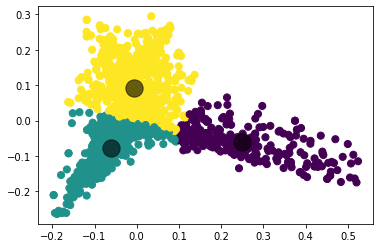

In [22]:
sklearn_pca = PCA(n_components = 2)
Y_sklearn = sklearn_pca.fit_transform(tf_idf_array)
print("Y values",Y_sklearn)
test_e = Kmeans(3, 1, 600)
%time fitted = test_e.fit_kmeans(Y_sklearn)

predicted_values = test_e.predict(Y_sklearn)
print("Y_sklearn[:,1]", Y_sklearn[:, 1])
print("predicted_values", predicted_values)

plt.scatter(Y_sklearn[:, 0], Y_sklearn[:, 1], c=predicted_values, s=50, cmap='viridis')
centers = fitted.centroids
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=300, alpha=0.6);

KMeans(max_iter=600, n_clusters=3)
[1 0 1 ... 0 0 0]
labels [0 4 2 ... 1 1 3]


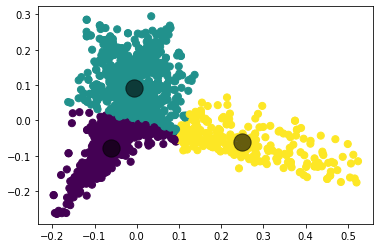

In [23]:
from sklearn.cluster import KMeans
n_clusters = 3
sklearn_pca = PCA(n_components = 2)
Y_sklearn = sklearn_pca.fit_transform(tf_idf_array)
kmeans = KMeans(n_clusters=3, max_iter=600, algorithm = 'auto')
print(kmeans)
fitted = kmeans.fit(Y_sklearn)
label = kmeans.labels_
print(label)
n_noise_ = list(label).count(-1)

labels1 = data1.target
print("labels",labels1)

prediction = kmeans.predict(Y_sklearn)
plt.scatter(Y_sklearn[:, 0], Y_sklearn[:, 1],c=prediction ,s=50, cmap='viridis')

centers2 = fitted.cluster_centers_
plt.scatter(centers2[:, 0], centers2[:, 1],c='black', s=300, alpha=0.6);

In [24]:
import sklearn.metrics as metrics
print('Estimated number of clusters: %d' % n_clusters)
print('Estimated number of noise points: %d' % n_noise_)
print("Homogeneity: %0.3f" % metrics.homogeneity_score(labels1, label))
print("Completeness: %0.3f" % metrics.completeness_score(labels1, label))
print("V-measure: %0.3f" % metrics.v_measure_score(labels1, label))
print("Adjusted Rand Index: %0.3f"
        % metrics.adjusted_rand_score(labels1, label))
print("Adjusted Mutual Information: %0.3f"
        % metrics.adjusted_mutual_info_score(labels1, label))
# print("Silhouette Coefficient: %0.3f"
#          % metrics.silhouette_score(labels1, label))

Estimated number of clusters: 3
Estimated number of noise points: 0
Homogeneity: 0.421
Completeness: 0.690
V-measure: 0.523
Adjusted Rand Index: 0.409
Adjusted Mutual Information: 0.522


In [54]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(Y_sklearn)
    distortions.append(kmeanModel.inertia_)
    print(distortions)

[49.51796871621422]
[49.51796871621422, 29.738183303900907]
[49.51796871621422, 29.738183303900907, 14.32722450362448]
[49.51796871621422, 29.738183303900907, 14.32722450362448, 10.66748072947296]
[49.51796871621422, 29.738183303900907, 14.32722450362448, 10.66748072947296, 8.06310400312495]
[49.51796871621422, 29.738183303900907, 14.32722450362448, 10.66748072947296, 8.06310400312495, 6.465444916150563]
[49.51796871621422, 29.738183303900907, 14.32722450362448, 10.66748072947296, 8.06310400312495, 6.465444916150563, 5.49551265233699]
[49.51796871621422, 29.738183303900907, 14.32722450362448, 10.66748072947296, 8.06310400312495, 6.465444916150563, 5.49551265233699, 4.8761196194648]
[49.51796871621422, 29.738183303900907, 14.32722450362448, 10.66748072947296, 8.06310400312495, 6.465444916150563, 5.49551265233699, 4.8761196194648, 4.338775494715252]


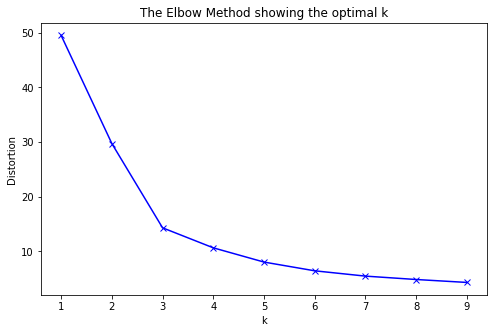

In [56]:
from sklearn.cluster import KMeans
plt.figure(figsize=(8,5))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [57]:
def get_top_features_cluster(tf_idf_array, prediction, n_feats):
    labels = np.unique(prediction)
    dfs = []
    for label in labels:
        id_temp = np.where(prediction==label) # indices for each cluster
        x_means = np.mean(tf_idf_array[id_temp], axis = 0) # returns average score across cluster
        sorted_means = np.argsort(x_means)[::-1][:n_feats] # indices with top 20 scores
        features = vectorizer.get_feature_names()
        best_features = [(features[i], x_means[i]) for i in sorted_means]
        df = pd.DataFrame(best_features, columns = ['features', 'score'])
        print(df)
        dfs.append(df)
    return dfs

In [58]:
dfs = get_top_features_cluster(tf_idf_array, prediction, 15)

     features     score
0        firm  0.026621
1     compani  0.026045
2        year  0.025793
3      market  0.024101
4       peopl  0.023063
5       mobil  0.021263
6        sale  0.020420
7        bank  0.020120
8       phone  0.019667
9      servic  0.019354
10     growth  0.019100
11       rise  0.018892
12  technolog  0.018645
13      price  0.018270
14      share  0.017788
      features     score
0       labour  0.096718
1        elect  0.094728
2        blair  0.081443
3        parti  0.080852
4         tori  0.070648
5        brown  0.061822
6       govern  0.052607
7       minist  0.048949
8       howard  0.047845
9         lord  0.041000
10  chancellor  0.040536
11       prime  0.039279
12        plan  0.038315
13    campaign  0.034691
14      leader  0.033205
   features     score
0      film  0.037305
1      game  0.032524
2      play  0.027635
3      best  0.023770
4     award  0.023751
5      year  0.020320
6      star  0.019661
7   england  0.019228
8    player  0.018

<AxesSubplot:xlabel='score', ylabel='features'>

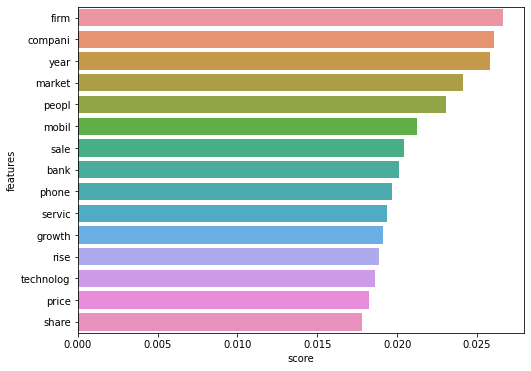

In [130]:
import seaborn as sns
plt.figure(figsize=(8,6))
sns.barplot(x = 'score' , y = 'features', orient = 'h' , data = dfs[0][:15])

<AxesSubplot:xlabel='score', ylabel='features'>

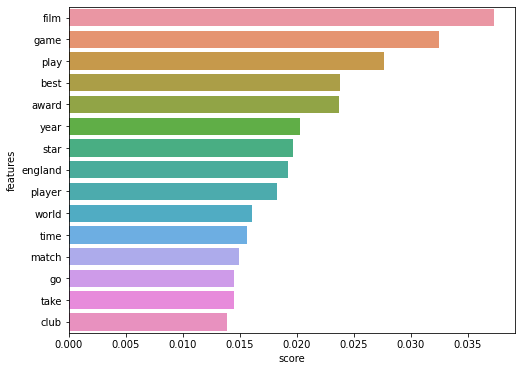

In [131]:
plt.figure(figsize=(8,6))
sns.barplot(x = 'score' , y = 'features', orient = 'h' , data = dfs[1][:15])

<AxesSubplot:xlabel='score', ylabel='features'>

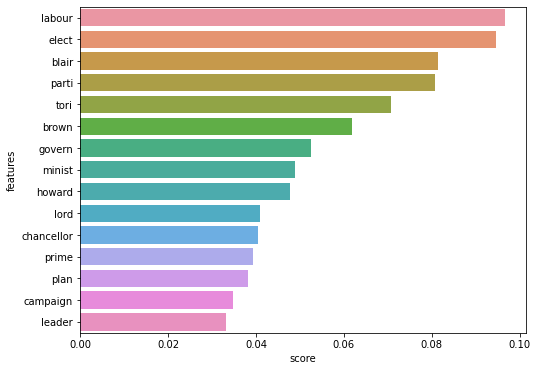

In [157]:
plt.figure(figsize=(8,6))
sns.barplot(x = 'score' , y = 'features', orient = 'h' , data = dfs[2][:15])

In [138]:
# plt.figure(figsize=(8,6))
# sns.barplot(x = 'score' , y = 'features', orient = 'h' , data = dfs[3][:15])

In [139]:
# plt.figure(figsize=(8,6))
# sns.barplot(x = 'score' , y = 'features', orient = 'h' , data = dfs[4][:15])

In [29]:
from sklearn.decomposition import TruncatedSVD

# SVD represent documents and terms in vectors 
svd_model = TruncatedSVD(n_components=3, algorithm='randomized', n_iter=100, random_state=122)

svd_model.fit(tf_idf_array)

len(svd_model.components_)

3

In [28]:
terms = vectorizer.get_feature_names()

for i, comp in enumerate(svd_model.components_):
    terms_comp = zip(terms, comp)
    sorted_terms = sorted(terms_comp, key= lambda x:x[1], reverse=True)[:7]
    print(" ")
    print("Topic "+str(i)+": ")
    for t in sorted_terms:
        print(t[0])
       

 
Topic 0: 
year
peopl
game
labour
elect
govern
film
 
Topic 1: 
labour
elect
blair
parti
tori
brown
minist
 
Topic 2: 
film
award
best
play
game
star
england
 
Topic 3: 
film
award
best
oscar
nomin
actor
star
 
Topic 4: 
mobil
phone
peopl
technolog
music
digit
game


CPU times: user 14.2 ms, sys: 16 µs, total: 14.2 ms
Wall time: 14.3 ms


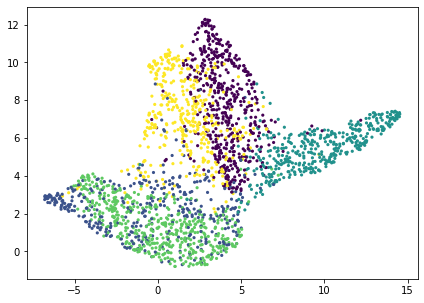

In [61]:
import umap

X_topics = svd_model.fit_transform(tf_idf_array)
embedding = umap.UMAP(n_neighbors=150, min_dist=0.5, random_state=12).fit_transform(X_topics)
plt.figure(figsize=(7,5))
%time plt.scatter(embedding[:, 0], embedding[:, 1], c = data1.target,s = 10, edgecolor='none')
plt.show()

In [173]:
from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
cluster.fit_predict(tf_idf_array)
label=cluster.labels_
print("label",label)


label [0 0 0 ... 0 0 2]
